In [1]:
# Librerias
import os
from skimage import io
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
%matplotlib inline

# DATASET

El presente notebook es para preparar y describir el dataset para el proyecto de grado, el dataset final llevara por nombre OVERLAECOBO, pero el mismo llevará un proceso desde que se extrae las imagenes de SASplanet hasta obtener test y train, incluso obtener las matrices target. Se plantea que el dataset este etiquetado en 7 clases, donde cada pixel tendra su propia clase, esto con el fin de aplicar `Segmentacion Semantica`. Las clases serán valores de 0 a 6, donde el 0 es **no definido** y los valores de 1 a 6 represetnan cada estrato. El dataset contará con varios niveles de zoom y cada uno estara divido en train y test.

## 1. Dataset *From_SAS*

Se obtendran imagenes satelitales de varios niveles de Zoom, desde el 13 al 20, se sacaran las imagenes layer y tambien una serie de imagenes guia para poder dividir las imagenes entre train y test, y para eliminar las imagenes externas a bogota, dado que estas implciarian una mayor cantidad de informacion para la clase **no definido**.

### 1.1 SASplanet
El Daset se creo usando:
* Archivos [KMLs](https://drive.google.com/open?id=15VnvN6ZRTbsqqd9kl3ukNWBj3oqADsy0), en especifico el de los estratos, la guia para dividir en train y uno indicando que imagnes eliminar.

* El programa libre [SASplanet](https://bitbucket.org/sas_team/sas.planet.bin/downloads/) para descargar las imagenes. 

Un pequeño tutotial de [SASplanet](https://www.youtube.com/watch?v=g05X5M8ucTI)

### 1.2 Contenido:
El dataset esta alojado en [Drive]() y tiene la siguiente estructura y contenido:



In [15]:
os.listdir('./data/dataset/from_SAS/')

['.gitignore', 'economic_layer', 'satellite', 'to_erase', 'train&test']

* **satellite:** Imagenes satelitales de bogota en distintos niveles de zoom

<div style="display:bolck; align:0 auto;">
<img src="./img/satellite_13.jpg" style="width:15%">
</div>


In [18]:
satellite = os.listdir('./data/dataset/from_SAS/satellite')
print("Cantidad de imagenes: ",len(satellite))

Cantidad de imagenes:  1368


* **train&test:** Imagenes que indican la pertenencia de las imagenes de la carpeta satelite a train (Azul) o test (Rojo).

<div style="display:bolck; align:0 auto;">
<img src="./img/train&test_13.jpg" style="width:15%">
</div>

In [20]:
train_test = os.listdir('./data/dataset/from_SAS/train&test')
print("Cantidad de imagenes: ",len(train_test))

Cantidad de imagenes:  1368


* **to_erase:** Imagenes que indican cuales son las imagenes satelitales que se deben eliminar para no dar mucha importancia a la clase **no definido**. la correspondiente imagen satelital a la imagen negra es la que deberia ser eliminada

<div style="display:bolck; align:0 auto;">
<img src="./img/to_erase_13.jpg" style="width:15%">
</div>

In [22]:
to_erase = os.listdir('./data/dataset/from_SAS/to_erase')
print("Cantidad de imagenes: ",len(to_erase))

Cantidad de imagenes:  1368


* **economic_layer:** Imagenes con la informacion de los estratos correspondientes a las iamgenes satelitales.

<div style="display:bolck; align:0 auto;">
<img src="./img/economic_layer_13.jpg" style="width:15%">
</div>

In [23]:
economic_layer = os.listdir('./data/dataset/from_SAS/economic_layer')
print("Cantidad de imagenes: ",len(economic_layer))

Cantidad de imagenes:  1368


### 1.3 to_erase:
como se menciono, las imagenes correspondientes a las imagenes en negro de la carpeta `to_erase` se deben eliminar.

In [18]:
l_17 = ["17_1-1", "17_4-4"]
l_18 = ["18_1-1", "18_1-2", "18_1-3", "18_1-7", "18_1-8", "18_2-1", "18_2-2", "18_2-8", "18_3-1", "18_4-1", "18_5-1", "18_7-7", "18_7-8", "18_8-5", "18_8-6", "18_8-7", "18_8-8"]
l_19 = ["19_1-1", "19_1-2", "19_1-3", "19_1-4", "19_1-5", "19_1-6", "19_1-7", "19_1-8", "19_1-11", "19_1-12", "19_1-13", "19_1-14", "19_1-15", "19_1-16", "19_2-1", "19_2-2", "19_2-3", "19_2-4", "19_2-5", "19_2-6", "19_2-7", "19_2-12", "19_2-13", "19_2-14", "19_2-15", "19_2-16", "19_3-1", "19_3-2", "19_3-3", "19_3-4", "19_3-5", "19_3-6", "19_3-12", "19_3-13", "19_3-14", "19_3-15", "19_3-16", "19_4-1", "19_4-2", "19_4-3", "19_4-4", "19_4-5", "19_4-14", "19_4-15", "19_4-16", "19_5-1", "19_5-2", "19_5-3", "19_5-4", "19_5-15", "19_5-16", "19_6-1", "19_6-2", "19_6-3", "19_6-16", "19_7-1", "19_7-2", "19_7-3", "19_8-1", "19_8-2", "19_9-1", "19_9-2","19_10-1", "19_10-2", "19_11-1", "19_11-2", "19_12-14", "19_12-15", "19_12-16", "19_13-12", "19_13-13", "19_13-14", "19_13-15", "19_13-16", "19_14-10", "19_14-11", "19_14-12", "19_14-13", "19_14-14", "19_14-15", "19_14-16", "19_15-9", "19_15-10", "19_15-11", "19_15-12", "19_15-13", "19_15-14", "19_15-15", "19_15-16", "19_16-9", "19_16-10", "19_16-11", "19_16-12", "19_16-13", "19_16-14", "19_16-15", "19_16-16"]
l_20 = ["20_1-1" ,"20_1-2" ,"20_1-3" ,"20_1-4" ,"20_1-5" ,"20_1-6" ,"20_1-7" ,"20_1-8" ,"20_1-9" ,"20_1-10" ,"20_1-11" ,"20_1-12" ,"20_1-13" ,"20_1-14" ,"20_1-15" ,"20_1-16" ,"20_1-21" ,"20_1-22" ,"20_1-23" ,"20_1-24" ,"20_1-25" ,"20_1-26" ,"20_1-27" ,"20_1-28" ,"20_1-29" ,"20_1-30" ,"20_1-31" ,"20_1-32" ,"20_2-1" ,"20_2-2" ,"20_2-3" ,"20_2-4" ,"20_2-5" ,"20_2-6" ,"20_2-7" ,"20_2-8" ,"20_2-9" ,"20_2-10" ,"20_2-11" ,"20_2-12" ,"20_2-13" ,"20_2-14" ,"20_2-15" ,"20_2-22" ,"20_2-23" ,"20_2-24" ,"20_2-25" ,"20_2-26" ,"20_2-27" ,"20_2-28" ,"20_2-29" ,"20_2-30" ,"20_2-31" ,"20_2-32" ,"20_3-1" ,"20_3-2" ,"20_3-3" ,"20_3-4" ,"20_3-5" ,"20_3-6" ,"20_3-7" ,"20_3-8" ,"20_3-9" ,"20_3-10" ,"20_3-11" ,"20_3-12" ,"20_3-13" ,"20_3-14" ,"20_3-15" ,"20_3-22" ,"20_3-23" ,"20_3-24" ,"20_3-25" ,"20_3-26" ,"20_3-27" ,"20_3-28" ,"20_3-29" ,"20_3-30" ,"20_3-31" ,"20_3-32" ,"20_4-1" ,"20_4-2" ,"20_4-3" ,"20_4-4" ,"20_4-5" ,"20_4-6" ,"20_4-7" ,"20_4-8" ,"20_4-9" ,"20_4-10" ,"20_4-11" ,"20_4-12" ,"20_4-13" ,"20_4-14" ,"20_4-15" ,"20_4-22" ,"20_4-23" ,"20_4-24" ,"20_4-25" ,"20_4-26" ,"20_4-27" ,"20_4-28" ,"20_4-29" ,"20_4-30" ,"20_4-31" ,"20_4-32" ,"20_5-1" ,"20_5-2" ,"20_5-3" ,"20_5-4" ,"20_5-5" ,"20_5-6" ,"20_5-7" ,"20_5-8" ,"20_5-9" ,"20_5-10" ,"20_5-11" ,"20_5-12" ,"20_5-13" ,"20_5-14" ,"20_5-15" ,"20_5-22" ,"20_5-23" ,"20_5-24" ,"20_5-25" ,"20_5-26" ,"20_5-27" ,"20_5-28" ,"20_5-29" ,"20_5-30" ,"20_5-31" ,"20_5-32" ,"20_6-1" ,"20_6-2" ,"20_6-3" ,"20_6-4" ,"20_6-5" ,"20_6-6" ,"20_6-7" ,"20_6-8" ,"20_6-9" ,"20_6-10" ,"20_6-11" ,"20_6-12" ,"20_6-14" ,"20_6-24" ,"20_6-25" ,"20_6-26" ,"20_6-27" ,"20_6-28" ,"20_6-29" ,"20_6-30" ,"20_6-31" ,"20_6-32" ,"20_7-1" ,"20_7-2" ,"20_7-3" ,"20_7-4" ,"20_7-5" ,"20_7-6" ,"20_7-7" ,"20_7-8" ,"20_7-9" ,"20_7-10" ,"20_7-11" ,"20_7-27" ,"20_7-28" ,"20_7-29" ,"20_7-30" ,"20_7-31" ,"20_7-32" ,"20_8-1" ,"20_8-2" ,"20_8-3" ,"20_8-4" ,"20_8-5" ,"20_8-6" ,"20_8-7" ,"20_8-8" ,"20_8-9" ,"20_8-10" ,"20_8-27" ,"20_8-28" ,"20_8-29" ,"20_8-30" ,"20_8-31" ,"20_8-32" ,"20_9-1" ,"20_9-2" ,"20_9-3" ,"20_9-4" ,"20_9-5" ,"20_9-6" ,"20_9-7" ,"20_9-8" ,"20_9-9" ,"20_9-27" ,"20_9-28" ,"20_9-29" ,"20_9-30" ,"20_9-31" ,"20_9-32" ,"20_10-1" ,"20_10-2" ,"20_10-3" ,"20_10-4" ,"20_10-5" ,"20_10-6" ,"20_10-7" ,"20_10-8" ,"20_10-9" ,"20_10-29" ,"20_10-30" ,"20_10-31" ,"20_10-32" ,"20_11-1" ,"20_11-2" ,"20_11-3" ,"20_11-4" ,"20_11-5" ,"20_11-6" ,"20_11-7" ,"20_11-8" ,"20_11-30" ,"20_11-31" ,"20_11-32" ,"20_12-1" ,"20_12-2" ,"20_12-3" ,"20_12-4" ,"20_12-5" ,"20_12-6" ,"20_12-7" ,"20_12-30" ,"20_12-31" ,"20_12-32" ,"20_13-1" ,"20_13-2" ,"20_13-3" ,"20_13-4" ,"20_13-5" ,"20_13-6" ,"20_13-30" ,"20_13-31" ,"20_13-32" ,"20_14-1" ,"20_14-2" ,"20_14-3" ,"20_14-4" ,"20_14-5" ,"20_14-6" ,"20_14-30" ,"20_15-1" ,"20_15-2" ,"20_15-3" ,"20_15-4" ,"20_15-5" ,"20_16-1" ,"20_16-2" ,"20_16-3" ,"20_16-4" ,"20_16-5" ,"20_17-1" ,"20_17-2" ,"20_17-3" ,"20_17-4" ,"20_17-5" ,"20_17-32" ,"20_18-1" ,"20_18-2" ,"20_18-3" ,"20_18-4" ,"20_18-5" ,"20_18-32" ,"20_19-1" ,"20_19-2" ,"20_19-3" ,"20_19-4" ,"20_19-5" ,"20_19-32" ,"20_20-1" ,"20_20-2" ,"20_20-3" ,"20_20-4" ,"20_20-5" ,"20_21-1" ,"20_21-2" ,"20_21-3" ,"20_21-4" ,"20_21-5" ,"20_22-1" ,"20_22-2" ,"20_22-3" ,"20_22-4" ,"20_22-5" ,"20_22-28" ,"20_22-31" ,"20_23-2" ,"20_23-3" ,"20_23-4" ,"20_23-26" ,"20_23-27" ,"20_23-28" ,"20_23-29" ,"20_23-30" ,"20_23-31" ,"20_23-32" ,"20_24-25" ,"20_24-26" ,"20_24-27" ,"20_24-28" ,"20_24-29" ,"20_24-30" ,"20_24-31" ,"20_24-32" ,"20_25-22" ,"20_25-23" ,"20_25-24" ,"20_25-25" ,"20_25-26" ,"20_25-27" ,"20_25-28" ,"20_25-29" ,"20_25-30" ,"20_25-31" ,"20_25-32" ,"20_26-20" ,"20_26-21" ,"20_26-22" ,"20_26-23" ,"20_26-24" ,"20_26-25" ,"20_26-26" ,"20_26-27" ,"20_26-28" ,"20_26-29" ,"20_26-30" ,"20_26-31" ,"20_26-32" ,"20_27-18" ,"20_27-19" ,"20_27-20" ,"20_27-21" ,"20_27-22" ,"20_27-23" ,"20_27-24" ,"20_27-25" ,"20_27-26" ,"20_27-27" ,"20_27-28" ,"20_27-29" ,"20_27-30" ,"20_27-31" ,"20_27-32" ,"20_28-17" ,"20_28-18" ,"20_28-19" ,"20_28-20" ,"20_28-21" ,"20_28-22" ,"20_28-23" ,"20_28-24" ,"20_28-25" ,"20_28-26" ,"20_28-27" ,"20_28-28" ,"20_28-29" ,"20_28-30" ,"20_28-31" ,"20_28-32" ,"20_29-16" ,"20_29-17" ,"20_29-18" ,"20_29-19" ,"20_29-20" ,"20_29-21" ,"20_29-22" ,"20_29-23" ,"20_29-24" ,"20_29-25" ,"20_29-26" ,"20_29-27" ,"20_29-28" ,"20_29-29" ,"20_29-30" ,"20_29-31" ,"20_29-32" ,"20_30-4" ,"20_30-16" ,"20_30-17" ,"20_30-18" ,"20_30-19" ,"20_30-20" ,"20_30-21" ,"20_30-22" ,"20_30-23" ,"20_30-24" ,"20_30-25" ,"20_30-26" ,"20_30-27" ,"20_30-28" ,"20_30-29" ,"20_30-30" ,"20_30-31" ,"20_30-32" ,"20_31-4" ,"20_31-5" ,"20_31-16" ,"20_31-17" ,"20_31-18" ,"20_31-19" ,"20_31-20" ,"20_31-21" ,"20_31-22" ,"20_31-23" ,"20_31-24" ,"20_31-25" ,"20_31-26" ,"20_31-27" ,"20_31-28" ,"20_31-29" ,"20_31-30" ,"20_31-31" ,"20_31-32" ,"20_32-4" ,"20_32-5" ,"20_32-11" ,"20_32-12" ,"20_32-13" ,"20_32-16" ,"20_32-17" ,"20_32-18" ,"20_32-19" ,"20_32-20" ,"20_32-21" ,"20_32-22" ,"20_32-23" ,"20_32-24" ,"20_32-25" ,"20_32-26" ,"20_32-27" ,"20_32-28" ,"20_32-29" ,"20_32-30" ,"20_32-31" ,"20_32-32"]
to_erase = [l_17, l_18, l_19, l_20]

In [3]:
dir_list = os.listdir('./data/dataset/from_SAS/')
dir_list[1:]

['content.csv', 'economic_layer', 'satellite', 'to_erase', 'train&test']

In [28]:
for i in dir_list[1:]:
    for j in to_erase:
        for k in j:
            os.remove("./data/dataset/from_SAS/"+i+"/"+k+".jpg")

Con esto se eliminan las imagenes sobrantes, claro esta que este proceso sera reutilizado nuevamente una vez se hayan subdivido las imagenes.

In [31]:
to_erase = os.listdir('./data/dataset/from_SAS/to_erase')
economic_layer = os.listdir('./data/dataset/from_SAS/economic_layer')
train_test = os.listdir('./data/dataset/from_SAS/train&test')
satellite = os.listdir('./data/dataset/from_SAS/satellite')
print("Nuevo contenido:")
print("Cantidad de imagenes: ",len(satellite))
print("Cantidad de imagenes: ",len(train_test))
print("Cantidad de imagenes: ",len(economic_layer))
print("Cantidad de imagenes: ",len(to_erase))

Nuevo contenido:
Cantidad de imagenes:  806
Cantidad de imagenes:  806
Cantidad de imagenes:  806
Cantidad de imagenes:  806


### 1.4 Extraccion de parches
Dado que en la mayoria de los ejemplos de segmentacion semantica se usan imagenes ed 256x512 o de 256x256, las imagenes del presente dataset tambien se llevaran a estas dimensiones, y por consejo de los profesores fabio y raul, creare dichos parches con un solapamiento entre el 10 y 20 porciento.

![HW](./vector/H_and_W.svg)

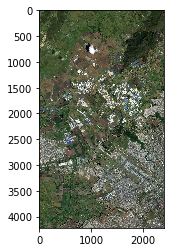

In [35]:
img_to_extract = io.imread("./data/dataset/from_SAS/satellite/16_1-1.jpg")
plt.imshow(img_to_extract)

In [36]:
img_to_extract.shape

(4218, 2418, 3)

In [38]:
def extract_patch(img, patch_w, patch_h, patch_per):
    
    img_h = img.shape[0]
    img_w = img.shape[1]
    patchs = []
    
    
    count_h = 0
    
    nw = int((100*img_w)/(patch_w*(100-patch_per)))
    nh = int((100*img_h)/(patch_h*(100-patch_per)))
     
    init_patch_h = 0
    end_patch_h = patch_h
    
    for i in range(nh):
        s_h = 0
              
        if(end_patch_h <= img_h):
            
            s_h = img_h - end_patch_h                           
            
            init_patch_w = 0
            end_patch_w = patch_w
            count_h = count_h+1
            
            for j in range(nw):
                s_w = 0           
                
                if(end_patch_w <= img_w):                    
                    s_w = img_w - end_patch_w                           
                    patchs.append(img[init_patch_h:end_patch_h,init_patch_w:end_patch_w,:])                    
                    init_patch_w = end_patch_w - int((patch_per/100)*patch_w)                    
                    end_patch_w = init_patch_w + patch_w                                  
            
            
           
            
                       
            init_patch_h = end_patch_h - int((patch_per/100)*patch_h)
            end_patch_h = init_patch_h + patch_h

    return patchs, count_h, int(len(patchs)/count_h),s_h,s_w

In [39]:
patchs, NH, NW, SH, SW = extract_patch(img_to_extract, 256, 256, 30)
print("Cantidad de parches:",len(patchs))
print("Cantidad de parches en H:",NH)
print("Cantidad de parches en W:",NW)
print("Pixeles sobrantes en H",SH)
print("Pixeles sobrantes en W",SW)

Cantidad de parches: 299
Cantidad de parches en H: 23
Cantidad de parches en W: 13
Pixeles sobrantes en H 2
Pixeles sobrantes en W 2


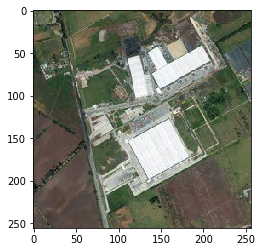

In [40]:
plt.imshow(patchs[150])

In [41]:
patchs[150].shape

(256, 256, 3)

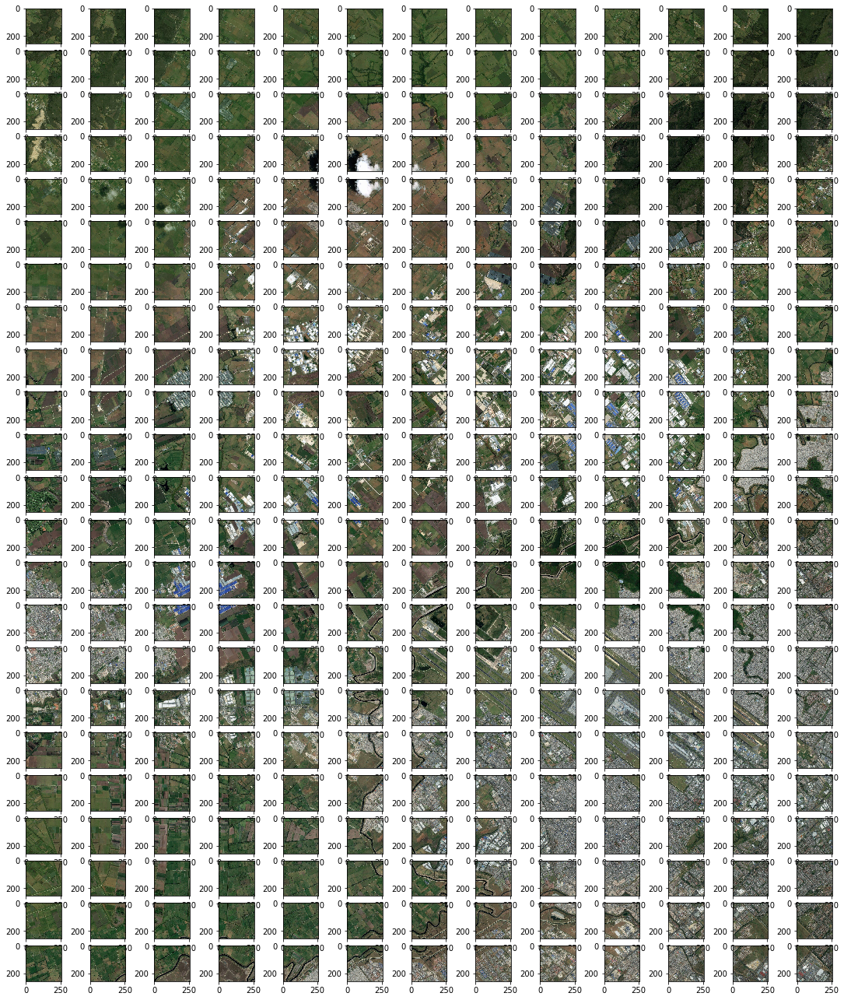

In [641]:
fig = plt.figure(figsize=(NW+6,NH))

for j,i in enumerate(patchs):
    ax=fig.add_subplot(NH,NW,j+1)
    plt.imshow(i)

In [64]:
def save_patchs(fname, patchs):
    for j,i in enumerate(patchs):       
        im = Image.fromarray(i)
        im.save(fname+"-"+str(j)+".png")
        print("Saving..")

In [53]:
save_patchs("./data/dataset/OVERLAECOBO/", patchs)

(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000000.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000001.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000002.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000003.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000004.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000005.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000006.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000007.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000008.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000009.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000010.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000011.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000012.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000

Imagen guarda ./data/dataset/OVERLAECOBO/-80600000119.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000120.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000121.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000122.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000123.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000124.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000125.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000126.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000127.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000128.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000129.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000130.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000131.png
(256, 256, 3)
Imagen guarda ./data/dataset/OVERLAECOBO/-80600000132.png
(256, 

KeyboardInterrupt: 

### 1.5 Extracion de parches *from_SAS*

In [65]:
patch_w = 256
patch_h = 256
over = 30
for i in dir_list[2:]:
    data_list = os.listdir('./data/dataset/from_SAS/'+i)
    print(i)
    
    for j in data_list:
        if j != ".gitignore":            
            img_to_extract = io.imread('./data/dataset/from_SAS/'+i+"/"+j)
            patchs, _, _, _, _ = extract_patch(img_to_extract[:,:,:3], patch_w, patch_h, over)
            save_patchs('./data/dataset/OVERLAECOBO/'+i+'/'+j[:-4], patchs)

economic_layer
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Savi

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
train&test
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
Saving..
S

## OVERLAECOBO

### 2.1 to_erase *OVERLAECOBO*

Al hacer sacar los parches de las imagenes se obtuvieron nuevos parches que se puede eliminar. los cuales son los siguientes

In [114]:
to_erase =  pd.read_csv("./data/dataset/to_erase.csv")
to_erasa = list(to_erase["to_erase"].values)

['13-0.png',
 '14-0.png',
 '14-1.png',
 '14-12.png',
 '14-13.png',
 '14-18.png',
 '14-2.png',
 '14-24.png',
 '14-3.png',
 '14-48.png',
 '14-53.png',
 '14-54.png',
 '14-59.png',
 '14-6.png',
 '14-60.png',
 '14-61.png',
 '14-65.png',
 '14-7.png',
 '14-8.png',
 '15-0.png',
 '15-1.png',
 '15-104.png',
 '15-105.png',
 '15-117.png',
 '15-118.png',
 '15-13.png',
 '15-130.png',
 '15-14.png',
 '15-15.png',
 '15-155.png',
 '15-16.png',
 '15-167.png',
 '15-168.png',
 '15-17.png',
 '15-18.png',
 '15-180.png',
 '15-181.png',
 '15-19.png',
 '15-193.png',
 '15-194.png',
 '15-195.png',
 '15-2.png',
 '15-20.png',
 '15-205.png',
 '15-206.png',
 '15-207.png',
 '15-208.png',
 '15-209.png',
 '15-21.png',
 '15-218.png',
 '15-219.png',
 '15-220.png',
 '15-221.png',
 '15-222.png',
 '15-231.png',
 '15-232.png',
 '15-233.png',
 '15-234.png',
 '15-235.png',
 '15-244.png',
 '15-245.png',
 '15-246.png',
 '15-247.png',
 '15-248.png',
 '15-249.png',
 '15-256.png',
 '15-257.png',
 '15-258.png',
 '15-259.png',
 '15-26

In [93]:
for i in overlaecobo_list[1:]:
    print(i)
    for j in to_erasa:
        os.remove('./data/dataset/OVERLAECOBO/'+i+"/"+j)

economic_layer


FileNotFoundError: [WinError 2] El sistema no puede encontrar el archivo especificado: './data/dataset/OVERLAECOBO/economic_layer/13-0.png'

In [94]:
to_erase = os.listdir('./data/dataset/OVERLAECOBO/to_erase')
economic_layer = os.listdir('./data/dataset/OVERLAECOBO/economic_layer')
train_test = os.listdir('./data/dataset/OVERLAECOBO/train&test')
satellite = os.listdir('./data/dataset/OVERLAECOBO/satellite')
print("Nuevo contenido:")
print("Cantidad de imagenes: ",len(satellite))
print("Cantidad de imagenes: ",len(train_test))
print("Cantidad de imagenes: ",len(economic_layer))
print("Cantidad de imagenes: ",len(to_erase))

Nuevo contenido:
Cantidad de imagenes:  207855
Cantidad de imagenes:  207855
Cantidad de imagenes:  207855
Cantidad de imagenes:  207903


#### Nota en este punto se elimna la carpeta `to_erase` y el dataset `for_SAS`

### 2.2 Train and Test
Se usan las imagenes del directorio `train&test`, separandolas por su color, las azules seran usadas como la guia para train y las rojas para test, las imagenes que tienen prate de train y parte de test, osea imagenes con zonas azules  rojas, se pondran al que mayor proporcion tengan.

El conjunto de imagenes de todo bogota se dividio en dos partes `./data/dataset/train` y `./data/dataset/test`, ambas con una cantidad considerable de los distintos niveles socioeconomicos para no hacer un mal entrenamiento, la division se llevo acabo de forma geografica como lo muestra la siguiente imagen.

<center>
<div style="width:40%">
                       
![test_train](./vector/train_test_map.svg)
</div>

</center>

In [15]:
train_list = os.listdir('./data/dataset/OVERLAECOBO/train&test/train')
test_list = os.listdir('./data/dataset/OVERLAECOBO/train&test/test')
len(train_list), len(test_list)

(95479, 112376)

Se graban los nombres de los archivos que seran parte de train y test en un archivo

In [17]:
with open("./data/dataset/train_content.csv", "w") as file:
    file.write("TRAIN,\n")
    for i in train_list:
        file.write(i+",\n")

In [18]:
with open("./data/dataset/test_content.csv", "w") as file:
    file.write("TEST,\n")
    for i in test_list:
        file.write(i+",\n")

In [19]:
train_files =  pd.read_csv("./data/dataset/train_content.csv")
test_files =  pd.read_csv("./data/dataset/test_content.csv")

Se mueven las imagenes satelitales y las de nivel a carpetas de test y train, teniendo en cuenta las listas anteriormente creadas.

In [24]:
for i in train_files["TRAIN"].values:
    if "copia" not in i:
        os.rename("./data/dataset/OVERLAECOBO/satellite/"+i,"./data/dataset/OVERLAECOBO/satellite/train/"+i)
        os.rename("./data/dataset/OVERLAECOBO/economic_layer/"+i,"./data/dataset/OVERLAECOBO/economic_layer/train/"+i)

In [25]:
for i in test_files["TEST"].values:
    if "copia" not in i:
        os.rename("./data/dataset/OVERLAECOBO/satellite/"+i,"./data/dataset/OVERLAECOBO/satellite/test/"+i)
        os.rename("./data/dataset/OVERLAECOBO/economic_layer/"+i,"./data/dataset/OVERLAECOBO/economic_layer/test/"+i)

luego hacemos cambios para que el dataset quede con la siguiente escructura.
        - train
            - satellite
                - 13
                - 14
                - 15
                - 16
                - 17
                - 18
                - 19
                - 20
            - economic_layer
                - 13
                - 14
                - 15
                - 16
                - 17
                - 18
                - 19
                - 20
        - test
            - satellite
                - 13
                - 14
                - 15
                - 16
                - 17
                - 18
                - 19
                - 20
            - economic_layer
                - 13
                - 14
                - 15
                - 16
                - 17
                - 18
                - 19
                - 20

##### 2.2.1 Contenido
Ya estando el dataset con la estrucutra definida, obtenemos la informacion de esta estrucutra, en especial la cantidad de imagenes de cada carpeta, esta la opcion de renombrarlas, pero aun lo estoy pensando.

In [6]:
TYPE = ['train','test']
TYPE_IMAGE = [ 'economic_layer', 'satellite']
ZOOM = ['13', '14', '15', '16', '17', '18', '19', '20']
for i in TYPE:
    for j in TYPE_IMAGE:
        for k in ZOOM:
            content_list = os.listdir('./data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k)
            print(i,j,k,len(content_list))

train economic_layer 13 3
train economic_layer 14 25
train economic_layer 15 91
train economic_layer 16 322
train economic_layer 17 1204
train economic_layer 18 4585
train economic_layer 19 17995
train economic_layer 20 71261
train satellite 13 3
train satellite 14 25
train satellite 15 91
train satellite 16 322
train satellite 17 1204
train satellite 18 4585
train satellite 19 17995
train satellite 20 71261
test economic_layer 13 8
test economic_layer 14 25
test economic_layer 15 99
test economic_layer 16 348
test economic_layer 17 1339
test economic_layer 18 5334
test economic_layer 19 21110
test economic_layer 20 84121
test satellite 13 8
test satellite 14 25
test satellite 15 99
test satellite 16 348
test satellite 17 1339
test satellite 18 5334
test satellite 19 21110
test satellite 20 84121


In [10]:
content_overlaecobo =  pd.read_csv("./data/dataset/OVERLAECOBO/content.csv")
content_overlaecobo

,TYPE,TYPE_IMAGE,ZOOM,COUNT
0,train,economic_layer,13,3
1,train,economic_layer,14,25
2,train,economic_layer,15,91
3,train,economic_layer,16,322
4,train,economic_layer,17,1204
5,train,economic_layer,18,4585
6,train,economic_layer,19,17995
7,train,economic_layer,20,71261
8,train,satellite,13,3
9,train,satellite,14,25


### 2.3 Renombrando
Por cuestiones de facilidad y evitar conocer los nombres de las imagenes `layer` se renombraran.

In [16]:
TYPE = ['train','test']
TYPE_IMAGE = [ 'economic_layer', 'satellite']
ZOOM = ['13', '14', '15', '16', '17', '18', '19', '20']
for i in TYPE:
    for j in TYPE_IMAGE:
        for k in ZOOM:
            content_list = os.listdir('./data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k)
            for l, n in enumerate(content_list):
                if "git" not in n:
                    os.rename('./data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k+'/'+n, './data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k+'/'+str(l-1)+".png")
                    print(i,j,k,n,l-1)

train economic_layer 13 13-7.png 0
train economic_layer 13 13-9.png 1
train economic_layer 14 14-17.png 0
train economic_layer 14 14-23.png 1
train economic_layer 14 14-28.png 2
train economic_layer 14 14-29.png 3
train economic_layer 14 14-33.png 4
train economic_layer 14 14-34.png 5
train economic_layer 14 14-35.png 6
train economic_layer 14 14-39.png 7
train economic_layer 14 14-40.png 8
train economic_layer 14 14-41.png 9
train economic_layer 14 14-44.png 10
train economic_layer 14 14-45.png 11
train economic_layer 14 14-46.png 12
train economic_layer 14 14-47.png 13
train economic_layer 14 14-50.png 14
train economic_layer 14 14-51.png 15
train economic_layer 14 14-52.png 16
train economic_layer 14 14-55.png 17
train economic_layer 14 14-56.png 18
train economic_layer 14 14-57.png 19
train economic_layer 14 14-58.png 20
train economic_layer 14 14-62.png 21
train economic_layer 14 14-63.png 22
train economic_layer 14 14-64.png 23
train economic_layer 15 15-101.png 0
train economic_

train economic_layer 16 16_2-1-215.png 126
train economic_layer 16 16_2-1-216.png 127
train economic_layer 16 16_2-1-217.png 128
train economic_layer 16 16_2-1-218.png 129
train economic_layer 16 16_2-1-219.png 130
train economic_layer 16 16_2-1-220.png 131
train economic_layer 16 16_2-1-227.png 132
train economic_layer 16 16_2-1-228.png 133
train economic_layer 16 16_2-1-229.png 134
train economic_layer 16 16_2-1-230.png 135
train economic_layer 16 16_2-1-231.png 136
train economic_layer 16 16_2-1-232.png 137
train economic_layer 16 16_2-1-239.png 138
train economic_layer 16 16_2-1-240.png 139
train economic_layer 16 16_2-1-241.png 140
train economic_layer 16 16_2-1-242.png 141
train economic_layer 16 16_2-1-243.png 142
train economic_layer 16 16_2-1-244.png 143
train economic_layer 16 16_2-1-245.png 144
train economic_layer 16 16_2-1-252.png 145
train economic_layer 16 16_2-1-253.png 146
train economic_layer 16 16_2-1-254.png 147
train economic_layer 16 16_2-1-255.png 148
train econo

train economic_layer 17 17_2-3-163.png 20
train economic_layer 17 17_2-3-164.png 21
train economic_layer 17 17_2-3-165.png 22
train economic_layer 17 17_2-3-166.png 23
train economic_layer 17 17_2-3-167.png 24
train economic_layer 17 17_2-3-168.png 25
train economic_layer 17 17_2-3-175.png 26
train economic_layer 17 17_2-3-176.png 27
train economic_layer 17 17_2-3-177.png 28
train economic_layer 17 17_2-3-178.png 29
train economic_layer 17 17_2-3-179.png 30
train economic_layer 17 17_2-3-180.png 31
train economic_layer 17 17_2-3-181.png 32
train economic_layer 17 17_2-3-187.png 33
train economic_layer 17 17_2-3-188.png 34
train economic_layer 17 17_2-3-189.png 35
train economic_layer 17 17_2-3-190.png 36
train economic_layer 17 17_2-3-191.png 37
train economic_layer 17 17_2-3-192.png 38
train economic_layer 17 17_2-3-193.png 39
train economic_layer 17 17_2-3-194.png 40
train economic_layer 17 17_2-3-199.png 41
train economic_layer 17 17_2-3-200.png 42
train economic_layer 17 17_2-3-201

train economic_layer 17 17_2-4-282.png 233
train economic_layer 17 17_2-4-283.png 234
train economic_layer 17 17_2-4-284.png 235
train economic_layer 17 17_2-4-285.png 236
train economic_layer 17 17_2-4-29.png 237
train economic_layer 17 17_2-4-294.png 238
train economic_layer 17 17_2-4-295.png 239
train economic_layer 17 17_2-4-296.png 240
train economic_layer 17 17_2-4-297.png 241
train economic_layer 17 17_2-4-3.png 242
train economic_layer 17 17_2-4-30.png 243
train economic_layer 17 17_2-4-31.png 244
train economic_layer 17 17_2-4-32.png 245
train economic_layer 17 17_2-4-33.png 246
train economic_layer 17 17_2-4-34.png 247
train economic_layer 17 17_2-4-35.png 248
train economic_layer 17 17_2-4-36.png 249
train economic_layer 17 17_2-4-37.png 250
train economic_layer 17 17_2-4-38.png 251
train economic_layer 17 17_2-4-4.png 252
train economic_layer 17 17_2-4-40.png 253
train economic_layer 17 17_2-4-41.png 254
train economic_layer 17 17_2-4-42.png 255
train economic_layer 17 17_2

train economic_layer 17 17_3-3-166.png 436
train economic_layer 17 17_3-3-167.png 437
train economic_layer 17 17_3-3-168.png 438
train economic_layer 17 17_3-3-169.png 439
train economic_layer 17 17_3-3-17.png 440
train economic_layer 17 17_3-3-170.png 441
train economic_layer 17 17_3-3-171.png 442
train economic_layer 17 17_3-3-172.png 443
train economic_layer 17 17_3-3-173.png 444
train economic_layer 17 17_3-3-174.png 445
train economic_layer 17 17_3-3-175.png 446
train economic_layer 17 17_3-3-176.png 447
train economic_layer 17 17_3-3-177.png 448
train economic_layer 17 17_3-3-178.png 449
train economic_layer 17 17_3-3-179.png 450
train economic_layer 17 17_3-3-18.png 451
train economic_layer 17 17_3-3-180.png 452
train economic_layer 17 17_3-3-181.png 453
train economic_layer 17 17_3-3-182.png 454
train economic_layer 17 17_3-3-183.png 455
train economic_layer 17 17_3-3-184.png 456
train economic_layer 17 17_3-3-185.png 457
train economic_layer 17 17_3-3-186.png 458
train economi

train economic_layer 17 17_3-3-80.png 636
train economic_layer 17 17_3-3-81.png 637
train economic_layer 17 17_3-3-82.png 638
train economic_layer 17 17_3-3-83.png 639
train economic_layer 17 17_3-3-84.png 640
train economic_layer 17 17_3-3-85.png 641
train economic_layer 17 17_3-3-86.png 642
train economic_layer 17 17_3-3-87.png 643
train economic_layer 17 17_3-3-88.png 644
train economic_layer 17 17_3-3-89.png 645
train economic_layer 17 17_3-3-9.png 646
train economic_layer 17 17_3-3-90.png 647
train economic_layer 17 17_3-3-91.png 648
train economic_layer 17 17_3-3-92.png 649
train economic_layer 17 17_3-3-93.png 650
train economic_layer 17 17_3-3-94.png 651
train economic_layer 17 17_3-3-95.png 652
train economic_layer 17 17_3-3-96.png 653
train economic_layer 17 17_3-3-97.png 654
train economic_layer 17 17_3-3-98.png 655
train economic_layer 17 17_3-3-99.png 656
train economic_layer 17 17_3-4-0.png 657
train economic_layer 17 17_3-4-1.png 658
train economic_layer 17 17_3-4-10.png

train economic_layer 17 17_4-1-199.png 863
train economic_layer 17 17_4-1-200.png 864
train economic_layer 17 17_4-1-201.png 865
train economic_layer 17 17_4-1-202.png 866
train economic_layer 17 17_4-1-203.png 867
train economic_layer 17 17_4-1-204.png 868
train economic_layer 17 17_4-1-205.png 869
train economic_layer 17 17_4-1-206.png 870
train economic_layer 17 17_4-1-212.png 871
train economic_layer 17 17_4-1-213.png 872
train economic_layer 17 17_4-1-214.png 873
train economic_layer 17 17_4-1-215.png 874
train economic_layer 17 17_4-1-216.png 875
train economic_layer 17 17_4-1-217.png 876
train economic_layer 17 17_4-1-218.png 877
train economic_layer 17 17_4-1-219.png 878
train economic_layer 17 17_4-1-225.png 879
train economic_layer 17 17_4-1-226.png 880
train economic_layer 17 17_4-1-227.png 881
train economic_layer 17 17_4-1-228.png 882
train economic_layer 17 17_4-1-229.png 883
train economic_layer 17 17_4-1-230.png 884
train economic_layer 17 17_4-1-231.png 885
train econo

train economic_layer 17 17_4-2-257.png 1083
train economic_layer 17 17_4-2-258.png 1084
train economic_layer 17 17_4-2-259.png 1085
train economic_layer 17 17_4-2-260.png 1086
train economic_layer 17 17_4-2-261.png 1087
train economic_layer 17 17_4-2-262.png 1088
train economic_layer 17 17_4-2-263.png 1089
train economic_layer 17 17_4-2-264.png 1090
train economic_layer 17 17_4-2-265.png 1091
train economic_layer 17 17_4-2-270.png 1092
train economic_layer 17 17_4-2-272.png 1093
train economic_layer 17 17_4-2-273.png 1094
train economic_layer 17 17_4-2-274.png 1095
train economic_layer 17 17_4-2-275.png 1096
train economic_layer 17 17_4-2-276.png 1097
train economic_layer 17 17_4-2-277.png 1098
train economic_layer 17 17_4-2-278.png 1099
train economic_layer 17 17_4-2-286.png 1100
train economic_layer 17 17_4-2-287.png 1101
train economic_layer 17 17_4-2-288.png 1102
train economic_layer 17 17_4-2-289.png 1103
train economic_layer 17 17_4-2-29.png 1104
train economic_layer 17 17_4-2-29

train economic_layer 18 18_3-7-113.png 135
train economic_layer 18 18_3-7-114.png 136
train economic_layer 18 18_3-7-115.png 137
train economic_layer 18 18_3-7-116.png 138
train economic_layer 18 18_3-7-12.png 139
train economic_layer 18 18_3-7-120.png 140
train economic_layer 18 18_3-7-121.png 141
train economic_layer 18 18_3-7-122.png 142
train economic_layer 18 18_3-7-123.png 143
train economic_layer 18 18_3-7-124.png 144
train economic_layer 18 18_3-7-125.png 145
train economic_layer 18 18_3-7-126.png 146
train economic_layer 18 18_3-7-127.png 147
train economic_layer 18 18_3-7-128.png 148
train economic_layer 18 18_3-7-129.png 149
train economic_layer 18 18_3-7-132.png 150
train economic_layer 18 18_3-7-133.png 151
train economic_layer 18 18_3-7-134.png 152
train economic_layer 18 18_3-7-135.png 153
train economic_layer 18 18_3-7-136.png 154
train economic_layer 18 18_3-7-137.png 155
train economic_layer 18 18_3-7-138.png 156
train economic_layer 18 18_3-7-139.png 157
train econom

train economic_layer 18 18_4-6-126.png 464
train economic_layer 18 18_4-6-127.png 465
train economic_layer 18 18_4-6-128.png 466
train economic_layer 18 18_4-6-129.png 467
train economic_layer 18 18_4-6-13.png 468
train economic_layer 18 18_4-6-130.png 469
train economic_layer 18 18_4-6-131.png 470
train economic_layer 18 18_4-6-132.png 471
train economic_layer 18 18_4-6-133.png 472
train economic_layer 18 18_4-6-134.png 473
train economic_layer 18 18_4-6-135.png 474
train economic_layer 18 18_4-6-136.png 475
train economic_layer 18 18_4-6-137.png 476
train economic_layer 18 18_4-6-138.png 477
train economic_layer 18 18_4-6-139.png 478
train economic_layer 18 18_4-6-14.png 479
train economic_layer 18 18_4-6-140.png 480
train economic_layer 18 18_4-6-141.png 481
train economic_layer 18 18_4-6-142.png 482
train economic_layer 18 18_4-6-143.png 483
train economic_layer 18 18_4-6-144.png 484
train economic_layer 18 18_4-6-145.png 485
train economic_layer 18 18_4-6-146.png 486
train economi

train economic_layer 18 18_4-6-83.png 714
train economic_layer 18 18_4-6-84.png 715
train economic_layer 18 18_4-6-85.png 716
train economic_layer 18 18_4-6-86.png 717
train economic_layer 18 18_4-6-87.png 718
train economic_layer 18 18_4-6-88.png 719
train economic_layer 18 18_4-6-89.png 720
train economic_layer 18 18_4-6-9.png 721
train economic_layer 18 18_4-6-90.png 722
train economic_layer 18 18_4-6-91.png 723
train economic_layer 18 18_4-6-92.png 724
train economic_layer 18 18_4-6-93.png 725
train economic_layer 18 18_4-6-94.png 726
train economic_layer 18 18_4-6-95.png 727
train economic_layer 18 18_4-6-96.png 728
train economic_layer 18 18_4-6-97.png 729
train economic_layer 18 18_4-6-98.png 730
train economic_layer 18 18_4-6-99.png 731
train economic_layer 18 18_4-7-0.png 732
train economic_layer 18 18_4-7-1.png 733
train economic_layer 18 18_4-7-10.png 734
train economic_layer 18 18_4-7-100.png 735
train economic_layer 18 18_4-7-101.png 736
train economic_layer 18 18_4-7-102.

train economic_layer 18 18_4-8-277.png 1137
train economic_layer 18 18_4-8-278.png 1138
train economic_layer 18 18_4-8-279.png 1139
train economic_layer 18 18_4-8-28.png 1140
train economic_layer 18 18_4-8-280.png 1141
train economic_layer 18 18_4-8-281.png 1142
train economic_layer 18 18_4-8-282.png 1143
train economic_layer 18 18_4-8-283.png 1144
train economic_layer 18 18_4-8-289.png 1145
train economic_layer 18 18_4-8-29.png 1146
train economic_layer 18 18_4-8-290.png 1147
train economic_layer 18 18_4-8-291.png 1148
train economic_layer 18 18_4-8-292.png 1149
train economic_layer 18 18_4-8-293.png 1150
train economic_layer 18 18_4-8-294.png 1151
train economic_layer 18 18_4-8-295.png 1152
train economic_layer 18 18_4-8-296.png 1153
train economic_layer 18 18_4-8-3.png 1154
train economic_layer 18 18_4-8-30.png 1155
train economic_layer 18 18_4-8-31.png 1156
train economic_layer 18 18_4-8-32.png 1157
train economic_layer 18 18_4-8-33.png 1158
train economic_layer 18 18_4-8-34.png 11

train economic_layer 18 18_5-5-216.png 1337
train economic_layer 18 18_5-5-217.png 1338
train economic_layer 18 18_5-5-218.png 1339
train economic_layer 18 18_5-5-219.png 1340
train economic_layer 18 18_5-5-22.png 1341
train economic_layer 18 18_5-5-220.png 1342
train economic_layer 18 18_5-5-221.png 1343
train economic_layer 18 18_5-5-222.png 1344
train economic_layer 18 18_5-5-223.png 1345
train economic_layer 18 18_5-5-224.png 1346
train economic_layer 18 18_5-5-225.png 1347
train economic_layer 18 18_5-5-226.png 1348
train economic_layer 18 18_5-5-227.png 1349
train economic_layer 18 18_5-5-228.png 1350
train economic_layer 18 18_5-5-229.png 1351
train economic_layer 18 18_5-5-23.png 1352
train economic_layer 18 18_5-5-230.png 1353
train economic_layer 18 18_5-5-231.png 1354
train economic_layer 18 18_5-5-232.png 1355
train economic_layer 18 18_5-5-233.png 1356
train economic_layer 18 18_5-5-234.png 1357
train economic_layer 18 18_5-5-235.png 1358
train economic_layer 18 18_5-5-236

train economic_layer 18 18_5-6-14.png 1526
train economic_layer 18 18_5-6-140.png 1527
train economic_layer 18 18_5-6-141.png 1528
train economic_layer 18 18_5-6-142.png 1529
train economic_layer 18 18_5-6-143.png 1530
train economic_layer 18 18_5-6-144.png 1531
train economic_layer 18 18_5-6-145.png 1532
train economic_layer 18 18_5-6-146.png 1533
train economic_layer 18 18_5-6-147.png 1534
train economic_layer 18 18_5-6-148.png 1535
train economic_layer 18 18_5-6-149.png 1536
train economic_layer 18 18_5-6-15.png 1537
train economic_layer 18 18_5-6-150.png 1538
train economic_layer 18 18_5-6-151.png 1539
train economic_layer 18 18_5-6-152.png 1540
train economic_layer 18 18_5-6-153.png 1541
train economic_layer 18 18_5-6-154.png 1542
train economic_layer 18 18_5-6-155.png 1543
train economic_layer 18 18_5-6-156.png 1544
train economic_layer 18 18_5-6-157.png 1545
train economic_layer 18 18_5-6-158.png 1546
train economic_layer 18 18_5-6-159.png 1547
train economic_layer 18 18_5-6-16.

train economic_layer 18 18_5-7-138.png 1823
train economic_layer 18 18_5-7-139.png 1824
train economic_layer 18 18_5-7-14.png 1825
train economic_layer 18 18_5-7-140.png 1826
train economic_layer 18 18_5-7-141.png 1827
train economic_layer 18 18_5-7-142.png 1828
train economic_layer 18 18_5-7-143.png 1829
train economic_layer 18 18_5-7-144.png 1830
train economic_layer 18 18_5-7-145.png 1831
train economic_layer 18 18_5-7-146.png 1832
train economic_layer 18 18_5-7-147.png 1833
train economic_layer 18 18_5-7-148.png 1834
train economic_layer 18 18_5-7-149.png 1835
train economic_layer 18 18_5-7-15.png 1836
train economic_layer 18 18_5-7-150.png 1837
train economic_layer 18 18_5-7-151.png 1838
train economic_layer 18 18_5-7-152.png 1839
train economic_layer 18 18_5-7-153.png 1840
train economic_layer 18 18_5-7-154.png 1841
train economic_layer 18 18_5-7-155.png 1842
train economic_layer 18 18_5-7-156.png 1843
train economic_layer 18 18_5-7-157.png 1844
train economic_layer 18 18_5-7-158

train economic_layer 18 18_5-8-130.png 2114
train economic_layer 18 18_5-8-131.png 2115
train economic_layer 18 18_5-8-132.png 2116
train economic_layer 18 18_5-8-133.png 2117
train economic_layer 18 18_5-8-134.png 2118
train economic_layer 18 18_5-8-135.png 2119
train economic_layer 18 18_5-8-136.png 2120
train economic_layer 18 18_5-8-137.png 2121
train economic_layer 18 18_5-8-138.png 2122
train economic_layer 18 18_5-8-139.png 2123
train economic_layer 18 18_5-8-14.png 2124
train economic_layer 18 18_5-8-140.png 2125
train economic_layer 18 18_5-8-141.png 2126
train economic_layer 18 18_5-8-142.png 2127
train economic_layer 18 18_5-8-143.png 2128
train economic_layer 18 18_5-8-144.png 2129
train economic_layer 18 18_5-8-145.png 2130
train economic_layer 18 18_5-8-146.png 2131
train economic_layer 18 18_5-8-147.png 2132
train economic_layer 18 18_5-8-148.png 2133
train economic_layer 18 18_5-8-149.png 2134
train economic_layer 18 18_5-8-15.png 2135
train economic_layer 18 18_5-8-150

train economic_layer 18 18_6-4-184.png 2350
train economic_layer 18 18_6-4-185.png 2351
train economic_layer 18 18_6-4-186.png 2352
train economic_layer 18 18_6-4-187.png 2353
train economic_layer 18 18_6-4-188.png 2354
train economic_layer 18 18_6-4-189.png 2355
train economic_layer 18 18_6-4-190.png 2356
train economic_layer 18 18_6-4-191.png 2357
train economic_layer 18 18_6-4-192.png 2358
train economic_layer 18 18_6-4-193.png 2359
train economic_layer 18 18_6-4-194.png 2360
train economic_layer 18 18_6-4-196.png 2361
train economic_layer 18 18_6-4-197.png 2362
train economic_layer 18 18_6-4-198.png 2363
train economic_layer 18 18_6-4-199.png 2364
train economic_layer 18 18_6-4-200.png 2365
train economic_layer 18 18_6-4-201.png 2366
train economic_layer 18 18_6-4-202.png 2367
train economic_layer 18 18_6-4-203.png 2368
train economic_layer 18 18_6-4-204.png 2369
train economic_layer 18 18_6-4-205.png 2370
train economic_layer 18 18_6-4-206.png 2371
train economic_layer 18 18_6-4-2

train economic_layer 18 18_6-5-215.png 2611
train economic_layer 18 18_6-5-216.png 2612
train economic_layer 18 18_6-5-217.png 2613
train economic_layer 18 18_6-5-218.png 2614
train economic_layer 18 18_6-5-219.png 2615
train economic_layer 18 18_6-5-22.png 2616
train economic_layer 18 18_6-5-220.png 2617
train economic_layer 18 18_6-5-221.png 2618
train economic_layer 18 18_6-5-222.png 2619
train economic_layer 18 18_6-5-223.png 2620
train economic_layer 18 18_6-5-224.png 2621
train economic_layer 18 18_6-5-225.png 2622
train economic_layer 18 18_6-5-226.png 2623
train economic_layer 18 18_6-5-227.png 2624
train economic_layer 18 18_6-5-228.png 2625
train economic_layer 18 18_6-5-229.png 2626
train economic_layer 18 18_6-5-23.png 2627
train economic_layer 18 18_6-5-230.png 2628
train economic_layer 18 18_6-5-231.png 2629
train economic_layer 18 18_6-5-232.png 2630
train economic_layer 18 18_6-5-233.png 2631
train economic_layer 18 18_6-5-234.png 2632
train economic_layer 18 18_6-5-235

train economic_layer 18 18_6-6-175.png 2862
train economic_layer 18 18_6-6-176.png 2863
train economic_layer 18 18_6-6-177.png 2864
train economic_layer 18 18_6-6-178.png 2865
train economic_layer 18 18_6-6-179.png 2866
train economic_layer 18 18_6-6-18.png 2867
train economic_layer 18 18_6-6-182.png 2868
train economic_layer 18 18_6-6-183.png 2869
train economic_layer 18 18_6-6-184.png 2870
train economic_layer 18 18_6-6-185.png 2871
train economic_layer 18 18_6-6-186.png 2872
train economic_layer 18 18_6-6-187.png 2873
train economic_layer 18 18_6-6-188.png 2874
train economic_layer 18 18_6-6-189.png 2875
train economic_layer 18 18_6-6-19.png 2876
train economic_layer 18 18_6-6-190.png 2877
train economic_layer 18 18_6-6-191.png 2878
train economic_layer 18 18_6-6-192.png 2879
train economic_layer 18 18_6-6-193.png 2880
train economic_layer 18 18_6-6-195.png 2881
train economic_layer 18 18_6-6-196.png 2882
train economic_layer 18 18_6-6-197.png 2883
train economic_layer 18 18_6-6-198

train economic_layer 18 18_6-6-90.png 3062
train economic_layer 18 18_6-6-91.png 3063
train economic_layer 18 18_6-6-92.png 3064
train economic_layer 18 18_6-6-93.png 3065
train economic_layer 18 18_6-6-94.png 3066
train economic_layer 18 18_6-6-95.png 3067
train economic_layer 18 18_6-6-96.png 3068
train economic_layer 18 18_6-6-97.png 3069
train economic_layer 18 18_6-6-98.png 3070
train economic_layer 18 18_6-6-99.png 3071
train economic_layer 18 18_6-7-0.png 3072
train economic_layer 18 18_6-7-1.png 3073
train economic_layer 18 18_6-7-104.png 3074
train economic_layer 18 18_6-7-105.png 3075
train economic_layer 18 18_6-7-106.png 3076
train economic_layer 18 18_6-7-107.png 3077
train economic_layer 18 18_6-7-108.png 3078
train economic_layer 18 18_6-7-109.png 3079
train economic_layer 18 18_6-7-117.png 3080
train economic_layer 18 18_6-7-118.png 3081
train economic_layer 18 18_6-7-119.png 3082
train economic_layer 18 18_6-7-120.png 3083
train economic_layer 18 18_6-7-121.png 3084
tr

train economic_layer 18 18_7-2-113.png 3267
train economic_layer 18 18_7-2-114.png 3268
train economic_layer 18 18_7-2-115.png 3269
train economic_layer 18 18_7-2-116.png 3270
train economic_layer 18 18_7-2-126.png 3271
train economic_layer 18 18_7-2-127.png 3272
train economic_layer 18 18_7-2-128.png 3273
train economic_layer 18 18_7-2-129.png 3274
train economic_layer 18 18_7-2-138.png 3275
train economic_layer 18 18_7-2-139.png 3276
train economic_layer 18 18_7-2-140.png 3277
train economic_layer 18 18_7-2-141.png 3278
train economic_layer 18 18_7-2-142.png 3279
train economic_layer 18 18_7-2-151.png 3280
train economic_layer 18 18_7-2-152.png 3281
train economic_layer 18 18_7-2-153.png 3282
train economic_layer 18 18_7-2-154.png 3283
train economic_layer 18 18_7-2-155.png 3284
train economic_layer 18 18_7-2-164.png 3285
train economic_layer 18 18_7-2-165.png 3286
train economic_layer 18 18_7-2-166.png 3287
train economic_layer 18 18_7-2-167.png 3288
train economic_layer 18 18_7-2-1

train economic_layer 18 18_7-3-59.png 3537
train economic_layer 18 18_7-3-60.png 3538
train economic_layer 18 18_7-3-61.png 3539
train economic_layer 18 18_7-3-62.png 3540
train economic_layer 18 18_7-3-63.png 3541
train economic_layer 18 18_7-3-64.png 3542
train economic_layer 18 18_7-3-7.png 3543
train economic_layer 18 18_7-3-71.png 3544
train economic_layer 18 18_7-3-72.png 3545
train economic_layer 18 18_7-3-73.png 3546
train economic_layer 18 18_7-3-74.png 3547
train economic_layer 18 18_7-3-75.png 3548
train economic_layer 18 18_7-3-76.png 3549
train economic_layer 18 18_7-3-77.png 3550
train economic_layer 18 18_7-3-8.png 3551
train economic_layer 18 18_7-3-84.png 3552
train economic_layer 18 18_7-3-85.png 3553
train economic_layer 18 18_7-3-86.png 3554
train economic_layer 18 18_7-3-87.png 3555
train economic_layer 18 18_7-3-88.png 3556
train economic_layer 18 18_7-3-89.png 3557
train economic_layer 18 18_7-3-9.png 3558
train economic_layer 18 18_7-3-90.png 3559
train economic

train economic_layer 18 18_7-4-46.png 3794
train economic_layer 18 18_7-4-47.png 3795
train economic_layer 18 18_7-4-48.png 3796
train economic_layer 18 18_7-4-49.png 3797
train economic_layer 18 18_7-4-5.png 3798
train economic_layer 18 18_7-4-50.png 3799
train economic_layer 18 18_7-4-51.png 3800
train economic_layer 18 18_7-4-52.png 3801
train economic_layer 18 18_7-4-53.png 3802
train economic_layer 18 18_7-4-54.png 3803
train economic_layer 18 18_7-4-55.png 3804
train economic_layer 18 18_7-4-56.png 3805
train economic_layer 18 18_7-4-57.png 3806
train economic_layer 18 18_7-4-58.png 3807
train economic_layer 18 18_7-4-59.png 3808
train economic_layer 18 18_7-4-6.png 3809
train economic_layer 18 18_7-4-60.png 3810
train economic_layer 18 18_7-4-61.png 3811
train economic_layer 18 18_7-4-62.png 3812
train economic_layer 18 18_7-4-63.png 3813
train economic_layer 18 18_7-4-64.png 3814
train economic_layer 18 18_7-4-65.png 3815
train economic_layer 18 18_7-4-66.png 3816
train economi

train economic_layer 18 18_8-2-197.png 4065
train economic_layer 18 18_8-2-198.png 4066
train economic_layer 18 18_8-2-199.png 4067
train economic_layer 18 18_8-2-200.png 4068
train economic_layer 18 18_8-2-201.png 4069
train economic_layer 18 18_8-2-202.png 4070
train economic_layer 18 18_8-2-203.png 4071
train economic_layer 18 18_8-2-204.png 4072
train economic_layer 18 18_8-2-205.png 4073
train economic_layer 18 18_8-2-206.png 4074
train economic_layer 18 18_8-2-207.png 4075
train economic_layer 18 18_8-2-208.png 4076
train economic_layer 18 18_8-2-209.png 4077
train economic_layer 18 18_8-2-210.png 4078
train economic_layer 18 18_8-2-211.png 4079
train economic_layer 18 18_8-2-212.png 4080
train economic_layer 18 18_8-2-213.png 4081
train economic_layer 18 18_8-2-214.png 4082
train economic_layer 18 18_8-2-215.png 4083
train economic_layer 18 18_8-2-216.png 4084
train economic_layer 18 18_8-2-217.png 4085
train economic_layer 18 18_8-2-218.png 4086
train economic_layer 18 18_8-2-2

train economic_layer 18 18_8-3-74.png 4408
train economic_layer 18 18_8-3-75.png 4409
train economic_layer 18 18_8-3-76.png 4410
train economic_layer 18 18_8-3-78.png 4411
train economic_layer 18 18_8-3-79.png 4412
train economic_layer 18 18_8-3-8.png 4413
train economic_layer 18 18_8-3-80.png 4414
train economic_layer 18 18_8-3-81.png 4415
train economic_layer 18 18_8-3-82.png 4416
train economic_layer 18 18_8-3-83.png 4417
train economic_layer 18 18_8-3-84.png 4418
train economic_layer 18 18_8-3-85.png 4419
train economic_layer 18 18_8-3-86.png 4420
train economic_layer 18 18_8-3-87.png 4421
train economic_layer 18 18_8-3-88.png 4422
train economic_layer 18 18_8-3-9.png 4423
train economic_layer 18 18_8-3-91.png 4424
train economic_layer 18 18_8-3-92.png 4425
train economic_layer 18 18_8-3-93.png 4426
train economic_layer 18 18_8-3-94.png 4427
train economic_layer 18 18_8-3-95.png 4428
train economic_layer 18 18_8-3-96.png 4429
train economic_layer 18 18_8-3-97.png 4430
train economi

train economic_layer 19 19_10-10-128.png 33
train economic_layer 19 19_10-10-129.png 34
train economic_layer 19 19_10-10-13.png 35
train economic_layer 19 19_10-10-130.png 36
train economic_layer 19 19_10-10-131.png 37
train economic_layer 19 19_10-10-132.png 38
train economic_layer 19 19_10-10-133.png 39
train economic_layer 19 19_10-10-134.png 40
train economic_layer 19 19_10-10-135.png 41
train economic_layer 19 19_10-10-136.png 42
train economic_layer 19 19_10-10-137.png 43
train economic_layer 19 19_10-10-138.png 44
train economic_layer 19 19_10-10-139.png 45
train economic_layer 19 19_10-10-14.png 46
train economic_layer 19 19_10-10-140.png 47
train economic_layer 19 19_10-10-141.png 48
train economic_layer 19 19_10-10-142.png 49
train economic_layer 19 19_10-10-143.png 50
train economic_layer 19 19_10-10-144.png 51
train economic_layer 19 19_10-10-145.png 52
train economic_layer 19 19_10-10-146.png 53
train economic_layer 19 19_10-10-147.png 54
train economic_layer 19 19_10-10-1

train economic_layer 19 19_10-10-67.png 263
train economic_layer 19 19_10-10-68.png 264
train economic_layer 19 19_10-10-69.png 265
train economic_layer 19 19_10-10-7.png 266
train economic_layer 19 19_10-10-70.png 267
train economic_layer 19 19_10-10-71.png 268
train economic_layer 19 19_10-10-72.png 269
train economic_layer 19 19_10-10-73.png 270
train economic_layer 19 19_10-10-74.png 271
train economic_layer 19 19_10-10-75.png 272
train economic_layer 19 19_10-10-76.png 273
train economic_layer 19 19_10-10-77.png 274
train economic_layer 19 19_10-10-78.png 275
train economic_layer 19 19_10-10-79.png 276
train economic_layer 19 19_10-10-8.png 277
train economic_layer 19 19_10-10-80.png 278
train economic_layer 19 19_10-10-81.png 279
train economic_layer 19 19_10-10-82.png 280
train economic_layer 19 19_10-10-83.png 281
train economic_layer 19 19_10-10-84.png 282
train economic_layer 19 19_10-10-85.png 283
train economic_layer 19 19_10-10-86.png 284
train economic_layer 19 19_10-10-8

train economic_layer 19 19_10-11-239.png 455
train economic_layer 19 19_10-11-24.png 456
train economic_layer 19 19_10-11-240.png 457
train economic_layer 19 19_10-11-241.png 458
train economic_layer 19 19_10-11-242.png 459
train economic_layer 19 19_10-11-243.png 460
train economic_layer 19 19_10-11-244.png 461
train economic_layer 19 19_10-11-245.png 462
train economic_layer 19 19_10-11-246.png 463
train economic_layer 19 19_10-11-247.png 464
train economic_layer 19 19_10-11-248.png 465
train economic_layer 19 19_10-11-249.png 466
train economic_layer 19 19_10-11-25.png 467
train economic_layer 19 19_10-11-250.png 468
train economic_layer 19 19_10-11-251.png 469
train economic_layer 19 19_10-11-252.png 470
train economic_layer 19 19_10-11-253.png 471
train economic_layer 19 19_10-11-254.png 472
train economic_layer 19 19_10-11-255.png 473
train economic_layer 19 19_10-11-256.png 474
train economic_layer 19 19_10-11-257.png 475
train economic_layer 19 19_10-11-258.png 476
train econom

train economic_layer 19 19_10-12-157.png 663
train economic_layer 19 19_10-12-158.png 664
train economic_layer 19 19_10-12-159.png 665
train economic_layer 19 19_10-12-16.png 666
train economic_layer 19 19_10-12-160.png 667
train economic_layer 19 19_10-12-161.png 668
train economic_layer 19 19_10-12-162.png 669
train economic_layer 19 19_10-12-163.png 670
train economic_layer 19 19_10-12-164.png 671
train economic_layer 19 19_10-12-165.png 672
train economic_layer 19 19_10-12-166.png 673
train economic_layer 19 19_10-12-167.png 674
train economic_layer 19 19_10-12-168.png 675
train economic_layer 19 19_10-12-169.png 676
train economic_layer 19 19_10-12-17.png 677
train economic_layer 19 19_10-12-170.png 678
train economic_layer 19 19_10-12-171.png 679
train economic_layer 19 19_10-12-172.png 680
train economic_layer 19 19_10-12-173.png 681
train economic_layer 19 19_10-12-174.png 682
train economic_layer 19 19_10-12-175.png 683
train economic_layer 19 19_10-12-176.png 684
train econom

train economic_layer 19 19_10-12-56.png 849
train economic_layer 19 19_10-12-57.png 850
train economic_layer 19 19_10-12-58.png 851
train economic_layer 19 19_10-12-59.png 852
train economic_layer 19 19_10-12-6.png 853
train economic_layer 19 19_10-12-60.png 854
train economic_layer 19 19_10-12-61.png 855
train economic_layer 19 19_10-12-62.png 856
train economic_layer 19 19_10-12-63.png 857
train economic_layer 19 19_10-12-64.png 858
train economic_layer 19 19_10-12-65.png 859
train economic_layer 19 19_10-12-66.png 860
train economic_layer 19 19_10-12-67.png 861
train economic_layer 19 19_10-12-68.png 862
train economic_layer 19 19_10-12-69.png 863
train economic_layer 19 19_10-12-7.png 864
train economic_layer 19 19_10-12-70.png 865
train economic_layer 19 19_10-12-71.png 866
train economic_layer 19 19_10-12-72.png 867
train economic_layer 19 19_10-12-73.png 868
train economic_layer 19 19_10-12-74.png 869
train economic_layer 19 19_10-12-75.png 870
train economic_layer 19 19_10-12-7

train economic_layer 19 19_10-13-238.png 1052
train economic_layer 19 19_10-13-239.png 1053
train economic_layer 19 19_10-13-24.png 1054
train economic_layer 19 19_10-13-240.png 1055
train economic_layer 19 19_10-13-241.png 1056
train economic_layer 19 19_10-13-242.png 1057
train economic_layer 19 19_10-13-243.png 1058
train economic_layer 19 19_10-13-244.png 1059
train economic_layer 19 19_10-13-245.png 1060
train economic_layer 19 19_10-13-246.png 1061
train economic_layer 19 19_10-13-247.png 1062
train economic_layer 19 19_10-13-248.png 1063
train economic_layer 19 19_10-13-249.png 1064
train economic_layer 19 19_10-13-25.png 1065
train economic_layer 19 19_10-13-250.png 1066
train economic_layer 19 19_10-13-251.png 1067
train economic_layer 19 19_10-13-252.png 1068
train economic_layer 19 19_10-13-253.png 1069
train economic_layer 19 19_10-13-254.png 1070
train economic_layer 19 19_10-13-255.png 1071
train economic_layer 19 19_10-13-256.png 1072
train economic_layer 19 19_10-13-257

train economic_layer 19 19_10-14-135.png 1237
train economic_layer 19 19_10-14-136.png 1238
train economic_layer 19 19_10-14-137.png 1239
train economic_layer 19 19_10-14-138.png 1240
train economic_layer 19 19_10-14-139.png 1241
train economic_layer 19 19_10-14-14.png 1242
train economic_layer 19 19_10-14-140.png 1243
train economic_layer 19 19_10-14-141.png 1244
train economic_layer 19 19_10-14-142.png 1245
train economic_layer 19 19_10-14-143.png 1246
train economic_layer 19 19_10-14-144.png 1247
train economic_layer 19 19_10-14-145.png 1248
train economic_layer 19 19_10-14-146.png 1249
train economic_layer 19 19_10-14-147.png 1250
train economic_layer 19 19_10-14-148.png 1251
train economic_layer 19 19_10-14-149.png 1252
train economic_layer 19 19_10-14-15.png 1253
train economic_layer 19 19_10-14-150.png 1254
train economic_layer 19 19_10-14-151.png 1255
train economic_layer 19 19_10-14-152.png 1256
train economic_layer 19 19_10-14-153.png 1257
train economic_layer 19 19_10-14-154

train economic_layer 19 19_10-14-38.png 1427
train economic_layer 19 19_10-14-39.png 1428
train economic_layer 19 19_10-14-4.png 1429
train economic_layer 19 19_10-14-40.png 1430
train economic_layer 19 19_10-14-41.png 1431
train economic_layer 19 19_10-14-42.png 1432
train economic_layer 19 19_10-14-43.png 1433
train economic_layer 19 19_10-14-44.png 1434
train economic_layer 19 19_10-14-45.png 1435
train economic_layer 19 19_10-14-46.png 1436
train economic_layer 19 19_10-14-47.png 1437
train economic_layer 19 19_10-14-48.png 1438
train economic_layer 19 19_10-14-49.png 1439
train economic_layer 19 19_10-14-5.png 1440
train economic_layer 19 19_10-14-50.png 1441
train economic_layer 19 19_10-14-51.png 1442
train economic_layer 19 19_10-14-52.png 1443
train economic_layer 19 19_10-14-53.png 1444
train economic_layer 19 19_10-14-54.png 1445
train economic_layer 19 19_10-14-55.png 1446
train economic_layer 19 19_10-14-56.png 1447
train economic_layer 19 19_10-14-57.png 1448
train econom

train economic_layer 19 19_10-16-113.png 1811
train economic_layer 19 19_10-16-114.png 1812
train economic_layer 19 19_10-16-115.png 1813
train economic_layer 19 19_10-16-116.png 1814
train economic_layer 19 19_10-16-118.png 1815
train economic_layer 19 19_10-16-119.png 1816
train economic_layer 19 19_10-16-12.png 1817
train economic_layer 19 19_10-16-120.png 1818
train economic_layer 19 19_10-16-121.png 1819
train economic_layer 19 19_10-16-122.png 1820
train economic_layer 19 19_10-16-123.png 1821
train economic_layer 19 19_10-16-124.png 1822
train economic_layer 19 19_10-16-125.png 1823
train economic_layer 19 19_10-16-126.png 1824
train economic_layer 19 19_10-16-127.png 1825
train economic_layer 19 19_10-16-128.png 1826
train economic_layer 19 19_10-16-129.png 1827
train economic_layer 19 19_10-16-13.png 1828
train economic_layer 19 19_10-16-133.png 1829
train economic_layer 19 19_10-16-134.png 1830
train economic_layer 19 19_10-16-135.png 1831
train economic_layer 19 19_10-16-136

train economic_layer 19 19_10-8-291.png 2006
train economic_layer 19 19_10-8-292.png 2007
train economic_layer 19 19_10-8-293.png 2008
train economic_layer 19 19_10-8-294.png 2009
train economic_layer 19 19_10-8-295.png 2010
train economic_layer 19 19_10-8-296.png 2011
train economic_layer 19 19_10-8-297.png 2012
train economic_layer 19 19_10-8-298.png 2013
train economic_layer 19 19_10-9-10.png 2014
train economic_layer 19 19_10-9-100.png 2015
train economic_layer 19 19_10-9-101.png 2016
train economic_layer 19 19_10-9-102.png 2017
train economic_layer 19 19_10-9-103.png 2018
train economic_layer 19 19_10-9-104.png 2019
train economic_layer 19 19_10-9-105.png 2020
train economic_layer 19 19_10-9-106.png 2021
train economic_layer 19 19_10-9-107.png 2022
train economic_layer 19 19_10-9-108.png 2023
train economic_layer 19 19_10-9-109.png 2024
train economic_layer 19 19_10-9-11.png 2025
train economic_layer 19 19_10-9-110.png 2026
train economic_layer 19 19_10-9-111.png 2027
train econom

train economic_layer 19 19_10-9-264.png 2194
train economic_layer 19 19_10-9-265.png 2195
train economic_layer 19 19_10-9-266.png 2196
train economic_layer 19 19_10-9-267.png 2197
train economic_layer 19 19_10-9-268.png 2198
train economic_layer 19 19_10-9-269.png 2199
train economic_layer 19 19_10-9-27.png 2200
train economic_layer 19 19_10-9-270.png 2201
train economic_layer 19 19_10-9-271.png 2202
train economic_layer 19 19_10-9-272.png 2203
train economic_layer 19 19_10-9-273.png 2204
train economic_layer 19 19_10-9-274.png 2205
train economic_layer 19 19_10-9-275.png 2206
train economic_layer 19 19_10-9-276.png 2207
train economic_layer 19 19_10-9-277.png 2208
train economic_layer 19 19_10-9-278.png 2209
train economic_layer 19 19_10-9-279.png 2210
train economic_layer 19 19_10-9-28.png 2211
train economic_layer 19 19_10-9-280.png 2212
train economic_layer 19 19_10-9-281.png 2213
train economic_layer 19 19_10-9-282.png 2214
train economic_layer 19 19_10-9-283.png 2215
train econom

train economic_layer 19 19_11-10-209.png 2432
train economic_layer 19 19_11-10-21.png 2433
train economic_layer 19 19_11-10-210.png 2434
train economic_layer 19 19_11-10-211.png 2435
train economic_layer 19 19_11-10-212.png 2436
train economic_layer 19 19_11-10-213.png 2437
train economic_layer 19 19_11-10-214.png 2438
train economic_layer 19 19_11-10-215.png 2439
train economic_layer 19 19_11-10-216.png 2440
train economic_layer 19 19_11-10-217.png 2441
train economic_layer 19 19_11-10-218.png 2442
train economic_layer 19 19_11-10-219.png 2443
train economic_layer 19 19_11-10-22.png 2444
train economic_layer 19 19_11-10-220.png 2445
train economic_layer 19 19_11-10-221.png 2446
train economic_layer 19 19_11-10-222.png 2447
train economic_layer 19 19_11-10-223.png 2448
train economic_layer 19 19_11-10-224.png 2449
train economic_layer 19 19_11-10-225.png 2450
train economic_layer 19 19_11-10-226.png 2451
train economic_layer 19 19_11-10-227.png 2452
train economic_layer 19 19_11-10-228

train economic_layer 19 19_11-11-138.png 2652
train economic_layer 19 19_11-11-139.png 2653
train economic_layer 19 19_11-11-14.png 2654
train economic_layer 19 19_11-11-140.png 2655
train economic_layer 19 19_11-11-141.png 2656
train economic_layer 19 19_11-11-142.png 2657
train economic_layer 19 19_11-11-143.png 2658
train economic_layer 19 19_11-11-144.png 2659
train economic_layer 19 19_11-11-145.png 2660
train economic_layer 19 19_11-11-146.png 2661
train economic_layer 19 19_11-11-147.png 2662
train economic_layer 19 19_11-11-148.png 2663
train economic_layer 19 19_11-11-149.png 2664
train economic_layer 19 19_11-11-15.png 2665
train economic_layer 19 19_11-11-150.png 2666
train economic_layer 19 19_11-11-151.png 2667
train economic_layer 19 19_11-11-152.png 2668
train economic_layer 19 19_11-11-153.png 2669
train economic_layer 19 19_11-11-154.png 2670
train economic_layer 19 19_11-11-155.png 2671
train economic_layer 19 19_11-11-156.png 2672
train economic_layer 19 19_11-11-157

train economic_layer 19 19_11-12-153.png 2968
train economic_layer 19 19_11-12-154.png 2969
train economic_layer 19 19_11-12-155.png 2970
train economic_layer 19 19_11-12-156.png 2971
train economic_layer 19 19_11-12-157.png 2972
train economic_layer 19 19_11-12-158.png 2973
train economic_layer 19 19_11-12-159.png 2974
train economic_layer 19 19_11-12-16.png 2975
train economic_layer 19 19_11-12-160.png 2976
train economic_layer 19 19_11-12-161.png 2977
train economic_layer 19 19_11-12-162.png 2978
train economic_layer 19 19_11-12-163.png 2979
train economic_layer 19 19_11-12-164.png 2980
train economic_layer 19 19_11-12-165.png 2981
train economic_layer 19 19_11-12-166.png 2982
train economic_layer 19 19_11-12-167.png 2983
train economic_layer 19 19_11-12-168.png 2984
train economic_layer 19 19_11-12-169.png 2985
train economic_layer 19 19_11-12-17.png 2986
train economic_layer 19 19_11-12-170.png 2987
train economic_layer 19 19_11-12-171.png 2988
train economic_layer 19 19_11-12-172

train economic_layer 19 19_11-13-171.png 3286
train economic_layer 19 19_11-13-172.png 3287
train economic_layer 19 19_11-13-173.png 3288
train economic_layer 19 19_11-13-174.png 3289
train economic_layer 19 19_11-13-175.png 3290
train economic_layer 19 19_11-13-176.png 3291
train economic_layer 19 19_11-13-177.png 3292
train economic_layer 19 19_11-13-178.png 3293
train economic_layer 19 19_11-13-179.png 3294
train economic_layer 19 19_11-13-18.png 3295
train economic_layer 19 19_11-13-180.png 3296
train economic_layer 19 19_11-13-182.png 3297
train economic_layer 19 19_11-13-183.png 3298
train economic_layer 19 19_11-13-184.png 3299
train economic_layer 19 19_11-13-185.png 3300
train economic_layer 19 19_11-13-186.png 3301
train economic_layer 19 19_11-13-187.png 3302
train economic_layer 19 19_11-13-188.png 3303
train economic_layer 19 19_11-13-189.png 3304
train economic_layer 19 19_11-13-19.png 3305
train economic_layer 19 19_11-13-190.png 3306
train economic_layer 19 19_11-13-191

train economic_layer 19 19_11-14-93.png 3622
train economic_layer 19 19_11-14-94.png 3623
train economic_layer 19 19_11-14-95.png 3624
train economic_layer 19 19_11-14-96.png 3625
train economic_layer 19 19_11-14-97.png 3626
train economic_layer 19 19_11-15-0.png 3627
train economic_layer 19 19_11-15-1.png 3628
train economic_layer 19 19_11-15-104.png 3629
train economic_layer 19 19_11-15-105.png 3630
train economic_layer 19 19_11-15-106.png 3631
train economic_layer 19 19_11-15-107.png 3632
train economic_layer 19 19_11-15-108.png 3633
train economic_layer 19 19_11-15-109.png 3634
train economic_layer 19 19_11-15-110.png 3635
train economic_layer 19 19_11-15-111.png 3636
train economic_layer 19 19_11-15-112.png 3637
train economic_layer 19 19_11-15-117.png 3638
train economic_layer 19 19_11-15-118.png 3639
train economic_layer 19 19_11-15-119.png 3640
train economic_layer 19 19_11-15-120.png 3641
train economic_layer 19 19_11-15-121.png 3642
train economic_layer 19 19_11-15-122.png 36

train economic_layer 19 19_11-7-259.png 3922
train economic_layer 19 19_11-7-271.png 3923
train economic_layer 19 19_11-7-272.png 3924
train economic_layer 19 19_11-7-283.png 3925
train economic_layer 19 19_11-7-284.png 3926
train economic_layer 19 19_11-7-285.png 3927
train economic_layer 19 19_11-7-296.png 3928
train economic_layer 19 19_11-7-297.png 3929
train economic_layer 19 19_11-7-298.png 3930
train economic_layer 19 19_11-8-10.png 3931
train economic_layer 19 19_11-8-100.png 3932
train economic_layer 19 19_11-8-101.png 3933
train economic_layer 19 19_11-8-102.png 3934
train economic_layer 19 19_11-8-103.png 3935
train economic_layer 19 19_11-8-106.png 3936
train economic_layer 19 19_11-8-107.png 3937
train economic_layer 19 19_11-8-108.png 3938
train economic_layer 19 19_11-8-109.png 3939
train economic_layer 19 19_11-8-11.png 3940
train economic_layer 19 19_11-8-110.png 3941
train economic_layer 19 19_11-8-111.png 3942
train economic_layer 19 19_11-8-112.png 3943
train econom

train economic_layer 19 19_11-8-289.png 4125
train economic_layer 19 19_11-8-290.png 4126
train economic_layer 19 19_11-8-291.png 4127
train economic_layer 19 19_11-8-292.png 4128
train economic_layer 19 19_11-8-293.png 4129
train economic_layer 19 19_11-8-294.png 4130
train economic_layer 19 19_11-8-295.png 4131
train economic_layer 19 19_11-8-296.png 4132
train economic_layer 19 19_11-8-297.png 4133
train economic_layer 19 19_11-8-298.png 4134
train economic_layer 19 19_11-8-33.png 4135
train economic_layer 19 19_11-8-34.png 4136
train economic_layer 19 19_11-8-35.png 4137
train economic_layer 19 19_11-8-36.png 4138
train economic_layer 19 19_11-8-37.png 4139
train economic_layer 19 19_11-8-38.png 4140
train economic_layer 19 19_11-8-45.png 4141
train economic_layer 19 19_11-8-46.png 4142
train economic_layer 19 19_11-8-47.png 4143
train economic_layer 19 19_11-8-48.png 4144
train economic_layer 19 19_11-8-49.png 4145
train economic_layer 19 19_11-8-50.png 4146
train economic_layer 1

train economic_layer 19 19_12-10-16.png 4550
train economic_layer 19 19_12-10-160.png 4551
train economic_layer 19 19_12-10-161.png 4552
train economic_layer 19 19_12-10-162.png 4553
train economic_layer 19 19_12-10-163.png 4554
train economic_layer 19 19_12-10-164.png 4555
train economic_layer 19 19_12-10-165.png 4556
train economic_layer 19 19_12-10-166.png 4557
train economic_layer 19 19_12-10-167.png 4558
train economic_layer 19 19_12-10-168.png 4559
train economic_layer 19 19_12-10-169.png 4560
train economic_layer 19 19_12-10-17.png 4561
train economic_layer 19 19_12-10-170.png 4562
train economic_layer 19 19_12-10-171.png 4563
train economic_layer 19 19_12-10-172.png 4564
train economic_layer 19 19_12-10-173.png 4565
train economic_layer 19 19_12-10-174.png 4566
train economic_layer 19 19_12-10-175.png 4567
train economic_layer 19 19_12-10-176.png 4568
train economic_layer 19 19_12-10-177.png 4569
train economic_layer 19 19_12-10-178.png 4570
train economic_layer 19 19_12-10-179

train economic_layer 19 19_12-11-247.png 4940
train economic_layer 19 19_12-11-248.png 4941
train economic_layer 19 19_12-11-249.png 4942
train economic_layer 19 19_12-11-25.png 4943
train economic_layer 19 19_12-11-250.png 4944
train economic_layer 19 19_12-11-251.png 4945
train economic_layer 19 19_12-11-252.png 4946
train economic_layer 19 19_12-11-253.png 4947
train economic_layer 19 19_12-11-254.png 4948
train economic_layer 19 19_12-11-255.png 4949
train economic_layer 19 19_12-11-256.png 4950
train economic_layer 19 19_12-11-257.png 4951
train economic_layer 19 19_12-11-26.png 4952
train economic_layer 19 19_12-11-260.png 4953
train economic_layer 19 19_12-11-261.png 4954
train economic_layer 19 19_12-11-262.png 4955
train economic_layer 19 19_12-11-263.png 4956
train economic_layer 19 19_12-11-264.png 4957
train economic_layer 19 19_12-11-265.png 4958
train economic_layer 19 19_12-11-266.png 4959
train economic_layer 19 19_12-11-267.png 4960
train economic_layer 19 19_12-11-268

train economic_layer 19 19_12-12-39.png 5276
train economic_layer 19 19_12-12-4.png 5277
train economic_layer 19 19_12-12-40.png 5278
train economic_layer 19 19_12-12-41.png 5279
train economic_layer 19 19_12-12-42.png 5280
train economic_layer 19 19_12-12-43.png 5281
train economic_layer 19 19_12-12-44.png 5282
train economic_layer 19 19_12-12-45.png 5283
train economic_layer 19 19_12-12-46.png 5284
train economic_layer 19 19_12-12-47.png 5285
train economic_layer 19 19_12-12-5.png 5286
train economic_layer 19 19_12-12-52.png 5287
train economic_layer 19 19_12-12-53.png 5288
train economic_layer 19 19_12-12-54.png 5289
train economic_layer 19 19_12-12-55.png 5290
train economic_layer 19 19_12-12-56.png 5291
train economic_layer 19 19_12-12-57.png 5292
train economic_layer 19 19_12-12-58.png 5293
train economic_layer 19 19_12-12-59.png 5294
train economic_layer 19 19_12-12-6.png 5295
train economic_layer 19 19_12-12-60.png 5296
train economic_layer 19 19_12-12-65.png 5297
train economi

train economic_layer 19 19_12-8-258.png 5688
train economic_layer 19 19_12-8-259.png 5689
train economic_layer 19 19_12-8-26.png 5690
train economic_layer 19 19_12-8-260.png 5691
train economic_layer 19 19_12-8-261.png 5692
train economic_layer 19 19_12-8-262.png 5693
train economic_layer 19 19_12-8-263.png 5694
train economic_layer 19 19_12-8-264.png 5695
train economic_layer 19 19_12-8-265.png 5696
train economic_layer 19 19_12-8-266.png 5697
train economic_layer 19 19_12-8-267.png 5698
train economic_layer 19 19_12-8-268.png 5699
train economic_layer 19 19_12-8-269.png 5700
train economic_layer 19 19_12-8-27.png 5701
train economic_layer 19 19_12-8-270.png 5702
train economic_layer 19 19_12-8-271.png 5703
train economic_layer 19 19_12-8-272.png 5704
train economic_layer 19 19_12-8-273.png 5705
train economic_layer 19 19_12-8-274.png 5706
train economic_layer 19 19_12-8-275.png 5707
train economic_layer 19 19_12-8-276.png 5708
train economic_layer 19 19_12-8-277.png 5709
train econom

train economic_layer 19 19_12-9-287.png 6019
train economic_layer 19 19_12-9-288.png 6020
train economic_layer 19 19_12-9-289.png 6021
train economic_layer 19 19_12-9-29.png 6022
train economic_layer 19 19_12-9-290.png 6023
train economic_layer 19 19_12-9-291.png 6024
train economic_layer 19 19_12-9-292.png 6025
train economic_layer 19 19_12-9-293.png 6026
train economic_layer 19 19_12-9-294.png 6027
train economic_layer 19 19_12-9-295.png 6028
train economic_layer 19 19_12-9-296.png 6029
train economic_layer 19 19_12-9-297.png 6030
train economic_layer 19 19_12-9-298.png 6031
train economic_layer 19 19_12-9-3.png 6032
train economic_layer 19 19_12-9-30.png 6033
train economic_layer 19 19_12-9-31.png 6034
train economic_layer 19 19_12-9-32.png 6035
train economic_layer 19 19_12-9-33.png 6036
train economic_layer 19 19_12-9-34.png 6037
train economic_layer 19 19_12-9-35.png 6038
train economic_layer 19 19_12-9-36.png 6039
train economic_layer 19 19_12-9-37.png 6040
train economic_layer 

train economic_layer 19 19_13-5-283.png 6297
train economic_layer 19 19_13-5-284.png 6298
train economic_layer 19 19_13-5-285.png 6299
train economic_layer 19 19_13-5-295.png 6300
train economic_layer 19 19_13-5-296.png 6301
train economic_layer 19 19_13-5-297.png 6302
train economic_layer 19 19_13-5-298.png 6303
train economic_layer 19 19_13-6-10.png 6304
train economic_layer 19 19_13-6-100.png 6305
train economic_layer 19 19_13-6-101.png 6306
train economic_layer 19 19_13-6-102.png 6307
train economic_layer 19 19_13-6-103.png 6308
train economic_layer 19 19_13-6-11.png 6309
train economic_layer 19 19_13-6-111.png 6310
train economic_layer 19 19_13-6-112.png 6311
train economic_layer 19 19_13-6-113.png 6312
train economic_layer 19 19_13-6-114.png 6313
train economic_layer 19 19_13-6-115.png 6314
train economic_layer 19 19_13-6-116.png 6315
train economic_layer 19 19_13-6-12.png 6316
train economic_layer 19 19_13-6-124.png 6317
train economic_layer 19 19_13-6-125.png 6318
train economi

train economic_layer 19 19_13-7-156.png 6523
train economic_layer 19 19_13-7-157.png 6524
train economic_layer 19 19_13-7-158.png 6525
train economic_layer 19 19_13-7-159.png 6526
train economic_layer 19 19_13-7-16.png 6527
train economic_layer 19 19_13-7-160.png 6528
train economic_layer 19 19_13-7-161.png 6529
train economic_layer 19 19_13-7-162.png 6530
train economic_layer 19 19_13-7-163.png 6531
train economic_layer 19 19_13-7-164.png 6532
train economic_layer 19 19_13-7-165.png 6533
train economic_layer 19 19_13-7-166.png 6534
train economic_layer 19 19_13-7-167.png 6535
train economic_layer 19 19_13-7-168.png 6536
train economic_layer 19 19_13-7-169.png 6537
train economic_layer 19 19_13-7-17.png 6538
train economic_layer 19 19_13-7-170.png 6539
train economic_layer 19 19_13-7-171.png 6540
train economic_layer 19 19_13-7-172.png 6541
train economic_layer 19 19_13-7-173.png 6542
train economic_layer 19 19_13-7-174.png 6543
train economic_layer 19 19_13-7-175.png 6544
train econom

train economic_layer 19 19_13-8-1.png 6759
train economic_layer 19 19_13-8-10.png 6760
train economic_layer 19 19_13-8-100.png 6761
train economic_layer 19 19_13-8-101.png 6762
train economic_layer 19 19_13-8-102.png 6763
train economic_layer 19 19_13-8-103.png 6764
train economic_layer 19 19_13-8-104.png 6765
train economic_layer 19 19_13-8-105.png 6766
train economic_layer 19 19_13-8-106.png 6767
train economic_layer 19 19_13-8-107.png 6768
train economic_layer 19 19_13-8-108.png 6769
train economic_layer 19 19_13-8-109.png 6770
train economic_layer 19 19_13-8-11.png 6771
train economic_layer 19 19_13-8-110.png 6772
train economic_layer 19 19_13-8-111.png 6773
train economic_layer 19 19_13-8-112.png 6774
train economic_layer 19 19_13-8-113.png 6775
train economic_layer 19 19_13-8-114.png 6776
train economic_layer 19 19_13-8-115.png 6777
train economic_layer 19 19_13-8-116.png 6778
train economic_layer 19 19_13-8-117.png 6779
train economic_layer 19 19_13-8-118.png 6780
train economic

train economic_layer 19 19_13-8-277.png 6956
train economic_layer 19 19_13-8-278.png 6957
train economic_layer 19 19_13-8-279.png 6958
train economic_layer 19 19_13-8-28.png 6959
train economic_layer 19 19_13-8-280.png 6960
train economic_layer 19 19_13-8-281.png 6961
train economic_layer 19 19_13-8-282.png 6962
train economic_layer 19 19_13-8-283.png 6963
train economic_layer 19 19_13-8-284.png 6964
train economic_layer 19 19_13-8-285.png 6965
train economic_layer 19 19_13-8-286.png 6966
train economic_layer 19 19_13-8-287.png 6967
train economic_layer 19 19_13-8-288.png 6968
train economic_layer 19 19_13-8-289.png 6969
train economic_layer 19 19_13-8-29.png 6970
train economic_layer 19 19_13-8-290.png 6971
train economic_layer 19 19_13-8-291.png 6972
train economic_layer 19 19_13-8-292.png 6973
train economic_layer 19 19_13-8-293.png 6974
train economic_layer 19 19_13-8-294.png 6975
train economic_layer 19 19_13-8-295.png 6976
train economic_layer 19 19_13-8-296.png 6977
train econom

train economic_layer 19 19_13-9-206.png 7177
train economic_layer 19 19_13-9-207.png 7178
train economic_layer 19 19_13-9-208.png 7179
train economic_layer 19 19_13-9-209.png 7180
train economic_layer 19 19_13-9-21.png 7181
train economic_layer 19 19_13-9-210.png 7182
train economic_layer 19 19_13-9-211.png 7183
train economic_layer 19 19_13-9-212.png 7184
train economic_layer 19 19_13-9-213.png 7185
train economic_layer 19 19_13-9-214.png 7186
train economic_layer 19 19_13-9-215.png 7187
train economic_layer 19 19_13-9-216.png 7188
train economic_layer 19 19_13-9-217.png 7189
train economic_layer 19 19_13-9-218.png 7190
train economic_layer 19 19_13-9-219.png 7191
train economic_layer 19 19_13-9-22.png 7192
train economic_layer 19 19_13-9-220.png 7193
train economic_layer 19 19_13-9-221.png 7194
train economic_layer 19 19_13-9-222.png 7195
train economic_layer 19 19_13-9-223.png 7196
train economic_layer 19 19_13-9-224.png 7197
train economic_layer 19 19_13-9-225.png 7198
train econom

train economic_layer 19 19_14-3-137.png 7369
train economic_layer 19 19_14-3-138.png 7370
train economic_layer 19 19_14-3-139.png 7371
train economic_layer 19 19_14-3-140.png 7372
train economic_layer 19 19_14-3-141.png 7373
train economic_layer 19 19_14-3-142.png 7374
train economic_layer 19 19_14-3-148.png 7375
train economic_layer 19 19_14-3-149.png 7376
train economic_layer 19 19_14-3-150.png 7377
train economic_layer 19 19_14-3-151.png 7378
train economic_layer 19 19_14-3-152.png 7379
train economic_layer 19 19_14-3-153.png 7380
train economic_layer 19 19_14-3-154.png 7381
train economic_layer 19 19_14-3-155.png 7382
train economic_layer 19 19_14-3-160.png 7383
train economic_layer 19 19_14-3-161.png 7384
train economic_layer 19 19_14-3-162.png 7385
train economic_layer 19 19_14-3-163.png 7386
train economic_layer 19 19_14-3-164.png 7387
train economic_layer 19 19_14-3-165.png 7388
train economic_layer 19 19_14-3-166.png 7389
train economic_layer 19 19_14-3-167.png 7390
train econ

train economic_layer 19 19_14-4-154.png 7559
train economic_layer 19 19_14-4-155.png 7560
train economic_layer 19 19_14-4-157.png 7561
train economic_layer 19 19_14-4-158.png 7562
train economic_layer 19 19_14-4-159.png 7563
train economic_layer 19 19_14-4-16.png 7564
train economic_layer 19 19_14-4-160.png 7565
train economic_layer 19 19_14-4-161.png 7566
train economic_layer 19 19_14-4-162.png 7567
train economic_layer 19 19_14-4-163.png 7568
train economic_layer 19 19_14-4-164.png 7569
train economic_layer 19 19_14-4-165.png 7570
train economic_layer 19 19_14-4-166.png 7571
train economic_layer 19 19_14-4-167.png 7572
train economic_layer 19 19_14-4-168.png 7573
train economic_layer 19 19_14-4-17.png 7574
train economic_layer 19 19_14-4-170.png 7575
train economic_layer 19 19_14-4-171.png 7576
train economic_layer 19 19_14-4-172.png 7577
train economic_layer 19 19_14-4-173.png 7578
train economic_layer 19 19_14-4-174.png 7579
train economic_layer 19 19_14-4-175.png 7580
train econom

train economic_layer 19 19_14-5-107.png 7783
train economic_layer 19 19_14-5-108.png 7784
train economic_layer 19 19_14-5-109.png 7785
train economic_layer 19 19_14-5-11.png 7786
train economic_layer 19 19_14-5-110.png 7787
train economic_layer 19 19_14-5-111.png 7788
train economic_layer 19 19_14-5-112.png 7789
train economic_layer 19 19_14-5-113.png 7790
train economic_layer 19 19_14-5-114.png 7791
train economic_layer 19 19_14-5-115.png 7792
train economic_layer 19 19_14-5-116.png 7793
train economic_layer 19 19_14-5-117.png 7794
train economic_layer 19 19_14-5-118.png 7795
train economic_layer 19 19_14-5-119.png 7796
train economic_layer 19 19_14-5-12.png 7797
train economic_layer 19 19_14-5-120.png 7798
train economic_layer 19 19_14-5-121.png 7799
train economic_layer 19 19_14-5-122.png 7800
train economic_layer 19 19_14-5-123.png 7801
train economic_layer 19 19_14-5-124.png 7802
train economic_layer 19 19_14-5-125.png 7803
train economic_layer 19 19_14-5-126.png 7804
train econom

train economic_layer 19 19_14-5-281.png 7976
train economic_layer 19 19_14-5-282.png 7977
train economic_layer 19 19_14-5-283.png 7978
train economic_layer 19 19_14-5-284.png 7979
train economic_layer 19 19_14-5-285.png 7980
train economic_layer 19 19_14-5-286.png 7981
train economic_layer 19 19_14-5-287.png 7982
train economic_layer 19 19_14-5-288.png 7983
train economic_layer 19 19_14-5-289.png 7984
train economic_layer 19 19_14-5-29.png 7985
train economic_layer 19 19_14-5-290.png 7986
train economic_layer 19 19_14-5-291.png 7987
train economic_layer 19 19_14-5-292.png 7988
train economic_layer 19 19_14-5-293.png 7989
train economic_layer 19 19_14-5-294.png 7990
train economic_layer 19 19_14-5-295.png 7991
train economic_layer 19 19_14-5-296.png 7992
train economic_layer 19 19_14-5-297.png 7993
train economic_layer 19 19_14-5-298.png 7994
train economic_layer 19 19_14-5-3.png 7995
train economic_layer 19 19_14-5-30.png 7996
train economic_layer 19 19_14-5-31.png 7997
train economic_

train economic_layer 19 19_14-6-243.png 8233
train economic_layer 19 19_14-6-244.png 8234
train economic_layer 19 19_14-6-245.png 8235
train economic_layer 19 19_14-6-246.png 8236
train economic_layer 19 19_14-6-247.png 8237
train economic_layer 19 19_14-6-248.png 8238
train economic_layer 19 19_14-6-249.png 8239
train economic_layer 19 19_14-6-25.png 8240
train economic_layer 19 19_14-6-250.png 8241
train economic_layer 19 19_14-6-251.png 8242
train economic_layer 19 19_14-6-252.png 8243
train economic_layer 19 19_14-6-253.png 8244
train economic_layer 19 19_14-6-254.png 8245
train economic_layer 19 19_14-6-255.png 8246
train economic_layer 19 19_14-6-256.png 8247
train economic_layer 19 19_14-6-257.png 8248
train economic_layer 19 19_14-6-258.png 8249
train economic_layer 19 19_14-6-259.png 8250
train economic_layer 19 19_14-6-26.png 8251
train economic_layer 19 19_14-6-260.png 8252
train economic_layer 19 19_14-6-261.png 8253
train economic_layer 19 19_14-6-262.png 8254
train econom

train economic_layer 19 19_14-7-76.png 8644
train economic_layer 19 19_14-7-77.png 8645
train economic_layer 19 19_14-7-78.png 8646
train economic_layer 19 19_14-7-79.png 8647
train economic_layer 19 19_14-7-8.png 8648
train economic_layer 19 19_14-7-80.png 8649
train economic_layer 19 19_14-7-81.png 8650
train economic_layer 19 19_14-7-82.png 8651
train economic_layer 19 19_14-7-83.png 8652
train economic_layer 19 19_14-7-84.png 8653
train economic_layer 19 19_14-7-85.png 8654
train economic_layer 19 19_14-7-86.png 8655
train economic_layer 19 19_14-7-87.png 8656
train economic_layer 19 19_14-7-88.png 8657
train economic_layer 19 19_14-7-89.png 8658
train economic_layer 19 19_14-7-9.png 8659
train economic_layer 19 19_14-7-90.png 8660
train economic_layer 19 19_14-7-91.png 8661
train economic_layer 19 19_14-7-92.png 8662
train economic_layer 19 19_14-7-93.png 8663
train economic_layer 19 19_14-7-94.png 8664
train economic_layer 19 19_14-7-95.png 8665
train economic_layer 19 19_14-7-96

train economic_layer 19 19_15-3-133.png 8935
train economic_layer 19 19_15-3-134.png 8936
train economic_layer 19 19_15-3-135.png 8937
train economic_layer 19 19_15-3-136.png 8938
train economic_layer 19 19_15-3-137.png 8939
train economic_layer 19 19_15-3-138.png 8940
train economic_layer 19 19_15-3-139.png 8941
train economic_layer 19 19_15-3-140.png 8942
train economic_layer 19 19_15-3-143.png 8943
train economic_layer 19 19_15-3-144.png 8944
train economic_layer 19 19_15-3-145.png 8945
train economic_layer 19 19_15-3-146.png 8946
train economic_layer 19 19_15-3-147.png 8947
train economic_layer 19 19_15-3-148.png 8948
train economic_layer 19 19_15-3-149.png 8949
train economic_layer 19 19_15-3-150.png 8950
train economic_layer 19 19_15-3-151.png 8951
train economic_layer 19 19_15-3-152.png 8952
train economic_layer 19 19_15-3-153.png 8953
train economic_layer 19 19_15-3-154.png 8954
train economic_layer 19 19_15-3-155.png 8955
train economic_layer 19 19_15-3-156.png 8956
train econ

train economic_layer 19 19_15-4-134.png 9139
train economic_layer 19 19_15-4-135.png 9140
train economic_layer 19 19_15-4-136.png 9141
train economic_layer 19 19_15-4-137.png 9142
train economic_layer 19 19_15-4-138.png 9143
train economic_layer 19 19_15-4-139.png 9144
train economic_layer 19 19_15-4-14.png 9145
train economic_layer 19 19_15-4-140.png 9146
train economic_layer 19 19_15-4-141.png 9147
train economic_layer 19 19_15-4-142.png 9148
train economic_layer 19 19_15-4-143.png 9149
train economic_layer 19 19_15-4-144.png 9150
train economic_layer 19 19_15-4-145.png 9151
train economic_layer 19 19_15-4-146.png 9152
train economic_layer 19 19_15-4-147.png 9153
train economic_layer 19 19_15-4-148.png 9154
train economic_layer 19 19_15-4-149.png 9155
train economic_layer 19 19_15-4-15.png 9156
train economic_layer 19 19_15-4-150.png 9157
train economic_layer 19 19_15-4-151.png 9158
train economic_layer 19 19_15-4-152.png 9159
train economic_layer 19 19_15-4-153.png 9160
train econom

train economic_layer 19 19_15-5-131.png 9435
train economic_layer 19 19_15-5-132.png 9436
train economic_layer 19 19_15-5-133.png 9437
train economic_layer 19 19_15-5-134.png 9438
train economic_layer 19 19_15-5-135.png 9439
train economic_layer 19 19_15-5-136.png 9440
train economic_layer 19 19_15-5-137.png 9441
train economic_layer 19 19_15-5-138.png 9442
train economic_layer 19 19_15-5-139.png 9443
train economic_layer 19 19_15-5-14.png 9444
train economic_layer 19 19_15-5-140.png 9445
train economic_layer 19 19_15-5-141.png 9446
train economic_layer 19 19_15-5-142.png 9447
train economic_layer 19 19_15-5-143.png 9448
train economic_layer 19 19_15-5-144.png 9449
train economic_layer 19 19_15-5-145.png 9450
train economic_layer 19 19_15-5-146.png 9451
train economic_layer 19 19_15-5-147.png 9452
train economic_layer 19 19_15-5-148.png 9453
train economic_layer 19 19_15-5-149.png 9454
train economic_layer 19 19_15-5-15.png 9455
train economic_layer 19 19_15-5-150.png 9456
train econom

train economic_layer 19 19_15-5-55.png 9648
train economic_layer 19 19_15-5-56.png 9649
train economic_layer 19 19_15-5-57.png 9650
train economic_layer 19 19_15-5-58.png 9651
train economic_layer 19 19_15-5-59.png 9652
train economic_layer 19 19_15-5-6.png 9653
train economic_layer 19 19_15-5-60.png 9654
train economic_layer 19 19_15-5-61.png 9655
train economic_layer 19 19_15-5-62.png 9656
train economic_layer 19 19_15-5-63.png 9657
train economic_layer 19 19_15-5-64.png 9658
train economic_layer 19 19_15-5-65.png 9659
train economic_layer 19 19_15-5-66.png 9660
train economic_layer 19 19_15-5-67.png 9661
train economic_layer 19 19_15-5-68.png 9662
train economic_layer 19 19_15-5-69.png 9663
train economic_layer 19 19_15-5-7.png 9664
train economic_layer 19 19_15-5-70.png 9665
train economic_layer 19 19_15-5-71.png 9666
train economic_layer 19 19_15-5-72.png 9667
train economic_layer 19 19_15-5-73.png 9668
train economic_layer 19 19_15-5-74.png 9669
train economic_layer 19 19_15-5-75

train economic_layer 19 19_15-6-28.png 9898
train economic_layer 19 19_15-6-280.png 9899
train economic_layer 19 19_15-6-281.png 9900
train economic_layer 19 19_15-6-282.png 9901
train economic_layer 19 19_15-6-283.png 9902
train economic_layer 19 19_15-6-284.png 9903
train economic_layer 19 19_15-6-285.png 9904
train economic_layer 19 19_15-6-286.png 9905
train economic_layer 19 19_15-6-287.png 9906
train economic_layer 19 19_15-6-288.png 9907
train economic_layer 19 19_15-6-289.png 9908
train economic_layer 19 19_15-6-29.png 9909
train economic_layer 19 19_15-6-290.png 9910
train economic_layer 19 19_15-6-291.png 9911
train economic_layer 19 19_15-6-292.png 9912
train economic_layer 19 19_15-6-293.png 9913
train economic_layer 19 19_15-6-294.png 9914
train economic_layer 19 19_15-6-295.png 9915
train economic_layer 19 19_15-6-296.png 9916
train economic_layer 19 19_15-6-297.png 9917
train economic_layer 19 19_15-6-298.png 9918
train economic_layer 19 19_15-6-3.png 9919
train economic

train economic_layer 19 19_15-7-37.png 10211
train economic_layer 19 19_15-7-38.png 10212
train economic_layer 19 19_15-7-39.png 10213
train economic_layer 19 19_15-7-4.png 10214
train economic_layer 19 19_15-7-40.png 10215
train economic_layer 19 19_15-7-41.png 10216
train economic_layer 19 19_15-7-42.png 10217
train economic_layer 19 19_15-7-43.png 10218
train economic_layer 19 19_15-7-44.png 10219
train economic_layer 19 19_15-7-45.png 10220
train economic_layer 19 19_15-7-46.png 10221
train economic_layer 19 19_15-7-47.png 10222
train economic_layer 19 19_15-7-48.png 10223
train economic_layer 19 19_15-7-49.png 10224
train economic_layer 19 19_15-7-5.png 10225
train economic_layer 19 19_15-7-50.png 10226
train economic_layer 19 19_15-7-51.png 10227
train economic_layer 19 19_15-7-52.png 10228
train economic_layer 19 19_15-7-53.png 10229
train economic_layer 19 19_15-7-54.png 10230
train economic_layer 19 19_15-7-55.png 10231
train economic_layer 19 19_15-7-56.png 10232
train econom

train economic_layer 19 19_16-4-133.png 10476
train economic_layer 19 19_16-4-134.png 10477
train economic_layer 19 19_16-4-135.png 10478
train economic_layer 19 19_16-4-136.png 10479
train economic_layer 19 19_16-4-137.png 10480
train economic_layer 19 19_16-4-138.png 10481
train economic_layer 19 19_16-4-139.png 10482
train economic_layer 19 19_16-4-14.png 10483
train economic_layer 19 19_16-4-140.png 10484
train economic_layer 19 19_16-4-141.png 10485
train economic_layer 19 19_16-4-142.png 10486
train economic_layer 19 19_16-4-143.png 10487
train economic_layer 19 19_16-4-144.png 10488
train economic_layer 19 19_16-4-145.png 10489
train economic_layer 19 19_16-4-146.png 10490
train economic_layer 19 19_16-4-147.png 10491
train economic_layer 19 19_16-4-148.png 10492
train economic_layer 19 19_16-4-149.png 10493
train economic_layer 19 19_16-4-15.png 10494
train economic_layer 19 19_16-4-150.png 10495
train economic_layer 19 19_16-4-151.png 10496
train economic_layer 19 19_16-4-152.

train economic_layer 19 19_16-5-172.png 10807
train economic_layer 19 19_16-5-173.png 10808
train economic_layer 19 19_16-5-174.png 10809
train economic_layer 19 19_16-5-175.png 10810
train economic_layer 19 19_16-5-176.png 10811
train economic_layer 19 19_16-5-18.png 10812
train economic_layer 19 19_16-5-182.png 10813
train economic_layer 19 19_16-5-183.png 10814
train economic_layer 19 19_16-5-184.png 10815
train economic_layer 19 19_16-5-185.png 10816
train economic_layer 19 19_16-5-186.png 10817
train economic_layer 19 19_16-5-187.png 10818
train economic_layer 19 19_16-5-188.png 10819
train economic_layer 19 19_16-5-19.png 10820
train economic_layer 19 19_16-5-195.png 10821
train economic_layer 19 19_16-5-196.png 10822
train economic_layer 19 19_16-5-197.png 10823
train economic_layer 19 19_16-5-198.png 10824
train economic_layer 19 19_16-5-199.png 10825
train economic_layer 19 19_16-5-2.png 10826
train economic_layer 19 19_16-5-20.png 10827
train economic_layer 19 19_16-5-200.png

train economic_layer 19 19_16-7-268.png 11076
train economic_layer 19 19_16-7-273.png 11077
train economic_layer 19 19_16-7-274.png 11078
train economic_layer 19 19_16-7-275.png 11079
train economic_layer 19 19_16-7-276.png 11080
train economic_layer 19 19_16-7-277.png 11081
train economic_layer 19 19_16-7-278.png 11082
train economic_layer 19 19_16-7-279.png 11083
train economic_layer 19 19_16-7-280.png 11084
train economic_layer 19 19_16-7-281.png 11085
train economic_layer 19 19_16-7-282.png 11086
train economic_layer 19 19_16-7-286.png 11087
train economic_layer 19 19_16-7-287.png 11088
train economic_layer 19 19_16-7-288.png 11089
train economic_layer 19 19_16-7-289.png 11090
train economic_layer 19 19_16-7-290.png 11091
train economic_layer 19 19_16-7-291.png 11092
train economic_layer 19 19_16-7-292.png 11093
train economic_layer 19 19_16-7-293.png 11094
train economic_layer 19 19_16-7-294.png 11095
train economic_layer 19 19_16-7-295.png 11096
train economic_layer 19 19_16-7-29

train economic_layer 19 19_5-12-220.png 11266
train economic_layer 19 19_5-12-231.png 11267
train economic_layer 19 19_5-12-232.png 11268
train economic_layer 19 19_5-12-233.png 11269
train economic_layer 19 19_5-12-243.png 11270
train economic_layer 19 19_5-12-244.png 11271
train economic_layer 19 19_5-12-245.png 11272
train economic_layer 19 19_5-12-246.png 11273
train economic_layer 19 19_5-12-256.png 11274
train economic_layer 19 19_5-12-257.png 11275
train economic_layer 19 19_5-12-258.png 11276
train economic_layer 19 19_5-12-259.png 11277
train economic_layer 19 19_5-12-269.png 11278
train economic_layer 19 19_5-12-270.png 11279
train economic_layer 19 19_5-12-271.png 11280
train economic_layer 19 19_5-12-272.png 11281
train economic_layer 19 19_5-12-282.png 11282
train economic_layer 19 19_5-12-283.png 11283
train economic_layer 19 19_5-12-284.png 11284
train economic_layer 19 19_5-12-285.png 11285
train economic_layer 19 19_5-12-295.png 11286
train economic_layer 19 19_5-12-29

train economic_layer 19 19_6-11-114.png 11524
train economic_layer 19 19_6-11-115.png 11525
train economic_layer 19 19_6-11-116.png 11526
train economic_layer 19 19_6-11-127.png 11527
train economic_layer 19 19_6-11-128.png 11528
train economic_layer 19 19_6-11-129.png 11529
train economic_layer 19 19_6-11-139.png 11530
train economic_layer 19 19_6-11-140.png 11531
train economic_layer 19 19_6-11-141.png 11532
train economic_layer 19 19_6-11-142.png 11533
train economic_layer 19 19_6-11-151.png 11534
train economic_layer 19 19_6-11-152.png 11535
train economic_layer 19 19_6-11-153.png 11536
train economic_layer 19 19_6-11-154.png 11537
train economic_layer 19 19_6-11-155.png 11538
train economic_layer 19 19_6-11-163.png 11539
train economic_layer 19 19_6-11-164.png 11540
train economic_layer 19 19_6-11-165.png 11541
train economic_layer 19 19_6-11-166.png 11542
train economic_layer 19 19_6-11-167.png 11543
train economic_layer 19 19_6-11-168.png 11544
train economic_layer 19 19_6-11-17

train economic_layer 19 19_6-13-146.png 12002
train economic_layer 19 19_6-13-147.png 12003
train economic_layer 19 19_6-13-148.png 12004
train economic_layer 19 19_6-13-149.png 12005
train economic_layer 19 19_6-13-15.png 12006
train economic_layer 19 19_6-13-150.png 12007
train economic_layer 19 19_6-13-151.png 12008
train economic_layer 19 19_6-13-152.png 12009
train economic_layer 19 19_6-13-153.png 12010
train economic_layer 19 19_6-13-154.png 12011
train economic_layer 19 19_6-13-155.png 12012
train economic_layer 19 19_6-13-156.png 12013
train economic_layer 19 19_6-13-157.png 12014
train economic_layer 19 19_6-13-158.png 12015
train economic_layer 19 19_6-13-159.png 12016
train economic_layer 19 19_6-13-16.png 12017
train economic_layer 19 19_6-13-160.png 12018
train economic_layer 19 19_6-13-161.png 12019
train economic_layer 19 19_6-13-162.png 12020
train economic_layer 19 19_6-13-163.png 12021
train economic_layer 19 19_6-13-164.png 12022
train economic_layer 19 19_6-13-165.

train economic_layer 19 19_6-14-106.png 12257
train economic_layer 19 19_6-14-107.png 12258
train economic_layer 19 19_6-14-108.png 12259
train economic_layer 19 19_6-14-109.png 12260
train economic_layer 19 19_6-14-11.png 12261
train economic_layer 19 19_6-14-110.png 12262
train economic_layer 19 19_6-14-111.png 12263
train economic_layer 19 19_6-14-112.png 12264
train economic_layer 19 19_6-14-113.png 12265
train economic_layer 19 19_6-14-114.png 12266
train economic_layer 19 19_6-14-115.png 12267
train economic_layer 19 19_6-14-116.png 12268
train economic_layer 19 19_6-14-117.png 12269
train economic_layer 19 19_6-14-118.png 12270
train economic_layer 19 19_6-14-119.png 12271
train economic_layer 19 19_6-14-12.png 12272
train economic_layer 19 19_6-14-120.png 12273
train economic_layer 19 19_6-14-121.png 12274
train economic_layer 19 19_6-14-122.png 12275
train economic_layer 19 19_6-14-123.png 12276
train economic_layer 19 19_6-14-124.png 12277
train economic_layer 19 19_6-14-125.

train economic_layer 19 19_6-14-287.png 12457
train economic_layer 19 19_6-14-288.png 12458
train economic_layer 19 19_6-14-289.png 12459
train economic_layer 19 19_6-14-29.png 12460
train economic_layer 19 19_6-14-290.png 12461
train economic_layer 19 19_6-14-291.png 12462
train economic_layer 19 19_6-14-292.png 12463
train economic_layer 19 19_6-14-293.png 12464
train economic_layer 19 19_6-14-294.png 12465
train economic_layer 19 19_6-14-295.png 12466
train economic_layer 19 19_6-14-296.png 12467
train economic_layer 19 19_6-14-297.png 12468
train economic_layer 19 19_6-14-298.png 12469
train economic_layer 19 19_6-14-3.png 12470
train economic_layer 19 19_6-14-30.png 12471
train economic_layer 19 19_6-14-31.png 12472
train economic_layer 19 19_6-14-32.png 12473
train economic_layer 19 19_6-14-33.png 12474
train economic_layer 19 19_6-14-34.png 12475
train economic_layer 19 19_6-14-35.png 12476
train economic_layer 19 19_6-14-36.png 12477
train economic_layer 19 19_6-14-37.png 12478

train economic_layer 19 19_7-10-246.png 12657
train economic_layer 19 19_7-10-254.png 12658
train economic_layer 19 19_7-10-255.png 12659
train economic_layer 19 19_7-10-256.png 12660
train economic_layer 19 19_7-10-257.png 12661
train economic_layer 19 19_7-10-258.png 12662
train economic_layer 19 19_7-10-259.png 12663
train economic_layer 19 19_7-10-266.png 12664
train economic_layer 19 19_7-10-267.png 12665
train economic_layer 19 19_7-10-268.png 12666
train economic_layer 19 19_7-10-269.png 12667
train economic_layer 19 19_7-10-270.png 12668
train economic_layer 19 19_7-10-271.png 12669
train economic_layer 19 19_7-10-272.png 12670
train economic_layer 19 19_7-10-279.png 12671
train economic_layer 19 19_7-10-280.png 12672
train economic_layer 19 19_7-10-281.png 12673
train economic_layer 19 19_7-10-282.png 12674
train economic_layer 19 19_7-10-283.png 12675
train economic_layer 19 19_7-10-284.png 12676
train economic_layer 19 19_7-10-285.png 12677
train economic_layer 19 19_7-10-29

train economic_layer 19 19_7-11-32.png 12902
train economic_layer 19 19_7-11-33.png 12903
train economic_layer 19 19_7-11-34.png 12904
train economic_layer 19 19_7-11-35.png 12905
train economic_layer 19 19_7-11-36.png 12906
train economic_layer 19 19_7-11-37.png 12907
train economic_layer 19 19_7-11-38.png 12908
train economic_layer 19 19_7-11-4.png 12909
train economic_layer 19 19_7-11-40.png 12910
train economic_layer 19 19_7-11-41.png 12911
train economic_layer 19 19_7-11-42.png 12912
train economic_layer 19 19_7-11-43.png 12913
train economic_layer 19 19_7-11-44.png 12914
train economic_layer 19 19_7-11-45.png 12915
train economic_layer 19 19_7-11-46.png 12916
train economic_layer 19 19_7-11-47.png 12917
train economic_layer 19 19_7-11-48.png 12918
train economic_layer 19 19_7-11-49.png 12919
train economic_layer 19 19_7-11-5.png 12920
train economic_layer 19 19_7-11-50.png 12921
train economic_layer 19 19_7-11-51.png 12922
train economic_layer 19 19_7-11-52.png 12923
train econom

train economic_layer 19 19_7-12-261.png 13156
train economic_layer 19 19_7-12-262.png 13157
train economic_layer 19 19_7-12-263.png 13158
train economic_layer 19 19_7-12-264.png 13159
train economic_layer 19 19_7-12-265.png 13160
train economic_layer 19 19_7-12-266.png 13161
train economic_layer 19 19_7-12-267.png 13162
train economic_layer 19 19_7-12-268.png 13163
train economic_layer 19 19_7-12-269.png 13164
train economic_layer 19 19_7-12-27.png 13165
train economic_layer 19 19_7-12-270.png 13166
train economic_layer 19 19_7-12-271.png 13167
train economic_layer 19 19_7-12-272.png 13168
train economic_layer 19 19_7-12-273.png 13169
train economic_layer 19 19_7-12-274.png 13170
train economic_layer 19 19_7-12-275.png 13171
train economic_layer 19 19_7-12-276.png 13172
train economic_layer 19 19_7-12-277.png 13173
train economic_layer 19 19_7-12-278.png 13174
train economic_layer 19 19_7-12-279.png 13175
train economic_layer 19 19_7-12-28.png 13176
train economic_layer 19 19_7-12-280.

train economic_layer 19 19_7-13-184.png 13369
train economic_layer 19 19_7-13-185.png 13370
train economic_layer 19 19_7-13-186.png 13371
train economic_layer 19 19_7-13-187.png 13372
train economic_layer 19 19_7-13-188.png 13373
train economic_layer 19 19_7-13-189.png 13374
train economic_layer 19 19_7-13-19.png 13375
train economic_layer 19 19_7-13-190.png 13376
train economic_layer 19 19_7-13-191.png 13377
train economic_layer 19 19_7-13-192.png 13378
train economic_layer 19 19_7-13-193.png 13379
train economic_layer 19 19_7-13-194.png 13380
train economic_layer 19 19_7-13-195.png 13381
train economic_layer 19 19_7-13-196.png 13382
train economic_layer 19 19_7-13-197.png 13383
train economic_layer 19 19_7-13-198.png 13384
train economic_layer 19 19_7-13-199.png 13385
train economic_layer 19 19_7-13-2.png 13386
train economic_layer 19 19_7-13-20.png 13387
train economic_layer 19 19_7-13-200.png 13388
train economic_layer 19 19_7-13-201.png 13389
train economic_layer 19 19_7-13-202.pn

train economic_layer 19 19_7-14-11.png 13586
train economic_layer 19 19_7-14-110.png 13587
train economic_layer 19 19_7-14-111.png 13588
train economic_layer 19 19_7-14-112.png 13589
train economic_layer 19 19_7-14-113.png 13590
train economic_layer 19 19_7-14-114.png 13591
train economic_layer 19 19_7-14-115.png 13592
train economic_layer 19 19_7-14-116.png 13593
train economic_layer 19 19_7-14-117.png 13594
train economic_layer 19 19_7-14-118.png 13595
train economic_layer 19 19_7-14-119.png 13596
train economic_layer 19 19_7-14-12.png 13597
train economic_layer 19 19_7-14-120.png 13598
train economic_layer 19 19_7-14-121.png 13599
train economic_layer 19 19_7-14-122.png 13600
train economic_layer 19 19_7-14-123.png 13601
train economic_layer 19 19_7-14-124.png 13602
train economic_layer 19 19_7-14-125.png 13603
train economic_layer 19 19_7-14-126.png 13604
train economic_layer 19 19_7-14-127.png 13605
train economic_layer 19 19_7-14-128.png 13606
train economic_layer 19 19_7-14-129.

train economic_layer 19 19_7-14-49.png 13816
train economic_layer 19 19_7-14-5.png 13817
train economic_layer 19 19_7-14-50.png 13818
train economic_layer 19 19_7-14-51.png 13819
train economic_layer 19 19_7-14-52.png 13820
train economic_layer 19 19_7-14-53.png 13821
train economic_layer 19 19_7-14-54.png 13822
train economic_layer 19 19_7-14-55.png 13823
train economic_layer 19 19_7-14-56.png 13824
train economic_layer 19 19_7-14-57.png 13825
train economic_layer 19 19_7-14-58.png 13826
train economic_layer 19 19_7-14-59.png 13827
train economic_layer 19 19_7-14-6.png 13828
train economic_layer 19 19_7-14-60.png 13829
train economic_layer 19 19_7-14-61.png 13830
train economic_layer 19 19_7-14-62.png 13831
train economic_layer 19 19_7-14-63.png 13832
train economic_layer 19 19_7-14-64.png 13833
train economic_layer 19 19_7-14-65.png 13834
train economic_layer 19 19_7-14-66.png 13835
train economic_layer 19 19_7-14-67.png 13836
train economic_layer 19 19_7-14-68.png 13837
train econom

train economic_layer 19 19_8-10-174.png 14128
train economic_layer 19 19_8-10-175.png 14129
train economic_layer 19 19_8-10-176.png 14130
train economic_layer 19 19_8-10-177.png 14131
train economic_layer 19 19_8-10-178.png 14132
train economic_layer 19 19_8-10-179.png 14133
train economic_layer 19 19_8-10-180.png 14134
train economic_layer 19 19_8-10-181.png 14135
train economic_layer 19 19_8-10-182.png 14136
train economic_layer 19 19_8-10-183.png 14137
train economic_layer 19 19_8-10-184.png 14138
train economic_layer 19 19_8-10-185.png 14139
train economic_layer 19 19_8-10-186.png 14140
train economic_layer 19 19_8-10-187.png 14141
train economic_layer 19 19_8-10-188.png 14142
train economic_layer 19 19_8-10-189.png 14143
train economic_layer 19 19_8-10-190.png 14144
train economic_layer 19 19_8-10-191.png 14145
train economic_layer 19 19_8-10-192.png 14146
train economic_layer 19 19_8-10-193.png 14147
train economic_layer 19 19_8-10-194.png 14148
train economic_layer 19 19_8-10-19

train economic_layer 19 19_8-11-115.png 14314
train economic_layer 19 19_8-11-116.png 14315
train economic_layer 19 19_8-11-117.png 14316
train economic_layer 19 19_8-11-118.png 14317
train economic_layer 19 19_8-11-119.png 14318
train economic_layer 19 19_8-11-12.png 14319
train economic_layer 19 19_8-11-120.png 14320
train economic_layer 19 19_8-11-121.png 14321
train economic_layer 19 19_8-11-122.png 14322
train economic_layer 19 19_8-11-123.png 14323
train economic_layer 19 19_8-11-124.png 14324
train economic_layer 19 19_8-11-125.png 14325
train economic_layer 19 19_8-11-126.png 14326
train economic_layer 19 19_8-11-127.png 14327
train economic_layer 19 19_8-11-128.png 14328
train economic_layer 19 19_8-11-129.png 14329
train economic_layer 19 19_8-11-13.png 14330
train economic_layer 19 19_8-11-130.png 14331
train economic_layer 19 19_8-11-131.png 14332
train economic_layer 19 19_8-11-132.png 14333
train economic_layer 19 19_8-11-133.png 14334
train economic_layer 19 19_8-11-134.

train economic_layer 19 19_8-12-100.png 14597
train economic_layer 19 19_8-12-101.png 14598
train economic_layer 19 19_8-12-102.png 14599
train economic_layer 19 19_8-12-103.png 14600
train economic_layer 19 19_8-12-104.png 14601
train economic_layer 19 19_8-12-105.png 14602
train economic_layer 19 19_8-12-106.png 14603
train economic_layer 19 19_8-12-107.png 14604
train economic_layer 19 19_8-12-108.png 14605
train economic_layer 19 19_8-12-109.png 14606
train economic_layer 19 19_8-12-11.png 14607
train economic_layer 19 19_8-12-110.png 14608
train economic_layer 19 19_8-12-111.png 14609
train economic_layer 19 19_8-12-112.png 14610
train economic_layer 19 19_8-12-113.png 14611
train economic_layer 19 19_8-12-114.png 14612
train economic_layer 19 19_8-12-115.png 14613
train economic_layer 19 19_8-12-116.png 14614
train economic_layer 19 19_8-12-117.png 14615
train economic_layer 19 19_8-12-118.png 14616
train economic_layer 19 19_8-12-119.png 14617
train economic_layer 19 19_8-12-12.

train economic_layer 19 19_8-12-4.png 14827
train economic_layer 19 19_8-12-40.png 14828
train economic_layer 19 19_8-12-41.png 14829
train economic_layer 19 19_8-12-42.png 14830
train economic_layer 19 19_8-12-43.png 14831
train economic_layer 19 19_8-12-44.png 14832
train economic_layer 19 19_8-12-45.png 14833
train economic_layer 19 19_8-12-46.png 14834
train economic_layer 19 19_8-12-47.png 14835
train economic_layer 19 19_8-12-48.png 14836
train economic_layer 19 19_8-12-49.png 14837
train economic_layer 19 19_8-12-5.png 14838
train economic_layer 19 19_8-12-50.png 14839
train economic_layer 19 19_8-12-51.png 14840
train economic_layer 19 19_8-12-52.png 14841
train economic_layer 19 19_8-12-53.png 14842
train economic_layer 19 19_8-12-54.png 14843
train economic_layer 19 19_8-12-55.png 14844
train economic_layer 19 19_8-12-56.png 14845
train economic_layer 19 19_8-12-57.png 14846
train economic_layer 19 19_8-12-58.png 14847
train economic_layer 19 19_8-12-59.png 14848
train econom

train economic_layer 19 19_8-13-229.png 15038
train economic_layer 19 19_8-13-23.png 15039
train economic_layer 19 19_8-13-230.png 15040
train economic_layer 19 19_8-13-231.png 15041
train economic_layer 19 19_8-13-232.png 15042
train economic_layer 19 19_8-13-233.png 15043
train economic_layer 19 19_8-13-234.png 15044
train economic_layer 19 19_8-13-235.png 15045
train economic_layer 19 19_8-13-236.png 15046
train economic_layer 19 19_8-13-237.png 15047
train economic_layer 19 19_8-13-238.png 15048
train economic_layer 19 19_8-13-239.png 15049
train economic_layer 19 19_8-13-24.png 15050
train economic_layer 19 19_8-13-240.png 15051
train economic_layer 19 19_8-13-241.png 15052
train economic_layer 19 19_8-13-242.png 15053
train economic_layer 19 19_8-13-243.png 15054
train economic_layer 19 19_8-13-244.png 15055
train economic_layer 19 19_8-13-245.png 15056
train economic_layer 19 19_8-13-246.png 15057
train economic_layer 19 19_8-13-247.png 15058
train economic_layer 19 19_8-13-248.

train economic_layer 19 19_8-14-14.png 15238
train economic_layer 19 19_8-14-140.png 15239
train economic_layer 19 19_8-14-141.png 15240
train economic_layer 19 19_8-14-142.png 15241
train economic_layer 19 19_8-14-143.png 15242
train economic_layer 19 19_8-14-144.png 15243
train economic_layer 19 19_8-14-145.png 15244
train economic_layer 19 19_8-14-146.png 15245
train economic_layer 19 19_8-14-147.png 15246
train economic_layer 19 19_8-14-148.png 15247
train economic_layer 19 19_8-14-149.png 15248
train economic_layer 19 19_8-14-15.png 15249
train economic_layer 19 19_8-14-150.png 15250
train economic_layer 19 19_8-14-151.png 15251
train economic_layer 19 19_8-14-152.png 15252
train economic_layer 19 19_8-14-153.png 15253
train economic_layer 19 19_8-14-154.png 15254
train economic_layer 19 19_8-14-155.png 15255
train economic_layer 19 19_8-14-156.png 15256
train economic_layer 19 19_8-14-157.png 15257
train economic_layer 19 19_8-14-158.png 15258
train economic_layer 19 19_8-14-159.

train economic_layer 19 19_8-15-11.png 15504
train economic_layer 19 19_8-15-110.png 15505
train economic_layer 19 19_8-15-111.png 15506
train economic_layer 19 19_8-15-112.png 15507
train economic_layer 19 19_8-15-113.png 15508
train economic_layer 19 19_8-15-114.png 15509
train economic_layer 19 19_8-15-115.png 15510
train economic_layer 19 19_8-15-116.png 15511
train economic_layer 19 19_8-15-118.png 15512
train economic_layer 19 19_8-15-119.png 15513
train economic_layer 19 19_8-15-12.png 15514
train economic_layer 19 19_8-15-120.png 15515
train economic_layer 19 19_8-15-121.png 15516
train economic_layer 19 19_8-15-122.png 15517
train economic_layer 19 19_8-15-123.png 15518
train economic_layer 19 19_8-15-124.png 15519
train economic_layer 19 19_8-15-125.png 15520
train economic_layer 19 19_8-15-126.png 15521
train economic_layer 19 19_8-15-127.png 15522
train economic_layer 19 19_8-15-128.png 15523
train economic_layer 19 19_8-15-129.png 15524
train economic_layer 19 19_8-15-13.p

train economic_layer 19 19_8-15-83.png 15718
train economic_layer 19 19_8-15-84.png 15719
train economic_layer 19 19_8-15-85.png 15720
train economic_layer 19 19_8-15-86.png 15721
train economic_layer 19 19_8-15-87.png 15722
train economic_layer 19 19_8-15-88.png 15723
train economic_layer 19 19_8-15-89.png 15724
train economic_layer 19 19_8-15-9.png 15725
train economic_layer 19 19_8-15-90.png 15726
train economic_layer 19 19_8-15-91.png 15727
train economic_layer 19 19_8-15-92.png 15728
train economic_layer 19 19_8-15-93.png 15729
train economic_layer 19 19_8-15-94.png 15730
train economic_layer 19 19_8-15-95.png 15731
train economic_layer 19 19_8-15-96.png 15732
train economic_layer 19 19_8-15-97.png 15733
train economic_layer 19 19_8-15-98.png 15734
train economic_layer 19 19_8-15-99.png 15735
train economic_layer 19 19_8-16-10.png 15736
train economic_layer 19 19_8-16-100.png 15737
train economic_layer 19 19_8-16-101.png 15738
train economic_layer 19 19_8-16-102.png 15739
train ec

train economic_layer 19 19_8-9-285.png 15953
train economic_layer 19 19_8-9-297.png 15954
train economic_layer 19 19_8-9-298.png 15955
train economic_layer 19 19_9-10-0.png 15956
train economic_layer 19 19_9-10-1.png 15957
train economic_layer 19 19_9-10-10.png 15958
train economic_layer 19 19_9-10-100.png 15959
train economic_layer 19 19_9-10-101.png 15960
train economic_layer 19 19_9-10-102.png 15961
train economic_layer 19 19_9-10-103.png 15962
train economic_layer 19 19_9-10-104.png 15963
train economic_layer 19 19_9-10-105.png 15964
train economic_layer 19 19_9-10-106.png 15965
train economic_layer 19 19_9-10-107.png 15966
train economic_layer 19 19_9-10-108.png 15967
train economic_layer 19 19_9-10-109.png 15968
train economic_layer 19 19_9-10-11.png 15969
train economic_layer 19 19_9-10-110.png 15970
train economic_layer 19 19_9-10-111.png 15971
train economic_layer 19 19_9-10-112.png 15972
train economic_layer 19 19_9-10-113.png 15973
train economic_layer 19 19_9-10-114.png 159

train economic_layer 19 19_9-10-60.png 16212
train economic_layer 19 19_9-10-61.png 16213
train economic_layer 19 19_9-10-62.png 16214
train economic_layer 19 19_9-10-63.png 16215
train economic_layer 19 19_9-10-64.png 16216
train economic_layer 19 19_9-10-65.png 16217
train economic_layer 19 19_9-10-66.png 16218
train economic_layer 19 19_9-10-67.png 16219
train economic_layer 19 19_9-10-68.png 16220
train economic_layer 19 19_9-10-69.png 16221
train economic_layer 19 19_9-10-7.png 16222
train economic_layer 19 19_9-10-70.png 16223
train economic_layer 19 19_9-10-71.png 16224
train economic_layer 19 19_9-10-72.png 16225
train economic_layer 19 19_9-10-73.png 16226
train economic_layer 19 19_9-10-74.png 16227
train economic_layer 19 19_9-10-75.png 16228
train economic_layer 19 19_9-10-76.png 16229
train economic_layer 19 19_9-10-77.png 16230
train economic_layer 19 19_9-10-78.png 16231
train economic_layer 19 19_9-10-79.png 16232
train economic_layer 19 19_9-10-8.png 16233
train econom

train economic_layer 19 19_9-11-261.png 16436
train economic_layer 19 19_9-11-262.png 16437
train economic_layer 19 19_9-11-263.png 16438
train economic_layer 19 19_9-11-264.png 16439
train economic_layer 19 19_9-11-265.png 16440
train economic_layer 19 19_9-11-266.png 16441
train economic_layer 19 19_9-11-267.png 16442
train economic_layer 19 19_9-11-268.png 16443
train economic_layer 19 19_9-11-269.png 16444
train economic_layer 19 19_9-11-27.png 16445
train economic_layer 19 19_9-11-270.png 16446
train economic_layer 19 19_9-11-271.png 16447
train economic_layer 19 19_9-11-272.png 16448
train economic_layer 19 19_9-11-273.png 16449
train economic_layer 19 19_9-11-274.png 16450
train economic_layer 19 19_9-11-275.png 16451
train economic_layer 19 19_9-11-276.png 16452
train economic_layer 19 19_9-11-277.png 16453
train economic_layer 19 19_9-11-278.png 16454
train economic_layer 19 19_9-11-279.png 16455
train economic_layer 19 19_9-11-28.png 16456
train economic_layer 19 19_9-11-280.

train economic_layer 19 19_9-12-266.png 16740
train economic_layer 19 19_9-12-267.png 16741
train economic_layer 19 19_9-12-268.png 16742
train economic_layer 19 19_9-12-269.png 16743
train economic_layer 19 19_9-12-27.png 16744
train economic_layer 19 19_9-12-270.png 16745
train economic_layer 19 19_9-12-271.png 16746
train economic_layer 19 19_9-12-272.png 16747
train economic_layer 19 19_9-12-273.png 16748
train economic_layer 19 19_9-12-274.png 16749
train economic_layer 19 19_9-12-275.png 16750
train economic_layer 19 19_9-12-276.png 16751
train economic_layer 19 19_9-12-277.png 16752
train economic_layer 19 19_9-12-278.png 16753
train economic_layer 19 19_9-12-279.png 16754
train economic_layer 19 19_9-12-28.png 16755
train economic_layer 19 19_9-12-280.png 16756
train economic_layer 19 19_9-12-281.png 16757
train economic_layer 19 19_9-12-282.png 16758
train economic_layer 19 19_9-12-283.png 16759
train economic_layer 19 19_9-12-284.png 16760
train economic_layer 19 19_9-12-285.

train economic_layer 19 19_9-13-61.png 17110
train economic_layer 19 19_9-13-62.png 17111
train economic_layer 19 19_9-13-63.png 17112
train economic_layer 19 19_9-13-64.png 17113
train economic_layer 19 19_9-13-65.png 17114
train economic_layer 19 19_9-13-66.png 17115
train economic_layer 19 19_9-13-67.png 17116
train economic_layer 19 19_9-13-68.png 17117
train economic_layer 19 19_9-13-69.png 17118
train economic_layer 19 19_9-13-7.png 17119
train economic_layer 19 19_9-13-70.png 17120
train economic_layer 19 19_9-13-71.png 17121
train economic_layer 19 19_9-13-72.png 17122
train economic_layer 19 19_9-13-73.png 17123
train economic_layer 19 19_9-13-74.png 17124
train economic_layer 19 19_9-13-75.png 17125
train economic_layer 19 19_9-13-76.png 17126
train economic_layer 19 19_9-13-77.png 17127
train economic_layer 19 19_9-13-78.png 17128
train economic_layer 19 19_9-13-79.png 17129
train economic_layer 19 19_9-13-8.png 17130
train economic_layer 19 19_9-13-80.png 17131
train econom

train economic_layer 19 19_9-15-10.png 17453
train economic_layer 19 19_9-15-100.png 17454
train economic_layer 19 19_9-15-101.png 17455
train economic_layer 19 19_9-15-102.png 17456
train economic_layer 19 19_9-15-103.png 17457
train economic_layer 19 19_9-15-104.png 17458
train economic_layer 19 19_9-15-105.png 17459
train economic_layer 19 19_9-15-106.png 17460
train economic_layer 19 19_9-15-107.png 17461
train economic_layer 19 19_9-15-108.png 17462
train economic_layer 19 19_9-15-109.png 17463
train economic_layer 19 19_9-15-11.png 17464
train economic_layer 19 19_9-15-110.png 17465
train economic_layer 19 19_9-15-111.png 17466
train economic_layer 19 19_9-15-112.png 17467
train economic_layer 19 19_9-15-113.png 17468
train economic_layer 19 19_9-15-114.png 17469
train economic_layer 19 19_9-15-115.png 17470
train economic_layer 19 19_9-15-116.png 17471
train economic_layer 19 19_9-15-117.png 17472
train economic_layer 19 19_9-15-118.png 17473
train economic_layer 19 19_9-15-119.

train economic_layer 19 19_9-15-280.png 17653
train economic_layer 19 19_9-15-281.png 17654
train economic_layer 19 19_9-15-282.png 17655
train economic_layer 19 19_9-15-283.png 17656
train economic_layer 19 19_9-15-284.png 17657
train economic_layer 19 19_9-15-285.png 17658
train economic_layer 19 19_9-15-286.png 17659
train economic_layer 19 19_9-15-287.png 17660
train economic_layer 19 19_9-15-288.png 17661
train economic_layer 19 19_9-15-289.png 17662
train economic_layer 19 19_9-15-29.png 17663
train economic_layer 19 19_9-15-290.png 17664
train economic_layer 19 19_9-15-291.png 17665
train economic_layer 19 19_9-15-292.png 17666
train economic_layer 19 19_9-15-293.png 17667
train economic_layer 19 19_9-15-294.png 17668
train economic_layer 19 19_9-15-295.png 17669
train economic_layer 19 19_9-15-296.png 17670
train economic_layer 19 19_9-15-297.png 17671
train economic_layer 19 19_9-15-298.png 17672
train economic_layer 19 19_9-15-3.png 17673
train economic_layer 19 19_9-15-30.pn

train economic_layer 19 19_9-9-102.png 17847
train economic_layer 19 19_9-9-103.png 17848
train economic_layer 19 19_9-9-113.png 17849
train economic_layer 19 19_9-9-114.png 17850
train economic_layer 19 19_9-9-115.png 17851
train economic_layer 19 19_9-9-116.png 17852
train economic_layer 19 19_9-9-125.png 17853
train economic_layer 19 19_9-9-126.png 17854
train economic_layer 19 19_9-9-127.png 17855
train economic_layer 19 19_9-9-128.png 17856
train economic_layer 19 19_9-9-129.png 17857
train economic_layer 19 19_9-9-137.png 17858
train economic_layer 19 19_9-9-138.png 17859
train economic_layer 19 19_9-9-139.png 17860
train economic_layer 19 19_9-9-140.png 17861
train economic_layer 19 19_9-9-141.png 17862
train economic_layer 19 19_9-9-142.png 17863
train economic_layer 19 19_9-9-150.png 17864
train economic_layer 19 19_9-9-151.png 17865
train economic_layer 19 19_9-9-152.png 17866
train economic_layer 19 19_9-9-153.png 17867
train economic_layer 19 19_9-9-154.png 17868
train econ

train economic_layer 20 20_10-25-153.png 259
train economic_layer 20 20_10-25-154.png 260
train economic_layer 20 20_10-25-155.png 261
train economic_layer 20 20_10-25-158.png 262
train economic_layer 20 20_10-25-159.png 263
train economic_layer 20 20_10-25-160.png 264
train economic_layer 20 20_10-25-161.png 265
train economic_layer 20 20_10-25-162.png 266
train economic_layer 20 20_10-25-163.png 267
train economic_layer 20 20_10-25-164.png 268
train economic_layer 20 20_10-25-165.png 269
train economic_layer 20 20_10-25-166.png 270
train economic_layer 20 20_10-25-167.png 271
train economic_layer 20 20_10-25-168.png 272
train economic_layer 20 20_10-25-17.png 273
train economic_layer 20 20_10-25-171.png 274
train economic_layer 20 20_10-25-172.png 275
train economic_layer 20 20_10-25-173.png 276
train economic_layer 20 20_10-25-174.png 277
train economic_layer 20 20_10-25-175.png 278
train economic_layer 20 20_10-25-176.png 279
train economic_layer 20 20_10-25-177.png 280
train econo

train economic_layer 20 20_10-26-136.png 506
train economic_layer 20 20_10-26-137.png 507
train economic_layer 20 20_10-26-138.png 508
train economic_layer 20 20_10-26-139.png 509
train economic_layer 20 20_10-26-14.png 510
train economic_layer 20 20_10-26-140.png 511
train economic_layer 20 20_10-26-141.png 512
train economic_layer 20 20_10-26-142.png 513
train economic_layer 20 20_10-26-143.png 514
train economic_layer 20 20_10-26-144.png 515
train economic_layer 20 20_10-26-145.png 516
train economic_layer 20 20_10-26-146.png 517
train economic_layer 20 20_10-26-147.png 518
train economic_layer 20 20_10-26-148.png 519
train economic_layer 20 20_10-26-149.png 520
train economic_layer 20 20_10-26-15.png 521
train economic_layer 20 20_10-26-150.png 522
train economic_layer 20 20_10-26-151.png 523
train economic_layer 20 20_10-26-152.png 524
train economic_layer 20 20_10-26-153.png 525
train economic_layer 20 20_10-26-154.png 526
train economic_layer 20 20_10-26-155.png 527
train econom

train economic_layer 20 20_10-26-97.png 760
train economic_layer 20 20_10-26-98.png 761
train economic_layer 20 20_10-26-99.png 762
train economic_layer 20 20_10-27-0.png 763
train economic_layer 20 20_10-27-1.png 764
train economic_layer 20 20_10-27-10.png 765
train economic_layer 20 20_10-27-100.png 766
train economic_layer 20 20_10-27-101.png 767
train economic_layer 20 20_10-27-102.png 768
train economic_layer 20 20_10-27-103.png 769
train economic_layer 20 20_10-27-106.png 770
train economic_layer 20 20_10-27-107.png 771
train economic_layer 20 20_10-27-108.png 772
train economic_layer 20 20_10-27-109.png 773
train economic_layer 20 20_10-27-11.png 774
train economic_layer 20 20_10-27-110.png 775
train economic_layer 20 20_10-27-111.png 776
train economic_layer 20 20_10-27-112.png 777
train economic_layer 20 20_10-27-113.png 778
train economic_layer 20 20_10-27-114.png 779
train economic_layer 20 20_10-27-115.png 780
train economic_layer 20 20_10-27-116.png 781
train economic_laye

train economic_layer 20 20_11-22-103.png 1073
train economic_layer 20 20_11-22-113.png 1074
train economic_layer 20 20_11-22-114.png 1075
train economic_layer 20 20_11-22-115.png 1076
train economic_layer 20 20_11-22-116.png 1077
train economic_layer 20 20_11-22-125.png 1078
train economic_layer 20 20_11-22-126.png 1079
train economic_layer 20 20_11-22-127.png 1080
train economic_layer 20 20_11-22-128.png 1081
train economic_layer 20 20_11-22-129.png 1082
train economic_layer 20 20_11-22-137.png 1083
train economic_layer 20 20_11-22-138.png 1084
train economic_layer 20 20_11-22-139.png 1085
train economic_layer 20 20_11-22-140.png 1086
train economic_layer 20 20_11-22-141.png 1087
train economic_layer 20 20_11-22-142.png 1088
train economic_layer 20 20_11-22-150.png 1089
train economic_layer 20 20_11-22-151.png 1090
train economic_layer 20 20_11-22-152.png 1091
train economic_layer 20 20_11-22-153.png 1092
train economic_layer 20 20_11-22-154.png 1093
train economic_layer 20 20_11-22-1

train economic_layer 20 20_11-23-130.png 1255
train economic_layer 20 20_11-23-131.png 1256
train economic_layer 20 20_11-23-132.png 1257
train economic_layer 20 20_11-23-133.png 1258
train economic_layer 20 20_11-23-134.png 1259
train economic_layer 20 20_11-23-135.png 1260
train economic_layer 20 20_11-23-136.png 1261
train economic_layer 20 20_11-23-137.png 1262
train economic_layer 20 20_11-23-138.png 1263
train economic_layer 20 20_11-23-139.png 1264
train economic_layer 20 20_11-23-14.png 1265
train economic_layer 20 20_11-23-140.png 1266
train economic_layer 20 20_11-23-141.png 1267
train economic_layer 20 20_11-23-142.png 1268
train economic_layer 20 20_11-23-143.png 1269
train economic_layer 20 20_11-23-144.png 1270
train economic_layer 20 20_11-23-145.png 1271
train economic_layer 20 20_11-23-146.png 1272
train economic_layer 20 20_11-23-147.png 1273
train economic_layer 20 20_11-23-148.png 1274
train economic_layer 20 20_11-23-149.png 1275
train economic_layer 20 20_11-23-15

train economic_layer 20 20_11-23-39.png 1451
train economic_layer 20 20_11-23-4.png 1452
train economic_layer 20 20_11-23-40.png 1453
train economic_layer 20 20_11-23-41.png 1454
train economic_layer 20 20_11-23-42.png 1455
train economic_layer 20 20_11-23-43.png 1456
train economic_layer 20 20_11-23-44.png 1457
train economic_layer 20 20_11-23-45.png 1458
train economic_layer 20 20_11-23-46.png 1459
train economic_layer 20 20_11-23-47.png 1460
train economic_layer 20 20_11-23-48.png 1461
train economic_layer 20 20_11-23-49.png 1462
train economic_layer 20 20_11-23-5.png 1463
train economic_layer 20 20_11-23-50.png 1464
train economic_layer 20 20_11-23-51.png 1465
train economic_layer 20 20_11-23-52.png 1466
train economic_layer 20 20_11-23-53.png 1467
train economic_layer 20 20_11-23-54.png 1468
train economic_layer 20 20_11-23-55.png 1469
train economic_layer 20 20_11-23-56.png 1470
train economic_layer 20 20_11-23-57.png 1471
train economic_layer 20 20_11-23-58.png 1472
train econom

train economic_layer 20 20_11-24-207.png 1639
train economic_layer 20 20_11-24-208.png 1640
train economic_layer 20 20_11-24-209.png 1641
train economic_layer 20 20_11-24-21.png 1642
train economic_layer 20 20_11-24-210.png 1643
train economic_layer 20 20_11-24-211.png 1644
train economic_layer 20 20_11-24-212.png 1645
train economic_layer 20 20_11-24-213.png 1646
train economic_layer 20 20_11-24-214.png 1647
train economic_layer 20 20_11-24-215.png 1648
train economic_layer 20 20_11-24-216.png 1649
train economic_layer 20 20_11-24-217.png 1650
train economic_layer 20 20_11-24-218.png 1651
train economic_layer 20 20_11-24-219.png 1652
train economic_layer 20 20_11-24-22.png 1653
train economic_layer 20 20_11-24-220.png 1654
train economic_layer 20 20_11-24-221.png 1655
train economic_layer 20 20_11-24-222.png 1656
train economic_layer 20 20_11-24-223.png 1657
train economic_layer 20 20_11-24-224.png 1658
train economic_layer 20 20_11-24-225.png 1659
train economic_layer 20 20_11-24-226

train economic_layer 20 20_11-25-117.png 1838
train economic_layer 20 20_11-25-118.png 1839
train economic_layer 20 20_11-25-119.png 1840
train economic_layer 20 20_11-25-12.png 1841
train economic_layer 20 20_11-25-120.png 1842
train economic_layer 20 20_11-25-121.png 1843
train economic_layer 20 20_11-25-122.png 1844
train economic_layer 20 20_11-25-123.png 1845
train economic_layer 20 20_11-25-124.png 1846
train economic_layer 20 20_11-25-125.png 1847
train economic_layer 20 20_11-25-126.png 1848
train economic_layer 20 20_11-25-127.png 1849
train economic_layer 20 20_11-25-128.png 1850
train economic_layer 20 20_11-25-129.png 1851
train economic_layer 20 20_11-25-13.png 1852
train economic_layer 20 20_11-25-130.png 1853
train economic_layer 20 20_11-25-131.png 1854
train economic_layer 20 20_11-25-132.png 1855
train economic_layer 20 20_11-25-133.png 1856
train economic_layer 20 20_11-25-134.png 1857
train economic_layer 20 20_11-25-135.png 1858
train economic_layer 20 20_11-25-136

train economic_layer 20 20_11-26-114.png 2134
train economic_layer 20 20_11-26-115.png 2135
train economic_layer 20 20_11-26-116.png 2136
train economic_layer 20 20_11-26-117.png 2137
train economic_layer 20 20_11-26-118.png 2138
train economic_layer 20 20_11-26-119.png 2139
train economic_layer 20 20_11-26-12.png 2140
train economic_layer 20 20_11-26-120.png 2141
train economic_layer 20 20_11-26-121.png 2142
train economic_layer 20 20_11-26-122.png 2143
train economic_layer 20 20_11-26-123.png 2144
train economic_layer 20 20_11-26-124.png 2145
train economic_layer 20 20_11-26-125.png 2146
train economic_layer 20 20_11-26-126.png 2147
train economic_layer 20 20_11-26-127.png 2148
train economic_layer 20 20_11-26-128.png 2149
train economic_layer 20 20_11-26-129.png 2150
train economic_layer 20 20_11-26-13.png 2151
train economic_layer 20 20_11-26-130.png 2152
train economic_layer 20 20_11-26-131.png 2153
train economic_layer 20 20_11-26-132.png 2154
train economic_layer 20 20_11-26-133

train economic_layer 20 20_11-26-277.png 2314
train economic_layer 20 20_11-26-278.png 2315
train economic_layer 20 20_11-26-279.png 2316
train economic_layer 20 20_11-26-28.png 2317
train economic_layer 20 20_11-26-280.png 2318
train economic_layer 20 20_11-26-281.png 2319
train economic_layer 20 20_11-26-282.png 2320
train economic_layer 20 20_11-26-283.png 2321
train economic_layer 20 20_11-26-284.png 2322
train economic_layer 20 20_11-26-285.png 2323
train economic_layer 20 20_11-26-286.png 2324
train economic_layer 20 20_11-26-287.png 2325
train economic_layer 20 20_11-26-288.png 2326
train economic_layer 20 20_11-26-289.png 2327
train economic_layer 20 20_11-26-29.png 2328
train economic_layer 20 20_11-26-290.png 2329
train economic_layer 20 20_11-26-291.png 2330
train economic_layer 20 20_11-26-292.png 2331
train economic_layer 20 20_11-26-293.png 2332
train economic_layer 20 20_11-26-294.png 2333
train economic_layer 20 20_11-26-295.png 2334
train economic_layer 20 20_11-26-296

train economic_layer 20 20_11-27-275.png 2611
train economic_layer 20 20_11-27-276.png 2612
train economic_layer 20 20_11-27-277.png 2613
train economic_layer 20 20_11-27-278.png 2614
train economic_layer 20 20_11-27-279.png 2615
train economic_layer 20 20_11-27-28.png 2616
train economic_layer 20 20_11-27-280.png 2617
train economic_layer 20 20_11-27-281.png 2618
train economic_layer 20 20_11-27-282.png 2619
train economic_layer 20 20_11-27-283.png 2620
train economic_layer 20 20_11-27-284.png 2621
train economic_layer 20 20_11-27-285.png 2622
train economic_layer 20 20_11-27-286.png 2623
train economic_layer 20 20_11-27-287.png 2624
train economic_layer 20 20_11-27-288.png 2625
train economic_layer 20 20_11-27-289.png 2626
train economic_layer 20 20_11-27-29.png 2627
train economic_layer 20 20_11-27-290.png 2628
train economic_layer 20 20_11-27-291.png 2629
train economic_layer 20 20_11-27-292.png 2630
train economic_layer 20 20_11-27-293.png 2631
train economic_layer 20 20_11-27-294

train economic_layer 20 20_11-28-87.png 2999
train economic_layer 20 20_11-28-88.png 3000
train economic_layer 20 20_11-28-89.png 3001
train economic_layer 20 20_11-28-9.png 3002
train economic_layer 20 20_11-28-90.png 3003
train economic_layer 20 20_11-28-91.png 3004
train economic_layer 20 20_11-28-92.png 3005
train economic_layer 20 20_11-28-93.png 3006
train economic_layer 20 20_11-28-94.png 3007
train economic_layer 20 20_11-28-95.png 3008
train economic_layer 20 20_11-28-96.png 3009
train economic_layer 20 20_11-28-97.png 3010
train economic_layer 20 20_11-28-98.png 3011
train economic_layer 20 20_11-28-99.png 3012
train economic_layer 20 20_11-29-0.png 3013
train economic_layer 20 20_11-29-1.png 3014
train economic_layer 20 20_11-29-10.png 3015
train economic_layer 20 20_11-29-100.png 3016
train economic_layer 20 20_11-29-101.png 3017
train economic_layer 20 20_11-29-102.png 3018
train economic_layer 20 20_11-29-103.png 3019
train economic_layer 20 20_11-29-106.png 3020
train ec

train economic_layer 20 20_12-21-242.png 3196
train economic_layer 20 20_12-21-243.png 3197
train economic_layer 20 20_12-21-244.png 3198
train economic_layer 20 20_12-21-245.png 3199
train economic_layer 20 20_12-21-246.png 3200
train economic_layer 20 20_12-21-253.png 3201
train economic_layer 20 20_12-21-254.png 3202
train economic_layer 20 20_12-21-255.png 3203
train economic_layer 20 20_12-21-256.png 3204
train economic_layer 20 20_12-21-257.png 3205
train economic_layer 20 20_12-21-258.png 3206
train economic_layer 20 20_12-21-259.png 3207
train economic_layer 20 20_12-21-265.png 3208
train economic_layer 20 20_12-21-266.png 3209
train economic_layer 20 20_12-21-267.png 3210
train economic_layer 20 20_12-21-268.png 3211
train economic_layer 20 20_12-21-269.png 3212
train economic_layer 20 20_12-21-270.png 3213
train economic_layer 20 20_12-21-271.png 3214
train economic_layer 20 20_12-21-272.png 3215
train economic_layer 20 20_12-21-277.png 3216
train economic_layer 20 20_12-21-2

train economic_layer 20 20_12-22-244.png 3393
train economic_layer 20 20_12-22-245.png 3394
train economic_layer 20 20_12-22-246.png 3395
train economic_layer 20 20_12-22-247.png 3396
train economic_layer 20 20_12-22-248.png 3397
train economic_layer 20 20_12-22-249.png 3398
train economic_layer 20 20_12-22-25.png 3399
train economic_layer 20 20_12-22-250.png 3400
train economic_layer 20 20_12-22-251.png 3401
train economic_layer 20 20_12-22-252.png 3402
train economic_layer 20 20_12-22-253.png 3403
train economic_layer 20 20_12-22-254.png 3404
train economic_layer 20 20_12-22-255.png 3405
train economic_layer 20 20_12-22-256.png 3406
train economic_layer 20 20_12-22-257.png 3407
train economic_layer 20 20_12-22-258.png 3408
train economic_layer 20 20_12-22-259.png 3409
train economic_layer 20 20_12-22-260.png 3410
train economic_layer 20 20_12-22-261.png 3411
train economic_layer 20 20_12-22-262.png 3412
train economic_layer 20 20_12-22-263.png 3413
train economic_layer 20 20_12-22-26

train economic_layer 20 20_12-23-181.png 3621
train economic_layer 20 20_12-23-182.png 3622
train economic_layer 20 20_12-23-183.png 3623
train economic_layer 20 20_12-23-184.png 3624
train economic_layer 20 20_12-23-185.png 3625
train economic_layer 20 20_12-23-186.png 3626
train economic_layer 20 20_12-23-187.png 3627
train economic_layer 20 20_12-23-188.png 3628
train economic_layer 20 20_12-23-189.png 3629
train economic_layer 20 20_12-23-19.png 3630
train economic_layer 20 20_12-23-190.png 3631
train economic_layer 20 20_12-23-191.png 3632
train economic_layer 20 20_12-23-192.png 3633
train economic_layer 20 20_12-23-193.png 3634
train economic_layer 20 20_12-23-194.png 3635
train economic_layer 20 20_12-23-195.png 3636
train economic_layer 20 20_12-23-196.png 3637
train economic_layer 20 20_12-23-197.png 3638
train economic_layer 20 20_12-23-198.png 3639
train economic_layer 20 20_12-23-199.png 3640
train economic_layer 20 20_12-23-2.png 3641
train economic_layer 20 20_12-23-20.p

train economic_layer 20 20_12-23-81.png 3808
train economic_layer 20 20_12-23-82.png 3809
train economic_layer 20 20_12-23-83.png 3810
train economic_layer 20 20_12-23-84.png 3811
train economic_layer 20 20_12-23-85.png 3812
train economic_layer 20 20_12-23-86.png 3813
train economic_layer 20 20_12-23-87.png 3814
train economic_layer 20 20_12-23-88.png 3815
train economic_layer 20 20_12-23-89.png 3816
train economic_layer 20 20_12-23-9.png 3817
train economic_layer 20 20_12-23-90.png 3818
train economic_layer 20 20_12-23-91.png 3819
train economic_layer 20 20_12-23-92.png 3820
train economic_layer 20 20_12-23-93.png 3821
train economic_layer 20 20_12-23-94.png 3822
train economic_layer 20 20_12-23-95.png 3823
train economic_layer 20 20_12-23-96.png 3824
train economic_layer 20 20_12-23-97.png 3825
train economic_layer 20 20_12-23-98.png 3826
train economic_layer 20 20_12-23-99.png 3827
train economic_layer 20 20_12-24-0.png 3828
train economic_layer 20 20_12-24-1.png 3829
train economi

train economic_layer 20 20_12-24-30.png 4051
train economic_layer 20 20_12-24-31.png 4052
train economic_layer 20 20_12-24-32.png 4053
train economic_layer 20 20_12-24-33.png 4054
train economic_layer 20 20_12-24-34.png 4055
train economic_layer 20 20_12-24-35.png 4056
train economic_layer 20 20_12-24-36.png 4057
train economic_layer 20 20_12-24-37.png 4058
train economic_layer 20 20_12-24-38.png 4059
train economic_layer 20 20_12-24-39.png 4060
train economic_layer 20 20_12-24-4.png 4061
train economic_layer 20 20_12-24-40.png 4062
train economic_layer 20 20_12-24-41.png 4063
train economic_layer 20 20_12-24-42.png 4064
train economic_layer 20 20_12-24-43.png 4065
train economic_layer 20 20_12-24-44.png 4066
train economic_layer 20 20_12-24-45.png 4067
train economic_layer 20 20_12-24-46.png 4068
train economic_layer 20 20_12-24-47.png 4069
train economic_layer 20 20_12-24-48.png 4070
train economic_layer 20 20_12-24-49.png 4071
train economic_layer 20 20_12-24-5.png 4072
train econom

train economic_layer 20 20_12-25-219.png 4261
train economic_layer 20 20_12-25-22.png 4262
train economic_layer 20 20_12-25-220.png 4263
train economic_layer 20 20_12-25-221.png 4264
train economic_layer 20 20_12-25-222.png 4265
train economic_layer 20 20_12-25-223.png 4266
train economic_layer 20 20_12-25-224.png 4267
train economic_layer 20 20_12-25-225.png 4268
train economic_layer 20 20_12-25-226.png 4269
train economic_layer 20 20_12-25-227.png 4270
train economic_layer 20 20_12-25-228.png 4271
train economic_layer 20 20_12-25-229.png 4272
train economic_layer 20 20_12-25-23.png 4273
train economic_layer 20 20_12-25-230.png 4274
train economic_layer 20 20_12-25-231.png 4275
train economic_layer 20 20_12-25-232.png 4276
train economic_layer 20 20_12-25-233.png 4277
train economic_layer 20 20_12-25-234.png 4278
train economic_layer 20 20_12-25-235.png 4279
train economic_layer 20 20_12-25-236.png 4280
train economic_layer 20 20_12-25-237.png 4281
train economic_layer 20 20_12-25-238

train economic_layer 20 20_12-26-233.png 4576
train economic_layer 20 20_12-26-234.png 4577
train economic_layer 20 20_12-26-235.png 4578
train economic_layer 20 20_12-26-236.png 4579
train economic_layer 20 20_12-26-237.png 4580
train economic_layer 20 20_12-26-238.png 4581
train economic_layer 20 20_12-26-239.png 4582
train economic_layer 20 20_12-26-24.png 4583
train economic_layer 20 20_12-26-240.png 4584
train economic_layer 20 20_12-26-241.png 4585
train economic_layer 20 20_12-26-242.png 4586
train economic_layer 20 20_12-26-243.png 4587
train economic_layer 20 20_12-26-244.png 4588
train economic_layer 20 20_12-26-245.png 4589
train economic_layer 20 20_12-26-246.png 4590
train economic_layer 20 20_12-26-247.png 4591
train economic_layer 20 20_12-26-248.png 4592
train economic_layer 20 20_12-26-249.png 4593
train economic_layer 20 20_12-26-25.png 4594
train economic_layer 20 20_12-26-250.png 4595
train economic_layer 20 20_12-26-251.png 4596
train economic_layer 20 20_12-26-252

train economic_layer 20 20_12-27-271.png 4917
train economic_layer 20 20_12-27-272.png 4918
train economic_layer 20 20_12-27-273.png 4919
train economic_layer 20 20_12-27-274.png 4920
train economic_layer 20 20_12-27-275.png 4921
train economic_layer 20 20_12-27-276.png 4922
train economic_layer 20 20_12-27-277.png 4923
train economic_layer 20 20_12-27-278.png 4924
train economic_layer 20 20_12-27-279.png 4925
train economic_layer 20 20_12-27-28.png 4926
train economic_layer 20 20_12-27-280.png 4927
train economic_layer 20 20_12-27-281.png 4928
train economic_layer 20 20_12-27-282.png 4929
train economic_layer 20 20_12-27-283.png 4930
train economic_layer 20 20_12-27-284.png 4931
train economic_layer 20 20_12-27-285.png 4932
train economic_layer 20 20_12-27-286.png 4933
train economic_layer 20 20_12-27-287.png 4934
train economic_layer 20 20_12-27-288.png 4935
train economic_layer 20 20_12-27-289.png 4936
train economic_layer 20 20_12-27-29.png 4937
train economic_layer 20 20_12-27-290

train economic_layer 20 20_12-28-178.png 5112
train economic_layer 20 20_12-28-179.png 5113
train economic_layer 20 20_12-28-18.png 5114
train economic_layer 20 20_12-28-180.png 5115
train economic_layer 20 20_12-28-181.png 5116
train economic_layer 20 20_12-28-182.png 5117
train economic_layer 20 20_12-28-183.png 5118
train economic_layer 20 20_12-28-184.png 5119
train economic_layer 20 20_12-28-185.png 5120
train economic_layer 20 20_12-28-186.png 5121
train economic_layer 20 20_12-28-187.png 5122
train economic_layer 20 20_12-28-188.png 5123
train economic_layer 20 20_12-28-189.png 5124
train economic_layer 20 20_12-28-19.png 5125
train economic_layer 20 20_12-28-190.png 5126
train economic_layer 20 20_12-28-191.png 5127
train economic_layer 20 20_12-28-192.png 5128
train economic_layer 20 20_12-28-193.png 5129
train economic_layer 20 20_12-28-194.png 5130
train economic_layer 20 20_12-28-195.png 5131
train economic_layer 20 20_12-28-196.png 5132
train economic_layer 20 20_12-28-197

train economic_layer 20 20_12-29-11.png 5336
train economic_layer 20 20_12-29-110.png 5337
train economic_layer 20 20_12-29-111.png 5338
train economic_layer 20 20_12-29-112.png 5339
train economic_layer 20 20_12-29-113.png 5340
train economic_layer 20 20_12-29-114.png 5341
train economic_layer 20 20_12-29-115.png 5342
train economic_layer 20 20_12-29-116.png 5343
train economic_layer 20 20_12-29-117.png 5344
train economic_layer 20 20_12-29-118.png 5345
train economic_layer 20 20_12-29-119.png 5346
train economic_layer 20 20_12-29-12.png 5347
train economic_layer 20 20_12-29-120.png 5348
train economic_layer 20 20_12-29-121.png 5349
train economic_layer 20 20_12-29-122.png 5350
train economic_layer 20 20_12-29-123.png 5351
train economic_layer 20 20_12-29-124.png 5352
train economic_layer 20 20_12-29-125.png 5353
train economic_layer 20 20_12-29-126.png 5354
train economic_layer 20 20_12-29-127.png 5355
train economic_layer 20 20_12-29-128.png 5356
train economic_layer 20 20_12-29-129

train economic_layer 20 20_13-21-101.png 5546
train economic_layer 20 20_13-21-102.png 5547
train economic_layer 20 20_13-21-103.png 5548
train economic_layer 20 20_13-21-106.png 5549
train economic_layer 20 20_13-21-107.png 5550
train economic_layer 20 20_13-21-108.png 5551
train economic_layer 20 20_13-21-109.png 5552
train economic_layer 20 20_13-21-11.png 5553
train economic_layer 20 20_13-21-110.png 5554
train economic_layer 20 20_13-21-111.png 5555
train economic_layer 20 20_13-21-112.png 5556
train economic_layer 20 20_13-21-113.png 5557
train economic_layer 20 20_13-21-114.png 5558
train economic_layer 20 20_13-21-115.png 5559
train economic_layer 20 20_13-21-116.png 5560
train economic_layer 20 20_13-21-118.png 5561
train economic_layer 20 20_13-21-119.png 5562
train economic_layer 20 20_13-21-12.png 5563
train economic_layer 20 20_13-21-120.png 5564
train economic_layer 20 20_13-21-121.png 5565
train economic_layer 20 20_13-21-122.png 5566
train economic_layer 20 20_13-21-123

train economic_layer 20 20_13-21-74.png 5776
train economic_layer 20 20_13-21-75.png 5777
train economic_layer 20 20_13-21-76.png 5778
train economic_layer 20 20_13-21-77.png 5779
train economic_layer 20 20_13-21-8.png 5780
train economic_layer 20 20_13-21-81.png 5781
train economic_layer 20 20_13-21-82.png 5782
train economic_layer 20 20_13-21-83.png 5783
train economic_layer 20 20_13-21-84.png 5784
train economic_layer 20 20_13-21-85.png 5785
train economic_layer 20 20_13-21-86.png 5786
train economic_layer 20 20_13-21-87.png 5787
train economic_layer 20 20_13-21-88.png 5788
train economic_layer 20 20_13-21-89.png 5789
train economic_layer 20 20_13-21-9.png 5790
train economic_layer 20 20_13-21-90.png 5791
train economic_layer 20 20_13-21-94.png 5792
train economic_layer 20 20_13-21-95.png 5793
train economic_layer 20 20_13-21-96.png 5794
train economic_layer 20 20_13-21-97.png 5795
train economic_layer 20 20_13-21-98.png 5796
train economic_layer 20 20_13-21-99.png 5797
train econom

train economic_layer 20 20_13-22-289.png 6009
train economic_layer 20 20_13-22-29.png 6010
train economic_layer 20 20_13-22-290.png 6011
train economic_layer 20 20_13-22-291.png 6012
train economic_layer 20 20_13-22-292.png 6013
train economic_layer 20 20_13-22-293.png 6014
train economic_layer 20 20_13-22-294.png 6015
train economic_layer 20 20_13-22-295.png 6016
train economic_layer 20 20_13-22-296.png 6017
train economic_layer 20 20_13-22-297.png 6018
train economic_layer 20 20_13-22-298.png 6019
train economic_layer 20 20_13-22-3.png 6020
train economic_layer 20 20_13-22-30.png 6021
train economic_layer 20 20_13-22-31.png 6022
train economic_layer 20 20_13-22-32.png 6023
train economic_layer 20 20_13-22-33.png 6024
train economic_layer 20 20_13-22-34.png 6025
train economic_layer 20 20_13-22-35.png 6026
train economic_layer 20 20_13-22-36.png 6027
train economic_layer 20 20_13-22-37.png 6028
train economic_layer 20 20_13-22-38.png 6029
train economic_layer 20 20_13-22-39.png 6030
t

train economic_layer 20 20_13-23-267.png 6284
train economic_layer 20 20_13-23-268.png 6285
train economic_layer 20 20_13-23-269.png 6286
train economic_layer 20 20_13-23-27.png 6287
train economic_layer 20 20_13-23-270.png 6288
train economic_layer 20 20_13-23-271.png 6289
train economic_layer 20 20_13-23-272.png 6290
train economic_layer 20 20_13-23-273.png 6291
train economic_layer 20 20_13-23-274.png 6292
train economic_layer 20 20_13-23-275.png 6293
train economic_layer 20 20_13-23-276.png 6294
train economic_layer 20 20_13-23-277.png 6295
train economic_layer 20 20_13-23-278.png 6296
train economic_layer 20 20_13-23-279.png 6297
train economic_layer 20 20_13-23-28.png 6298
train economic_layer 20 20_13-23-280.png 6299
train economic_layer 20 20_13-23-281.png 6300
train economic_layer 20 20_13-23-282.png 6301
train economic_layer 20 20_13-23-283.png 6302
train economic_layer 20 20_13-23-284.png 6303
train economic_layer 20 20_13-23-285.png 6304
train economic_layer 20 20_13-23-286

train economic_layer 20 20_13-24-216.png 6527
train economic_layer 20 20_13-24-217.png 6528
train economic_layer 20 20_13-24-218.png 6529
train economic_layer 20 20_13-24-219.png 6530
train economic_layer 20 20_13-24-22.png 6531
train economic_layer 20 20_13-24-220.png 6532
train economic_layer 20 20_13-24-221.png 6533
train economic_layer 20 20_13-24-222.png 6534
train economic_layer 20 20_13-24-223.png 6535
train economic_layer 20 20_13-24-224.png 6536
train economic_layer 20 20_13-24-225.png 6537
train economic_layer 20 20_13-24-226.png 6538
train economic_layer 20 20_13-24-227.png 6539
train economic_layer 20 20_13-24-228.png 6540
train economic_layer 20 20_13-24-229.png 6541
train economic_layer 20 20_13-24-23.png 6542
train economic_layer 20 20_13-24-230.png 6543
train economic_layer 20 20_13-24-231.png 6544
train economic_layer 20 20_13-24-232.png 6545
train economic_layer 20 20_13-24-233.png 6546
train economic_layer 20 20_13-24-234.png 6547
train economic_layer 20 20_13-24-235

train economic_layer 20 20_13-25-117.png 6716
train economic_layer 20 20_13-25-118.png 6717
train economic_layer 20 20_13-25-119.png 6718
train economic_layer 20 20_13-25-12.png 6719
train economic_layer 20 20_13-25-120.png 6720
train economic_layer 20 20_13-25-121.png 6721
train economic_layer 20 20_13-25-122.png 6722
train economic_layer 20 20_13-25-123.png 6723
train economic_layer 20 20_13-25-124.png 6724
train economic_layer 20 20_13-25-125.png 6725
train economic_layer 20 20_13-25-126.png 6726
train economic_layer 20 20_13-25-127.png 6727
train economic_layer 20 20_13-25-128.png 6728
train economic_layer 20 20_13-25-129.png 6729
train economic_layer 20 20_13-25-13.png 6730
train economic_layer 20 20_13-25-130.png 6731
train economic_layer 20 20_13-25-131.png 6732
train economic_layer 20 20_13-25-132.png 6733
train economic_layer 20 20_13-25-133.png 6734
train economic_layer 20 20_13-25-134.png 6735
train economic_layer 20 20_13-25-135.png 6736
train economic_layer 20 20_13-25-136

train economic_layer 20 20_13-26-158.png 7060
train economic_layer 20 20_13-26-159.png 7061
train economic_layer 20 20_13-26-16.png 7062
train economic_layer 20 20_13-26-160.png 7063
train economic_layer 20 20_13-26-161.png 7064
train economic_layer 20 20_13-26-162.png 7065
train economic_layer 20 20_13-26-163.png 7066
train economic_layer 20 20_13-26-164.png 7067
train economic_layer 20 20_13-26-165.png 7068
train economic_layer 20 20_13-26-166.png 7069
train economic_layer 20 20_13-26-167.png 7070
train economic_layer 20 20_13-26-168.png 7071
train economic_layer 20 20_13-26-169.png 7072
train economic_layer 20 20_13-26-17.png 7073
train economic_layer 20 20_13-26-170.png 7074
train economic_layer 20 20_13-26-171.png 7075
train economic_layer 20 20_13-26-172.png 7076
train economic_layer 20 20_13-26-173.png 7077
train economic_layer 20 20_13-26-174.png 7078
train economic_layer 20 20_13-26-175.png 7079
train economic_layer 20 20_13-26-176.png 7080
train economic_layer 20 20_13-26-177

train economic_layer 20 20_13-27-102.png 7298
train economic_layer 20 20_13-27-103.png 7299
train economic_layer 20 20_13-27-104.png 7300
train economic_layer 20 20_13-27-105.png 7301
train economic_layer 20 20_13-27-106.png 7302
train economic_layer 20 20_13-27-107.png 7303
train economic_layer 20 20_13-27-108.png 7304
train economic_layer 20 20_13-27-109.png 7305
train economic_layer 20 20_13-27-11.png 7306
train economic_layer 20 20_13-27-110.png 7307
train economic_layer 20 20_13-27-111.png 7308
train economic_layer 20 20_13-27-112.png 7309
train economic_layer 20 20_13-27-113.png 7310
train economic_layer 20 20_13-27-114.png 7311
train economic_layer 20 20_13-27-115.png 7312
train economic_layer 20 20_13-27-116.png 7313
train economic_layer 20 20_13-27-117.png 7314
train economic_layer 20 20_13-27-118.png 7315
train economic_layer 20 20_13-27-119.png 7316
train economic_layer 20 20_13-27-12.png 7317
train economic_layer 20 20_13-27-120.png 7318
train economic_layer 20 20_13-27-121

train economic_layer 20 20_13-28-116.png 7612
train economic_layer 20 20_13-28-117.png 7613
train economic_layer 20 20_13-28-118.png 7614
train economic_layer 20 20_13-28-119.png 7615
train economic_layer 20 20_13-28-12.png 7616
train economic_layer 20 20_13-28-120.png 7617
train economic_layer 20 20_13-28-121.png 7618
train economic_layer 20 20_13-28-122.png 7619
train economic_layer 20 20_13-28-123.png 7620
train economic_layer 20 20_13-28-124.png 7621
train economic_layer 20 20_13-28-125.png 7622
train economic_layer 20 20_13-28-126.png 7623
train economic_layer 20 20_13-28-127.png 7624
train economic_layer 20 20_13-28-128.png 7625
train economic_layer 20 20_13-28-129.png 7626
train economic_layer 20 20_13-28-13.png 7627
train economic_layer 20 20_13-28-130.png 7628
train economic_layer 20 20_13-28-131.png 7629
train economic_layer 20 20_13-28-132.png 7630
train economic_layer 20 20_13-28-133.png 7631
train economic_layer 20 20_13-28-134.png 7632
train economic_layer 20 20_13-28-135

train economic_layer 20 20_13-29-113.png 7908
train economic_layer 20 20_13-29-114.png 7909
train economic_layer 20 20_13-29-115.png 7910
train economic_layer 20 20_13-29-116.png 7911
train economic_layer 20 20_13-29-117.png 7912
train economic_layer 20 20_13-29-118.png 7913
train economic_layer 20 20_13-29-119.png 7914
train economic_layer 20 20_13-29-12.png 7915
train economic_layer 20 20_13-29-120.png 7916
train economic_layer 20 20_13-29-121.png 7917
train economic_layer 20 20_13-29-122.png 7918
train economic_layer 20 20_13-29-123.png 7919
train economic_layer 20 20_13-29-124.png 7920
train economic_layer 20 20_13-29-125.png 7921
train economic_layer 20 20_13-29-126.png 7922
train economic_layer 20 20_13-29-127.png 7923
train economic_layer 20 20_13-29-128.png 7924
train economic_layer 20 20_13-29-129.png 7925
train economic_layer 20 20_13-29-13.png 7926
train economic_layer 20 20_13-29-130.png 7927
train economic_layer 20 20_13-29-131.png 7928
train economic_layer 20 20_13-29-132

train economic_layer 20 20_14-20-127.png 8117
train economic_layer 20 20_14-20-128.png 8118
train economic_layer 20 20_14-20-129.png 8119
train economic_layer 20 20_14-20-136.png 8120
train economic_layer 20 20_14-20-137.png 8121
train economic_layer 20 20_14-20-138.png 8122
train economic_layer 20 20_14-20-139.png 8123
train economic_layer 20 20_14-20-140.png 8124
train economic_layer 20 20_14-20-141.png 8125
train economic_layer 20 20_14-20-142.png 8126
train economic_layer 20 20_14-20-148.png 8127
train economic_layer 20 20_14-20-149.png 8128
train economic_layer 20 20_14-20-150.png 8129
train economic_layer 20 20_14-20-151.png 8130
train economic_layer 20 20_14-20-152.png 8131
train economic_layer 20 20_14-20-153.png 8132
train economic_layer 20 20_14-20-154.png 8133
train economic_layer 20 20_14-20-155.png 8134
train economic_layer 20 20_14-20-161.png 8135
train economic_layer 20 20_14-20-162.png 8136
train economic_layer 20 20_14-20-163.png 8137
train economic_layer 20 20_14-20-1

train economic_layer 20 20_14-21-256.png 8448
train economic_layer 20 20_14-21-257.png 8449
train economic_layer 20 20_14-21-258.png 8450
train economic_layer 20 20_14-21-259.png 8451
train economic_layer 20 20_14-21-26.png 8452
train economic_layer 20 20_14-21-260.png 8453
train economic_layer 20 20_14-21-261.png 8454
train economic_layer 20 20_14-21-262.png 8455
train economic_layer 20 20_14-21-263.png 8456
train economic_layer 20 20_14-21-264.png 8457
train economic_layer 20 20_14-21-265.png 8458
train economic_layer 20 20_14-21-266.png 8459
train economic_layer 20 20_14-21-267.png 8460
train economic_layer 20 20_14-21-268.png 8461
train economic_layer 20 20_14-21-269.png 8462
train economic_layer 20 20_14-21-27.png 8463
train economic_layer 20 20_14-21-270.png 8464
train economic_layer 20 20_14-21-271.png 8465
train economic_layer 20 20_14-21-272.png 8466
train economic_layer 20 20_14-21-273.png 8467
train economic_layer 20 20_14-21-274.png 8468
train economic_layer 20 20_14-21-275

train economic_layer 20 20_14-22-185.png 8668
train economic_layer 20 20_14-22-186.png 8669
train economic_layer 20 20_14-22-187.png 8670
train economic_layer 20 20_14-22-188.png 8671
train economic_layer 20 20_14-22-189.png 8672
train economic_layer 20 20_14-22-19.png 8673
train economic_layer 20 20_14-22-190.png 8674
train economic_layer 20 20_14-22-191.png 8675
train economic_layer 20 20_14-22-192.png 8676
train economic_layer 20 20_14-22-193.png 8677
train economic_layer 20 20_14-22-194.png 8678
train economic_layer 20 20_14-22-195.png 8679
train economic_layer 20 20_14-22-196.png 8680
train economic_layer 20 20_14-22-197.png 8681
train economic_layer 20 20_14-22-198.png 8682
train economic_layer 20 20_14-22-199.png 8683
train economic_layer 20 20_14-22-2.png 8684
train economic_layer 20 20_14-22-20.png 8685
train economic_layer 20 20_14-22-200.png 8686
train economic_layer 20 20_14-22-201.png 8687
train economic_layer 20 20_14-22-202.png 8688
train economic_layer 20 20_14-22-203.p

train economic_layer 20 20_14-23-145.png 8923
train economic_layer 20 20_14-23-146.png 8924
train economic_layer 20 20_14-23-147.png 8925
train economic_layer 20 20_14-23-148.png 8926
train economic_layer 20 20_14-23-149.png 8927
train economic_layer 20 20_14-23-15.png 8928
train economic_layer 20 20_14-23-150.png 8929
train economic_layer 20 20_14-23-151.png 8930
train economic_layer 20 20_14-23-152.png 8931
train economic_layer 20 20_14-23-153.png 8932
train economic_layer 20 20_14-23-154.png 8933
train economic_layer 20 20_14-23-155.png 8934
train economic_layer 20 20_14-23-156.png 8935
train economic_layer 20 20_14-23-157.png 8936
train economic_layer 20 20_14-23-158.png 8937
train economic_layer 20 20_14-23-159.png 8938
train economic_layer 20 20_14-23-16.png 8939
train economic_layer 20 20_14-23-160.png 8940
train economic_layer 20 20_14-23-161.png 8941
train economic_layer 20 20_14-23-162.png 8942
train economic_layer 20 20_14-23-163.png 8943
train economic_layer 20 20_14-23-164

train economic_layer 20 20_14-24-158.png 9236
train economic_layer 20 20_14-24-159.png 9237
train economic_layer 20 20_14-24-16.png 9238
train economic_layer 20 20_14-24-160.png 9239
train economic_layer 20 20_14-24-161.png 9240
train economic_layer 20 20_14-24-162.png 9241
train economic_layer 20 20_14-24-163.png 9242
train economic_layer 20 20_14-24-164.png 9243
train economic_layer 20 20_14-24-165.png 9244
train economic_layer 20 20_14-24-166.png 9245
train economic_layer 20 20_14-24-167.png 9246
train economic_layer 20 20_14-24-168.png 9247
train economic_layer 20 20_14-24-169.png 9248
train economic_layer 20 20_14-24-17.png 9249
train economic_layer 20 20_14-24-170.png 9250
train economic_layer 20 20_14-24-171.png 9251
train economic_layer 20 20_14-24-172.png 9252
train economic_layer 20 20_14-24-173.png 9253
train economic_layer 20 20_14-24-174.png 9254
train economic_layer 20 20_14-24-175.png 9255
train economic_layer 20 20_14-24-176.png 9256
train economic_layer 20 20_14-24-177

train economic_layer 20 20_14-25-200.png 9583
train economic_layer 20 20_14-25-201.png 9584
train economic_layer 20 20_14-25-202.png 9585
train economic_layer 20 20_14-25-203.png 9586
train economic_layer 20 20_14-25-204.png 9587
train economic_layer 20 20_14-25-205.png 9588
train economic_layer 20 20_14-25-206.png 9589
train economic_layer 20 20_14-25-207.png 9590
train economic_layer 20 20_14-25-208.png 9591
train economic_layer 20 20_14-25-209.png 9592
train economic_layer 20 20_14-25-21.png 9593
train economic_layer 20 20_14-25-210.png 9594
train economic_layer 20 20_14-25-211.png 9595
train economic_layer 20 20_14-25-212.png 9596
train economic_layer 20 20_14-25-213.png 9597
train economic_layer 20 20_14-25-214.png 9598
train economic_layer 20 20_14-25-215.png 9599
train economic_layer 20 20_14-25-216.png 9600
train economic_layer 20 20_14-25-217.png 9601
train economic_layer 20 20_14-25-218.png 9602
train economic_layer 20 20_14-25-219.png 9603
train economic_layer 20 20_14-25-22

train economic_layer 20 20_14-26-172.png 9850
train economic_layer 20 20_14-26-173.png 9851
train economic_layer 20 20_14-26-174.png 9852
train economic_layer 20 20_14-26-175.png 9853
train economic_layer 20 20_14-26-176.png 9854
train economic_layer 20 20_14-26-177.png 9855
train economic_layer 20 20_14-26-178.png 9856
train economic_layer 20 20_14-26-179.png 9857
train economic_layer 20 20_14-26-18.png 9858
train economic_layer 20 20_14-26-180.png 9859
train economic_layer 20 20_14-26-181.png 9860
train economic_layer 20 20_14-26-182.png 9861
train economic_layer 20 20_14-26-183.png 9862
train economic_layer 20 20_14-26-184.png 9863
train economic_layer 20 20_14-26-185.png 9864
train economic_layer 20 20_14-26-186.png 9865
train economic_layer 20 20_14-26-187.png 9866
train economic_layer 20 20_14-26-188.png 9867
train economic_layer 20 20_14-26-189.png 9868
train economic_layer 20 20_14-26-19.png 9869
train economic_layer 20 20_14-26-190.png 9870
train economic_layer 20 20_14-26-191

train economic_layer 20 20_14-26-84.png 10050
train economic_layer 20 20_14-26-85.png 10051
train economic_layer 20 20_14-26-86.png 10052
train economic_layer 20 20_14-26-87.png 10053
train economic_layer 20 20_14-26-88.png 10054
train economic_layer 20 20_14-26-89.png 10055
train economic_layer 20 20_14-26-9.png 10056
train economic_layer 20 20_14-26-90.png 10057
train economic_layer 20 20_14-26-91.png 10058
train economic_layer 20 20_14-26-92.png 10059
train economic_layer 20 20_14-26-93.png 10060
train economic_layer 20 20_14-26-94.png 10061
train economic_layer 20 20_14-26-95.png 10062
train economic_layer 20 20_14-26-96.png 10063
train economic_layer 20 20_14-26-97.png 10064
train economic_layer 20 20_14-26-98.png 10065
train economic_layer 20 20_14-26-99.png 10066
train economic_layer 20 20_14-27-0.png 10067
train economic_layer 20 20_14-27-1.png 10068
train economic_layer 20 20_14-27-10.png 10069
train economic_layer 20 20_14-27-100.png 10070
train economic_layer 20 20_14-27-101

train economic_layer 20 20_14-27-264.png 10251
train economic_layer 20 20_14-27-265.png 10252
train economic_layer 20 20_14-27-266.png 10253
train economic_layer 20 20_14-27-267.png 10254
train economic_layer 20 20_14-27-268.png 10255
train economic_layer 20 20_14-27-269.png 10256
train economic_layer 20 20_14-27-27.png 10257
train economic_layer 20 20_14-27-270.png 10258
train economic_layer 20 20_14-27-271.png 10259
train economic_layer 20 20_14-27-272.png 10260
train economic_layer 20 20_14-27-273.png 10261
train economic_layer 20 20_14-27-274.png 10262
train economic_layer 20 20_14-27-275.png 10263
train economic_layer 20 20_14-27-276.png 10264
train economic_layer 20 20_14-27-277.png 10265
train economic_layer 20 20_14-27-278.png 10266
train economic_layer 20 20_14-27-279.png 10267
train economic_layer 20 20_14-27-28.png 10268
train economic_layer 20 20_14-27-280.png 10269
train economic_layer 20 20_14-27-281.png 10270
train economic_layer 20 20_14-27-282.png 10271
train economic_

train economic_layer 20 20_14-28-248.png 10532
train economic_layer 20 20_14-28-249.png 10533
train economic_layer 20 20_14-28-25.png 10534
train economic_layer 20 20_14-28-250.png 10535
train economic_layer 20 20_14-28-251.png 10536
train economic_layer 20 20_14-28-252.png 10537
train economic_layer 20 20_14-28-253.png 10538
train economic_layer 20 20_14-28-254.png 10539
train economic_layer 20 20_14-28-255.png 10540
train economic_layer 20 20_14-28-256.png 10541
train economic_layer 20 20_14-28-257.png 10542
train economic_layer 20 20_14-28-258.png 10543
train economic_layer 20 20_14-28-259.png 10544
train economic_layer 20 20_14-28-26.png 10545
train economic_layer 20 20_14-28-260.png 10546
train economic_layer 20 20_14-28-261.png 10547
train economic_layer 20 20_14-28-262.png 10548
train economic_layer 20 20_14-28-263.png 10549
train economic_layer 20 20_14-28-264.png 10550
train economic_layer 20 20_14-28-265.png 10551
train economic_layer 20 20_14-28-266.png 10552
train economic_

train economic_layer 20 20_14-29-30.png 10819
train economic_layer 20 20_14-29-31.png 10820
train economic_layer 20 20_14-29-32.png 10821
train economic_layer 20 20_14-29-33.png 10822
train economic_layer 20 20_14-29-34.png 10823
train economic_layer 20 20_14-29-35.png 10824
train economic_layer 20 20_14-29-36.png 10825
train economic_layer 20 20_14-29-37.png 10826
train economic_layer 20 20_14-29-38.png 10827
train economic_layer 20 20_14-29-39.png 10828
train economic_layer 20 20_14-29-4.png 10829
train economic_layer 20 20_14-29-40.png 10830
train economic_layer 20 20_14-29-41.png 10831
train economic_layer 20 20_14-29-42.png 10832
train economic_layer 20 20_14-29-43.png 10833
train economic_layer 20 20_14-29-44.png 10834
train economic_layer 20 20_14-29-45.png 10835
train economic_layer 20 20_14-29-46.png 10836
train economic_layer 20 20_14-29-47.png 10837
train economic_layer 20 20_14-29-48.png 10838
train economic_layer 20 20_14-29-49.png 10839
train economic_layer 20 20_14-29-5.

train economic_layer 20 20_14-32-195.png 11009
train economic_layer 20 20_14-32-196.png 11010
train economic_layer 20 20_14-32-197.png 11011
train economic_layer 20 20_14-32-198.png 11012
train economic_layer 20 20_14-32-199.png 11013
train economic_layer 20 20_14-32-20.png 11014
train economic_layer 20 20_14-32-200.png 11015
train economic_layer 20 20_14-32-201.png 11016
train economic_layer 20 20_14-32-202.png 11017
train economic_layer 20 20_14-32-203.png 11018
train economic_layer 20 20_14-32-204.png 11019
train economic_layer 20 20_14-32-205.png 11020
train economic_layer 20 20_14-32-206.png 11021
train economic_layer 20 20_14-32-207.png 11022
train economic_layer 20 20_14-32-208.png 11023
train economic_layer 20 20_14-32-209.png 11024
train economic_layer 20 20_14-32-21.png 11025
train economic_layer 20 20_14-32-210.png 11026
train economic_layer 20 20_14-32-211.png 11027
train economic_layer 20 20_14-32-212.png 11028
train economic_layer 20 20_14-32-213.png 11029
train economic_

train economic_layer 20 20_15-20-129.png 11285
train economic_layer 20 20_15-20-13.png 11286
train economic_layer 20 20_15-20-130.png 11287
train economic_layer 20 20_15-20-131.png 11288
train economic_layer 20 20_15-20-132.png 11289
train economic_layer 20 20_15-20-133.png 11290
train economic_layer 20 20_15-20-134.png 11291
train economic_layer 20 20_15-20-135.png 11292
train economic_layer 20 20_15-20-136.png 11293
train economic_layer 20 20_15-20-137.png 11294
train economic_layer 20 20_15-20-138.png 11295
train economic_layer 20 20_15-20-139.png 11296
train economic_layer 20 20_15-20-14.png 11297
train economic_layer 20 20_15-20-140.png 11298
train economic_layer 20 20_15-20-141.png 11299
train economic_layer 20 20_15-20-142.png 11300
train economic_layer 20 20_15-20-143.png 11301
train economic_layer 20 20_15-20-144.png 11302
train economic_layer 20 20_15-20-145.png 11303
train economic_layer 20 20_15-20-146.png 11304
train economic_layer 20 20_15-20-147.png 11305
train economic_

train economic_layer 20 20_15-20-45.png 11490
train economic_layer 20 20_15-20-46.png 11491
train economic_layer 20 20_15-20-47.png 11492
train economic_layer 20 20_15-20-48.png 11493
train economic_layer 20 20_15-20-49.png 11494
train economic_layer 20 20_15-20-5.png 11495
train economic_layer 20 20_15-20-50.png 11496
train economic_layer 20 20_15-20-51.png 11497
train economic_layer 20 20_15-20-52.png 11498
train economic_layer 20 20_15-20-53.png 11499
train economic_layer 20 20_15-20-54.png 11500
train economic_layer 20 20_15-20-55.png 11501
train economic_layer 20 20_15-20-56.png 11502
train economic_layer 20 20_15-20-57.png 11503
train economic_layer 20 20_15-20-58.png 11504
train economic_layer 20 20_15-20-59.png 11505
train economic_layer 20 20_15-20-6.png 11506
train economic_layer 20 20_15-20-60.png 11507
train economic_layer 20 20_15-20-61.png 11508
train economic_layer 20 20_15-20-62.png 11509
train economic_layer 20 20_15-20-63.png 11510
train economic_layer 20 20_15-20-64.

train economic_layer 20 20_15-22-279.png 12049
train economic_layer 20 20_15-22-28.png 12050
train economic_layer 20 20_15-22-280.png 12051
train economic_layer 20 20_15-22-281.png 12052
train economic_layer 20 20_15-22-282.png 12053
train economic_layer 20 20_15-22-283.png 12054
train economic_layer 20 20_15-22-284.png 12055
train economic_layer 20 20_15-22-285.png 12056
train economic_layer 20 20_15-22-286.png 12057
train economic_layer 20 20_15-22-287.png 12058
train economic_layer 20 20_15-22-288.png 12059
train economic_layer 20 20_15-22-289.png 12060
train economic_layer 20 20_15-22-29.png 12061
train economic_layer 20 20_15-22-290.png 12062
train economic_layer 20 20_15-22-291.png 12063
train economic_layer 20 20_15-22-292.png 12064
train economic_layer 20 20_15-22-293.png 12065
train economic_layer 20 20_15-22-294.png 12066
train economic_layer 20 20_15-22-295.png 12067
train economic_layer 20 20_15-22-296.png 12068
train economic_layer 20 20_15-22-297.png 12069
train economic_

train economic_layer 20 20_15-23-42.png 12384
train economic_layer 20 20_15-23-43.png 12385
train economic_layer 20 20_15-23-44.png 12386
train economic_layer 20 20_15-23-45.png 12387
train economic_layer 20 20_15-23-46.png 12388
train economic_layer 20 20_15-23-47.png 12389
train economic_layer 20 20_15-23-48.png 12390
train economic_layer 20 20_15-23-49.png 12391
train economic_layer 20 20_15-23-5.png 12392
train economic_layer 20 20_15-23-50.png 12393
train economic_layer 20 20_15-23-51.png 12394
train economic_layer 20 20_15-23-52.png 12395
train economic_layer 20 20_15-23-53.png 12396
train economic_layer 20 20_15-23-54.png 12397
train economic_layer 20 20_15-23-55.png 12398
train economic_layer 20 20_15-23-56.png 12399
train economic_layer 20 20_15-23-57.png 12400
train economic_layer 20 20_15-23-58.png 12401
train economic_layer 20 20_15-23-59.png 12402
train economic_layer 20 20_15-23-6.png 12403
train economic_layer 20 20_15-23-60.png 12404
train economic_layer 20 20_15-23-61.

train economic_layer 20 20_15-24-49.png 12690
train economic_layer 20 20_15-24-5.png 12691
train economic_layer 20 20_15-24-50.png 12692
train economic_layer 20 20_15-24-51.png 12693
train economic_layer 20 20_15-24-52.png 12694
train economic_layer 20 20_15-24-53.png 12695
train economic_layer 20 20_15-24-54.png 12696
train economic_layer 20 20_15-24-55.png 12697
train economic_layer 20 20_15-24-56.png 12698
train economic_layer 20 20_15-24-57.png 12699
train economic_layer 20 20_15-24-58.png 12700
train economic_layer 20 20_15-24-59.png 12701
train economic_layer 20 20_15-24-6.png 12702
train economic_layer 20 20_15-24-60.png 12703
train economic_layer 20 20_15-24-61.png 12704
train economic_layer 20 20_15-24-62.png 12705
train economic_layer 20 20_15-24-63.png 12706
train economic_layer 20 20_15-24-64.png 12707
train economic_layer 20 20_15-24-65.png 12708
train economic_layer 20 20_15-24-66.png 12709
train economic_layer 20 20_15-24-67.png 12710
train economic_layer 20 20_15-24-68.

train economic_layer 20 20_15-25-226.png 12888
train economic_layer 20 20_15-25-227.png 12889
train economic_layer 20 20_15-25-228.png 12890
train economic_layer 20 20_15-25-229.png 12891
train economic_layer 20 20_15-25-23.png 12892
train economic_layer 20 20_15-25-230.png 12893
train economic_layer 20 20_15-25-231.png 12894
train economic_layer 20 20_15-25-232.png 12895
train economic_layer 20 20_15-25-233.png 12896
train economic_layer 20 20_15-25-234.png 12897
train economic_layer 20 20_15-25-235.png 12898
train economic_layer 20 20_15-25-236.png 12899
train economic_layer 20 20_15-25-237.png 12900
train economic_layer 20 20_15-25-238.png 12901
train economic_layer 20 20_15-25-239.png 12902
train economic_layer 20 20_15-25-24.png 12903
train economic_layer 20 20_15-25-240.png 12904
train economic_layer 20 20_15-25-241.png 12905
train economic_layer 20 20_15-25-242.png 12906
train economic_layer 20 20_15-25-243.png 12907
train economic_layer 20 20_15-25-244.png 12908
train economic_

train economic_layer 20 20_15-26-75.png 13317
train economic_layer 20 20_15-26-76.png 13318
train economic_layer 20 20_15-26-77.png 13319
train economic_layer 20 20_15-26-78.png 13320
train economic_layer 20 20_15-26-79.png 13321
train economic_layer 20 20_15-26-8.png 13322
train economic_layer 20 20_15-26-80.png 13323
train economic_layer 20 20_15-26-81.png 13324
train economic_layer 20 20_15-26-82.png 13325
train economic_layer 20 20_15-26-83.png 13326
train economic_layer 20 20_15-26-84.png 13327
train economic_layer 20 20_15-26-85.png 13328
train economic_layer 20 20_15-26-86.png 13329
train economic_layer 20 20_15-26-87.png 13330
train economic_layer 20 20_15-26-88.png 13331
train economic_layer 20 20_15-26-89.png 13332
train economic_layer 20 20_15-26-9.png 13333
train economic_layer 20 20_15-26-90.png 13334
train economic_layer 20 20_15-26-91.png 13335
train economic_layer 20 20_15-26-92.png 13336
train economic_layer 20 20_15-26-93.png 13337
train economic_layer 20 20_15-26-94.

train economic_layer 20 20_15-27-96.png 13639
train economic_layer 20 20_15-27-97.png 13640
train economic_layer 20 20_15-27-98.png 13641
train economic_layer 20 20_15-27-99.png 13642
train economic_layer 20 20_15-28-0.png 13643
train economic_layer 20 20_15-28-1.png 13644
train economic_layer 20 20_15-28-10.png 13645
train economic_layer 20 20_15-28-100.png 13646
train economic_layer 20 20_15-28-101.png 13647
train economic_layer 20 20_15-28-102.png 13648
train economic_layer 20 20_15-28-103.png 13649
train economic_layer 20 20_15-28-104.png 13650
train economic_layer 20 20_15-28-105.png 13651
train economic_layer 20 20_15-28-106.png 13652
train economic_layer 20 20_15-28-107.png 13653
train economic_layer 20 20_15-28-108.png 13654
train economic_layer 20 20_15-28-109.png 13655
train economic_layer 20 20_15-28-11.png 13656
train economic_layer 20 20_15-28-110.png 13657
train economic_layer 20 20_15-28-111.png 13658
train economic_layer 20 20_15-28-112.png 13659
train economic_layer 20

train economic_layer 20 20_15-28-33.png 13869
train economic_layer 20 20_15-28-34.png 13870
train economic_layer 20 20_15-28-35.png 13871
train economic_layer 20 20_15-28-36.png 13872
train economic_layer 20 20_15-28-37.png 13873
train economic_layer 20 20_15-28-38.png 13874
train economic_layer 20 20_15-28-39.png 13875
train economic_layer 20 20_15-28-4.png 13876
train economic_layer 20 20_15-28-40.png 13877
train economic_layer 20 20_15-28-41.png 13878
train economic_layer 20 20_15-28-42.png 13879
train economic_layer 20 20_15-28-43.png 13880
train economic_layer 20 20_15-28-44.png 13881
train economic_layer 20 20_15-28-45.png 13882
train economic_layer 20 20_15-28-46.png 13883
train economic_layer 20 20_15-28-47.png 13884
train economic_layer 20 20_15-28-48.png 13885
train economic_layer 20 20_15-28-49.png 13886
train economic_layer 20 20_15-28-5.png 13887
train economic_layer 20 20_15-28-50.png 13888
train economic_layer 20 20_15-28-51.png 13889
train economic_layer 20 20_15-28-52.

train economic_layer 20 20_15-29-281.png 14128
train economic_layer 20 20_15-29-282.png 14129
train economic_layer 20 20_15-29-283.png 14130
train economic_layer 20 20_15-29-284.png 14131
train economic_layer 20 20_15-29-285.png 14132
train economic_layer 20 20_15-29-29.png 14133
train economic_layer 20 20_15-29-294.png 14134
train economic_layer 20 20_15-29-295.png 14135
train economic_layer 20 20_15-29-296.png 14136
train economic_layer 20 20_15-29-297.png 14137
train economic_layer 20 20_15-29-298.png 14138
train economic_layer 20 20_15-29-3.png 14139
train economic_layer 20 20_15-29-30.png 14140
train economic_layer 20 20_15-29-31.png 14141
train economic_layer 20 20_15-29-32.png 14142
train economic_layer 20 20_15-29-33.png 14143
train economic_layer 20 20_15-29-34.png 14144
train economic_layer 20 20_15-29-35.png 14145
train economic_layer 20 20_15-29-36.png 14146
train economic_layer 20 20_15-29-37.png 14147
train economic_layer 20 20_15-29-38.png 14148
train economic_layer 20 2

train economic_layer 20 20_15-31-249.png 14405
train economic_layer 20 20_15-31-25.png 14406
train economic_layer 20 20_15-31-250.png 14407
train economic_layer 20 20_15-31-251.png 14408
train economic_layer 20 20_15-31-252.png 14409
train economic_layer 20 20_15-31-253.png 14410
train economic_layer 20 20_15-31-254.png 14411
train economic_layer 20 20_15-31-255.png 14412
train economic_layer 20 20_15-31-256.png 14413
train economic_layer 20 20_15-31-257.png 14414
train economic_layer 20 20_15-31-258.png 14415
train economic_layer 20 20_15-31-259.png 14416
train economic_layer 20 20_15-31-260.png 14417
train economic_layer 20 20_15-31-261.png 14418
train economic_layer 20 20_15-31-262.png 14419
train economic_layer 20 20_15-31-263.png 14420
train economic_layer 20 20_15-31-264.png 14421
train economic_layer 20 20_15-31-265.png 14422
train economic_layer 20 20_15-31-266.png 14423
train economic_layer 20 20_15-31-267.png 14424
train economic_layer 20 20_15-31-268.png 14425
train economic

train economic_layer 20 20_15-32-269.png 14660
train economic_layer 20 20_15-32-27.png 14661
train economic_layer 20 20_15-32-270.png 14662
train economic_layer 20 20_15-32-271.png 14663
train economic_layer 20 20_15-32-272.png 14664
train economic_layer 20 20_15-32-273.png 14665
train economic_layer 20 20_15-32-274.png 14666
train economic_layer 20 20_15-32-275.png 14667
train economic_layer 20 20_15-32-276.png 14668
train economic_layer 20 20_15-32-277.png 14669
train economic_layer 20 20_15-32-278.png 14670
train economic_layer 20 20_15-32-279.png 14671
train economic_layer 20 20_15-32-28.png 14672
train economic_layer 20 20_15-32-286.png 14673
train economic_layer 20 20_15-32-287.png 14674
train economic_layer 20 20_15-32-29.png 14675
train economic_layer 20 20_15-32-3.png 14676
train economic_layer 20 20_15-32-30.png 14677
train economic_layer 20 20_15-32-31.png 14678
train economic_layer 20 20_15-32-32.png 14679
train economic_layer 20 20_15-32-33.png 14680
train economic_layer 2

train economic_layer 20 20_16-19-207.png 14881
train economic_layer 20 20_16-19-208.png 14882
train economic_layer 20 20_16-19-209.png 14883
train economic_layer 20 20_16-19-21.png 14884
train economic_layer 20 20_16-19-210.png 14885
train economic_layer 20 20_16-19-211.png 14886
train economic_layer 20 20_16-19-212.png 14887
train economic_layer 20 20_16-19-213.png 14888
train economic_layer 20 20_16-19-214.png 14889
train economic_layer 20 20_16-19-215.png 14890
train economic_layer 20 20_16-19-216.png 14891
train economic_layer 20 20_16-19-217.png 14892
train economic_layer 20 20_16-19-218.png 14893
train economic_layer 20 20_16-19-219.png 14894
train economic_layer 20 20_16-19-22.png 14895
train economic_layer 20 20_16-19-220.png 14896
train economic_layer 20 20_16-19-221.png 14897
train economic_layer 20 20_16-19-222.png 14898
train economic_layer 20 20_16-19-223.png 14899
train economic_layer 20 20_16-19-224.png 14900
train economic_layer 20 20_16-19-225.png 14901
train economic_

train economic_layer 20 20_16-20-225.png 15176
train economic_layer 20 20_16-20-226.png 15177
train economic_layer 20 20_16-20-227.png 15178
train economic_layer 20 20_16-20-228.png 15179
train economic_layer 20 20_16-20-229.png 15180
train economic_layer 20 20_16-20-23.png 15181
train economic_layer 20 20_16-20-230.png 15182
train economic_layer 20 20_16-20-231.png 15183
train economic_layer 20 20_16-20-232.png 15184
train economic_layer 20 20_16-20-233.png 15185
train economic_layer 20 20_16-20-234.png 15186
train economic_layer 20 20_16-20-235.png 15187
train economic_layer 20 20_16-20-236.png 15188
train economic_layer 20 20_16-20-237.png 15189
train economic_layer 20 20_16-20-238.png 15190
train economic_layer 20 20_16-20-239.png 15191
train economic_layer 20 20_16-20-24.png 15192
train economic_layer 20 20_16-20-240.png 15193
train economic_layer 20 20_16-20-241.png 15194
train economic_layer 20 20_16-20-242.png 15195
train economic_layer 20 20_16-20-243.png 15196
train economic_

train economic_layer 20 20_16-21-182.png 15427
train economic_layer 20 20_16-21-183.png 15428
train economic_layer 20 20_16-21-184.png 15429
train economic_layer 20 20_16-21-185.png 15430
train economic_layer 20 20_16-21-186.png 15431
train economic_layer 20 20_16-21-187.png 15432
train economic_layer 20 20_16-21-188.png 15433
train economic_layer 20 20_16-21-189.png 15434
train economic_layer 20 20_16-21-19.png 15435
train economic_layer 20 20_16-21-190.png 15436
train economic_layer 20 20_16-21-191.png 15437
train economic_layer 20 20_16-21-192.png 15438
train economic_layer 20 20_16-21-193.png 15439
train economic_layer 20 20_16-21-194.png 15440
train economic_layer 20 20_16-21-195.png 15441
train economic_layer 20 20_16-21-196.png 15442
train economic_layer 20 20_16-21-197.png 15443
train economic_layer 20 20_16-21-198.png 15444
train economic_layer 20 20_16-21-199.png 15445
train economic_layer 20 20_16-21-2.png 15446
train economic_layer 20 20_16-21-20.png 15447
train economic_la

train economic_layer 20 20_16-22-178.png 15721
train economic_layer 20 20_16-22-179.png 15722
train economic_layer 20 20_16-22-18.png 15723
train economic_layer 20 20_16-22-180.png 15724
train economic_layer 20 20_16-22-181.png 15725
train economic_layer 20 20_16-22-182.png 15726
train economic_layer 20 20_16-22-183.png 15727
train economic_layer 20 20_16-22-184.png 15728
train economic_layer 20 20_16-22-185.png 15729
train economic_layer 20 20_16-22-186.png 15730
train economic_layer 20 20_16-22-187.png 15731
train economic_layer 20 20_16-22-188.png 15732
train economic_layer 20 20_16-22-189.png 15733
train economic_layer 20 20_16-22-19.png 15734
train economic_layer 20 20_16-22-190.png 15735
train economic_layer 20 20_16-22-191.png 15736
train economic_layer 20 20_16-22-192.png 15737
train economic_layer 20 20_16-22-193.png 15738
train economic_layer 20 20_16-22-194.png 15739
train economic_layer 20 20_16-22-195.png 15740
train economic_layer 20 20_16-22-196.png 15741
train economic_

train economic_layer 20 20_16-23-247.png 16097
train economic_layer 20 20_16-23-248.png 16098
train economic_layer 20 20_16-23-249.png 16099
train economic_layer 20 20_16-23-25.png 16100
train economic_layer 20 20_16-23-250.png 16101
train economic_layer 20 20_16-23-251.png 16102
train economic_layer 20 20_16-23-252.png 16103
train economic_layer 20 20_16-23-253.png 16104
train economic_layer 20 20_16-23-254.png 16105
train economic_layer 20 20_16-23-255.png 16106
train economic_layer 20 20_16-23-256.png 16107
train economic_layer 20 20_16-23-257.png 16108
train economic_layer 20 20_16-23-258.png 16109
train economic_layer 20 20_16-23-259.png 16110
train economic_layer 20 20_16-23-26.png 16111
train economic_layer 20 20_16-23-260.png 16112
train economic_layer 20 20_16-23-261.png 16113
train economic_layer 20 20_16-23-262.png 16114
train economic_layer 20 20_16-23-263.png 16115
train economic_layer 20 20_16-23-264.png 16116
train economic_layer 20 20_16-23-265.png 16117
train economic_

train economic_layer 20 20_16-24-216.png 16362
train economic_layer 20 20_16-24-217.png 16363
train economic_layer 20 20_16-24-218.png 16364
train economic_layer 20 20_16-24-219.png 16365
train economic_layer 20 20_16-24-22.png 16366
train economic_layer 20 20_16-24-220.png 16367
train economic_layer 20 20_16-24-221.png 16368
train economic_layer 20 20_16-24-222.png 16369
train economic_layer 20 20_16-24-223.png 16370
train economic_layer 20 20_16-24-224.png 16371
train economic_layer 20 20_16-24-225.png 16372
train economic_layer 20 20_16-24-226.png 16373
train economic_layer 20 20_16-24-227.png 16374
train economic_layer 20 20_16-24-228.png 16375
train economic_layer 20 20_16-24-229.png 16376
train economic_layer 20 20_16-24-23.png 16377
train economic_layer 20 20_16-24-230.png 16378
train economic_layer 20 20_16-24-231.png 16379
train economic_layer 20 20_16-24-232.png 16380
train economic_layer 20 20_16-24-233.png 16381
train economic_layer 20 20_16-24-234.png 16382
train economic_

train economic_layer 20 20_16-25-13.png 16565
train economic_layer 20 20_16-25-130.png 16566
train economic_layer 20 20_16-25-131.png 16567
train economic_layer 20 20_16-25-132.png 16568
train economic_layer 20 20_16-25-133.png 16569
train economic_layer 20 20_16-25-134.png 16570
train economic_layer 20 20_16-25-135.png 16571
train economic_layer 20 20_16-25-136.png 16572
train economic_layer 20 20_16-25-137.png 16573
train economic_layer 20 20_16-25-138.png 16574
train economic_layer 20 20_16-25-139.png 16575
train economic_layer 20 20_16-25-14.png 16576
train economic_layer 20 20_16-25-140.png 16577
train economic_layer 20 20_16-25-141.png 16578
train economic_layer 20 20_16-25-142.png 16579
train economic_layer 20 20_16-25-143.png 16580
train economic_layer 20 20_16-25-144.png 16581
train economic_layer 20 20_16-25-145.png 16582
train economic_layer 20 20_16-25-146.png 16583
train economic_layer 20 20_16-25-147.png 16584
train economic_layer 20 20_16-25-148.png 16585
train economic_

train economic_layer 20 20_16-25-29.png 16742
train economic_layer 20 20_16-25-290.png 16743
train economic_layer 20 20_16-25-291.png 16744
train economic_layer 20 20_16-25-292.png 16745
train economic_layer 20 20_16-25-293.png 16746
train economic_layer 20 20_16-25-294.png 16747
train economic_layer 20 20_16-25-295.png 16748
train economic_layer 20 20_16-25-296.png 16749
train economic_layer 20 20_16-25-297.png 16750
train economic_layer 20 20_16-25-298.png 16751
train economic_layer 20 20_16-25-3.png 16752
train economic_layer 20 20_16-25-30.png 16753
train economic_layer 20 20_16-25-31.png 16754
train economic_layer 20 20_16-25-32.png 16755
train economic_layer 20 20_16-25-33.png 16756
train economic_layer 20 20_16-25-34.png 16757
train economic_layer 20 20_16-25-35.png 16758
train economic_layer 20 20_16-25-36.png 16759
train economic_layer 20 20_16-25-37.png 16760
train economic_layer 20 20_16-25-38.png 16761
train economic_layer 20 20_16-25-39.png 16762
train economic_layer 20 20

train economic_layer 20 20_16-26-258.png 17006
train economic_layer 20 20_16-26-259.png 17007
train economic_layer 20 20_16-26-26.png 17008
train economic_layer 20 20_16-26-260.png 17009
train economic_layer 20 20_16-26-261.png 17010
train economic_layer 20 20_16-26-262.png 17011
train economic_layer 20 20_16-26-263.png 17012
train economic_layer 20 20_16-26-264.png 17013
train economic_layer 20 20_16-26-265.png 17014
train economic_layer 20 20_16-26-266.png 17015
train economic_layer 20 20_16-26-267.png 17016
train economic_layer 20 20_16-26-268.png 17017
train economic_layer 20 20_16-26-269.png 17018
train economic_layer 20 20_16-26-27.png 17019
train economic_layer 20 20_16-26-270.png 17020
train economic_layer 20 20_16-26-271.png 17021
train economic_layer 20 20_16-26-272.png 17022
train economic_layer 20 20_16-26-273.png 17023
train economic_layer 20 20_16-26-274.png 17024
train economic_layer 20 20_16-26-275.png 17025
train economic_layer 20 20_16-26-276.png 17026
train economic_

train economic_layer 20 20_16-27-16.png 17196
train economic_layer 20 20_16-27-160.png 17197
train economic_layer 20 20_16-27-161.png 17198
train economic_layer 20 20_16-27-162.png 17199
train economic_layer 20 20_16-27-163.png 17200
train economic_layer 20 20_16-27-164.png 17201
train economic_layer 20 20_16-27-165.png 17202
train economic_layer 20 20_16-27-166.png 17203
train economic_layer 20 20_16-27-167.png 17204
train economic_layer 20 20_16-27-168.png 17205
train economic_layer 20 20_16-27-169.png 17206
train economic_layer 20 20_16-27-17.png 17207
train economic_layer 20 20_16-27-170.png 17208
train economic_layer 20 20_16-27-171.png 17209
train economic_layer 20 20_16-27-172.png 17210
train economic_layer 20 20_16-27-173.png 17211
train economic_layer 20 20_16-27-174.png 17212
train economic_layer 20 20_16-27-175.png 17213
train economic_layer 20 20_16-27-176.png 17214
train economic_layer 20 20_16-27-177.png 17215
train economic_layer 20 20_16-27-178.png 17216
train economic_

train economic_layer 20 20_16-28-176.png 17513
train economic_layer 20 20_16-28-177.png 17514
train economic_layer 20 20_16-28-178.png 17515
train economic_layer 20 20_16-28-179.png 17516
train economic_layer 20 20_16-28-18.png 17517
train economic_layer 20 20_16-28-180.png 17518
train economic_layer 20 20_16-28-181.png 17519
train economic_layer 20 20_16-28-182.png 17520
train economic_layer 20 20_16-28-183.png 17521
train economic_layer 20 20_16-28-184.png 17522
train economic_layer 20 20_16-28-185.png 17523
train economic_layer 20 20_16-28-186.png 17524
train economic_layer 20 20_16-28-187.png 17525
train economic_layer 20 20_16-28-188.png 17526
train economic_layer 20 20_16-28-189.png 17527
train economic_layer 20 20_16-28-19.png 17528
train economic_layer 20 20_16-28-190.png 17529
train economic_layer 20 20_16-28-191.png 17530
train economic_layer 20 20_16-28-192.png 17531
train economic_layer 20 20_16-28-193.png 17532
train economic_layer 20 20_16-28-194.png 17533
train economic_

train economic_layer 20 20_16-29-111.png 17741
train economic_layer 20 20_16-29-112.png 17742
train economic_layer 20 20_16-29-113.png 17743
train economic_layer 20 20_16-29-114.png 17744
train economic_layer 20 20_16-29-115.png 17745
train economic_layer 20 20_16-29-116.png 17746
train economic_layer 20 20_16-29-117.png 17747
train economic_layer 20 20_16-29-118.png 17748
train economic_layer 20 20_16-29-119.png 17749
train economic_layer 20 20_16-29-12.png 17750
train economic_layer 20 20_16-29-120.png 17751
train economic_layer 20 20_16-29-121.png 17752
train economic_layer 20 20_16-29-122.png 17753
train economic_layer 20 20_16-29-123.png 17754
train economic_layer 20 20_16-29-124.png 17755
train economic_layer 20 20_16-29-125.png 17756
train economic_layer 20 20_16-29-126.png 17757
train economic_layer 20 20_16-29-127.png 17758
train economic_layer 20 20_16-29-128.png 17759
train economic_layer 20 20_16-29-129.png 17760
train economic_layer 20 20_16-29-13.png 17761
train economic_

train economic_layer 20 20_16-30-110.png 18039
train economic_layer 20 20_16-30-111.png 18040
train economic_layer 20 20_16-30-112.png 18041
train economic_layer 20 20_16-30-113.png 18042
train economic_layer 20 20_16-30-114.png 18043
train economic_layer 20 20_16-30-115.png 18044
train economic_layer 20 20_16-30-116.png 18045
train economic_layer 20 20_16-30-117.png 18046
train economic_layer 20 20_16-30-118.png 18047
train economic_layer 20 20_16-30-119.png 18048
train economic_layer 20 20_16-30-12.png 18049
train economic_layer 20 20_16-30-120.png 18050
train economic_layer 20 20_16-30-121.png 18051
train economic_layer 20 20_16-30-122.png 18052
train economic_layer 20 20_16-30-123.png 18053
train economic_layer 20 20_16-30-124.png 18054
train economic_layer 20 20_16-30-125.png 18055
train economic_layer 20 20_16-30-126.png 18056
train economic_layer 20 20_16-30-127.png 18057
train economic_layer 20 20_16-30-128.png 18058
train economic_layer 20 20_16-30-129.png 18059
train economic

train economic_layer 20 20_16-31-211.png 18444
train economic_layer 20 20_16-31-212.png 18445
train economic_layer 20 20_16-31-213.png 18446
train economic_layer 20 20_16-31-214.png 18447
train economic_layer 20 20_16-31-215.png 18448
train economic_layer 20 20_16-31-216.png 18449
train economic_layer 20 20_16-31-217.png 18450
train economic_layer 20 20_16-31-22.png 18451
train economic_layer 20 20_16-31-221.png 18452
train economic_layer 20 20_16-31-222.png 18453
train economic_layer 20 20_16-31-223.png 18454
train economic_layer 20 20_16-31-224.png 18455
train economic_layer 20 20_16-31-225.png 18456
train economic_layer 20 20_16-31-226.png 18457
train economic_layer 20 20_16-31-227.png 18458
train economic_layer 20 20_16-31-228.png 18459
train economic_layer 20 20_16-31-229.png 18460
train economic_layer 20 20_16-31-23.png 18461
train economic_layer 20 20_16-31-230.png 18462
train economic_layer 20 20_16-31-234.png 18463
train economic_layer 20 20_16-31-235.png 18464
train economic_

train economic_layer 20 20_17-18-153.png 18712
train economic_layer 20 20_17-18-154.png 18713
train economic_layer 20 20_17-18-155.png 18714
train economic_layer 20 20_17-18-159.png 18715
train economic_layer 20 20_17-18-160.png 18716
train economic_layer 20 20_17-18-161.png 18717
train economic_layer 20 20_17-18-162.png 18718
train economic_layer 20 20_17-18-163.png 18719
train economic_layer 20 20_17-18-164.png 18720
train economic_layer 20 20_17-18-165.png 18721
train economic_layer 20 20_17-18-166.png 18722
train economic_layer 20 20_17-18-167.png 18723
train economic_layer 20 20_17-18-168.png 18724
train economic_layer 20 20_17-18-171.png 18725
train economic_layer 20 20_17-18-172.png 18726
train economic_layer 20 20_17-18-173.png 18727
train economic_layer 20 20_17-18-174.png 18728
train economic_layer 20 20_17-18-175.png 18729
train economic_layer 20 20_17-18-176.png 18730
train economic_layer 20 20_17-18-177.png 18731
train economic_layer 20 20_17-18-178.png 18732
train economi

train economic_layer 20 20_17-19-170.png 18949
train economic_layer 20 20_17-19-171.png 18950
train economic_layer 20 20_17-19-172.png 18951
train economic_layer 20 20_17-19-173.png 18952
train economic_layer 20 20_17-19-174.png 18953
train economic_layer 20 20_17-19-175.png 18954
train economic_layer 20 20_17-19-176.png 18955
train economic_layer 20 20_17-19-177.png 18956
train economic_layer 20 20_17-19-178.png 18957
train economic_layer 20 20_17-19-179.png 18958
train economic_layer 20 20_17-19-18.png 18959
train economic_layer 20 20_17-19-180.png 18960
train economic_layer 20 20_17-19-181.png 18961
train economic_layer 20 20_17-19-182.png 18962
train economic_layer 20 20_17-19-183.png 18963
train economic_layer 20 20_17-19-184.png 18964
train economic_layer 20 20_17-19-185.png 18965
train economic_layer 20 20_17-19-186.png 18966
train economic_layer 20 20_17-19-187.png 18967
train economic_layer 20 20_17-19-188.png 18968
train economic_layer 20 20_17-19-189.png 18969
train economic

train economic_layer 20 20_17-20-144.png 19219
train economic_layer 20 20_17-20-145.png 19220
train economic_layer 20 20_17-20-146.png 19221
train economic_layer 20 20_17-20-147.png 19222
train economic_layer 20 20_17-20-148.png 19223
train economic_layer 20 20_17-20-149.png 19224
train economic_layer 20 20_17-20-15.png 19225
train economic_layer 20 20_17-20-150.png 19226
train economic_layer 20 20_17-20-151.png 19227
train economic_layer 20 20_17-20-152.png 19228
train economic_layer 20 20_17-20-153.png 19229
train economic_layer 20 20_17-20-154.png 19230
train economic_layer 20 20_17-20-155.png 19231
train economic_layer 20 20_17-20-156.png 19232
train economic_layer 20 20_17-20-157.png 19233
train economic_layer 20 20_17-20-158.png 19234
train economic_layer 20 20_17-20-159.png 19235
train economic_layer 20 20_17-20-16.png 19236
train economic_layer 20 20_17-20-160.png 19237
train economic_layer 20 20_17-20-161.png 19238
train economic_layer 20 20_17-20-162.png 19239
train economic_

train economic_layer 20 20_17-21-168.png 19544
train economic_layer 20 20_17-21-169.png 19545
train economic_layer 20 20_17-21-17.png 19546
train economic_layer 20 20_17-21-170.png 19547
train economic_layer 20 20_17-21-171.png 19548
train economic_layer 20 20_17-21-172.png 19549
train economic_layer 20 20_17-21-173.png 19550
train economic_layer 20 20_17-21-174.png 19551
train economic_layer 20 20_17-21-175.png 19552
train economic_layer 20 20_17-21-176.png 19553
train economic_layer 20 20_17-21-177.png 19554
train economic_layer 20 20_17-21-178.png 19555
train economic_layer 20 20_17-21-179.png 19556
train economic_layer 20 20_17-21-18.png 19557
train economic_layer 20 20_17-21-180.png 19558
train economic_layer 20 20_17-21-181.png 19559
train economic_layer 20 20_17-21-182.png 19560
train economic_layer 20 20_17-21-183.png 19561
train economic_layer 20 20_17-21-184.png 19562
train economic_layer 20 20_17-21-185.png 19563
train economic_layer 20 20_17-21-186.png 19564
train economic_

train economic_layer 20 20_17-21-96.png 19762
train economic_layer 20 20_17-21-97.png 19763
train economic_layer 20 20_17-21-98.png 19764
train economic_layer 20 20_17-21-99.png 19765
train economic_layer 20 20_17-22-0.png 19766
train economic_layer 20 20_17-22-1.png 19767
train economic_layer 20 20_17-22-10.png 19768
train economic_layer 20 20_17-22-100.png 19769
train economic_layer 20 20_17-22-101.png 19770
train economic_layer 20 20_17-22-102.png 19771
train economic_layer 20 20_17-22-103.png 19772
train economic_layer 20 20_17-22-104.png 19773
train economic_layer 20 20_17-22-105.png 19774
train economic_layer 20 20_17-22-106.png 19775
train economic_layer 20 20_17-22-107.png 19776
train economic_layer 20 20_17-22-108.png 19777
train economic_layer 20 20_17-22-109.png 19778
train economic_layer 20 20_17-22-11.png 19779
train economic_layer 20 20_17-22-110.png 19780
train economic_layer 20 20_17-22-111.png 19781
train economic_layer 20 20_17-22-112.png 19782
train economic_layer 20

train economic_layer 20 20_17-22-29.png 19978
train economic_layer 20 20_17-22-290.png 19979
train economic_layer 20 20_17-22-291.png 19980
train economic_layer 20 20_17-22-292.png 19981
train economic_layer 20 20_17-22-293.png 19982
train economic_layer 20 20_17-22-294.png 19983
train economic_layer 20 20_17-22-295.png 19984
train economic_layer 20 20_17-22-296.png 19985
train economic_layer 20 20_17-22-297.png 19986
train economic_layer 20 20_17-22-298.png 19987
train economic_layer 20 20_17-22-3.png 19988
train economic_layer 20 20_17-22-30.png 19989
train economic_layer 20 20_17-22-31.png 19990
train economic_layer 20 20_17-22-32.png 19991
train economic_layer 20 20_17-22-33.png 19992
train economic_layer 20 20_17-22-34.png 19993
train economic_layer 20 20_17-22-35.png 19994
train economic_layer 20 20_17-22-36.png 19995
train economic_layer 20 20_17-22-37.png 19996
train economic_layer 20 20_17-22-38.png 19997
train economic_layer 20 20_17-22-39.png 19998
train economic_layer 20 20

train economic_layer 20 20_17-23-254.png 20238
train economic_layer 20 20_17-23-255.png 20239
train economic_layer 20 20_17-23-256.png 20240
train economic_layer 20 20_17-23-257.png 20241
train economic_layer 20 20_17-23-258.png 20242
train economic_layer 20 20_17-23-259.png 20243
train economic_layer 20 20_17-23-26.png 20244
train economic_layer 20 20_17-23-260.png 20245
train economic_layer 20 20_17-23-261.png 20246
train economic_layer 20 20_17-23-262.png 20247
train economic_layer 20 20_17-23-263.png 20248
train economic_layer 20 20_17-23-264.png 20249
train economic_layer 20 20_17-23-265.png 20250
train economic_layer 20 20_17-23-266.png 20251
train economic_layer 20 20_17-23-267.png 20252
train economic_layer 20 20_17-23-268.png 20253
train economic_layer 20 20_17-23-269.png 20254
train economic_layer 20 20_17-23-27.png 20255
train economic_layer 20 20_17-23-270.png 20256
train economic_layer 20 20_17-23-271.png 20257
train economic_layer 20 20_17-23-272.png 20258
train economic_

train economic_layer 20 20_17-24-160.png 20433
train economic_layer 20 20_17-24-161.png 20434
train economic_layer 20 20_17-24-162.png 20435
train economic_layer 20 20_17-24-163.png 20436
train economic_layer 20 20_17-24-164.png 20437
train economic_layer 20 20_17-24-165.png 20438
train economic_layer 20 20_17-24-166.png 20439
train economic_layer 20 20_17-24-167.png 20440
train economic_layer 20 20_17-24-168.png 20441
train economic_layer 20 20_17-24-169.png 20442
train economic_layer 20 20_17-24-17.png 20443
train economic_layer 20 20_17-24-170.png 20444
train economic_layer 20 20_17-24-171.png 20445
train economic_layer 20 20_17-24-172.png 20446
train economic_layer 20 20_17-24-173.png 20447
train economic_layer 20 20_17-24-174.png 20448
train economic_layer 20 20_17-24-175.png 20449
train economic_layer 20 20_17-24-176.png 20450
train economic_layer 20 20_17-24-177.png 20451
train economic_layer 20 20_17-24-178.png 20452
train economic_layer 20 20_17-24-179.png 20453
train economic

train economic_layer 20 20_17-25-0.png 20663
train economic_layer 20 20_17-25-1.png 20664
train economic_layer 20 20_17-25-10.png 20665
train economic_layer 20 20_17-25-100.png 20666
train economic_layer 20 20_17-25-101.png 20667
train economic_layer 20 20_17-25-102.png 20668
train economic_layer 20 20_17-25-103.png 20669
train economic_layer 20 20_17-25-104.png 20670
train economic_layer 20 20_17-25-105.png 20671
train economic_layer 20 20_17-25-106.png 20672
train economic_layer 20 20_17-25-107.png 20673
train economic_layer 20 20_17-25-108.png 20674
train economic_layer 20 20_17-25-109.png 20675
train economic_layer 20 20_17-25-11.png 20676
train economic_layer 20 20_17-25-110.png 20677
train economic_layer 20 20_17-25-111.png 20678
train economic_layer 20 20_17-25-112.png 20679
train economic_layer 20 20_17-25-113.png 20680
train economic_layer 20 20_17-25-114.png 20681
train economic_layer 20 20_17-25-115.png 20682
train economic_layer 20 20_17-25-116.png 20683
train economic_laye

train economic_layer 20 20_17-25-283.png 20868
train economic_layer 20 20_17-25-284.png 20869
train economic_layer 20 20_17-25-285.png 20870
train economic_layer 20 20_17-25-286.png 20871
train economic_layer 20 20_17-25-287.png 20872
train economic_layer 20 20_17-25-288.png 20873
train economic_layer 20 20_17-25-289.png 20874
train economic_layer 20 20_17-25-29.png 20875
train economic_layer 20 20_17-25-290.png 20876
train economic_layer 20 20_17-25-291.png 20877
train economic_layer 20 20_17-25-292.png 20878
train economic_layer 20 20_17-25-293.png 20879
train economic_layer 20 20_17-25-294.png 20880
train economic_layer 20 20_17-25-295.png 20881
train economic_layer 20 20_17-25-296.png 20882
train economic_layer 20 20_17-25-297.png 20883
train economic_layer 20 20_17-25-298.png 20884
train economic_layer 20 20_17-25-3.png 20885
train economic_layer 20 20_17-25-30.png 20886
train economic_layer 20 20_17-25-31.png 20887
train economic_layer 20 20_17-25-32.png 20888
train economic_laye

train economic_layer 20 20_17-26-41.png 21197
train economic_layer 20 20_17-26-42.png 21198
train economic_layer 20 20_17-26-43.png 21199
train economic_layer 20 20_17-26-44.png 21200
train economic_layer 20 20_17-26-45.png 21201
train economic_layer 20 20_17-26-46.png 21202
train economic_layer 20 20_17-26-47.png 21203
train economic_layer 20 20_17-26-48.png 21204
train economic_layer 20 20_17-26-49.png 21205
train economic_layer 20 20_17-26-5.png 21206
train economic_layer 20 20_17-26-50.png 21207
train economic_layer 20 20_17-26-51.png 21208
train economic_layer 20 20_17-26-52.png 21209
train economic_layer 20 20_17-26-53.png 21210
train economic_layer 20 20_17-26-54.png 21211
train economic_layer 20 20_17-26-55.png 21212
train economic_layer 20 20_17-26-56.png 21213
train economic_layer 20 20_17-26-57.png 21214
train economic_layer 20 20_17-26-58.png 21215
train economic_layer 20 20_17-26-59.png 21216
train economic_layer 20 20_17-26-6.png 21217
train economic_layer 20 20_17-26-60.

train economic_layer 20 20_17-27-46.png 21501
train economic_layer 20 20_17-27-47.png 21502
train economic_layer 20 20_17-27-48.png 21503
train economic_layer 20 20_17-27-49.png 21504
train economic_layer 20 20_17-27-5.png 21505
train economic_layer 20 20_17-27-50.png 21506
train economic_layer 20 20_17-27-51.png 21507
train economic_layer 20 20_17-27-52.png 21508
train economic_layer 20 20_17-27-53.png 21509
train economic_layer 20 20_17-27-54.png 21510
train economic_layer 20 20_17-27-55.png 21511
train economic_layer 20 20_17-27-56.png 21512
train economic_layer 20 20_17-27-57.png 21513
train economic_layer 20 20_17-27-58.png 21514
train economic_layer 20 20_17-27-59.png 21515
train economic_layer 20 20_17-27-6.png 21516
train economic_layer 20 20_17-27-60.png 21517
train economic_layer 20 20_17-27-61.png 21518
train economic_layer 20 20_17-27-62.png 21519
train economic_layer 20 20_17-27-63.png 21520
train economic_layer 20 20_17-27-64.png 21521
train economic_layer 20 20_17-27-65.

train economic_layer 20 20_17-28-227.png 21703
train economic_layer 20 20_17-28-228.png 21704
train economic_layer 20 20_17-28-229.png 21705
train economic_layer 20 20_17-28-23.png 21706
train economic_layer 20 20_17-28-230.png 21707
train economic_layer 20 20_17-28-231.png 21708
train economic_layer 20 20_17-28-232.png 21709
train economic_layer 20 20_17-28-233.png 21710
train economic_layer 20 20_17-28-234.png 21711
train economic_layer 20 20_17-28-235.png 21712
train economic_layer 20 20_17-28-236.png 21713
train economic_layer 20 20_17-28-237.png 21714
train economic_layer 20 20_17-28-238.png 21715
train economic_layer 20 20_17-28-239.png 21716
train economic_layer 20 20_17-28-24.png 21717
train economic_layer 20 20_17-28-240.png 21718
train economic_layer 20 20_17-28-241.png 21719
train economic_layer 20 20_17-28-242.png 21720
train economic_layer 20 20_17-28-243.png 21721
train economic_layer 20 20_17-28-244.png 21722
train economic_layer 20 20_17-28-245.png 21723
train economic_

train economic_layer 20 20_17-29-16.png 21927
train economic_layer 20 20_17-29-160.png 21928
train economic_layer 20 20_17-29-161.png 21929
train economic_layer 20 20_17-29-162.png 21930
train economic_layer 20 20_17-29-163.png 21931
train economic_layer 20 20_17-29-164.png 21932
train economic_layer 20 20_17-29-165.png 21933
train economic_layer 20 20_17-29-166.png 21934
train economic_layer 20 20_17-29-167.png 21935
train economic_layer 20 20_17-29-168.png 21936
train economic_layer 20 20_17-29-169.png 21937
train economic_layer 20 20_17-29-17.png 21938
train economic_layer 20 20_17-29-170.png 21939
train economic_layer 20 20_17-29-171.png 21940
train economic_layer 20 20_17-29-172.png 21941
train economic_layer 20 20_17-29-173.png 21942
train economic_layer 20 20_17-29-174.png 21943
train economic_layer 20 20_17-29-175.png 21944
train economic_layer 20 20_17-29-176.png 21945
train economic_layer 20 20_17-29-177.png 21946
train economic_layer 20 20_17-29-178.png 21947
train economic_

train economic_layer 20 20_17-30-165.png 22232
train economic_layer 20 20_17-30-166.png 22233
train economic_layer 20 20_17-30-167.png 22234
train economic_layer 20 20_17-30-168.png 22235
train economic_layer 20 20_17-30-169.png 22236
train economic_layer 20 20_17-30-17.png 22237
train economic_layer 20 20_17-30-170.png 22238
train economic_layer 20 20_17-30-171.png 22239
train economic_layer 20 20_17-30-172.png 22240
train economic_layer 20 20_17-30-173.png 22241
train economic_layer 20 20_17-30-174.png 22242
train economic_layer 20 20_17-30-175.png 22243
train economic_layer 20 20_17-30-176.png 22244
train economic_layer 20 20_17-30-177.png 22245
train economic_layer 20 20_17-30-178.png 22246
train economic_layer 20 20_17-30-179.png 22247
train economic_layer 20 20_17-30-18.png 22248
train economic_layer 20 20_17-30-180.png 22249
train economic_layer 20 20_17-30-181.png 22250
train economic_layer 20 20_17-30-182.png 22251
train economic_layer 20 20_17-30-183.png 22252
train economic_

train economic_layer 20 20_17-31-39.png 22571
train economic_layer 20 20_17-31-4.png 22572
train economic_layer 20 20_17-31-40.png 22573
train economic_layer 20 20_17-31-41.png 22574
train economic_layer 20 20_17-31-42.png 22575
train economic_layer 20 20_17-31-43.png 22576
train economic_layer 20 20_17-31-44.png 22577
train economic_layer 20 20_17-31-45.png 22578
train economic_layer 20 20_17-31-46.png 22579
train economic_layer 20 20_17-31-47.png 22580
train economic_layer 20 20_17-31-48.png 22581
train economic_layer 20 20_17-31-49.png 22582
train economic_layer 20 20_17-31-5.png 22583
train economic_layer 20 20_17-31-50.png 22584
train economic_layer 20 20_17-31-51.png 22585
train economic_layer 20 20_17-31-52.png 22586
train economic_layer 20 20_17-31-53.png 22587
train economic_layer 20 20_17-31-54.png 22588
train economic_layer 20 20_17-31-55.png 22589
train economic_layer 20 20_17-31-56.png 22590
train economic_layer 20 20_17-31-57.png 22591
train economic_layer 20 20_17-31-58.

train economic_layer 20 20_18-18-271.png 22925
train economic_layer 20 20_18-18-272.png 22926
train economic_layer 20 20_18-18-273.png 22927
train economic_layer 20 20_18-18-274.png 22928
train economic_layer 20 20_18-18-275.png 22929
train economic_layer 20 20_18-18-276.png 22930
train economic_layer 20 20_18-18-277.png 22931
train economic_layer 20 20_18-18-278.png 22932
train economic_layer 20 20_18-18-279.png 22933
train economic_layer 20 20_18-18-28.png 22934
train economic_layer 20 20_18-18-280.png 22935
train economic_layer 20 20_18-18-281.png 22936
train economic_layer 20 20_18-18-282.png 22937
train economic_layer 20 20_18-18-283.png 22938
train economic_layer 20 20_18-18-284.png 22939
train economic_layer 20 20_18-18-285.png 22940
train economic_layer 20 20_18-18-286.png 22941
train economic_layer 20 20_18-18-287.png 22942
train economic_layer 20 20_18-18-288.png 22943
train economic_layer 20 20_18-18-289.png 22944
train economic_layer 20 20_18-18-29.png 22945
train economic_

train economic_layer 20 20_18-19-200.png 23146
train economic_layer 20 20_18-19-201.png 23147
train economic_layer 20 20_18-19-202.png 23148
train economic_layer 20 20_18-19-203.png 23149
train economic_layer 20 20_18-19-204.png 23150
train economic_layer 20 20_18-19-205.png 23151
train economic_layer 20 20_18-19-206.png 23152
train economic_layer 20 20_18-19-207.png 23153
train economic_layer 20 20_18-19-208.png 23154
train economic_layer 20 20_18-19-209.png 23155
train economic_layer 20 20_18-19-21.png 23156
train economic_layer 20 20_18-19-210.png 23157
train economic_layer 20 20_18-19-211.png 23158
train economic_layer 20 20_18-19-212.png 23159
train economic_layer 20 20_18-19-213.png 23160
train economic_layer 20 20_18-19-214.png 23161
train economic_layer 20 20_18-19-215.png 23162
train economic_layer 20 20_18-19-216.png 23163
train economic_layer 20 20_18-19-217.png 23164
train economic_layer 20 20_18-19-218.png 23165
train economic_layer 20 20_18-19-219.png 23166
train economic

train economic_layer 20 20_18-20-2.png 23443
train economic_layer 20 20_18-20-20.png 23444
train economic_layer 20 20_18-20-200.png 23445
train economic_layer 20 20_18-20-201.png 23446
train economic_layer 20 20_18-20-202.png 23447
train economic_layer 20 20_18-20-203.png 23448
train economic_layer 20 20_18-20-204.png 23449
train economic_layer 20 20_18-20-205.png 23450
train economic_layer 20 20_18-20-206.png 23451
train economic_layer 20 20_18-20-207.png 23452
train economic_layer 20 20_18-20-208.png 23453
train economic_layer 20 20_18-20-209.png 23454
train economic_layer 20 20_18-20-21.png 23455
train economic_layer 20 20_18-20-210.png 23456
train economic_layer 20 20_18-20-211.png 23457
train economic_layer 20 20_18-20-212.png 23458
train economic_layer 20 20_18-20-213.png 23459
train economic_layer 20 20_18-20-214.png 23460
train economic_layer 20 20_18-20-215.png 23461
train economic_layer 20 20_18-20-216.png 23462
train economic_layer 20 20_18-20-217.png 23463
train economic_la

train economic_layer 20 20_18-21-278.png 23829
train economic_layer 20 20_18-21-279.png 23830
train economic_layer 20 20_18-21-28.png 23831
train economic_layer 20 20_18-21-280.png 23832
train economic_layer 20 20_18-21-281.png 23833
train economic_layer 20 20_18-21-282.png 23834
train economic_layer 20 20_18-21-283.png 23835
train economic_layer 20 20_18-21-284.png 23836
train economic_layer 20 20_18-21-285.png 23837
train economic_layer 20 20_18-21-286.png 23838
train economic_layer 20 20_18-21-287.png 23839
train economic_layer 20 20_18-21-288.png 23840
train economic_layer 20 20_18-21-289.png 23841
train economic_layer 20 20_18-21-29.png 23842
train economic_layer 20 20_18-21-290.png 23843
train economic_layer 20 20_18-21-291.png 23844
train economic_layer 20 20_18-21-292.png 23845
train economic_layer 20 20_18-21-293.png 23846
train economic_layer 20 20_18-21-294.png 23847
train economic_layer 20 20_18-21-295.png 23848
train economic_layer 20 20_18-21-296.png 23849
train economic_

train economic_layer 20 20_18-22-197.png 24038
train economic_layer 20 20_18-22-198.png 24039
train economic_layer 20 20_18-22-199.png 24040
train economic_layer 20 20_18-22-2.png 24041
train economic_layer 20 20_18-22-20.png 24042
train economic_layer 20 20_18-22-200.png 24043
train economic_layer 20 20_18-22-201.png 24044
train economic_layer 20 20_18-22-202.png 24045
train economic_layer 20 20_18-22-203.png 24046
train economic_layer 20 20_18-22-204.png 24047
train economic_layer 20 20_18-22-205.png 24048
train economic_layer 20 20_18-22-206.png 24049
train economic_layer 20 20_18-22-207.png 24050
train economic_layer 20 20_18-22-208.png 24051
train economic_layer 20 20_18-22-209.png 24052
train economic_layer 20 20_18-22-21.png 24053
train economic_layer 20 20_18-22-210.png 24054
train economic_layer 20 20_18-22-211.png 24055
train economic_layer 20 20_18-22-212.png 24056
train economic_layer 20 20_18-22-213.png 24057
train economic_layer 20 20_18-22-214.png 24058
train economic_la

train economic_layer 20 20_18-23-135.png 24269
train economic_layer 20 20_18-23-136.png 24270
train economic_layer 20 20_18-23-137.png 24271
train economic_layer 20 20_18-23-138.png 24272
train economic_layer 20 20_18-23-139.png 24273
train economic_layer 20 20_18-23-14.png 24274
train economic_layer 20 20_18-23-140.png 24275
train economic_layer 20 20_18-23-141.png 24276
train economic_layer 20 20_18-23-142.png 24277
train economic_layer 20 20_18-23-143.png 24278
train economic_layer 20 20_18-23-144.png 24279
train economic_layer 20 20_18-23-145.png 24280
train economic_layer 20 20_18-23-146.png 24281
train economic_layer 20 20_18-23-147.png 24282
train economic_layer 20 20_18-23-148.png 24283
train economic_layer 20 20_18-23-149.png 24284
train economic_layer 20 20_18-23-15.png 24285
train economic_layer 20 20_18-23-150.png 24286
train economic_layer 20 20_18-23-151.png 24287
train economic_layer 20 20_18-23-152.png 24288
train economic_layer 20 20_18-23-153.png 24289
train economic_

train economic_layer 20 20_18-24-119.png 24550
train economic_layer 20 20_18-24-12.png 24551
train economic_layer 20 20_18-24-120.png 24552
train economic_layer 20 20_18-24-121.png 24553
train economic_layer 20 20_18-24-122.png 24554
train economic_layer 20 20_18-24-123.png 24555
train economic_layer 20 20_18-24-124.png 24556
train economic_layer 20 20_18-24-125.png 24557
train economic_layer 20 20_18-24-126.png 24558
train economic_layer 20 20_18-24-127.png 24559
train economic_layer 20 20_18-24-128.png 24560
train economic_layer 20 20_18-24-129.png 24561
train economic_layer 20 20_18-24-13.png 24562
train economic_layer 20 20_18-24-130.png 24563
train economic_layer 20 20_18-24-131.png 24564
train economic_layer 20 20_18-24-132.png 24565
train economic_layer 20 20_18-24-133.png 24566
train economic_layer 20 20_18-24-134.png 24567
train economic_layer 20 20_18-24-135.png 24568
train economic_layer 20 20_18-24-136.png 24569
train economic_layer 20 20_18-24-137.png 24570
train economic_

train economic_layer 20 20_18-25-198.png 24936
train economic_layer 20 20_18-25-199.png 24937
train economic_layer 20 20_18-25-2.png 24938
train economic_layer 20 20_18-25-20.png 24939
train economic_layer 20 20_18-25-200.png 24940
train economic_layer 20 20_18-25-201.png 24941
train economic_layer 20 20_18-25-202.png 24942
train economic_layer 20 20_18-25-203.png 24943
train economic_layer 20 20_18-25-204.png 24944
train economic_layer 20 20_18-25-205.png 24945
train economic_layer 20 20_18-25-206.png 24946
train economic_layer 20 20_18-25-207.png 24947
train economic_layer 20 20_18-25-208.png 24948
train economic_layer 20 20_18-25-209.png 24949
train economic_layer 20 20_18-25-21.png 24950
train economic_layer 20 20_18-25-210.png 24951
train economic_layer 20 20_18-25-211.png 24952
train economic_layer 20 20_18-25-212.png 24953
train economic_layer 20 20_18-25-213.png 24954
train economic_layer 20 20_18-25-214.png 24955
train economic_layer 20 20_18-25-215.png 24956
train economic_la

train economic_layer 20 20_18-26-131.png 25162
train economic_layer 20 20_18-26-132.png 25163
train economic_layer 20 20_18-26-133.png 25164
train economic_layer 20 20_18-26-134.png 25165
train economic_layer 20 20_18-26-135.png 25166
train economic_layer 20 20_18-26-136.png 25167
train economic_layer 20 20_18-26-137.png 25168
train economic_layer 20 20_18-26-138.png 25169
train economic_layer 20 20_18-26-139.png 25170
train economic_layer 20 20_18-26-14.png 25171
train economic_layer 20 20_18-26-140.png 25172
train economic_layer 20 20_18-26-141.png 25173
train economic_layer 20 20_18-26-142.png 25174
train economic_layer 20 20_18-26-143.png 25175
train economic_layer 20 20_18-26-144.png 25176
train economic_layer 20 20_18-26-145.png 25177
train economic_layer 20 20_18-26-146.png 25178
train economic_layer 20 20_18-26-147.png 25179
train economic_layer 20 20_18-26-148.png 25180
train economic_layer 20 20_18-26-149.png 25181
train economic_layer 20 20_18-26-15.png 25182
train economic_

train economic_layer 20 20_18-27-149.png 25480
train economic_layer 20 20_18-27-15.png 25481
train economic_layer 20 20_18-27-150.png 25482
train economic_layer 20 20_18-27-151.png 25483
train economic_layer 20 20_18-27-152.png 25484
train economic_layer 20 20_18-27-153.png 25485
train economic_layer 20 20_18-27-154.png 25486
train economic_layer 20 20_18-27-155.png 25487
train economic_layer 20 20_18-27-156.png 25488
train economic_layer 20 20_18-27-157.png 25489
train economic_layer 20 20_18-27-158.png 25490
train economic_layer 20 20_18-27-159.png 25491
train economic_layer 20 20_18-27-16.png 25492
train economic_layer 20 20_18-27-160.png 25493
train economic_layer 20 20_18-27-161.png 25494
train economic_layer 20 20_18-27-162.png 25495
train economic_layer 20 20_18-27-163.png 25496
train economic_layer 20 20_18-27-164.png 25497
train economic_layer 20 20_18-27-165.png 25498
train economic_layer 20 20_18-27-166.png 25499
train economic_layer 20 20_18-27-167.png 25500
train economic_

train economic_layer 20 20_18-27-4.png 25657
train economic_layer 20 20_18-27-40.png 25658
train economic_layer 20 20_18-27-41.png 25659
train economic_layer 20 20_18-27-42.png 25660
train economic_layer 20 20_18-27-43.png 25661
train economic_layer 20 20_18-27-44.png 25662
train economic_layer 20 20_18-27-45.png 25663
train economic_layer 20 20_18-27-46.png 25664
train economic_layer 20 20_18-27-47.png 25665
train economic_layer 20 20_18-27-48.png 25666
train economic_layer 20 20_18-27-49.png 25667
train economic_layer 20 20_18-27-5.png 25668
train economic_layer 20 20_18-27-50.png 25669
train economic_layer 20 20_18-27-51.png 25670
train economic_layer 20 20_18-27-52.png 25671
train economic_layer 20 20_18-27-53.png 25672
train economic_layer 20 20_18-27-54.png 25673
train economic_layer 20 20_18-27-55.png 25674
train economic_layer 20 20_18-27-56.png 25675
train economic_layer 20 20_18-27-57.png 25676
train economic_layer 20 20_18-27-58.png 25677
train economic_layer 20 20_18-27-59.

train economic_layer 20 20_18-28-241.png 25882
train economic_layer 20 20_18-28-242.png 25883
train economic_layer 20 20_18-28-243.png 25884
train economic_layer 20 20_18-28-244.png 25885
train economic_layer 20 20_18-28-245.png 25886
train economic_layer 20 20_18-28-246.png 25887
train economic_layer 20 20_18-28-247.png 25888
train economic_layer 20 20_18-28-248.png 25889
train economic_layer 20 20_18-28-249.png 25890
train economic_layer 20 20_18-28-25.png 25891
train economic_layer 20 20_18-28-250.png 25892
train economic_layer 20 20_18-28-251.png 25893
train economic_layer 20 20_18-28-252.png 25894
train economic_layer 20 20_18-28-253.png 25895
train economic_layer 20 20_18-28-254.png 25896
train economic_layer 20 20_18-28-255.png 25897
train economic_layer 20 20_18-28-256.png 25898
train economic_layer 20 20_18-28-257.png 25899
train economic_layer 20 20_18-28-258.png 25900
train economic_layer 20 20_18-28-259.png 25901
train economic_layer 20 20_18-28-26.png 25902
train economic_

train economic_layer 20 20_18-29-204.png 26140
train economic_layer 20 20_18-29-205.png 26141
train economic_layer 20 20_18-29-206.png 26142
train economic_layer 20 20_18-29-207.png 26143
train economic_layer 20 20_18-29-208.png 26144
train economic_layer 20 20_18-29-209.png 26145
train economic_layer 20 20_18-29-21.png 26146
train economic_layer 20 20_18-29-210.png 26147
train economic_layer 20 20_18-29-211.png 26148
train economic_layer 20 20_18-29-212.png 26149
train economic_layer 20 20_18-29-213.png 26150
train economic_layer 20 20_18-29-214.png 26151
train economic_layer 20 20_18-29-215.png 26152
train economic_layer 20 20_18-29-216.png 26153
train economic_layer 20 20_18-29-217.png 26154
train economic_layer 20 20_18-29-218.png 26155
train economic_layer 20 20_18-29-219.png 26156
train economic_layer 20 20_18-29-22.png 26157
train economic_layer 20 20_18-29-220.png 26158
train economic_layer 20 20_18-29-221.png 26159
train economic_layer 20 20_18-29-222.png 26160
train economic_

train economic_layer 20 20_18-30-19.png 26422
train economic_layer 20 20_18-30-190.png 26423
train economic_layer 20 20_18-30-191.png 26424
train economic_layer 20 20_18-30-192.png 26425
train economic_layer 20 20_18-30-193.png 26426
train economic_layer 20 20_18-30-194.png 26427
train economic_layer 20 20_18-30-195.png 26428
train economic_layer 20 20_18-30-196.png 26429
train economic_layer 20 20_18-30-197.png 26430
train economic_layer 20 20_18-30-198.png 26431
train economic_layer 20 20_18-30-199.png 26432
train economic_layer 20 20_18-30-2.png 26433
train economic_layer 20 20_18-30-20.png 26434
train economic_layer 20 20_18-30-200.png 26435
train economic_layer 20 20_18-30-201.png 26436
train economic_layer 20 20_18-30-202.png 26437
train economic_layer 20 20_18-30-203.png 26438
train economic_layer 20 20_18-30-204.png 26439
train economic_layer 20 20_18-30-205.png 26440
train economic_layer 20 20_18-30-206.png 26441
train economic_layer 20 20_18-30-207.png 26442
train economic_la

train economic_layer 20 20_18-31-104.png 26627
train economic_layer 20 20_18-31-105.png 26628
train economic_layer 20 20_18-31-106.png 26629
train economic_layer 20 20_18-31-107.png 26630
train economic_layer 20 20_18-31-108.png 26631
train economic_layer 20 20_18-31-109.png 26632
train economic_layer 20 20_18-31-11.png 26633
train economic_layer 20 20_18-31-110.png 26634
train economic_layer 20 20_18-31-111.png 26635
train economic_layer 20 20_18-31-112.png 26636
train economic_layer 20 20_18-31-113.png 26637
train economic_layer 20 20_18-31-114.png 26638
train economic_layer 20 20_18-31-115.png 26639
train economic_layer 20 20_18-31-116.png 26640
train economic_layer 20 20_18-31-117.png 26641
train economic_layer 20 20_18-31-118.png 26642
train economic_layer 20 20_18-31-119.png 26643
train economic_layer 20 20_18-31-12.png 26644
train economic_layer 20 20_18-31-120.png 26645
train economic_layer 20 20_18-31-121.png 26646
train economic_layer 20 20_18-31-122.png 26647
train economic_

train economic_layer 20 20_19-16-220.png 26821
train economic_layer 20 20_19-16-232.png 26822
train economic_layer 20 20_19-16-233.png 26823
train economic_layer 20 20_19-16-244.png 26824
train economic_layer 20 20_19-16-245.png 26825
train economic_layer 20 20_19-16-246.png 26826
train economic_layer 20 20_19-16-256.png 26827
train economic_layer 20 20_19-16-257.png 26828
train economic_layer 20 20_19-16-258.png 26829
train economic_layer 20 20_19-16-259.png 26830
train economic_layer 20 20_19-16-269.png 26831
train economic_layer 20 20_19-16-270.png 26832
train economic_layer 20 20_19-16-271.png 26833
train economic_layer 20 20_19-16-272.png 26834
train economic_layer 20 20_19-16-281.png 26835
train economic_layer 20 20_19-16-282.png 26836
train economic_layer 20 20_19-16-283.png 26837
train economic_layer 20 20_19-16-284.png 26838
train economic_layer 20 20_19-16-285.png 26839
train economic_layer 20 20_19-16-293.png 26840
train economic_layer 20 20_19-16-294.png 26841
train economi

train economic_layer 20 20_19-18-189.png 27222
train economic_layer 20 20_19-18-19.png 27223
train economic_layer 20 20_19-18-190.png 27224
train economic_layer 20 20_19-18-191.png 27225
train economic_layer 20 20_19-18-192.png 27226
train economic_layer 20 20_19-18-193.png 27227
train economic_layer 20 20_19-18-194.png 27228
train economic_layer 20 20_19-18-195.png 27229
train economic_layer 20 20_19-18-196.png 27230
train economic_layer 20 20_19-18-197.png 27231
train economic_layer 20 20_19-18-198.png 27232
train economic_layer 20 20_19-18-199.png 27233
train economic_layer 20 20_19-18-2.png 27234
train economic_layer 20 20_19-18-20.png 27235
train economic_layer 20 20_19-18-200.png 27236
train economic_layer 20 20_19-18-201.png 27237
train economic_layer 20 20_19-18-202.png 27238
train economic_layer 20 20_19-18-203.png 27239
train economic_layer 20 20_19-18-204.png 27240
train economic_layer 20 20_19-18-205.png 27241
train economic_layer 20 20_19-18-206.png 27242
train economic_la

train economic_layer 20 20_19-19-133.png 27460
train economic_layer 20 20_19-19-134.png 27461
train economic_layer 20 20_19-19-135.png 27462
train economic_layer 20 20_19-19-136.png 27463
train economic_layer 20 20_19-19-137.png 27464
train economic_layer 20 20_19-19-138.png 27465
train economic_layer 20 20_19-19-139.png 27466
train economic_layer 20 20_19-19-14.png 27467
train economic_layer 20 20_19-19-140.png 27468
train economic_layer 20 20_19-19-141.png 27469
train economic_layer 20 20_19-19-142.png 27470
train economic_layer 20 20_19-19-143.png 27471
train economic_layer 20 20_19-19-144.png 27472
train economic_layer 20 20_19-19-145.png 27473
train economic_layer 20 20_19-19-146.png 27474
train economic_layer 20 20_19-19-147.png 27475
train economic_layer 20 20_19-19-148.png 27476
train economic_layer 20 20_19-19-149.png 27477
train economic_layer 20 20_19-19-15.png 27478
train economic_layer 20 20_19-19-150.png 27479
train economic_layer 20 20_19-19-151.png 27480
train economic_

train economic_layer 20 20_19-19-46.png 27661
train economic_layer 20 20_19-19-47.png 27662
train economic_layer 20 20_19-19-48.png 27663
train economic_layer 20 20_19-19-49.png 27664
train economic_layer 20 20_19-19-5.png 27665
train economic_layer 20 20_19-19-50.png 27666
train economic_layer 20 20_19-19-51.png 27667
train economic_layer 20 20_19-19-52.png 27668
train economic_layer 20 20_19-19-53.png 27669
train economic_layer 20 20_19-19-54.png 27670
train economic_layer 20 20_19-19-55.png 27671
train economic_layer 20 20_19-19-56.png 27672
train economic_layer 20 20_19-19-57.png 27673
train economic_layer 20 20_19-19-58.png 27674
train economic_layer 20 20_19-19-59.png 27675
train economic_layer 20 20_19-19-6.png 27676
train economic_layer 20 20_19-19-60.png 27677
train economic_layer 20 20_19-19-61.png 27678
train economic_layer 20 20_19-19-62.png 27679
train economic_layer 20 20_19-19-63.png 27680
train economic_layer 20 20_19-19-64.png 27681
train economic_layer 20 20_19-19-65.

train economic_layer 20 20_19-20-291.png 27934
train economic_layer 20 20_19-20-292.png 27935
train economic_layer 20 20_19-20-293.png 27936
train economic_layer 20 20_19-20-294.png 27937
train economic_layer 20 20_19-20-295.png 27938
train economic_layer 20 20_19-20-296.png 27939
train economic_layer 20 20_19-20-297.png 27940
train economic_layer 20 20_19-20-298.png 27941
train economic_layer 20 20_19-20-3.png 27942
train economic_layer 20 20_19-20-30.png 27943
train economic_layer 20 20_19-20-31.png 27944
train economic_layer 20 20_19-20-32.png 27945
train economic_layer 20 20_19-20-33.png 27946
train economic_layer 20 20_19-20-34.png 27947
train economic_layer 20 20_19-20-35.png 27948
train economic_layer 20 20_19-20-36.png 27949
train economic_layer 20 20_19-20-37.png 27950
train economic_layer 20 20_19-20-38.png 27951
train economic_layer 20 20_19-20-39.png 27952
train economic_layer 20 20_19-20-4.png 27953
train economic_layer 20 20_19-20-40.png 27954
train economic_layer 20 20_1

train economic_layer 20 20_19-21-276.png 28216
train economic_layer 20 20_19-21-277.png 28217
train economic_layer 20 20_19-21-278.png 28218
train economic_layer 20 20_19-21-279.png 28219
train economic_layer 20 20_19-21-28.png 28220
train economic_layer 20 20_19-21-280.png 28221
train economic_layer 20 20_19-21-281.png 28222
train economic_layer 20 20_19-21-282.png 28223
train economic_layer 20 20_19-21-283.png 28224
train economic_layer 20 20_19-21-284.png 28225
train economic_layer 20 20_19-21-285.png 28226
train economic_layer 20 20_19-21-286.png 28227
train economic_layer 20 20_19-21-287.png 28228
train economic_layer 20 20_19-21-288.png 28229
train economic_layer 20 20_19-21-289.png 28230
train economic_layer 20 20_19-21-29.png 28231
train economic_layer 20 20_19-21-290.png 28232
train economic_layer 20 20_19-21-291.png 28233
train economic_layer 20 20_19-21-292.png 28234
train economic_layer 20 20_19-21-293.png 28235
train economic_layer 20 20_19-21-294.png 28236
train economic_

train economic_layer 20 20_19-22-233.png 28468
train economic_layer 20 20_19-22-234.png 28469
train economic_layer 20 20_19-22-235.png 28470
train economic_layer 20 20_19-22-236.png 28471
train economic_layer 20 20_19-22-237.png 28472
train economic_layer 20 20_19-22-238.png 28473
train economic_layer 20 20_19-22-239.png 28474
train economic_layer 20 20_19-22-24.png 28475
train economic_layer 20 20_19-22-240.png 28476
train economic_layer 20 20_19-22-241.png 28477
train economic_layer 20 20_19-22-242.png 28478
train economic_layer 20 20_19-22-243.png 28479
train economic_layer 20 20_19-22-244.png 28480
train economic_layer 20 20_19-22-245.png 28481
train economic_layer 20 20_19-22-246.png 28482
train economic_layer 20 20_19-22-247.png 28483
train economic_layer 20 20_19-22-248.png 28484
train economic_layer 20 20_19-22-249.png 28485
train economic_layer 20 20_19-22-25.png 28486
train economic_layer 20 20_19-22-250.png 28487
train economic_layer 20 20_19-22-251.png 28488
train economic_

train economic_layer 20 20_19-23-2.png 28729
train economic_layer 20 20_19-23-20.png 28730
train economic_layer 20 20_19-23-200.png 28731
train economic_layer 20 20_19-23-201.png 28732
train economic_layer 20 20_19-23-202.png 28733
train economic_layer 20 20_19-23-203.png 28734
train economic_layer 20 20_19-23-204.png 28735
train economic_layer 20 20_19-23-205.png 28736
train economic_layer 20 20_19-23-206.png 28737
train economic_layer 20 20_19-23-207.png 28738
train economic_layer 20 20_19-23-208.png 28739
train economic_layer 20 20_19-23-209.png 28740
train economic_layer 20 20_19-23-21.png 28741
train economic_layer 20 20_19-23-210.png 28742
train economic_layer 20 20_19-23-211.png 28743
train economic_layer 20 20_19-23-212.png 28744
train economic_layer 20 20_19-23-213.png 28745
train economic_layer 20 20_19-23-214.png 28746
train economic_layer 20 20_19-23-215.png 28747
train economic_layer 20 20_19-23-216.png 28748
train economic_layer 20 20_19-23-217.png 28749
train economic_la

train economic_layer 20 20_19-24-147.png 28970
train economic_layer 20 20_19-24-148.png 28971
train economic_layer 20 20_19-24-149.png 28972
train economic_layer 20 20_19-24-15.png 28973
train economic_layer 20 20_19-24-150.png 28974
train economic_layer 20 20_19-24-151.png 28975
train economic_layer 20 20_19-24-152.png 28976
train economic_layer 20 20_19-24-153.png 28977
train economic_layer 20 20_19-24-154.png 28978
train economic_layer 20 20_19-24-155.png 28979
train economic_layer 20 20_19-24-156.png 28980
train economic_layer 20 20_19-24-157.png 28981
train economic_layer 20 20_19-24-158.png 28982
train economic_layer 20 20_19-24-159.png 28983
train economic_layer 20 20_19-24-16.png 28984
train economic_layer 20 20_19-24-160.png 28985
train economic_layer 20 20_19-24-161.png 28986
train economic_layer 20 20_19-24-162.png 28987
train economic_layer 20 20_19-24-163.png 28988
train economic_layer 20 20_19-24-164.png 28989
train economic_layer 20 20_19-24-165.png 28990
train economic_

train economic_layer 20 20_19-25-177.png 29302
train economic_layer 20 20_19-25-178.png 29303
train economic_layer 20 20_19-25-179.png 29304
train economic_layer 20 20_19-25-18.png 29305
train economic_layer 20 20_19-25-180.png 29306
train economic_layer 20 20_19-25-181.png 29307
train economic_layer 20 20_19-25-182.png 29308
train economic_layer 20 20_19-25-183.png 29309
train economic_layer 20 20_19-25-184.png 29310
train economic_layer 20 20_19-25-185.png 29311
train economic_layer 20 20_19-25-186.png 29312
train economic_layer 20 20_19-25-187.png 29313
train economic_layer 20 20_19-25-188.png 29314
train economic_layer 20 20_19-25-189.png 29315
train economic_layer 20 20_19-25-19.png 29316
train economic_layer 20 20_19-25-190.png 29317
train economic_layer 20 20_19-25-191.png 29318
train economic_layer 20 20_19-25-192.png 29319
train economic_layer 20 20_19-25-193.png 29320
train economic_layer 20 20_19-25-194.png 29321
train economic_layer 20 20_19-25-195.png 29322
train economic_

train economic_layer 20 20_19-26-177.png 29601
train economic_layer 20 20_19-26-178.png 29602
train economic_layer 20 20_19-26-179.png 29603
train economic_layer 20 20_19-26-18.png 29604
train economic_layer 20 20_19-26-180.png 29605
train economic_layer 20 20_19-26-181.png 29606
train economic_layer 20 20_19-26-182.png 29607
train economic_layer 20 20_19-26-183.png 29608
train economic_layer 20 20_19-26-184.png 29609
train economic_layer 20 20_19-26-185.png 29610
train economic_layer 20 20_19-26-186.png 29611
train economic_layer 20 20_19-26-187.png 29612
train economic_layer 20 20_19-26-188.png 29613
train economic_layer 20 20_19-26-189.png 29614
train economic_layer 20 20_19-26-19.png 29615
train economic_layer 20 20_19-26-190.png 29616
train economic_layer 20 20_19-26-191.png 29617
train economic_layer 20 20_19-26-192.png 29618
train economic_layer 20 20_19-26-193.png 29619
train economic_layer 20 20_19-26-194.png 29620
train economic_layer 20 20_19-26-195.png 29621
train economic_

train economic_layer 20 20_19-26-73.png 29784
train economic_layer 20 20_19-26-74.png 29785
train economic_layer 20 20_19-26-75.png 29786
train economic_layer 20 20_19-26-76.png 29787
train economic_layer 20 20_19-26-77.png 29788
train economic_layer 20 20_19-26-78.png 29789
train economic_layer 20 20_19-26-79.png 29790
train economic_layer 20 20_19-26-8.png 29791
train economic_layer 20 20_19-26-80.png 29792
train economic_layer 20 20_19-26-81.png 29793
train economic_layer 20 20_19-26-82.png 29794
train economic_layer 20 20_19-26-83.png 29795
train economic_layer 20 20_19-26-84.png 29796
train economic_layer 20 20_19-26-85.png 29797
train economic_layer 20 20_19-26-86.png 29798
train economic_layer 20 20_19-26-87.png 29799
train economic_layer 20 20_19-26-88.png 29800
train economic_layer 20 20_19-26-89.png 29801
train economic_layer 20 20_19-26-9.png 29802
train economic_layer 20 20_19-26-90.png 29803
train economic_layer 20 20_19-26-91.png 29804
train economic_layer 20 20_19-26-92.

train economic_layer 20 20_19-27-282.png 30017
train economic_layer 20 20_19-27-283.png 30018
train economic_layer 20 20_19-27-284.png 30019
train economic_layer 20 20_19-27-285.png 30020
train economic_layer 20 20_19-27-286.png 30021
train economic_layer 20 20_19-27-287.png 30022
train economic_layer 20 20_19-27-288.png 30023
train economic_layer 20 20_19-27-289.png 30024
train economic_layer 20 20_19-27-29.png 30025
train economic_layer 20 20_19-27-290.png 30026
train economic_layer 20 20_19-27-291.png 30027
train economic_layer 20 20_19-27-292.png 30028
train economic_layer 20 20_19-27-293.png 30029
train economic_layer 20 20_19-27-294.png 30030
train economic_layer 20 20_19-27-295.png 30031
train economic_layer 20 20_19-27-296.png 30032
train economic_layer 20 20_19-27-297.png 30033
train economic_layer 20 20_19-27-298.png 30034
train economic_layer 20 20_19-27-3.png 30035
train economic_layer 20 20_19-27-30.png 30036
train economic_layer 20 20_19-27-31.png 30037
train economic_lay

train economic_layer 20 20_19-28-215.png 30242
train economic_layer 20 20_19-28-216.png 30243
train economic_layer 20 20_19-28-217.png 30244
train economic_layer 20 20_19-28-218.png 30245
train economic_layer 20 20_19-28-219.png 30246
train economic_layer 20 20_19-28-22.png 30247
train economic_layer 20 20_19-28-220.png 30248
train economic_layer 20 20_19-28-221.png 30249
train economic_layer 20 20_19-28-222.png 30250
train economic_layer 20 20_19-28-223.png 30251
train economic_layer 20 20_19-28-224.png 30252
train economic_layer 20 20_19-28-225.png 30253
train economic_layer 20 20_19-28-226.png 30254
train economic_layer 20 20_19-28-227.png 30255
train economic_layer 20 20_19-28-228.png 30256
train economic_layer 20 20_19-28-229.png 30257
train economic_layer 20 20_19-28-23.png 30258
train economic_layer 20 20_19-28-230.png 30259
train economic_layer 20 20_19-28-231.png 30260
train economic_layer 20 20_19-28-232.png 30261
train economic_layer 20 20_19-28-233.png 30262
train economic_

train economic_layer 20 20_19-29-184.png 30506
train economic_layer 20 20_19-29-185.png 30507
train economic_layer 20 20_19-29-186.png 30508
train economic_layer 20 20_19-29-187.png 30509
train economic_layer 20 20_19-29-188.png 30510
train economic_layer 20 20_19-29-189.png 30511
train economic_layer 20 20_19-29-19.png 30512
train economic_layer 20 20_19-29-190.png 30513
train economic_layer 20 20_19-29-191.png 30514
train economic_layer 20 20_19-29-192.png 30515
train economic_layer 20 20_19-29-193.png 30516
train economic_layer 20 20_19-29-194.png 30517
train economic_layer 20 20_19-29-195.png 30518
train economic_layer 20 20_19-29-196.png 30519
train economic_layer 20 20_19-29-197.png 30520
train economic_layer 20 20_19-29-198.png 30521
train economic_layer 20 20_19-29-199.png 30522
train economic_layer 20 20_19-29-2.png 30523
train economic_layer 20 20_19-29-20.png 30524
train economic_layer 20 20_19-29-200.png 30525
train economic_layer 20 20_19-29-201.png 30526
train economic_la

train economic_layer 20 20_19-29-92.png 30702
train economic_layer 20 20_19-29-93.png 30703
train economic_layer 20 20_19-29-94.png 30704
train economic_layer 20 20_19-29-95.png 30705
train economic_layer 20 20_19-29-96.png 30706
train economic_layer 20 20_19-29-97.png 30707
train economic_layer 20 20_19-29-98.png 30708
train economic_layer 20 20_19-29-99.png 30709
train economic_layer 20 20_19-30-0.png 30710
train economic_layer 20 20_19-30-1.png 30711
train economic_layer 20 20_19-30-10.png 30712
train economic_layer 20 20_19-30-100.png 30713
train economic_layer 20 20_19-30-101.png 30714
train economic_layer 20 20_19-30-102.png 30715
train economic_layer 20 20_19-30-103.png 30716
train economic_layer 20 20_19-30-104.png 30717
train economic_layer 20 20_19-30-105.png 30718
train economic_layer 20 20_19-30-106.png 30719
train economic_layer 20 20_19-30-107.png 30720
train economic_layer 20 20_19-30-108.png 30721
train economic_layer 20 20_19-30-109.png 30722
train economic_layer 20 20

train economic_layer 20 20_19-30-293.png 30926
train economic_layer 20 20_19-30-294.png 30927
train economic_layer 20 20_19-30-295.png 30928
train economic_layer 20 20_19-30-296.png 30929
train economic_layer 20 20_19-30-297.png 30930
train economic_layer 20 20_19-30-298.png 30931
train economic_layer 20 20_19-30-3.png 30932
train economic_layer 20 20_19-30-30.png 30933
train economic_layer 20 20_19-30-31.png 30934
train economic_layer 20 20_19-30-32.png 30935
train economic_layer 20 20_19-30-33.png 30936
train economic_layer 20 20_19-30-34.png 30937
train economic_layer 20 20_19-30-35.png 30938
train economic_layer 20 20_19-30-36.png 30939
train economic_layer 20 20_19-30-37.png 30940
train economic_layer 20 20_19-30-38.png 30941
train economic_layer 20 20_19-30-39.png 30942
train economic_layer 20 20_19-30-4.png 30943
train economic_layer 20 20_19-30-40.png 30944
train economic_layer 20 20_19-30-41.png 30945
train economic_layer 20 20_19-30-42.png 30946
train economic_layer 20 20_19-

train economic_layer 20 20_20-16-101.png 31284
train economic_layer 20 20_20-16-102.png 31285
train economic_layer 20 20_20-16-103.png 31286
train economic_layer 20 20_20-16-109.png 31287
train economic_layer 20 20_20-16-110.png 31288
train economic_layer 20 20_20-16-111.png 31289
train economic_layer 20 20_20-16-112.png 31290
train economic_layer 20 20_20-16-113.png 31291
train economic_layer 20 20_20-16-114.png 31292
train economic_layer 20 20_20-16-115.png 31293
train economic_layer 20 20_20-16-116.png 31294
train economic_layer 20 20_20-16-12.png 31295
train economic_layer 20 20_20-16-121.png 31296
train economic_layer 20 20_20-16-122.png 31297
train economic_layer 20 20_20-16-123.png 31298
train economic_layer 20 20_20-16-124.png 31299
train economic_layer 20 20_20-16-125.png 31300
train economic_layer 20 20_20-16-126.png 31301
train economic_layer 20 20_20-16-127.png 31302
train economic_layer 20 20_20-16-128.png 31303
train economic_layer 20 20_20-16-129.png 31304
train economic

train economic_layer 20 20_20-17-168.png 31569
train economic_layer 20 20_20-17-169.png 31570
train economic_layer 20 20_20-17-17.png 31571
train economic_layer 20 20_20-17-170.png 31572
train economic_layer 20 20_20-17-171.png 31573
train economic_layer 20 20_20-17-172.png 31574
train economic_layer 20 20_20-17-173.png 31575
train economic_layer 20 20_20-17-174.png 31576
train economic_layer 20 20_20-17-175.png 31577
train economic_layer 20 20_20-17-176.png 31578
train economic_layer 20 20_20-17-177.png 31579
train economic_layer 20 20_20-17-178.png 31580
train economic_layer 20 20_20-17-179.png 31581
train economic_layer 20 20_20-17-18.png 31582
train economic_layer 20 20_20-17-180.png 31583
train economic_layer 20 20_20-17-181.png 31584
train economic_layer 20 20_20-17-182.png 31585
train economic_layer 20 20_20-17-183.png 31586
train economic_layer 20 20_20-17-184.png 31587
train economic_layer 20 20_20-17-185.png 31588
train economic_layer 20 20_20-17-186.png 31589
train economic_

train economic_layer 20 20_20-18-193.png 31896
train economic_layer 20 20_20-18-194.png 31897
train economic_layer 20 20_20-18-195.png 31898
train economic_layer 20 20_20-18-196.png 31899
train economic_layer 20 20_20-18-197.png 31900
train economic_layer 20 20_20-18-198.png 31901
train economic_layer 20 20_20-18-199.png 31902
train economic_layer 20 20_20-18-2.png 31903
train economic_layer 20 20_20-18-20.png 31904
train economic_layer 20 20_20-18-200.png 31905
train economic_layer 20 20_20-18-201.png 31906
train economic_layer 20 20_20-18-202.png 31907
train economic_layer 20 20_20-18-203.png 31908
train economic_layer 20 20_20-18-204.png 31909
train economic_layer 20 20_20-18-205.png 31910
train economic_layer 20 20_20-18-206.png 31911
train economic_layer 20 20_20-18-207.png 31912
train economic_layer 20 20_20-18-208.png 31913
train economic_layer 20 20_20-18-209.png 31914
train economic_layer 20 20_20-18-21.png 31915
train economic_layer 20 20_20-18-210.png 31916
train economic_la

train economic_layer 20 20_20-18-89.png 32078
train economic_layer 20 20_20-18-9.png 32079
train economic_layer 20 20_20-18-90.png 32080
train economic_layer 20 20_20-18-91.png 32081
train economic_layer 20 20_20-18-92.png 32082
train economic_layer 20 20_20-18-93.png 32083
train economic_layer 20 20_20-18-94.png 32084
train economic_layer 20 20_20-18-95.png 32085
train economic_layer 20 20_20-18-96.png 32086
train economic_layer 20 20_20-18-97.png 32087
train economic_layer 20 20_20-18-98.png 32088
train economic_layer 20 20_20-18-99.png 32089
train economic_layer 20 20_20-19-0.png 32090
train economic_layer 20 20_20-19-1.png 32091
train economic_layer 20 20_20-19-10.png 32092
train economic_layer 20 20_20-19-100.png 32093
train economic_layer 20 20_20-19-101.png 32094
train economic_layer 20 20_20-19-102.png 32095
train economic_layer 20 20_20-19-103.png 32096
train economic_layer 20 20_20-19-104.png 32097
train economic_layer 20 20_20-19-105.png 32098
train economic_layer 20 20_20-1

train economic_layer 20 20_20-19-62.png 32348
train economic_layer 20 20_20-19-63.png 32349
train economic_layer 20 20_20-19-64.png 32350
train economic_layer 20 20_20-19-65.png 32351
train economic_layer 20 20_20-19-66.png 32352
train economic_layer 20 20_20-19-67.png 32353
train economic_layer 20 20_20-19-68.png 32354
train economic_layer 20 20_20-19-69.png 32355
train economic_layer 20 20_20-19-7.png 32356
train economic_layer 20 20_20-19-70.png 32357
train economic_layer 20 20_20-19-71.png 32358
train economic_layer 20 20_20-19-72.png 32359
train economic_layer 20 20_20-19-73.png 32360
train economic_layer 20 20_20-19-74.png 32361
train economic_layer 20 20_20-19-75.png 32362
train economic_layer 20 20_20-19-76.png 32363
train economic_layer 20 20_20-19-77.png 32364
train economic_layer 20 20_20-19-78.png 32365
train economic_layer 20 20_20-19-79.png 32366
train economic_layer 20 20_20-19-8.png 32367
train economic_layer 20 20_20-19-80.png 32368
train economic_layer 20 20_20-19-81.

train economic_layer 20 20_20-21-100.png 32691
train economic_layer 20 20_20-21-101.png 32692
train economic_layer 20 20_20-21-102.png 32693
train economic_layer 20 20_20-21-103.png 32694
train economic_layer 20 20_20-21-104.png 32695
train economic_layer 20 20_20-21-105.png 32696
train economic_layer 20 20_20-21-106.png 32697
train economic_layer 20 20_20-21-107.png 32698
train economic_layer 20 20_20-21-108.png 32699
train economic_layer 20 20_20-21-109.png 32700
train economic_layer 20 20_20-21-11.png 32701
train economic_layer 20 20_20-21-110.png 32702
train economic_layer 20 20_20-21-111.png 32703
train economic_layer 20 20_20-21-112.png 32704
train economic_layer 20 20_20-21-113.png 32705
train economic_layer 20 20_20-21-114.png 32706
train economic_layer 20 20_20-21-115.png 32707
train economic_layer 20 20_20-21-116.png 32708
train economic_layer 20 20_20-21-117.png 32709
train economic_layer 20 20_20-21-118.png 32710
train economic_layer 20 20_20-21-119.png 32711
train economic

train economic_layer 20 20_20-21-75.png 32960
train economic_layer 20 20_20-21-76.png 32961
train economic_layer 20 20_20-21-77.png 32962
train economic_layer 20 20_20-21-78.png 32963
train economic_layer 20 20_20-21-79.png 32964
train economic_layer 20 20_20-21-8.png 32965
train economic_layer 20 20_20-21-80.png 32966
train economic_layer 20 20_20-21-81.png 32967
train economic_layer 20 20_20-21-82.png 32968
train economic_layer 20 20_20-21-83.png 32969
train economic_layer 20 20_20-21-84.png 32970
train economic_layer 20 20_20-21-85.png 32971
train economic_layer 20 20_20-21-86.png 32972
train economic_layer 20 20_20-21-87.png 32973
train economic_layer 20 20_20-21-88.png 32974
train economic_layer 20 20_20-21-89.png 32975
train economic_layer 20 20_20-21-9.png 32976
train economic_layer 20 20_20-21-90.png 32977
train economic_layer 20 20_20-21-91.png 32978
train economic_layer 20 20_20-21-92.png 32979
train economic_layer 20 20_20-21-93.png 32980
train economic_layer 20 20_20-21-94.

train economic_layer 20 20_20-22-61.png 33244
train economic_layer 20 20_20-22-62.png 33245
train economic_layer 20 20_20-22-63.png 33246
train economic_layer 20 20_20-22-64.png 33247
train economic_layer 20 20_20-22-65.png 33248
train economic_layer 20 20_20-22-66.png 33249
train economic_layer 20 20_20-22-67.png 33250
train economic_layer 20 20_20-22-68.png 33251
train economic_layer 20 20_20-22-69.png 33252
train economic_layer 20 20_20-22-7.png 33253
train economic_layer 20 20_20-22-70.png 33254
train economic_layer 20 20_20-22-71.png 33255
train economic_layer 20 20_20-22-72.png 33256
train economic_layer 20 20_20-22-73.png 33257
train economic_layer 20 20_20-22-74.png 33258
train economic_layer 20 20_20-22-75.png 33259
train economic_layer 20 20_20-22-76.png 33260
train economic_layer 20 20_20-22-77.png 33261
train economic_layer 20 20_20-22-78.png 33262
train economic_layer 20 20_20-22-79.png 33263
train economic_layer 20 20_20-22-8.png 33264
train economic_layer 20 20_20-22-80.

train economic_layer 20 20_20-23-296.png 33505
train economic_layer 20 20_20-23-297.png 33506
train economic_layer 20 20_20-23-298.png 33507
train economic_layer 20 20_20-23-3.png 33508
train economic_layer 20 20_20-23-30.png 33509
train economic_layer 20 20_20-23-31.png 33510
train economic_layer 20 20_20-23-32.png 33511
train economic_layer 20 20_20-23-33.png 33512
train economic_layer 20 20_20-23-34.png 33513
train economic_layer 20 20_20-23-35.png 33514
train economic_layer 20 20_20-23-36.png 33515
train economic_layer 20 20_20-23-37.png 33516
train economic_layer 20 20_20-23-38.png 33517
train economic_layer 20 20_20-23-39.png 33518
train economic_layer 20 20_20-23-4.png 33519
train economic_layer 20 20_20-23-40.png 33520
train economic_layer 20 20_20-23-41.png 33521
train economic_layer 20 20_20-23-42.png 33522
train economic_layer 20 20_20-23-43.png 33523
train economic_layer 20 20_20-23-44.png 33524
train economic_layer 20 20_20-23-45.png 33525
train economic_layer 20 20_20-23-

train economic_layer 20 20_20-24-211.png 33711
train economic_layer 20 20_20-24-212.png 33712
train economic_layer 20 20_20-24-213.png 33713
train economic_layer 20 20_20-24-214.png 33714
train economic_layer 20 20_20-24-215.png 33715
train economic_layer 20 20_20-24-216.png 33716
train economic_layer 20 20_20-24-217.png 33717
train economic_layer 20 20_20-24-218.png 33718
train economic_layer 20 20_20-24-219.png 33719
train economic_layer 20 20_20-24-22.png 33720
train economic_layer 20 20_20-24-220.png 33721
train economic_layer 20 20_20-24-221.png 33722
train economic_layer 20 20_20-24-222.png 33723
train economic_layer 20 20_20-24-223.png 33724
train economic_layer 20 20_20-24-224.png 33725
train economic_layer 20 20_20-24-225.png 33726
train economic_layer 20 20_20-24-226.png 33727
train economic_layer 20 20_20-24-227.png 33728
train economic_layer 20 20_20-24-228.png 33729
train economic_layer 20 20_20-24-229.png 33730
train economic_layer 20 20_20-24-23.png 33731
train economic_

train economic_layer 20 20_20-25-129.png 33918
train economic_layer 20 20_20-25-13.png 33919
train economic_layer 20 20_20-25-130.png 33920
train economic_layer 20 20_20-25-131.png 33921
train economic_layer 20 20_20-25-132.png 33922
train economic_layer 20 20_20-25-133.png 33923
train economic_layer 20 20_20-25-134.png 33924
train economic_layer 20 20_20-25-135.png 33925
train economic_layer 20 20_20-25-136.png 33926
train economic_layer 20 20_20-25-137.png 33927
train economic_layer 20 20_20-25-138.png 33928
train economic_layer 20 20_20-25-139.png 33929
train economic_layer 20 20_20-25-14.png 33930
train economic_layer 20 20_20-25-140.png 33931
train economic_layer 20 20_20-25-141.png 33932
train economic_layer 20 20_20-25-142.png 33933
train economic_layer 20 20_20-25-143.png 33934
train economic_layer 20 20_20-25-144.png 33935
train economic_layer 20 20_20-25-145.png 33936
train economic_layer 20 20_20-25-146.png 33937
train economic_layer 20 20_20-25-147.png 33938
train economic_

train economic_layer 20 20_20-25-37.png 34114
train economic_layer 20 20_20-25-38.png 34115
train economic_layer 20 20_20-25-39.png 34116
train economic_layer 20 20_20-25-4.png 34117
train economic_layer 20 20_20-25-40.png 34118
train economic_layer 20 20_20-25-41.png 34119
train economic_layer 20 20_20-25-42.png 34120
train economic_layer 20 20_20-25-43.png 34121
train economic_layer 20 20_20-25-44.png 34122
train economic_layer 20 20_20-25-45.png 34123
train economic_layer 20 20_20-25-46.png 34124
train economic_layer 20 20_20-25-47.png 34125
train economic_layer 20 20_20-25-48.png 34126
train economic_layer 20 20_20-25-49.png 34127
train economic_layer 20 20_20-25-5.png 34128
train economic_layer 20 20_20-25-50.png 34129
train economic_layer 20 20_20-25-51.png 34130
train economic_layer 20 20_20-25-52.png 34131
train economic_layer 20 20_20-25-53.png 34132
train economic_layer 20 20_20-25-54.png 34133
train economic_layer 20 20_20-25-55.png 34134
train economic_layer 20 20_20-25-56.

train economic_layer 20 20_20-26-93.png 34475
train economic_layer 20 20_20-26-94.png 34476
train economic_layer 20 20_20-26-95.png 34477
train economic_layer 20 20_20-26-96.png 34478
train economic_layer 20 20_20-26-97.png 34479
train economic_layer 20 20_20-26-98.png 34480
train economic_layer 20 20_20-26-99.png 34481
train economic_layer 20 20_20-27-0.png 34482
train economic_layer 20 20_20-27-1.png 34483
train economic_layer 20 20_20-27-10.png 34484
train economic_layer 20 20_20-27-100.png 34485
train economic_layer 20 20_20-27-101.png 34486
train economic_layer 20 20_20-27-102.png 34487
train economic_layer 20 20_20-27-103.png 34488
train economic_layer 20 20_20-27-104.png 34489
train economic_layer 20 20_20-27-105.png 34490
train economic_layer 20 20_20-27-106.png 34491
train economic_layer 20 20_20-27-107.png 34492
train economic_layer 20 20_20-27-108.png 34493
train economic_layer 20 20_20-27-109.png 34494
train economic_layer 20 20_20-27-11.png 34495
train economic_layer 20 20

train economic_layer 20 20_20-27-87.png 34767
train economic_layer 20 20_20-27-88.png 34768
train economic_layer 20 20_20-27-89.png 34769
train economic_layer 20 20_20-27-9.png 34770
train economic_layer 20 20_20-27-90.png 34771
train economic_layer 20 20_20-27-91.png 34772
train economic_layer 20 20_20-27-92.png 34773
train economic_layer 20 20_20-27-93.png 34774
train economic_layer 20 20_20-27-94.png 34775
train economic_layer 20 20_20-27-95.png 34776
train economic_layer 20 20_20-27-96.png 34777
train economic_layer 20 20_20-27-97.png 34778
train economic_layer 20 20_20-27-98.png 34779
train economic_layer 20 20_20-27-99.png 34780
train economic_layer 20 20_20-28-0.png 34781
train economic_layer 20 20_20-28-1.png 34782
train economic_layer 20 20_20-28-10.png 34783
train economic_layer 20 20_20-28-100.png 34784
train economic_layer 20 20_20-28-101.png 34785
train economic_layer 20 20_20-28-102.png 34786
train economic_layer 20 20_20-28-103.png 34787
train economic_layer 20 20_20-28-

train economic_layer 20 20_20-28-276.png 34978
train economic_layer 20 20_20-28-277.png 34979
train economic_layer 20 20_20-28-278.png 34980
train economic_layer 20 20_20-28-279.png 34981
train economic_layer 20 20_20-28-28.png 34982
train economic_layer 20 20_20-28-280.png 34983
train economic_layer 20 20_20-28-281.png 34984
train economic_layer 20 20_20-28-282.png 34985
train economic_layer 20 20_20-28-283.png 34986
train economic_layer 20 20_20-28-284.png 34987
train economic_layer 20 20_20-28-285.png 34988
train economic_layer 20 20_20-28-286.png 34989
train economic_layer 20 20_20-28-287.png 34990
train economic_layer 20 20_20-28-288.png 34991
train economic_layer 20 20_20-28-289.png 34992
train economic_layer 20 20_20-28-29.png 34993
train economic_layer 20 20_20-28-290.png 34994
train economic_layer 20 20_20-28-291.png 34995
train economic_layer 20 20_20-28-292.png 34996
train economic_layer 20 20_20-28-293.png 34997
train economic_layer 20 20_20-28-294.png 34998
train economic_

train economic_layer 20 20_20-29-168.png 35157
train economic_layer 20 20_20-29-169.png 35158
train economic_layer 20 20_20-29-17.png 35159
train economic_layer 20 20_20-29-170.png 35160
train economic_layer 20 20_20-29-171.png 35161
train economic_layer 20 20_20-29-172.png 35162
train economic_layer 20 20_20-29-173.png 35163
train economic_layer 20 20_20-29-174.png 35164
train economic_layer 20 20_20-29-175.png 35165
train economic_layer 20 20_20-29-176.png 35166
train economic_layer 20 20_20-29-177.png 35167
train economic_layer 20 20_20-29-178.png 35168
train economic_layer 20 20_20-29-179.png 35169
train economic_layer 20 20_20-29-18.png 35170
train economic_layer 20 20_20-29-180.png 35171
train economic_layer 20 20_20-29-181.png 35172
train economic_layer 20 20_20-29-182.png 35173
train economic_layer 20 20_20-29-183.png 35174
train economic_layer 20 20_20-29-184.png 35175
train economic_layer 20 20_20-29-185.png 35176
train economic_layer 20 20_20-29-186.png 35177
train economic_

train economic_layer 20 20_20-29-95.png 35374
train economic_layer 20 20_20-29-96.png 35375
train economic_layer 20 20_20-29-97.png 35376
train economic_layer 20 20_20-29-98.png 35377
train economic_layer 20 20_20-29-99.png 35378
train economic_layer 20 20_20-30-0.png 35379
train economic_layer 20 20_20-30-1.png 35380
train economic_layer 20 20_20-30-10.png 35381
train economic_layer 20 20_20-30-100.png 35382
train economic_layer 20 20_20-30-101.png 35383
train economic_layer 20 20_20-30-102.png 35384
train economic_layer 20 20_20-30-103.png 35385
train economic_layer 20 20_20-30-104.png 35386
train economic_layer 20 20_20-30-105.png 35387
train economic_layer 20 20_20-30-106.png 35388
train economic_layer 20 20_20-30-107.png 35389
train economic_layer 20 20_20-30-108.png 35390
train economic_layer 20 20_20-30-109.png 35391
train economic_layer 20 20_20-30-11.png 35392
train economic_layer 20 20_20-30-110.png 35393
train economic_layer 20 20_20-30-111.png 35394
train economic_layer 20 

train economic_layer 20 20_20-30-289.png 35590
train economic_layer 20 20_20-30-29.png 35591
train economic_layer 20 20_20-30-290.png 35592
train economic_layer 20 20_20-30-291.png 35593
train economic_layer 20 20_20-30-292.png 35594
train economic_layer 20 20_20-30-293.png 35595
train economic_layer 20 20_20-30-294.png 35596
train economic_layer 20 20_20-30-295.png 35597
train economic_layer 20 20_20-30-296.png 35598
train economic_layer 20 20_20-30-297.png 35599
train economic_layer 20 20_20-30-298.png 35600
train economic_layer 20 20_20-30-3.png 35601
train economic_layer 20 20_20-30-30.png 35602
train economic_layer 20 20_20-30-31.png 35603
train economic_layer 20 20_20-30-32.png 35604
train economic_layer 20 20_20-30-33.png 35605
train economic_layer 20 20_20-30-34.png 35606
train economic_layer 20 20_20-30-35.png 35607
train economic_layer 20 20_20-30-36.png 35608
train economic_layer 20 20_20-30-37.png 35609
train economic_layer 20 20_20-30-38.png 35610
train economic_layer 20 2

train economic_layer 20 20_20-31-4.png 35911
train economic_layer 20 20_20-31-40.png 35912
train economic_layer 20 20_20-31-41.png 35913
train economic_layer 20 20_20-31-42.png 35914
train economic_layer 20 20_20-31-43.png 35915
train economic_layer 20 20_20-31-44.png 35916
train economic_layer 20 20_20-31-45.png 35917
train economic_layer 20 20_20-31-46.png 35918
train economic_layer 20 20_20-31-47.png 35919
train economic_layer 20 20_20-31-48.png 35920
train economic_layer 20 20_20-31-49.png 35921
train economic_layer 20 20_20-31-5.png 35922
train economic_layer 20 20_20-31-50.png 35923
train economic_layer 20 20_20-31-51.png 35924
train economic_layer 20 20_20-31-52.png 35925
train economic_layer 20 20_20-31-53.png 35926
train economic_layer 20 20_20-31-54.png 35927
train economic_layer 20 20_20-31-55.png 35928
train economic_layer 20 20_20-31-56.png 35929
train economic_layer 20 20_20-31-57.png 35930
train economic_layer 20 20_20-31-58.png 35931
train economic_layer 20 20_20-31-59.

train economic_layer 20 20_21-15-292.png 36142
train economic_layer 20 20_21-15-293.png 36143
train economic_layer 20 20_21-15-294.png 36144
train economic_layer 20 20_21-15-295.png 36145
train economic_layer 20 20_21-15-296.png 36146
train economic_layer 20 20_21-15-297.png 36147
train economic_layer 20 20_21-15-298.png 36148
train economic_layer 20 20_21-16-0.png 36149
train economic_layer 20 20_21-16-1.png 36150
train economic_layer 20 20_21-16-10.png 36151
train economic_layer 20 20_21-16-100.png 36152
train economic_layer 20 20_21-16-101.png 36153
train economic_layer 20 20_21-16-102.png 36154
train economic_layer 20 20_21-16-103.png 36155
train economic_layer 20 20_21-16-104.png 36156
train economic_layer 20 20_21-16-105.png 36157
train economic_layer 20 20_21-16-106.png 36158
train economic_layer 20 20_21-16-107.png 36159
train economic_layer 20 20_21-16-108.png 36160
train economic_layer 20 20_21-16-109.png 36161
train economic_layer 20 20_21-16-11.png 36162
train economic_laye

train economic_layer 20 20_21-17-181.png 36540
train economic_layer 20 20_21-17-182.png 36541
train economic_layer 20 20_21-17-183.png 36542
train economic_layer 20 20_21-17-184.png 36543
train economic_layer 20 20_21-17-185.png 36544
train economic_layer 20 20_21-17-186.png 36545
train economic_layer 20 20_21-17-187.png 36546
train economic_layer 20 20_21-17-188.png 36547
train economic_layer 20 20_21-17-189.png 36548
train economic_layer 20 20_21-17-19.png 36549
train economic_layer 20 20_21-17-190.png 36550
train economic_layer 20 20_21-17-191.png 36551
train economic_layer 20 20_21-17-192.png 36552
train economic_layer 20 20_21-17-193.png 36553
train economic_layer 20 20_21-17-194.png 36554
train economic_layer 20 20_21-17-195.png 36555
train economic_layer 20 20_21-17-196.png 36556
train economic_layer 20 20_21-17-197.png 36557
train economic_layer 20 20_21-17-198.png 36558
train economic_layer 20 20_21-17-199.png 36559
train economic_layer 20 20_21-17-2.png 36560
train economic_l

train economic_layer 20 20_21-18-212.png 36874
train economic_layer 20 20_21-18-213.png 36875
train economic_layer 20 20_21-18-214.png 36876
train economic_layer 20 20_21-18-215.png 36877
train economic_layer 20 20_21-18-216.png 36878
train economic_layer 20 20_21-18-217.png 36879
train economic_layer 20 20_21-18-218.png 36880
train economic_layer 20 20_21-18-219.png 36881
train economic_layer 20 20_21-18-22.png 36882
train economic_layer 20 20_21-18-220.png 36883
train economic_layer 20 20_21-18-221.png 36884
train economic_layer 20 20_21-18-222.png 36885
train economic_layer 20 20_21-18-223.png 36886
train economic_layer 20 20_21-18-224.png 36887
train economic_layer 20 20_21-18-225.png 36888
train economic_layer 20 20_21-18-226.png 36889
train economic_layer 20 20_21-18-227.png 36890
train economic_layer 20 20_21-18-228.png 36891
train economic_layer 20 20_21-18-229.png 36892
train economic_layer 20 20_21-18-23.png 36893
train economic_layer 20 20_21-18-230.png 36894
train economic_

train economic_layer 20 20_21-19-117.png 37067
train economic_layer 20 20_21-19-118.png 37068
train economic_layer 20 20_21-19-119.png 37069
train economic_layer 20 20_21-19-12.png 37070
train economic_layer 20 20_21-19-120.png 37071
train economic_layer 20 20_21-19-121.png 37072
train economic_layer 20 20_21-19-122.png 37073
train economic_layer 20 20_21-19-123.png 37074
train economic_layer 20 20_21-19-124.png 37075
train economic_layer 20 20_21-19-125.png 37076
train economic_layer 20 20_21-19-126.png 37077
train economic_layer 20 20_21-19-127.png 37078
train economic_layer 20 20_21-19-128.png 37079
train economic_layer 20 20_21-19-129.png 37080
train economic_layer 20 20_21-19-13.png 37081
train economic_layer 20 20_21-19-130.png 37082
train economic_layer 20 20_21-19-131.png 37083
train economic_layer 20 20_21-19-132.png 37084
train economic_layer 20 20_21-19-133.png 37085
train economic_layer 20 20_21-19-134.png 37086
train economic_layer 20 20_21-19-135.png 37087
train economic_

train economic_layer 20 20_21-20-138.png 37389
train economic_layer 20 20_21-20-139.png 37390
train economic_layer 20 20_21-20-14.png 37391
train economic_layer 20 20_21-20-140.png 37392
train economic_layer 20 20_21-20-141.png 37393
train economic_layer 20 20_21-20-142.png 37394
train economic_layer 20 20_21-20-143.png 37395
train economic_layer 20 20_21-20-144.png 37396
train economic_layer 20 20_21-20-145.png 37397
train economic_layer 20 20_21-20-146.png 37398
train economic_layer 20 20_21-20-147.png 37399
train economic_layer 20 20_21-20-148.png 37400
train economic_layer 20 20_21-20-149.png 37401
train economic_layer 20 20_21-20-15.png 37402
train economic_layer 20 20_21-20-150.png 37403
train economic_layer 20 20_21-20-151.png 37404
train economic_layer 20 20_21-20-152.png 37405
train economic_layer 20 20_21-20-153.png 37406
train economic_layer 20 20_21-20-154.png 37407
train economic_layer 20 20_21-20-155.png 37408
train economic_layer 20 20_21-20-156.png 37409
train economic_

train economic_layer 20 20_21-21-205.png 37763
train economic_layer 20 20_21-21-206.png 37764
train economic_layer 20 20_21-21-207.png 37765
train economic_layer 20 20_21-21-208.png 37766
train economic_layer 20 20_21-21-209.png 37767
train economic_layer 20 20_21-21-21.png 37768
train economic_layer 20 20_21-21-210.png 37769
train economic_layer 20 20_21-21-211.png 37770
train economic_layer 20 20_21-21-212.png 37771
train economic_layer 20 20_21-21-213.png 37772
train economic_layer 20 20_21-21-214.png 37773
train economic_layer 20 20_21-21-215.png 37774
train economic_layer 20 20_21-21-216.png 37775
train economic_layer 20 20_21-21-217.png 37776
train economic_layer 20 20_21-21-218.png 37777
train economic_layer 20 20_21-21-219.png 37778
train economic_layer 20 20_21-21-22.png 37779
train economic_layer 20 20_21-21-220.png 37780
train economic_layer 20 20_21-21-221.png 37781
train economic_layer 20 20_21-21-222.png 37782
train economic_layer 20 20_21-21-223.png 37783
train economic_

train economic_layer 20 20_21-22-227.png 38086
train economic_layer 20 20_21-22-228.png 38087
train economic_layer 20 20_21-22-229.png 38088
train economic_layer 20 20_21-22-23.png 38089
train economic_layer 20 20_21-22-230.png 38090
train economic_layer 20 20_21-22-231.png 38091
train economic_layer 20 20_21-22-232.png 38092
train economic_layer 20 20_21-22-233.png 38093
train economic_layer 20 20_21-22-234.png 38094
train economic_layer 20 20_21-22-235.png 38095
train economic_layer 20 20_21-22-236.png 38096
train economic_layer 20 20_21-22-237.png 38097
train economic_layer 20 20_21-22-238.png 38098
train economic_layer 20 20_21-22-239.png 38099
train economic_layer 20 20_21-22-24.png 38100
train economic_layer 20 20_21-22-240.png 38101
train economic_layer 20 20_21-22-241.png 38102
train economic_layer 20 20_21-22-242.png 38103
train economic_layer 20 20_21-22-243.png 38104
train economic_layer 20 20_21-22-244.png 38105
train economic_layer 20 20_21-22-245.png 38106
train economic_

train economic_layer 20 20_21-23-16.png 38310
train economic_layer 20 20_21-23-160.png 38311
train economic_layer 20 20_21-23-161.png 38312
train economic_layer 20 20_21-23-162.png 38313
train economic_layer 20 20_21-23-163.png 38314
train economic_layer 20 20_21-23-164.png 38315
train economic_layer 20 20_21-23-165.png 38316
train economic_layer 20 20_21-23-166.png 38317
train economic_layer 20 20_21-23-167.png 38318
train economic_layer 20 20_21-23-168.png 38319
train economic_layer 20 20_21-23-169.png 38320
train economic_layer 20 20_21-23-17.png 38321
train economic_layer 20 20_21-23-170.png 38322
train economic_layer 20 20_21-23-171.png 38323
train economic_layer 20 20_21-23-172.png 38324
train economic_layer 20 20_21-23-173.png 38325
train economic_layer 20 20_21-23-174.png 38326
train economic_layer 20 20_21-23-175.png 38327
train economic_layer 20 20_21-23-176.png 38328
train economic_layer 20 20_21-23-177.png 38329
train economic_layer 20 20_21-23-178.png 38330
train economic_

train economic_layer 20 20_21-24-177.png 38628
train economic_layer 20 20_21-24-178.png 38629
train economic_layer 20 20_21-24-179.png 38630
train economic_layer 20 20_21-24-18.png 38631
train economic_layer 20 20_21-24-180.png 38632
train economic_layer 20 20_21-24-181.png 38633
train economic_layer 20 20_21-24-182.png 38634
train economic_layer 20 20_21-24-183.png 38635
train economic_layer 20 20_21-24-184.png 38636
train economic_layer 20 20_21-24-185.png 38637
train economic_layer 20 20_21-24-186.png 38638
train economic_layer 20 20_21-24-187.png 38639
train economic_layer 20 20_21-24-188.png 38640
train economic_layer 20 20_21-24-189.png 38641
train economic_layer 20 20_21-24-19.png 38642
train economic_layer 20 20_21-24-190.png 38643
train economic_layer 20 20_21-24-191.png 38644
train economic_layer 20 20_21-24-192.png 38645
train economic_layer 20 20_21-24-193.png 38646
train economic_layer 20 20_21-24-194.png 38647
train economic_layer 20 20_21-24-195.png 38648
train economic_

train economic_layer 20 20_21-25-100.png 38843
train economic_layer 20 20_21-25-101.png 38844
train economic_layer 20 20_21-25-102.png 38845
train economic_layer 20 20_21-25-103.png 38846
train economic_layer 20 20_21-25-104.png 38847
train economic_layer 20 20_21-25-105.png 38848
train economic_layer 20 20_21-25-106.png 38849
train economic_layer 20 20_21-25-107.png 38850
train economic_layer 20 20_21-25-108.png 38851
train economic_layer 20 20_21-25-109.png 38852
train economic_layer 20 20_21-25-11.png 38853
train economic_layer 20 20_21-25-110.png 38854
train economic_layer 20 20_21-25-111.png 38855
train economic_layer 20 20_21-25-112.png 38856
train economic_layer 20 20_21-25-113.png 38857
train economic_layer 20 20_21-25-114.png 38858
train economic_layer 20 20_21-25-115.png 38859
train economic_layer 20 20_21-25-116.png 38860
train economic_layer 20 20_21-25-117.png 38861
train economic_layer 20 20_21-25-118.png 38862
train economic_layer 20 20_21-25-119.png 38863
train economic

train economic_layer 20 20_21-26-113.png 39156
train economic_layer 20 20_21-26-114.png 39157
train economic_layer 20 20_21-26-115.png 39158
train economic_layer 20 20_21-26-116.png 39159
train economic_layer 20 20_21-26-117.png 39160
train economic_layer 20 20_21-26-118.png 39161
train economic_layer 20 20_21-26-119.png 39162
train economic_layer 20 20_21-26-12.png 39163
train economic_layer 20 20_21-26-120.png 39164
train economic_layer 20 20_21-26-121.png 39165
train economic_layer 20 20_21-26-122.png 39166
train economic_layer 20 20_21-26-123.png 39167
train economic_layer 20 20_21-26-124.png 39168
train economic_layer 20 20_21-26-125.png 39169
train economic_layer 20 20_21-26-126.png 39170
train economic_layer 20 20_21-26-127.png 39171
train economic_layer 20 20_21-26-128.png 39172
train economic_layer 20 20_21-26-129.png 39173
train economic_layer 20 20_21-26-13.png 39174
train economic_layer 20 20_21-26-130.png 39175
train economic_layer 20 20_21-26-131.png 39176
train economic_

train economic_layer 20 20_21-27-180.png 39529
train economic_layer 20 20_21-27-181.png 39530
train economic_layer 20 20_21-27-182.png 39531
train economic_layer 20 20_21-27-183.png 39532
train economic_layer 20 20_21-27-184.png 39533
train economic_layer 20 20_21-27-185.png 39534
train economic_layer 20 20_21-27-186.png 39535
train economic_layer 20 20_21-27-187.png 39536
train economic_layer 20 20_21-27-188.png 39537
train economic_layer 20 20_21-27-189.png 39538
train economic_layer 20 20_21-27-19.png 39539
train economic_layer 20 20_21-27-190.png 39540
train economic_layer 20 20_21-27-191.png 39541
train economic_layer 20 20_21-27-192.png 39542
train economic_layer 20 20_21-27-193.png 39543
train economic_layer 20 20_21-27-194.png 39544
train economic_layer 20 20_21-27-195.png 39545
train economic_layer 20 20_21-27-196.png 39546
train economic_layer 20 20_21-27-197.png 39547
train economic_layer 20 20_21-27-198.png 39548
train economic_layer 20 20_21-27-199.png 39549
train economic

train economic_layer 20 20_21-28-117.png 39749
train economic_layer 20 20_21-28-118.png 39750
train economic_layer 20 20_21-28-119.png 39751
train economic_layer 20 20_21-28-120.png 39752
train economic_layer 20 20_21-28-121.png 39753
train economic_layer 20 20_21-28-122.png 39754
train economic_layer 20 20_21-28-123.png 39755
train economic_layer 20 20_21-28-124.png 39756
train economic_layer 20 20_21-28-125.png 39757
train economic_layer 20 20_21-28-13.png 39758
train economic_layer 20 20_21-28-130.png 39759
train economic_layer 20 20_21-28-131.png 39760
train economic_layer 20 20_21-28-132.png 39761
train economic_layer 20 20_21-28-133.png 39762
train economic_layer 20 20_21-28-134.png 39763
train economic_layer 20 20_21-28-135.png 39764
train economic_layer 20 20_21-28-136.png 39765
train economic_layer 20 20_21-28-137.png 39766
train economic_layer 20 20_21-28-138.png 39767
train economic_layer 20 20_21-28-14.png 39768
train economic_layer 20 20_21-28-143.png 39769
train economic_

train economic_layer 20 20_21-29-138.png 39988
train economic_layer 20 20_21-29-139.png 39989
train economic_layer 20 20_21-29-14.png 39990
train economic_layer 20 20_21-29-140.png 39991
train economic_layer 20 20_21-29-141.png 39992
train economic_layer 20 20_21-29-142.png 39993
train economic_layer 20 20_21-29-143.png 39994
train economic_layer 20 20_21-29-144.png 39995
train economic_layer 20 20_21-29-145.png 39996
train economic_layer 20 20_21-29-146.png 39997
train economic_layer 20 20_21-29-147.png 39998
train economic_layer 20 20_21-29-148.png 39999
train economic_layer 20 20_21-29-149.png 40000
train economic_layer 20 20_21-29-15.png 40001
train economic_layer 20 20_21-29-150.png 40002
train economic_layer 20 20_21-29-151.png 40003
train economic_layer 20 20_21-29-152.png 40004
train economic_layer 20 20_21-29-153.png 40005
train economic_layer 20 20_21-29-154.png 40006
train economic_layer 20 20_21-29-155.png 40007
train economic_layer 20 20_21-29-156.png 40008
train economic_

train economic_layer 20 20_21-30-10.png 40238
train economic_layer 20 20_21-30-100.png 40239
train economic_layer 20 20_21-30-101.png 40240
train economic_layer 20 20_21-30-102.png 40241
train economic_layer 20 20_21-30-103.png 40242
train economic_layer 20 20_21-30-104.png 40243
train economic_layer 20 20_21-30-105.png 40244
train economic_layer 20 20_21-30-106.png 40245
train economic_layer 20 20_21-30-107.png 40246
train economic_layer 20 20_21-30-108.png 40247
train economic_layer 20 20_21-30-109.png 40248
train economic_layer 20 20_21-30-11.png 40249
train economic_layer 20 20_21-30-110.png 40250
train economic_layer 20 20_21-30-111.png 40251
train economic_layer 20 20_21-30-112.png 40252
train economic_layer 20 20_21-30-113.png 40253
train economic_layer 20 20_21-30-114.png 40254
train economic_layer 20 20_21-30-115.png 40255
train economic_layer 20 20_21-30-116.png 40256
train economic_layer 20 20_21-30-117.png 40257
train economic_layer 20 20_21-30-118.png 40258
train economic_

train economic_layer 20 20_21-31-16.png 40545
train economic_layer 20 20_21-31-160.png 40546
train economic_layer 20 20_21-31-161.png 40547
train economic_layer 20 20_21-31-169.png 40548
train economic_layer 20 20_21-31-17.png 40549
train economic_layer 20 20_21-31-170.png 40550
train economic_layer 20 20_21-31-171.png 40551
train economic_layer 20 20_21-31-172.png 40552
train economic_layer 20 20_21-31-173.png 40553
train economic_layer 20 20_21-31-174.png 40554
train economic_layer 20 20_21-31-175.png 40555
train economic_layer 20 20_21-31-18.png 40556
train economic_layer 20 20_21-31-182.png 40557
train economic_layer 20 20_21-31-183.png 40558
train economic_layer 20 20_21-31-184.png 40559
train economic_layer 20 20_21-31-185.png 40560
train economic_layer 20 20_21-31-186.png 40561
train economic_layer 20 20_21-31-187.png 40562
train economic_layer 20 20_21-31-188.png 40563
train economic_layer 20 20_21-31-189.png 40564
train economic_layer 20 20_21-31-19.png 40565
train economic_la

train economic_layer 20 20_21-32-141.png 40727
train economic_layer 20 20_21-32-142.png 40728
train economic_layer 20 20_21-32-15.png 40729
train economic_layer 20 20_21-32-150.png 40730
train economic_layer 20 20_21-32-151.png 40731
train economic_layer 20 20_21-32-152.png 40732
train economic_layer 20 20_21-32-153.png 40733
train economic_layer 20 20_21-32-154.png 40734
train economic_layer 20 20_21-32-155.png 40735
train economic_layer 20 20_21-32-16.png 40736
train economic_layer 20 20_21-32-165.png 40737
train economic_layer 20 20_21-32-166.png 40738
train economic_layer 20 20_21-32-167.png 40739
train economic_layer 20 20_21-32-168.png 40740
train economic_layer 20 20_21-32-17.png 40741
train economic_layer 20 20_21-32-18.png 40742
train economic_layer 20 20_21-32-180.png 40743
train economic_layer 20 20_21-32-181.png 40744
train economic_layer 20 20_21-32-19.png 40745
train economic_layer 20 20_21-32-2.png 40746
train economic_layer 20 20_21-32-20.png 40747
train economic_layer 

train economic_layer 20 20_22-15-152.png 40926
train economic_layer 20 20_22-15-153.png 40927
train economic_layer 20 20_22-15-154.png 40928
train economic_layer 20 20_22-15-155.png 40929
train economic_layer 20 20_22-15-156.png 40930
train economic_layer 20 20_22-15-157.png 40931
train economic_layer 20 20_22-15-158.png 40932
train economic_layer 20 20_22-15-159.png 40933
train economic_layer 20 20_22-15-160.png 40934
train economic_layer 20 20_22-15-161.png 40935
train economic_layer 20 20_22-15-162.png 40936
train economic_layer 20 20_22-15-163.png 40937
train economic_layer 20 20_22-15-164.png 40938
train economic_layer 20 20_22-15-165.png 40939
train economic_layer 20 20_22-15-166.png 40940
train economic_layer 20 20_22-15-167.png 40941
train economic_layer 20 20_22-15-168.png 40942
train economic_layer 20 20_22-15-169.png 40943
train economic_layer 20 20_22-15-17.png 40944
train economic_layer 20 20_22-15-170.png 40945
train economic_layer 20 20_22-15-171.png 40946
train economic

train economic_layer 20 20_22-16-116.png 41176
train economic_layer 20 20_22-16-117.png 41177
train economic_layer 20 20_22-16-118.png 41178
train economic_layer 20 20_22-16-119.png 41179
train economic_layer 20 20_22-16-12.png 41180
train economic_layer 20 20_22-16-120.png 41181
train economic_layer 20 20_22-16-121.png 41182
train economic_layer 20 20_22-16-122.png 41183
train economic_layer 20 20_22-16-123.png 41184
train economic_layer 20 20_22-16-124.png 41185
train economic_layer 20 20_22-16-125.png 41186
train economic_layer 20 20_22-16-126.png 41187
train economic_layer 20 20_22-16-127.png 41188
train economic_layer 20 20_22-16-128.png 41189
train economic_layer 20 20_22-16-129.png 41190
train economic_layer 20 20_22-16-13.png 41191
train economic_layer 20 20_22-16-130.png 41192
train economic_layer 20 20_22-16-131.png 41193
train economic_layer 20 20_22-16-132.png 41194
train economic_layer 20 20_22-16-133.png 41195
train economic_layer 20 20_22-16-134.png 41196
train economic_

train economic_layer 20 20_22-16-52.png 41403
train economic_layer 20 20_22-16-53.png 41404
train economic_layer 20 20_22-16-54.png 41405
train economic_layer 20 20_22-16-55.png 41406
train economic_layer 20 20_22-16-56.png 41407
train economic_layer 20 20_22-16-57.png 41408
train economic_layer 20 20_22-16-58.png 41409
train economic_layer 20 20_22-16-59.png 41410
train economic_layer 20 20_22-16-6.png 41411
train economic_layer 20 20_22-16-60.png 41412
train economic_layer 20 20_22-16-61.png 41413
train economic_layer 20 20_22-16-62.png 41414
train economic_layer 20 20_22-16-63.png 41415
train economic_layer 20 20_22-16-64.png 41416
train economic_layer 20 20_22-16-65.png 41417
train economic_layer 20 20_22-16-66.png 41418
train economic_layer 20 20_22-16-67.png 41419
train economic_layer 20 20_22-16-68.png 41420
train economic_layer 20 20_22-16-69.png 41421
train economic_layer 20 20_22-16-7.png 41422
train economic_layer 20 20_22-16-70.png 41423
train economic_layer 20 20_22-16-71.

train economic_layer 20 20_22-17-229.png 41600
train economic_layer 20 20_22-17-23.png 41601
train economic_layer 20 20_22-17-230.png 41602
train economic_layer 20 20_22-17-231.png 41603
train economic_layer 20 20_22-17-232.png 41604
train economic_layer 20 20_22-17-233.png 41605
train economic_layer 20 20_22-17-234.png 41606
train economic_layer 20 20_22-17-235.png 41607
train economic_layer 20 20_22-17-236.png 41608
train economic_layer 20 20_22-17-237.png 41609
train economic_layer 20 20_22-17-238.png 41610
train economic_layer 20 20_22-17-239.png 41611
train economic_layer 20 20_22-17-24.png 41612
train economic_layer 20 20_22-17-240.png 41613
train economic_layer 20 20_22-17-241.png 41614
train economic_layer 20 20_22-17-242.png 41615
train economic_layer 20 20_22-17-243.png 41616
train economic_layer 20 20_22-17-244.png 41617
train economic_layer 20 20_22-17-245.png 41618
train economic_layer 20 20_22-17-246.png 41619
train economic_layer 20 20_22-17-247.png 41620
train economic_

train economic_layer 20 20_22-18-171.png 41835
train economic_layer 20 20_22-18-172.png 41836
train economic_layer 20 20_22-18-173.png 41837
train economic_layer 20 20_22-18-174.png 41838
train economic_layer 20 20_22-18-175.png 41839
train economic_layer 20 20_22-18-176.png 41840
train economic_layer 20 20_22-18-177.png 41841
train economic_layer 20 20_22-18-178.png 41842
train economic_layer 20 20_22-18-179.png 41843
train economic_layer 20 20_22-18-18.png 41844
train economic_layer 20 20_22-18-180.png 41845
train economic_layer 20 20_22-18-181.png 41846
train economic_layer 20 20_22-18-182.png 41847
train economic_layer 20 20_22-18-183.png 41848
train economic_layer 20 20_22-18-184.png 41849
train economic_layer 20 20_22-18-185.png 41850
train economic_layer 20 20_22-18-186.png 41851
train economic_layer 20 20_22-18-187.png 41852
train economic_layer 20 20_22-18-188.png 41853
train economic_layer 20 20_22-18-189.png 41854
train economic_layer 20 20_22-18-19.png 41855
train economic_

train economic_layer 20 20_22-18-82.png 42034
train economic_layer 20 20_22-18-83.png 42035
train economic_layer 20 20_22-18-84.png 42036
train economic_layer 20 20_22-18-85.png 42037
train economic_layer 20 20_22-18-86.png 42038
train economic_layer 20 20_22-18-87.png 42039
train economic_layer 20 20_22-18-88.png 42040
train economic_layer 20 20_22-18-89.png 42041
train economic_layer 20 20_22-18-9.png 42042
train economic_layer 20 20_22-18-90.png 42043
train economic_layer 20 20_22-18-91.png 42044
train economic_layer 20 20_22-18-92.png 42045
train economic_layer 20 20_22-18-93.png 42046
train economic_layer 20 20_22-18-94.png 42047
train economic_layer 20 20_22-18-95.png 42048
train economic_layer 20 20_22-18-96.png 42049
train economic_layer 20 20_22-18-97.png 42050
train economic_layer 20 20_22-18-98.png 42051
train economic_layer 20 20_22-18-99.png 42052
train economic_layer 20 20_22-19-0.png 42053
train economic_layer 20 20_22-19-1.png 42054
train economic_layer 20 20_22-19-10.p

train economic_layer 20 20_22-19-47.png 42294
train economic_layer 20 20_22-19-48.png 42295
train economic_layer 20 20_22-19-49.png 42296
train economic_layer 20 20_22-19-5.png 42297
train economic_layer 20 20_22-19-50.png 42298
train economic_layer 20 20_22-19-51.png 42299
train economic_layer 20 20_22-19-52.png 42300
train economic_layer 20 20_22-19-53.png 42301
train economic_layer 20 20_22-19-54.png 42302
train economic_layer 20 20_22-19-55.png 42303
train economic_layer 20 20_22-19-56.png 42304
train economic_layer 20 20_22-19-57.png 42305
train economic_layer 20 20_22-19-58.png 42306
train economic_layer 20 20_22-19-59.png 42307
train economic_layer 20 20_22-19-6.png 42308
train economic_layer 20 20_22-19-60.png 42309
train economic_layer 20 20_22-19-61.png 42310
train economic_layer 20 20_22-19-62.png 42311
train economic_layer 20 20_22-19-63.png 42312
train economic_layer 20 20_22-19-64.png 42313
train economic_layer 20 20_22-19-65.png 42314
train economic_layer 20 20_22-19-66.

train economic_layer 20 20_22-20-28.png 42553
train economic_layer 20 20_22-20-280.png 42554
train economic_layer 20 20_22-20-281.png 42555
train economic_layer 20 20_22-20-282.png 42556
train economic_layer 20 20_22-20-283.png 42557
train economic_layer 20 20_22-20-284.png 42558
train economic_layer 20 20_22-20-285.png 42559
train economic_layer 20 20_22-20-286.png 42560
train economic_layer 20 20_22-20-287.png 42561
train economic_layer 20 20_22-20-288.png 42562
train economic_layer 20 20_22-20-289.png 42563
train economic_layer 20 20_22-20-29.png 42564
train economic_layer 20 20_22-20-290.png 42565
train economic_layer 20 20_22-20-291.png 42566
train economic_layer 20 20_22-20-292.png 42567
train economic_layer 20 20_22-20-293.png 42568
train economic_layer 20 20_22-20-294.png 42569
train economic_layer 20 20_22-20-295.png 42570
train economic_layer 20 20_22-20-296.png 42571
train economic_layer 20 20_22-20-297.png 42572
train economic_layer 20 20_22-20-298.png 42573
train economic_

train economic_layer 20 20_22-21-77.png 42925
train economic_layer 20 20_22-21-78.png 42926
train economic_layer 20 20_22-21-79.png 42927
train economic_layer 20 20_22-21-8.png 42928
train economic_layer 20 20_22-21-80.png 42929
train economic_layer 20 20_22-21-81.png 42930
train economic_layer 20 20_22-21-82.png 42931
train economic_layer 20 20_22-21-83.png 42932
train economic_layer 20 20_22-21-84.png 42933
train economic_layer 20 20_22-21-85.png 42934
train economic_layer 20 20_22-21-86.png 42935
train economic_layer 20 20_22-21-87.png 42936
train economic_layer 20 20_22-21-88.png 42937
train economic_layer 20 20_22-21-89.png 42938
train economic_layer 20 20_22-21-9.png 42939
train economic_layer 20 20_22-21-90.png 42940
train economic_layer 20 20_22-21-91.png 42941
train economic_layer 20 20_22-21-92.png 42942
train economic_layer 20 20_22-21-93.png 42943
train economic_layer 20 20_22-21-94.png 42944
train economic_layer 20 20_22-21-95.png 42945
train economic_layer 20 20_22-21-96.

train economic_layer 20 20_22-23-153.png 43310
train economic_layer 20 20_22-23-154.png 43311
train economic_layer 20 20_22-23-155.png 43312
train economic_layer 20 20_22-23-156.png 43313
train economic_layer 20 20_22-23-157.png 43314
train economic_layer 20 20_22-23-158.png 43315
train economic_layer 20 20_22-23-159.png 43316
train economic_layer 20 20_22-23-16.png 43317
train economic_layer 20 20_22-23-160.png 43318
train economic_layer 20 20_22-23-161.png 43319
train economic_layer 20 20_22-23-162.png 43320
train economic_layer 20 20_22-23-163.png 43321
train economic_layer 20 20_22-23-164.png 43322
train economic_layer 20 20_22-23-165.png 43323
train economic_layer 20 20_22-23-166.png 43324
train economic_layer 20 20_22-23-167.png 43325
train economic_layer 20 20_22-23-168.png 43326
train economic_layer 20 20_22-23-169.png 43327
train economic_layer 20 20_22-23-17.png 43328
train economic_layer 20 20_22-23-170.png 43329
train economic_layer 20 20_22-23-171.png 43330
train economic_

train economic_layer 20 20_22-24-190.png 43650
train economic_layer 20 20_22-24-191.png 43651
train economic_layer 20 20_22-24-192.png 43652
train economic_layer 20 20_22-24-193.png 43653
train economic_layer 20 20_22-24-194.png 43654
train economic_layer 20 20_22-24-195.png 43655
train economic_layer 20 20_22-24-196.png 43656
train economic_layer 20 20_22-24-197.png 43657
train economic_layer 20 20_22-24-198.png 43658
train economic_layer 20 20_22-24-199.png 43659
train economic_layer 20 20_22-24-2.png 43660
train economic_layer 20 20_22-24-20.png 43661
train economic_layer 20 20_22-24-200.png 43662
train economic_layer 20 20_22-24-201.png 43663
train economic_layer 20 20_22-24-202.png 43664
train economic_layer 20 20_22-24-203.png 43665
train economic_layer 20 20_22-24-204.png 43666
train economic_layer 20 20_22-24-205.png 43667
train economic_layer 20 20_22-24-206.png 43668
train economic_layer 20 20_22-24-207.png 43669
train economic_layer 20 20_22-24-208.png 43670
train economic_l

train economic_layer 20 20_22-25-113.png 43864
train economic_layer 20 20_22-25-114.png 43865
train economic_layer 20 20_22-25-115.png 43866
train economic_layer 20 20_22-25-116.png 43867
train economic_layer 20 20_22-25-117.png 43868
train economic_layer 20 20_22-25-118.png 43869
train economic_layer 20 20_22-25-119.png 43870
train economic_layer 20 20_22-25-12.png 43871
train economic_layer 20 20_22-25-120.png 43872
train economic_layer 20 20_22-25-121.png 43873
train economic_layer 20 20_22-25-122.png 43874
train economic_layer 20 20_22-25-123.png 43875
train economic_layer 20 20_22-25-124.png 43876
train economic_layer 20 20_22-25-125.png 43877
train economic_layer 20 20_22-25-126.png 43878
train economic_layer 20 20_22-25-127.png 43879
train economic_layer 20 20_22-25-128.png 43880
train economic_layer 20 20_22-25-129.png 43881
train economic_layer 20 20_22-25-13.png 43882
train economic_layer 20 20_22-25-130.png 43883
train economic_layer 20 20_22-25-131.png 43884
train economic_

train economic_layer 20 20_22-26-147.png 44175
train economic_layer 20 20_22-26-148.png 44176
train economic_layer 20 20_22-26-149.png 44177
train economic_layer 20 20_22-26-15.png 44178
train economic_layer 20 20_22-26-150.png 44179
train economic_layer 20 20_22-26-156.png 44180
train economic_layer 20 20_22-26-157.png 44181
train economic_layer 20 20_22-26-158.png 44182
train economic_layer 20 20_22-26-159.png 44183
train economic_layer 20 20_22-26-16.png 44184
train economic_layer 20 20_22-26-160.png 44185
train economic_layer 20 20_22-26-161.png 44186
train economic_layer 20 20_22-26-162.png 44187
train economic_layer 20 20_22-26-163.png 44188
train economic_layer 20 20_22-26-169.png 44189
train economic_layer 20 20_22-26-17.png 44190
train economic_layer 20 20_22-26-170.png 44191
train economic_layer 20 20_22-26-171.png 44192
train economic_layer 20 20_22-26-172.png 44193
train economic_layer 20 20_22-26-173.png 44194
train economic_layer 20 20_22-26-174.png 44195
train economic_l

train economic_layer 20 20_22-32-108.png 44492
train economic_layer 20 20_22-32-109.png 44493
train economic_layer 20 20_22-32-110.png 44494
train economic_layer 20 20_22-32-117.png 44495
train economic_layer 20 20_22-32-118.png 44496
train economic_layer 20 20_22-32-119.png 44497
train economic_layer 20 20_22-32-120.png 44498
train economic_layer 20 20_22-32-121.png 44499
train economic_layer 20 20_22-32-122.png 44500
train economic_layer 20 20_22-32-123.png 44501
train economic_layer 20 20_22-32-124.png 44502
train economic_layer 20 20_22-32-13.png 44503
train economic_layer 20 20_22-32-130.png 44504
train economic_layer 20 20_22-32-131.png 44505
train economic_layer 20 20_22-32-132.png 44506
train economic_layer 20 20_22-32-133.png 44507
train economic_layer 20 20_22-32-134.png 44508
train economic_layer 20 20_22-32-135.png 44509
train economic_layer 20 20_22-32-136.png 44510
train economic_layer 20 20_22-32-137.png 44511
train economic_layer 20 20_22-32-138.png 44512
train economic

train economic_layer 20 20_23-15-244.png 44960
train economic_layer 20 20_23-15-245.png 44961
train economic_layer 20 20_23-15-246.png 44962
train economic_layer 20 20_23-15-247.png 44963
train economic_layer 20 20_23-15-248.png 44964
train economic_layer 20 20_23-15-249.png 44965
train economic_layer 20 20_23-15-25.png 44966
train economic_layer 20 20_23-15-250.png 44967
train economic_layer 20 20_23-15-251.png 44968
train economic_layer 20 20_23-15-252.png 44969
train economic_layer 20 20_23-15-253.png 44970
train economic_layer 20 20_23-15-254.png 44971
train economic_layer 20 20_23-15-255.png 44972
train economic_layer 20 20_23-15-256.png 44973
train economic_layer 20 20_23-15-257.png 44974
train economic_layer 20 20_23-15-258.png 44975
train economic_layer 20 20_23-15-259.png 44976
train economic_layer 20 20_23-15-26.png 44977
train economic_layer 20 20_23-15-260.png 44978
train economic_layer 20 20_23-15-261.png 44979
train economic_layer 20 20_23-15-262.png 44980
train economic_

train economic_layer 20 20_23-16-198.png 45207
train economic_layer 20 20_23-16-199.png 45208
train economic_layer 20 20_23-16-2.png 45209
train economic_layer 20 20_23-16-20.png 45210
train economic_layer 20 20_23-16-200.png 45211
train economic_layer 20 20_23-16-201.png 45212
train economic_layer 20 20_23-16-202.png 45213
train economic_layer 20 20_23-16-203.png 45214
train economic_layer 20 20_23-16-204.png 45215
train economic_layer 20 20_23-16-205.png 45216
train economic_layer 20 20_23-16-206.png 45217
train economic_layer 20 20_23-16-207.png 45218
train economic_layer 20 20_23-16-208.png 45219
train economic_layer 20 20_23-16-209.png 45220
train economic_layer 20 20_23-16-21.png 45221
train economic_layer 20 20_23-16-210.png 45222
train economic_layer 20 20_23-16-211.png 45223
train economic_layer 20 20_23-16-212.png 45224
train economic_layer 20 20_23-16-213.png 45225
train economic_layer 20 20_23-16-214.png 45226
train economic_layer 20 20_23-16-215.png 45227
train economic_la

train economic_layer 20 20_23-17-23.png 45542
train economic_layer 20 20_23-17-230.png 45543
train economic_layer 20 20_23-17-231.png 45544
train economic_layer 20 20_23-17-232.png 45545
train economic_layer 20 20_23-17-233.png 45546
train economic_layer 20 20_23-17-234.png 45547
train economic_layer 20 20_23-17-235.png 45548
train economic_layer 20 20_23-17-236.png 45549
train economic_layer 20 20_23-17-237.png 45550
train economic_layer 20 20_23-17-238.png 45551
train economic_layer 20 20_23-17-239.png 45552
train economic_layer 20 20_23-17-24.png 45553
train economic_layer 20 20_23-17-240.png 45554
train economic_layer 20 20_23-17-241.png 45555
train economic_layer 20 20_23-17-242.png 45556
train economic_layer 20 20_23-17-243.png 45557
train economic_layer 20 20_23-17-244.png 45558
train economic_layer 20 20_23-17-245.png 45559
train economic_layer 20 20_23-17-246.png 45560
train economic_layer 20 20_23-17-247.png 45561
train economic_layer 20 20_23-17-248.png 45562
train economic_

train economic_layer 20 20_23-18-236.png 45848
train economic_layer 20 20_23-18-237.png 45849
train economic_layer 20 20_23-18-238.png 45850
train economic_layer 20 20_23-18-239.png 45851
train economic_layer 20 20_23-18-24.png 45852
train economic_layer 20 20_23-18-240.png 45853
train economic_layer 20 20_23-18-241.png 45854
train economic_layer 20 20_23-18-242.png 45855
train economic_layer 20 20_23-18-243.png 45856
train economic_layer 20 20_23-18-244.png 45857
train economic_layer 20 20_23-18-245.png 45858
train economic_layer 20 20_23-18-246.png 45859
train economic_layer 20 20_23-18-247.png 45860
train economic_layer 20 20_23-18-248.png 45861
train economic_layer 20 20_23-18-249.png 45862
train economic_layer 20 20_23-18-25.png 45863
train economic_layer 20 20_23-18-250.png 45864
train economic_layer 20 20_23-18-251.png 45865
train economic_layer 20 20_23-18-252.png 45866
train economic_layer 20 20_23-18-253.png 45867
train economic_layer 20 20_23-18-254.png 45868
train economic_

train economic_layer 20 20_23-19-85.png 46277
train economic_layer 20 20_23-19-86.png 46278
train economic_layer 20 20_23-19-87.png 46279
train economic_layer 20 20_23-19-88.png 46280
train economic_layer 20 20_23-19-89.png 46281
train economic_layer 20 20_23-19-9.png 46282
train economic_layer 20 20_23-19-90.png 46283
train economic_layer 20 20_23-19-91.png 46284
train economic_layer 20 20_23-19-92.png 46285
train economic_layer 20 20_23-19-93.png 46286
train economic_layer 20 20_23-19-94.png 46287
train economic_layer 20 20_23-19-95.png 46288
train economic_layer 20 20_23-19-96.png 46289
train economic_layer 20 20_23-19-97.png 46290
train economic_layer 20 20_23-19-98.png 46291
train economic_layer 20 20_23-19-99.png 46292
train economic_layer 20 20_23-20-0.png 46293
train economic_layer 20 20_23-20-1.png 46294
train economic_layer 20 20_23-20-10.png 46295
train economic_layer 20 20_23-20-100.png 46296
train economic_layer 20 20_23-20-101.png 46297
train economic_layer 20 20_23-20-10

train economic_layer 20 20_23-20-278.png 46492
train economic_layer 20 20_23-20-279.png 46493
train economic_layer 20 20_23-20-28.png 46494
train economic_layer 20 20_23-20-280.png 46495
train economic_layer 20 20_23-20-281.png 46496
train economic_layer 20 20_23-20-282.png 46497
train economic_layer 20 20_23-20-283.png 46498
train economic_layer 20 20_23-20-284.png 46499
train economic_layer 20 20_23-20-285.png 46500
train economic_layer 20 20_23-20-286.png 46501
train economic_layer 20 20_23-20-287.png 46502
train economic_layer 20 20_23-20-288.png 46503
train economic_layer 20 20_23-20-289.png 46504
train economic_layer 20 20_23-20-29.png 46505
train economic_layer 20 20_23-20-290.png 46506
train economic_layer 20 20_23-20-291.png 46507
train economic_layer 20 20_23-20-292.png 46508
train economic_layer 20 20_23-20-293.png 46509
train economic_layer 20 20_23-20-294.png 46510
train economic_layer 20 20_23-20-295.png 46511
train economic_layer 20 20_23-20-296.png 46512
train economic_

train economic_layer 20 20_23-21-283.png 46797
train economic_layer 20 20_23-21-284.png 46798
train economic_layer 20 20_23-21-285.png 46799
train economic_layer 20 20_23-21-286.png 46800
train economic_layer 20 20_23-21-287.png 46801
train economic_layer 20 20_23-21-288.png 46802
train economic_layer 20 20_23-21-289.png 46803
train economic_layer 20 20_23-21-29.png 46804
train economic_layer 20 20_23-21-290.png 46805
train economic_layer 20 20_23-21-291.png 46806
train economic_layer 20 20_23-21-292.png 46807
train economic_layer 20 20_23-21-293.png 46808
train economic_layer 20 20_23-21-294.png 46809
train economic_layer 20 20_23-21-295.png 46810
train economic_layer 20 20_23-21-296.png 46811
train economic_layer 20 20_23-21-297.png 46812
train economic_layer 20 20_23-21-298.png 46813
train economic_layer 20 20_23-21-3.png 46814
train economic_layer 20 20_23-21-30.png 46815
train economic_layer 20 20_23-21-31.png 46816
train economic_layer 20 20_23-21-32.png 46817
train economic_laye

train economic_layer 20 20_23-22-224.png 47031
train economic_layer 20 20_23-22-225.png 47032
train economic_layer 20 20_23-22-226.png 47033
train economic_layer 20 20_23-22-227.png 47034
train economic_layer 20 20_23-22-228.png 47035
train economic_layer 20 20_23-22-229.png 47036
train economic_layer 20 20_23-22-23.png 47037
train economic_layer 20 20_23-22-230.png 47038
train economic_layer 20 20_23-22-231.png 47039
train economic_layer 20 20_23-22-232.png 47040
train economic_layer 20 20_23-22-233.png 47041
train economic_layer 20 20_23-22-234.png 47042
train economic_layer 20 20_23-22-235.png 47043
train economic_layer 20 20_23-22-236.png 47044
train economic_layer 20 20_23-22-237.png 47045
train economic_layer 20 20_23-22-238.png 47046
train economic_layer 20 20_23-22-239.png 47047
train economic_layer 20 20_23-22-24.png 47048
train economic_layer 20 20_23-22-240.png 47049
train economic_layer 20 20_23-22-241.png 47050
train economic_layer 20 20_23-22-242.png 47051
train economic_

train economic_layer 20 20_23-23-206.png 47310
train economic_layer 20 20_23-23-207.png 47311
train economic_layer 20 20_23-23-208.png 47312
train economic_layer 20 20_23-23-209.png 47313
train economic_layer 20 20_23-23-21.png 47314
train economic_layer 20 20_23-23-210.png 47315
train economic_layer 20 20_23-23-211.png 47316
train economic_layer 20 20_23-23-212.png 47317
train economic_layer 20 20_23-23-213.png 47318
train economic_layer 20 20_23-23-214.png 47319
train economic_layer 20 20_23-23-215.png 47320
train economic_layer 20 20_23-23-216.png 47321
train economic_layer 20 20_23-23-217.png 47322
train economic_layer 20 20_23-23-218.png 47323
train economic_layer 20 20_23-23-219.png 47324
train economic_layer 20 20_23-23-22.png 47325
train economic_layer 20 20_23-23-220.png 47326
train economic_layer 20 20_23-23-221.png 47327
train economic_layer 20 20_23-23-222.png 47328
train economic_layer 20 20_23-23-223.png 47329
train economic_layer 20 20_23-23-224.png 47330
train economic_

train economic_layer 20 20_23-24-10.png 47491
train economic_layer 20 20_23-24-100.png 47492
train economic_layer 20 20_23-24-101.png 47493
train economic_layer 20 20_23-24-102.png 47494
train economic_layer 20 20_23-24-103.png 47495
train economic_layer 20 20_23-24-104.png 47496
train economic_layer 20 20_23-24-105.png 47497
train economic_layer 20 20_23-24-106.png 47498
train economic_layer 20 20_23-24-107.png 47499
train economic_layer 20 20_23-24-108.png 47500
train economic_layer 20 20_23-24-109.png 47501
train economic_layer 20 20_23-24-11.png 47502
train economic_layer 20 20_23-24-110.png 47503
train economic_layer 20 20_23-24-111.png 47504
train economic_layer 20 20_23-24-112.png 47505
train economic_layer 20 20_23-24-113.png 47506
train economic_layer 20 20_23-24-114.png 47507
train economic_layer 20 20_23-24-115.png 47508
train economic_layer 20 20_23-24-116.png 47509
train economic_layer 20 20_23-24-117.png 47510
train economic_layer 20 20_23-24-118.png 47511
train economic_

train economic_layer 20 20_23-24-278.png 47688
train economic_layer 20 20_23-24-279.png 47689
train economic_layer 20 20_23-24-28.png 47690
train economic_layer 20 20_23-24-280.png 47691
train economic_layer 20 20_23-24-281.png 47692
train economic_layer 20 20_23-24-282.png 47693
train economic_layer 20 20_23-24-283.png 47694
train economic_layer 20 20_23-24-284.png 47695
train economic_layer 20 20_23-24-285.png 47696
train economic_layer 20 20_23-24-286.png 47697
train economic_layer 20 20_23-24-287.png 47698
train economic_layer 20 20_23-24-288.png 47699
train economic_layer 20 20_23-24-289.png 47700
train economic_layer 20 20_23-24-29.png 47701
train economic_layer 20 20_23-24-290.png 47702
train economic_layer 20 20_23-24-291.png 47703
train economic_layer 20 20_23-24-292.png 47704
train economic_layer 20 20_23-24-293.png 47705
train economic_layer 20 20_23-24-294.png 47706
train economic_layer 20 20_23-24-295.png 47707
train economic_layer 20 20_23-24-296.png 47708
train economic_

train economic_layer 20 20_24-13-257.png 47923
train economic_layer 20 20_24-13-258.png 47924
train economic_layer 20 20_24-13-259.png 47925
train economic_layer 20 20_24-13-260.png 47926
train economic_layer 20 20_24-13-261.png 47927
train economic_layer 20 20_24-13-262.png 47928
train economic_layer 20 20_24-13-263.png 47929
train economic_layer 20 20_24-13-264.png 47930
train economic_layer 20 20_24-13-265.png 47931
train economic_layer 20 20_24-13-266.png 47932
train economic_layer 20 20_24-13-267.png 47933
train economic_layer 20 20_24-13-268.png 47934
train economic_layer 20 20_24-13-269.png 47935
train economic_layer 20 20_24-13-270.png 47936
train economic_layer 20 20_24-13-271.png 47937
train economic_layer 20 20_24-13-272.png 47938
train economic_layer 20 20_24-13-273.png 47939
train economic_layer 20 20_24-13-274.png 47940
train economic_layer 20 20_24-13-275.png 47941
train economic_layer 20 20_24-13-276.png 47942
train economic_layer 20 20_24-13-277.png 47943
train economi

train economic_layer 20 20_24-14-28.png 48168
train economic_layer 20 20_24-14-280.png 48169
train economic_layer 20 20_24-14-281.png 48170
train economic_layer 20 20_24-14-282.png 48171
train economic_layer 20 20_24-14-283.png 48172
train economic_layer 20 20_24-14-284.png 48173
train economic_layer 20 20_24-14-285.png 48174
train economic_layer 20 20_24-14-286.png 48175
train economic_layer 20 20_24-14-287.png 48176
train economic_layer 20 20_24-14-288.png 48177
train economic_layer 20 20_24-14-289.png 48178
train economic_layer 20 20_24-14-29.png 48179
train economic_layer 20 20_24-14-290.png 48180
train economic_layer 20 20_24-14-291.png 48181
train economic_layer 20 20_24-14-292.png 48182
train economic_layer 20 20_24-14-293.png 48183
train economic_layer 20 20_24-14-294.png 48184
train economic_layer 20 20_24-14-295.png 48185
train economic_layer 20 20_24-14-296.png 48186
train economic_layer 20 20_24-14-297.png 48187
train economic_layer 20 20_24-14-298.png 48188
train economic_

train economic_layer 20 20_24-15-287.png 48475
train economic_layer 20 20_24-15-288.png 48476
train economic_layer 20 20_24-15-289.png 48477
train economic_layer 20 20_24-15-29.png 48478
train economic_layer 20 20_24-15-290.png 48479
train economic_layer 20 20_24-15-291.png 48480
train economic_layer 20 20_24-15-292.png 48481
train economic_layer 20 20_24-15-293.png 48482
train economic_layer 20 20_24-15-294.png 48483
train economic_layer 20 20_24-15-295.png 48484
train economic_layer 20 20_24-15-296.png 48485
train economic_layer 20 20_24-15-297.png 48486
train economic_layer 20 20_24-15-298.png 48487
train economic_layer 20 20_24-15-3.png 48488
train economic_layer 20 20_24-15-30.png 48489
train economic_layer 20 20_24-15-31.png 48490
train economic_layer 20 20_24-15-32.png 48491
train economic_layer 20 20_24-15-33.png 48492
train economic_layer 20 20_24-15-34.png 48493
train economic_layer 20 20_24-15-35.png 48494
train economic_layer 20 20_24-15-36.png 48495
train economic_layer 20

train economic_layer 20 20_24-16-297.png 48785
train economic_layer 20 20_24-16-298.png 48786
train economic_layer 20 20_24-16-3.png 48787
train economic_layer 20 20_24-16-30.png 48788
train economic_layer 20 20_24-16-31.png 48789
train economic_layer 20 20_24-16-32.png 48790
train economic_layer 20 20_24-16-33.png 48791
train economic_layer 20 20_24-16-34.png 48792
train economic_layer 20 20_24-16-35.png 48793
train economic_layer 20 20_24-16-36.png 48794
train economic_layer 20 20_24-16-37.png 48795
train economic_layer 20 20_24-16-38.png 48796
train economic_layer 20 20_24-16-39.png 48797
train economic_layer 20 20_24-16-4.png 48798
train economic_layer 20 20_24-16-40.png 48799
train economic_layer 20 20_24-16-41.png 48800
train economic_layer 20 20_24-16-42.png 48801
train economic_layer 20 20_24-16-43.png 48802
train economic_layer 20 20_24-16-44.png 48803
train economic_layer 20 20_24-16-45.png 48804
train economic_layer 20 20_24-16-46.png 48805
train economic_layer 20 20_24-16-4

train economic_layer 20 20_24-17-49.png 49107
train economic_layer 20 20_24-17-5.png 49108
train economic_layer 20 20_24-17-50.png 49109
train economic_layer 20 20_24-17-51.png 49110
train economic_layer 20 20_24-17-52.png 49111
train economic_layer 20 20_24-17-53.png 49112
train economic_layer 20 20_24-17-54.png 49113
train economic_layer 20 20_24-17-55.png 49114
train economic_layer 20 20_24-17-56.png 49115
train economic_layer 20 20_24-17-57.png 49116
train economic_layer 20 20_24-17-58.png 49117
train economic_layer 20 20_24-17-59.png 49118
train economic_layer 20 20_24-17-6.png 49119
train economic_layer 20 20_24-17-60.png 49120
train economic_layer 20 20_24-17-61.png 49121
train economic_layer 20 20_24-17-62.png 49122
train economic_layer 20 20_24-17-63.png 49123
train economic_layer 20 20_24-17-64.png 49124
train economic_layer 20 20_24-17-65.png 49125
train economic_layer 20 20_24-17-66.png 49126
train economic_layer 20 20_24-17-67.png 49127
train economic_layer 20 20_24-17-68.

train economic_layer 20 20_24-18-242.png 49323
train economic_layer 20 20_24-18-243.png 49324
train economic_layer 20 20_24-18-244.png 49325
train economic_layer 20 20_24-18-245.png 49326
train economic_layer 20 20_24-18-246.png 49327
train economic_layer 20 20_24-18-247.png 49328
train economic_layer 20 20_24-18-248.png 49329
train economic_layer 20 20_24-18-249.png 49330
train economic_layer 20 20_24-18-25.png 49331
train economic_layer 20 20_24-18-250.png 49332
train economic_layer 20 20_24-18-251.png 49333
train economic_layer 20 20_24-18-252.png 49334
train economic_layer 20 20_24-18-253.png 49335
train economic_layer 20 20_24-18-254.png 49336
train economic_layer 20 20_24-18-255.png 49337
train economic_layer 20 20_24-18-256.png 49338
train economic_layer 20 20_24-18-257.png 49339
train economic_layer 20 20_24-18-258.png 49340
train economic_layer 20 20_24-18-259.png 49341
train economic_layer 20 20_24-18-26.png 49342
train economic_layer 20 20_24-18-260.png 49343
train economic_

train economic_layer 20 20_24-19-139.png 49507
train economic_layer 20 20_24-19-14.png 49508
train economic_layer 20 20_24-19-140.png 49509
train economic_layer 20 20_24-19-141.png 49510
train economic_layer 20 20_24-19-142.png 49511
train economic_layer 20 20_24-19-143.png 49512
train economic_layer 20 20_24-19-144.png 49513
train economic_layer 20 20_24-19-145.png 49514
train economic_layer 20 20_24-19-146.png 49515
train economic_layer 20 20_24-19-147.png 49516
train economic_layer 20 20_24-19-148.png 49517
train economic_layer 20 20_24-19-149.png 49518
train economic_layer 20 20_24-19-15.png 49519
train economic_layer 20 20_24-19-150.png 49520
train economic_layer 20 20_24-19-151.png 49521
train economic_layer 20 20_24-19-152.png 49522
train economic_layer 20 20_24-19-153.png 49523
train economic_layer 20 20_24-19-154.png 49524
train economic_layer 20 20_24-19-155.png 49525
train economic_layer 20 20_24-19-156.png 49526
train economic_layer 20 20_24-19-157.png 49527
train economic_

train economic_layer 20 20_24-19-46.png 49702
train economic_layer 20 20_24-19-47.png 49703
train economic_layer 20 20_24-19-48.png 49704
train economic_layer 20 20_24-19-49.png 49705
train economic_layer 20 20_24-19-5.png 49706
train economic_layer 20 20_24-19-50.png 49707
train economic_layer 20 20_24-19-51.png 49708
train economic_layer 20 20_24-19-52.png 49709
train economic_layer 20 20_24-19-53.png 49710
train economic_layer 20 20_24-19-54.png 49711
train economic_layer 20 20_24-19-55.png 49712
train economic_layer 20 20_24-19-56.png 49713
train economic_layer 20 20_24-19-57.png 49714
train economic_layer 20 20_24-19-58.png 49715
train economic_layer 20 20_24-19-59.png 49716
train economic_layer 20 20_24-19-6.png 49717
train economic_layer 20 20_24-19-60.png 49718
train economic_layer 20 20_24-19-61.png 49719
train economic_layer 20 20_24-19-62.png 49720
train economic_layer 20 20_24-19-63.png 49721
train economic_layer 20 20_24-19-64.png 49722
train economic_layer 20 20_24-19-65.

train economic_layer 20 20_24-20-69.png 50026
train economic_layer 20 20_24-20-7.png 50027
train economic_layer 20 20_24-20-70.png 50028
train economic_layer 20 20_24-20-71.png 50029
train economic_layer 20 20_24-20-72.png 50030
train economic_layer 20 20_24-20-73.png 50031
train economic_layer 20 20_24-20-74.png 50032
train economic_layer 20 20_24-20-75.png 50033
train economic_layer 20 20_24-20-76.png 50034
train economic_layer 20 20_24-20-77.png 50035
train economic_layer 20 20_24-20-78.png 50036
train economic_layer 20 20_24-20-79.png 50037
train economic_layer 20 20_24-20-8.png 50038
train economic_layer 20 20_24-20-80.png 50039
train economic_layer 20 20_24-20-81.png 50040
train economic_layer 20 20_24-20-82.png 50041
train economic_layer 20 20_24-20-83.png 50042
train economic_layer 20 20_24-20-84.png 50043
train economic_layer 20 20_24-20-85.png 50044
train economic_layer 20 20_24-20-86.png 50045
train economic_layer 20 20_24-20-87.png 50046
train economic_layer 20 20_24-20-88.

train economic_layer 20 20_24-21-62.png 50318
train economic_layer 20 20_24-21-63.png 50319
train economic_layer 20 20_24-21-64.png 50320
train economic_layer 20 20_24-21-65.png 50321
train economic_layer 20 20_24-21-66.png 50322
train economic_layer 20 20_24-21-67.png 50323
train economic_layer 20 20_24-21-68.png 50324
train economic_layer 20 20_24-21-69.png 50325
train economic_layer 20 20_24-21-7.png 50326
train economic_layer 20 20_24-21-70.png 50327
train economic_layer 20 20_24-21-71.png 50328
train economic_layer 20 20_24-21-72.png 50329
train economic_layer 20 20_24-21-73.png 50330
train economic_layer 20 20_24-21-74.png 50331
train economic_layer 20 20_24-21-75.png 50332
train economic_layer 20 20_24-21-76.png 50333
train economic_layer 20 20_24-21-77.png 50334
train economic_layer 20 20_24-21-78.png 50335
train economic_layer 20 20_24-21-79.png 50336
train economic_layer 20 20_24-21-8.png 50337
train economic_layer 20 20_24-21-80.png 50338
train economic_layer 20 20_24-21-81.

train economic_layer 20 20_24-22-87.png 50555
train economic_layer 20 20_24-22-88.png 50556
train economic_layer 20 20_24-22-9.png 50557
train economic_layer 20 20_24-22-91.png 50558
train economic_layer 20 20_24-22-92.png 50559
train economic_layer 20 20_24-22-93.png 50560
train economic_layer 20 20_24-22-94.png 50561
train economic_layer 20 20_24-22-95.png 50562
train economic_layer 20 20_24-22-96.png 50563
train economic_layer 20 20_24-22-97.png 50564
train economic_layer 20 20_24-22-98.png 50565
train economic_layer 20 20_24-22-99.png 50566
train economic_layer 20 20_24-23-0.png 50567
train economic_layer 20 20_24-23-1.png 50568
train economic_layer 20 20_24-23-104.png 50569
train economic_layer 20 20_24-23-105.png 50570
train economic_layer 20 20_24-23-106.png 50571
train economic_layer 20 20_24-23-117.png 50572
train economic_layer 20 20_24-23-118.png 50573
train economic_layer 20 20_24-23-119.png 50574
train economic_layer 20 20_24-23-13.png 50575
train economic_layer 20 20_24-2

train economic_layer 20 20_24-24-200.png 50831
train economic_layer 20 20_24-24-201.png 50832
train economic_layer 20 20_24-24-202.png 50833
train economic_layer 20 20_24-24-203.png 50834
train economic_layer 20 20_24-24-204.png 50835
train economic_layer 20 20_24-24-205.png 50836
train economic_layer 20 20_24-24-208.png 50837
train economic_layer 20 20_24-24-209.png 50838
train economic_layer 20 20_24-24-21.png 50839
train economic_layer 20 20_24-24-210.png 50840
train economic_layer 20 20_24-24-211.png 50841
train economic_layer 20 20_24-24-212.png 50842
train economic_layer 20 20_24-24-213.png 50843
train economic_layer 20 20_24-24-214.png 50844
train economic_layer 20 20_24-24-215.png 50845
train economic_layer 20 20_24-24-216.png 50846
train economic_layer 20 20_24-24-217.png 50847
train economic_layer 20 20_24-24-22.png 50848
train economic_layer 20 20_24-24-221.png 50849
train economic_layer 20 20_24-24-222.png 50850
train economic_layer 20 20_24-24-223.png 50851
train economic_

train economic_layer 20 20_25-13-53.png 51300
train economic_layer 20 20_25-13-54.png 51301
train economic_layer 20 20_25-13-55.png 51302
train economic_layer 20 20_25-13-56.png 51303
train economic_layer 20 20_25-13-57.png 51304
train economic_layer 20 20_25-13-58.png 51305
train economic_layer 20 20_25-13-59.png 51306
train economic_layer 20 20_25-13-6.png 51307
train economic_layer 20 20_25-13-60.png 51308
train economic_layer 20 20_25-13-61.png 51309
train economic_layer 20 20_25-13-62.png 51310
train economic_layer 20 20_25-13-63.png 51311
train economic_layer 20 20_25-13-64.png 51312
train economic_layer 20 20_25-13-65.png 51313
train economic_layer 20 20_25-13-66.png 51314
train economic_layer 20 20_25-13-67.png 51315
train economic_layer 20 20_25-13-68.png 51316
train economic_layer 20 20_25-13-69.png 51317
train economic_layer 20 20_25-13-7.png 51318
train economic_layer 20 20_25-13-70.png 51319
train economic_layer 20 20_25-13-71.png 51320
train economic_layer 20 20_25-13-72.

train economic_layer 20 20_25-14-296.png 51570
train economic_layer 20 20_25-14-297.png 51571
train economic_layer 20 20_25-14-298.png 51572
train economic_layer 20 20_25-14-3.png 51573
train economic_layer 20 20_25-14-30.png 51574
train economic_layer 20 20_25-14-31.png 51575
train economic_layer 20 20_25-14-32.png 51576
train economic_layer 20 20_25-14-33.png 51577
train economic_layer 20 20_25-14-34.png 51578
train economic_layer 20 20_25-14-35.png 51579
train economic_layer 20 20_25-14-36.png 51580
train economic_layer 20 20_25-14-37.png 51581
train economic_layer 20 20_25-14-38.png 51582
train economic_layer 20 20_25-14-39.png 51583
train economic_layer 20 20_25-14-4.png 51584
train economic_layer 20 20_25-14-40.png 51585
train economic_layer 20 20_25-14-41.png 51586
train economic_layer 20 20_25-14-42.png 51587
train economic_layer 20 20_25-14-43.png 51588
train economic_layer 20 20_25-14-44.png 51589
train economic_layer 20 20_25-14-45.png 51590
train economic_layer 20 20_25-14-

train economic_layer 20 20_25-15-252.png 51821
train economic_layer 20 20_25-15-253.png 51822
train economic_layer 20 20_25-15-254.png 51823
train economic_layer 20 20_25-15-255.png 51824
train economic_layer 20 20_25-15-256.png 51825
train economic_layer 20 20_25-15-257.png 51826
train economic_layer 20 20_25-15-258.png 51827
train economic_layer 20 20_25-15-259.png 51828
train economic_layer 20 20_25-15-26.png 51829
train economic_layer 20 20_25-15-260.png 51830
train economic_layer 20 20_25-15-261.png 51831
train economic_layer 20 20_25-15-262.png 51832
train economic_layer 20 20_25-15-263.png 51833
train economic_layer 20 20_25-15-264.png 51834
train economic_layer 20 20_25-15-265.png 51835
train economic_layer 20 20_25-15-266.png 51836
train economic_layer 20 20_25-15-267.png 51837
train economic_layer 20 20_25-15-268.png 51838
train economic_layer 20 20_25-15-269.png 51839
train economic_layer 20 20_25-15-27.png 51840
train economic_layer 20 20_25-15-270.png 51841
train economic_

train economic_layer 20 20_25-16-251.png 52119
train economic_layer 20 20_25-16-252.png 52120
train economic_layer 20 20_25-16-253.png 52121
train economic_layer 20 20_25-16-254.png 52122
train economic_layer 20 20_25-16-255.png 52123
train economic_layer 20 20_25-16-256.png 52124
train economic_layer 20 20_25-16-257.png 52125
train economic_layer 20 20_25-16-258.png 52126
train economic_layer 20 20_25-16-259.png 52127
train economic_layer 20 20_25-16-26.png 52128
train economic_layer 20 20_25-16-260.png 52129
train economic_layer 20 20_25-16-261.png 52130
train economic_layer 20 20_25-16-262.png 52131
train economic_layer 20 20_25-16-263.png 52132
train economic_layer 20 20_25-16-264.png 52133
train economic_layer 20 20_25-16-265.png 52134
train economic_layer 20 20_25-16-266.png 52135
train economic_layer 20 20_25-16-267.png 52136
train economic_layer 20 20_25-16-268.png 52137
train economic_layer 20 20_25-16-269.png 52138
train economic_layer 20 20_25-16-27.png 52139
train economic_

train economic_layer 20 20_25-17-254.png 52421
train economic_layer 20 20_25-17-255.png 52422
train economic_layer 20 20_25-17-256.png 52423
train economic_layer 20 20_25-17-257.png 52424
train economic_layer 20 20_25-17-258.png 52425
train economic_layer 20 20_25-17-259.png 52426
train economic_layer 20 20_25-17-26.png 52427
train economic_layer 20 20_25-17-260.png 52428
train economic_layer 20 20_25-17-261.png 52429
train economic_layer 20 20_25-17-262.png 52430
train economic_layer 20 20_25-17-263.png 52431
train economic_layer 20 20_25-17-264.png 52432
train economic_layer 20 20_25-17-265.png 52433
train economic_layer 20 20_25-17-266.png 52434
train economic_layer 20 20_25-17-267.png 52435
train economic_layer 20 20_25-17-268.png 52436
train economic_layer 20 20_25-17-269.png 52437
train economic_layer 20 20_25-17-27.png 52438
train economic_layer 20 20_25-17-270.png 52439
train economic_layer 20 20_25-17-271.png 52440
train economic_layer 20 20_25-17-272.png 52441
train economic_

train economic_layer 20 20_25-18-165.png 52621
train economic_layer 20 20_25-18-166.png 52622
train economic_layer 20 20_25-18-167.png 52623
train economic_layer 20 20_25-18-168.png 52624
train economic_layer 20 20_25-18-169.png 52625
train economic_layer 20 20_25-18-17.png 52626
train economic_layer 20 20_25-18-170.png 52627
train economic_layer 20 20_25-18-171.png 52628
train economic_layer 20 20_25-18-172.png 52629
train economic_layer 20 20_25-18-173.png 52630
train economic_layer 20 20_25-18-174.png 52631
train economic_layer 20 20_25-18-175.png 52632
train economic_layer 20 20_25-18-176.png 52633
train economic_layer 20 20_25-18-177.png 52634
train economic_layer 20 20_25-18-178.png 52635
train economic_layer 20 20_25-18-179.png 52636
train economic_layer 20 20_25-18-18.png 52637
train economic_layer 20 20_25-18-180.png 52638
train economic_layer 20 20_25-18-181.png 52639
train economic_layer 20 20_25-18-182.png 52640
train economic_layer 20 20_25-18-183.png 52641
train economic_

train economic_layer 20 20_25-19-161.png 52916
train economic_layer 20 20_25-19-162.png 52917
train economic_layer 20 20_25-19-163.png 52918
train economic_layer 20 20_25-19-164.png 52919
train economic_layer 20 20_25-19-165.png 52920
train economic_layer 20 20_25-19-166.png 52921
train economic_layer 20 20_25-19-167.png 52922
train economic_layer 20 20_25-19-168.png 52923
train economic_layer 20 20_25-19-169.png 52924
train economic_layer 20 20_25-19-17.png 52925
train economic_layer 20 20_25-19-170.png 52926
train economic_layer 20 20_25-19-171.png 52927
train economic_layer 20 20_25-19-172.png 52928
train economic_layer 20 20_25-19-173.png 52929
train economic_layer 20 20_25-19-174.png 52930
train economic_layer 20 20_25-19-175.png 52931
train economic_layer 20 20_25-19-176.png 52932
train economic_layer 20 20_25-19-177.png 52933
train economic_layer 20 20_25-19-178.png 52934
train economic_layer 20 20_25-19-179.png 52935
train economic_layer 20 20_25-19-18.png 52936
train economic_

train economic_layer 20 20_25-20-289.png 53280
train economic_layer 20 20_25-20-29.png 53281
train economic_layer 20 20_25-20-290.png 53282
train economic_layer 20 20_25-20-291.png 53283
train economic_layer 20 20_25-20-3.png 53284
train economic_layer 20 20_25-20-30.png 53285
train economic_layer 20 20_25-20-31.png 53286
train economic_layer 20 20_25-20-32.png 53287
train economic_layer 20 20_25-20-33.png 53288
train economic_layer 20 20_25-20-34.png 53289
train economic_layer 20 20_25-20-35.png 53290
train economic_layer 20 20_25-20-36.png 53291
train economic_layer 20 20_25-20-39.png 53292
train economic_layer 20 20_25-20-4.png 53293
train economic_layer 20 20_25-20-40.png 53294
train economic_layer 20 20_25-20-41.png 53295
train economic_layer 20 20_25-20-42.png 53296
train economic_layer 20 20_25-20-43.png 53297
train economic_layer 20 20_25-20-44.png 53298
train economic_layer 20 20_25-20-45.png 53299
train economic_layer 20 20_25-20-46.png 53300
train economic_layer 20 20_25-20-

train economic_layer 20 20_26-10-241.png 53468
train economic_layer 20 20_26-10-242.png 53469
train economic_layer 20 20_26-10-243.png 53470
train economic_layer 20 20_26-10-244.png 53471
train economic_layer 20 20_26-10-245.png 53472
train economic_layer 20 20_26-10-246.png 53473
train economic_layer 20 20_26-10-25.png 53474
train economic_layer 20 20_26-10-253.png 53475
train economic_layer 20 20_26-10-254.png 53476
train economic_layer 20 20_26-10-255.png 53477
train economic_layer 20 20_26-10-256.png 53478
train economic_layer 20 20_26-10-257.png 53479
train economic_layer 20 20_26-10-258.png 53480
train economic_layer 20 20_26-10-259.png 53481
train economic_layer 20 20_26-10-266.png 53482
train economic_layer 20 20_26-10-267.png 53483
train economic_layer 20 20_26-10-268.png 53484
train economic_layer 20 20_26-10-269.png 53485
train economic_layer 20 20_26-10-270.png 53486
train economic_layer 20 20_26-10-271.png 53487
train economic_layer 20 20_26-10-272.png 53488
train economic

train economic_layer 20 20_26-11-293.png 53701
train economic_layer 20 20_26-11-294.png 53702
train economic_layer 20 20_26-11-295.png 53703
train economic_layer 20 20_26-11-296.png 53704
train economic_layer 20 20_26-11-297.png 53705
train economic_layer 20 20_26-11-298.png 53706
train economic_layer 20 20_26-11-31.png 53707
train economic_layer 20 20_26-11-32.png 53708
train economic_layer 20 20_26-11-33.png 53709
train economic_layer 20 20_26-11-34.png 53710
train economic_layer 20 20_26-11-35.png 53711
train economic_layer 20 20_26-11-36.png 53712
train economic_layer 20 20_26-11-37.png 53713
train economic_layer 20 20_26-11-38.png 53714
train economic_layer 20 20_26-11-43.png 53715
train economic_layer 20 20_26-11-44.png 53716
train economic_layer 20 20_26-11-45.png 53717
train economic_layer 20 20_26-11-46.png 53718
train economic_layer 20 20_26-11-47.png 53719
train economic_layer 20 20_26-11-48.png 53720
train economic_layer 20 20_26-11-49.png 53721
train economic_layer 20 20_2

train economic_layer 20 20_26-12-247.png 53927
train economic_layer 20 20_26-12-248.png 53928
train economic_layer 20 20_26-12-249.png 53929
train economic_layer 20 20_26-12-25.png 53930
train economic_layer 20 20_26-12-250.png 53931
train economic_layer 20 20_26-12-251.png 53932
train economic_layer 20 20_26-12-252.png 53933
train economic_layer 20 20_26-12-253.png 53934
train economic_layer 20 20_26-12-254.png 53935
train economic_layer 20 20_26-12-255.png 53936
train economic_layer 20 20_26-12-256.png 53937
train economic_layer 20 20_26-12-257.png 53938
train economic_layer 20 20_26-12-258.png 53939
train economic_layer 20 20_26-12-259.png 53940
train economic_layer 20 20_26-12-26.png 53941
train economic_layer 20 20_26-12-260.png 53942
train economic_layer 20 20_26-12-261.png 53943
train economic_layer 20 20_26-12-262.png 53944
train economic_layer 20 20_26-12-263.png 53945
train economic_layer 20 20_26-12-264.png 53946
train economic_layer 20 20_26-12-265.png 53947
train economic_

train economic_layer 20 20_26-13-172.png 54143
train economic_layer 20 20_26-13-173.png 54144
train economic_layer 20 20_26-13-174.png 54145
train economic_layer 20 20_26-13-175.png 54146
train economic_layer 20 20_26-13-176.png 54147
train economic_layer 20 20_26-13-177.png 54148
train economic_layer 20 20_26-13-178.png 54149
train economic_layer 20 20_26-13-179.png 54150
train economic_layer 20 20_26-13-18.png 54151
train economic_layer 20 20_26-13-180.png 54152
train economic_layer 20 20_26-13-181.png 54153
train economic_layer 20 20_26-13-182.png 54154
train economic_layer 20 20_26-13-183.png 54155
train economic_layer 20 20_26-13-184.png 54156
train economic_layer 20 20_26-13-185.png 54157
train economic_layer 20 20_26-13-186.png 54158
train economic_layer 20 20_26-13-187.png 54159
train economic_layer 20 20_26-13-188.png 54160
train economic_layer 20 20_26-13-189.png 54161
train economic_layer 20 20_26-13-19.png 54162
train economic_layer 20 20_26-13-190.png 54163
train economic_

train economic_layer 20 20_26-14-229.png 54505
train economic_layer 20 20_26-14-23.png 54506
train economic_layer 20 20_26-14-230.png 54507
train economic_layer 20 20_26-14-231.png 54508
train economic_layer 20 20_26-14-232.png 54509
train economic_layer 20 20_26-14-233.png 54510
train economic_layer 20 20_26-14-234.png 54511
train economic_layer 20 20_26-14-235.png 54512
train economic_layer 20 20_26-14-236.png 54513
train economic_layer 20 20_26-14-237.png 54514
train economic_layer 20 20_26-14-238.png 54515
train economic_layer 20 20_26-14-239.png 54516
train economic_layer 20 20_26-14-24.png 54517
train economic_layer 20 20_26-14-240.png 54518
train economic_layer 20 20_26-14-241.png 54519
train economic_layer 20 20_26-14-242.png 54520
train economic_layer 20 20_26-14-243.png 54521
train economic_layer 20 20_26-14-244.png 54522
train economic_layer 20 20_26-14-245.png 54523
train economic_layer 20 20_26-14-246.png 54524
train economic_layer 20 20_26-14-247.png 54525
train economic_

train economic_layer 20 20_26-15-208.png 54781
train economic_layer 20 20_26-15-209.png 54782
train economic_layer 20 20_26-15-21.png 54783
train economic_layer 20 20_26-15-210.png 54784
train economic_layer 20 20_26-15-211.png 54785
train economic_layer 20 20_26-15-212.png 54786
train economic_layer 20 20_26-15-213.png 54787
train economic_layer 20 20_26-15-214.png 54788
train economic_layer 20 20_26-15-215.png 54789
train economic_layer 20 20_26-15-216.png 54790
train economic_layer 20 20_26-15-217.png 54791
train economic_layer 20 20_26-15-218.png 54792
train economic_layer 20 20_26-15-219.png 54793
train economic_layer 20 20_26-15-22.png 54794
train economic_layer 20 20_26-15-220.png 54795
train economic_layer 20 20_26-15-221.png 54796
train economic_layer 20 20_26-15-222.png 54797
train economic_layer 20 20_26-15-223.png 54798
train economic_layer 20 20_26-15-224.png 54799
train economic_layer 20 20_26-15-225.png 54800
train economic_layer 20 20_26-15-226.png 54801
train economic_

train economic_layer 20 20_26-16-136.png 55000
train economic_layer 20 20_26-16-137.png 55001
train economic_layer 20 20_26-16-138.png 55002
train economic_layer 20 20_26-16-139.png 55003
train economic_layer 20 20_26-16-14.png 55004
train economic_layer 20 20_26-16-140.png 55005
train economic_layer 20 20_26-16-141.png 55006
train economic_layer 20 20_26-16-142.png 55007
train economic_layer 20 20_26-16-143.png 55008
train economic_layer 20 20_26-16-144.png 55009
train economic_layer 20 20_26-16-145.png 55010
train economic_layer 20 20_26-16-146.png 55011
train economic_layer 20 20_26-16-147.png 55012
train economic_layer 20 20_26-16-148.png 55013
train economic_layer 20 20_26-16-149.png 55014
train economic_layer 20 20_26-16-15.png 55015
train economic_layer 20 20_26-16-150.png 55016
train economic_layer 20 20_26-16-151.png 55017
train economic_layer 20 20_26-16-152.png 55018
train economic_layer 20 20_26-16-153.png 55019
train economic_layer 20 20_26-16-154.png 55020
train economic_

train economic_layer 20 20_26-16-51.png 55204
train economic_layer 20 20_26-16-52.png 55205
train economic_layer 20 20_26-16-53.png 55206
train economic_layer 20 20_26-16-54.png 55207
train economic_layer 20 20_26-16-55.png 55208
train economic_layer 20 20_26-16-56.png 55209
train economic_layer 20 20_26-16-57.png 55210
train economic_layer 20 20_26-16-58.png 55211
train economic_layer 20 20_26-16-59.png 55212
train economic_layer 20 20_26-16-6.png 55213
train economic_layer 20 20_26-16-60.png 55214
train economic_layer 20 20_26-16-61.png 55215
train economic_layer 20 20_26-16-62.png 55216
train economic_layer 20 20_26-16-63.png 55217
train economic_layer 20 20_26-16-64.png 55218
train economic_layer 20 20_26-16-65.png 55219
train economic_layer 20 20_26-16-66.png 55220
train economic_layer 20 20_26-16-67.png 55221
train economic_layer 20 20_26-16-68.png 55222
train economic_layer 20 20_26-16-69.png 55223
train economic_layer 20 20_26-16-7.png 55224
train economic_layer 20 20_26-16-70.

train economic_layer 20 20_26-17-228.png 55401
train economic_layer 20 20_26-17-229.png 55402
train economic_layer 20 20_26-17-23.png 55403
train economic_layer 20 20_26-17-230.png 55404
train economic_layer 20 20_26-17-231.png 55405
train economic_layer 20 20_26-17-232.png 55406
train economic_layer 20 20_26-17-233.png 55407
train economic_layer 20 20_26-17-234.png 55408
train economic_layer 20 20_26-17-235.png 55409
train economic_layer 20 20_26-17-236.png 55410
train economic_layer 20 20_26-17-237.png 55411
train economic_layer 20 20_26-17-238.png 55412
train economic_layer 20 20_26-17-239.png 55413
train economic_layer 20 20_26-17-24.png 55414
train economic_layer 20 20_26-17-240.png 55415
train economic_layer 20 20_26-17-241.png 55416
train economic_layer 20 20_26-17-242.png 55417
train economic_layer 20 20_26-17-243.png 55418
train economic_layer 20 20_26-17-244.png 55419
train economic_layer 20 20_26-17-245.png 55420
train economic_layer 20 20_26-17-246.png 55421
train economic_

train economic_layer 20 20_26-18-70.png 55767
train economic_layer 20 20_26-18-71.png 55768
train economic_layer 20 20_26-18-72.png 55769
train economic_layer 20 20_26-18-73.png 55770
train economic_layer 20 20_26-18-74.png 55771
train economic_layer 20 20_26-18-75.png 55772
train economic_layer 20 20_26-18-76.png 55773
train economic_layer 20 20_26-18-77.png 55774
train economic_layer 20 20_26-18-78.png 55775
train economic_layer 20 20_26-18-79.png 55776
train economic_layer 20 20_26-18-8.png 55777
train economic_layer 20 20_26-18-80.png 55778
train economic_layer 20 20_26-18-81.png 55779
train economic_layer 20 20_26-18-82.png 55780
train economic_layer 20 20_26-18-83.png 55781
train economic_layer 20 20_26-18-84.png 55782
train economic_layer 20 20_26-18-85.png 55783
train economic_layer 20 20_26-18-86.png 55784
train economic_layer 20 20_26-18-87.png 55785
train economic_layer 20 20_26-18-88.png 55786
train economic_layer 20 20_26-18-89.png 55787
train economic_layer 20 20_26-18-9.

train economic_layer 20 20_27-10-178.png 55973
train economic_layer 20 20_27-10-179.png 55974
train economic_layer 20 20_27-10-18.png 55975
train economic_layer 20 20_27-10-180.png 55976
train economic_layer 20 20_27-10-181.png 55977
train economic_layer 20 20_27-10-182.png 55978
train economic_layer 20 20_27-10-183.png 55979
train economic_layer 20 20_27-10-184.png 55980
train economic_layer 20 20_27-10-185.png 55981
train economic_layer 20 20_27-10-186.png 55982
train economic_layer 20 20_27-10-187.png 55983
train economic_layer 20 20_27-10-188.png 55984
train economic_layer 20 20_27-10-189.png 55985
train economic_layer 20 20_27-10-19.png 55986
train economic_layer 20 20_27-10-190.png 55987
train economic_layer 20 20_27-10-191.png 55988
train economic_layer 20 20_27-10-192.png 55989
train economic_layer 20 20_27-10-193.png 55990
train economic_layer 20 20_27-10-194.png 55991
train economic_layer 20 20_27-10-195.png 55992
train economic_layer 20 20_27-10-196.png 55993
train economic_

train economic_layer 20 20_27-11-153.png 56245
train economic_layer 20 20_27-11-154.png 56246
train economic_layer 20 20_27-11-155.png 56247
train economic_layer 20 20_27-11-156.png 56248
train economic_layer 20 20_27-11-157.png 56249
train economic_layer 20 20_27-11-158.png 56250
train economic_layer 20 20_27-11-159.png 56251
train economic_layer 20 20_27-11-16.png 56252
train economic_layer 20 20_27-11-160.png 56253
train economic_layer 20 20_27-11-161.png 56254
train economic_layer 20 20_27-11-162.png 56255
train economic_layer 20 20_27-11-163.png 56256
train economic_layer 20 20_27-11-164.png 56257
train economic_layer 20 20_27-11-165.png 56258
train economic_layer 20 20_27-11-166.png 56259
train economic_layer 20 20_27-11-167.png 56260
train economic_layer 20 20_27-11-168.png 56261
train economic_layer 20 20_27-11-169.png 56262
train economic_layer 20 20_27-11-17.png 56263
train economic_layer 20 20_27-11-170.png 56264
train economic_layer 20 20_27-11-171.png 56265
train economic_

train economic_layer 20 20_27-12-50.png 56728
train economic_layer 20 20_27-12-51.png 56729
train economic_layer 20 20_27-12-52.png 56730
train economic_layer 20 20_27-12-53.png 56731
train economic_layer 20 20_27-12-54.png 56732
train economic_layer 20 20_27-12-55.png 56733
train economic_layer 20 20_27-12-56.png 56734
train economic_layer 20 20_27-12-57.png 56735
train economic_layer 20 20_27-12-58.png 56736
train economic_layer 20 20_27-12-59.png 56737
train economic_layer 20 20_27-12-6.png 56738
train economic_layer 20 20_27-12-60.png 56739
train economic_layer 20 20_27-12-61.png 56740
train economic_layer 20 20_27-12-62.png 56741
train economic_layer 20 20_27-12-63.png 56742
train economic_layer 20 20_27-12-64.png 56743
train economic_layer 20 20_27-12-65.png 56744
train economic_layer 20 20_27-12-66.png 56745
train economic_layer 20 20_27-12-67.png 56746
train economic_layer 20 20_27-12-68.png 56747
train economic_layer 20 20_27-12-69.png 56748
train economic_layer 20 20_27-12-7.

train economic_layer 20 20_27-14-132.png 57119
train economic_layer 20 20_27-14-133.png 57120
train economic_layer 20 20_27-14-134.png 57121
train economic_layer 20 20_27-14-135.png 57122
train economic_layer 20 20_27-14-136.png 57123
train economic_layer 20 20_27-14-137.png 57124
train economic_layer 20 20_27-14-138.png 57125
train economic_layer 20 20_27-14-139.png 57126
train economic_layer 20 20_27-14-14.png 57127
train economic_layer 20 20_27-14-140.png 57128
train economic_layer 20 20_27-14-141.png 57129
train economic_layer 20 20_27-14-142.png 57130
train economic_layer 20 20_27-14-143.png 57131
train economic_layer 20 20_27-14-144.png 57132
train economic_layer 20 20_27-14-145.png 57133
train economic_layer 20 20_27-14-146.png 57134
train economic_layer 20 20_27-14-147.png 57135
train economic_layer 20 20_27-14-148.png 57136
train economic_layer 20 20_27-14-149.png 57137
train economic_layer 20 20_27-14-15.png 57138
train economic_layer 20 20_27-14-150.png 57139
train economic_

train economic_layer 20 20_27-15-128.png 57413
train economic_layer 20 20_27-15-129.png 57414
train economic_layer 20 20_27-15-13.png 57415
train economic_layer 20 20_27-15-130.png 57416
train economic_layer 20 20_27-15-131.png 57417
train economic_layer 20 20_27-15-132.png 57418
train economic_layer 20 20_27-15-133.png 57419
train economic_layer 20 20_27-15-134.png 57420
train economic_layer 20 20_27-15-135.png 57421
train economic_layer 20 20_27-15-136.png 57422
train economic_layer 20 20_27-15-137.png 57423
train economic_layer 20 20_27-15-138.png 57424
train economic_layer 20 20_27-15-139.png 57425
train economic_layer 20 20_27-15-14.png 57426
train economic_layer 20 20_27-15-140.png 57427
train economic_layer 20 20_27-15-141.png 57428
train economic_layer 20 20_27-15-142.png 57429
train economic_layer 20 20_27-15-143.png 57430
train economic_layer 20 20_27-15-144.png 57431
train economic_layer 20 20_27-15-145.png 57432
train economic_layer 20 20_27-15-146.png 57433
train economic_

train economic_layer 20 20_27-16-187.png 57774
train economic_layer 20 20_27-16-188.png 57775
train economic_layer 20 20_27-16-189.png 57776
train economic_layer 20 20_27-16-19.png 57777
train economic_layer 20 20_27-16-190.png 57778
train economic_layer 20 20_27-16-191.png 57779
train economic_layer 20 20_27-16-192.png 57780
train economic_layer 20 20_27-16-193.png 57781
train economic_layer 20 20_27-16-194.png 57782
train economic_layer 20 20_27-16-195.png 57783
train economic_layer 20 20_27-16-196.png 57784
train economic_layer 20 20_27-16-197.png 57785
train economic_layer 20 20_27-16-198.png 57786
train economic_layer 20 20_27-16-199.png 57787
train economic_layer 20 20_27-16-2.png 57788
train economic_layer 20 20_27-16-20.png 57789
train economic_layer 20 20_27-16-200.png 57790
train economic_layer 20 20_27-16-201.png 57791
train economic_layer 20 20_27-16-202.png 57792
train economic_layer 20 20_27-16-203.png 57793
train economic_layer 20 20_27-16-204.png 57794
train economic_la

train economic_layer 20 20_27-17-117.png 57951
train economic_layer 20 20_27-17-118.png 57952
train economic_layer 20 20_27-17-119.png 57953
train economic_layer 20 20_27-17-120.png 57954
train economic_layer 20 20_27-17-121.png 57955
train economic_layer 20 20_27-17-13.png 57956
train economic_layer 20 20_27-17-130.png 57957
train economic_layer 20 20_27-17-131.png 57958
train economic_layer 20 20_27-17-132.png 57959
train economic_layer 20 20_27-17-133.png 57960
train economic_layer 20 20_27-17-14.png 57961
train economic_layer 20 20_27-17-143.png 57962
train economic_layer 20 20_27-17-144.png 57963
train economic_layer 20 20_27-17-145.png 57964
train economic_layer 20 20_27-17-146.png 57965
train economic_layer 20 20_27-17-15.png 57966
train economic_layer 20 20_27-17-156.png 57967
train economic_layer 20 20_27-17-157.png 57968
train economic_layer 20 20_27-17-158.png 57969
train economic_layer 20 20_27-17-159.png 57970
train economic_layer 20 20_27-17-16.png 57971
train economic_la

train economic_layer 20 20_27-7-85.png 58351
train economic_layer 20 20_27-7-86.png 58352
train economic_layer 20 20_27-7-87.png 58353
train economic_layer 20 20_27-7-88.png 58354
train economic_layer 20 20_27-7-89.png 58355
train economic_layer 20 20_27-7-9.png 58356
train economic_layer 20 20_27-7-90.png 58357
train economic_layer 20 20_27-7-97.png 58358
train economic_layer 20 20_27-7-98.png 58359
train economic_layer 20 20_27-7-99.png 58360
train economic_layer 20 20_27-8-10.png 58361
train economic_layer 20 20_27-8-100.png 58362
train economic_layer 20 20_27-8-101.png 58363
train economic_layer 20 20_27-8-102.png 58364
train economic_layer 20 20_27-8-103.png 58365
train economic_layer 20 20_27-8-106.png 58366
train economic_layer 20 20_27-8-107.png 58367
train economic_layer 20 20_27-8-108.png 58368
train economic_layer 20 20_27-8-109.png 58369
train economic_layer 20 20_27-8-11.png 58370
train economic_layer 20 20_27-8-110.png 58371
train economic_layer 20 20_27-8-111.png 58372
t

train economic_layer 20 20_27-9-127.png 58647
train economic_layer 20 20_27-9-128.png 58648
train economic_layer 20 20_27-9-129.png 58649
train economic_layer 20 20_27-9-13.png 58650
train economic_layer 20 20_27-9-130.png 58651
train economic_layer 20 20_27-9-131.png 58652
train economic_layer 20 20_27-9-132.png 58653
train economic_layer 20 20_27-9-133.png 58654
train economic_layer 20 20_27-9-134.png 58655
train economic_layer 20 20_27-9-135.png 58656
train economic_layer 20 20_27-9-136.png 58657
train economic_layer 20 20_27-9-137.png 58658
train economic_layer 20 20_27-9-138.png 58659
train economic_layer 20 20_27-9-139.png 58660
train economic_layer 20 20_27-9-14.png 58661
train economic_layer 20 20_27-9-140.png 58662
train economic_layer 20 20_27-9-141.png 58663
train economic_layer 20 20_27-9-142.png 58664
train economic_layer 20 20_27-9-143.png 58665
train economic_layer 20 20_27-9-144.png 58666
train economic_layer 20 20_27-9-145.png 58667
train economic_layer 20 20_27-9-146.

train economic_layer 20 20_27-9-35.png 58843
train economic_layer 20 20_27-9-36.png 58844
train economic_layer 20 20_27-9-37.png 58845
train economic_layer 20 20_27-9-38.png 58846
train economic_layer 20 20_27-9-39.png 58847
train economic_layer 20 20_27-9-4.png 58848
train economic_layer 20 20_27-9-40.png 58849
train economic_layer 20 20_27-9-41.png 58850
train economic_layer 20 20_27-9-42.png 58851
train economic_layer 20 20_27-9-43.png 58852
train economic_layer 20 20_27-9-44.png 58853
train economic_layer 20 20_27-9-45.png 58854
train economic_layer 20 20_27-9-46.png 58855
train economic_layer 20 20_27-9-47.png 58856
train economic_layer 20 20_27-9-48.png 58857
train economic_layer 20 20_27-9-49.png 58858
train economic_layer 20 20_27-9-5.png 58859
train economic_layer 20 20_27-9-50.png 58860
train economic_layer 20 20_27-9-51.png 58861
train economic_layer 20 20_27-9-52.png 58862
train economic_layer 20 20_27-9-53.png 58863
train economic_layer 20 20_27-9-54.png 58864
train econom

train economic_layer 20 20_28-11-15.png 59270
train economic_layer 20 20_28-11-150.png 59271
train economic_layer 20 20_28-11-151.png 59272
train economic_layer 20 20_28-11-152.png 59273
train economic_layer 20 20_28-11-153.png 59274
train economic_layer 20 20_28-11-154.png 59275
train economic_layer 20 20_28-11-155.png 59276
train economic_layer 20 20_28-11-156.png 59277
train economic_layer 20 20_28-11-157.png 59278
train economic_layer 20 20_28-11-158.png 59279
train economic_layer 20 20_28-11-159.png 59280
train economic_layer 20 20_28-11-16.png 59281
train economic_layer 20 20_28-11-160.png 59282
train economic_layer 20 20_28-11-161.png 59283
train economic_layer 20 20_28-11-162.png 59284
train economic_layer 20 20_28-11-163.png 59285
train economic_layer 20 20_28-11-164.png 59286
train economic_layer 20 20_28-11-165.png 59287
train economic_layer 20 20_28-11-166.png 59288
train economic_layer 20 20_28-11-167.png 59289
train economic_layer 20 20_28-11-168.png 59290
train economic_

train economic_layer 20 20_28-12-139.png 59557
train economic_layer 20 20_28-12-14.png 59558
train economic_layer 20 20_28-12-140.png 59559
train economic_layer 20 20_28-12-141.png 59560
train economic_layer 20 20_28-12-142.png 59561
train economic_layer 20 20_28-12-143.png 59562
train economic_layer 20 20_28-12-144.png 59563
train economic_layer 20 20_28-12-145.png 59564
train economic_layer 20 20_28-12-146.png 59565
train economic_layer 20 20_28-12-147.png 59566
train economic_layer 20 20_28-12-148.png 59567
train economic_layer 20 20_28-12-149.png 59568
train economic_layer 20 20_28-12-15.png 59569
train economic_layer 20 20_28-12-150.png 59570
train economic_layer 20 20_28-12-151.png 59571
train economic_layer 20 20_28-12-152.png 59572
train economic_layer 20 20_28-12-153.png 59573
train economic_layer 20 20_28-12-154.png 59574
train economic_layer 20 20_28-12-155.png 59575
train economic_layer 20 20_28-12-156.png 59576
train economic_layer 20 20_28-12-157.png 59577
train economic_

train economic_layer 20 20_28-12-3.png 59734
train economic_layer 20 20_28-12-30.png 59735
train economic_layer 20 20_28-12-31.png 59736
train economic_layer 20 20_28-12-32.png 59737
train economic_layer 20 20_28-12-33.png 59738
train economic_layer 20 20_28-12-34.png 59739
train economic_layer 20 20_28-12-35.png 59740
train economic_layer 20 20_28-12-36.png 59741
train economic_layer 20 20_28-12-37.png 59742
train economic_layer 20 20_28-12-38.png 59743
train economic_layer 20 20_28-12-39.png 59744
train economic_layer 20 20_28-12-4.png 59745
train economic_layer 20 20_28-12-40.png 59746
train economic_layer 20 20_28-12-41.png 59747
train economic_layer 20 20_28-12-42.png 59748
train economic_layer 20 20_28-12-43.png 59749
train economic_layer 20 20_28-12-44.png 59750
train economic_layer 20 20_28-12-45.png 59751
train economic_layer 20 20_28-12-46.png 59752
train economic_layer 20 20_28-12-47.png 59753
train economic_layer 20 20_28-12-48.png 59754
train economic_layer 20 20_28-12-49.

train economic_layer 20 20_28-14-141.png 60158
train economic_layer 20 20_28-14-142.png 60159
train economic_layer 20 20_28-14-143.png 60160
train economic_layer 20 20_28-14-144.png 60161
train economic_layer 20 20_28-14-145.png 60162
train economic_layer 20 20_28-14-146.png 60163
train economic_layer 20 20_28-14-147.png 60164
train economic_layer 20 20_28-14-148.png 60165
train economic_layer 20 20_28-14-149.png 60166
train economic_layer 20 20_28-14-15.png 60167
train economic_layer 20 20_28-14-150.png 60168
train economic_layer 20 20_28-14-151.png 60169
train economic_layer 20 20_28-14-152.png 60170
train economic_layer 20 20_28-14-153.png 60171
train economic_layer 20 20_28-14-154.png 60172
train economic_layer 20 20_28-14-155.png 60173
train economic_layer 20 20_28-14-156.png 60174
train economic_layer 20 20_28-14-157.png 60175
train economic_layer 20 20_28-14-158.png 60176
train economic_layer 20 20_28-14-159.png 60177
train economic_layer 20 20_28-14-16.png 60178
train economic_

train economic_layer 20 20_28-14-69.png 60375
train economic_layer 20 20_28-14-7.png 60376
train economic_layer 20 20_28-14-70.png 60377
train economic_layer 20 20_28-14-71.png 60378
train economic_layer 20 20_28-14-72.png 60379
train economic_layer 20 20_28-14-73.png 60380
train economic_layer 20 20_28-14-74.png 60381
train economic_layer 20 20_28-14-75.png 60382
train economic_layer 20 20_28-14-76.png 60383
train economic_layer 20 20_28-14-77.png 60384
train economic_layer 20 20_28-14-78.png 60385
train economic_layer 20 20_28-14-79.png 60386
train economic_layer 20 20_28-14-8.png 60387
train economic_layer 20 20_28-14-80.png 60388
train economic_layer 20 20_28-14-81.png 60389
train economic_layer 20 20_28-14-82.png 60390
train economic_layer 20 20_28-14-83.png 60391
train economic_layer 20 20_28-14-84.png 60392
train economic_layer 20 20_28-14-85.png 60393
train economic_layer 20 20_28-14-86.png 60394
train economic_layer 20 20_28-14-87.png 60395
train economic_layer 20 20_28-14-88.

train economic_layer 20 20_28-16-171.png 60622
train economic_layer 20 20_28-16-172.png 60623
train economic_layer 20 20_28-16-173.png 60624
train economic_layer 20 20_28-16-174.png 60625
train economic_layer 20 20_28-16-175.png 60626
train economic_layer 20 20_28-16-176.png 60627
train economic_layer 20 20_28-16-177.png 60628
train economic_layer 20 20_28-16-178.png 60629
train economic_layer 20 20_28-16-179.png 60630
train economic_layer 20 20_28-16-180.png 60631
train economic_layer 20 20_28-16-182.png 60632
train economic_layer 20 20_28-16-183.png 60633
train economic_layer 20 20_28-16-184.png 60634
train economic_layer 20 20_28-16-185.png 60635
train economic_layer 20 20_28-16-186.png 60636
train economic_layer 20 20_28-16-187.png 60637
train economic_layer 20 20_28-16-188.png 60638
train economic_layer 20 20_28-16-189.png 60639
train economic_layer 20 20_28-16-190.png 60640
train economic_layer 20 20_28-16-191.png 60641
train economic_layer 20 20_28-16-192.png 60642
train economi

train economic_layer 20 20_28-5-251.png 60868
train economic_layer 20 20_28-5-252.png 60869
train economic_layer 20 20_28-5-253.png 60870
train economic_layer 20 20_28-5-254.png 60871
train economic_layer 20 20_28-5-255.png 60872
train economic_layer 20 20_28-5-256.png 60873
train economic_layer 20 20_28-5-257.png 60874
train economic_layer 20 20_28-5-258.png 60875
train economic_layer 20 20_28-5-259.png 60876
train economic_layer 20 20_28-5-260.png 60877
train economic_layer 20 20_28-5-261.png 60878
train economic_layer 20 20_28-5-262.png 60879
train economic_layer 20 20_28-5-263.png 60880
train economic_layer 20 20_28-5-264.png 60881
train economic_layer 20 20_28-5-265.png 60882
train economic_layer 20 20_28-5-266.png 60883
train economic_layer 20 20_28-5-267.png 60884
train economic_layer 20 20_28-5-268.png 60885
train economic_layer 20 20_28-5-269.png 60886
train economic_layer 20 20_28-5-270.png 60887
train economic_layer 20 20_28-5-271.png 60888
train economic_layer 20 20_28-5-27

train economic_layer 20 20_28-6-216.png 61047
train economic_layer 20 20_28-6-217.png 61048
train economic_layer 20 20_28-6-218.png 61049
train economic_layer 20 20_28-6-219.png 61050
train economic_layer 20 20_28-6-22.png 61051
train economic_layer 20 20_28-6-220.png 61052
train economic_layer 20 20_28-6-221.png 61053
train economic_layer 20 20_28-6-222.png 61054
train economic_layer 20 20_28-6-223.png 61055
train economic_layer 20 20_28-6-224.png 61056
train economic_layer 20 20_28-6-225.png 61057
train economic_layer 20 20_28-6-226.png 61058
train economic_layer 20 20_28-6-227.png 61059
train economic_layer 20 20_28-6-228.png 61060
train economic_layer 20 20_28-6-229.png 61061
train economic_layer 20 20_28-6-23.png 61062
train economic_layer 20 20_28-6-230.png 61063
train economic_layer 20 20_28-6-231.png 61064
train economic_layer 20 20_28-6-232.png 61065
train economic_layer 20 20_28-6-233.png 61066
train economic_layer 20 20_28-6-234.png 61067
train economic_layer 20 20_28-6-235.

train economic_layer 20 20_28-7-285.png 61422
train economic_layer 20 20_28-7-286.png 61423
train economic_layer 20 20_28-7-287.png 61424
train economic_layer 20 20_28-7-288.png 61425
train economic_layer 20 20_28-7-289.png 61426
train economic_layer 20 20_28-7-29.png 61427
train economic_layer 20 20_28-7-290.png 61428
train economic_layer 20 20_28-7-291.png 61429
train economic_layer 20 20_28-7-292.png 61430
train economic_layer 20 20_28-7-293.png 61431
train economic_layer 20 20_28-7-294.png 61432
train economic_layer 20 20_28-7-295.png 61433
train economic_layer 20 20_28-7-296.png 61434
train economic_layer 20 20_28-7-297.png 61435
train economic_layer 20 20_28-7-298.png 61436
train economic_layer 20 20_28-7-3.png 61437
train economic_layer 20 20_28-7-30.png 61438
train economic_layer 20 20_28-7-31.png 61439
train economic_layer 20 20_28-7-32.png 61440
train economic_layer 20 20_28-7-33.png 61441
train economic_layer 20 20_28-7-34.png 61442
train economic_layer 20 20_28-7-35.png 614

train economic_layer 20 20_28-8-240.png 61672
train economic_layer 20 20_28-8-241.png 61673
train economic_layer 20 20_28-8-242.png 61674
train economic_layer 20 20_28-8-243.png 61675
train economic_layer 20 20_28-8-244.png 61676
train economic_layer 20 20_28-8-245.png 61677
train economic_layer 20 20_28-8-246.png 61678
train economic_layer 20 20_28-8-247.png 61679
train economic_layer 20 20_28-8-248.png 61680
train economic_layer 20 20_28-8-249.png 61681
train economic_layer 20 20_28-8-25.png 61682
train economic_layer 20 20_28-8-250.png 61683
train economic_layer 20 20_28-8-251.png 61684
train economic_layer 20 20_28-8-252.png 61685
train economic_layer 20 20_28-8-253.png 61686
train economic_layer 20 20_28-8-254.png 61687
train economic_layer 20 20_28-8-255.png 61688
train economic_layer 20 20_28-8-256.png 61689
train economic_layer 20 20_28-8-257.png 61690
train economic_layer 20 20_28-8-258.png 61691
train economic_layer 20 20_28-8-259.png 61692
train economic_layer 20 20_28-8-26.

train economic_layer 20 20_28-9-231.png 61961
train economic_layer 20 20_28-9-232.png 61962
train economic_layer 20 20_28-9-233.png 61963
train economic_layer 20 20_28-9-234.png 61964
train economic_layer 20 20_28-9-235.png 61965
train economic_layer 20 20_28-9-236.png 61966
train economic_layer 20 20_28-9-237.png 61967
train economic_layer 20 20_28-9-238.png 61968
train economic_layer 20 20_28-9-239.png 61969
train economic_layer 20 20_28-9-24.png 61970
train economic_layer 20 20_28-9-240.png 61971
train economic_layer 20 20_28-9-241.png 61972
train economic_layer 20 20_28-9-242.png 61973
train economic_layer 20 20_28-9-243.png 61974
train economic_layer 20 20_28-9-244.png 61975
train economic_layer 20 20_28-9-245.png 61976
train economic_layer 20 20_28-9-246.png 61977
train economic_layer 20 20_28-9-247.png 61978
train economic_layer 20 20_28-9-248.png 61979
train economic_layer 20 20_28-9-249.png 61980
train economic_layer 20 20_28-9-25.png 61981
train economic_layer 20 20_28-9-250.

train economic_layer 20 20_29-10-266.png 62298
train economic_layer 20 20_29-10-267.png 62299
train economic_layer 20 20_29-10-268.png 62300
train economic_layer 20 20_29-10-269.png 62301
train economic_layer 20 20_29-10-27.png 62302
train economic_layer 20 20_29-10-270.png 62303
train economic_layer 20 20_29-10-271.png 62304
train economic_layer 20 20_29-10-272.png 62305
train economic_layer 20 20_29-10-273.png 62306
train economic_layer 20 20_29-10-274.png 62307
train economic_layer 20 20_29-10-275.png 62308
train economic_layer 20 20_29-10-276.png 62309
train economic_layer 20 20_29-10-277.png 62310
train economic_layer 20 20_29-10-278.png 62311
train economic_layer 20 20_29-10-279.png 62312
train economic_layer 20 20_29-10-28.png 62313
train economic_layer 20 20_29-10-280.png 62314
train economic_layer 20 20_29-10-281.png 62315
train economic_layer 20 20_29-10-282.png 62316
train economic_layer 20 20_29-10-283.png 62317
train economic_layer 20 20_29-10-284.png 62318
train economic_

train economic_layer 20 20_29-11-254.png 62584
train economic_layer 20 20_29-11-255.png 62585
train economic_layer 20 20_29-11-256.png 62586
train economic_layer 20 20_29-11-257.png 62587
train economic_layer 20 20_29-11-258.png 62588
train economic_layer 20 20_29-11-259.png 62589
train economic_layer 20 20_29-11-26.png 62590
train economic_layer 20 20_29-11-260.png 62591
train economic_layer 20 20_29-11-261.png 62592
train economic_layer 20 20_29-11-262.png 62593
train economic_layer 20 20_29-11-263.png 62594
train economic_layer 20 20_29-11-264.png 62595
train economic_layer 20 20_29-11-265.png 62596
train economic_layer 20 20_29-11-266.png 62597
train economic_layer 20 20_29-11-267.png 62598
train economic_layer 20 20_29-11-268.png 62599
train economic_layer 20 20_29-11-269.png 62600
train economic_layer 20 20_29-11-27.png 62601
train economic_layer 20 20_29-11-270.png 62602
train economic_layer 20 20_29-11-271.png 62603
train economic_layer 20 20_29-11-272.png 62604
train economic_

train economic_layer 20 20_29-12-54.png 62959
train economic_layer 20 20_29-12-55.png 62960
train economic_layer 20 20_29-12-56.png 62961
train economic_layer 20 20_29-12-57.png 62962
train economic_layer 20 20_29-12-58.png 62963
train economic_layer 20 20_29-12-59.png 62964
train economic_layer 20 20_29-12-6.png 62965
train economic_layer 20 20_29-12-60.png 62966
train economic_layer 20 20_29-12-61.png 62967
train economic_layer 20 20_29-12-62.png 62968
train economic_layer 20 20_29-12-63.png 62969
train economic_layer 20 20_29-12-64.png 62970
train economic_layer 20 20_29-12-65.png 62971
train economic_layer 20 20_29-12-66.png 62972
train economic_layer 20 20_29-12-67.png 62973
train economic_layer 20 20_29-12-68.png 62974
train economic_layer 20 20_29-12-69.png 62975
train economic_layer 20 20_29-12-7.png 62976
train economic_layer 20 20_29-12-70.png 62977
train economic_layer 20 20_29-12-71.png 62978
train economic_layer 20 20_29-12-72.png 62979
train economic_layer 20 20_29-12-73.

train economic_layer 20 20_29-14-214.png 63437
train economic_layer 20 20_29-14-215.png 63438
train economic_layer 20 20_29-14-216.png 63439
train economic_layer 20 20_29-14-217.png 63440
train economic_layer 20 20_29-14-218.png 63441
train economic_layer 20 20_29-14-219.png 63442
train economic_layer 20 20_29-14-22.png 63443
train economic_layer 20 20_29-14-220.png 63444
train economic_layer 20 20_29-14-221.png 63445
train economic_layer 20 20_29-14-222.png 63446
train economic_layer 20 20_29-14-223.png 63447
train economic_layer 20 20_29-14-224.png 63448
train economic_layer 20 20_29-14-225.png 63449
train economic_layer 20 20_29-14-226.png 63450
train economic_layer 20 20_29-14-227.png 63451
train economic_layer 20 20_29-14-228.png 63452
train economic_layer 20 20_29-14-229.png 63453
train economic_layer 20 20_29-14-23.png 63454
train economic_layer 20 20_29-14-230.png 63455
train economic_layer 20 20_29-14-231.png 63456
train economic_layer 20 20_29-14-232.png 63457
train economic_

train economic_layer 20 20_29-5-286.png 63750
train economic_layer 20 20_29-5-287.png 63751
train economic_layer 20 20_29-5-288.png 63752
train economic_layer 20 20_29-5-289.png 63753
train economic_layer 20 20_29-5-290.png 63754
train economic_layer 20 20_29-5-291.png 63755
train economic_layer 20 20_29-5-292.png 63756
train economic_layer 20 20_29-5-293.png 63757
train economic_layer 20 20_29-5-294.png 63758
train economic_layer 20 20_29-5-295.png 63759
train economic_layer 20 20_29-5-296.png 63760
train economic_layer 20 20_29-5-297.png 63761
train economic_layer 20 20_29-5-298.png 63762
train economic_layer 20 20_29-6-0.png 63763
train economic_layer 20 20_29-6-1.png 63764
train economic_layer 20 20_29-6-10.png 63765
train economic_layer 20 20_29-6-100.png 63766
train economic_layer 20 20_29-6-101.png 63767
train economic_layer 20 20_29-6-102.png 63768
train economic_layer 20 20_29-6-103.png 63769
train economic_layer 20 20_29-6-104.png 63770
train economic_layer 20 20_29-6-105.png

train economic_layer 20 20_29-7-232.png 64211
train economic_layer 20 20_29-7-233.png 64212
train economic_layer 20 20_29-7-234.png 64213
train economic_layer 20 20_29-7-235.png 64214
train economic_layer 20 20_29-7-236.png 64215
train economic_layer 20 20_29-7-237.png 64216
train economic_layer 20 20_29-7-238.png 64217
train economic_layer 20 20_29-7-239.png 64218
train economic_layer 20 20_29-7-24.png 64219
train economic_layer 20 20_29-7-240.png 64220
train economic_layer 20 20_29-7-241.png 64221
train economic_layer 20 20_29-7-242.png 64222
train economic_layer 20 20_29-7-243.png 64223
train economic_layer 20 20_29-7-244.png 64224
train economic_layer 20 20_29-7-245.png 64225
train economic_layer 20 20_29-7-246.png 64226
train economic_layer 20 20_29-7-247.png 64227
train economic_layer 20 20_29-7-248.png 64228
train economic_layer 20 20_29-7-249.png 64229
train economic_layer 20 20_29-7-25.png 64230
train economic_layer 20 20_29-7-250.png 64231
train economic_layer 20 20_29-7-251.

train economic_layer 20 20_29-8-149.png 64417
train economic_layer 20 20_29-8-15.png 64418
train economic_layer 20 20_29-8-150.png 64419
train economic_layer 20 20_29-8-151.png 64420
train economic_layer 20 20_29-8-152.png 64421
train economic_layer 20 20_29-8-153.png 64422
train economic_layer 20 20_29-8-154.png 64423
train economic_layer 20 20_29-8-155.png 64424
train economic_layer 20 20_29-8-156.png 64425
train economic_layer 20 20_29-8-157.png 64426
train economic_layer 20 20_29-8-158.png 64427
train economic_layer 20 20_29-8-159.png 64428
train economic_layer 20 20_29-8-16.png 64429
train economic_layer 20 20_29-8-160.png 64430
train economic_layer 20 20_29-8-161.png 64431
train economic_layer 20 20_29-8-162.png 64432
train economic_layer 20 20_29-8-163.png 64433
train economic_layer 20 20_29-8-164.png 64434
train economic_layer 20 20_29-8-165.png 64435
train economic_layer 20 20_29-8-166.png 64436
train economic_layer 20 20_29-8-167.png 64437
train economic_layer 20 20_29-8-168.

train economic_layer 20 20_29-9-190.png 64762
train economic_layer 20 20_29-9-191.png 64763
train economic_layer 20 20_29-9-192.png 64764
train economic_layer 20 20_29-9-193.png 64765
train economic_layer 20 20_29-9-194.png 64766
train economic_layer 20 20_29-9-195.png 64767
train economic_layer 20 20_29-9-196.png 64768
train economic_layer 20 20_29-9-197.png 64769
train economic_layer 20 20_29-9-198.png 64770
train economic_layer 20 20_29-9-199.png 64771
train economic_layer 20 20_29-9-2.png 64772
train economic_layer 20 20_29-9-20.png 64773
train economic_layer 20 20_29-9-200.png 64774
train economic_layer 20 20_29-9-201.png 64775
train economic_layer 20 20_29-9-202.png 64776
train economic_layer 20 20_29-9-203.png 64777
train economic_layer 20 20_29-9-204.png 64778
train economic_layer 20 20_29-9-205.png 64779
train economic_layer 20 20_29-9-206.png 64780
train economic_layer 20 20_29-9-207.png 64781
train economic_layer 20 20_29-9-208.png 64782
train economic_layer 20 20_29-9-209.p

train economic_layer 20 20_30-10-262.png 65141
train economic_layer 20 20_30-10-263.png 65142
train economic_layer 20 20_30-10-264.png 65143
train economic_layer 20 20_30-10-265.png 65144
train economic_layer 20 20_30-10-266.png 65145
train economic_layer 20 20_30-10-267.png 65146
train economic_layer 20 20_30-10-268.png 65147
train economic_layer 20 20_30-10-269.png 65148
train economic_layer 20 20_30-10-27.png 65149
train economic_layer 20 20_30-10-270.png 65150
train economic_layer 20 20_30-10-271.png 65151
train economic_layer 20 20_30-10-272.png 65152
train economic_layer 20 20_30-10-273.png 65153
train economic_layer 20 20_30-10-274.png 65154
train economic_layer 20 20_30-10-275.png 65155
train economic_layer 20 20_30-10-276.png 65156
train economic_layer 20 20_30-10-277.png 65157
train economic_layer 20 20_30-10-278.png 65158
train economic_layer 20 20_30-10-279.png 65159
train economic_layer 20 20_30-10-28.png 65160
train economic_layer 20 20_30-10-280.png 65161
train economic_

train economic_layer 20 20_30-11-19.png 65359
train economic_layer 20 20_30-11-190.png 65360
train economic_layer 20 20_30-11-191.png 65361
train economic_layer 20 20_30-11-192.png 65362
train economic_layer 20 20_30-11-193.png 65363
train economic_layer 20 20_30-11-194.png 65364
train economic_layer 20 20_30-11-195.png 65365
train economic_layer 20 20_30-11-196.png 65366
train economic_layer 20 20_30-11-197.png 65367
train economic_layer 20 20_30-11-198.png 65368
train economic_layer 20 20_30-11-199.png 65369
train economic_layer 20 20_30-11-2.png 65370
train economic_layer 20 20_30-11-20.png 65371
train economic_layer 20 20_30-11-200.png 65372
train economic_layer 20 20_30-11-201.png 65373
train economic_layer 20 20_30-11-202.png 65374
train economic_layer 20 20_30-11-203.png 65375
train economic_layer 20 20_30-11-204.png 65376
train economic_layer 20 20_30-11-205.png 65377
train economic_layer 20 20_30-11-206.png 65378
train economic_layer 20 20_30-11-207.png 65379
train economic_la

train economic_layer 20 20_30-12-122.png 65584
train economic_layer 20 20_30-12-123.png 65585
train economic_layer 20 20_30-12-124.png 65586
train economic_layer 20 20_30-12-125.png 65587
train economic_layer 20 20_30-12-126.png 65588
train economic_layer 20 20_30-12-127.png 65589
train economic_layer 20 20_30-12-128.png 65590
train economic_layer 20 20_30-12-129.png 65591
train economic_layer 20 20_30-12-13.png 65592
train economic_layer 20 20_30-12-130.png 65593
train economic_layer 20 20_30-12-131.png 65594
train economic_layer 20 20_30-12-132.png 65595
train economic_layer 20 20_30-12-133.png 65596
train economic_layer 20 20_30-12-134.png 65597
train economic_layer 20 20_30-12-135.png 65598
train economic_layer 20 20_30-12-136.png 65599
train economic_layer 20 20_30-12-137.png 65600
train economic_layer 20 20_30-12-138.png 65601
train economic_layer 20 20_30-12-139.png 65602
train economic_layer 20 20_30-12-14.png 65603
train economic_layer 20 20_30-12-140.png 65604
train economic_

train economic_layer 20 20_30-12-33.png 65783
train economic_layer 20 20_30-12-34.png 65784
train economic_layer 20 20_30-12-35.png 65785
train economic_layer 20 20_30-12-36.png 65786
train economic_layer 20 20_30-12-37.png 65787
train economic_layer 20 20_30-12-38.png 65788
train economic_layer 20 20_30-12-39.png 65789
train economic_layer 20 20_30-12-4.png 65790
train economic_layer 20 20_30-12-40.png 65791
train economic_layer 20 20_30-12-41.png 65792
train economic_layer 20 20_30-12-42.png 65793
train economic_layer 20 20_30-12-43.png 65794
train economic_layer 20 20_30-12-44.png 65795
train economic_layer 20 20_30-12-45.png 65796
train economic_layer 20 20_30-12-46.png 65797
train economic_layer 20 20_30-12-47.png 65798
train economic_layer 20 20_30-12-48.png 65799
train economic_layer 20 20_30-12-49.png 65800
train economic_layer 20 20_30-12-5.png 65801
train economic_layer 20 20_30-12-50.png 65802
train economic_layer 20 20_30-12-51.png 65803
train economic_layer 20 20_30-12-52.

train economic_layer 20 20_30-13-33.png 66045
train economic_layer 20 20_30-13-34.png 66046
train economic_layer 20 20_30-13-35.png 66047
train economic_layer 20 20_30-13-36.png 66048
train economic_layer 20 20_30-13-37.png 66049
train economic_layer 20 20_30-13-38.png 66050
train economic_layer 20 20_30-13-39.png 66051
train economic_layer 20 20_30-13-4.png 66052
train economic_layer 20 20_30-13-40.png 66053
train economic_layer 20 20_30-13-41.png 66054
train economic_layer 20 20_30-13-42.png 66055
train economic_layer 20 20_30-13-43.png 66056
train economic_layer 20 20_30-13-44.png 66057
train economic_layer 20 20_30-13-45.png 66058
train economic_layer 20 20_30-13-46.png 66059
train economic_layer 20 20_30-13-47.png 66060
train economic_layer 20 20_30-13-48.png 66061
train economic_layer 20 20_30-13-49.png 66062
train economic_layer 20 20_30-13-5.png 66063
train economic_layer 20 20_30-13-50.png 66064
train economic_layer 20 20_30-13-51.png 66065
train economic_layer 20 20_30-13-52.

train economic_layer 20 20_30-15-185.png 66471
train economic_layer 20 20_30-15-186.png 66472
train economic_layer 20 20_30-15-187.png 66473
train economic_layer 20 20_30-15-188.png 66474
train economic_layer 20 20_30-15-189.png 66475
train economic_layer 20 20_30-15-19.png 66476
train economic_layer 20 20_30-15-190.png 66477
train economic_layer 20 20_30-15-191.png 66478
train economic_layer 20 20_30-15-192.png 66479
train economic_layer 20 20_30-15-193.png 66480
train economic_layer 20 20_30-15-194.png 66481
train economic_layer 20 20_30-15-2.png 66482
train economic_layer 20 20_30-15-20.png 66483
train economic_layer 20 20_30-15-200.png 66484
train economic_layer 20 20_30-15-201.png 66485
train economic_layer 20 20_30-15-202.png 66486
train economic_layer 20 20_30-15-203.png 66487
train economic_layer 20 20_30-15-204.png 66488
train economic_layer 20 20_30-15-205.png 66489
train economic_layer 20 20_30-15-206.png 66490
train economic_layer 20 20_30-15-207.png 66491
train economic_la

train economic_layer 20 20_30-6-192.png 66718
train economic_layer 20 20_30-6-193.png 66719
train economic_layer 20 20_30-6-194.png 66720
train economic_layer 20 20_30-6-195.png 66721
train economic_layer 20 20_30-6-196.png 66722
train economic_layer 20 20_30-6-197.png 66723
train economic_layer 20 20_30-6-198.png 66724
train economic_layer 20 20_30-6-199.png 66725
train economic_layer 20 20_30-6-2.png 66726
train economic_layer 20 20_30-6-20.png 66727
train economic_layer 20 20_30-6-200.png 66728
train economic_layer 20 20_30-6-201.png 66729
train economic_layer 20 20_30-6-202.png 66730
train economic_layer 20 20_30-6-203.png 66731
train economic_layer 20 20_30-6-204.png 66732
train economic_layer 20 20_30-6-205.png 66733
train economic_layer 20 20_30-6-206.png 66734
train economic_layer 20 20_30-6-207.png 66735
train economic_layer 20 20_30-6-208.png 66736
train economic_layer 20 20_30-6-209.png 66737
train economic_layer 20 20_30-6-21.png 66738
train economic_layer 20 20_30-6-210.pn

train economic_layer 20 20_30-7-16.png 66981
train economic_layer 20 20_30-7-160.png 66982
train economic_layer 20 20_30-7-161.png 66983
train economic_layer 20 20_30-7-162.png 66984
train economic_layer 20 20_30-7-163.png 66985
train economic_layer 20 20_30-7-164.png 66986
train economic_layer 20 20_30-7-165.png 66987
train economic_layer 20 20_30-7-166.png 66988
train economic_layer 20 20_30-7-167.png 66989
train economic_layer 20 20_30-7-168.png 66990
train economic_layer 20 20_30-7-169.png 66991
train economic_layer 20 20_30-7-17.png 66992
train economic_layer 20 20_30-7-170.png 66993
train economic_layer 20 20_30-7-171.png 66994
train economic_layer 20 20_30-7-172.png 66995
train economic_layer 20 20_30-7-173.png 66996
train economic_layer 20 20_30-7-174.png 66997
train economic_layer 20 20_30-7-175.png 66998
train economic_layer 20 20_30-7-176.png 66999
train economic_layer 20 20_30-7-177.png 67000
train economic_layer 20 20_30-7-178.png 67001
train economic_layer 20 20_30-7-179.

train economic_layer 20 20_30-7-84.png 67195
train economic_layer 20 20_30-7-85.png 67196
train economic_layer 20 20_30-7-86.png 67197
train economic_layer 20 20_30-7-87.png 67198
train economic_layer 20 20_30-7-88.png 67199
train economic_layer 20 20_30-7-89.png 67200
train economic_layer 20 20_30-7-9.png 67201
train economic_layer 20 20_30-7-90.png 67202
train economic_layer 20 20_30-7-91.png 67203
train economic_layer 20 20_30-7-92.png 67204
train economic_layer 20 20_30-7-93.png 67205
train economic_layer 20 20_30-7-94.png 67206
train economic_layer 20 20_30-7-95.png 67207
train economic_layer 20 20_30-7-96.png 67208
train economic_layer 20 20_30-7-97.png 67209
train economic_layer 20 20_30-7-98.png 67210
train economic_layer 20 20_30-7-99.png 67211
train economic_layer 20 20_30-8-0.png 67212
train economic_layer 20 20_30-8-1.png 67213
train economic_layer 20 20_30-8-10.png 67214
train economic_layer 20 20_30-8-100.png 67215
train economic_layer 20 20_30-8-101.png 67216
train econo

train economic_layer 20 20_30-8-49.png 67455
train economic_layer 20 20_30-8-5.png 67456
train economic_layer 20 20_30-8-50.png 67457
train economic_layer 20 20_30-8-51.png 67458
train economic_layer 20 20_30-8-52.png 67459
train economic_layer 20 20_30-8-53.png 67460
train economic_layer 20 20_30-8-54.png 67461
train economic_layer 20 20_30-8-55.png 67462
train economic_layer 20 20_30-8-56.png 67463
train economic_layer 20 20_30-8-57.png 67464
train economic_layer 20 20_30-8-58.png 67465
train economic_layer 20 20_30-8-59.png 67466
train economic_layer 20 20_30-8-6.png 67467
train economic_layer 20 20_30-8-60.png 67468
train economic_layer 20 20_30-8-61.png 67469
train economic_layer 20 20_30-8-62.png 67470
train economic_layer 20 20_30-8-63.png 67471
train economic_layer 20 20_30-8-64.png 67472
train economic_layer 20 20_30-8-65.png 67473
train economic_layer 20 20_30-8-66.png 67474
train economic_layer 20 20_30-8-67.png 67475
train economic_layer 20 20_30-8-68.png 67476
train econom

train economic_layer 20 20_30-9-286.png 67719
train economic_layer 20 20_30-9-287.png 67720
train economic_layer 20 20_30-9-288.png 67721
train economic_layer 20 20_30-9-289.png 67722
train economic_layer 20 20_30-9-29.png 67723
train economic_layer 20 20_30-9-290.png 67724
train economic_layer 20 20_30-9-291.png 67725
train economic_layer 20 20_30-9-292.png 67726
train economic_layer 20 20_30-9-293.png 67727
train economic_layer 20 20_30-9-294.png 67728
train economic_layer 20 20_30-9-295.png 67729
train economic_layer 20 20_30-9-296.png 67730
train economic_layer 20 20_30-9-297.png 67731
train economic_layer 20 20_30-9-298.png 67732
train economic_layer 20 20_30-9-3.png 67733
train economic_layer 20 20_30-9-30.png 67734
train economic_layer 20 20_30-9-31.png 67735
train economic_layer 20 20_30-9-32.png 67736
train economic_layer 20 20_30-9-33.png 67737
train economic_layer 20 20_30-9-34.png 67738
train economic_layer 20 20_30-9-35.png 67739
train economic_layer 20 20_30-9-36.png 6774

train economic_layer 20 20_31-10-261.png 67975
train economic_layer 20 20_31-10-262.png 67976
train economic_layer 20 20_31-10-263.png 67977
train economic_layer 20 20_31-10-264.png 67978
train economic_layer 20 20_31-10-265.png 67979
train economic_layer 20 20_31-10-266.png 67980
train economic_layer 20 20_31-10-267.png 67981
train economic_layer 20 20_31-10-268.png 67982
train economic_layer 20 20_31-10-269.png 67983
train economic_layer 20 20_31-10-27.png 67984
train economic_layer 20 20_31-10-270.png 67985
train economic_layer 20 20_31-10-271.png 67986
train economic_layer 20 20_31-10-273.png 67987
train economic_layer 20 20_31-10-274.png 67988
train economic_layer 20 20_31-10-275.png 67989
train economic_layer 20 20_31-10-276.png 67990
train economic_layer 20 20_31-10-277.png 67991
train economic_layer 20 20_31-10-278.png 67992
train economic_layer 20 20_31-10-279.png 67993
train economic_layer 20 20_31-10-28.png 67994
train economic_layer 20 20_31-10-280.png 67995
train economic_

train economic_layer 20 20_31-11-65.png 68216
train economic_layer 20 20_31-11-66.png 68217
train economic_layer 20 20_31-11-67.png 68218
train economic_layer 20 20_31-11-68.png 68219
train economic_layer 20 20_31-11-7.png 68220
train economic_layer 20 20_31-11-78.png 68221
train economic_layer 20 20_31-11-79.png 68222
train economic_layer 20 20_31-11-8.png 68223
train economic_layer 20 20_31-11-80.png 68224
train economic_layer 20 20_31-11-81.png 68225
train economic_layer 20 20_31-11-9.png 68226
train economic_layer 20 20_31-11-91.png 68227
train economic_layer 20 20_31-11-92.png 68228
train economic_layer 20 20_31-11-93.png 68229
train economic_layer 20 20_31-11-94.png 68230
train economic_layer 20 20_31-12-0.png 68231
train economic_layer 20 20_31-12-1.png 68232
train economic_layer 20 20_31-12-100.png 68233
train economic_layer 20 20_31-12-104.png 68234
train economic_layer 20 20_31-12-105.png 68235
train economic_layer 20 20_31-12-106.png 68236
train economic_layer 20 20_31-12-10

train economic_layer 20 20_31-14-248.png 68523
train economic_layer 20 20_31-14-249.png 68524
train economic_layer 20 20_31-14-250.png 68525
train economic_layer 20 20_31-14-251.png 68526
train economic_layer 20 20_31-14-252.png 68527
train economic_layer 20 20_31-14-253.png 68528
train economic_layer 20 20_31-14-254.png 68529
train economic_layer 20 20_31-14-255.png 68530
train economic_layer 20 20_31-14-256.png 68531
train economic_layer 20 20_31-14-257.png 68532
train economic_layer 20 20_31-14-258.png 68533
train economic_layer 20 20_31-14-259.png 68534
train economic_layer 20 20_31-14-260.png 68535
train economic_layer 20 20_31-14-261.png 68536
train economic_layer 20 20_31-14-262.png 68537
train economic_layer 20 20_31-14-263.png 68538
train economic_layer 20 20_31-14-264.png 68539
train economic_layer 20 20_31-14-265.png 68540
train economic_layer 20 20_31-14-266.png 68541
train economic_layer 20 20_31-14-267.png 68542
train economic_layer 20 20_31-14-268.png 68543
train economi

train economic_layer 20 20_31-6-108.png 68865
train economic_layer 20 20_31-6-109.png 68866
train economic_layer 20 20_31-6-110.png 68867
train economic_layer 20 20_31-6-111.png 68868
train economic_layer 20 20_31-6-112.png 68869
train economic_layer 20 20_31-6-113.png 68870
train economic_layer 20 20_31-6-114.png 68871
train economic_layer 20 20_31-6-115.png 68872
train economic_layer 20 20_31-6-117.png 68873
train economic_layer 20 20_31-6-118.png 68874
train economic_layer 20 20_31-6-119.png 68875
train economic_layer 20 20_31-6-120.png 68876
train economic_layer 20 20_31-6-121.png 68877
train economic_layer 20 20_31-6-122.png 68878
train economic_layer 20 20_31-6-123.png 68879
train economic_layer 20 20_31-6-124.png 68880
train economic_layer 20 20_31-6-125.png 68881
train economic_layer 20 20_31-6-126.png 68882
train economic_layer 20 20_31-6-127.png 68883
train economic_layer 20 20_31-6-13.png 68884
train economic_layer 20 20_31-6-130.png 68885
train economic_layer 20 20_31-6-131

train economic_layer 20 20_31-7-129.png 69149
train economic_layer 20 20_31-7-13.png 69150
train economic_layer 20 20_31-7-130.png 69151
train economic_layer 20 20_31-7-131.png 69152
train economic_layer 20 20_31-7-132.png 69153
train economic_layer 20 20_31-7-133.png 69154
train economic_layer 20 20_31-7-134.png 69155
train economic_layer 20 20_31-7-135.png 69156
train economic_layer 20 20_31-7-136.png 69157
train economic_layer 20 20_31-7-137.png 69158
train economic_layer 20 20_31-7-138.png 69159
train economic_layer 20 20_31-7-139.png 69160
train economic_layer 20 20_31-7-14.png 69161
train economic_layer 20 20_31-7-140.png 69162
train economic_layer 20 20_31-7-141.png 69163
train economic_layer 20 20_31-7-142.png 69164
train economic_layer 20 20_31-7-143.png 69165
train economic_layer 20 20_31-7-144.png 69166
train economic_layer 20 20_31-7-145.png 69167
train economic_layer 20 20_31-7-146.png 69168
train economic_layer 20 20_31-7-147.png 69169
train economic_layer 20 20_31-7-148.

train economic_layer 20 20_31-8-114.png 69432
train economic_layer 20 20_31-8-115.png 69433
train economic_layer 20 20_31-8-116.png 69434
train economic_layer 20 20_31-8-117.png 69435
train economic_layer 20 20_31-8-118.png 69436
train economic_layer 20 20_31-8-119.png 69437
train economic_layer 20 20_31-8-12.png 69438
train economic_layer 20 20_31-8-120.png 69439
train economic_layer 20 20_31-8-121.png 69440
train economic_layer 20 20_31-8-122.png 69441
train economic_layer 20 20_31-8-123.png 69442
train economic_layer 20 20_31-8-124.png 69443
train economic_layer 20 20_31-8-125.png 69444
train economic_layer 20 20_31-8-126.png 69445
train economic_layer 20 20_31-8-127.png 69446
train economic_layer 20 20_31-8-128.png 69447
train economic_layer 20 20_31-8-129.png 69448
train economic_layer 20 20_31-8-13.png 69449
train economic_layer 20 20_31-8-130.png 69450
train economic_layer 20 20_31-8-131.png 69451
train economic_layer 20 20_31-8-132.png 69452
train economic_layer 20 20_31-8-133.

train economic_layer 20 20_31-9-205.png 69832
train economic_layer 20 20_31-9-206.png 69833
train economic_layer 20 20_31-9-207.png 69834
train economic_layer 20 20_31-9-208.png 69835
train economic_layer 20 20_31-9-209.png 69836
train economic_layer 20 20_31-9-21.png 69837
train economic_layer 20 20_31-9-210.png 69838
train economic_layer 20 20_31-9-211.png 69839
train economic_layer 20 20_31-9-212.png 69840
train economic_layer 20 20_31-9-213.png 69841
train economic_layer 20 20_31-9-214.png 69842
train economic_layer 20 20_31-9-215.png 69843
train economic_layer 20 20_31-9-216.png 69844
train economic_layer 20 20_31-9-217.png 69845
train economic_layer 20 20_31-9-218.png 69846
train economic_layer 20 20_31-9-219.png 69847
train economic_layer 20 20_31-9-22.png 69848
train economic_layer 20 20_31-9-220.png 69849
train economic_layer 20 20_31-9-221.png 69850
train economic_layer 20 20_31-9-222.png 69851
train economic_layer 20 20_31-9-223.png 69852
train economic_layer 20 20_31-9-224.

train economic_layer 20 20_32-15-180.png 70151
train economic_layer 20 20_32-15-181.png 70152
train economic_layer 20 20_32-15-182.png 70153
train economic_layer 20 20_32-15-183.png 70154
train economic_layer 20 20_32-15-184.png 70155
train economic_layer 20 20_32-15-185.png 70156
train economic_layer 20 20_32-15-186.png 70157
train economic_layer 20 20_32-15-187.png 70158
train economic_layer 20 20_32-15-188.png 70159
train economic_layer 20 20_32-15-189.png 70160
train economic_layer 20 20_32-15-19.png 70161
train economic_layer 20 20_32-15-190.png 70162
train economic_layer 20 20_32-15-191.png 70163
train economic_layer 20 20_32-15-192.png 70164
train economic_layer 20 20_32-15-193.png 70165
train economic_layer 20 20_32-15-194.png 70166
train economic_layer 20 20_32-15-195.png 70167
train economic_layer 20 20_32-15-196.png 70168
train economic_layer 20 20_32-15-197.png 70169
train economic_layer 20 20_32-15-198.png 70170
train economic_layer 20 20_32-15-199.png 70171
train economic

train economic_layer 20 20_32-7-111.png 70373
train economic_layer 20 20_32-7-112.png 70374
train economic_layer 20 20_32-7-113.png 70375
train economic_layer 20 20_32-7-114.png 70376
train economic_layer 20 20_32-7-115.png 70377
train economic_layer 20 20_32-7-116.png 70378
train economic_layer 20 20_32-7-117.png 70379
train economic_layer 20 20_32-7-118.png 70380
train economic_layer 20 20_32-7-119.png 70381
train economic_layer 20 20_32-7-12.png 70382
train economic_layer 20 20_32-7-120.png 70383
train economic_layer 20 20_32-7-121.png 70384
train economic_layer 20 20_32-7-122.png 70385
train economic_layer 20 20_32-7-123.png 70386
train economic_layer 20 20_32-7-124.png 70387
train economic_layer 20 20_32-7-125.png 70388
train economic_layer 20 20_32-7-126.png 70389
train economic_layer 20 20_32-7-127.png 70390
train economic_layer 20 20_32-7-128.png 70391
train economic_layer 20 20_32-7-129.png 70392
train economic_layer 20 20_32-7-13.png 70393
train economic_layer 20 20_32-7-130.

train economic_layer 20 20_32-8-116.png 70677
train economic_layer 20 20_32-8-117.png 70678
train economic_layer 20 20_32-8-118.png 70679
train economic_layer 20 20_32-8-119.png 70680
train economic_layer 20 20_32-8-12.png 70681
train economic_layer 20 20_32-8-120.png 70682
train economic_layer 20 20_32-8-121.png 70683
train economic_layer 20 20_32-8-122.png 70684
train economic_layer 20 20_32-8-123.png 70685
train economic_layer 20 20_32-8-124.png 70686
train economic_layer 20 20_32-8-125.png 70687
train economic_layer 20 20_32-8-126.png 70688
train economic_layer 20 20_32-8-127.png 70689
train economic_layer 20 20_32-8-128.png 70690
train economic_layer 20 20_32-8-129.png 70691
train economic_layer 20 20_32-8-13.png 70692
train economic_layer 20 20_32-8-130.png 70693
train economic_layer 20 20_32-8-131.png 70694
train economic_layer 20 20_32-8-132.png 70695
train economic_layer 20 20_32-8-133.png 70696
train economic_layer 20 20_32-8-134.png 70697
train economic_layer 20 20_32-8-135.

train economic_layer 20 20_32-8-58.png 70910
train economic_layer 20 20_32-8-59.png 70911
train economic_layer 20 20_32-8-6.png 70912
train economic_layer 20 20_32-8-60.png 70913
train economic_layer 20 20_32-8-61.png 70914
train economic_layer 20 20_32-8-62.png 70915
train economic_layer 20 20_32-8-63.png 70916
train economic_layer 20 20_32-8-64.png 70917
train economic_layer 20 20_32-8-65.png 70918
train economic_layer 20 20_32-8-66.png 70919
train economic_layer 20 20_32-8-67.png 70920
train economic_layer 20 20_32-8-68.png 70921
train economic_layer 20 20_32-8-69.png 70922
train economic_layer 20 20_32-8-7.png 70923
train economic_layer 20 20_32-8-70.png 70924
train economic_layer 20 20_32-8-71.png 70925
train economic_layer 20 20_32-8-72.png 70926
train economic_layer 20 20_32-8-73.png 70927
train economic_layer 20 20_32-8-74.png 70928
train economic_layer 20 20_32-8-75.png 70929
train economic_layer 20 20_32-8-76.png 70930
train economic_layer 20 20_32-8-77.png 70931
train econom

train economic_layer 20 20_9-26-155.png 71241
train economic_layer 20 20_9-26-167.png 71242
train economic_layer 20 20_9-26-168.png 71243
train economic_layer 20 20_9-26-180.png 71244
train economic_layer 20 20_9-26-181.png 71245
train economic_layer 20 20_9-26-193.png 71246
train economic_layer 20 20_9-26-194.png 71247
train economic_layer 20 20_9-26-206.png 71248
train economic_layer 20 20_9-26-207.png 71249
train economic_layer 20 20_9-26-218.png 71250
train economic_layer 20 20_9-26-219.png 71251
train economic_layer 20 20_9-26-220.png 71252
train economic_layer 20 20_9-26-231.png 71253
train economic_layer 20 20_9-26-232.png 71254
train economic_layer 20 20_9-26-233.png 71255
train economic_layer 20 20_9-26-246.png 71256
train economic_layer 20 20_9-26-259.png 71257
train economic_layer 20 20_9-26-77.png 71258
train economic_layer 20 20_9-26-90.png 71259
train satellite 13 13-7.png 0
train satellite 13 13-9.png 1
train satellite 14 14-17.png 0
train satellite 14 14-23.png 1
train 

train satellite 16 16_2-2-171.png 223
train satellite 16 16_2-2-172.png 224
train satellite 16 16_2-2-173.png 225
train satellite 16 16_2-2-18.png 226
train satellite 16 16_2-2-182.png 227
train satellite 16 16_2-2-183.png 228
train satellite 16 16_2-2-184.png 229
train satellite 16 16_2-2-185.png 230
train satellite 16 16_2-2-186.png 231
train satellite 16 16_2-2-19.png 232
train satellite 16 16_2-2-195.png 233
train satellite 16 16_2-2-196.png 234
train satellite 16 16_2-2-197.png 235
train satellite 16 16_2-2-198.png 236
train satellite 16 16_2-2-199.png 237
train satellite 16 16_2-2-2.png 238
train satellite 16 16_2-2-20.png 239
train satellite 16 16_2-2-208.png 240
train satellite 16 16_2-2-209.png 241
train satellite 16 16_2-2-21.png 242
train satellite 16 16_2-2-210.png 243
train satellite 16 16_2-2-211.png 244
train satellite 16 16_2-2-221.png 245
train satellite 16 16_2-2-222.png 246
train satellite 16 16_2-2-223.png 247
train satellite 16 16_2-2-224.png 248
train satellite 16

train satellite 17 17_2-4-21.png 210
train satellite 17 17_2-4-219.png 211
train satellite 17 17_2-4-22.png 212
train satellite 17 17_2-4-220.png 213
train satellite 17 17_2-4-23.png 214
train satellite 17 17_2-4-232.png 215
train satellite 17 17_2-4-233.png 216
train satellite 17 17_2-4-24.png 217
train satellite 17 17_2-4-244.png 218
train satellite 17 17_2-4-245.png 219
train satellite 17 17_2-4-246.png 220
train satellite 17 17_2-4-25.png 221
train satellite 17 17_2-4-256.png 222
train satellite 17 17_2-4-257.png 223
train satellite 17 17_2-4-258.png 224
train satellite 17 17_2-4-259.png 225
train satellite 17 17_2-4-268.png 226
train satellite 17 17_2-4-269.png 227
train satellite 17 17_2-4-270.png 228
train satellite 17 17_2-4-271.png 229
train satellite 17 17_2-4-272.png 230
train satellite 17 17_2-4-28.png 231
train satellite 17 17_2-4-281.png 232
train satellite 17 17_2-4-282.png 233
train satellite 17 17_2-4-283.png 234
train satellite 17 17_2-4-284.png 235
train satellite 17

train satellite 17 17_3-3-194.png 467
train satellite 17 17_3-3-195.png 468
train satellite 17 17_3-3-196.png 469
train satellite 17 17_3-3-197.png 470
train satellite 17 17_3-3-198.png 471
train satellite 17 17_3-3-199.png 472
train satellite 17 17_3-3-20.png 473
train satellite 17 17_3-3-200.png 474
train satellite 17 17_3-3-201.png 475
train satellite 17 17_3-3-202.png 476
train satellite 17 17_3-3-203.png 477
train satellite 17 17_3-3-204.png 478
train satellite 17 17_3-3-205.png 479
train satellite 17 17_3-3-206.png 480
train satellite 17 17_3-3-207.png 481
train satellite 17 17_3-3-208.png 482
train satellite 17 17_3-3-209.png 483
train satellite 17 17_3-3-21.png 484
train satellite 17 17_3-3-210.png 485
train satellite 17 17_3-3-211.png 486
train satellite 17 17_3-3-212.png 487
train satellite 17 17_3-3-213.png 488
train satellite 17 17_3-3-214.png 489
train satellite 17 17_3-3-215.png 490
train satellite 17 17_3-3-216.png 491
train satellite 17 17_3-3-217.png 492
train satellit

train satellite 17 17_3-4-195.png 728
train satellite 17 17_3-4-196.png 729
train satellite 17 17_3-4-197.png 730
train satellite 17 17_3-4-198.png 731
train satellite 17 17_3-4-199.png 732
train satellite 17 17_3-4-2.png 733
train satellite 17 17_3-4-20.png 734
train satellite 17 17_3-4-200.png 735
train satellite 17 17_3-4-201.png 736
train satellite 17 17_3-4-202.png 737
train satellite 17 17_3-4-203.png 738
train satellite 17 17_3-4-208.png 739
train satellite 17 17_3-4-209.png 740
train satellite 17 17_3-4-21.png 741
train satellite 17 17_3-4-210.png 742
train satellite 17 17_3-4-211.png 743
train satellite 17 17_3-4-212.png 744
train satellite 17 17_3-4-213.png 745
train satellite 17 17_3-4-214.png 746
train satellite 17 17_3-4-215.png 747
train satellite 17 17_3-4-216.png 748
train satellite 17 17_3-4-22.png 749
train satellite 17 17_3-4-221.png 750
train satellite 17 17_3-4-222.png 751
train satellite 17 17_3-4-223.png 752
train satellite 17 17_3-4-224.png 753
train satellite 1

train satellite 17 17_4-2-127.png 960
train satellite 17 17_4-2-128.png 961
train satellite 17 17_4-2-130.png 962
train satellite 17 17_4-2-131.png 963
train satellite 17 17_4-2-132.png 964
train satellite 17 17_4-2-133.png 965
train satellite 17 17_4-2-134.png 966
train satellite 17 17_4-2-135.png 967
train satellite 17 17_4-2-136.png 968
train satellite 17 17_4-2-137.png 969
train satellite 17 17_4-2-138.png 970
train satellite 17 17_4-2-139.png 971
train satellite 17 17_4-2-140.png 972
train satellite 17 17_4-2-143.png 973
train satellite 17 17_4-2-144.png 974
train satellite 17 17_4-2-145.png 975
train satellite 17 17_4-2-146.png 976
train satellite 17 17_4-2-147.png 977
train satellite 17 17_4-2-148.png 978
train satellite 17 17_4-2-149.png 979
train satellite 17 17_4-2-150.png 980
train satellite 17 17_4-2-151.png 981
train satellite 17 17_4-2-152.png 982
train satellite 17 17_4-2-153.png 983
train satellite 17 17_4-2-156.png 984
train satellite 17 17_4-2-157.png 985
train satell

train satellite 18 18_3-7-138.png 156
train satellite 18 18_3-7-139.png 157
train satellite 18 18_3-7-140.png 158
train satellite 18 18_3-7-141.png 159
train satellite 18 18_3-7-142.png 160
train satellite 18 18_3-7-146.png 161
train satellite 18 18_3-7-147.png 162
train satellite 18 18_3-7-148.png 163
train satellite 18 18_3-7-149.png 164
train satellite 18 18_3-7-150.png 165
train satellite 18 18_3-7-151.png 166
train satellite 18 18_3-7-152.png 167
train satellite 18 18_3-7-153.png 168
train satellite 18 18_3-7-154.png 169
train satellite 18 18_3-7-155.png 170
train satellite 18 18_3-7-159.png 171
train satellite 18 18_3-7-160.png 172
train satellite 18 18_3-7-161.png 173
train satellite 18 18_3-7-162.png 174
train satellite 18 18_3-7-163.png 175
train satellite 18 18_3-7-164.png 176
train satellite 18 18_3-7-165.png 177
train satellite 18 18_3-7-166.png 178
train satellite 18 18_3-7-167.png 179
train satellite 18 18_3-7-168.png 180
train satellite 18 18_3-7-17.png 181
train satelli

train satellite 18 18_4-6-12.png 457
train satellite 18 18_4-6-120.png 458
train satellite 18 18_4-6-121.png 459
train satellite 18 18_4-6-122.png 460
train satellite 18 18_4-6-123.png 461
train satellite 18 18_4-6-124.png 462
train satellite 18 18_4-6-125.png 463
train satellite 18 18_4-6-126.png 464
train satellite 18 18_4-6-127.png 465
train satellite 18 18_4-6-128.png 466
train satellite 18 18_4-6-129.png 467
train satellite 18 18_4-6-13.png 468
train satellite 18 18_4-6-130.png 469
train satellite 18 18_4-6-131.png 470
train satellite 18 18_4-6-132.png 471
train satellite 18 18_4-6-133.png 472
train satellite 18 18_4-6-134.png 473
train satellite 18 18_4-6-135.png 474
train satellite 18 18_4-6-136.png 475
train satellite 18 18_4-6-137.png 476
train satellite 18 18_4-6-138.png 477
train satellite 18 18_4-6-139.png 478
train satellite 18 18_4-6-14.png 479
train satellite 18 18_4-6-140.png 480
train satellite 18 18_4-6-141.png 481
train satellite 18 18_4-6-142.png 482
train satellite

train satellite 18 18_4-6-56.png 684
train satellite 18 18_4-6-57.png 685
train satellite 18 18_4-6-58.png 686
train satellite 18 18_4-6-59.png 687
train satellite 18 18_4-6-6.png 688
train satellite 18 18_4-6-60.png 689
train satellite 18 18_4-6-61.png 690
train satellite 18 18_4-6-62.png 691
train satellite 18 18_4-6-63.png 692
train satellite 18 18_4-6-64.png 693
train satellite 18 18_4-6-65.png 694
train satellite 18 18_4-6-66.png 695
train satellite 18 18_4-6-67.png 696
train satellite 18 18_4-6-68.png 697
train satellite 18 18_4-6-69.png 698
train satellite 18 18_4-6-7.png 699
train satellite 18 18_4-6-70.png 700
train satellite 18 18_4-6-71.png 701
train satellite 18 18_4-6-72.png 702
train satellite 18 18_4-6-73.png 703
train satellite 18 18_4-6-74.png 704
train satellite 18 18_4-6-75.png 705
train satellite 18 18_4-6-76.png 706
train satellite 18 18_4-6-77.png 707
train satellite 18 18_4-6-78.png 708
train satellite 18 18_4-6-79.png 709
train satellite 18 18_4-6-8.png 710
trai

train satellite 18 18_4-8-194.png 1077
train satellite 18 18_4-8-2.png 1078
train satellite 18 18_4-8-20.png 1079
train satellite 18 18_4-8-201.png 1080
train satellite 18 18_4-8-202.png 1081
train satellite 18 18_4-8-203.png 1082
train satellite 18 18_4-8-204.png 1083
train satellite 18 18_4-8-205.png 1084
train satellite 18 18_4-8-206.png 1085
train satellite 18 18_4-8-207.png 1086
train satellite 18 18_4-8-21.png 1087
train satellite 18 18_4-8-213.png 1088
train satellite 18 18_4-8-214.png 1089
train satellite 18 18_4-8-215.png 1090
train satellite 18 18_4-8-216.png 1091
train satellite 18 18_4-8-217.png 1092
train satellite 18 18_4-8-218.png 1093
train satellite 18 18_4-8-219.png 1094
train satellite 18 18_4-8-22.png 1095
train satellite 18 18_4-8-220.png 1096
train satellite 18 18_4-8-225.png 1097
train satellite 18 18_4-8-226.png 1098
train satellite 18 18_4-8-227.png 1099
train satellite 18 18_4-8-228.png 1100
train satellite 18 18_4-8-229.png 1101
train satellite 18 18_4-8-23.p

train satellite 18 18_5-5-211.png 1332
train satellite 18 18_5-5-212.png 1333
train satellite 18 18_5-5-213.png 1334
train satellite 18 18_5-5-214.png 1335
train satellite 18 18_5-5-215.png 1336
train satellite 18 18_5-5-216.png 1337
train satellite 18 18_5-5-217.png 1338
train satellite 18 18_5-5-218.png 1339
train satellite 18 18_5-5-219.png 1340
train satellite 18 18_5-5-22.png 1341
train satellite 18 18_5-5-220.png 1342
train satellite 18 18_5-5-221.png 1343
train satellite 18 18_5-5-222.png 1344
train satellite 18 18_5-5-223.png 1345
train satellite 18 18_5-5-224.png 1346
train satellite 18 18_5-5-225.png 1347
train satellite 18 18_5-5-226.png 1348
train satellite 18 18_5-5-227.png 1349
train satellite 18 18_5-5-228.png 1350
train satellite 18 18_5-5-229.png 1351
train satellite 18 18_5-5-23.png 1352
train satellite 18 18_5-5-230.png 1353
train satellite 18 18_5-5-231.png 1354
train satellite 18 18_5-5-232.png 1355
train satellite 18 18_5-5-233.png 1356
train satellite 18 18_5-5-2

train satellite 18 18_5-6-270.png 1671
train satellite 18 18_5-6-271.png 1672
train satellite 18 18_5-6-272.png 1673
train satellite 18 18_5-6-273.png 1674
train satellite 18 18_5-6-274.png 1675
train satellite 18 18_5-6-275.png 1676
train satellite 18 18_5-6-276.png 1677
train satellite 18 18_5-6-277.png 1678
train satellite 18 18_5-6-278.png 1679
train satellite 18 18_5-6-279.png 1680
train satellite 18 18_5-6-28.png 1681
train satellite 18 18_5-6-280.png 1682
train satellite 18 18_5-6-281.png 1683
train satellite 18 18_5-6-282.png 1684
train satellite 18 18_5-6-283.png 1685
train satellite 18 18_5-6-284.png 1686
train satellite 18 18_5-6-285.png 1687
train satellite 18 18_5-6-286.png 1688
train satellite 18 18_5-6-287.png 1689
train satellite 18 18_5-6-288.png 1690
train satellite 18 18_5-6-289.png 1691
train satellite 18 18_5-6-29.png 1692
train satellite 18 18_5-6-290.png 1693
train satellite 18 18_5-6-291.png 1694
train satellite 18 18_5-6-292.png 1695
train satellite 18 18_5-6-2

train satellite 18 18_5-7-259.png 1957
train satellite 18 18_5-7-26.png 1958
train satellite 18 18_5-7-260.png 1959
train satellite 18 18_5-7-261.png 1960
train satellite 18 18_5-7-262.png 1961
train satellite 18 18_5-7-263.png 1962
train satellite 18 18_5-7-264.png 1963
train satellite 18 18_5-7-265.png 1964
train satellite 18 18_5-7-266.png 1965
train satellite 18 18_5-7-267.png 1966
train satellite 18 18_5-7-268.png 1967
train satellite 18 18_5-7-269.png 1968
train satellite 18 18_5-7-27.png 1969
train satellite 18 18_5-7-270.png 1970
train satellite 18 18_5-7-271.png 1971
train satellite 18 18_5-7-272.png 1972
train satellite 18 18_5-7-273.png 1973
train satellite 18 18_5-7-274.png 1974
train satellite 18 18_5-7-275.png 1975
train satellite 18 18_5-7-276.png 1976
train satellite 18 18_5-7-277.png 1977
train satellite 18 18_5-7-278.png 1978
train satellite 18 18_5-7-279.png 1979
train satellite 18 18_5-7-28.png 1980
train satellite 18 18_5-7-280.png 1981
train satellite 18 18_5-7-28

train satellite 18 18_5-8-72.png 2266
train satellite 18 18_5-8-73.png 2267
train satellite 18 18_5-8-74.png 2268
train satellite 18 18_5-8-75.png 2269
train satellite 18 18_5-8-76.png 2270
train satellite 18 18_5-8-77.png 2271
train satellite 18 18_5-8-78.png 2272
train satellite 18 18_5-8-79.png 2273
train satellite 18 18_5-8-8.png 2274
train satellite 18 18_5-8-80.png 2275
train satellite 18 18_5-8-81.png 2276
train satellite 18 18_5-8-82.png 2277
train satellite 18 18_5-8-83.png 2278
train satellite 18 18_5-8-84.png 2279
train satellite 18 18_5-8-85.png 2280
train satellite 18 18_5-8-86.png 2281
train satellite 18 18_5-8-87.png 2282
train satellite 18 18_5-8-88.png 2283
train satellite 18 18_5-8-89.png 2284
train satellite 18 18_5-8-9.png 2285
train satellite 18 18_5-8-90.png 2286
train satellite 18 18_5-8-91.png 2287
train satellite 18 18_5-8-92.png 2288
train satellite 18 18_5-8-93.png 2289
train satellite 18 18_5-8-94.png 2290
train satellite 18 18_5-8-95.png 2291
train satellit

train satellite 18 18_6-4-98.png 2479
train satellite 18 18_6-4-99.png 2480
train satellite 18 18_6-5-0.png 2481
train satellite 18 18_6-5-1.png 2482
train satellite 18 18_6-5-10.png 2483
train satellite 18 18_6-5-100.png 2484
train satellite 18 18_6-5-101.png 2485
train satellite 18 18_6-5-102.png 2486
train satellite 18 18_6-5-103.png 2487
train satellite 18 18_6-5-104.png 2488
train satellite 18 18_6-5-105.png 2489
train satellite 18 18_6-5-106.png 2490
train satellite 18 18_6-5-107.png 2491
train satellite 18 18_6-5-108.png 2492
train satellite 18 18_6-5-109.png 2493
train satellite 18 18_6-5-11.png 2494
train satellite 18 18_6-5-110.png 2495
train satellite 18 18_6-5-111.png 2496
train satellite 18 18_6-5-112.png 2497
train satellite 18 18_6-5-113.png 2498
train satellite 18 18_6-5-114.png 2499
train satellite 18 18_6-5-115.png 2500
train satellite 18 18_6-5-116.png 2501
train satellite 18 18_6-5-117.png 2502
train satellite 18 18_6-5-118.png 2503
train satellite 18 18_6-5-119.png

train satellite 18 18_6-6-126.png 2811
train satellite 18 18_6-6-127.png 2812
train satellite 18 18_6-6-128.png 2813
train satellite 18 18_6-6-129.png 2814
train satellite 18 18_6-6-13.png 2815
train satellite 18 18_6-6-130.png 2816
train satellite 18 18_6-6-131.png 2817
train satellite 18 18_6-6-132.png 2818
train satellite 18 18_6-6-133.png 2819
train satellite 18 18_6-6-134.png 2820
train satellite 18 18_6-6-135.png 2821
train satellite 18 18_6-6-136.png 2822
train satellite 18 18_6-6-137.png 2823
train satellite 18 18_6-6-138.png 2824
train satellite 18 18_6-6-139.png 2825
train satellite 18 18_6-6-14.png 2826
train satellite 18 18_6-6-140.png 2827
train satellite 18 18_6-6-141.png 2828
train satellite 18 18_6-6-143.png 2829
train satellite 18 18_6-6-144.png 2830
train satellite 18 18_6-6-145.png 2831
train satellite 18 18_6-6-146.png 2832
train satellite 18 18_6-6-147.png 2833
train satellite 18 18_6-6-148.png 2834
train satellite 18 18_6-6-149.png 2835
train satellite 18 18_6-6-1

train satellite 18 18_6-8-156.png 3201
train satellite 18 18_6-8-157.png 3202
train satellite 18 18_6-8-169.png 3203
train satellite 18 18_6-8-182.png 3204
train satellite 18 18_6-8-183.png 3205
train satellite 18 18_6-8-195.png 3206
train satellite 18 18_6-8-196.png 3207
train satellite 18 18_6-8-197.png 3208
train satellite 18 18_6-8-2.png 3209
train satellite 18 18_6-8-208.png 3210
train satellite 18 18_6-8-209.png 3211
train satellite 18 18_6-8-210.png 3212
train satellite 18 18_6-8-221.png 3213
train satellite 18 18_6-8-222.png 3214
train satellite 18 18_6-8-223.png 3215
train satellite 18 18_6-8-224.png 3216
train satellite 18 18_6-8-234.png 3217
train satellite 18 18_6-8-235.png 3218
train satellite 18 18_6-8-236.png 3219
train satellite 18 18_6-8-237.png 3220
train satellite 18 18_6-8-238.png 3221
train satellite 18 18_6-8-247.png 3222
train satellite 18 18_6-8-248.png 3223
train satellite 18 18_6-8-249.png 3224
train satellite 18 18_6-8-250.png 3225
train satellite 18 18_6-8-2

train satellite 18 18_7-4-161.png 3634
train satellite 18 18_7-4-162.png 3635
train satellite 18 18_7-4-163.png 3636
train satellite 18 18_7-4-164.png 3637
train satellite 18 18_7-4-165.png 3638
train satellite 18 18_7-4-166.png 3639
train satellite 18 18_7-4-167.png 3640
train satellite 18 18_7-4-168.png 3641
train satellite 18 18_7-4-169.png 3642
train satellite 18 18_7-4-17.png 3643
train satellite 18 18_7-4-170.png 3644
train satellite 18 18_7-4-171.png 3645
train satellite 18 18_7-4-172.png 3646
train satellite 18 18_7-4-173.png 3647
train satellite 18 18_7-4-174.png 3648
train satellite 18 18_7-4-175.png 3649
train satellite 18 18_7-4-176.png 3650
train satellite 18 18_7-4-177.png 3651
train satellite 18 18_7-4-178.png 3652
train satellite 18 18_7-4-179.png 3653
train satellite 18 18_7-4-18.png 3654
train satellite 18 18_7-4-180.png 3655
train satellite 18 18_7-4-181.png 3656
train satellite 18 18_7-4-182.png 3657
train satellite 18 18_7-4-183.png 3658
train satellite 18 18_7-4-1

train satellite 18 18_8-2-100.png 3980
train satellite 18 18_8-2-104.png 3981
train satellite 18 18_8-2-105.png 3982
train satellite 18 18_8-2-106.png 3983
train satellite 18 18_8-2-107.png 3984
train satellite 18 18_8-2-108.png 3985
train satellite 18 18_8-2-109.png 3986
train satellite 18 18_8-2-110.png 3987
train satellite 18 18_8-2-111.png 3988
train satellite 18 18_8-2-112.png 3989
train satellite 18 18_8-2-113.png 3990
train satellite 18 18_8-2-117.png 3991
train satellite 18 18_8-2-118.png 3992
train satellite 18 18_8-2-119.png 3993
train satellite 18 18_8-2-120.png 3994
train satellite 18 18_8-2-121.png 3995
train satellite 18 18_8-2-122.png 3996
train satellite 18 18_8-2-123.png 3997
train satellite 18 18_8-2-124.png 3998
train satellite 18 18_8-2-125.png 3999
train satellite 18 18_8-2-126.png 4000
train satellite 18 18_8-2-130.png 4001
train satellite 18 18_8-2-131.png 4002
train satellite 18 18_8-2-132.png 4003
train satellite 18 18_8-2-133.png 4004
train satellite 18 18_8-2

train satellite 18 18_8-3-174.png 4263
train satellite 18 18_8-3-175.png 4264
train satellite 18 18_8-3-176.png 4265
train satellite 18 18_8-3-18.png 4266
train satellite 18 18_8-3-182.png 4267
train satellite 18 18_8-3-183.png 4268
train satellite 18 18_8-3-184.png 4269
train satellite 18 18_8-3-185.png 4270
train satellite 18 18_8-3-186.png 4271
train satellite 18 18_8-3-187.png 4272
train satellite 18 18_8-3-188.png 4273
train satellite 18 18_8-3-189.png 4274
train satellite 18 18_8-3-19.png 4275
train satellite 18 18_8-3-195.png 4276
train satellite 18 18_8-3-196.png 4277
train satellite 18 18_8-3-197.png 4278
train satellite 18 18_8-3-198.png 4279
train satellite 18 18_8-3-199.png 4280
train satellite 18 18_8-3-2.png 4281
train satellite 18 18_8-3-20.png 4282
train satellite 18 18_8-3-200.png 4283
train satellite 18 18_8-3-201.png 4284
train satellite 18 18_8-3-202.png 4285
train satellite 18 18_8-3-203.png 4286
train satellite 18 18_8-3-208.png 4287
train satellite 18 18_8-3-209.

train satellite 19 19_10-10-0.png 0
train satellite 19 19_10-10-1.png 1
train satellite 19 19_10-10-10.png 2
train satellite 19 19_10-10-100.png 3
train satellite 19 19_10-10-101.png 4
train satellite 19 19_10-10-102.png 5
train satellite 19 19_10-10-103.png 6
train satellite 19 19_10-10-104.png 7
train satellite 19 19_10-10-105.png 8
train satellite 19 19_10-10-106.png 9
train satellite 19 19_10-10-107.png 10
train satellite 19 19_10-10-108.png 11
train satellite 19 19_10-10-109.png 12
train satellite 19 19_10-10-11.png 13
train satellite 19 19_10-10-110.png 14
train satellite 19 19_10-10-111.png 15
train satellite 19 19_10-10-112.png 16
train satellite 19 19_10-10-113.png 17
train satellite 19 19_10-10-114.png 18
train satellite 19 19_10-10-115.png 19
train satellite 19 19_10-10-116.png 20
train satellite 19 19_10-10-117.png 21
train satellite 19 19_10-10-118.png 22
train satellite 19 19_10-10-119.png 23
train satellite 19 19_10-10-12.png 24
train satellite 19 19_10-10-120.png 25
tra

train satellite 19 19_10-11-123.png 327
train satellite 19 19_10-11-124.png 328
train satellite 19 19_10-11-125.png 329
train satellite 19 19_10-11-126.png 330
train satellite 19 19_10-11-127.png 331
train satellite 19 19_10-11-128.png 332
train satellite 19 19_10-11-129.png 333
train satellite 19 19_10-11-13.png 334
train satellite 19 19_10-11-130.png 335
train satellite 19 19_10-11-131.png 336
train satellite 19 19_10-11-132.png 337
train satellite 19 19_10-11-133.png 338
train satellite 19 19_10-11-134.png 339
train satellite 19 19_10-11-135.png 340
train satellite 19 19_10-11-136.png 341
train satellite 19 19_10-11-137.png 342
train satellite 19 19_10-11-138.png 343
train satellite 19 19_10-11-139.png 344
train satellite 19 19_10-11-14.png 345
train satellite 19 19_10-11-140.png 346
train satellite 19 19_10-11-141.png 347
train satellite 19 19_10-11-142.png 348
train satellite 19 19_10-11-143.png 349
train satellite 19 19_10-11-144.png 350
train satellite 19 19_10-11-145.png 351
tr

train satellite 19 19_10-12-212.png 725
train satellite 19 19_10-12-213.png 726
train satellite 19 19_10-12-214.png 727
train satellite 19 19_10-12-215.png 728
train satellite 19 19_10-12-216.png 729
train satellite 19 19_10-12-217.png 730
train satellite 19 19_10-12-218.png 731
train satellite 19 19_10-12-219.png 732
train satellite 19 19_10-12-22.png 733
train satellite 19 19_10-12-220.png 734
train satellite 19 19_10-12-221.png 735
train satellite 19 19_10-12-222.png 736
train satellite 19 19_10-12-223.png 737
train satellite 19 19_10-12-224.png 738
train satellite 19 19_10-12-225.png 739
train satellite 19 19_10-12-226.png 740
train satellite 19 19_10-12-227.png 741
train satellite 19 19_10-12-228.png 742
train satellite 19 19_10-12-229.png 743
train satellite 19 19_10-12-23.png 744
train satellite 19 19_10-12-230.png 745
train satellite 19 19_10-12-231.png 746
train satellite 19 19_10-12-232.png 747
train satellite 19 19_10-12-233.png 748
train satellite 19 19_10-12-234.png 749
tr

train satellite 19 19_10-13-249.png 1064
train satellite 19 19_10-13-25.png 1065
train satellite 19 19_10-13-250.png 1066
train satellite 19 19_10-13-251.png 1067
train satellite 19 19_10-13-252.png 1068
train satellite 19 19_10-13-253.png 1069
train satellite 19 19_10-13-254.png 1070
train satellite 19 19_10-13-255.png 1071
train satellite 19 19_10-13-256.png 1072
train satellite 19 19_10-13-257.png 1073
train satellite 19 19_10-13-258.png 1074
train satellite 19 19_10-13-259.png 1075
train satellite 19 19_10-13-26.png 1076
train satellite 19 19_10-13-260.png 1077
train satellite 19 19_10-13-261.png 1078
train satellite 19 19_10-13-262.png 1079
train satellite 19 19_10-13-263.png 1080
train satellite 19 19_10-13-264.png 1081
train satellite 19 19_10-13-265.png 1082
train satellite 19 19_10-13-266.png 1083
train satellite 19 19_10-13-267.png 1084
train satellite 19 19_10-13-268.png 1085
train satellite 19 19_10-13-269.png 1086
train satellite 19 19_10-13-27.png 1087
train satellite 19 

train satellite 19 19_10-14-274.png 1391
train satellite 19 19_10-14-275.png 1392
train satellite 19 19_10-14-276.png 1393
train satellite 19 19_10-14-277.png 1394
train satellite 19 19_10-14-278.png 1395
train satellite 19 19_10-14-279.png 1396
train satellite 19 19_10-14-28.png 1397
train satellite 19 19_10-14-280.png 1398
train satellite 19 19_10-14-281.png 1399
train satellite 19 19_10-14-282.png 1400
train satellite 19 19_10-14-283.png 1401
train satellite 19 19_10-14-284.png 1402
train satellite 19 19_10-14-285.png 1403
train satellite 19 19_10-14-286.png 1404
train satellite 19 19_10-14-287.png 1405
train satellite 19 19_10-14-288.png 1406
train satellite 19 19_10-14-289.png 1407
train satellite 19 19_10-14-29.png 1408
train satellite 19 19_10-14-290.png 1409
train satellite 19 19_10-14-291.png 1410
train satellite 19 19_10-14-292.png 1411
train satellite 19 19_10-14-293.png 1412
train satellite 19 19_10-14-294.png 1413
train satellite 19 19_10-14-295.png 1414
train satellite 19

train satellite 19 19_10-15-34.png 1722
train satellite 19 19_10-15-35.png 1723
train satellite 19 19_10-15-36.png 1724
train satellite 19 19_10-15-37.png 1725
train satellite 19 19_10-15-38.png 1726
train satellite 19 19_10-15-39.png 1727
train satellite 19 19_10-15-4.png 1728
train satellite 19 19_10-15-40.png 1729
train satellite 19 19_10-15-41.png 1730
train satellite 19 19_10-15-42.png 1731
train satellite 19 19_10-15-43.png 1732
train satellite 19 19_10-15-44.png 1733
train satellite 19 19_10-15-45.png 1734
train satellite 19 19_10-15-46.png 1735
train satellite 19 19_10-15-47.png 1736
train satellite 19 19_10-15-48.png 1737
train satellite 19 19_10-15-49.png 1738
train satellite 19 19_10-15-5.png 1739
train satellite 19 19_10-15-50.png 1740
train satellite 19 19_10-15-51.png 1741
train satellite 19 19_10-15-52.png 1742
train satellite 19 19_10-15-53.png 1743
train satellite 19 19_10-15-54.png 1744
train satellite 19 19_10-15-55.png 1745
train satellite 19 19_10-15-56.png 1746
tr

train satellite 19 19_10-8-216.png 1965
train satellite 19 19_10-8-217.png 1966
train satellite 19 19_10-8-218.png 1967
train satellite 19 19_10-8-219.png 1968
train satellite 19 19_10-8-220.png 1969
train satellite 19 19_10-8-229.png 1970
train satellite 19 19_10-8-230.png 1971
train satellite 19 19_10-8-231.png 1972
train satellite 19 19_10-8-232.png 1973
train satellite 19 19_10-8-233.png 1974
train satellite 19 19_10-8-241.png 1975
train satellite 19 19_10-8-242.png 1976
train satellite 19 19_10-8-243.png 1977
train satellite 19 19_10-8-244.png 1978
train satellite 19 19_10-8-245.png 1979
train satellite 19 19_10-8-246.png 1980
train satellite 19 19_10-8-253.png 1981
train satellite 19 19_10-8-254.png 1982
train satellite 19 19_10-8-255.png 1983
train satellite 19 19_10-8-256.png 1984
train satellite 19 19_10-8-257.png 1985
train satellite 19 19_10-8-258.png 1986
train satellite 19 19_10-8-259.png 1987
train satellite 19 19_10-8-265.png 1988
train satellite 19 19_10-8-266.png 1989


train satellite 19 19_10-9-7.png 2276
train satellite 19 19_10-9-70.png 2277
train satellite 19 19_10-9-71.png 2278
train satellite 19 19_10-9-72.png 2279
train satellite 19 19_10-9-73.png 2280
train satellite 19 19_10-9-74.png 2281
train satellite 19 19_10-9-75.png 2282
train satellite 19 19_10-9-76.png 2283
train satellite 19 19_10-9-77.png 2284
train satellite 19 19_10-9-78.png 2285
train satellite 19 19_10-9-79.png 2286
train satellite 19 19_10-9-8.png 2287
train satellite 19 19_10-9-80.png 2288
train satellite 19 19_10-9-81.png 2289
train satellite 19 19_10-9-82.png 2290
train satellite 19 19_10-9-83.png 2291
train satellite 19 19_10-9-84.png 2292
train satellite 19 19_10-9-85.png 2293
train satellite 19 19_10-9-86.png 2294
train satellite 19 19_10-9-87.png 2295
train satellite 19 19_10-9-88.png 2296
train satellite 19 19_10-9-89.png 2297
train satellite 19 19_10-9-9.png 2298
train satellite 19 19_10-9-90.png 2299
train satellite 19 19_10-9-91.png 2300
train satellite 19 19_10-9-9

train satellite 19 19_11-11-108.png 2619
train satellite 19 19_11-11-109.png 2620
train satellite 19 19_11-11-11.png 2621
train satellite 19 19_11-11-110.png 2622
train satellite 19 19_11-11-111.png 2623
train satellite 19 19_11-11-112.png 2624
train satellite 19 19_11-11-113.png 2625
train satellite 19 19_11-11-114.png 2626
train satellite 19 19_11-11-115.png 2627
train satellite 19 19_11-11-116.png 2628
train satellite 19 19_11-11-117.png 2629
train satellite 19 19_11-11-118.png 2630
train satellite 19 19_11-11-119.png 2631
train satellite 19 19_11-11-12.png 2632
train satellite 19 19_11-11-120.png 2633
train satellite 19 19_11-11-121.png 2634
train satellite 19 19_11-11-122.png 2635
train satellite 19 19_11-11-123.png 2636
train satellite 19 19_11-11-124.png 2637
train satellite 19 19_11-11-125.png 2638
train satellite 19 19_11-11-126.png 2639
train satellite 19 19_11-11-127.png 2640
train satellite 19 19_11-11-128.png 2641
train satellite 19 19_11-11-129.png 2642
train satellite 19

train satellite 19 19_11-12-14.png 2953
train satellite 19 19_11-12-140.png 2954
train satellite 19 19_11-12-141.png 2955
train satellite 19 19_11-12-142.png 2956
train satellite 19 19_11-12-143.png 2957
train satellite 19 19_11-12-144.png 2958
train satellite 19 19_11-12-145.png 2959
train satellite 19 19_11-12-146.png 2960
train satellite 19 19_11-12-147.png 2961
train satellite 19 19_11-12-148.png 2962
train satellite 19 19_11-12-149.png 2963
train satellite 19 19_11-12-15.png 2964
train satellite 19 19_11-12-150.png 2965
train satellite 19 19_11-12-151.png 2966
train satellite 19 19_11-12-152.png 2967
train satellite 19 19_11-12-153.png 2968
train satellite 19 19_11-12-154.png 2969
train satellite 19 19_11-12-155.png 2970
train satellite 19 19_11-12-156.png 2971
train satellite 19 19_11-12-157.png 2972
train satellite 19 19_11-12-158.png 2973
train satellite 19 19_11-12-159.png 2974
train satellite 19 19_11-12-16.png 2975
train satellite 19 19_11-12-160.png 2976
train satellite 19 

train satellite 19 19_11-13-18.png 3295
train satellite 19 19_11-13-180.png 3296
train satellite 19 19_11-13-182.png 3297
train satellite 19 19_11-13-183.png 3298
train satellite 19 19_11-13-184.png 3299
train satellite 19 19_11-13-185.png 3300
train satellite 19 19_11-13-186.png 3301
train satellite 19 19_11-13-187.png 3302
train satellite 19 19_11-13-188.png 3303
train satellite 19 19_11-13-189.png 3304
train satellite 19 19_11-13-19.png 3305
train satellite 19 19_11-13-190.png 3306
train satellite 19 19_11-13-191.png 3307
train satellite 19 19_11-13-192.png 3308
train satellite 19 19_11-13-193.png 3309
train satellite 19 19_11-13-195.png 3310
train satellite 19 19_11-13-196.png 3311
train satellite 19 19_11-13-197.png 3312
train satellite 19 19_11-13-198.png 3313
train satellite 19 19_11-13-199.png 3314
train satellite 19 19_11-13-2.png 3315
train satellite 19 19_11-13-20.png 3316
train satellite 19 19_11-13-200.png 3317
train satellite 19 19_11-13-201.png 3318
train satellite 19 19

train satellite 19 19_11-15-195.png 3706
train satellite 19 19_11-15-196.png 3707
train satellite 19 19_11-15-197.png 3708
train satellite 19 19_11-15-198.png 3709
train satellite 19 19_11-15-199.png 3710
train satellite 19 19_11-15-2.png 3711
train satellite 19 19_11-15-200.png 3712
train satellite 19 19_11-15-201.png 3713
train satellite 19 19_11-15-202.png 3714
train satellite 19 19_11-15-203.png 3715
train satellite 19 19_11-15-208.png 3716
train satellite 19 19_11-15-209.png 3717
train satellite 19 19_11-15-210.png 3718
train satellite 19 19_11-15-211.png 3719
train satellite 19 19_11-15-212.png 3720
train satellite 19 19_11-15-213.png 3721
train satellite 19 19_11-15-214.png 3722
train satellite 19 19_11-15-215.png 3723
train satellite 19 19_11-15-221.png 3724
train satellite 19 19_11-15-222.png 3725
train satellite 19 19_11-15-223.png 3726
train satellite 19 19_11-15-224.png 3727
train satellite 19 19_11-15-225.png 3728
train satellite 19 19_11-15-226.png 3729
train satellite 19

train satellite 19 19_11-7-271.png 3923
train satellite 19 19_11-7-272.png 3924
train satellite 19 19_11-7-283.png 3925
train satellite 19 19_11-7-284.png 3926
train satellite 19 19_11-7-285.png 3927
train satellite 19 19_11-7-296.png 3928
train satellite 19 19_11-7-297.png 3929
train satellite 19 19_11-7-298.png 3930
train satellite 19 19_11-8-10.png 3931
train satellite 19 19_11-8-100.png 3932
train satellite 19 19_11-8-101.png 3933
train satellite 19 19_11-8-102.png 3934
train satellite 19 19_11-8-103.png 3935
train satellite 19 19_11-8-106.png 3936
train satellite 19 19_11-8-107.png 3937
train satellite 19 19_11-8-108.png 3938
train satellite 19 19_11-8-109.png 3939
train satellite 19 19_11-8-11.png 3940
train satellite 19 19_11-8-110.png 3941
train satellite 19 19_11-8-111.png 3942
train satellite 19 19_11-8-112.png 3943
train satellite 19 19_11-8-113.png 3944
train satellite 19 19_11-8-114.png 3945
train satellite 19 19_11-8-115.png 3946
train satellite 19 19_11-8-116.png 3947
tr

train satellite 19 19_11-9-12.png 4207
train satellite 19 19_11-9-120.png 4208
train satellite 19 19_11-9-121.png 4209
train satellite 19 19_11-9-122.png 4210
train satellite 19 19_11-9-123.png 4211
train satellite 19 19_11-9-124.png 4212
train satellite 19 19_11-9-125.png 4213
train satellite 19 19_11-9-126.png 4214
train satellite 19 19_11-9-127.png 4215
train satellite 19 19_11-9-128.png 4216
train satellite 19 19_11-9-129.png 4217
train satellite 19 19_11-9-13.png 4218
train satellite 19 19_11-9-130.png 4219
train satellite 19 19_11-9-131.png 4220
train satellite 19 19_11-9-132.png 4221
train satellite 19 19_11-9-133.png 4222
train satellite 19 19_11-9-134.png 4223
train satellite 19 19_11-9-135.png 4224
train satellite 19 19_11-9-136.png 4225
train satellite 19 19_11-9-137.png 4226
train satellite 19 19_11-9-138.png 4227
train satellite 19 19_11-9-139.png 4228
train satellite 19 19_11-9-14.png 4229
train satellite 19 19_11-9-140.png 4230
train satellite 19 19_11-9-141.png 4231
tra

train satellite 19 19_12-10-223.png 4621
train satellite 19 19_12-10-224.png 4622
train satellite 19 19_12-10-225.png 4623
train satellite 19 19_12-10-226.png 4624
train satellite 19 19_12-10-227.png 4625
train satellite 19 19_12-10-228.png 4626
train satellite 19 19_12-10-229.png 4627
train satellite 19 19_12-10-23.png 4628
train satellite 19 19_12-10-230.png 4629
train satellite 19 19_12-10-231.png 4630
train satellite 19 19_12-10-232.png 4631
train satellite 19 19_12-10-233.png 4632
train satellite 19 19_12-10-234.png 4633
train satellite 19 19_12-10-235.png 4634
train satellite 19 19_12-10-236.png 4635
train satellite 19 19_12-10-237.png 4636
train satellite 19 19_12-10-238.png 4637
train satellite 19 19_12-10-239.png 4638
train satellite 19 19_12-10-24.png 4639
train satellite 19 19_12-10-240.png 4640
train satellite 19 19_12-10-241.png 4641
train satellite 19 19_12-10-242.png 4642
train satellite 19 19_12-10-243.png 4643
train satellite 19 19_12-10-244.png 4644
train satellite 19

train satellite 19 19_12-11-26.png 4952
train satellite 19 19_12-11-260.png 4953
train satellite 19 19_12-11-261.png 4954
train satellite 19 19_12-11-262.png 4955
train satellite 19 19_12-11-263.png 4956
train satellite 19 19_12-11-264.png 4957
train satellite 19 19_12-11-265.png 4958
train satellite 19 19_12-11-266.png 4959
train satellite 19 19_12-11-267.png 4960
train satellite 19 19_12-11-268.png 4961
train satellite 19 19_12-11-269.png 4962
train satellite 19 19_12-11-27.png 4963
train satellite 19 19_12-11-270.png 4964
train satellite 19 19_12-11-273.png 4965
train satellite 19 19_12-11-274.png 4966
train satellite 19 19_12-11-275.png 4967
train satellite 19 19_12-11-276.png 4968
train satellite 19 19_12-11-277.png 4969
train satellite 19 19_12-11-278.png 4970
train satellite 19 19_12-11-279.png 4971
train satellite 19 19_12-11-28.png 4972
train satellite 19 19_12-11-280.png 4973
train satellite 19 19_12-11-281.png 4974
train satellite 19 19_12-11-282.png 4975
train satellite 19 

train satellite 19 19_12-12-47.png 5285
train satellite 19 19_12-12-5.png 5286
train satellite 19 19_12-12-52.png 5287
train satellite 19 19_12-12-53.png 5288
train satellite 19 19_12-12-54.png 5289
train satellite 19 19_12-12-55.png 5290
train satellite 19 19_12-12-56.png 5291
train satellite 19 19_12-12-57.png 5292
train satellite 19 19_12-12-58.png 5293
train satellite 19 19_12-12-59.png 5294
train satellite 19 19_12-12-6.png 5295
train satellite 19 19_12-12-60.png 5296
train satellite 19 19_12-12-65.png 5297
train satellite 19 19_12-12-66.png 5298
train satellite 19 19_12-12-67.png 5299
train satellite 19 19_12-12-68.png 5300
train satellite 19 19_12-12-69.png 5301
train satellite 19 19_12-12-7.png 5302
train satellite 19 19_12-12-70.png 5303
train satellite 19 19_12-12-71.png 5304
train satellite 19 19_12-12-72.png 5305
train satellite 19 19_12-12-73.png 5306
train satellite 19 19_12-12-78.png 5307
train satellite 19 19_12-12-79.png 5308
train satellite 19 19_12-12-8.png 5309
trai

train satellite 19 19_12-8-5.png 5755
train satellite 19 19_12-8-50.png 5756
train satellite 19 19_12-8-51.png 5757
train satellite 19 19_12-8-52.png 5758
train satellite 19 19_12-8-53.png 5759
train satellite 19 19_12-8-54.png 5760
train satellite 19 19_12-8-55.png 5761
train satellite 19 19_12-8-56.png 5762
train satellite 19 19_12-8-57.png 5763
train satellite 19 19_12-8-58.png 5764
train satellite 19 19_12-8-59.png 5765
train satellite 19 19_12-8-6.png 5766
train satellite 19 19_12-8-60.png 5767
train satellite 19 19_12-8-61.png 5768
train satellite 19 19_12-8-62.png 5769
train satellite 19 19_12-8-63.png 5770
train satellite 19 19_12-8-64.png 5771
train satellite 19 19_12-8-65.png 5772
train satellite 19 19_12-8-66.png 5773
train satellite 19 19_12-8-67.png 5774
train satellite 19 19_12-8-68.png 5775
train satellite 19 19_12-8-69.png 5776
train satellite 19 19_12-8-7.png 5777
train satellite 19 19_12-8-70.png 5778
train satellite 19 19_12-8-71.png 5779
train satellite 19 19_12-8-7

train satellite 19 19_12-9-256.png 5985
train satellite 19 19_12-9-257.png 5986
train satellite 19 19_12-9-258.png 5987
train satellite 19 19_12-9-259.png 5988
train satellite 19 19_12-9-26.png 5989
train satellite 19 19_12-9-260.png 5990
train satellite 19 19_12-9-261.png 5991
train satellite 19 19_12-9-262.png 5992
train satellite 19 19_12-9-263.png 5993
train satellite 19 19_12-9-264.png 5994
train satellite 19 19_12-9-265.png 5995
train satellite 19 19_12-9-266.png 5996
train satellite 19 19_12-9-267.png 5997
train satellite 19 19_12-9-268.png 5998
train satellite 19 19_12-9-269.png 5999
train satellite 19 19_12-9-27.png 6000
train satellite 19 19_12-9-270.png 6001
train satellite 19 19_12-9-271.png 6002
train satellite 19 19_12-9-272.png 6003
train satellite 19 19_12-9-273.png 6004
train satellite 19 19_12-9-274.png 6005
train satellite 19 19_12-9-275.png 6006
train satellite 19 19_12-9-276.png 6007
train satellite 19 19_12-9-277.png 6008
train satellite 19 19_12-9-278.png 6009
tr

train satellite 19 19_13-10-39.png 6211
train satellite 19 19_13-10-4.png 6212
train satellite 19 19_13-10-40.png 6213
train satellite 19 19_13-10-41.png 6214
train satellite 19 19_13-10-42.png 6215
train satellite 19 19_13-10-43.png 6216
train satellite 19 19_13-10-44.png 6217
train satellite 19 19_13-10-45.png 6218
train satellite 19 19_13-10-46.png 6219
train satellite 19 19_13-10-47.png 6220
train satellite 19 19_13-10-5.png 6221
train satellite 19 19_13-10-52.png 6222
train satellite 19 19_13-10-53.png 6223
train satellite 19 19_13-10-54.png 6224
train satellite 19 19_13-10-55.png 6225
train satellite 19 19_13-10-56.png 6226
train satellite 19 19_13-10-57.png 6227
train satellite 19 19_13-10-58.png 6228
train satellite 19 19_13-10-59.png 6229
train satellite 19 19_13-10-6.png 6230
train satellite 19 19_13-10-60.png 6231
train satellite 19 19_13-10-65.png 6232
train satellite 19 19_13-10-66.png 6233
train satellite 19 19_13-10-67.png 6234
train satellite 19 19_13-10-68.png 6235
tra

train satellite 19 19_13-7-10.png 6461
train satellite 19 19_13-7-100.png 6462
train satellite 19 19_13-7-101.png 6463
train satellite 19 19_13-7-102.png 6464
train satellite 19 19_13-7-103.png 6465
train satellite 19 19_13-7-104.png 6466
train satellite 19 19_13-7-105.png 6467
train satellite 19 19_13-7-106.png 6468
train satellite 19 19_13-7-107.png 6469
train satellite 19 19_13-7-108.png 6470
train satellite 19 19_13-7-109.png 6471
train satellite 19 19_13-7-11.png 6472
train satellite 19 19_13-7-110.png 6473
train satellite 19 19_13-7-111.png 6474
train satellite 19 19_13-7-112.png 6475
train satellite 19 19_13-7-113.png 6476
train satellite 19 19_13-7-114.png 6477
train satellite 19 19_13-7-115.png 6478
train satellite 19 19_13-7-116.png 6479
train satellite 19 19_13-7-117.png 6480
train satellite 19 19_13-7-118.png 6481
train satellite 19 19_13-7-119.png 6482
train satellite 19 19_13-7-12.png 6483
train satellite 19 19_13-7-120.png 6484
train satellite 19 19_13-7-121.png 6485
tra

train satellite 19 19_13-7-89.png 6746
train satellite 19 19_13-7-9.png 6747
train satellite 19 19_13-7-90.png 6748
train satellite 19 19_13-7-91.png 6749
train satellite 19 19_13-7-92.png 6750
train satellite 19 19_13-7-93.png 6751
train satellite 19 19_13-7-94.png 6752
train satellite 19 19_13-7-95.png 6753
train satellite 19 19_13-7-96.png 6754
train satellite 19 19_13-7-97.png 6755
train satellite 19 19_13-7-98.png 6756
train satellite 19 19_13-7-99.png 6757
train satellite 19 19_13-8-0.png 6758
train satellite 19 19_13-8-1.png 6759
train satellite 19 19_13-8-10.png 6760
train satellite 19 19_13-8-100.png 6761
train satellite 19 19_13-8-101.png 6762
train satellite 19 19_13-8-102.png 6763
train satellite 19 19_13-8-103.png 6764
train satellite 19 19_13-8-104.png 6765
train satellite 19 19_13-8-105.png 6766
train satellite 19 19_13-8-106.png 6767
train satellite 19 19_13-8-107.png 6768
train satellite 19 19_13-8-108.png 6769
train satellite 19 19_13-8-109.png 6770
train satellite 19

train satellite 19 19_13-8-6.png 7013
train satellite 19 19_13-8-60.png 7014
train satellite 19 19_13-8-61.png 7015
train satellite 19 19_13-8-62.png 7016
train satellite 19 19_13-8-63.png 7017
train satellite 19 19_13-8-64.png 7018
train satellite 19 19_13-8-65.png 7019
train satellite 19 19_13-8-66.png 7020
train satellite 19 19_13-8-67.png 7021
train satellite 19 19_13-8-68.png 7022
train satellite 19 19_13-8-69.png 7023
train satellite 19 19_13-8-7.png 7024
train satellite 19 19_13-8-70.png 7025
train satellite 19 19_13-8-71.png 7026
train satellite 19 19_13-8-72.png 7027
train satellite 19 19_13-8-73.png 7028
train satellite 19 19_13-8-74.png 7029
train satellite 19 19_13-8-75.png 7030
train satellite 19 19_13-8-76.png 7031
train satellite 19 19_13-8-77.png 7032
train satellite 19 19_13-8-78.png 7033
train satellite 19 19_13-8-79.png 7034
train satellite 19 19_13-8-8.png 7035
train satellite 19 19_13-8-80.png 7036
train satellite 19 19_13-8-81.png 7037
train satellite 19 19_13-8-8

train satellite 19 19_14-3-148.png 7375
train satellite 19 19_14-3-149.png 7376
train satellite 19 19_14-3-150.png 7377
train satellite 19 19_14-3-151.png 7378
train satellite 19 19_14-3-152.png 7379
train satellite 19 19_14-3-153.png 7380
train satellite 19 19_14-3-154.png 7381
train satellite 19 19_14-3-155.png 7382
train satellite 19 19_14-3-160.png 7383
train satellite 19 19_14-3-161.png 7384
train satellite 19 19_14-3-162.png 7385
train satellite 19 19_14-3-163.png 7386
train satellite 19 19_14-3-164.png 7387
train satellite 19 19_14-3-165.png 7388
train satellite 19 19_14-3-166.png 7389
train satellite 19 19_14-3-167.png 7390
train satellite 19 19_14-3-168.png 7391
train satellite 19 19_14-3-174.png 7392
train satellite 19 19_14-3-175.png 7393
train satellite 19 19_14-3-176.png 7394
train satellite 19 19_14-3-177.png 7395
train satellite 19 19_14-3-178.png 7396
train satellite 19 19_14-3-179.png 7397
train satellite 19 19_14-3-180.png 7398
train satellite 19 19_14-3-181.png 7399


train satellite 19 19_14-4-179.png 7584
train satellite 19 19_14-4-18.png 7585
train satellite 19 19_14-4-180.png 7586
train satellite 19 19_14-4-181.png 7587
train satellite 19 19_14-4-183.png 7588
train satellite 19 19_14-4-184.png 7589
train satellite 19 19_14-4-185.png 7590
train satellite 19 19_14-4-186.png 7591
train satellite 19 19_14-4-187.png 7592
train satellite 19 19_14-4-188.png 7593
train satellite 19 19_14-4-189.png 7594
train satellite 19 19_14-4-19.png 7595
train satellite 19 19_14-4-190.png 7596
train satellite 19 19_14-4-191.png 7597
train satellite 19 19_14-4-192.png 7598
train satellite 19 19_14-4-193.png 7599
train satellite 19 19_14-4-194.png 7600
train satellite 19 19_14-4-196.png 7601
train satellite 19 19_14-4-197.png 7602
train satellite 19 19_14-4-198.png 7603
train satellite 19 19_14-4-199.png 7604
train satellite 19 19_14-4-20.png 7605
train satellite 19 19_14-4-200.png 7606
train satellite 19 19_14-4-201.png 7607
train satellite 19 19_14-4-202.png 7608
tra

train satellite 19 19_14-5-207.png 7894
train satellite 19 19_14-5-208.png 7895
train satellite 19 19_14-5-209.png 7896
train satellite 19 19_14-5-21.png 7897
train satellite 19 19_14-5-210.png 7898
train satellite 19 19_14-5-211.png 7899
train satellite 19 19_14-5-212.png 7900
train satellite 19 19_14-5-213.png 7901
train satellite 19 19_14-5-214.png 7902
train satellite 19 19_14-5-215.png 7903
train satellite 19 19_14-5-216.png 7904
train satellite 19 19_14-5-217.png 7905
train satellite 19 19_14-5-218.png 7906
train satellite 19 19_14-5-219.png 7907
train satellite 19 19_14-5-22.png 7908
train satellite 19 19_14-5-220.png 7909
train satellite 19 19_14-5-221.png 7910
train satellite 19 19_14-5-222.png 7911
train satellite 19 19_14-5-223.png 7912
train satellite 19 19_14-5-224.png 7913
train satellite 19 19_14-5-225.png 7914
train satellite 19 19_14-5-226.png 7915
train satellite 19 19_14-5-227.png 7916
train satellite 19 19_14-5-228.png 7917
train satellite 19 19_14-5-229.png 7918
tr

train satellite 19 19_14-6-125.png 8102
train satellite 19 19_14-6-126.png 8103
train satellite 19 19_14-6-127.png 8104
train satellite 19 19_14-6-128.png 8105
train satellite 19 19_14-6-129.png 8106
train satellite 19 19_14-6-13.png 8107
train satellite 19 19_14-6-130.png 8108
train satellite 19 19_14-6-131.png 8109
train satellite 19 19_14-6-132.png 8110
train satellite 19 19_14-6-133.png 8111
train satellite 19 19_14-6-134.png 8112
train satellite 19 19_14-6-135.png 8113
train satellite 19 19_14-6-136.png 8114
train satellite 19 19_14-6-137.png 8115
train satellite 19 19_14-6-138.png 8116
train satellite 19 19_14-6-139.png 8117
train satellite 19 19_14-6-14.png 8118
train satellite 19 19_14-6-140.png 8119
train satellite 19 19_14-6-141.png 8120
train satellite 19 19_14-6-142.png 8121
train satellite 19 19_14-6-143.png 8122
train satellite 19 19_14-6-144.png 8123
train satellite 19 19_14-6-145.png 8124
train satellite 19 19_14-6-146.png 8125
train satellite 19 19_14-6-147.png 8126
tr

train satellite 19 19_14-7-231.png 8519
train satellite 19 19_14-7-232.png 8520
train satellite 19 19_14-7-233.png 8521
train satellite 19 19_14-7-234.png 8522
train satellite 19 19_14-7-235.png 8523
train satellite 19 19_14-7-236.png 8524
train satellite 19 19_14-7-237.png 8525
train satellite 19 19_14-7-238.png 8526
train satellite 19 19_14-7-239.png 8527
train satellite 19 19_14-7-24.png 8528
train satellite 19 19_14-7-240.png 8529
train satellite 19 19_14-7-241.png 8530
train satellite 19 19_14-7-242.png 8531
train satellite 19 19_14-7-243.png 8532
train satellite 19 19_14-7-244.png 8533
train satellite 19 19_14-7-245.png 8534
train satellite 19 19_14-7-246.png 8535
train satellite 19 19_14-7-247.png 8536
train satellite 19 19_14-7-248.png 8537
train satellite 19 19_14-7-249.png 8538
train satellite 19 19_14-7-25.png 8539
train satellite 19 19_14-7-250.png 8540
train satellite 19 19_14-7-251.png 8541
train satellite 19 19_14-7-252.png 8542
train satellite 19 19_14-7-253.png 8543
tr

train satellite 19 19_14-8-198.png 8740
train satellite 19 19_14-8-199.png 8741
train satellite 19 19_14-8-2.png 8742
train satellite 19 19_14-8-20.png 8743
train satellite 19 19_14-8-200.png 8744
train satellite 19 19_14-8-201.png 8745
train satellite 19 19_14-8-202.png 8746
train satellite 19 19_14-8-203.png 8747
train satellite 19 19_14-8-204.png 8748
train satellite 19 19_14-8-205.png 8749
train satellite 19 19_14-8-208.png 8750
train satellite 19 19_14-8-209.png 8751
train satellite 19 19_14-8-21.png 8752
train satellite 19 19_14-8-210.png 8753
train satellite 19 19_14-8-211.png 8754
train satellite 19 19_14-8-212.png 8755
train satellite 19 19_14-8-213.png 8756
train satellite 19 19_14-8-214.png 8757
train satellite 19 19_14-8-215.png 8758
train satellite 19 19_14-8-216.png 8759
train satellite 19 19_14-8-217.png 8760
train satellite 19 19_14-8-218.png 8761
train satellite 19 19_14-8-219.png 8762
train satellite 19 19_14-8-22.png 8763
train satellite 19 19_14-8-220.png 8764
train

train satellite 19 19_15-3-238.png 9038
train satellite 19 19_15-3-239.png 9039
train satellite 19 19_15-3-240.png 9040
train satellite 19 19_15-3-241.png 9041
train satellite 19 19_15-3-242.png 9042
train satellite 19 19_15-3-243.png 9043
train satellite 19 19_15-3-244.png 9044
train satellite 19 19_15-3-245.png 9045
train satellite 19 19_15-3-246.png 9046
train satellite 19 19_15-3-247.png 9047
train satellite 19 19_15-3-248.png 9048
train satellite 19 19_15-3-249.png 9049
train satellite 19 19_15-3-250.png 9050
train satellite 19 19_15-3-251.png 9051
train satellite 19 19_15-3-252.png 9052
train satellite 19 19_15-3-253.png 9053
train satellite 19 19_15-3-254.png 9054
train satellite 19 19_15-3-255.png 9055
train satellite 19 19_15-3-256.png 9056
train satellite 19 19_15-3-257.png 9057
train satellite 19 19_15-3-258.png 9058
train satellite 19 19_15-3-259.png 9059
train satellite 19 19_15-3-260.png 9060
train satellite 19 19_15-3-261.png 9061
train satellite 19 19_15-3-262.png 9062


train satellite 19 19_15-5-116.png 9418
train satellite 19 19_15-5-117.png 9419
train satellite 19 19_15-5-118.png 9420
train satellite 19 19_15-5-119.png 9421
train satellite 19 19_15-5-12.png 9422
train satellite 19 19_15-5-120.png 9423
train satellite 19 19_15-5-121.png 9424
train satellite 19 19_15-5-122.png 9425
train satellite 19 19_15-5-123.png 9426
train satellite 19 19_15-5-124.png 9427
train satellite 19 19_15-5-125.png 9428
train satellite 19 19_15-5-126.png 9429
train satellite 19 19_15-5-127.png 9430
train satellite 19 19_15-5-128.png 9431
train satellite 19 19_15-5-129.png 9432
train satellite 19 19_15-5-13.png 9433
train satellite 19 19_15-5-130.png 9434
train satellite 19 19_15-5-131.png 9435
train satellite 19 19_15-5-132.png 9436
train satellite 19 19_15-5-133.png 9437
train satellite 19 19_15-5-134.png 9438
train satellite 19 19_15-5-135.png 9439
train satellite 19 19_15-5-136.png 9440
train satellite 19 19_15-5-137.png 9441
train satellite 19 19_15-5-138.png 9442
tr

train satellite 19 19_15-6-17.png 9776
train satellite 19 19_15-6-170.png 9777
train satellite 19 19_15-6-171.png 9778
train satellite 19 19_15-6-172.png 9779
train satellite 19 19_15-6-173.png 9780
train satellite 19 19_15-6-174.png 9781
train satellite 19 19_15-6-175.png 9782
train satellite 19 19_15-6-176.png 9783
train satellite 19 19_15-6-177.png 9784
train satellite 19 19_15-6-178.png 9785
train satellite 19 19_15-6-179.png 9786
train satellite 19 19_15-6-18.png 9787
train satellite 19 19_15-6-180.png 9788
train satellite 19 19_15-6-181.png 9789
train satellite 19 19_15-6-182.png 9790
train satellite 19 19_15-6-183.png 9791
train satellite 19 19_15-6-184.png 9792
train satellite 19 19_15-6-185.png 9793
train satellite 19 19_15-6-186.png 9794
train satellite 19 19_15-6-187.png 9795
train satellite 19 19_15-6-188.png 9796
train satellite 19 19_15-6-189.png 9797
train satellite 19 19_15-6-19.png 9798
train satellite 19 19_15-6-190.png 9799
train satellite 19 19_15-6-191.png 9800
tra

train satellite 19 19_15-8-88.png 10359
train satellite 19 19_15-8-89.png 10360
train satellite 19 19_15-8-9.png 10361
train satellite 19 19_15-8-90.png 10362
train satellite 19 19_15-8-99.png 10363
train satellite 19 19_16-3-143.png 10364
train satellite 19 19_16-3-144.png 10365
train satellite 19 19_16-3-145.png 10366
train satellite 19 19_16-3-146.png 10367
train satellite 19 19_16-3-147.png 10368
train satellite 19 19_16-3-156.png 10369
train satellite 19 19_16-3-157.png 10370
train satellite 19 19_16-3-158.png 10371
train satellite 19 19_16-3-159.png 10372
train satellite 19 19_16-3-160.png 10373
train satellite 19 19_16-3-161.png 10374
train satellite 19 19_16-3-162.png 10375
train satellite 19 19_16-3-169.png 10376
train satellite 19 19_16-3-170.png 10377
train satellite 19 19_16-3-171.png 10378
train satellite 19 19_16-3-172.png 10379
train satellite 19 19_16-3-173.png 10380
train satellite 19 19_16-3-174.png 10381
train satellite 19 19_16-3-182.png 10382
train satellite 19 19_

train satellite 19 19_16-5-184.png 10815
train satellite 19 19_16-5-185.png 10816
train satellite 19 19_16-5-186.png 10817
train satellite 19 19_16-5-187.png 10818
train satellite 19 19_16-5-188.png 10819
train satellite 19 19_16-5-19.png 10820
train satellite 19 19_16-5-195.png 10821
train satellite 19 19_16-5-196.png 10822
train satellite 19 19_16-5-197.png 10823
train satellite 19 19_16-5-198.png 10824
train satellite 19 19_16-5-199.png 10825
train satellite 19 19_16-5-2.png 10826
train satellite 19 19_16-5-20.png 10827
train satellite 19 19_16-5-200.png 10828
train satellite 19 19_16-5-201.png 10829
train satellite 19 19_16-5-208.png 10830
train satellite 19 19_16-5-209.png 10831
train satellite 19 19_16-5-21.png 10832
train satellite 19 19_16-5-210.png 10833
train satellite 19 19_16-5-211.png 10834
train satellite 19 19_16-5-212.png 10835
train satellite 19 19_16-5-213.png 10836
train satellite 19 19_16-5-22.png 10837
train satellite 19 19_16-5-221.png 10838
train satellite 19 19_

train satellite 19 19_16-7-273.png 11077
train satellite 19 19_16-7-274.png 11078
train satellite 19 19_16-7-275.png 11079
train satellite 19 19_16-7-276.png 11080
train satellite 19 19_16-7-277.png 11081
train satellite 19 19_16-7-278.png 11082
train satellite 19 19_16-7-279.png 11083
train satellite 19 19_16-7-280.png 11084
train satellite 19 19_16-7-281.png 11085
train satellite 19 19_16-7-282.png 11086
train satellite 19 19_16-7-286.png 11087
train satellite 19 19_16-7-287.png 11088
train satellite 19 19_16-7-288.png 11089
train satellite 19 19_16-7-289.png 11090
train satellite 19 19_16-7-290.png 11091
train satellite 19 19_16-7-291.png 11092
train satellite 19 19_16-7-292.png 11093
train satellite 19 19_16-7-293.png 11094
train satellite 19 19_16-7-294.png 11095
train satellite 19 19_16-7-295.png 11096
train satellite 19 19_16-7-296.png 11097
train satellite 19 19_16-7-297.png 11098
train satellite 19 19_16-7-39.png 11099
train satellite 19 19_16-8-0.png 11100
train satellite 19 

train satellite 19 19_5-12-284.png 11284
train satellite 19 19_5-12-285.png 11285
train satellite 19 19_5-12-295.png 11286
train satellite 19 19_5-12-296.png 11287
train satellite 19 19_5-12-297.png 11288
train satellite 19 19_5-12-298.png 11289
train satellite 19 19_5-12-38.png 11290
train satellite 19 19_5-12-51.png 11291
train satellite 19 19_5-12-64.png 11292
train satellite 19 19_5-12-77.png 11293
train satellite 19 19_5-12-90.png 11294
train satellite 19 19_5-13-10.png 11295
train satellite 19 19_5-13-100.png 11296
train satellite 19 19_5-13-101.png 11297
train satellite 19 19_5-13-102.png 11298
train satellite 19 19_5-13-103.png 11299
train satellite 19 19_5-13-11.png 11300
train satellite 19 19_5-13-111.png 11301
train satellite 19 19_5-13-112.png 11302
train satellite 19 19_5-13-113.png 11303
train satellite 19 19_5-13-114.png 11304
train satellite 19 19_5-13-115.png 11305
train satellite 19 19_5-13-116.png 11306
train satellite 19 19_5-13-12.png 11307
train satellite 19 19_5-

train satellite 19 19_6-12-198.png 11760
train satellite 19 19_6-12-199.png 11761
train satellite 19 19_6-12-2.png 11762
train satellite 19 19_6-12-20.png 11763
train satellite 19 19_6-12-200.png 11764
train satellite 19 19_6-12-201.png 11765
train satellite 19 19_6-12-202.png 11766
train satellite 19 19_6-12-203.png 11767
train satellite 19 19_6-12-204.png 11768
train satellite 19 19_6-12-205.png 11769
train satellite 19 19_6-12-206.png 11770
train satellite 19 19_6-12-207.png 11771
train satellite 19 19_6-12-208.png 11772
train satellite 19 19_6-12-209.png 11773
train satellite 19 19_6-12-21.png 11774
train satellite 19 19_6-12-210.png 11775
train satellite 19 19_6-12-211.png 11776
train satellite 19 19_6-12-212.png 11777
train satellite 19 19_6-12-213.png 11778
train satellite 19 19_6-12-214.png 11779
train satellite 19 19_6-12-215.png 11780
train satellite 19 19_6-12-216.png 11781
train satellite 19 19_6-12-217.png 11782
train satellite 19 19_6-12-218.png 11783
train satellite 19 1

train satellite 19 19_6-13-134.png 11989
train satellite 19 19_6-13-135.png 11990
train satellite 19 19_6-13-136.png 11991
train satellite 19 19_6-13-137.png 11992
train satellite 19 19_6-13-138.png 11993
train satellite 19 19_6-13-139.png 11994
train satellite 19 19_6-13-14.png 11995
train satellite 19 19_6-13-140.png 11996
train satellite 19 19_6-13-141.png 11997
train satellite 19 19_6-13-142.png 11998
train satellite 19 19_6-13-143.png 11999
train satellite 19 19_6-13-144.png 12000
train satellite 19 19_6-13-145.png 12001
train satellite 19 19_6-13-146.png 12002
train satellite 19 19_6-13-147.png 12003
train satellite 19 19_6-13-148.png 12004
train satellite 19 19_6-13-149.png 12005
train satellite 19 19_6-13-15.png 12006
train satellite 19 19_6-13-150.png 12007
train satellite 19 19_6-13-151.png 12008
train satellite 19 19_6-13-152.png 12009
train satellite 19 19_6-13-153.png 12010
train satellite 19 19_6-13-154.png 12011
train satellite 19 19_6-13-155.png 12012
train satellite 19

train satellite 19 19_6-14-183.png 12342
train satellite 19 19_6-14-184.png 12343
train satellite 19 19_6-14-185.png 12344
train satellite 19 19_6-14-186.png 12345
train satellite 19 19_6-14-187.png 12346
train satellite 19 19_6-14-188.png 12347
train satellite 19 19_6-14-189.png 12348
train satellite 19 19_6-14-19.png 12349
train satellite 19 19_6-14-190.png 12350
train satellite 19 19_6-14-191.png 12351
train satellite 19 19_6-14-192.png 12352
train satellite 19 19_6-14-193.png 12353
train satellite 19 19_6-14-194.png 12354
train satellite 19 19_6-14-195.png 12355
train satellite 19 19_6-14-196.png 12356
train satellite 19 19_6-14-197.png 12357
train satellite 19 19_6-14-198.png 12358
train satellite 19 19_6-14-199.png 12359
train satellite 19 19_6-14-2.png 12360
train satellite 19 19_6-14-20.png 12361
train satellite 19 19_6-14-200.png 12362
train satellite 19 19_6-14-201.png 12363
train satellite 19 19_6-14-202.png 12364
train satellite 19 19_6-14-203.png 12365
train satellite 19 1

train satellite 19 19_7-10-193.png 12642
train satellite 19 19_7-10-194.png 12643
train satellite 19 19_7-10-206.png 12644
train satellite 19 19_7-10-207.png 12645
train satellite 19 19_7-10-218.png 12646
train satellite 19 19_7-10-219.png 12647
train satellite 19 19_7-10-220.png 12648
train satellite 19 19_7-10-230.png 12649
train satellite 19 19_7-10-231.png 12650
train satellite 19 19_7-10-232.png 12651
train satellite 19 19_7-10-233.png 12652
train satellite 19 19_7-10-242.png 12653
train satellite 19 19_7-10-243.png 12654
train satellite 19 19_7-10-244.png 12655
train satellite 19 19_7-10-245.png 12656
train satellite 19 19_7-10-246.png 12657
train satellite 19 19_7-10-254.png 12658
train satellite 19 19_7-10-255.png 12659
train satellite 19 19_7-10-256.png 12660
train satellite 19 19_7-10-257.png 12661
train satellite 19 19_7-10-258.png 12662
train satellite 19 19_7-10-259.png 12663
train satellite 19 19_7-10-266.png 12664
train satellite 19 19_7-10-267.png 12665
train satellite 

train satellite 19 19_7-12-234.png 13126
train satellite 19 19_7-12-235.png 13127
train satellite 19 19_7-12-236.png 13128
train satellite 19 19_7-12-237.png 13129
train satellite 19 19_7-12-238.png 13130
train satellite 19 19_7-12-239.png 13131
train satellite 19 19_7-12-24.png 13132
train satellite 19 19_7-12-240.png 13133
train satellite 19 19_7-12-241.png 13134
train satellite 19 19_7-12-242.png 13135
train satellite 19 19_7-12-243.png 13136
train satellite 19 19_7-12-244.png 13137
train satellite 19 19_7-12-245.png 13138
train satellite 19 19_7-12-246.png 13139
train satellite 19 19_7-12-247.png 13140
train satellite 19 19_7-12-248.png 13141
train satellite 19 19_7-12-249.png 13142
train satellite 19 19_7-12-25.png 13143
train satellite 19 19_7-12-250.png 13144
train satellite 19 19_7-12-251.png 13145
train satellite 19 19_7-12-252.png 13146
train satellite 19 19_7-12-253.png 13147
train satellite 19 19_7-12-254.png 13148
train satellite 19 19_7-12-255.png 13149
train satellite 19

train satellite 19 19_7-13-258.png 13451
train satellite 19 19_7-13-259.png 13452
train satellite 19 19_7-13-26.png 13453
train satellite 19 19_7-13-260.png 13454
train satellite 19 19_7-13-261.png 13455
train satellite 19 19_7-13-262.png 13456
train satellite 19 19_7-13-263.png 13457
train satellite 19 19_7-13-264.png 13458
train satellite 19 19_7-13-265.png 13459
train satellite 19 19_7-13-266.png 13460
train satellite 19 19_7-13-267.png 13461
train satellite 19 19_7-13-268.png 13462
train satellite 19 19_7-13-269.png 13463
train satellite 19 19_7-13-27.png 13464
train satellite 19 19_7-13-270.png 13465
train satellite 19 19_7-13-271.png 13466
train satellite 19 19_7-13-272.png 13467
train satellite 19 19_7-13-273.png 13468
train satellite 19 19_7-13-274.png 13469
train satellite 19 19_7-13-275.png 13470
train satellite 19 19_7-13-276.png 13471
train satellite 19 19_7-13-277.png 13472
train satellite 19 19_7-13-278.png 13473
train satellite 19 19_7-13-279.png 13474
train satellite 19

train satellite 19 19_7-14-292.png 13788
train satellite 19 19_7-14-293.png 13789
train satellite 19 19_7-14-294.png 13790
train satellite 19 19_7-14-295.png 13791
train satellite 19 19_7-14-296.png 13792
train satellite 19 19_7-14-297.png 13793
train satellite 19 19_7-14-298.png 13794
train satellite 19 19_7-14-3.png 13795
train satellite 19 19_7-14-30.png 13796
train satellite 19 19_7-14-31.png 13797
train satellite 19 19_7-14-32.png 13798
train satellite 19 19_7-14-33.png 13799
train satellite 19 19_7-14-34.png 13800
train satellite 19 19_7-14-35.png 13801
train satellite 19 19_7-14-36.png 13802
train satellite 19 19_7-14-37.png 13803
train satellite 19 19_7-14-38.png 13804
train satellite 19 19_7-14-39.png 13805
train satellite 19 19_7-14-4.png 13806
train satellite 19 19_7-14-40.png 13807
train satellite 19 19_7-14-41.png 13808
train satellite 19 19_7-14-42.png 13809
train satellite 19 19_7-14-43.png 13810
train satellite 19 19_7-14-44.png 13811
train satellite 19 19_7-14-45.png 1

train satellite 19 19_7-16-202.png 14006
train satellite 19 19_7-16-203.png 14007
train satellite 19 19_7-16-204.png 14008
train satellite 19 19_7-16-205.png 14009
train satellite 19 19_7-16-206.png 14010
train satellite 19 19_7-16-207.png 14011
train satellite 19 19_7-16-214.png 14012
train satellite 19 19_7-16-215.png 14013
train satellite 19 19_7-16-216.png 14014
train satellite 19 19_7-16-217.png 14015
train satellite 19 19_7-16-218.png 14016
train satellite 19 19_7-16-219.png 14017
train satellite 19 19_7-16-220.png 14018
train satellite 19 19_7-16-227.png 14019
train satellite 19 19_7-16-228.png 14020
train satellite 19 19_7-16-229.png 14021
train satellite 19 19_7-16-230.png 14022
train satellite 19 19_7-16-231.png 14023
train satellite 19 19_7-16-232.png 14024
train satellite 19 19_7-16-233.png 14025
train satellite 19 19_7-16-240.png 14026
train satellite 19 19_7-16-241.png 14027
train satellite 19 19_7-16-242.png 14028
train satellite 19 19_7-16-243.png 14029
train satellite 

train satellite 19 19_8-11-217.png 14427
train satellite 19 19_8-11-218.png 14428
train satellite 19 19_8-11-219.png 14429
train satellite 19 19_8-11-22.png 14430
train satellite 19 19_8-11-220.png 14431
train satellite 19 19_8-11-221.png 14432
train satellite 19 19_8-11-222.png 14433
train satellite 19 19_8-11-223.png 14434
train satellite 19 19_8-11-224.png 14435
train satellite 19 19_8-11-225.png 14436
train satellite 19 19_8-11-226.png 14437
train satellite 19 19_8-11-227.png 14438
train satellite 19 19_8-11-228.png 14439
train satellite 19 19_8-11-229.png 14440
train satellite 19 19_8-11-23.png 14441
train satellite 19 19_8-11-230.png 14442
train satellite 19 19_8-11-231.png 14443
train satellite 19 19_8-11-232.png 14444
train satellite 19 19_8-11-233.png 14445
train satellite 19 19_8-11-234.png 14446
train satellite 19 19_8-11-235.png 14447
train satellite 19 19_8-11-236.png 14448
train satellite 19 19_8-11-237.png 14449
train satellite 19 19_8-11-238.png 14450
train satellite 19

train satellite 19 19_8-12-255.png 14768
train satellite 19 19_8-12-256.png 14769
train satellite 19 19_8-12-257.png 14770
train satellite 19 19_8-12-258.png 14771
train satellite 19 19_8-12-259.png 14772
train satellite 19 19_8-12-26.png 14773
train satellite 19 19_8-12-260.png 14774
train satellite 19 19_8-12-261.png 14775
train satellite 19 19_8-12-262.png 14776
train satellite 19 19_8-12-263.png 14777
train satellite 19 19_8-12-264.png 14778
train satellite 19 19_8-12-265.png 14779
train satellite 19 19_8-12-266.png 14780
train satellite 19 19_8-12-267.png 14781
train satellite 19 19_8-12-268.png 14782
train satellite 19 19_8-12-269.png 14783
train satellite 19 19_8-12-27.png 14784
train satellite 19 19_8-12-270.png 14785
train satellite 19 19_8-12-271.png 14786
train satellite 19 19_8-12-272.png 14787
train satellite 19 19_8-12-273.png 14788
train satellite 19 19_8-12-274.png 14789
train satellite 19 19_8-12-275.png 14790
train satellite 19 19_8-12-276.png 14791
train satellite 19

train satellite 19 19_8-14-21.png 15316
train satellite 19 19_8-14-210.png 15317
train satellite 19 19_8-14-211.png 15318
train satellite 19 19_8-14-212.png 15319
train satellite 19 19_8-14-213.png 15320
train satellite 19 19_8-14-214.png 15321
train satellite 19 19_8-14-215.png 15322
train satellite 19 19_8-14-216.png 15323
train satellite 19 19_8-14-217.png 15324
train satellite 19 19_8-14-218.png 15325
train satellite 19 19_8-14-219.png 15326
train satellite 19 19_8-14-22.png 15327
train satellite 19 19_8-14-220.png 15328
train satellite 19 19_8-14-221.png 15329
train satellite 19 19_8-14-222.png 15330
train satellite 19 19_8-14-223.png 15331
train satellite 19 19_8-14-224.png 15332
train satellite 19 19_8-14-225.png 15333
train satellite 19 19_8-14-226.png 15334
train satellite 19 19_8-14-227.png 15335
train satellite 19 19_8-14-228.png 15336
train satellite 19 19_8-14-229.png 15337
train satellite 19 19_8-14-23.png 15338
train satellite 19 19_8-14-230.png 15339
train satellite 19 

train satellite 19 19_8-15-281.png 15645
train satellite 19 19_8-15-282.png 15646
train satellite 19 19_8-15-283.png 15647
train satellite 19 19_8-15-284.png 15648
train satellite 19 19_8-15-285.png 15649
train satellite 19 19_8-15-29.png 15650
train satellite 19 19_8-15-291.png 15651
train satellite 19 19_8-15-292.png 15652
train satellite 19 19_8-15-293.png 15653
train satellite 19 19_8-15-294.png 15654
train satellite 19 19_8-15-295.png 15655
train satellite 19 19_8-15-296.png 15656
train satellite 19 19_8-15-297.png 15657
train satellite 19 19_8-15-298.png 15658
train satellite 19 19_8-15-3.png 15659
train satellite 19 19_8-15-30.png 15660
train satellite 19 19_8-15-31.png 15661
train satellite 19 19_8-15-32.png 15662
train satellite 19 19_8-15-33.png 15663
train satellite 19 19_8-15-34.png 15664
train satellite 19 19_8-15-35.png 15665
train satellite 19 19_8-15-36.png 15666
train satellite 19 19_8-15-37.png 15667
train satellite 19 19_8-15-38.png 15668
train satellite 19 19_8-15-3

train satellite 19 19_9-10-1.png 15957
train satellite 19 19_9-10-10.png 15958
train satellite 19 19_9-10-100.png 15959
train satellite 19 19_9-10-101.png 15960
train satellite 19 19_9-10-102.png 15961
train satellite 19 19_9-10-103.png 15962
train satellite 19 19_9-10-104.png 15963
train satellite 19 19_9-10-105.png 15964
train satellite 19 19_9-10-106.png 15965
train satellite 19 19_9-10-107.png 15966
train satellite 19 19_9-10-108.png 15967
train satellite 19 19_9-10-109.png 15968
train satellite 19 19_9-10-11.png 15969
train satellite 19 19_9-10-110.png 15970
train satellite 19 19_9-10-111.png 15971
train satellite 19 19_9-10-112.png 15972
train satellite 19 19_9-10-113.png 15973
train satellite 19 19_9-10-114.png 15974
train satellite 19 19_9-10-115.png 15975
train satellite 19 19_9-10-116.png 15976
train satellite 19 19_9-10-117.png 15977
train satellite 19 19_9-10-118.png 15978
train satellite 19 19_9-10-119.png 15979
train satellite 19 19_9-10-12.png 15980
train satellite 19 19

train satellite 19 19_9-10-53.png 16204
train satellite 19 19_9-10-54.png 16205
train satellite 19 19_9-10-55.png 16206
train satellite 19 19_9-10-56.png 16207
train satellite 19 19_9-10-57.png 16208
train satellite 19 19_9-10-58.png 16209
train satellite 19 19_9-10-59.png 16210
train satellite 19 19_9-10-6.png 16211
train satellite 19 19_9-10-60.png 16212
train satellite 19 19_9-10-61.png 16213
train satellite 19 19_9-10-62.png 16214
train satellite 19 19_9-10-63.png 16215
train satellite 19 19_9-10-64.png 16216
train satellite 19 19_9-10-65.png 16217
train satellite 19 19_9-10-66.png 16218
train satellite 19 19_9-10-67.png 16219
train satellite 19 19_9-10-68.png 16220
train satellite 19 19_9-10-69.png 16221
train satellite 19 19_9-10-7.png 16222
train satellite 19 19_9-10-70.png 16223
train satellite 19 19_9-10-71.png 16224
train satellite 19 19_9-10-72.png 16225
train satellite 19 19_9-10-73.png 16226
train satellite 19 19_9-10-74.png 16227
train satellite 19 19_9-10-75.png 16228
tr

train satellite 19 19_9-11-235.png 16407
train satellite 19 19_9-11-236.png 16408
train satellite 19 19_9-11-237.png 16409
train satellite 19 19_9-11-238.png 16410
train satellite 19 19_9-11-239.png 16411
train satellite 19 19_9-11-24.png 16412
train satellite 19 19_9-11-240.png 16413
train satellite 19 19_9-11-241.png 16414
train satellite 19 19_9-11-242.png 16415
train satellite 19 19_9-11-243.png 16416
train satellite 19 19_9-11-244.png 16417
train satellite 19 19_9-11-245.png 16418
train satellite 19 19_9-11-246.png 16419
train satellite 19 19_9-11-247.png 16420
train satellite 19 19_9-11-248.png 16421
train satellite 19 19_9-11-249.png 16422
train satellite 19 19_9-11-25.png 16423
train satellite 19 19_9-11-250.png 16424
train satellite 19 19_9-11-251.png 16425
train satellite 19 19_9-11-252.png 16426
train satellite 19 19_9-11-253.png 16427
train satellite 19 19_9-11-254.png 16428
train satellite 19 19_9-11-255.png 16429
train satellite 19 19_9-11-256.png 16430
train satellite 19

train satellite 19 19_9-12-3.png 16776
train satellite 19 19_9-12-30.png 16777
train satellite 19 19_9-12-31.png 16778
train satellite 19 19_9-12-32.png 16779
train satellite 19 19_9-12-33.png 16780
train satellite 19 19_9-12-34.png 16781
train satellite 19 19_9-12-35.png 16782
train satellite 19 19_9-12-36.png 16783
train satellite 19 19_9-12-37.png 16784
train satellite 19 19_9-12-38.png 16785
train satellite 19 19_9-12-39.png 16786
train satellite 19 19_9-12-4.png 16787
train satellite 19 19_9-12-40.png 16788
train satellite 19 19_9-12-41.png 16789
train satellite 19 19_9-12-42.png 16790
train satellite 19 19_9-12-43.png 16791
train satellite 19 19_9-12-44.png 16792
train satellite 19 19_9-12-45.png 16793
train satellite 19 19_9-12-46.png 16794
train satellite 19 19_9-12-47.png 16795
train satellite 19 19_9-12-48.png 16796
train satellite 19 19_9-12-49.png 16797
train satellite 19 19_9-12-5.png 16798
train satellite 19 19_9-12-50.png 16799
train satellite 19 19_9-12-51.png 16800
tra

train satellite 19 19_9-13-88.png 17139
train satellite 19 19_9-13-89.png 17140
train satellite 19 19_9-13-9.png 17141
train satellite 19 19_9-13-90.png 17142
train satellite 19 19_9-13-91.png 17143
train satellite 19 19_9-13-92.png 17144
train satellite 19 19_9-13-93.png 17145
train satellite 19 19_9-13-94.png 17146
train satellite 19 19_9-13-95.png 17147
train satellite 19 19_9-13-96.png 17148
train satellite 19 19_9-13-97.png 17149
train satellite 19 19_9-13-98.png 17150
train satellite 19 19_9-13-99.png 17151
train satellite 19 19_9-14-0.png 17152
train satellite 19 19_9-14-1.png 17153
train satellite 19 19_9-14-10.png 17154
train satellite 19 19_9-14-100.png 17155
train satellite 19 19_9-14-101.png 17156
train satellite 19 19_9-14-102.png 17157
train satellite 19 19_9-14-103.png 17158
train satellite 19 19_9-14-104.png 17159
train satellite 19 19_9-14-105.png 17160
train satellite 19 19_9-14-106.png 17161
train satellite 19 19_9-14-107.png 17162
train satellite 19 19_9-14-108.png 

train satellite 19 19_9-15-160.png 17520
train satellite 19 19_9-15-161.png 17521
train satellite 19 19_9-15-162.png 17522
train satellite 19 19_9-15-163.png 17523
train satellite 19 19_9-15-164.png 17524
train satellite 19 19_9-15-165.png 17525
train satellite 19 19_9-15-166.png 17526
train satellite 19 19_9-15-167.png 17527
train satellite 19 19_9-15-168.png 17528
train satellite 19 19_9-15-169.png 17529
train satellite 19 19_9-15-17.png 17530
train satellite 19 19_9-15-170.png 17531
train satellite 19 19_9-15-171.png 17532
train satellite 19 19_9-15-172.png 17533
train satellite 19 19_9-15-173.png 17534
train satellite 19 19_9-15-174.png 17535
train satellite 19 19_9-15-175.png 17536
train satellite 19 19_9-15-176.png 17537
train satellite 19 19_9-15-177.png 17538
train satellite 19 19_9-15-178.png 17539
train satellite 19 19_9-15-179.png 17540
train satellite 19 19_9-15-18.png 17541
train satellite 19 19_9-15-180.png 17542
train satellite 19 19_9-15-181.png 17543
train satellite 19

train satellite 19 19_9-9-101.png 17846
train satellite 19 19_9-9-102.png 17847
train satellite 19 19_9-9-103.png 17848
train satellite 19 19_9-9-113.png 17849
train satellite 19 19_9-9-114.png 17850
train satellite 19 19_9-9-115.png 17851
train satellite 19 19_9-9-116.png 17852
train satellite 19 19_9-9-125.png 17853
train satellite 19 19_9-9-126.png 17854
train satellite 19 19_9-9-127.png 17855
train satellite 19 19_9-9-128.png 17856
train satellite 19 19_9-9-129.png 17857
train satellite 19 19_9-9-137.png 17858
train satellite 19 19_9-9-138.png 17859
train satellite 19 19_9-9-139.png 17860
train satellite 19 19_9-9-140.png 17861
train satellite 19 19_9-9-141.png 17862
train satellite 19 19_9-9-142.png 17863
train satellite 19 19_9-9-150.png 17864
train satellite 19 19_9-9-151.png 17865
train satellite 19 19_9-9-152.png 17866
train satellite 19 19_9-9-153.png 17867
train satellite 19 19_9-9-154.png 17868
train satellite 19 19_9-9-155.png 17869
train satellite 19 19_9-9-162.png 17870


train satellite 20 20_10-24-214.png 120
train satellite 20 20_10-24-215.png 121
train satellite 20 20_10-24-216.png 122
train satellite 20 20_10-24-217.png 123
train satellite 20 20_10-24-218.png 124
train satellite 20 20_10-24-219.png 125
train satellite 20 20_10-24-22.png 126
train satellite 20 20_10-24-220.png 127
train satellite 20 20_10-24-226.png 128
train satellite 20 20_10-24-227.png 129
train satellite 20 20_10-24-228.png 130
train satellite 20 20_10-24-229.png 131
train satellite 20 20_10-24-23.png 132
train satellite 20 20_10-24-230.png 133
train satellite 20 20_10-24-231.png 134
train satellite 20 20_10-24-232.png 135
train satellite 20 20_10-24-233.png 136
train satellite 20 20_10-24-239.png 137
train satellite 20 20_10-24-24.png 138
train satellite 20 20_10-24-240.png 139
train satellite 20 20_10-24-241.png 140
train satellite 20 20_10-24-242.png 141
train satellite 20 20_10-24-243.png 142
train satellite 20 20_10-24-244.png 143
train satellite 20 20_10-24-245.png 144
tra

train satellite 20 20_10-25-4.png 412
train satellite 20 20_10-25-42.png 413
train satellite 20 20_10-25-43.png 414
train satellite 20 20_10-25-44.png 415
train satellite 20 20_10-25-45.png 416
train satellite 20 20_10-25-46.png 417
train satellite 20 20_10-25-47.png 418
train satellite 20 20_10-25-48.png 419
train satellite 20 20_10-25-49.png 420
train satellite 20 20_10-25-5.png 421
train satellite 20 20_10-25-50.png 422
train satellite 20 20_10-25-51.png 423
train satellite 20 20_10-25-55.png 424
train satellite 20 20_10-25-56.png 425
train satellite 20 20_10-25-57.png 426
train satellite 20 20_10-25-58.png 427
train satellite 20 20_10-25-59.png 428
train satellite 20 20_10-25-6.png 429
train satellite 20 20_10-25-60.png 430
train satellite 20 20_10-25-61.png 431
train satellite 20 20_10-25-62.png 432
train satellite 20 20_10-25-63.png 433
train satellite 20 20_10-25-64.png 434
train satellite 20 20_10-25-68.png 435
train satellite 20 20_10-25-69.png 436
train satellite 20 20_10-25-

train satellite 20 20_10-27-161.png 820
train satellite 20 20_10-27-162.png 821
train satellite 20 20_10-27-163.png 822
train satellite 20 20_10-27-164.png 823
train satellite 20 20_10-27-165.png 824
train satellite 20 20_10-27-166.png 825
train satellite 20 20_10-27-167.png 826
train satellite 20 20_10-27-168.png 827
train satellite 20 20_10-27-17.png 828
train satellite 20 20_10-27-173.png 829
train satellite 20 20_10-27-174.png 830
train satellite 20 20_10-27-175.png 831
train satellite 20 20_10-27-176.png 832
train satellite 20 20_10-27-177.png 833
train satellite 20 20_10-27-178.png 834
train satellite 20 20_10-27-179.png 835
train satellite 20 20_10-27-18.png 836
train satellite 20 20_10-27-180.png 837
train satellite 20 20_10-27-181.png 838
train satellite 20 20_10-27-186.png 839
train satellite 20 20_10-27-187.png 840
train satellite 20 20_10-27-188.png 841
train satellite 20 20_10-27-189.png 842
train satellite 20 20_10-27-19.png 843
train satellite 20 20_10-27-190.png 844
tra

train satellite 20 20_11-22-101.png 1071
train satellite 20 20_11-22-102.png 1072
train satellite 20 20_11-22-103.png 1073
train satellite 20 20_11-22-113.png 1074
train satellite 20 20_11-22-114.png 1075
train satellite 20 20_11-22-115.png 1076
train satellite 20 20_11-22-116.png 1077
train satellite 20 20_11-22-125.png 1078
train satellite 20 20_11-22-126.png 1079
train satellite 20 20_11-22-127.png 1080
train satellite 20 20_11-22-128.png 1081
train satellite 20 20_11-22-129.png 1082
train satellite 20 20_11-22-137.png 1083
train satellite 20 20_11-22-138.png 1084
train satellite 20 20_11-22-139.png 1085
train satellite 20 20_11-22-140.png 1086
train satellite 20 20_11-22-141.png 1087
train satellite 20 20_11-22-142.png 1088
train satellite 20 20_11-22-150.png 1089
train satellite 20 20_11-22-151.png 1090
train satellite 20 20_11-22-152.png 1091
train satellite 20 20_11-22-153.png 1092
train satellite 20 20_11-22-154.png 1093
train satellite 20 20_11-22-155.png 1094
train satellite 

train satellite 20 20_11-23-154.png 1281
train satellite 20 20_11-23-155.png 1282
train satellite 20 20_11-23-156.png 1283
train satellite 20 20_11-23-157.png 1284
train satellite 20 20_11-23-158.png 1285
train satellite 20 20_11-23-159.png 1286
train satellite 20 20_11-23-16.png 1287
train satellite 20 20_11-23-160.png 1288
train satellite 20 20_11-23-161.png 1289
train satellite 20 20_11-23-162.png 1290
train satellite 20 20_11-23-163.png 1291
train satellite 20 20_11-23-164.png 1292
train satellite 20 20_11-23-165.png 1293
train satellite 20 20_11-23-166.png 1294
train satellite 20 20_11-23-167.png 1295
train satellite 20 20_11-23-168.png 1296
train satellite 20 20_11-23-169.png 1297
train satellite 20 20_11-23-17.png 1298
train satellite 20 20_11-23-170.png 1299
train satellite 20 20_11-23-171.png 1300
train satellite 20 20_11-23-172.png 1301
train satellite 20 20_11-23-173.png 1302
train satellite 20 20_11-23-174.png 1303
train satellite 20 20_11-23-175.png 1304
train satellite 20

train satellite 20 20_11-23-68.png 1483
train satellite 20 20_11-23-69.png 1484
train satellite 20 20_11-23-7.png 1485
train satellite 20 20_11-23-70.png 1486
train satellite 20 20_11-23-71.png 1487
train satellite 20 20_11-23-72.png 1488
train satellite 20 20_11-23-73.png 1489
train satellite 20 20_11-23-74.png 1490
train satellite 20 20_11-23-75.png 1491
train satellite 20 20_11-23-76.png 1492
train satellite 20 20_11-23-77.png 1493
train satellite 20 20_11-23-78.png 1494
train satellite 20 20_11-23-79.png 1495
train satellite 20 20_11-23-8.png 1496
train satellite 20 20_11-23-80.png 1497
train satellite 20 20_11-23-81.png 1498
train satellite 20 20_11-23-82.png 1499
train satellite 20 20_11-23-83.png 1500
train satellite 20 20_11-23-84.png 1501
train satellite 20 20_11-23-85.png 1502
train satellite 20 20_11-23-86.png 1503
train satellite 20 20_11-23-87.png 1504
train satellite 20 20_11-23-88.png 1505
train satellite 20 20_11-23-89.png 1506
train satellite 20 20_11-23-9.png 1507
tra

train satellite 20 20_11-24-273.png 1712
train satellite 20 20_11-24-274.png 1713
train satellite 20 20_11-24-275.png 1714
train satellite 20 20_11-24-276.png 1715
train satellite 20 20_11-24-277.png 1716
train satellite 20 20_11-24-278.png 1717
train satellite 20 20_11-24-279.png 1718
train satellite 20 20_11-24-28.png 1719
train satellite 20 20_11-24-280.png 1720
train satellite 20 20_11-24-281.png 1721
train satellite 20 20_11-24-282.png 1722
train satellite 20 20_11-24-283.png 1723
train satellite 20 20_11-24-284.png 1724
train satellite 20 20_11-24-285.png 1725
train satellite 20 20_11-24-286.png 1726
train satellite 20 20_11-24-287.png 1727
train satellite 20 20_11-24-288.png 1728
train satellite 20 20_11-24-289.png 1729
train satellite 20 20_11-24-29.png 1730
train satellite 20 20_11-24-290.png 1731
train satellite 20 20_11-24-291.png 1732
train satellite 20 20_11-24-292.png 1733
train satellite 20 20_11-24-293.png 1734
train satellite 20 20_11-24-294.png 1735
train satellite 20

train satellite 20 20_11-26-139.png 2161
train satellite 20 20_11-26-14.png 2162
train satellite 20 20_11-26-140.png 2163
train satellite 20 20_11-26-141.png 2164
train satellite 20 20_11-26-142.png 2165
train satellite 20 20_11-26-143.png 2166
train satellite 20 20_11-26-144.png 2167
train satellite 20 20_11-26-145.png 2168
train satellite 20 20_11-26-146.png 2169
train satellite 20 20_11-26-147.png 2170
train satellite 20 20_11-26-148.png 2171
train satellite 20 20_11-26-149.png 2172
train satellite 20 20_11-26-15.png 2173
train satellite 20 20_11-26-150.png 2174
train satellite 20 20_11-26-151.png 2175
train satellite 20 20_11-26-152.png 2176
train satellite 20 20_11-26-153.png 2177
train satellite 20 20_11-26-154.png 2178
train satellite 20 20_11-26-155.png 2179
train satellite 20 20_11-26-156.png 2180
train satellite 20 20_11-26-157.png 2181
train satellite 20 20_11-26-158.png 2182
train satellite 20 20_11-26-159.png 2183
train satellite 20 20_11-26-16.png 2184
train satellite 20 

train satellite 20 20_11-27-101.png 2419
train satellite 20 20_11-27-102.png 2420
train satellite 20 20_11-27-103.png 2421
train satellite 20 20_11-27-104.png 2422
train satellite 20 20_11-27-105.png 2423
train satellite 20 20_11-27-106.png 2424
train satellite 20 20_11-27-107.png 2425
train satellite 20 20_11-27-108.png 2426
train satellite 20 20_11-27-109.png 2427
train satellite 20 20_11-27-11.png 2428
train satellite 20 20_11-27-110.png 2429
train satellite 20 20_11-27-111.png 2430
train satellite 20 20_11-27-112.png 2431
train satellite 20 20_11-27-113.png 2432
train satellite 20 20_11-27-114.png 2433
train satellite 20 20_11-27-115.png 2434
train satellite 20 20_11-27-116.png 2435
train satellite 20 20_11-27-117.png 2436
train satellite 20 20_11-27-118.png 2437
train satellite 20 20_11-27-119.png 2438
train satellite 20 20_11-27-12.png 2439
train satellite 20 20_11-27-120.png 2440
train satellite 20 20_11-27-121.png 2441
train satellite 20 20_11-27-122.png 2442
train satellite 20

train satellite 20 20_11-28-102.png 2719
train satellite 20 20_11-28-103.png 2720
train satellite 20 20_11-28-104.png 2721
train satellite 20 20_11-28-105.png 2722
train satellite 20 20_11-28-106.png 2723
train satellite 20 20_11-28-107.png 2724
train satellite 20 20_11-28-108.png 2725
train satellite 20 20_11-28-109.png 2726
train satellite 20 20_11-28-11.png 2727
train satellite 20 20_11-28-110.png 2728
train satellite 20 20_11-28-111.png 2729
train satellite 20 20_11-28-112.png 2730
train satellite 20 20_11-28-113.png 2731
train satellite 20 20_11-28-114.png 2732
train satellite 20 20_11-28-115.png 2733
train satellite 20 20_11-28-116.png 2734
train satellite 20 20_11-28-117.png 2735
train satellite 20 20_11-28-118.png 2736
train satellite 20 20_11-28-119.png 2737
train satellite 20 20_11-28-12.png 2738
train satellite 20 20_11-28-120.png 2739
train satellite 20 20_11-28-121.png 2740
train satellite 20 20_11-28-122.png 2741
train satellite 20 20_11-28-123.png 2742
train satellite 20

train satellite 20 20_11-28-80.png 2992
train satellite 20 20_11-28-81.png 2993
train satellite 20 20_11-28-82.png 2994
train satellite 20 20_11-28-83.png 2995
train satellite 20 20_11-28-84.png 2996
train satellite 20 20_11-28-85.png 2997
train satellite 20 20_11-28-86.png 2998
train satellite 20 20_11-28-87.png 2999
train satellite 20 20_11-28-88.png 3000
train satellite 20 20_11-28-89.png 3001
train satellite 20 20_11-28-9.png 3002
train satellite 20 20_11-28-90.png 3003
train satellite 20 20_11-28-91.png 3004
train satellite 20 20_11-28-92.png 3005
train satellite 20 20_11-28-93.png 3006
train satellite 20 20_11-28-94.png 3007
train satellite 20 20_11-28-95.png 3008
train satellite 20 20_11-28-96.png 3009
train satellite 20 20_11-28-97.png 3010
train satellite 20 20_11-28-98.png 3011
train satellite 20 20_11-28-99.png 3012
train satellite 20 20_11-29-0.png 3013
train satellite 20 20_11-29-1.png 3014
train satellite 20 20_11-29-10.png 3015
train satellite 20 20_11-29-100.png 3016
tr

train satellite 20 20_12-22-269.png 3419
train satellite 20 20_12-22-27.png 3420
train satellite 20 20_12-22-270.png 3421
train satellite 20 20_12-22-271.png 3422
train satellite 20 20_12-22-272.png 3423
train satellite 20 20_12-22-273.png 3424
train satellite 20 20_12-22-274.png 3425
train satellite 20 20_12-22-275.png 3426
train satellite 20 20_12-22-276.png 3427
train satellite 20 20_12-22-277.png 3428
train satellite 20 20_12-22-278.png 3429
train satellite 20 20_12-22-279.png 3430
train satellite 20 20_12-22-28.png 3431
train satellite 20 20_12-22-280.png 3432
train satellite 20 20_12-22-281.png 3433
train satellite 20 20_12-22-282.png 3434
train satellite 20 20_12-22-283.png 3435
train satellite 20 20_12-22-284.png 3436
train satellite 20 20_12-22-285.png 3437
train satellite 20 20_12-22-286.png 3438
train satellite 20 20_12-22-287.png 3439
train satellite 20 20_12-22-288.png 3440
train satellite 20 20_12-22-289.png 3441
train satellite 20 20_12-22-29.png 3442
train satellite 20 

train satellite 20 20_12-23-4.png 3762
train satellite 20 20_12-23-40.png 3763
train satellite 20 20_12-23-41.png 3764
train satellite 20 20_12-23-42.png 3765
train satellite 20 20_12-23-43.png 3766
train satellite 20 20_12-23-44.png 3767
train satellite 20 20_12-23-45.png 3768
train satellite 20 20_12-23-46.png 3769
train satellite 20 20_12-23-47.png 3770
train satellite 20 20_12-23-48.png 3771
train satellite 20 20_12-23-49.png 3772
train satellite 20 20_12-23-5.png 3773
train satellite 20 20_12-23-50.png 3774
train satellite 20 20_12-23-51.png 3775
train satellite 20 20_12-23-52.png 3776
train satellite 20 20_12-23-53.png 3777
train satellite 20 20_12-23-54.png 3778
train satellite 20 20_12-23-55.png 3779
train satellite 20 20_12-23-56.png 3780
train satellite 20 20_12-23-57.png 3781
train satellite 20 20_12-23-58.png 3782
train satellite 20 20_12-23-59.png 3783
train satellite 20 20_12-23-6.png 3784
train satellite 20 20_12-23-60.png 3785
train satellite 20 20_12-23-61.png 3786
tra

train satellite 20 20_12-24-279.png 4028
train satellite 20 20_12-24-28.png 4029
train satellite 20 20_12-24-280.png 4030
train satellite 20 20_12-24-281.png 4031
train satellite 20 20_12-24-282.png 4032
train satellite 20 20_12-24-283.png 4033
train satellite 20 20_12-24-284.png 4034
train satellite 20 20_12-24-285.png 4035
train satellite 20 20_12-24-286.png 4036
train satellite 20 20_12-24-287.png 4037
train satellite 20 20_12-24-288.png 4038
train satellite 20 20_12-24-289.png 4039
train satellite 20 20_12-24-29.png 4040
train satellite 20 20_12-24-290.png 4041
train satellite 20 20_12-24-291.png 4042
train satellite 20 20_12-24-292.png 4043
train satellite 20 20_12-24-293.png 4044
train satellite 20 20_12-24-294.png 4045
train satellite 20 20_12-24-295.png 4046
train satellite 20 20_12-24-296.png 4047
train satellite 20 20_12-24-297.png 4048
train satellite 20 20_12-24-298.png 4049
train satellite 20 20_12-24-3.png 4050
train satellite 20 20_12-24-30.png 4051
train satellite 20 20

train satellite 20 20_12-25-5.png 4371
train satellite 20 20_12-25-50.png 4372
train satellite 20 20_12-25-51.png 4373
train satellite 20 20_12-25-52.png 4374
train satellite 20 20_12-25-53.png 4375
train satellite 20 20_12-25-54.png 4376
train satellite 20 20_12-25-55.png 4377
train satellite 20 20_12-25-56.png 4378
train satellite 20 20_12-25-57.png 4379
train satellite 20 20_12-25-58.png 4380
train satellite 20 20_12-25-59.png 4381
train satellite 20 20_12-25-6.png 4382
train satellite 20 20_12-25-60.png 4383
train satellite 20 20_12-25-61.png 4384
train satellite 20 20_12-25-62.png 4385
train satellite 20 20_12-25-63.png 4386
train satellite 20 20_12-25-64.png 4387
train satellite 20 20_12-25-65.png 4388
train satellite 20 20_12-25-66.png 4389
train satellite 20 20_12-25-67.png 4390
train satellite 20 20_12-25-68.png 4391
train satellite 20 20_12-25-69.png 4392
train satellite 20 20_12-25-7.png 4393
train satellite 20 20_12-25-70.png 4394
train satellite 20 20_12-25-71.png 4395
tra

train satellite 20 20_12-26-66.png 4688
train satellite 20 20_12-26-67.png 4689
train satellite 20 20_12-26-68.png 4690
train satellite 20 20_12-26-69.png 4691
train satellite 20 20_12-26-7.png 4692
train satellite 20 20_12-26-70.png 4693
train satellite 20 20_12-26-71.png 4694
train satellite 20 20_12-26-72.png 4695
train satellite 20 20_12-26-73.png 4696
train satellite 20 20_12-26-74.png 4697
train satellite 20 20_12-26-75.png 4698
train satellite 20 20_12-26-76.png 4699
train satellite 20 20_12-26-77.png 4700
train satellite 20 20_12-26-78.png 4701
train satellite 20 20_12-26-79.png 4702
train satellite 20 20_12-26-8.png 4703
train satellite 20 20_12-26-80.png 4704
train satellite 20 20_12-26-81.png 4705
train satellite 20 20_12-26-82.png 4706
train satellite 20 20_12-26-83.png 4707
train satellite 20 20_12-26-84.png 4708
train satellite 20 20_12-26-85.png 4709
train satellite 20 20_12-26-86.png 4710
train satellite 20 20_12-26-87.png 4711
train satellite 20 20_12-26-88.png 4712
tr

train satellite 20 20_12-27-29.png 4937
train satellite 20 20_12-27-290.png 4938
train satellite 20 20_12-27-291.png 4939
train satellite 20 20_12-27-292.png 4940
train satellite 20 20_12-27-293.png 4941
train satellite 20 20_12-27-294.png 4942
train satellite 20 20_12-27-295.png 4943
train satellite 20 20_12-27-296.png 4944
train satellite 20 20_12-27-297.png 4945
train satellite 20 20_12-27-298.png 4946
train satellite 20 20_12-27-3.png 4947
train satellite 20 20_12-27-30.png 4948
train satellite 20 20_12-27-31.png 4949
train satellite 20 20_12-27-32.png 4950
train satellite 20 20_12-27-33.png 4951
train satellite 20 20_12-27-34.png 4952
train satellite 20 20_12-27-35.png 4953
train satellite 20 20_12-27-36.png 4954
train satellite 20 20_12-27-37.png 4955
train satellite 20 20_12-27-38.png 4956
train satellite 20 20_12-27-39.png 4957
train satellite 20 20_12-27-4.png 4958
train satellite 20 20_12-27-40.png 4959
train satellite 20 20_12-27-41.png 4960
train satellite 20 20_12-27-42.pn

train satellite 20 20_12-28-69.png 5289
train satellite 20 20_12-28-7.png 5290
train satellite 20 20_12-28-70.png 5291
train satellite 20 20_12-28-71.png 5292
train satellite 20 20_12-28-72.png 5293
train satellite 20 20_12-28-73.png 5294
train satellite 20 20_12-28-74.png 5295
train satellite 20 20_12-28-75.png 5296
train satellite 20 20_12-28-76.png 5297
train satellite 20 20_12-28-77.png 5298
train satellite 20 20_12-28-78.png 5299
train satellite 20 20_12-28-79.png 5300
train satellite 20 20_12-28-8.png 5301
train satellite 20 20_12-28-80.png 5302
train satellite 20 20_12-28-81.png 5303
train satellite 20 20_12-28-82.png 5304
train satellite 20 20_12-28-83.png 5305
train satellite 20 20_12-28-84.png 5306
train satellite 20 20_12-28-85.png 5307
train satellite 20 20_12-28-86.png 5308
train satellite 20 20_12-28-87.png 5309
train satellite 20 20_12-28-88.png 5310
train satellite 20 20_12-28-89.png 5311
train satellite 20 20_12-28-9.png 5312
train satellite 20 20_12-28-90.png 5313
tra

train satellite 20 20_13-20-271.png 5525
train satellite 20 20_13-20-272.png 5526
train satellite 20 20_13-20-278.png 5527
train satellite 20 20_13-20-279.png 5528
train satellite 20 20_13-20-280.png 5529
train satellite 20 20_13-20-281.png 5530
train satellite 20 20_13-20-283.png 5531
train satellite 20 20_13-20-284.png 5532
train satellite 20 20_13-20-285.png 5533
train satellite 20 20_13-20-286.png 5534
train satellite 20 20_13-20-287.png 5535
train satellite 20 20_13-20-288.png 5536
train satellite 20 20_13-20-289.png 5537
train satellite 20 20_13-20-290.png 5538
train satellite 20 20_13-20-296.png 5539
train satellite 20 20_13-20-297.png 5540
train satellite 20 20_13-20-298.png 5541
train satellite 20 20_13-21-0.png 5542
train satellite 20 20_13-21-1.png 5543
train satellite 20 20_13-21-10.png 5544
train satellite 20 20_13-21-100.png 5545
train satellite 20 20_13-21-101.png 5546
train satellite 20 20_13-21-102.png 5547
train satellite 20 20_13-21-103.png 5548
train satellite 20 20

train satellite 20 20_13-22-148.png 5853
train satellite 20 20_13-22-149.png 5854
train satellite 20 20_13-22-15.png 5855
train satellite 20 20_13-22-150.png 5856
train satellite 20 20_13-22-151.png 5857
train satellite 20 20_13-22-152.png 5858
train satellite 20 20_13-22-153.png 5859
train satellite 20 20_13-22-154.png 5860
train satellite 20 20_13-22-155.png 5861
train satellite 20 20_13-22-156.png 5862
train satellite 20 20_13-22-157.png 5863
train satellite 20 20_13-22-158.png 5864
train satellite 20 20_13-22-159.png 5865
train satellite 20 20_13-22-16.png 5866
train satellite 20 20_13-22-160.png 5867
train satellite 20 20_13-22-161.png 5868
train satellite 20 20_13-22-162.png 5869
train satellite 20 20_13-22-163.png 5870
train satellite 20 20_13-22-164.png 5871
train satellite 20 20_13-22-165.png 5872
train satellite 20 20_13-22-166.png 5873
train satellite 20 20_13-22-167.png 5874
train satellite 20 20_13-22-168.png 5875
train satellite 20 20_13-22-169.png 5876
train satellite 20

train satellite 20 20_13-23-176.png 6183
train satellite 20 20_13-23-177.png 6184
train satellite 20 20_13-23-178.png 6185
train satellite 20 20_13-23-179.png 6186
train satellite 20 20_13-23-18.png 6187
train satellite 20 20_13-23-180.png 6188
train satellite 20 20_13-23-181.png 6189
train satellite 20 20_13-23-182.png 6190
train satellite 20 20_13-23-183.png 6191
train satellite 20 20_13-23-184.png 6192
train satellite 20 20_13-23-185.png 6193
train satellite 20 20_13-23-186.png 6194
train satellite 20 20_13-23-187.png 6195
train satellite 20 20_13-23-188.png 6196
train satellite 20 20_13-23-189.png 6197
train satellite 20 20_13-23-19.png 6198
train satellite 20 20_13-23-190.png 6199
train satellite 20 20_13-23-191.png 6200
train satellite 20 20_13-23-192.png 6201
train satellite 20 20_13-23-193.png 6202
train satellite 20 20_13-23-194.png 6203
train satellite 20 20_13-23-195.png 6204
train satellite 20 20_13-23-196.png 6205
train satellite 20 20_13-23-197.png 6206
train satellite 20

train satellite 20 20_13-24-120.png 6421
train satellite 20 20_13-24-121.png 6422
train satellite 20 20_13-24-122.png 6423
train satellite 20 20_13-24-123.png 6424
train satellite 20 20_13-24-124.png 6425
train satellite 20 20_13-24-125.png 6426
train satellite 20 20_13-24-126.png 6427
train satellite 20 20_13-24-127.png 6428
train satellite 20 20_13-24-128.png 6429
train satellite 20 20_13-24-129.png 6430
train satellite 20 20_13-24-13.png 6431
train satellite 20 20_13-24-130.png 6432
train satellite 20 20_13-24-131.png 6433
train satellite 20 20_13-24-132.png 6434
train satellite 20 20_13-24-133.png 6435
train satellite 20 20_13-24-134.png 6436
train satellite 20 20_13-24-135.png 6437
train satellite 20 20_13-24-136.png 6438
train satellite 20 20_13-24-137.png 6439
train satellite 20 20_13-24-138.png 6440
train satellite 20 20_13-24-139.png 6441
train satellite 20 20_13-24-14.png 6442
train satellite 20 20_13-24-140.png 6443
train satellite 20 20_13-24-141.png 6444
train satellite 20

train satellite 20 20_13-24-83.png 6677
train satellite 20 20_13-24-84.png 6678
train satellite 20 20_13-24-85.png 6679
train satellite 20 20_13-24-86.png 6680
train satellite 20 20_13-24-87.png 6681
train satellite 20 20_13-24-88.png 6682
train satellite 20 20_13-24-89.png 6683
train satellite 20 20_13-24-9.png 6684
train satellite 20 20_13-24-90.png 6685
train satellite 20 20_13-24-91.png 6686
train satellite 20 20_13-24-92.png 6687
train satellite 20 20_13-24-93.png 6688
train satellite 20 20_13-24-94.png 6689
train satellite 20 20_13-24-95.png 6690
train satellite 20 20_13-24-96.png 6691
train satellite 20 20_13-24-97.png 6692
train satellite 20 20_13-24-98.png 6693
train satellite 20 20_13-24-99.png 6694
train satellite 20 20_13-25-0.png 6695
train satellite 20 20_13-25-1.png 6696
train satellite 20 20_13-25-10.png 6697
train satellite 20 20_13-25-100.png 6698
train satellite 20 20_13-25-101.png 6699
train satellite 20 20_13-25-102.png 6700
train satellite 20 20_13-25-103.png 6701

train satellite 20 20_13-25-77.png 6969
train satellite 20 20_13-25-78.png 6970
train satellite 20 20_13-25-79.png 6971
train satellite 20 20_13-25-8.png 6972
train satellite 20 20_13-25-80.png 6973
train satellite 20 20_13-25-81.png 6974
train satellite 20 20_13-25-82.png 6975
train satellite 20 20_13-25-83.png 6976
train satellite 20 20_13-25-84.png 6977
train satellite 20 20_13-25-85.png 6978
train satellite 20 20_13-25-86.png 6979
train satellite 20 20_13-25-87.png 6980
train satellite 20 20_13-25-88.png 6981
train satellite 20 20_13-25-89.png 6982
train satellite 20 20_13-25-9.png 6983
train satellite 20 20_13-25-90.png 6984
train satellite 20 20_13-25-91.png 6985
train satellite 20 20_13-25-92.png 6986
train satellite 20 20_13-25-93.png 6987
train satellite 20 20_13-25-94.png 6988
train satellite 20 20_13-25-95.png 6989
train satellite 20 20_13-25-96.png 6990
train satellite 20 20_13-25-97.png 6991
train satellite 20 20_13-25-98.png 6992
train satellite 20 20_13-25-99.png 6993
tr

train satellite 20 20_13-26-33.png 7220
train satellite 20 20_13-26-34.png 7221
train satellite 20 20_13-26-35.png 7222
train satellite 20 20_13-26-36.png 7223
train satellite 20 20_13-26-37.png 7224
train satellite 20 20_13-26-38.png 7225
train satellite 20 20_13-26-39.png 7226
train satellite 20 20_13-26-4.png 7227
train satellite 20 20_13-26-40.png 7228
train satellite 20 20_13-26-41.png 7229
train satellite 20 20_13-26-42.png 7230
train satellite 20 20_13-26-43.png 7231
train satellite 20 20_13-26-44.png 7232
train satellite 20 20_13-26-45.png 7233
train satellite 20 20_13-26-46.png 7234
train satellite 20 20_13-26-47.png 7235
train satellite 20 20_13-26-48.png 7236
train satellite 20 20_13-26-49.png 7237
train satellite 20 20_13-26-5.png 7238
train satellite 20 20_13-26-50.png 7239
train satellite 20 20_13-26-51.png 7240
train satellite 20 20_13-26-52.png 7241
train satellite 20 20_13-26-53.png 7242
train satellite 20 20_13-26-54.png 7243
train satellite 20 20_13-26-55.png 7244
tr

train satellite 20 20_13-27-238.png 7448
train satellite 20 20_13-27-239.png 7449
train satellite 20 20_13-27-24.png 7450
train satellite 20 20_13-27-240.png 7451
train satellite 20 20_13-27-241.png 7452
train satellite 20 20_13-27-242.png 7453
train satellite 20 20_13-27-243.png 7454
train satellite 20 20_13-27-244.png 7455
train satellite 20 20_13-27-245.png 7456
train satellite 20 20_13-27-246.png 7457
train satellite 20 20_13-27-247.png 7458
train satellite 20 20_13-27-248.png 7459
train satellite 20 20_13-27-249.png 7460
train satellite 20 20_13-27-25.png 7461
train satellite 20 20_13-27-250.png 7462
train satellite 20 20_13-27-251.png 7463
train satellite 20 20_13-27-252.png 7464
train satellite 20 20_13-27-253.png 7465
train satellite 20 20_13-27-254.png 7466
train satellite 20 20_13-27-255.png 7467
train satellite 20 20_13-27-256.png 7468
train satellite 20 20_13-27-257.png 7469
train satellite 20 20_13-27-258.png 7470
train satellite 20 20_13-27-259.png 7471
train satellite 20

train satellite 20 20_13-28-5.png 7836
train satellite 20 20_13-28-50.png 7837
train satellite 20 20_13-28-51.png 7838
train satellite 20 20_13-28-52.png 7839
train satellite 20 20_13-28-53.png 7840
train satellite 20 20_13-28-54.png 7841
train satellite 20 20_13-28-55.png 7842
train satellite 20 20_13-28-56.png 7843
train satellite 20 20_13-28-57.png 7844
train satellite 20 20_13-28-58.png 7845
train satellite 20 20_13-28-59.png 7846
train satellite 20 20_13-28-6.png 7847
train satellite 20 20_13-28-60.png 7848
train satellite 20 20_13-28-61.png 7849
train satellite 20 20_13-28-62.png 7850
train satellite 20 20_13-28-63.png 7851
train satellite 20 20_13-28-64.png 7852
train satellite 20 20_13-28-65.png 7853
train satellite 20 20_13-28-66.png 7854
train satellite 20 20_13-28-67.png 7855
train satellite 20 20_13-28-68.png 7856
train satellite 20 20_13-28-69.png 7857
train satellite 20 20_13-28-7.png 7858
train satellite 20 20_13-28-70.png 7859
train satellite 20 20_13-28-71.png 7860
tra

train satellite 20 20_14-20-198.png 8163
train satellite 20 20_14-20-199.png 8164
train satellite 20 20_14-20-200.png 8165
train satellite 20 20_14-20-201.png 8166
train satellite 20 20_14-20-202.png 8167
train satellite 20 20_14-20-203.png 8168
train satellite 20 20_14-20-204.png 8169
train satellite 20 20_14-20-205.png 8170
train satellite 20 20_14-20-206.png 8171
train satellite 20 20_14-20-207.png 8172
train satellite 20 20_14-20-209.png 8173
train satellite 20 20_14-20-210.png 8174
train satellite 20 20_14-20-211.png 8175
train satellite 20 20_14-20-212.png 8176
train satellite 20 20_14-20-213.png 8177
train satellite 20 20_14-20-214.png 8178
train satellite 20 20_14-20-215.png 8179
train satellite 20 20_14-20-216.png 8180
train satellite 20 20_14-20-217.png 8181
train satellite 20 20_14-20-218.png 8182
train satellite 20 20_14-20-219.png 8183
train satellite 20 20_14-20-220.png 8184
train satellite 20 20_14-20-221.png 8185
train satellite 20 20_14-20-222.png 8186
train satellite 

train satellite 20 20_14-21-226.png 8415
train satellite 20 20_14-21-227.png 8416
train satellite 20 20_14-21-228.png 8417
train satellite 20 20_14-21-229.png 8418
train satellite 20 20_14-21-23.png 8419
train satellite 20 20_14-21-230.png 8420
train satellite 20 20_14-21-231.png 8421
train satellite 20 20_14-21-232.png 8422
train satellite 20 20_14-21-233.png 8423
train satellite 20 20_14-21-234.png 8424
train satellite 20 20_14-21-235.png 8425
train satellite 20 20_14-21-236.png 8426
train satellite 20 20_14-21-237.png 8427
train satellite 20 20_14-21-238.png 8428
train satellite 20 20_14-21-239.png 8429
train satellite 20 20_14-21-24.png 8430
train satellite 20 20_14-21-240.png 8431
train satellite 20 20_14-21-241.png 8432
train satellite 20 20_14-21-242.png 8433
train satellite 20 20_14-21-243.png 8434
train satellite 20 20_14-21-244.png 8435
train satellite 20 20_14-21-245.png 8436
train satellite 20 20_14-21-246.png 8437
train satellite 20 20_14-21-247.png 8438
train satellite 20

train satellite 20 20_14-22-16.png 8640
train satellite 20 20_14-22-160.png 8641
train satellite 20 20_14-22-161.png 8642
train satellite 20 20_14-22-162.png 8643
train satellite 20 20_14-22-163.png 8644
train satellite 20 20_14-22-164.png 8645
train satellite 20 20_14-22-165.png 8646
train satellite 20 20_14-22-166.png 8647
train satellite 20 20_14-22-167.png 8648
train satellite 20 20_14-22-168.png 8649
train satellite 20 20_14-22-169.png 8650
train satellite 20 20_14-22-17.png 8651
train satellite 20 20_14-22-170.png 8652
train satellite 20 20_14-22-171.png 8653
train satellite 20 20_14-22-172.png 8654
train satellite 20 20_14-22-173.png 8655
train satellite 20 20_14-22-174.png 8656
train satellite 20 20_14-22-175.png 8657
train satellite 20 20_14-22-176.png 8658
train satellite 20 20_14-22-177.png 8659
train satellite 20 20_14-22-178.png 8660
train satellite 20 20_14-22-179.png 8661
train satellite 20 20_14-22-18.png 8662
train satellite 20 20_14-22-180.png 8663
train satellite 20 

train satellite 20 20_14-23-175.png 8956
train satellite 20 20_14-23-176.png 8957
train satellite 20 20_14-23-177.png 8958
train satellite 20 20_14-23-178.png 8959
train satellite 20 20_14-23-179.png 8960
train satellite 20 20_14-23-18.png 8961
train satellite 20 20_14-23-180.png 8962
train satellite 20 20_14-23-181.png 8963
train satellite 20 20_14-23-182.png 8964
train satellite 20 20_14-23-183.png 8965
train satellite 20 20_14-23-184.png 8966
train satellite 20 20_14-23-185.png 8967
train satellite 20 20_14-23-186.png 8968
train satellite 20 20_14-23-187.png 8969
train satellite 20 20_14-23-188.png 8970
train satellite 20 20_14-23-189.png 8971
train satellite 20 20_14-23-19.png 8972
train satellite 20 20_14-23-190.png 8973
train satellite 20 20_14-23-191.png 8974
train satellite 20 20_14-23-192.png 8975
train satellite 20 20_14-23-193.png 8976
train satellite 20 20_14-23-194.png 8977
train satellite 20 20_14-23-195.png 8978
train satellite 20 20_14-23-196.png 8979
train satellite 20

train satellite 20 20_14-24-146.png 9223
train satellite 20 20_14-24-147.png 9224
train satellite 20 20_14-24-148.png 9225
train satellite 20 20_14-24-149.png 9226
train satellite 20 20_14-24-15.png 9227
train satellite 20 20_14-24-150.png 9228
train satellite 20 20_14-24-151.png 9229
train satellite 20 20_14-24-152.png 9230
train satellite 20 20_14-24-153.png 9231
train satellite 20 20_14-24-154.png 9232
train satellite 20 20_14-24-155.png 9233
train satellite 20 20_14-24-156.png 9234
train satellite 20 20_14-24-157.png 9235
train satellite 20 20_14-24-158.png 9236
train satellite 20 20_14-24-159.png 9237
train satellite 20 20_14-24-16.png 9238
train satellite 20 20_14-24-160.png 9239
train satellite 20 20_14-24-161.png 9240
train satellite 20 20_14-24-162.png 9241
train satellite 20 20_14-24-163.png 9242
train satellite 20 20_14-24-164.png 9243
train satellite 20 20_14-24-165.png 9244
train satellite 20 20_14-24-166.png 9245
train satellite 20 20_14-24-167.png 9246
train satellite 20

train satellite 20 20_14-25-215.png 9599
train satellite 20 20_14-25-216.png 9600
train satellite 20 20_14-25-217.png 9601
train satellite 20 20_14-25-218.png 9602
train satellite 20 20_14-25-219.png 9603
train satellite 20 20_14-25-22.png 9604
train satellite 20 20_14-25-220.png 9605
train satellite 20 20_14-25-221.png 9606
train satellite 20 20_14-25-222.png 9607
train satellite 20 20_14-25-223.png 9608
train satellite 20 20_14-25-224.png 9609
train satellite 20 20_14-25-225.png 9610
train satellite 20 20_14-25-226.png 9611
train satellite 20 20_14-25-227.png 9612
train satellite 20 20_14-25-228.png 9613
train satellite 20 20_14-25-229.png 9614
train satellite 20 20_14-25-23.png 9615
train satellite 20 20_14-25-230.png 9616
train satellite 20 20_14-25-231.png 9617
train satellite 20 20_14-25-232.png 9618
train satellite 20 20_14-25-233.png 9619
train satellite 20 20_14-25-234.png 9620
train satellite 20 20_14-25-235.png 9621
train satellite 20 20_14-25-236.png 9622
train satellite 20

train satellite 20 20_14-26-159.png 9835
train satellite 20 20_14-26-16.png 9836
train satellite 20 20_14-26-160.png 9837
train satellite 20 20_14-26-161.png 9838
train satellite 20 20_14-26-162.png 9839
train satellite 20 20_14-26-163.png 9840
train satellite 20 20_14-26-164.png 9841
train satellite 20 20_14-26-165.png 9842
train satellite 20 20_14-26-166.png 9843
train satellite 20 20_14-26-167.png 9844
train satellite 20 20_14-26-168.png 9845
train satellite 20 20_14-26-169.png 9846
train satellite 20 20_14-26-17.png 9847
train satellite 20 20_14-26-170.png 9848
train satellite 20 20_14-26-171.png 9849
train satellite 20 20_14-26-172.png 9850
train satellite 20 20_14-26-173.png 9851
train satellite 20 20_14-26-174.png 9852
train satellite 20 20_14-26-175.png 9853
train satellite 20 20_14-26-176.png 9854
train satellite 20 20_14-26-177.png 9855
train satellite 20 20_14-26-178.png 9856
train satellite 20 20_14-26-179.png 9857
train satellite 20 20_14-26-18.png 9858
train satellite 20 

train satellite 20 20_14-26-95.png 10062
train satellite 20 20_14-26-96.png 10063
train satellite 20 20_14-26-97.png 10064
train satellite 20 20_14-26-98.png 10065
train satellite 20 20_14-26-99.png 10066
train satellite 20 20_14-27-0.png 10067
train satellite 20 20_14-27-1.png 10068
train satellite 20 20_14-27-10.png 10069
train satellite 20 20_14-27-100.png 10070
train satellite 20 20_14-27-101.png 10071
train satellite 20 20_14-27-102.png 10072
train satellite 20 20_14-27-103.png 10073
train satellite 20 20_14-27-104.png 10074
train satellite 20 20_14-27-105.png 10075
train satellite 20 20_14-27-106.png 10076
train satellite 20 20_14-27-107.png 10077
train satellite 20 20_14-27-108.png 10078
train satellite 20 20_14-27-109.png 10079
train satellite 20 20_14-27-11.png 10080
train satellite 20 20_14-27-110.png 10081
train satellite 20 20_14-27-111.png 10082
train satellite 20 20_14-27-112.png 10083
train satellite 20 20_14-27-113.png 10084
train satellite 20 20_14-27-114.png 10085
tra

train satellite 20 20_14-28-235.png 10518
train satellite 20 20_14-28-236.png 10519
train satellite 20 20_14-28-237.png 10520
train satellite 20 20_14-28-238.png 10521
train satellite 20 20_14-28-239.png 10522
train satellite 20 20_14-28-24.png 10523
train satellite 20 20_14-28-240.png 10524
train satellite 20 20_14-28-241.png 10525
train satellite 20 20_14-28-242.png 10526
train satellite 20 20_14-28-243.png 10527
train satellite 20 20_14-28-244.png 10528
train satellite 20 20_14-28-245.png 10529
train satellite 20 20_14-28-246.png 10530
train satellite 20 20_14-28-247.png 10531
train satellite 20 20_14-28-248.png 10532
train satellite 20 20_14-28-249.png 10533
train satellite 20 20_14-28-25.png 10534
train satellite 20 20_14-28-250.png 10535
train satellite 20 20_14-28-251.png 10536
train satellite 20 20_14-28-252.png 10537
train satellite 20 20_14-28-253.png 10538
train satellite 20 20_14-28-254.png 10539
train satellite 20 20_14-28-255.png 10540
train satellite 20 20_14-28-256.png 

train satellite 20 20_14-29-28.png 10816
train satellite 20 20_14-29-29.png 10817
train satellite 20 20_14-29-3.png 10818
train satellite 20 20_14-29-30.png 10819
train satellite 20 20_14-29-31.png 10820
train satellite 20 20_14-29-32.png 10821
train satellite 20 20_14-29-33.png 10822
train satellite 20 20_14-29-34.png 10823
train satellite 20 20_14-29-35.png 10824
train satellite 20 20_14-29-36.png 10825
train satellite 20 20_14-29-37.png 10826
train satellite 20 20_14-29-38.png 10827
train satellite 20 20_14-29-39.png 10828
train satellite 20 20_14-29-4.png 10829
train satellite 20 20_14-29-40.png 10830
train satellite 20 20_14-29-41.png 10831
train satellite 20 20_14-29-42.png 10832
train satellite 20 20_14-29-43.png 10833
train satellite 20 20_14-29-44.png 10834
train satellite 20 20_14-29-45.png 10835
train satellite 20 20_14-29-46.png 10836
train satellite 20 20_14-29-47.png 10837
train satellite 20 20_14-29-48.png 10838
train satellite 20 20_14-29-49.png 10839
train satellite 20

train satellite 20 20_14-32-73.png 11149
train satellite 20 20_14-32-74.png 11150
train satellite 20 20_14-32-75.png 11151
train satellite 20 20_14-32-76.png 11152
train satellite 20 20_14-32-77.png 11153
train satellite 20 20_14-32-79.png 11154
train satellite 20 20_14-32-8.png 11155
train satellite 20 20_14-32-80.png 11156
train satellite 20 20_14-32-81.png 11157
train satellite 20 20_14-32-82.png 11158
train satellite 20 20_14-32-83.png 11159
train satellite 20 20_14-32-84.png 11160
train satellite 20 20_14-32-85.png 11161
train satellite 20 20_14-32-86.png 11162
train satellite 20 20_14-32-87.png 11163
train satellite 20 20_14-32-88.png 11164
train satellite 20 20_14-32-89.png 11165
train satellite 20 20_14-32-9.png 11166
train satellite 20 20_14-32-90.png 11167
train satellite 20 20_14-32-91.png 11168
train satellite 20 20_14-32-92.png 11169
train satellite 20 20_14-32-93.png 11170
train satellite 20 20_14-32-94.png 11171
train satellite 20 20_14-32-95.png 11172
train satellite 20

train satellite 20 20_15-21-21.png 11674
train satellite 20 20_15-21-210.png 11675
train satellite 20 20_15-21-211.png 11676
train satellite 20 20_15-21-212.png 11677
train satellite 20 20_15-21-213.png 11678
train satellite 20 20_15-21-214.png 11679
train satellite 20 20_15-21-215.png 11680
train satellite 20 20_15-21-216.png 11681
train satellite 20 20_15-21-217.png 11682
train satellite 20 20_15-21-218.png 11683
train satellite 20 20_15-21-219.png 11684
train satellite 20 20_15-21-22.png 11685
train satellite 20 20_15-21-220.png 11686
train satellite 20 20_15-21-221.png 11687
train satellite 20 20_15-21-222.png 11688
train satellite 20 20_15-21-223.png 11689
train satellite 20 20_15-21-224.png 11690
train satellite 20 20_15-21-225.png 11691
train satellite 20 20_15-21-226.png 11692
train satellite 20 20_15-21-227.png 11693
train satellite 20 20_15-21-228.png 11694
train satellite 20 20_15-21-229.png 11695
train satellite 20 20_15-21-23.png 11696
train satellite 20 20_15-21-230.png 1

train satellite 20 20_15-22-178.png 11937
train satellite 20 20_15-22-179.png 11938
train satellite 20 20_15-22-18.png 11939
train satellite 20 20_15-22-180.png 11940
train satellite 20 20_15-22-181.png 11941
train satellite 20 20_15-22-182.png 11942
train satellite 20 20_15-22-183.png 11943
train satellite 20 20_15-22-184.png 11944
train satellite 20 20_15-22-185.png 11945
train satellite 20 20_15-22-186.png 11946
train satellite 20 20_15-22-187.png 11947
train satellite 20 20_15-22-188.png 11948
train satellite 20 20_15-22-189.png 11949
train satellite 20 20_15-22-19.png 11950
train satellite 20 20_15-22-190.png 11951
train satellite 20 20_15-22-191.png 11952
train satellite 20 20_15-22-192.png 11953
train satellite 20 20_15-22-193.png 11954
train satellite 20 20_15-22-194.png 11955
train satellite 20 20_15-22-195.png 11956
train satellite 20 20_15-22-196.png 11957
train satellite 20 20_15-22-197.png 11958
train satellite 20 20_15-22-198.png 11959
train satellite 20 20_15-22-199.png 

train satellite 20 20_15-23-164.png 12221
train satellite 20 20_15-23-165.png 12222
train satellite 20 20_15-23-166.png 12223
train satellite 20 20_15-23-167.png 12224
train satellite 20 20_15-23-168.png 12225
train satellite 20 20_15-23-169.png 12226
train satellite 20 20_15-23-17.png 12227
train satellite 20 20_15-23-170.png 12228
train satellite 20 20_15-23-171.png 12229
train satellite 20 20_15-23-172.png 12230
train satellite 20 20_15-23-173.png 12231
train satellite 20 20_15-23-174.png 12232
train satellite 20 20_15-23-175.png 12233
train satellite 20 20_15-23-176.png 12234
train satellite 20 20_15-23-177.png 12235
train satellite 20 20_15-23-178.png 12236
train satellite 20 20_15-23-179.png 12237
train satellite 20 20_15-23-18.png 12238
train satellite 20 20_15-23-180.png 12239
train satellite 20 20_15-23-181.png 12240
train satellite 20 20_15-23-182.png 12241
train satellite 20 20_15-23-183.png 12242
train satellite 20 20_15-23-184.png 12243
train satellite 20 20_15-23-185.png 

train satellite 20 20_15-24-100.png 12450
train satellite 20 20_15-24-101.png 12451
train satellite 20 20_15-24-102.png 12452
train satellite 20 20_15-24-103.png 12453
train satellite 20 20_15-24-104.png 12454
train satellite 20 20_15-24-105.png 12455
train satellite 20 20_15-24-106.png 12456
train satellite 20 20_15-24-107.png 12457
train satellite 20 20_15-24-108.png 12458
train satellite 20 20_15-24-109.png 12459
train satellite 20 20_15-24-11.png 12460
train satellite 20 20_15-24-110.png 12461
train satellite 20 20_15-24-111.png 12462
train satellite 20 20_15-24-112.png 12463
train satellite 20 20_15-24-113.png 12464
train satellite 20 20_15-24-114.png 12465
train satellite 20 20_15-24-115.png 12466
train satellite 20 20_15-24-116.png 12467
train satellite 20 20_15-24-117.png 12468
train satellite 20 20_15-24-118.png 12469
train satellite 20 20_15-24-119.png 12470
train satellite 20 20_15-24-12.png 12471
train satellite 20 20_15-24-120.png 12472
train satellite 20 20_15-24-121.png 

train satellite 20 20_15-25-136.png 12788
train satellite 20 20_15-25-137.png 12789
train satellite 20 20_15-25-138.png 12790
train satellite 20 20_15-25-139.png 12791
train satellite 20 20_15-25-14.png 12792
train satellite 20 20_15-25-140.png 12793
train satellite 20 20_15-25-141.png 12794
train satellite 20 20_15-25-142.png 12795
train satellite 20 20_15-25-143.png 12796
train satellite 20 20_15-25-144.png 12797
train satellite 20 20_15-25-145.png 12798
train satellite 20 20_15-25-146.png 12799
train satellite 20 20_15-25-147.png 12800
train satellite 20 20_15-25-148.png 12801
train satellite 20 20_15-25-149.png 12802
train satellite 20 20_15-25-15.png 12803
train satellite 20 20_15-25-150.png 12804
train satellite 20 20_15-25-151.png 12805
train satellite 20 20_15-25-152.png 12806
train satellite 20 20_15-25-153.png 12807
train satellite 20 20_15-25-154.png 12808
train satellite 20 20_15-25-155.png 12809
train satellite 20 20_15-25-156.png 12810
train satellite 20 20_15-25-157.png 

train satellite 20 20_15-26-104.png 13052
train satellite 20 20_15-26-105.png 13053
train satellite 20 20_15-26-106.png 13054
train satellite 20 20_15-26-107.png 13055
train satellite 20 20_15-26-108.png 13056
train satellite 20 20_15-26-109.png 13057
train satellite 20 20_15-26-11.png 13058
train satellite 20 20_15-26-110.png 13059
train satellite 20 20_15-26-111.png 13060
train satellite 20 20_15-26-112.png 13061
train satellite 20 20_15-26-113.png 13062
train satellite 20 20_15-26-114.png 13063
train satellite 20 20_15-26-115.png 13064
train satellite 20 20_15-26-116.png 13065
train satellite 20 20_15-26-117.png 13066
train satellite 20 20_15-26-118.png 13067
train satellite 20 20_15-26-119.png 13068
train satellite 20 20_15-26-12.png 13069
train satellite 20 20_15-26-120.png 13070
train satellite 20 20_15-26-121.png 13071
train satellite 20 20_15-26-122.png 13072
train satellite 20 20_15-26-123.png 13073
train satellite 20 20_15-26-124.png 13074
train satellite 20 20_15-26-125.png 

train satellite 20 20_15-26-71.png 13313
train satellite 20 20_15-26-72.png 13314
train satellite 20 20_15-26-73.png 13315
train satellite 20 20_15-26-74.png 13316
train satellite 20 20_15-26-75.png 13317
train satellite 20 20_15-26-76.png 13318
train satellite 20 20_15-26-77.png 13319
train satellite 20 20_15-26-78.png 13320
train satellite 20 20_15-26-79.png 13321
train satellite 20 20_15-26-8.png 13322
train satellite 20 20_15-26-80.png 13323
train satellite 20 20_15-26-81.png 13324
train satellite 20 20_15-26-82.png 13325
train satellite 20 20_15-26-83.png 13326
train satellite 20 20_15-26-84.png 13327
train satellite 20 20_15-26-85.png 13328
train satellite 20 20_15-26-86.png 13329
train satellite 20 20_15-26-87.png 13330
train satellite 20 20_15-26-88.png 13331
train satellite 20 20_15-26-89.png 13332
train satellite 20 20_15-26-9.png 13333
train satellite 20 20_15-26-90.png 13334
train satellite 20 20_15-26-91.png 13335
train satellite 20 20_15-26-92.png 13336
train satellite 20

train satellite 20 20_15-28-220.png 13779
train satellite 20 20_15-28-221.png 13780
train satellite 20 20_15-28-222.png 13781
train satellite 20 20_15-28-223.png 13782
train satellite 20 20_15-28-224.png 13783
train satellite 20 20_15-28-225.png 13784
train satellite 20 20_15-28-226.png 13785
train satellite 20 20_15-28-227.png 13786
train satellite 20 20_15-28-228.png 13787
train satellite 20 20_15-28-229.png 13788
train satellite 20 20_15-28-23.png 13789
train satellite 20 20_15-28-230.png 13790
train satellite 20 20_15-28-231.png 13791
train satellite 20 20_15-28-232.png 13792
train satellite 20 20_15-28-233.png 13793
train satellite 20 20_15-28-234.png 13794
train satellite 20 20_15-28-235.png 13795
train satellite 20 20_15-28-236.png 13796
train satellite 20 20_15-28-237.png 13797
train satellite 20 20_15-28-238.png 13798
train satellite 20 20_15-28-239.png 13799
train satellite 20 20_15-28-24.png 13800
train satellite 20 20_15-28-240.png 13801
train satellite 20 20_15-28-241.png 

train satellite 20 20_15-29-164.png 14015
train satellite 20 20_15-29-165.png 14016
train satellite 20 20_15-29-166.png 14017
train satellite 20 20_15-29-167.png 14018
train satellite 20 20_15-29-168.png 14019
train satellite 20 20_15-29-169.png 14020
train satellite 20 20_15-29-17.png 14021
train satellite 20 20_15-29-170.png 14022
train satellite 20 20_15-29-171.png 14023
train satellite 20 20_15-29-172.png 14024
train satellite 20 20_15-29-173.png 14025
train satellite 20 20_15-29-174.png 14026
train satellite 20 20_15-29-175.png 14027
train satellite 20 20_15-29-176.png 14028
train satellite 20 20_15-29-177.png 14029
train satellite 20 20_15-29-178.png 14030
train satellite 20 20_15-29-179.png 14031
train satellite 20 20_15-29-18.png 14032
train satellite 20 20_15-29-180.png 14033
train satellite 20 20_15-29-181.png 14034
train satellite 20 20_15-29-182.png 14035
train satellite 20 20_15-29-183.png 14036
train satellite 20 20_15-29-184.png 14037
train satellite 20 20_15-29-185.png 

train satellite 20 20_15-30-102.png 14219
train satellite 20 20_15-30-103.png 14220
train satellite 20 20_15-30-11.png 14221
train satellite 20 20_15-30-113.png 14222
train satellite 20 20_15-30-114.png 14223
train satellite 20 20_15-30-115.png 14224
train satellite 20 20_15-30-116.png 14225
train satellite 20 20_15-30-12.png 14226
train satellite 20 20_15-30-126.png 14227
train satellite 20 20_15-30-127.png 14228
train satellite 20 20_15-30-128.png 14229
train satellite 20 20_15-30-129.png 14230
train satellite 20 20_15-30-139.png 14231
train satellite 20 20_15-30-140.png 14232
train satellite 20 20_15-30-141.png 14233
train satellite 20 20_15-30-142.png 14234
train satellite 20 20_15-30-152.png 14235
train satellite 20 20_15-30-153.png 14236
train satellite 20 20_15-30-154.png 14237
train satellite 20 20_15-30-155.png 14238
train satellite 20 20_15-30-165.png 14239
train satellite 20 20_15-30-166.png 14240
train satellite 20 20_15-30-167.png 14241
train satellite 20 20_15-30-168.png 

train satellite 20 20_15-31-88.png 14468
train satellite 20 20_15-31-89.png 14469
train satellite 20 20_15-31-90.png 14470
train satellite 20 20_15-32-0.png 14471
train satellite 20 20_15-32-1.png 14472
train satellite 20 20_15-32-10.png 14473
train satellite 20 20_15-32-100.png 14474
train satellite 20 20_15-32-101.png 14475
train satellite 20 20_15-32-102.png 14476
train satellite 20 20_15-32-103.png 14477
train satellite 20 20_15-32-104.png 14478
train satellite 20 20_15-32-105.png 14479
train satellite 20 20_15-32-106.png 14480
train satellite 20 20_15-32-107.png 14481
train satellite 20 20_15-32-108.png 14482
train satellite 20 20_15-32-109.png 14483
train satellite 20 20_15-32-11.png 14484
train satellite 20 20_15-32-110.png 14485
train satellite 20 20_15-32-111.png 14486
train satellite 20 20_15-32-112.png 14487
train satellite 20 20_15-32-113.png 14488
train satellite 20 20_15-32-114.png 14489
train satellite 20 20_15-32-115.png 14490
train satellite 20 20_15-32-116.png 14491
t

train satellite 20 20_16-19-103.png 14773
train satellite 20 20_16-19-104.png 14774
train satellite 20 20_16-19-105.png 14775
train satellite 20 20_16-19-106.png 14776
train satellite 20 20_16-19-107.png 14777
train satellite 20 20_16-19-108.png 14778
train satellite 20 20_16-19-109.png 14779
train satellite 20 20_16-19-11.png 14780
train satellite 20 20_16-19-110.png 14781
train satellite 20 20_16-19-111.png 14782
train satellite 20 20_16-19-112.png 14783
train satellite 20 20_16-19-113.png 14784
train satellite 20 20_16-19-114.png 14785
train satellite 20 20_16-19-115.png 14786
train satellite 20 20_16-19-116.png 14787
train satellite 20 20_16-19-117.png 14788
train satellite 20 20_16-19-118.png 14789
train satellite 20 20_16-19-119.png 14790
train satellite 20 20_16-19-12.png 14791
train satellite 20 20_16-19-120.png 14792
train satellite 20 20_16-19-121.png 14793
train satellite 20 20_16-19-122.png 14794
train satellite 20 20_16-19-123.png 14795
train satellite 20 20_16-19-124.png 

train satellite 20 20_16-20-70.png 15302
train satellite 20 20_16-20-71.png 15303
train satellite 20 20_16-20-72.png 15304
train satellite 20 20_16-20-73.png 15305
train satellite 20 20_16-20-74.png 15306
train satellite 20 20_16-20-75.png 15307
train satellite 20 20_16-20-76.png 15308
train satellite 20 20_16-20-77.png 15309
train satellite 20 20_16-20-78.png 15310
train satellite 20 20_16-20-79.png 15311
train satellite 20 20_16-20-8.png 15312
train satellite 20 20_16-20-80.png 15313
train satellite 20 20_16-20-81.png 15314
train satellite 20 20_16-20-82.png 15315
train satellite 20 20_16-20-83.png 15316
train satellite 20 20_16-20-84.png 15317
train satellite 20 20_16-20-85.png 15318
train satellite 20 20_16-20-86.png 15319
train satellite 20 20_16-20-87.png 15320
train satellite 20 20_16-20-88.png 15321
train satellite 20 20_16-20-89.png 15322
train satellite 20 20_16-20-9.png 15323
train satellite 20 20_16-20-90.png 15324
train satellite 20 20_16-20-91.png 15325
train satellite 20

train satellite 20 20_16-21-48.png 15576
train satellite 20 20_16-21-49.png 15577
train satellite 20 20_16-21-5.png 15578
train satellite 20 20_16-21-50.png 15579
train satellite 20 20_16-21-51.png 15580
train satellite 20 20_16-21-52.png 15581
train satellite 20 20_16-21-53.png 15582
train satellite 20 20_16-21-54.png 15583
train satellite 20 20_16-21-55.png 15584
train satellite 20 20_16-21-56.png 15585
train satellite 20 20_16-21-57.png 15586
train satellite 20 20_16-21-58.png 15587
train satellite 20 20_16-21-59.png 15588
train satellite 20 20_16-21-6.png 15589
train satellite 20 20_16-21-60.png 15590
train satellite 20 20_16-21-61.png 15591
train satellite 20 20_16-21-62.png 15592
train satellite 20 20_16-21-63.png 15593
train satellite 20 20_16-21-64.png 15594
train satellite 20 20_16-21-65.png 15595
train satellite 20 20_16-21-66.png 15596
train satellite 20 20_16-21-67.png 15597
train satellite 20 20_16-21-68.png 15598
train satellite 20 20_16-21-69.png 15599
train satellite 20

train satellite 20 20_16-22-261.png 15814
train satellite 20 20_16-22-262.png 15815
train satellite 20 20_16-22-263.png 15816
train satellite 20 20_16-22-264.png 15817
train satellite 20 20_16-22-265.png 15818
train satellite 20 20_16-22-266.png 15819
train satellite 20 20_16-22-267.png 15820
train satellite 20 20_16-22-268.png 15821
train satellite 20 20_16-22-269.png 15822
train satellite 20 20_16-22-27.png 15823
train satellite 20 20_16-22-270.png 15824
train satellite 20 20_16-22-271.png 15825
train satellite 20 20_16-22-272.png 15826
train satellite 20 20_16-22-273.png 15827
train satellite 20 20_16-22-274.png 15828
train satellite 20 20_16-22-275.png 15829
train satellite 20 20_16-22-276.png 15830
train satellite 20 20_16-22-277.png 15831
train satellite 20 20_16-22-278.png 15832
train satellite 20 20_16-22-279.png 15833
train satellite 20 20_16-22-28.png 15834
train satellite 20 20_16-22-280.png 15835
train satellite 20 20_16-22-281.png 15836
train satellite 20 20_16-22-282.png 

train satellite 20 20_16-23-213.png 16060
train satellite 20 20_16-23-214.png 16061
train satellite 20 20_16-23-215.png 16062
train satellite 20 20_16-23-216.png 16063
train satellite 20 20_16-23-217.png 16064
train satellite 20 20_16-23-218.png 16065
train satellite 20 20_16-23-219.png 16066
train satellite 20 20_16-23-22.png 16067
train satellite 20 20_16-23-220.png 16068
train satellite 20 20_16-23-221.png 16069
train satellite 20 20_16-23-222.png 16070
train satellite 20 20_16-23-223.png 16071
train satellite 20 20_16-23-224.png 16072
train satellite 20 20_16-23-225.png 16073
train satellite 20 20_16-23-226.png 16074
train satellite 20 20_16-23-227.png 16075
train satellite 20 20_16-23-228.png 16076
train satellite 20 20_16-23-229.png 16077
train satellite 20 20_16-23-23.png 16078
train satellite 20 20_16-23-230.png 16079
train satellite 20 20_16-23-231.png 16080
train satellite 20 20_16-23-232.png 16081
train satellite 20 20_16-23-233.png 16082
train satellite 20 20_16-23-234.png 

train satellite 20 20_16-24-15.png 16288
train satellite 20 20_16-24-150.png 16289
train satellite 20 20_16-24-151.png 16290
train satellite 20 20_16-24-152.png 16291
train satellite 20 20_16-24-153.png 16292
train satellite 20 20_16-24-154.png 16293
train satellite 20 20_16-24-155.png 16294
train satellite 20 20_16-24-156.png 16295
train satellite 20 20_16-24-157.png 16296
train satellite 20 20_16-24-158.png 16297
train satellite 20 20_16-24-159.png 16298
train satellite 20 20_16-24-16.png 16299
train satellite 20 20_16-24-160.png 16300
train satellite 20 20_16-24-161.png 16301
train satellite 20 20_16-24-162.png 16302
train satellite 20 20_16-24-163.png 16303
train satellite 20 20_16-24-164.png 16304
train satellite 20 20_16-24-165.png 16305
train satellite 20 20_16-24-166.png 16306
train satellite 20 20_16-24-167.png 16307
train satellite 20 20_16-24-168.png 16308
train satellite 20 20_16-24-169.png 16309
train satellite 20 20_16-24-17.png 16310
train satellite 20 20_16-24-170.png 1

train satellite 20 20_16-25-124.png 16559
train satellite 20 20_16-25-125.png 16560
train satellite 20 20_16-25-126.png 16561
train satellite 20 20_16-25-127.png 16562
train satellite 20 20_16-25-128.png 16563
train satellite 20 20_16-25-129.png 16564
train satellite 20 20_16-25-13.png 16565
train satellite 20 20_16-25-130.png 16566
train satellite 20 20_16-25-131.png 16567
train satellite 20 20_16-25-132.png 16568
train satellite 20 20_16-25-133.png 16569
train satellite 20 20_16-25-134.png 16570
train satellite 20 20_16-25-135.png 16571
train satellite 20 20_16-25-136.png 16572
train satellite 20 20_16-25-137.png 16573
train satellite 20 20_16-25-138.png 16574
train satellite 20 20_16-25-139.png 16575
train satellite 20 20_16-25-14.png 16576
train satellite 20 20_16-25-140.png 16577
train satellite 20 20_16-25-141.png 16578
train satellite 20 20_16-25-142.png 16579
train satellite 20 20_16-25-143.png 16580
train satellite 20 20_16-25-144.png 16581
train satellite 20 20_16-25-145.png 

train satellite 20 20_16-26-177.png 16916
train satellite 20 20_16-26-178.png 16917
train satellite 20 20_16-26-179.png 16918
train satellite 20 20_16-26-18.png 16919
train satellite 20 20_16-26-180.png 16920
train satellite 20 20_16-26-181.png 16921
train satellite 20 20_16-26-182.png 16922
train satellite 20 20_16-26-183.png 16923
train satellite 20 20_16-26-184.png 16924
train satellite 20 20_16-26-185.png 16925
train satellite 20 20_16-26-186.png 16926
train satellite 20 20_16-26-187.png 16927
train satellite 20 20_16-26-188.png 16928
train satellite 20 20_16-26-189.png 16929
train satellite 20 20_16-26-19.png 16930
train satellite 20 20_16-26-190.png 16931
train satellite 20 20_16-26-191.png 16932
train satellite 20 20_16-26-192.png 16933
train satellite 20 20_16-26-193.png 16934
train satellite 20 20_16-26-194.png 16935
train satellite 20 20_16-26-195.png 16936
train satellite 20 20_16-26-196.png 16937
train satellite 20 20_16-26-197.png 16938
train satellite 20 20_16-26-198.png 

train satellite 20 20_16-27-191.png 17231
train satellite 20 20_16-27-192.png 17232
train satellite 20 20_16-27-193.png 17233
train satellite 20 20_16-27-194.png 17234
train satellite 20 20_16-27-195.png 17235
train satellite 20 20_16-27-196.png 17236
train satellite 20 20_16-27-197.png 17237
train satellite 20 20_16-27-198.png 17238
train satellite 20 20_16-27-199.png 17239
train satellite 20 20_16-27-2.png 17240
train satellite 20 20_16-27-20.png 17241
train satellite 20 20_16-27-200.png 17242
train satellite 20 20_16-27-201.png 17243
train satellite 20 20_16-27-202.png 17244
train satellite 20 20_16-27-203.png 17245
train satellite 20 20_16-27-204.png 17246
train satellite 20 20_16-27-205.png 17247
train satellite 20 20_16-27-206.png 17248
train satellite 20 20_16-27-207.png 17249
train satellite 20 20_16-27-208.png 17250
train satellite 20 20_16-27-209.png 17251
train satellite 20 20_16-27-21.png 17252
train satellite 20 20_16-27-210.png 17253
train satellite 20 20_16-27-211.png 17

train satellite 20 20_16-28-15.png 17484
train satellite 20 20_16-28-150.png 17485
train satellite 20 20_16-28-151.png 17486
train satellite 20 20_16-28-152.png 17487
train satellite 20 20_16-28-153.png 17488
train satellite 20 20_16-28-154.png 17489
train satellite 20 20_16-28-155.png 17490
train satellite 20 20_16-28-156.png 17491
train satellite 20 20_16-28-157.png 17492
train satellite 20 20_16-28-158.png 17493
train satellite 20 20_16-28-159.png 17494
train satellite 20 20_16-28-16.png 17495
train satellite 20 20_16-28-160.png 17496
train satellite 20 20_16-28-161.png 17497
train satellite 20 20_16-28-162.png 17498
train satellite 20 20_16-28-163.png 17499
train satellite 20 20_16-28-164.png 17500
train satellite 20 20_16-28-165.png 17501
train satellite 20 20_16-28-166.png 17502
train satellite 20 20_16-28-167.png 17503
train satellite 20 20_16-28-168.png 17504
train satellite 20 20_16-28-169.png 17505
train satellite 20 20_16-28-17.png 17506
train satellite 20 20_16-28-170.png 1

train satellite 20 20_16-28-96.png 17722
train satellite 20 20_16-28-97.png 17723
train satellite 20 20_16-28-98.png 17724
train satellite 20 20_16-28-99.png 17725
train satellite 20 20_16-29-0.png 17726
train satellite 20 20_16-29-1.png 17727
train satellite 20 20_16-29-10.png 17728
train satellite 20 20_16-29-100.png 17729
train satellite 20 20_16-29-101.png 17730
train satellite 20 20_16-29-102.png 17731
train satellite 20 20_16-29-103.png 17732
train satellite 20 20_16-29-104.png 17733
train satellite 20 20_16-29-105.png 17734
train satellite 20 20_16-29-106.png 17735
train satellite 20 20_16-29-107.png 17736
train satellite 20 20_16-29-108.png 17737
train satellite 20 20_16-29-109.png 17738
train satellite 20 20_16-29-11.png 17739
train satellite 20 20_16-29-110.png 17740
train satellite 20 20_16-29-111.png 17741
train satellite 20 20_16-29-112.png 17742
train satellite 20 20_16-29-113.png 17743
train satellite 20 20_16-29-114.png 17744
train satellite 20 20_16-29-115.png 17745
tr

train satellite 20 20_16-30-105.png 18033
train satellite 20 20_16-30-106.png 18034
train satellite 20 20_16-30-107.png 18035
train satellite 20 20_16-30-108.png 18036
train satellite 20 20_16-30-109.png 18037
train satellite 20 20_16-30-11.png 18038
train satellite 20 20_16-30-110.png 18039
train satellite 20 20_16-30-111.png 18040
train satellite 20 20_16-30-112.png 18041
train satellite 20 20_16-30-113.png 18042
train satellite 20 20_16-30-114.png 18043
train satellite 20 20_16-30-115.png 18044
train satellite 20 20_16-30-116.png 18045
train satellite 20 20_16-30-117.png 18046
train satellite 20 20_16-30-118.png 18047
train satellite 20 20_16-30-119.png 18048
train satellite 20 20_16-30-12.png 18049
train satellite 20 20_16-30-120.png 18050
train satellite 20 20_16-30-121.png 18051
train satellite 20 20_16-30-122.png 18052
train satellite 20 20_16-30-123.png 18053
train satellite 20 20_16-30-124.png 18054
train satellite 20 20_16-30-125.png 18055
train satellite 20 20_16-30-126.png 

train satellite 20 20_16-30-9.png 18313
train satellite 20 20_16-30-90.png 18314
train satellite 20 20_16-30-91.png 18315
train satellite 20 20_16-30-92.png 18316
train satellite 20 20_16-30-93.png 18317
train satellite 20 20_16-30-94.png 18318
train satellite 20 20_16-30-95.png 18319
train satellite 20 20_16-30-96.png 18320
train satellite 20 20_16-30-97.png 18321
train satellite 20 20_16-30-98.png 18322
train satellite 20 20_16-30-99.png 18323
train satellite 20 20_16-31-0.png 18324
train satellite 20 20_16-31-1.png 18325
train satellite 20 20_16-31-10.png 18326
train satellite 20 20_16-31-100.png 18327
train satellite 20 20_16-31-101.png 18328
train satellite 20 20_16-31-102.png 18329
train satellite 20 20_16-31-103.png 18330
train satellite 20 20_16-31-104.png 18331
train satellite 20 20_16-31-105.png 18332
train satellite 20 20_16-31-106.png 18333
train satellite 20 20_16-31-107.png 18334
train satellite 20 20_16-31-108.png 18335
train satellite 20 20_16-31-109.png 18336
train sat

train satellite 20 20_16-31-81.png 18570
train satellite 20 20_16-31-82.png 18571
train satellite 20 20_16-31-83.png 18572
train satellite 20 20_16-31-84.png 18573
train satellite 20 20_16-31-85.png 18574
train satellite 20 20_16-31-86.png 18575
train satellite 20 20_16-31-87.png 18576
train satellite 20 20_16-31-88.png 18577
train satellite 20 20_16-31-89.png 18578
train satellite 20 20_16-31-9.png 18579
train satellite 20 20_16-31-90.png 18580
train satellite 20 20_16-31-91.png 18581
train satellite 20 20_16-31-92.png 18582
train satellite 20 20_16-31-93.png 18583
train satellite 20 20_16-31-94.png 18584
train satellite 20 20_16-31-95.png 18585
train satellite 20 20_16-31-96.png 18586
train satellite 20 20_16-31-97.png 18587
train satellite 20 20_16-31-98.png 18588
train satellite 20 20_16-31-99.png 18589
train satellite 20 20_16-32-0.png 18590
train satellite 20 20_16-32-1.png 18591
train satellite 20 20_16-32-104.png 18592
train satellite 20 20_16-32-105.png 18593
train satellite 2

train satellite 20 20_17-19-137.png 18912
train satellite 20 20_17-19-138.png 18913
train satellite 20 20_17-19-139.png 18914
train satellite 20 20_17-19-14.png 18915
train satellite 20 20_17-19-140.png 18916
train satellite 20 20_17-19-141.png 18917
train satellite 20 20_17-19-142.png 18918
train satellite 20 20_17-19-143.png 18919
train satellite 20 20_17-19-144.png 18920
train satellite 20 20_17-19-145.png 18921
train satellite 20 20_17-19-146.png 18922
train satellite 20 20_17-19-147.png 18923
train satellite 20 20_17-19-148.png 18924
train satellite 20 20_17-19-149.png 18925
train satellite 20 20_17-19-15.png 18926
train satellite 20 20_17-19-150.png 18927
train satellite 20 20_17-19-151.png 18928
train satellite 20 20_17-19-152.png 18929
train satellite 20 20_17-19-153.png 18930
train satellite 20 20_17-19-154.png 18931
train satellite 20 20_17-19-155.png 18932
train satellite 20 20_17-19-156.png 18933
train satellite 20 20_17-19-157.png 18934
train satellite 20 20_17-19-158.png 

train satellite 20 20_17-20-14.png 19214
train satellite 20 20_17-20-140.png 19215
train satellite 20 20_17-20-141.png 19216
train satellite 20 20_17-20-142.png 19217
train satellite 20 20_17-20-143.png 19218
train satellite 20 20_17-20-144.png 19219
train satellite 20 20_17-20-145.png 19220
train satellite 20 20_17-20-146.png 19221
train satellite 20 20_17-20-147.png 19222
train satellite 20 20_17-20-148.png 19223
train satellite 20 20_17-20-149.png 19224
train satellite 20 20_17-20-15.png 19225
train satellite 20 20_17-20-150.png 19226
train satellite 20 20_17-20-151.png 19227
train satellite 20 20_17-20-152.png 19228
train satellite 20 20_17-20-153.png 19229
train satellite 20 20_17-20-154.png 19230
train satellite 20 20_17-20-155.png 19231
train satellite 20 20_17-20-156.png 19232
train satellite 20 20_17-20-157.png 19233
train satellite 20 20_17-20-158.png 19234
train satellite 20 20_17-20-159.png 19235
train satellite 20 20_17-20-16.png 19236
train satellite 20 20_17-20-160.png 1

train satellite 20 20_17-21-131.png 19504
train satellite 20 20_17-21-132.png 19505
train satellite 20 20_17-21-133.png 19506
train satellite 20 20_17-21-134.png 19507
train satellite 20 20_17-21-135.png 19508
train satellite 20 20_17-21-136.png 19509
train satellite 20 20_17-21-137.png 19510
train satellite 20 20_17-21-138.png 19511
train satellite 20 20_17-21-139.png 19512
train satellite 20 20_17-21-14.png 19513
train satellite 20 20_17-21-140.png 19514
train satellite 20 20_17-21-141.png 19515
train satellite 20 20_17-21-142.png 19516
train satellite 20 20_17-21-143.png 19517
train satellite 20 20_17-21-144.png 19518
train satellite 20 20_17-21-145.png 19519
train satellite 20 20_17-21-146.png 19520
train satellite 20 20_17-21-147.png 19521
train satellite 20 20_17-21-148.png 19522
train satellite 20 20_17-21-149.png 19523
train satellite 20 20_17-21-15.png 19524
train satellite 20 20_17-21-150.png 19525
train satellite 20 20_17-21-151.png 19526
train satellite 20 20_17-21-152.png 

train satellite 20 20_17-21-87.png 19752
train satellite 20 20_17-21-88.png 19753
train satellite 20 20_17-21-89.png 19754
train satellite 20 20_17-21-9.png 19755
train satellite 20 20_17-21-90.png 19756
train satellite 20 20_17-21-91.png 19757
train satellite 20 20_17-21-92.png 19758
train satellite 20 20_17-21-93.png 19759
train satellite 20 20_17-21-94.png 19760
train satellite 20 20_17-21-95.png 19761
train satellite 20 20_17-21-96.png 19762
train satellite 20 20_17-21-97.png 19763
train satellite 20 20_17-21-98.png 19764
train satellite 20 20_17-21-99.png 19765
train satellite 20 20_17-22-0.png 19766
train satellite 20 20_17-22-1.png 19767
train satellite 20 20_17-22-10.png 19768
train satellite 20 20_17-22-100.png 19769
train satellite 20 20_17-22-101.png 19770
train satellite 20 20_17-22-102.png 19771
train satellite 20 20_17-22-103.png 19772
train satellite 20 20_17-22-104.png 19773
train satellite 20 20_17-22-105.png 19774
train satellite 20 20_17-22-106.png 19775
train satell

train satellite 20 20_17-23-1.png 20066
train satellite 20 20_17-23-10.png 20067
train satellite 20 20_17-23-100.png 20068
train satellite 20 20_17-23-101.png 20069
train satellite 20 20_17-23-102.png 20070
train satellite 20 20_17-23-103.png 20071
train satellite 20 20_17-23-104.png 20072
train satellite 20 20_17-23-105.png 20073
train satellite 20 20_17-23-106.png 20074
train satellite 20 20_17-23-107.png 20075
train satellite 20 20_17-23-108.png 20076
train satellite 20 20_17-23-109.png 20077
train satellite 20 20_17-23-11.png 20078
train satellite 20 20_17-23-110.png 20079
train satellite 20 20_17-23-111.png 20080
train satellite 20 20_17-23-112.png 20081
train satellite 20 20_17-23-113.png 20082
train satellite 20 20_17-23-114.png 20083
train satellite 20 20_17-23-115.png 20084
train satellite 20 20_17-23-116.png 20085
train satellite 20 20_17-23-117.png 20086
train satellite 20 20_17-23-118.png 20087
train satellite 20 20_17-23-119.png 20088
train satellite 20 20_17-23-12.png 200

train satellite 20 20_17-24-246.png 20528
train satellite 20 20_17-24-247.png 20529
train satellite 20 20_17-24-248.png 20530
train satellite 20 20_17-24-249.png 20531
train satellite 20 20_17-24-25.png 20532
train satellite 20 20_17-24-250.png 20533
train satellite 20 20_17-24-251.png 20534
train satellite 20 20_17-24-252.png 20535
train satellite 20 20_17-24-253.png 20536
train satellite 20 20_17-24-254.png 20537
train satellite 20 20_17-24-255.png 20538
train satellite 20 20_17-24-256.png 20539
train satellite 20 20_17-24-257.png 20540
train satellite 20 20_17-24-258.png 20541
train satellite 20 20_17-24-259.png 20542
train satellite 20 20_17-24-26.png 20543
train satellite 20 20_17-24-260.png 20544
train satellite 20 20_17-24-261.png 20545
train satellite 20 20_17-24-262.png 20546
train satellite 20 20_17-24-263.png 20547
train satellite 20 20_17-24-264.png 20548
train satellite 20 20_17-24-265.png 20549
train satellite 20 20_17-24-266.png 20550
train satellite 20 20_17-24-267.png 

train satellite 20 20_17-25-287.png 20872
train satellite 20 20_17-25-288.png 20873
train satellite 20 20_17-25-289.png 20874
train satellite 20 20_17-25-29.png 20875
train satellite 20 20_17-25-290.png 20876
train satellite 20 20_17-25-291.png 20877
train satellite 20 20_17-25-292.png 20878
train satellite 20 20_17-25-293.png 20879
train satellite 20 20_17-25-294.png 20880
train satellite 20 20_17-25-295.png 20881
train satellite 20 20_17-25-296.png 20882
train satellite 20 20_17-25-297.png 20883
train satellite 20 20_17-25-298.png 20884
train satellite 20 20_17-25-3.png 20885
train satellite 20 20_17-25-30.png 20886
train satellite 20 20_17-25-31.png 20887
train satellite 20 20_17-25-32.png 20888
train satellite 20 20_17-25-33.png 20889
train satellite 20 20_17-25-34.png 20890
train satellite 20 20_17-25-35.png 20891
train satellite 20 20_17-25-36.png 20892
train satellite 20 20_17-25-37.png 20893
train satellite 20 20_17-25-38.png 20894
train satellite 20 20_17-25-39.png 20895
train

train satellite 20 20_17-26-291.png 21176
train satellite 20 20_17-26-292.png 21177
train satellite 20 20_17-26-293.png 21178
train satellite 20 20_17-26-294.png 21179
train satellite 20 20_17-26-295.png 21180
train satellite 20 20_17-26-296.png 21181
train satellite 20 20_17-26-297.png 21182
train satellite 20 20_17-26-298.png 21183
train satellite 20 20_17-26-3.png 21184
train satellite 20 20_17-26-30.png 21185
train satellite 20 20_17-26-31.png 21186
train satellite 20 20_17-26-32.png 21187
train satellite 20 20_17-26-33.png 21188
train satellite 20 20_17-26-34.png 21189
train satellite 20 20_17-26-35.png 21190
train satellite 20 20_17-26-36.png 21191
train satellite 20 20_17-26-37.png 21192
train satellite 20 20_17-26-38.png 21193
train satellite 20 20_17-26-39.png 21194
train satellite 20 20_17-26-4.png 21195
train satellite 20 20_17-26-40.png 21196
train satellite 20 20_17-26-41.png 21197
train satellite 20 20_17-26-42.png 21198
train satellite 20 20_17-26-43.png 21199
train sate

train satellite 20 20_17-27-51.png 21507
train satellite 20 20_17-27-52.png 21508
train satellite 20 20_17-27-53.png 21509
train satellite 20 20_17-27-54.png 21510
train satellite 20 20_17-27-55.png 21511
train satellite 20 20_17-27-56.png 21512
train satellite 20 20_17-27-57.png 21513
train satellite 20 20_17-27-58.png 21514
train satellite 20 20_17-27-59.png 21515
train satellite 20 20_17-27-6.png 21516
train satellite 20 20_17-27-60.png 21517
train satellite 20 20_17-27-61.png 21518
train satellite 20 20_17-27-62.png 21519
train satellite 20 20_17-27-63.png 21520
train satellite 20 20_17-27-64.png 21521
train satellite 20 20_17-27-65.png 21522
train satellite 20 20_17-27-66.png 21523
train satellite 20 20_17-27-67.png 21524
train satellite 20 20_17-27-68.png 21525
train satellite 20 20_17-27-69.png 21526
train satellite 20 20_17-27-7.png 21527
train satellite 20 20_17-27-70.png 21528
train satellite 20 20_17-27-71.png 21529
train satellite 20 20_17-27-72.png 21530
train satellite 20

train satellite 20 20_17-28-70.png 21827
train satellite 20 20_17-28-71.png 21828
train satellite 20 20_17-28-72.png 21829
train satellite 20 20_17-28-73.png 21830
train satellite 20 20_17-28-74.png 21831
train satellite 20 20_17-28-75.png 21832
train satellite 20 20_17-28-76.png 21833
train satellite 20 20_17-28-77.png 21834
train satellite 20 20_17-28-78.png 21835
train satellite 20 20_17-28-79.png 21836
train satellite 20 20_17-28-8.png 21837
train satellite 20 20_17-28-80.png 21838
train satellite 20 20_17-28-81.png 21839
train satellite 20 20_17-28-82.png 21840
train satellite 20 20_17-28-83.png 21841
train satellite 20 20_17-28-84.png 21842
train satellite 20 20_17-28-85.png 21843
train satellite 20 20_17-28-86.png 21844
train satellite 20 20_17-28-87.png 21845
train satellite 20 20_17-28-88.png 21846
train satellite 20 20_17-28-89.png 21847
train satellite 20 20_17-28-9.png 21848
train satellite 20 20_17-28-90.png 21849
train satellite 20 20_17-28-91.png 21850
train satellite 20

train satellite 20 20_17-29-248.png 22025
train satellite 20 20_17-29-249.png 22026
train satellite 20 20_17-29-25.png 22027
train satellite 20 20_17-29-250.png 22028
train satellite 20 20_17-29-251.png 22029
train satellite 20 20_17-29-252.png 22030
train satellite 20 20_17-29-253.png 22031
train satellite 20 20_17-29-254.png 22032
train satellite 20 20_17-29-255.png 22033
train satellite 20 20_17-29-256.png 22034
train satellite 20 20_17-29-257.png 22035
train satellite 20 20_17-29-258.png 22036
train satellite 20 20_17-29-259.png 22037
train satellite 20 20_17-29-26.png 22038
train satellite 20 20_17-29-260.png 22039
train satellite 20 20_17-29-261.png 22040
train satellite 20 20_17-29-262.png 22041
train satellite 20 20_17-29-263.png 22042
train satellite 20 20_17-29-264.png 22043
train satellite 20 20_17-29-265.png 22044
train satellite 20 20_17-29-266.png 22045
train satellite 20 20_17-29-267.png 22046
train satellite 20 20_17-29-268.png 22047
train satellite 20 20_17-29-269.png 

train satellite 20 20_17-31-45.png 22578
train satellite 20 20_17-31-46.png 22579
train satellite 20 20_17-31-47.png 22580
train satellite 20 20_17-31-48.png 22581
train satellite 20 20_17-31-49.png 22582
train satellite 20 20_17-31-5.png 22583
train satellite 20 20_17-31-50.png 22584
train satellite 20 20_17-31-51.png 22585
train satellite 20 20_17-31-52.png 22586
train satellite 20 20_17-31-53.png 22587
train satellite 20 20_17-31-54.png 22588
train satellite 20 20_17-31-55.png 22589
train satellite 20 20_17-31-56.png 22590
train satellite 20 20_17-31-57.png 22591
train satellite 20 20_17-31-58.png 22592
train satellite 20 20_17-31-59.png 22593
train satellite 20 20_17-31-6.png 22594
train satellite 20 20_17-31-60.png 22595
train satellite 20 20_17-31-61.png 22596
train satellite 20 20_17-31-62.png 22597
train satellite 20 20_17-31-63.png 22598
train satellite 20 20_17-31-64.png 22599
train satellite 20 20_17-31-65.png 22600
train satellite 20 20_17-31-66.png 22601
train satellite 20

train satellite 20 20_18-18-170.png 22813
train satellite 20 20_18-18-171.png 22814
train satellite 20 20_18-18-172.png 22815
train satellite 20 20_18-18-173.png 22816
train satellite 20 20_18-18-174.png 22817
train satellite 20 20_18-18-175.png 22818
train satellite 20 20_18-18-176.png 22819
train satellite 20 20_18-18-177.png 22820
train satellite 20 20_18-18-178.png 22821
train satellite 20 20_18-18-179.png 22822
train satellite 20 20_18-18-18.png 22823
train satellite 20 20_18-18-180.png 22824
train satellite 20 20_18-18-181.png 22825
train satellite 20 20_18-18-182.png 22826
train satellite 20 20_18-18-183.png 22827
train satellite 20 20_18-18-184.png 22828
train satellite 20 20_18-18-185.png 22829
train satellite 20 20_18-18-186.png 22830
train satellite 20 20_18-18-187.png 22831
train satellite 20 20_18-18-188.png 22832
train satellite 20 20_18-18-189.png 22833
train satellite 20 20_18-18-19.png 22834
train satellite 20 20_18-18-190.png 22835
train satellite 20 20_18-18-191.png 

train satellite 20 20_18-19-153.png 23093
train satellite 20 20_18-19-154.png 23094
train satellite 20 20_18-19-155.png 23095
train satellite 20 20_18-19-156.png 23096
train satellite 20 20_18-19-157.png 23097
train satellite 20 20_18-19-158.png 23098
train satellite 20 20_18-19-159.png 23099
train satellite 20 20_18-19-16.png 23100
train satellite 20 20_18-19-160.png 23101
train satellite 20 20_18-19-161.png 23102
train satellite 20 20_18-19-162.png 23103
train satellite 20 20_18-19-163.png 23104
train satellite 20 20_18-19-164.png 23105
train satellite 20 20_18-19-165.png 23106
train satellite 20 20_18-19-166.png 23107
train satellite 20 20_18-19-167.png 23108
train satellite 20 20_18-19-168.png 23109
train satellite 20 20_18-19-169.png 23110
train satellite 20 20_18-19-17.png 23111
train satellite 20 20_18-19-170.png 23112
train satellite 20 20_18-19-171.png 23113
train satellite 20 20_18-19-172.png 23114
train satellite 20 20_18-19-173.png 23115
train satellite 20 20_18-19-174.png 

train satellite 20 20_18-20-64.png 23591
train satellite 20 20_18-20-65.png 23592
train satellite 20 20_18-20-66.png 23593
train satellite 20 20_18-20-67.png 23594
train satellite 20 20_18-20-68.png 23595
train satellite 20 20_18-20-69.png 23596
train satellite 20 20_18-20-7.png 23597
train satellite 20 20_18-20-70.png 23598
train satellite 20 20_18-20-71.png 23599
train satellite 20 20_18-20-72.png 23600
train satellite 20 20_18-20-73.png 23601
train satellite 20 20_18-20-74.png 23602
train satellite 20 20_18-20-75.png 23603
train satellite 20 20_18-20-76.png 23604
train satellite 20 20_18-20-77.png 23605
train satellite 20 20_18-20-78.png 23606
train satellite 20 20_18-20-79.png 23607
train satellite 20 20_18-20-8.png 23608
train satellite 20 20_18-20-80.png 23609
train satellite 20 20_18-20-81.png 23610
train satellite 20 20_18-20-82.png 23611
train satellite 20 20_18-20-83.png 23612
train satellite 20 20_18-20-84.png 23613
train satellite 20 20_18-20-85.png 23614
train satellite 20

train satellite 20 20_18-21-28.png 23831
train satellite 20 20_18-21-280.png 23832
train satellite 20 20_18-21-281.png 23833
train satellite 20 20_18-21-282.png 23834
train satellite 20 20_18-21-283.png 23835
train satellite 20 20_18-21-284.png 23836
train satellite 20 20_18-21-285.png 23837
train satellite 20 20_18-21-286.png 23838
train satellite 20 20_18-21-287.png 23839
train satellite 20 20_18-21-288.png 23840
train satellite 20 20_18-21-289.png 23841
train satellite 20 20_18-21-29.png 23842
train satellite 20 20_18-21-290.png 23843
train satellite 20 20_18-21-291.png 23844
train satellite 20 20_18-21-292.png 23845
train satellite 20 20_18-21-293.png 23846
train satellite 20 20_18-21-294.png 23847
train satellite 20 20_18-21-295.png 23848
train satellite 20 20_18-21-296.png 23849
train satellite 20 20_18-21-297.png 23850
train satellite 20 20_18-21-298.png 23851
train satellite 20 20_18-21-3.png 23852
train satellite 20 20_18-21-30.png 23853
train satellite 20 20_18-21-31.png 2385

train satellite 20 20_18-22-284.png 24135
train satellite 20 20_18-22-285.png 24136
train satellite 20 20_18-22-286.png 24137
train satellite 20 20_18-22-287.png 24138
train satellite 20 20_18-22-288.png 24139
train satellite 20 20_18-22-289.png 24140
train satellite 20 20_18-22-29.png 24141
train satellite 20 20_18-22-290.png 24142
train satellite 20 20_18-22-291.png 24143
train satellite 20 20_18-22-292.png 24144
train satellite 20 20_18-22-293.png 24145
train satellite 20 20_18-22-294.png 24146
train satellite 20 20_18-22-295.png 24147
train satellite 20 20_18-22-296.png 24148
train satellite 20 20_18-22-297.png 24149
train satellite 20 20_18-22-298.png 24150
train satellite 20 20_18-22-3.png 24151
train satellite 20 20_18-22-30.png 24152
train satellite 20 20_18-22-31.png 24153
train satellite 20 20_18-22-32.png 24154
train satellite 20 20_18-22-33.png 24155
train satellite 20 20_18-22-34.png 24156
train satellite 20 20_18-22-35.png 24157
train satellite 20 20_18-22-36.png 24158
tr

train satellite 20 20_18-23-269.png 24417
train satellite 20 20_18-23-27.png 24418
train satellite 20 20_18-23-270.png 24419
train satellite 20 20_18-23-271.png 24420
train satellite 20 20_18-23-272.png 24421
train satellite 20 20_18-23-273.png 24422
train satellite 20 20_18-23-274.png 24423
train satellite 20 20_18-23-275.png 24424
train satellite 20 20_18-23-276.png 24425
train satellite 20 20_18-23-277.png 24426
train satellite 20 20_18-23-278.png 24427
train satellite 20 20_18-23-279.png 24428
train satellite 20 20_18-23-28.png 24429
train satellite 20 20_18-23-280.png 24430
train satellite 20 20_18-23-281.png 24431
train satellite 20 20_18-23-282.png 24432
train satellite 20 20_18-23-283.png 24433
train satellite 20 20_18-23-284.png 24434
train satellite 20 20_18-23-285.png 24435
train satellite 20 20_18-23-286.png 24436
train satellite 20 20_18-23-287.png 24437
train satellite 20 20_18-23-288.png 24438
train satellite 20 20_18-23-289.png 24439
train satellite 20 20_18-23-29.png 2

train satellite 20 20_18-24-239.png 24683
train satellite 20 20_18-24-24.png 24684
train satellite 20 20_18-24-240.png 24685
train satellite 20 20_18-24-241.png 24686
train satellite 20 20_18-24-242.png 24687
train satellite 20 20_18-24-243.png 24688
train satellite 20 20_18-24-244.png 24689
train satellite 20 20_18-24-245.png 24690
train satellite 20 20_18-24-246.png 24691
train satellite 20 20_18-24-247.png 24692
train satellite 20 20_18-24-248.png 24693
train satellite 20 20_18-24-249.png 24694
train satellite 20 20_18-24-25.png 24695
train satellite 20 20_18-24-250.png 24696
train satellite 20 20_18-24-251.png 24697
train satellite 20 20_18-24-252.png 24698
train satellite 20 20_18-24-253.png 24699
train satellite 20 20_18-24-254.png 24700
train satellite 20 20_18-24-255.png 24701
train satellite 20 20_18-24-256.png 24702
train satellite 20 20_18-24-257.png 24703
train satellite 20 20_18-24-258.png 24704
train satellite 20 20_18-24-259.png 24705
train satellite 20 20_18-24-26.png 2

train satellite 20 20_18-25-258.png 25003
train satellite 20 20_18-25-259.png 25004
train satellite 20 20_18-25-26.png 25005
train satellite 20 20_18-25-260.png 25006
train satellite 20 20_18-25-261.png 25007
train satellite 20 20_18-25-262.png 25008
train satellite 20 20_18-25-263.png 25009
train satellite 20 20_18-25-264.png 25010
train satellite 20 20_18-25-265.png 25011
train satellite 20 20_18-25-266.png 25012
train satellite 20 20_18-25-267.png 25013
train satellite 20 20_18-25-268.png 25014
train satellite 20 20_18-25-269.png 25015
train satellite 20 20_18-25-27.png 25016
train satellite 20 20_18-25-270.png 25017
train satellite 20 20_18-25-271.png 25018
train satellite 20 20_18-25-272.png 25019
train satellite 20 20_18-25-273.png 25020
train satellite 20 20_18-25-274.png 25021
train satellite 20 20_18-25-275.png 25022
train satellite 20 20_18-25-276.png 25023
train satellite 20 20_18-25-277.png 25024
train satellite 20 20_18-25-278.png 25025
train satellite 20 20_18-25-279.png 

train satellite 20 20_18-26-265.png 25310
train satellite 20 20_18-26-266.png 25311
train satellite 20 20_18-26-267.png 25312
train satellite 20 20_18-26-268.png 25313
train satellite 20 20_18-26-269.png 25314
train satellite 20 20_18-26-27.png 25315
train satellite 20 20_18-26-270.png 25316
train satellite 20 20_18-26-271.png 25317
train satellite 20 20_18-26-272.png 25318
train satellite 20 20_18-26-273.png 25319
train satellite 20 20_18-26-274.png 25320
train satellite 20 20_18-26-275.png 25321
train satellite 20 20_18-26-276.png 25322
train satellite 20 20_18-26-277.png 25323
train satellite 20 20_18-26-278.png 25324
train satellite 20 20_18-26-279.png 25325
train satellite 20 20_18-26-28.png 25326
train satellite 20 20_18-26-280.png 25327
train satellite 20 20_18-26-281.png 25328
train satellite 20 20_18-26-282.png 25329
train satellite 20 20_18-26-283.png 25330
train satellite 20 20_18-26-284.png 25331
train satellite 20 20_18-26-285.png 25332
train satellite 20 20_18-26-286.png 

train satellite 20 20_18-27-198.png 25534
train satellite 20 20_18-27-199.png 25535
train satellite 20 20_18-27-2.png 25536
train satellite 20 20_18-27-20.png 25537
train satellite 20 20_18-27-200.png 25538
train satellite 20 20_18-27-201.png 25539
train satellite 20 20_18-27-202.png 25540
train satellite 20 20_18-27-203.png 25541
train satellite 20 20_18-27-204.png 25542
train satellite 20 20_18-27-205.png 25543
train satellite 20 20_18-27-206.png 25544
train satellite 20 20_18-27-207.png 25545
train satellite 20 20_18-27-208.png 25546
train satellite 20 20_18-27-209.png 25547
train satellite 20 20_18-27-21.png 25548
train satellite 20 20_18-27-210.png 25549
train satellite 20 20_18-27-211.png 25550
train satellite 20 20_18-27-212.png 25551
train satellite 20 20_18-27-213.png 25552
train satellite 20 20_18-27-214.png 25553
train satellite 20 20_18-27-215.png 25554
train satellite 20 20_18-27-216.png 25555
train satellite 20 20_18-27-217.png 25556
train satellite 20 20_18-27-218.png 25

train satellite 20 20_18-28-227.png 25866
train satellite 20 20_18-28-228.png 25867
train satellite 20 20_18-28-229.png 25868
train satellite 20 20_18-28-23.png 25869
train satellite 20 20_18-28-230.png 25870
train satellite 20 20_18-28-231.png 25871
train satellite 20 20_18-28-232.png 25872
train satellite 20 20_18-28-233.png 25873
train satellite 20 20_18-28-234.png 25874
train satellite 20 20_18-28-235.png 25875
train satellite 20 20_18-28-236.png 25876
train satellite 20 20_18-28-237.png 25877
train satellite 20 20_18-28-238.png 25878
train satellite 20 20_18-28-239.png 25879
train satellite 20 20_18-28-24.png 25880
train satellite 20 20_18-28-240.png 25881
train satellite 20 20_18-28-241.png 25882
train satellite 20 20_18-28-242.png 25883
train satellite 20 20_18-28-243.png 25884
train satellite 20 20_18-28-244.png 25885
train satellite 20 20_18-28-245.png 25886
train satellite 20 20_18-28-246.png 25887
train satellite 20 20_18-28-247.png 25888
train satellite 20 20_18-28-248.png 

train satellite 20 20_18-29-228.png 26166
train satellite 20 20_18-29-229.png 26167
train satellite 20 20_18-29-23.png 26168
train satellite 20 20_18-29-230.png 26169
train satellite 20 20_18-29-231.png 26170
train satellite 20 20_18-29-232.png 26171
train satellite 20 20_18-29-233.png 26172
train satellite 20 20_18-29-234.png 26173
train satellite 20 20_18-29-235.png 26174
train satellite 20 20_18-29-236.png 26175
train satellite 20 20_18-29-237.png 26176
train satellite 20 20_18-29-238.png 26177
train satellite 20 20_18-29-239.png 26178
train satellite 20 20_18-29-24.png 26179
train satellite 20 20_18-29-240.png 26180
train satellite 20 20_18-29-241.png 26181
train satellite 20 20_18-29-242.png 26182
train satellite 20 20_18-29-243.png 26183
train satellite 20 20_18-29-244.png 26184
train satellite 20 20_18-29-245.png 26185
train satellite 20 20_18-29-246.png 26186
train satellite 20 20_18-29-247.png 26187
train satellite 20 20_18-29-248.png 26188
train satellite 20 20_18-29-249.png 

train satellite 20 20_18-30-15.png 26378
train satellite 20 20_18-30-150.png 26379
train satellite 20 20_18-30-151.png 26380
train satellite 20 20_18-30-152.png 26381
train satellite 20 20_18-30-153.png 26382
train satellite 20 20_18-30-154.png 26383
train satellite 20 20_18-30-155.png 26384
train satellite 20 20_18-30-156.png 26385
train satellite 20 20_18-30-157.png 26386
train satellite 20 20_18-30-158.png 26387
train satellite 20 20_18-30-159.png 26388
train satellite 20 20_18-30-16.png 26389
train satellite 20 20_18-30-160.png 26390
train satellite 20 20_18-30-161.png 26391
train satellite 20 20_18-30-162.png 26392
train satellite 20 20_18-30-163.png 26393
train satellite 20 20_18-30-164.png 26394
train satellite 20 20_18-30-165.png 26395
train satellite 20 20_18-30-166.png 26396
train satellite 20 20_18-30-167.png 26397
train satellite 20 20_18-30-168.png 26398
train satellite 20 20_18-30-169.png 26399
train satellite 20 20_18-30-17.png 26400
train satellite 20 20_18-30-170.png 2

train satellite 20 20_18-31-179.png 26709
train satellite 20 20_18-31-18.png 26710
train satellite 20 20_18-31-180.png 26711
train satellite 20 20_18-31-181.png 26712
train satellite 20 20_18-31-182.png 26713
train satellite 20 20_18-31-183.png 26714
train satellite 20 20_18-31-184.png 26715
train satellite 20 20_18-31-185.png 26716
train satellite 20 20_18-31-186.png 26717
train satellite 20 20_18-31-187.png 26718
train satellite 20 20_18-31-188.png 26719
train satellite 20 20_18-31-189.png 26720
train satellite 20 20_18-31-19.png 26721
train satellite 20 20_18-31-190.png 26722
train satellite 20 20_18-31-191.png 26723
train satellite 20 20_18-31-192.png 26724
train satellite 20 20_18-31-193.png 26725
train satellite 20 20_18-31-194.png 26726
train satellite 20 20_18-31-2.png 26727
train satellite 20 20_18-31-20.png 26728
train satellite 20 20_18-31-204.png 26729
train satellite 20 20_18-31-205.png 26730
train satellite 20 20_18-31-206.png 26731
train satellite 20 20_18-31-207.png 267

train satellite 20 20_19-17-50.png 27073
train satellite 20 20_19-17-51.png 27074
train satellite 20 20_19-17-54.png 27075
train satellite 20 20_19-17-55.png 27076
train satellite 20 20_19-17-56.png 27077
train satellite 20 20_19-17-57.png 27078
train satellite 20 20_19-17-58.png 27079
train satellite 20 20_19-17-59.png 27080
train satellite 20 20_19-17-6.png 27081
train satellite 20 20_19-17-60.png 27082
train satellite 20 20_19-17-61.png 27083
train satellite 20 20_19-17-62.png 27084
train satellite 20 20_19-17-63.png 27085
train satellite 20 20_19-17-64.png 27086
train satellite 20 20_19-17-67.png 27087
train satellite 20 20_19-17-68.png 27088
train satellite 20 20_19-17-69.png 27089
train satellite 20 20_19-17-7.png 27090
train satellite 20 20_19-17-70.png 27091
train satellite 20 20_19-17-71.png 27092
train satellite 20 20_19-17-72.png 27093
train satellite 20 20_19-17-73.png 27094
train satellite 20 20_19-17-74.png 27095
train satellite 20 20_19-17-75.png 27096
train satellite 20

train satellite 20 20_19-18-43.png 27359
train satellite 20 20_19-18-44.png 27360
train satellite 20 20_19-18-45.png 27361
train satellite 20 20_19-18-46.png 27362
train satellite 20 20_19-18-47.png 27363
train satellite 20 20_19-18-48.png 27364
train satellite 20 20_19-18-49.png 27365
train satellite 20 20_19-18-5.png 27366
train satellite 20 20_19-18-50.png 27367
train satellite 20 20_19-18-51.png 27368
train satellite 20 20_19-18-52.png 27369
train satellite 20 20_19-18-53.png 27370
train satellite 20 20_19-18-54.png 27371
train satellite 20 20_19-18-55.png 27372
train satellite 20 20_19-18-56.png 27373
train satellite 20 20_19-18-57.png 27374
train satellite 20 20_19-18-58.png 27375
train satellite 20 20_19-18-59.png 27376
train satellite 20 20_19-18-6.png 27377
train satellite 20 20_19-18-60.png 27378
train satellite 20 20_19-18-61.png 27379
train satellite 20 20_19-18-62.png 27380
train satellite 20 20_19-18-63.png 27381
train satellite 20 20_19-18-64.png 27382
train satellite 20

train satellite 20 20_19-19-40.png 27655
train satellite 20 20_19-19-41.png 27656
train satellite 20 20_19-19-42.png 27657
train satellite 20 20_19-19-43.png 27658
train satellite 20 20_19-19-44.png 27659
train satellite 20 20_19-19-45.png 27660
train satellite 20 20_19-19-46.png 27661
train satellite 20 20_19-19-47.png 27662
train satellite 20 20_19-19-48.png 27663
train satellite 20 20_19-19-49.png 27664
train satellite 20 20_19-19-5.png 27665
train satellite 20 20_19-19-50.png 27666
train satellite 20 20_19-19-51.png 27667
train satellite 20 20_19-19-52.png 27668
train satellite 20 20_19-19-53.png 27669
train satellite 20 20_19-19-54.png 27670
train satellite 20 20_19-19-55.png 27671
train satellite 20 20_19-19-56.png 27672
train satellite 20 20_19-19-57.png 27673
train satellite 20 20_19-19-58.png 27674
train satellite 20 20_19-19-59.png 27675
train satellite 20 20_19-19-6.png 27676
train satellite 20 20_19-19-60.png 27677
train satellite 20 20_19-19-61.png 27678
train satellite 20

train satellite 20 20_19-20-49.png 27963
train satellite 20 20_19-20-5.png 27964
train satellite 20 20_19-20-50.png 27965
train satellite 20 20_19-20-51.png 27966
train satellite 20 20_19-20-52.png 27967
train satellite 20 20_19-20-53.png 27968
train satellite 20 20_19-20-54.png 27969
train satellite 20 20_19-20-55.png 27970
train satellite 20 20_19-20-56.png 27971
train satellite 20 20_19-20-57.png 27972
train satellite 20 20_19-20-58.png 27973
train satellite 20 20_19-20-59.png 27974
train satellite 20 20_19-20-6.png 27975
train satellite 20 20_19-20-60.png 27976
train satellite 20 20_19-20-61.png 27977
train satellite 20 20_19-20-62.png 27978
train satellite 20 20_19-20-63.png 27979
train satellite 20 20_19-20-64.png 27980
train satellite 20 20_19-20-65.png 27981
train satellite 20 20_19-20-66.png 27982
train satellite 20 20_19-20-67.png 27983
train satellite 20 20_19-20-68.png 27984
train satellite 20 20_19-20-69.png 27985
train satellite 20 20_19-20-7.png 27986
train satellite 20 

train satellite 20 20_19-21-296.png 28238
train satellite 20 20_19-21-297.png 28239
train satellite 20 20_19-21-298.png 28240
train satellite 20 20_19-21-3.png 28241
train satellite 20 20_19-21-30.png 28242
train satellite 20 20_19-21-31.png 28243
train satellite 20 20_19-21-32.png 28244
train satellite 20 20_19-21-33.png 28245
train satellite 20 20_19-21-34.png 28246
train satellite 20 20_19-21-35.png 28247
train satellite 20 20_19-21-36.png 28248
train satellite 20 20_19-21-37.png 28249
train satellite 20 20_19-21-38.png 28250
train satellite 20 20_19-21-39.png 28251
train satellite 20 20_19-21-4.png 28252
train satellite 20 20_19-21-40.png 28253
train satellite 20 20_19-21-41.png 28254
train satellite 20 20_19-21-42.png 28255
train satellite 20 20_19-21-43.png 28256
train satellite 20 20_19-21-44.png 28257
train satellite 20 20_19-21-45.png 28258
train satellite 20 20_19-21-46.png 28259
train satellite 20 20_19-21-47.png 28260
train satellite 20 20_19-21-48.png 28261
train satellite

train satellite 20 20_19-22-247.png 28483
train satellite 20 20_19-22-248.png 28484
train satellite 20 20_19-22-249.png 28485
train satellite 20 20_19-22-25.png 28486
train satellite 20 20_19-22-250.png 28487
train satellite 20 20_19-22-251.png 28488
train satellite 20 20_19-22-252.png 28489
train satellite 20 20_19-22-253.png 28490
train satellite 20 20_19-22-254.png 28491
train satellite 20 20_19-22-255.png 28492
train satellite 20 20_19-22-256.png 28493
train satellite 20 20_19-22-257.png 28494
train satellite 20 20_19-22-258.png 28495
train satellite 20 20_19-22-259.png 28496
train satellite 20 20_19-22-26.png 28497
train satellite 20 20_19-22-260.png 28498
train satellite 20 20_19-22-261.png 28499
train satellite 20 20_19-22-262.png 28500
train satellite 20 20_19-22-263.png 28501
train satellite 20 20_19-22-264.png 28502
train satellite 20 20_19-22-265.png 28503
train satellite 20 20_19-22-266.png 28504
train satellite 20 20_19-22-267.png 28505
train satellite 20 20_19-22-268.png 

train satellite 20 20_19-23-268.png 28805
train satellite 20 20_19-23-269.png 28806
train satellite 20 20_19-23-27.png 28807
train satellite 20 20_19-23-270.png 28808
train satellite 20 20_19-23-271.png 28809
train satellite 20 20_19-23-272.png 28810
train satellite 20 20_19-23-273.png 28811
train satellite 20 20_19-23-274.png 28812
train satellite 20 20_19-23-275.png 28813
train satellite 20 20_19-23-276.png 28814
train satellite 20 20_19-23-277.png 28815
train satellite 20 20_19-23-278.png 28816
train satellite 20 20_19-23-279.png 28817
train satellite 20 20_19-23-28.png 28818
train satellite 20 20_19-23-280.png 28819
train satellite 20 20_19-23-281.png 28820
train satellite 20 20_19-23-282.png 28821
train satellite 20 20_19-23-283.png 28822
train satellite 20 20_19-23-284.png 28823
train satellite 20 20_19-23-285.png 28824
train satellite 20 20_19-23-286.png 28825
train satellite 20 20_19-23-287.png 28826
train satellite 20 20_19-23-288.png 28827
train satellite 20 20_19-23-289.png 

train satellite 20 20_19-24-49.png 29159
train satellite 20 20_19-24-5.png 29160
train satellite 20 20_19-24-50.png 29161
train satellite 20 20_19-24-51.png 29162
train satellite 20 20_19-24-52.png 29163
train satellite 20 20_19-24-53.png 29164
train satellite 20 20_19-24-54.png 29165
train satellite 20 20_19-24-55.png 29166
train satellite 20 20_19-24-56.png 29167
train satellite 20 20_19-24-57.png 29168
train satellite 20 20_19-24-58.png 29169
train satellite 20 20_19-24-59.png 29170
train satellite 20 20_19-24-6.png 29171
train satellite 20 20_19-24-60.png 29172
train satellite 20 20_19-24-61.png 29173
train satellite 20 20_19-24-62.png 29174
train satellite 20 20_19-24-63.png 29175
train satellite 20 20_19-24-64.png 29176
train satellite 20 20_19-24-65.png 29177
train satellite 20 20_19-24-66.png 29178
train satellite 20 20_19-24-67.png 29179
train satellite 20 20_19-24-68.png 29180
train satellite 20 20_19-24-69.png 29181
train satellite 20 20_19-24-7.png 29182
train satellite 20 

train satellite 20 20_19-25-294.png 29432
train satellite 20 20_19-25-295.png 29433
train satellite 20 20_19-25-296.png 29434
train satellite 20 20_19-25-297.png 29435
train satellite 20 20_19-25-298.png 29436
train satellite 20 20_19-25-3.png 29437
train satellite 20 20_19-25-30.png 29438
train satellite 20 20_19-25-31.png 29439
train satellite 20 20_19-25-32.png 29440
train satellite 20 20_19-25-33.png 29441
train satellite 20 20_19-25-34.png 29442
train satellite 20 20_19-25-35.png 29443
train satellite 20 20_19-25-36.png 29444
train satellite 20 20_19-25-37.png 29445
train satellite 20 20_19-25-38.png 29446
train satellite 20 20_19-25-39.png 29447
train satellite 20 20_19-25-4.png 29448
train satellite 20 20_19-25-40.png 29449
train satellite 20 20_19-25-41.png 29450
train satellite 20 20_19-25-42.png 29451
train satellite 20 20_19-25-43.png 29452
train satellite 20 20_19-25-44.png 29453
train satellite 20 20_19-25-45.png 29454
train satellite 20 20_19-25-46.png 29455
train satelli

train satellite 20 20_19-27-112.png 29829
train satellite 20 20_19-27-113.png 29830
train satellite 20 20_19-27-114.png 29831
train satellite 20 20_19-27-115.png 29832
train satellite 20 20_19-27-116.png 29833
train satellite 20 20_19-27-117.png 29834
train satellite 20 20_19-27-118.png 29835
train satellite 20 20_19-27-119.png 29836
train satellite 20 20_19-27-12.png 29837
train satellite 20 20_19-27-120.png 29838
train satellite 20 20_19-27-121.png 29839
train satellite 20 20_19-27-122.png 29840
train satellite 20 20_19-27-123.png 29841
train satellite 20 20_19-27-124.png 29842
train satellite 20 20_19-27-125.png 29843
train satellite 20 20_19-27-126.png 29844
train satellite 20 20_19-27-127.png 29845
train satellite 20 20_19-27-128.png 29846
train satellite 20 20_19-27-129.png 29847
train satellite 20 20_19-27-13.png 29848
train satellite 20 20_19-27-130.png 29849
train satellite 20 20_19-27-131.png 29850
train satellite 20 20_19-27-132.png 29851
train satellite 20 20_19-27-133.png 

train satellite 20 20_19-27-56.png 30064
train satellite 20 20_19-27-57.png 30065
train satellite 20 20_19-27-58.png 30066
train satellite 20 20_19-27-59.png 30067
train satellite 20 20_19-27-6.png 30068
train satellite 20 20_19-27-60.png 30069
train satellite 20 20_19-27-61.png 30070
train satellite 20 20_19-27-62.png 30071
train satellite 20 20_19-27-63.png 30072
train satellite 20 20_19-27-64.png 30073
train satellite 20 20_19-27-65.png 30074
train satellite 20 20_19-27-66.png 30075
train satellite 20 20_19-27-67.png 30076
train satellite 20 20_19-27-68.png 30077
train satellite 20 20_19-27-69.png 30078
train satellite 20 20_19-27-7.png 30079
train satellite 20 20_19-27-70.png 30080
train satellite 20 20_19-27-71.png 30081
train satellite 20 20_19-27-72.png 30082
train satellite 20 20_19-27-73.png 30083
train satellite 20 20_19-27-74.png 30084
train satellite 20 20_19-27-75.png 30085
train satellite 20 20_19-27-76.png 30086
train satellite 20 20_19-27-77.png 30087
train satellite 20

train satellite 20 20_19-29-106.png 30420
train satellite 20 20_19-29-107.png 30421
train satellite 20 20_19-29-108.png 30422
train satellite 20 20_19-29-109.png 30423
train satellite 20 20_19-29-11.png 30424
train satellite 20 20_19-29-110.png 30425
train satellite 20 20_19-29-111.png 30426
train satellite 20 20_19-29-112.png 30427
train satellite 20 20_19-29-113.png 30428
train satellite 20 20_19-29-114.png 30429
train satellite 20 20_19-29-115.png 30430
train satellite 20 20_19-29-116.png 30431
train satellite 20 20_19-29-117.png 30432
train satellite 20 20_19-29-118.png 30433
train satellite 20 20_19-29-119.png 30434
train satellite 20 20_19-29-12.png 30435
train satellite 20 20_19-29-120.png 30436
train satellite 20 20_19-29-121.png 30437
train satellite 20 20_19-29-122.png 30438
train satellite 20 20_19-29-123.png 30439
train satellite 20 20_19-29-124.png 30440
train satellite 20 20_19-29-125.png 30441
train satellite 20 20_19-29-126.png 30442
train satellite 20 20_19-29-127.png 

train satellite 20 20_19-29-6.png 30666
train satellite 20 20_19-29-60.png 30667
train satellite 20 20_19-29-61.png 30668
train satellite 20 20_19-29-62.png 30669
train satellite 20 20_19-29-63.png 30670
train satellite 20 20_19-29-64.png 30671
train satellite 20 20_19-29-65.png 30672
train satellite 20 20_19-29-66.png 30673
train satellite 20 20_19-29-67.png 30674
train satellite 20 20_19-29-68.png 30675
train satellite 20 20_19-29-69.png 30676
train satellite 20 20_19-29-7.png 30677
train satellite 20 20_19-29-70.png 30678
train satellite 20 20_19-29-71.png 30679
train satellite 20 20_19-29-72.png 30680
train satellite 20 20_19-29-73.png 30681
train satellite 20 20_19-29-74.png 30682
train satellite 20 20_19-29-75.png 30683
train satellite 20 20_19-29-76.png 30684
train satellite 20 20_19-29-77.png 30685
train satellite 20 20_19-29-78.png 30686
train satellite 20 20_19-29-79.png 30687
train satellite 20 20_19-29-8.png 30688
train satellite 20 20_19-29-80.png 30689
train satellite 20 

train satellite 20 20_19-30-34.png 30937
train satellite 20 20_19-30-35.png 30938
train satellite 20 20_19-30-36.png 30939
train satellite 20 20_19-30-37.png 30940
train satellite 20 20_19-30-38.png 30941
train satellite 20 20_19-30-39.png 30942
train satellite 20 20_19-30-4.png 30943
train satellite 20 20_19-30-40.png 30944
train satellite 20 20_19-30-41.png 30945
train satellite 20 20_19-30-42.png 30946
train satellite 20 20_19-30-43.png 30947
train satellite 20 20_19-30-44.png 30948
train satellite 20 20_19-30-45.png 30949
train satellite 20 20_19-30-46.png 30950
train satellite 20 20_19-30-47.png 30951
train satellite 20 20_19-30-48.png 30952
train satellite 20 20_19-30-49.png 30953
train satellite 20 20_19-30-5.png 30954
train satellite 20 20_19-30-50.png 30955
train satellite 20 20_19-30-51.png 30956
train satellite 20 20_19-30-52.png 30957
train satellite 20 20_19-30-53.png 30958
train satellite 20 20_19-30-54.png 30959
train satellite 20 20_19-30-55.png 30960
train satellite 20

train satellite 20 20_19-31-236.png 31161
train satellite 20 20_19-31-237.png 31162
train satellite 20 20_19-31-238.png 31163
train satellite 20 20_19-31-239.png 31164
train satellite 20 20_19-31-24.png 31165
train satellite 20 20_19-31-240.png 31166
train satellite 20 20_19-31-241.png 31167
train satellite 20 20_19-31-242.png 31168
train satellite 20 20_19-31-243.png 31169
train satellite 20 20_19-31-244.png 31170
train satellite 20 20_19-31-245.png 31171
train satellite 20 20_19-31-246.png 31172
train satellite 20 20_19-31-25.png 31173
train satellite 20 20_19-31-250.png 31174
train satellite 20 20_19-31-251.png 31175
train satellite 20 20_19-31-252.png 31176
train satellite 20 20_19-31-253.png 31177
train satellite 20 20_19-31-254.png 31178
train satellite 20 20_19-31-255.png 31179
train satellite 20 20_19-31-256.png 31180
train satellite 20 20_19-31-257.png 31181
train satellite 20 20_19-31-258.png 31182
train satellite 20 20_19-31-259.png 31183
train satellite 20 20_19-31-26.png 3

train satellite 20 20_20-16-60.png 31473
train satellite 20 20_20-16-61.png 31474
train satellite 20 20_20-16-62.png 31475
train satellite 20 20_20-16-63.png 31476
train satellite 20 20_20-16-64.png 31477
train satellite 20 20_20-16-73.png 31478
train satellite 20 20_20-16-74.png 31479
train satellite 20 20_20-16-75.png 31480
train satellite 20 20_20-16-76.png 31481
train satellite 20 20_20-16-77.png 31482
train satellite 20 20_20-16-85.png 31483
train satellite 20 20_20-16-86.png 31484
train satellite 20 20_20-16-87.png 31485
train satellite 20 20_20-16-88.png 31486
train satellite 20 20_20-16-89.png 31487
train satellite 20 20_20-16-90.png 31488
train satellite 20 20_20-16-97.png 31489
train satellite 20 20_20-16-98.png 31490
train satellite 20 20_20-16-99.png 31491
train satellite 20 20_20-17-0.png 31492
train satellite 20 20_20-17-1.png 31493
train satellite 20 20_20-17-10.png 31494
train satellite 20 20_20-17-100.png 31495
train satellite 20 20_20-17-101.png 31496
train satellite 

train satellite 20 20_20-17-273.png 31686
train satellite 20 20_20-17-274.png 31687
train satellite 20 20_20-17-275.png 31688
train satellite 20 20_20-17-276.png 31689
train satellite 20 20_20-17-277.png 31690
train satellite 20 20_20-17-278.png 31691
train satellite 20 20_20-17-279.png 31692
train satellite 20 20_20-17-28.png 31693
train satellite 20 20_20-17-280.png 31694
train satellite 20 20_20-17-281.png 31695
train satellite 20 20_20-17-282.png 31696
train satellite 20 20_20-17-283.png 31697
train satellite 20 20_20-17-284.png 31698
train satellite 20 20_20-17-285.png 31699
train satellite 20 20_20-17-286.png 31700
train satellite 20 20_20-17-287.png 31701
train satellite 20 20_20-17-288.png 31702
train satellite 20 20_20-17-289.png 31703
train satellite 20 20_20-17-29.png 31704
train satellite 20 20_20-17-290.png 31705
train satellite 20 20_20-17-291.png 31706
train satellite 20 20_20-17-292.png 31707
train satellite 20 20_20-17-293.png 31708
train satellite 20 20_20-17-294.png 

train satellite 20 20_20-18-262.png 31973
train satellite 20 20_20-18-263.png 31974
train satellite 20 20_20-18-264.png 31975
train satellite 20 20_20-18-265.png 31976
train satellite 20 20_20-18-266.png 31977
train satellite 20 20_20-18-267.png 31978
train satellite 20 20_20-18-268.png 31979
train satellite 20 20_20-18-269.png 31980
train satellite 20 20_20-18-27.png 31981
train satellite 20 20_20-18-270.png 31982
train satellite 20 20_20-18-271.png 31983
train satellite 20 20_20-18-272.png 31984
train satellite 20 20_20-18-273.png 31985
train satellite 20 20_20-18-274.png 31986
train satellite 20 20_20-18-275.png 31987
train satellite 20 20_20-18-276.png 31988
train satellite 20 20_20-18-277.png 31989
train satellite 20 20_20-18-278.png 31990
train satellite 20 20_20-18-279.png 31991
train satellite 20 20_20-18-28.png 31992
train satellite 20 20_20-18-280.png 31993
train satellite 20 20_20-18-281.png 31994
train satellite 20 20_20-18-282.png 31995
train satellite 20 20_20-18-283.png 

train satellite 20 20_20-19-227.png 32233
train satellite 20 20_20-19-228.png 32234
train satellite 20 20_20-19-229.png 32235
train satellite 20 20_20-19-23.png 32236
train satellite 20 20_20-19-230.png 32237
train satellite 20 20_20-19-231.png 32238
train satellite 20 20_20-19-232.png 32239
train satellite 20 20_20-19-233.png 32240
train satellite 20 20_20-19-234.png 32241
train satellite 20 20_20-19-235.png 32242
train satellite 20 20_20-19-236.png 32243
train satellite 20 20_20-19-237.png 32244
train satellite 20 20_20-19-238.png 32245
train satellite 20 20_20-19-239.png 32246
train satellite 20 20_20-19-24.png 32247
train satellite 20 20_20-19-240.png 32248
train satellite 20 20_20-19-241.png 32249
train satellite 20 20_20-19-242.png 32250
train satellite 20 20_20-19-243.png 32251
train satellite 20 20_20-19-244.png 32252
train satellite 20 20_20-19-245.png 32253
train satellite 20 20_20-19-246.png 32254
train satellite 20 20_20-19-247.png 32255
train satellite 20 20_20-19-248.png 

train satellite 20 20_20-20-155.png 32452
train satellite 20 20_20-20-156.png 32453
train satellite 20 20_20-20-157.png 32454
train satellite 20 20_20-20-158.png 32455
train satellite 20 20_20-20-159.png 32456
train satellite 20 20_20-20-16.png 32457
train satellite 20 20_20-20-160.png 32458
train satellite 20 20_20-20-161.png 32459
train satellite 20 20_20-20-162.png 32460
train satellite 20 20_20-20-163.png 32461
train satellite 20 20_20-20-164.png 32462
train satellite 20 20_20-20-165.png 32463
train satellite 20 20_20-20-166.png 32464
train satellite 20 20_20-20-167.png 32465
train satellite 20 20_20-20-168.png 32466
train satellite 20 20_20-20-169.png 32467
train satellite 20 20_20-20-17.png 32468
train satellite 20 20_20-20-170.png 32469
train satellite 20 20_20-20-171.png 32470
train satellite 20 20_20-20-172.png 32471
train satellite 20 20_20-20-173.png 32472
train satellite 20 20_20-20-174.png 32473
train satellite 20 20_20-20-175.png 32474
train satellite 20 20_20-20-176.png 

train satellite 20 20_20-20-78.png 32664
train satellite 20 20_20-20-79.png 32665
train satellite 20 20_20-20-8.png 32666
train satellite 20 20_20-20-80.png 32667
train satellite 20 20_20-20-81.png 32668
train satellite 20 20_20-20-82.png 32669
train satellite 20 20_20-20-83.png 32670
train satellite 20 20_20-20-84.png 32671
train satellite 20 20_20-20-85.png 32672
train satellite 20 20_20-20-86.png 32673
train satellite 20 20_20-20-87.png 32674
train satellite 20 20_20-20-88.png 32675
train satellite 20 20_20-20-89.png 32676
train satellite 20 20_20-20-9.png 32677
train satellite 20 20_20-20-90.png 32678
train satellite 20 20_20-20-91.png 32679
train satellite 20 20_20-20-92.png 32680
train satellite 20 20_20-20-93.png 32681
train satellite 20 20_20-20-94.png 32682
train satellite 20 20_20-20-95.png 32683
train satellite 20 20_20-20-96.png 32684
train satellite 20 20_20-20-97.png 32685
train satellite 20 20_20-20-98.png 32686
train satellite 20 20_20-20-99.png 32687
train satellite 20

train satellite 20 20_20-21-257.png 32864
train satellite 20 20_20-21-258.png 32865
train satellite 20 20_20-21-259.png 32866
train satellite 20 20_20-21-26.png 32867
train satellite 20 20_20-21-260.png 32868
train satellite 20 20_20-21-261.png 32869
train satellite 20 20_20-21-262.png 32870
train satellite 20 20_20-21-263.png 32871
train satellite 20 20_20-21-264.png 32872
train satellite 20 20_20-21-265.png 32873
train satellite 20 20_20-21-266.png 32874
train satellite 20 20_20-21-267.png 32875
train satellite 20 20_20-21-268.png 32876
train satellite 20 20_20-21-269.png 32877
train satellite 20 20_20-21-27.png 32878
train satellite 20 20_20-21-270.png 32879
train satellite 20 20_20-21-271.png 32880
train satellite 20 20_20-21-272.png 32881
train satellite 20 20_20-21-273.png 32882
train satellite 20 20_20-21-274.png 32883
train satellite 20 20_20-21-275.png 32884
train satellite 20 20_20-21-276.png 32885
train satellite 20 20_20-21-277.png 32886
train satellite 20 20_20-21-278.png 

train satellite 20 20_20-22-169.png 33065
train satellite 20 20_20-22-17.png 33066
train satellite 20 20_20-22-170.png 33067
train satellite 20 20_20-22-171.png 33068
train satellite 20 20_20-22-172.png 33069
train satellite 20 20_20-22-173.png 33070
train satellite 20 20_20-22-174.png 33071
train satellite 20 20_20-22-175.png 33072
train satellite 20 20_20-22-176.png 33073
train satellite 20 20_20-22-177.png 33074
train satellite 20 20_20-22-178.png 33075
train satellite 20 20_20-22-179.png 33076
train satellite 20 20_20-22-18.png 33077
train satellite 20 20_20-22-180.png 33078
train satellite 20 20_20-22-181.png 33079
train satellite 20 20_20-22-182.png 33080
train satellite 20 20_20-22-183.png 33081
train satellite 20 20_20-22-184.png 33082
train satellite 20 20_20-22-185.png 33083
train satellite 20 20_20-22-186.png 33084
train satellite 20 20_20-22-187.png 33085
train satellite 20 20_20-22-188.png 33086
train satellite 20 20_20-22-189.png 33087
train satellite 20 20_20-22-19.png 3

train satellite 20 20_20-23-159.png 33353
train satellite 20 20_20-23-16.png 33354
train satellite 20 20_20-23-160.png 33355
train satellite 20 20_20-23-161.png 33356
train satellite 20 20_20-23-162.png 33357
train satellite 20 20_20-23-163.png 33358
train satellite 20 20_20-23-164.png 33359
train satellite 20 20_20-23-165.png 33360
train satellite 20 20_20-23-166.png 33361
train satellite 20 20_20-23-167.png 33362
train satellite 20 20_20-23-168.png 33363
train satellite 20 20_20-23-169.png 33364
train satellite 20 20_20-23-17.png 33365
train satellite 20 20_20-23-170.png 33366
train satellite 20 20_20-23-171.png 33367
train satellite 20 20_20-23-172.png 33368
train satellite 20 20_20-23-173.png 33369
train satellite 20 20_20-23-174.png 33370
train satellite 20 20_20-23-175.png 33371
train satellite 20 20_20-23-176.png 33372
train satellite 20 20_20-23-177.png 33373
train satellite 20 20_20-23-178.png 33374
train satellite 20 20_20-23-179.png 33375
train satellite 20 20_20-23-18.png 3

train satellite 20 20_20-24-207.png 33706
train satellite 20 20_20-24-208.png 33707
train satellite 20 20_20-24-209.png 33708
train satellite 20 20_20-24-21.png 33709
train satellite 20 20_20-24-210.png 33710
train satellite 20 20_20-24-211.png 33711
train satellite 20 20_20-24-212.png 33712
train satellite 20 20_20-24-213.png 33713
train satellite 20 20_20-24-214.png 33714
train satellite 20 20_20-24-215.png 33715
train satellite 20 20_20-24-216.png 33716
train satellite 20 20_20-24-217.png 33717
train satellite 20 20_20-24-218.png 33718
train satellite 20 20_20-24-219.png 33719
train satellite 20 20_20-24-22.png 33720
train satellite 20 20_20-24-220.png 33721
train satellite 20 20_20-24-221.png 33722
train satellite 20 20_20-24-222.png 33723
train satellite 20 20_20-24-223.png 33724
train satellite 20 20_20-24-224.png 33725
train satellite 20 20_20-24-225.png 33726
train satellite 20 20_20-24-226.png 33727
train satellite 20 20_20-24-227.png 33728
train satellite 20 20_20-24-228.png 

train satellite 20 20_20-25-180.png 33975
train satellite 20 20_20-25-181.png 33976
train satellite 20 20_20-25-182.png 33977
train satellite 20 20_20-25-183.png 33978
train satellite 20 20_20-25-184.png 33979
train satellite 20 20_20-25-185.png 33980
train satellite 20 20_20-25-186.png 33981
train satellite 20 20_20-25-187.png 33982
train satellite 20 20_20-25-188.png 33983
train satellite 20 20_20-25-189.png 33984
train satellite 20 20_20-25-19.png 33985
train satellite 20 20_20-25-190.png 33986
train satellite 20 20_20-25-191.png 33987
train satellite 20 20_20-25-192.png 33988
train satellite 20 20_20-25-193.png 33989
train satellite 20 20_20-25-194.png 33990
train satellite 20 20_20-25-195.png 33991
train satellite 20 20_20-25-196.png 33992
train satellite 20 20_20-25-197.png 33993
train satellite 20 20_20-25-198.png 33994
train satellite 20 20_20-25-199.png 33995
train satellite 20 20_20-25-2.png 33996
train satellite 20 20_20-25-20.png 33997
train satellite 20 20_20-25-200.png 33

train satellite 20 20_20-26-153.png 34244
train satellite 20 20_20-26-154.png 34245
train satellite 20 20_20-26-155.png 34246
train satellite 20 20_20-26-156.png 34247
train satellite 20 20_20-26-157.png 34248
train satellite 20 20_20-26-158.png 34249
train satellite 20 20_20-26-159.png 34250
train satellite 20 20_20-26-16.png 34251
train satellite 20 20_20-26-160.png 34252
train satellite 20 20_20-26-161.png 34253
train satellite 20 20_20-26-162.png 34254
train satellite 20 20_20-26-163.png 34255
train satellite 20 20_20-26-164.png 34256
train satellite 20 20_20-26-165.png 34257
train satellite 20 20_20-26-166.png 34258
train satellite 20 20_20-26-167.png 34259
train satellite 20 20_20-26-168.png 34260
train satellite 20 20_20-26-169.png 34261
train satellite 20 20_20-26-17.png 34262
train satellite 20 20_20-26-170.png 34263
train satellite 20 20_20-26-171.png 34264
train satellite 20 20_20-26-172.png 34265
train satellite 20 20_20-26-173.png 34266
train satellite 20 20_20-26-174.png 

train satellite 20 20_20-27-112.png 34498
train satellite 20 20_20-27-113.png 34499
train satellite 20 20_20-27-114.png 34500
train satellite 20 20_20-27-115.png 34501
train satellite 20 20_20-27-116.png 34502
train satellite 20 20_20-27-117.png 34503
train satellite 20 20_20-27-118.png 34504
train satellite 20 20_20-27-119.png 34505
train satellite 20 20_20-27-12.png 34506
train satellite 20 20_20-27-120.png 34507
train satellite 20 20_20-27-121.png 34508
train satellite 20 20_20-27-122.png 34509
train satellite 20 20_20-27-123.png 34510
train satellite 20 20_20-27-124.png 34511
train satellite 20 20_20-27-125.png 34512
train satellite 20 20_20-27-126.png 34513
train satellite 20 20_20-27-127.png 34514
train satellite 20 20_20-27-128.png 34515
train satellite 20 20_20-27-129.png 34516
train satellite 20 20_20-27-13.png 34517
train satellite 20 20_20-27-130.png 34518
train satellite 20 20_20-27-131.png 34519
train satellite 20 20_20-27-132.png 34520
train satellite 20 20_20-27-133.png 

train satellite 20 20_20-28-114.png 34799
train satellite 20 20_20-28-115.png 34800
train satellite 20 20_20-28-116.png 34801
train satellite 20 20_20-28-117.png 34802
train satellite 20 20_20-28-118.png 34803
train satellite 20 20_20-28-119.png 34804
train satellite 20 20_20-28-12.png 34805
train satellite 20 20_20-28-120.png 34806
train satellite 20 20_20-28-121.png 34807
train satellite 20 20_20-28-122.png 34808
train satellite 20 20_20-28-123.png 34809
train satellite 20 20_20-28-124.png 34810
train satellite 20 20_20-28-125.png 34811
train satellite 20 20_20-28-126.png 34812
train satellite 20 20_20-28-127.png 34813
train satellite 20 20_20-28-128.png 34814
train satellite 20 20_20-28-129.png 34815
train satellite 20 20_20-28-13.png 34816
train satellite 20 20_20-28-130.png 34817
train satellite 20 20_20-28-131.png 34818
train satellite 20 20_20-28-132.png 34819
train satellite 20 20_20-28-133.png 34820
train satellite 20 20_20-28-134.png 34821
train satellite 20 20_20-28-135.png 

train satellite 20 20_20-29-186.png 35177
train satellite 20 20_20-29-187.png 35178
train satellite 20 20_20-29-188.png 35179
train satellite 20 20_20-29-189.png 35180
train satellite 20 20_20-29-19.png 35181
train satellite 20 20_20-29-190.png 35182
train satellite 20 20_20-29-191.png 35183
train satellite 20 20_20-29-192.png 35184
train satellite 20 20_20-29-193.png 35185
train satellite 20 20_20-29-194.png 35186
train satellite 20 20_20-29-195.png 35187
train satellite 20 20_20-29-196.png 35188
train satellite 20 20_20-29-197.png 35189
train satellite 20 20_20-29-198.png 35190
train satellite 20 20_20-29-199.png 35191
train satellite 20 20_20-29-2.png 35192
train satellite 20 20_20-29-20.png 35193
train satellite 20 20_20-29-200.png 35194
train satellite 20 20_20-29-201.png 35195
train satellite 20 20_20-29-202.png 35196
train satellite 20 20_20-29-203.png 35197
train satellite 20 20_20-29-204.png 35198
train satellite 20 20_20-29-205.png 35199
train satellite 20 20_20-29-206.png 35

train satellite 20 20_20-30-12.png 35403
train satellite 20 20_20-30-120.png 35404
train satellite 20 20_20-30-121.png 35405
train satellite 20 20_20-30-122.png 35406
train satellite 20 20_20-30-123.png 35407
train satellite 20 20_20-30-124.png 35408
train satellite 20 20_20-30-125.png 35409
train satellite 20 20_20-30-126.png 35410
train satellite 20 20_20-30-127.png 35411
train satellite 20 20_20-30-128.png 35412
train satellite 20 20_20-30-129.png 35413
train satellite 20 20_20-30-13.png 35414
train satellite 20 20_20-30-130.png 35415
train satellite 20 20_20-30-131.png 35416
train satellite 20 20_20-30-132.png 35417
train satellite 20 20_20-30-133.png 35418
train satellite 20 20_20-30-134.png 35419
train satellite 20 20_20-30-135.png 35420
train satellite 20 20_20-30-136.png 35421
train satellite 20 20_20-30-137.png 35422
train satellite 20 20_20-30-138.png 35423
train satellite 20 20_20-30-139.png 35424
train satellite 20 20_20-30-14.png 35425
train satellite 20 20_20-30-140.png 3

train satellite 20 20_20-31-208.png 35800
train satellite 20 20_20-31-209.png 35801
train satellite 20 20_20-31-21.png 35802
train satellite 20 20_20-31-210.png 35803
train satellite 20 20_20-31-211.png 35804
train satellite 20 20_20-31-212.png 35805
train satellite 20 20_20-31-213.png 35806
train satellite 20 20_20-31-214.png 35807
train satellite 20 20_20-31-215.png 35808
train satellite 20 20_20-31-216.png 35809
train satellite 20 20_20-31-217.png 35810
train satellite 20 20_20-31-218.png 35811
train satellite 20 20_20-31-219.png 35812
train satellite 20 20_20-31-22.png 35813
train satellite 20 20_20-31-220.png 35814
train satellite 20 20_20-31-221.png 35815
train satellite 20 20_20-31-222.png 35816
train satellite 20 20_20-31-223.png 35817
train satellite 20 20_20-31-224.png 35818
train satellite 20 20_20-31-225.png 35819
train satellite 20 20_20-31-226.png 35820
train satellite 20 20_20-31-227.png 35821
train satellite 20 20_20-31-228.png 35822
train satellite 20 20_20-31-229.png 

train satellite 20 20_21-15-220.png 36080
train satellite 20 20_21-15-225.png 36081
train satellite 20 20_21-15-226.png 36082
train satellite 20 20_21-15-227.png 36083
train satellite 20 20_21-15-228.png 36084
train satellite 20 20_21-15-229.png 36085
train satellite 20 20_21-15-230.png 36086
train satellite 20 20_21-15-231.png 36087
train satellite 20 20_21-15-232.png 36088
train satellite 20 20_21-15-233.png 36089
train satellite 20 20_21-15-237.png 36090
train satellite 20 20_21-15-238.png 36091
train satellite 20 20_21-15-239.png 36092
train satellite 20 20_21-15-240.png 36093
train satellite 20 20_21-15-241.png 36094
train satellite 20 20_21-15-242.png 36095
train satellite 20 20_21-15-243.png 36096
train satellite 20 20_21-15-244.png 36097
train satellite 20 20_21-15-245.png 36098
train satellite 20 20_21-15-246.png 36099
train satellite 20 20_21-15-249.png 36100
train satellite 20 20_21-15-250.png 36101
train satellite 20 20_21-15-251.png 36102
train satellite 20 20_21-15-252.pn

train satellite 20 20_21-16-57.png 36401
train satellite 20 20_21-16-58.png 36402
train satellite 20 20_21-16-59.png 36403
train satellite 20 20_21-16-6.png 36404
train satellite 20 20_21-16-60.png 36405
train satellite 20 20_21-16-61.png 36406
train satellite 20 20_21-16-62.png 36407
train satellite 20 20_21-16-63.png 36408
train satellite 20 20_21-16-64.png 36409
train satellite 20 20_21-16-65.png 36410
train satellite 20 20_21-16-66.png 36411
train satellite 20 20_21-16-67.png 36412
train satellite 20 20_21-16-68.png 36413
train satellite 20 20_21-16-69.png 36414
train satellite 20 20_21-16-7.png 36415
train satellite 20 20_21-16-70.png 36416
train satellite 20 20_21-16-71.png 36417
train satellite 20 20_21-16-72.png 36418
train satellite 20 20_21-16-73.png 36419
train satellite 20 20_21-16-74.png 36420
train satellite 20 20_21-16-75.png 36421
train satellite 20 20_21-16-76.png 36422
train satellite 20 20_21-16-77.png 36423
train satellite 20 20_21-16-78.png 36424
train satellite 20

train satellite 20 20_21-17-267.png 36635
train satellite 20 20_21-17-268.png 36636
train satellite 20 20_21-17-269.png 36637
train satellite 20 20_21-17-27.png 36638
train satellite 20 20_21-17-270.png 36639
train satellite 20 20_21-17-271.png 36640
train satellite 20 20_21-17-272.png 36641
train satellite 20 20_21-17-273.png 36642
train satellite 20 20_21-17-274.png 36643
train satellite 20 20_21-17-275.png 36644
train satellite 20 20_21-17-276.png 36645
train satellite 20 20_21-17-277.png 36646
train satellite 20 20_21-17-278.png 36647
train satellite 20 20_21-17-279.png 36648
train satellite 20 20_21-17-28.png 36649
train satellite 20 20_21-17-280.png 36650
train satellite 20 20_21-17-281.png 36651
train satellite 20 20_21-17-282.png 36652
train satellite 20 20_21-17-283.png 36653
train satellite 20 20_21-17-284.png 36654
train satellite 20 20_21-17-285.png 36655
train satellite 20 20_21-17-286.png 36656
train satellite 20 20_21-17-287.png 36657
train satellite 20 20_21-17-288.png 

train satellite 20 20_21-18-208.png 36869
train satellite 20 20_21-18-209.png 36870
train satellite 20 20_21-18-21.png 36871
train satellite 20 20_21-18-210.png 36872
train satellite 20 20_21-18-211.png 36873
train satellite 20 20_21-18-212.png 36874
train satellite 20 20_21-18-213.png 36875
train satellite 20 20_21-18-214.png 36876
train satellite 20 20_21-18-215.png 36877
train satellite 20 20_21-18-216.png 36878
train satellite 20 20_21-18-217.png 36879
train satellite 20 20_21-18-218.png 36880
train satellite 20 20_21-18-219.png 36881
train satellite 20 20_21-18-22.png 36882
train satellite 20 20_21-18-220.png 36883
train satellite 20 20_21-18-221.png 36884
train satellite 20 20_21-18-222.png 36885
train satellite 20 20_21-18-223.png 36886
train satellite 20 20_21-18-224.png 36887
train satellite 20 20_21-18-225.png 36888
train satellite 20 20_21-18-226.png 36889
train satellite 20 20_21-18-227.png 36890
train satellite 20 20_21-18-228.png 36891
train satellite 20 20_21-18-229.png 

train satellite 20 20_21-19-77.png 37320
train satellite 20 20_21-19-78.png 37321
train satellite 20 20_21-19-79.png 37322
train satellite 20 20_21-19-8.png 37323
train satellite 20 20_21-19-80.png 37324
train satellite 20 20_21-19-81.png 37325
train satellite 20 20_21-19-82.png 37326
train satellite 20 20_21-19-83.png 37327
train satellite 20 20_21-19-84.png 37328
train satellite 20 20_21-19-85.png 37329
train satellite 20 20_21-19-86.png 37330
train satellite 20 20_21-19-87.png 37331
train satellite 20 20_21-19-88.png 37332
train satellite 20 20_21-19-89.png 37333
train satellite 20 20_21-19-9.png 37334
train satellite 20 20_21-19-90.png 37335
train satellite 20 20_21-19-91.png 37336
train satellite 20 20_21-19-92.png 37337
train satellite 20 20_21-19-93.png 37338
train satellite 20 20_21-19-94.png 37339
train satellite 20 20_21-19-95.png 37340
train satellite 20 20_21-19-96.png 37341
train satellite 20 20_21-19-97.png 37342
train satellite 20 20_21-19-98.png 37343
train satellite 20

train satellite 20 20_21-20-50.png 37590
train satellite 20 20_21-20-51.png 37591
train satellite 20 20_21-20-52.png 37592
train satellite 20 20_21-20-53.png 37593
train satellite 20 20_21-20-54.png 37594
train satellite 20 20_21-20-55.png 37595
train satellite 20 20_21-20-56.png 37596
train satellite 20 20_21-20-57.png 37597
train satellite 20 20_21-20-58.png 37598
train satellite 20 20_21-20-59.png 37599
train satellite 20 20_21-20-6.png 37600
train satellite 20 20_21-20-60.png 37601
train satellite 20 20_21-20-61.png 37602
train satellite 20 20_21-20-62.png 37603
train satellite 20 20_21-20-63.png 37604
train satellite 20 20_21-20-64.png 37605
train satellite 20 20_21-20-65.png 37606
train satellite 20 20_21-20-66.png 37607
train satellite 20 20_21-20-67.png 37608
train satellite 20 20_21-20-68.png 37609
train satellite 20 20_21-20-69.png 37610
train satellite 20 20_21-20-7.png 37611
train satellite 20 20_21-20-70.png 37612
train satellite 20 20_21-20-71.png 37613
train satellite 20

train satellite 20 20_21-22-41.png 38178
train satellite 20 20_21-22-42.png 38179
train satellite 20 20_21-22-43.png 38180
train satellite 20 20_21-22-44.png 38181
train satellite 20 20_21-22-45.png 38182
train satellite 20 20_21-22-46.png 38183
train satellite 20 20_21-22-47.png 38184
train satellite 20 20_21-22-48.png 38185
train satellite 20 20_21-22-49.png 38186
train satellite 20 20_21-22-5.png 38187
train satellite 20 20_21-22-50.png 38188
train satellite 20 20_21-22-51.png 38189
train satellite 20 20_21-22-52.png 38190
train satellite 20 20_21-22-53.png 38191
train satellite 20 20_21-22-54.png 38192
train satellite 20 20_21-22-55.png 38193
train satellite 20 20_21-22-56.png 38194
train satellite 20 20_21-22-57.png 38195
train satellite 20 20_21-22-58.png 38196
train satellite 20 20_21-22-59.png 38197
train satellite 20 20_21-22-6.png 38198
train satellite 20 20_21-22-60.png 38199
train satellite 20 20_21-22-61.png 38200
train satellite 20 20_21-22-62.png 38201
train satellite 20

train satellite 20 20_21-23-81.png 38521
train satellite 20 20_21-23-82.png 38522
train satellite 20 20_21-23-83.png 38523
train satellite 20 20_21-23-84.png 38524
train satellite 20 20_21-23-85.png 38525
train satellite 20 20_21-23-86.png 38526
train satellite 20 20_21-23-87.png 38527
train satellite 20 20_21-23-88.png 38528
train satellite 20 20_21-23-89.png 38529
train satellite 20 20_21-23-9.png 38530
train satellite 20 20_21-23-90.png 38531
train satellite 20 20_21-23-91.png 38532
train satellite 20 20_21-23-92.png 38533
train satellite 20 20_21-23-93.png 38534
train satellite 20 20_21-23-94.png 38535
train satellite 20 20_21-23-95.png 38536
train satellite 20 20_21-23-96.png 38537
train satellite 20 20_21-23-97.png 38538
train satellite 20 20_21-23-98.png 38539
train satellite 20 20_21-23-99.png 38540
train satellite 20 20_21-24-0.png 38541
train satellite 20 20_21-24-1.png 38542
train satellite 20 20_21-24-10.png 38543
train satellite 20 20_21-24-100.png 38544
train satellite 20

train satellite 20 20_21-24-78.png 38816
train satellite 20 20_21-24-79.png 38817
train satellite 20 20_21-24-8.png 38818
train satellite 20 20_21-24-80.png 38819
train satellite 20 20_21-24-81.png 38820
train satellite 20 20_21-24-82.png 38821
train satellite 20 20_21-24-83.png 38822
train satellite 20 20_21-24-84.png 38823
train satellite 20 20_21-24-85.png 38824
train satellite 20 20_21-24-86.png 38825
train satellite 20 20_21-24-87.png 38826
train satellite 20 20_21-24-88.png 38827
train satellite 20 20_21-24-89.png 38828
train satellite 20 20_21-24-9.png 38829
train satellite 20 20_21-24-90.png 38830
train satellite 20 20_21-24-91.png 38831
train satellite 20 20_21-24-92.png 38832
train satellite 20 20_21-24-93.png 38833
train satellite 20 20_21-24-94.png 38834
train satellite 20 20_21-24-95.png 38835
train satellite 20 20_21-24-96.png 38836
train satellite 20 20_21-24-97.png 38837
train satellite 20 20_21-24-98.png 38838
train satellite 20 20_21-24-99.png 38839
train satellite 20

train satellite 20 20_21-25-84.png 39122
train satellite 20 20_21-25-85.png 39123
train satellite 20 20_21-25-86.png 39124
train satellite 20 20_21-25-87.png 39125
train satellite 20 20_21-25-88.png 39126
train satellite 20 20_21-25-89.png 39127
train satellite 20 20_21-25-9.png 39128
train satellite 20 20_21-25-90.png 39129
train satellite 20 20_21-25-91.png 39130
train satellite 20 20_21-25-92.png 39131
train satellite 20 20_21-25-93.png 39132
train satellite 20 20_21-25-94.png 39133
train satellite 20 20_21-25-95.png 39134
train satellite 20 20_21-25-96.png 39135
train satellite 20 20_21-25-97.png 39136
train satellite 20 20_21-25-98.png 39137
train satellite 20 20_21-25-99.png 39138
train satellite 20 20_21-26-0.png 39139
train satellite 20 20_21-26-1.png 39140
train satellite 20 20_21-26-10.png 39141
train satellite 20 20_21-26-100.png 39142
train satellite 20 20_21-26-101.png 39143
train satellite 20 20_21-26-102.png 39144
train satellite 20 20_21-26-103.png 39145
train satellite

train satellite 20 20_21-26-96.png 39434
train satellite 20 20_21-26-97.png 39435
train satellite 20 20_21-26-98.png 39436
train satellite 20 20_21-26-99.png 39437
train satellite 20 20_21-27-0.png 39438
train satellite 20 20_21-27-1.png 39439
train satellite 20 20_21-27-10.png 39440
train satellite 20 20_21-27-100.png 39441
train satellite 20 20_21-27-101.png 39442
train satellite 20 20_21-27-102.png 39443
train satellite 20 20_21-27-103.png 39444
train satellite 20 20_21-27-104.png 39445
train satellite 20 20_21-27-105.png 39446
train satellite 20 20_21-27-106.png 39447
train satellite 20 20_21-27-107.png 39448
train satellite 20 20_21-27-108.png 39449
train satellite 20 20_21-27-109.png 39450
train satellite 20 20_21-27-11.png 39451
train satellite 20 20_21-27-110.png 39452
train satellite 20 20_21-27-111.png 39453
train satellite 20 20_21-27-112.png 39454
train satellite 20 20_21-27-113.png 39455
train satellite 20 20_21-27-114.png 39456
train satellite 20 20_21-27-115.png 39457
tr

train satellite 20 20_21-28-0.png 39735
train satellite 20 20_21-28-1.png 39736
train satellite 20 20_21-28-10.png 39737
train satellite 20 20_21-28-100.png 39738
train satellite 20 20_21-28-104.png 39739
train satellite 20 20_21-28-105.png 39740
train satellite 20 20_21-28-106.png 39741
train satellite 20 20_21-28-107.png 39742
train satellite 20 20_21-28-108.png 39743
train satellite 20 20_21-28-109.png 39744
train satellite 20 20_21-28-11.png 39745
train satellite 20 20_21-28-110.png 39746
train satellite 20 20_21-28-111.png 39747
train satellite 20 20_21-28-112.png 39748
train satellite 20 20_21-28-117.png 39749
train satellite 20 20_21-28-118.png 39750
train satellite 20 20_21-28-119.png 39751
train satellite 20 20_21-28-120.png 39752
train satellite 20 20_21-28-121.png 39753
train satellite 20 20_21-28-122.png 39754
train satellite 20 20_21-28-123.png 39755
train satellite 20 20_21-28-124.png 39756
train satellite 20 20_21-28-125.png 39757
train satellite 20 20_21-28-13.png 39758

train satellite 20 20_21-29-127.png 39976
train satellite 20 20_21-29-128.png 39977
train satellite 20 20_21-29-129.png 39978
train satellite 20 20_21-29-13.png 39979
train satellite 20 20_21-29-130.png 39980
train satellite 20 20_21-29-131.png 39981
train satellite 20 20_21-29-132.png 39982
train satellite 20 20_21-29-133.png 39983
train satellite 20 20_21-29-134.png 39984
train satellite 20 20_21-29-135.png 39985
train satellite 20 20_21-29-136.png 39986
train satellite 20 20_21-29-137.png 39987
train satellite 20 20_21-29-138.png 39988
train satellite 20 20_21-29-139.png 39989
train satellite 20 20_21-29-14.png 39990
train satellite 20 20_21-29-140.png 39991
train satellite 20 20_21-29-141.png 39992
train satellite 20 20_21-29-142.png 39993
train satellite 20 20_21-29-143.png 39994
train satellite 20 20_21-29-144.png 39995
train satellite 20 20_21-29-145.png 39996
train satellite 20 20_21-29-146.png 39997
train satellite 20 20_21-29-147.png 39998
train satellite 20 20_21-29-148.png 

train satellite 20 20_21-30-138.png 40280
train satellite 20 20_21-30-139.png 40281
train satellite 20 20_21-30-14.png 40282
train satellite 20 20_21-30-140.png 40283
train satellite 20 20_21-30-141.png 40284
train satellite 20 20_21-30-142.png 40285
train satellite 20 20_21-30-143.png 40286
train satellite 20 20_21-30-144.png 40287
train satellite 20 20_21-30-145.png 40288
train satellite 20 20_21-30-146.png 40289
train satellite 20 20_21-30-147.png 40290
train satellite 20 20_21-30-148.png 40291
train satellite 20 20_21-30-149.png 40292
train satellite 20 20_21-30-15.png 40293
train satellite 20 20_21-30-150.png 40294
train satellite 20 20_21-30-151.png 40295
train satellite 20 20_21-30-152.png 40296
train satellite 20 20_21-30-153.png 40297
train satellite 20 20_21-30-154.png 40298
train satellite 20 20_21-30-155.png 40299
train satellite 20 20_21-30-156.png 40300
train satellite 20 20_21-30-157.png 40301
train satellite 20 20_21-30-158.png 40302
train satellite 20 20_21-30-159.png 

train satellite 20 20_21-31-260.png 40619
train satellite 20 20_21-31-261.png 40620
train satellite 20 20_21-31-262.png 40621
train satellite 20 20_21-31-263.png 40622
train satellite 20 20_21-31-264.png 40623
train satellite 20 20_21-31-265.png 40624
train satellite 20 20_21-31-266.png 40625
train satellite 20 20_21-31-267.png 40626
train satellite 20 20_21-31-268.png 40627
train satellite 20 20_21-31-269.png 40628
train satellite 20 20_21-31-27.png 40629
train satellite 20 20_21-31-270.png 40630
train satellite 20 20_21-31-271.png 40631
train satellite 20 20_21-31-273.png 40632
train satellite 20 20_21-31-274.png 40633
train satellite 20 20_21-31-275.png 40634
train satellite 20 20_21-31-276.png 40635
train satellite 20 20_21-31-277.png 40636
train satellite 20 20_21-31-278.png 40637
train satellite 20 20_21-31-279.png 40638
train satellite 20 20_21-31-28.png 40639
train satellite 20 20_21-31-280.png 40640
train satellite 20 20_21-31-281.png 40641
train satellite 20 20_21-31-282.png 

train satellite 20 20_22-14-243.png 40842
train satellite 20 20_22-14-244.png 40843
train satellite 20 20_22-14-245.png 40844
train satellite 20 20_22-14-246.png 40845
train satellite 20 20_22-14-255.png 40846
train satellite 20 20_22-14-256.png 40847
train satellite 20 20_22-14-257.png 40848
train satellite 20 20_22-14-258.png 40849
train satellite 20 20_22-14-259.png 40850
train satellite 20 20_22-14-267.png 40851
train satellite 20 20_22-14-268.png 40852
train satellite 20 20_22-14-269.png 40853
train satellite 20 20_22-14-270.png 40854
train satellite 20 20_22-14-271.png 40855
train satellite 20 20_22-14-272.png 40856
train satellite 20 20_22-14-279.png 40857
train satellite 20 20_22-14-280.png 40858
train satellite 20 20_22-14-281.png 40859
train satellite 20 20_22-14-282.png 40860
train satellite 20 20_22-14-283.png 40861
train satellite 20 20_22-14-284.png 40862
train satellite 20 20_22-14-285.png 40863
train satellite 20 20_22-14-292.png 40864
train satellite 20 20_22-14-293.pn

train satellite 20 20_22-16-100.png 41159
train satellite 20 20_22-16-101.png 41160
train satellite 20 20_22-16-102.png 41161
train satellite 20 20_22-16-103.png 41162
train satellite 20 20_22-16-104.png 41163
train satellite 20 20_22-16-105.png 41164
train satellite 20 20_22-16-106.png 41165
train satellite 20 20_22-16-107.png 41166
train satellite 20 20_22-16-108.png 41167
train satellite 20 20_22-16-109.png 41168
train satellite 20 20_22-16-11.png 41169
train satellite 20 20_22-16-110.png 41170
train satellite 20 20_22-16-111.png 41171
train satellite 20 20_22-16-112.png 41172
train satellite 20 20_22-16-113.png 41173
train satellite 20 20_22-16-114.png 41174
train satellite 20 20_22-16-115.png 41175
train satellite 20 20_22-16-116.png 41176
train satellite 20 20_22-16-117.png 41177
train satellite 20 20_22-16-118.png 41178
train satellite 20 20_22-16-119.png 41179
train satellite 20 20_22-16-12.png 41180
train satellite 20 20_22-16-120.png 41181
train satellite 20 20_22-16-121.png 

train satellite 20 20_22-16-7.png 41422
train satellite 20 20_22-16-70.png 41423
train satellite 20 20_22-16-71.png 41424
train satellite 20 20_22-16-72.png 41425
train satellite 20 20_22-16-73.png 41426
train satellite 20 20_22-16-74.png 41427
train satellite 20 20_22-16-75.png 41428
train satellite 20 20_22-16-76.png 41429
train satellite 20 20_22-16-77.png 41430
train satellite 20 20_22-16-78.png 41431
train satellite 20 20_22-16-79.png 41432
train satellite 20 20_22-16-8.png 41433
train satellite 20 20_22-16-80.png 41434
train satellite 20 20_22-16-81.png 41435
train satellite 20 20_22-16-82.png 41436
train satellite 20 20_22-16-83.png 41437
train satellite 20 20_22-16-84.png 41438
train satellite 20 20_22-16-85.png 41439
train satellite 20 20_22-16-86.png 41440
train satellite 20 20_22-16-87.png 41441
train satellite 20 20_22-16-88.png 41442
train satellite 20 20_22-16-89.png 41443
train satellite 20 20_22-16-9.png 41444
train satellite 20 20_22-16-90.png 41445
train satellite 20 

train satellite 20 20_22-17-7.png 41721
train satellite 20 20_22-17-70.png 41722
train satellite 20 20_22-17-71.png 41723
train satellite 20 20_22-17-72.png 41724
train satellite 20 20_22-17-73.png 41725
train satellite 20 20_22-17-74.png 41726
train satellite 20 20_22-17-75.png 41727
train satellite 20 20_22-17-76.png 41728
train satellite 20 20_22-17-77.png 41729
train satellite 20 20_22-17-78.png 41730
train satellite 20 20_22-17-79.png 41731
train satellite 20 20_22-17-8.png 41732
train satellite 20 20_22-17-80.png 41733
train satellite 20 20_22-17-81.png 41734
train satellite 20 20_22-17-82.png 41735
train satellite 20 20_22-17-83.png 41736
train satellite 20 20_22-17-84.png 41737
train satellite 20 20_22-17-85.png 41738
train satellite 20 20_22-17-86.png 41739
train satellite 20 20_22-17-87.png 41740
train satellite 20 20_22-17-88.png 41741
train satellite 20 20_22-17-89.png 41742
train satellite 20 20_22-17-9.png 41743
train satellite 20 20_22-17-90.png 41744
train satellite 20 

train satellite 20 20_22-18-3.png 41976
train satellite 20 20_22-18-30.png 41977
train satellite 20 20_22-18-31.png 41978
train satellite 20 20_22-18-32.png 41979
train satellite 20 20_22-18-33.png 41980
train satellite 20 20_22-18-34.png 41981
train satellite 20 20_22-18-35.png 41982
train satellite 20 20_22-18-36.png 41983
train satellite 20 20_22-18-37.png 41984
train satellite 20 20_22-18-38.png 41985
train satellite 20 20_22-18-39.png 41986
train satellite 20 20_22-18-4.png 41987
train satellite 20 20_22-18-40.png 41988
train satellite 20 20_22-18-41.png 41989
train satellite 20 20_22-18-42.png 41990
train satellite 20 20_22-18-43.png 41991
train satellite 20 20_22-18-44.png 41992
train satellite 20 20_22-18-45.png 41993
train satellite 20 20_22-18-46.png 41994
train satellite 20 20_22-18-47.png 41995
train satellite 20 20_22-18-48.png 41996
train satellite 20 20_22-18-49.png 41997
train satellite 20 20_22-18-5.png 41998
train satellite 20 20_22-18-50.png 41999
train satellite 20 

train satellite 20 20_22-19-211.png 42179
train satellite 20 20_22-19-212.png 42180
train satellite 20 20_22-19-213.png 42181
train satellite 20 20_22-19-214.png 42182
train satellite 20 20_22-19-215.png 42183
train satellite 20 20_22-19-216.png 42184
train satellite 20 20_22-19-217.png 42185
train satellite 20 20_22-19-218.png 42186
train satellite 20 20_22-19-219.png 42187
train satellite 20 20_22-19-22.png 42188
train satellite 20 20_22-19-220.png 42189
train satellite 20 20_22-19-221.png 42190
train satellite 20 20_22-19-222.png 42191
train satellite 20 20_22-19-223.png 42192
train satellite 20 20_22-19-224.png 42193
train satellite 20 20_22-19-225.png 42194
train satellite 20 20_22-19-226.png 42195
train satellite 20 20_22-19-227.png 42196
train satellite 20 20_22-19-228.png 42197
train satellite 20 20_22-19-229.png 42198
train satellite 20 20_22-19-23.png 42199
train satellite 20 20_22-19-230.png 42200
train satellite 20 20_22-19-231.png 42201
train satellite 20 20_22-19-232.png 

train satellite 20 20_22-20-18.png 42442
train satellite 20 20_22-20-180.png 42443
train satellite 20 20_22-20-181.png 42444
train satellite 20 20_22-20-182.png 42445
train satellite 20 20_22-20-183.png 42446
train satellite 20 20_22-20-184.png 42447
train satellite 20 20_22-20-185.png 42448
train satellite 20 20_22-20-186.png 42449
train satellite 20 20_22-20-187.png 42450
train satellite 20 20_22-20-188.png 42451
train satellite 20 20_22-20-189.png 42452
train satellite 20 20_22-20-19.png 42453
train satellite 20 20_22-20-190.png 42454
train satellite 20 20_22-20-191.png 42455
train satellite 20 20_22-20-192.png 42456
train satellite 20 20_22-20-193.png 42457
train satellite 20 20_22-20-194.png 42458
train satellite 20 20_22-20-195.png 42459
train satellite 20 20_22-20-196.png 42460
train satellite 20 20_22-20-197.png 42461
train satellite 20 20_22-20-198.png 42462
train satellite 20 20_22-20-199.png 42463
train satellite 20 20_22-20-2.png 42464
train satellite 20 20_22-20-20.png 424

train satellite 20 20_22-21-15.png 42708
train satellite 20 20_22-21-150.png 42709
train satellite 20 20_22-21-151.png 42710
train satellite 20 20_22-21-152.png 42711
train satellite 20 20_22-21-153.png 42712
train satellite 20 20_22-21-154.png 42713
train satellite 20 20_22-21-155.png 42714
train satellite 20 20_22-21-156.png 42715
train satellite 20 20_22-21-157.png 42716
train satellite 20 20_22-21-158.png 42717
train satellite 20 20_22-21-159.png 42718
train satellite 20 20_22-21-16.png 42719
train satellite 20 20_22-21-160.png 42720
train satellite 20 20_22-21-161.png 42721
train satellite 20 20_22-21-162.png 42722
train satellite 20 20_22-21-163.png 42723
train satellite 20 20_22-21-164.png 42724
train satellite 20 20_22-21-165.png 42725
train satellite 20 20_22-21-166.png 42726
train satellite 20 20_22-21-167.png 42727
train satellite 20 20_22-21-168.png 42728
train satellite 20 20_22-21-169.png 42729
train satellite 20 20_22-21-17.png 42730
train satellite 20 20_22-21-170.png 4

train satellite 20 20_22-22-264.png 43134
train satellite 20 20_22-22-265.png 43135
train satellite 20 20_22-22-266.png 43136
train satellite 20 20_22-22-267.png 43137
train satellite 20 20_22-22-268.png 43138
train satellite 20 20_22-22-269.png 43139
train satellite 20 20_22-22-27.png 43140
train satellite 20 20_22-22-270.png 43141
train satellite 20 20_22-22-271.png 43142
train satellite 20 20_22-22-272.png 43143
train satellite 20 20_22-22-273.png 43144
train satellite 20 20_22-22-274.png 43145
train satellite 20 20_22-22-275.png 43146
train satellite 20 20_22-22-276.png 43147
train satellite 20 20_22-22-277.png 43148
train satellite 20 20_22-22-278.png 43149
train satellite 20 20_22-22-279.png 43150
train satellite 20 20_22-22-28.png 43151
train satellite 20 20_22-22-280.png 43152
train satellite 20 20_22-22-281.png 43153
train satellite 20 20_22-22-282.png 43154
train satellite 20 20_22-22-283.png 43155
train satellite 20 20_22-22-284.png 43156
train satellite 20 20_22-22-285.png 

train satellite 20 20_22-23-264.png 43433
train satellite 20 20_22-23-265.png 43434
train satellite 20 20_22-23-266.png 43435
train satellite 20 20_22-23-267.png 43436
train satellite 20 20_22-23-268.png 43437
train satellite 20 20_22-23-269.png 43438
train satellite 20 20_22-23-27.png 43439
train satellite 20 20_22-23-270.png 43440
train satellite 20 20_22-23-271.png 43441
train satellite 20 20_22-23-272.png 43442
train satellite 20 20_22-23-273.png 43443
train satellite 20 20_22-23-274.png 43444
train satellite 20 20_22-23-275.png 43445
train satellite 20 20_22-23-276.png 43446
train satellite 20 20_22-23-277.png 43447
train satellite 20 20_22-23-278.png 43448
train satellite 20 20_22-23-279.png 43449
train satellite 20 20_22-23-28.png 43450
train satellite 20 20_22-23-280.png 43451
train satellite 20 20_22-23-281.png 43452
train satellite 20 20_22-23-282.png 43453
train satellite 20 20_22-23-283.png 43454
train satellite 20 20_22-23-284.png 43455
train satellite 20 20_22-23-285.png 

train satellite 20 20_22-24-298.png 43769
train satellite 20 20_22-24-3.png 43770
train satellite 20 20_22-24-30.png 43771
train satellite 20 20_22-24-31.png 43772
train satellite 20 20_22-24-32.png 43773
train satellite 20 20_22-24-33.png 43774
train satellite 20 20_22-24-34.png 43775
train satellite 20 20_22-24-35.png 43776
train satellite 20 20_22-24-36.png 43777
train satellite 20 20_22-24-37.png 43778
train satellite 20 20_22-24-38.png 43779
train satellite 20 20_22-24-39.png 43780
train satellite 20 20_22-24-4.png 43781
train satellite 20 20_22-24-40.png 43782
train satellite 20 20_22-24-41.png 43783
train satellite 20 20_22-24-42.png 43784
train satellite 20 20_22-24-43.png 43785
train satellite 20 20_22-24-44.png 43786
train satellite 20 20_22-24-45.png 43787
train satellite 20 20_22-24-46.png 43788
train satellite 20 20_22-24-47.png 43789
train satellite 20 20_22-24-48.png 43790
train satellite 20 20_22-24-49.png 43791
train satellite 20 20_22-24-5.png 43792
train satellite 20

train satellite 20 20_22-25-224.png 43987
train satellite 20 20_22-25-225.png 43988
train satellite 20 20_22-25-226.png 43989
train satellite 20 20_22-25-227.png 43990
train satellite 20 20_22-25-228.png 43991
train satellite 20 20_22-25-229.png 43992
train satellite 20 20_22-25-23.png 43993
train satellite 20 20_22-25-230.png 43994
train satellite 20 20_22-25-231.png 43995
train satellite 20 20_22-25-232.png 43996
train satellite 20 20_22-25-233.png 43997
train satellite 20 20_22-25-234.png 43998
train satellite 20 20_22-25-235.png 43999
train satellite 20 20_22-25-236.png 44000
train satellite 20 20_22-25-237.png 44001
train satellite 20 20_22-25-238.png 44002
train satellite 20 20_22-25-239.png 44003
train satellite 20 20_22-25-24.png 44004
train satellite 20 20_22-25-240.png 44005
train satellite 20 20_22-25-241.png 44006
train satellite 20 20_22-25-242.png 44007
train satellite 20 20_22-25-243.png 44008
train satellite 20 20_22-25-244.png 44009
train satellite 20 20_22-25-245.png 

train satellite 20 20_22-26-20.png 44213
train satellite 20 20_22-26-200.png 44214
train satellite 20 20_22-26-201.png 44215
train satellite 20 20_22-26-208.png 44216
train satellite 20 20_22-26-209.png 44217
train satellite 20 20_22-26-21.png 44218
train satellite 20 20_22-26-210.png 44219
train satellite 20 20_22-26-211.png 44220
train satellite 20 20_22-26-212.png 44221
train satellite 20 20_22-26-213.png 44222
train satellite 20 20_22-26-214.png 44223
train satellite 20 20_22-26-22.png 44224
train satellite 20 20_22-26-221.png 44225
train satellite 20 20_22-26-222.png 44226
train satellite 20 20_22-26-223.png 44227
train satellite 20 20_22-26-224.png 44228
train satellite 20 20_22-26-225.png 44229
train satellite 20 20_22-26-226.png 44230
train satellite 20 20_22-26-23.png 44231
train satellite 20 20_22-26-234.png 44232
train satellite 20 20_22-26-235.png 44233
train satellite 20 20_22-26-236.png 44234
train satellite 20 20_22-26-237.png 44235
train satellite 20 20_22-26-238.png 44

train satellite 20 20_22-30-117.png 44427
train satellite 20 20_22-30-118.png 44428
train satellite 20 20_22-30-119.png 44429
train satellite 20 20_22-30-13.png 44430
train satellite 20 20_22-30-130.png 44431
train satellite 20 20_22-30-131.png 44432
train satellite 20 20_22-30-132.png 44433
train satellite 20 20_22-30-14.png 44434
train satellite 20 20_22-30-143.png 44435
train satellite 20 20_22-30-144.png 44436
train satellite 20 20_22-30-15.png 44437
train satellite 20 20_22-30-156.png 44438
train satellite 20 20_22-30-16.png 44439
train satellite 20 20_22-30-169.png 44440
train satellite 20 20_22-30-17.png 44441
train satellite 20 20_22-30-18.png 44442
train satellite 20 20_22-30-19.png 44443
train satellite 20 20_22-30-2.png 44444
train satellite 20 20_22-30-20.png 44445
train satellite 20 20_22-30-26.png 44446
train satellite 20 20_22-30-27.png 44447
train satellite 20 20_22-30-28.png 44448
train satellite 20 20_22-30-29.png 44449
train satellite 20 20_22-30-3.png 44450
train sa

train satellite 20 20_23-14-76.png 44785
train satellite 20 20_23-14-77.png 44786
train satellite 20 20_23-14-84.png 44787
train satellite 20 20_23-14-85.png 44788
train satellite 20 20_23-14-86.png 44789
train satellite 20 20_23-14-87.png 44790
train satellite 20 20_23-14-88.png 44791
train satellite 20 20_23-14-89.png 44792
train satellite 20 20_23-14-90.png 44793
train satellite 20 20_23-14-96.png 44794
train satellite 20 20_23-14-97.png 44795
train satellite 20 20_23-14-98.png 44796
train satellite 20 20_23-14-99.png 44797
train satellite 20 20_23-15-0.png 44798
train satellite 20 20_23-15-1.png 44799
train satellite 20 20_23-15-10.png 44800
train satellite 20 20_23-15-100.png 44801
train satellite 20 20_23-15-101.png 44802
train satellite 20 20_23-15-102.png 44803
train satellite 20 20_23-15-103.png 44804
train satellite 20 20_23-15-104.png 44805
train satellite 20 20_23-15-105.png 44806
train satellite 20 20_23-15-106.png 44807
train satellite 20 20_23-15-107.png 44808
train sate

train satellite 20 20_23-16-100.png 45100
train satellite 20 20_23-16-101.png 45101
train satellite 20 20_23-16-102.png 45102
train satellite 20 20_23-16-103.png 45103
train satellite 20 20_23-16-104.png 45104
train satellite 20 20_23-16-105.png 45105
train satellite 20 20_23-16-106.png 45106
train satellite 20 20_23-16-107.png 45107
train satellite 20 20_23-16-108.png 45108
train satellite 20 20_23-16-109.png 45109
train satellite 20 20_23-16-11.png 45110
train satellite 20 20_23-16-110.png 45111
train satellite 20 20_23-16-111.png 45112
train satellite 20 20_23-16-112.png 45113
train satellite 20 20_23-16-113.png 45114
train satellite 20 20_23-16-114.png 45115
train satellite 20 20_23-16-115.png 45116
train satellite 20 20_23-16-116.png 45117
train satellite 20 20_23-16-117.png 45118
train satellite 20 20_23-16-118.png 45119
train satellite 20 20_23-16-119.png 45120
train satellite 20 20_23-16-12.png 45121
train satellite 20 20_23-16-120.png 45122
train satellite 20 20_23-16-121.png 

train satellite 20 20_23-17-259.png 45574
train satellite 20 20_23-17-26.png 45575
train satellite 20 20_23-17-260.png 45576
train satellite 20 20_23-17-261.png 45577
train satellite 20 20_23-17-262.png 45578
train satellite 20 20_23-17-263.png 45579
train satellite 20 20_23-17-264.png 45580
train satellite 20 20_23-17-265.png 45581
train satellite 20 20_23-17-266.png 45582
train satellite 20 20_23-17-267.png 45583
train satellite 20 20_23-17-268.png 45584
train satellite 20 20_23-17-269.png 45585
train satellite 20 20_23-17-27.png 45586
train satellite 20 20_23-17-270.png 45587
train satellite 20 20_23-17-271.png 45588
train satellite 20 20_23-17-272.png 45589
train satellite 20 20_23-17-273.png 45590
train satellite 20 20_23-17-274.png 45591
train satellite 20 20_23-17-275.png 45592
train satellite 20 20_23-17-276.png 45593
train satellite 20 20_23-17-277.png 45594
train satellite 20 20_23-17-278.png 45595
train satellite 20 20_23-17-279.png 45596
train satellite 20 20_23-17-28.png 4

train satellite 20 20_23-18-282.png 45899
train satellite 20 20_23-18-283.png 45900
train satellite 20 20_23-18-284.png 45901
train satellite 20 20_23-18-285.png 45902
train satellite 20 20_23-18-286.png 45903
train satellite 20 20_23-18-287.png 45904
train satellite 20 20_23-18-288.png 45905
train satellite 20 20_23-18-289.png 45906
train satellite 20 20_23-18-29.png 45907
train satellite 20 20_23-18-290.png 45908
train satellite 20 20_23-18-291.png 45909
train satellite 20 20_23-18-292.png 45910
train satellite 20 20_23-18-293.png 45911
train satellite 20 20_23-18-294.png 45912
train satellite 20 20_23-18-295.png 45913
train satellite 20 20_23-18-296.png 45914
train satellite 20 20_23-18-297.png 45915
train satellite 20 20_23-18-298.png 45916
train satellite 20 20_23-18-3.png 45917
train satellite 20 20_23-18-30.png 45918
train satellite 20 20_23-18-31.png 45919
train satellite 20 20_23-18-32.png 45920
train satellite 20 20_23-18-33.png 45921
train satellite 20 20_23-18-34.png 45922


train satellite 20 20_23-19-281.png 46197
train satellite 20 20_23-19-282.png 46198
train satellite 20 20_23-19-283.png 46199
train satellite 20 20_23-19-284.png 46200
train satellite 20 20_23-19-285.png 46201
train satellite 20 20_23-19-286.png 46202
train satellite 20 20_23-19-287.png 46203
train satellite 20 20_23-19-288.png 46204
train satellite 20 20_23-19-289.png 46205
train satellite 20 20_23-19-29.png 46206
train satellite 20 20_23-19-290.png 46207
train satellite 20 20_23-19-291.png 46208
train satellite 20 20_23-19-292.png 46209
train satellite 20 20_23-19-293.png 46210
train satellite 20 20_23-19-294.png 46211
train satellite 20 20_23-19-295.png 46212
train satellite 20 20_23-19-296.png 46213
train satellite 20 20_23-19-297.png 46214
train satellite 20 20_23-19-298.png 46215
train satellite 20 20_23-19-3.png 46216
train satellite 20 20_23-19-30.png 46217
train satellite 20 20_23-19-31.png 46218
train satellite 20 20_23-19-32.png 46219
train satellite 20 20_23-19-33.png 46220

train satellite 20 20_23-20-218.png 46426
train satellite 20 20_23-20-219.png 46427
train satellite 20 20_23-20-22.png 46428
train satellite 20 20_23-20-220.png 46429
train satellite 20 20_23-20-221.png 46430
train satellite 20 20_23-20-222.png 46431
train satellite 20 20_23-20-223.png 46432
train satellite 20 20_23-20-224.png 46433
train satellite 20 20_23-20-225.png 46434
train satellite 20 20_23-20-226.png 46435
train satellite 20 20_23-20-227.png 46436
train satellite 20 20_23-20-228.png 46437
train satellite 20 20_23-20-229.png 46438
train satellite 20 20_23-20-23.png 46439
train satellite 20 20_23-20-230.png 46440
train satellite 20 20_23-20-231.png 46441
train satellite 20 20_23-20-232.png 46442
train satellite 20 20_23-20-233.png 46443
train satellite 20 20_23-20-234.png 46444
train satellite 20 20_23-20-235.png 46445
train satellite 20 20_23-20-236.png 46446
train satellite 20 20_23-20-237.png 46447
train satellite 20 20_23-20-238.png 46448
train satellite 20 20_23-20-239.png 

train satellite 20 20_23-21-273.png 46786
train satellite 20 20_23-21-274.png 46787
train satellite 20 20_23-21-275.png 46788
train satellite 20 20_23-21-276.png 46789
train satellite 20 20_23-21-277.png 46790
train satellite 20 20_23-21-278.png 46791
train satellite 20 20_23-21-279.png 46792
train satellite 20 20_23-21-28.png 46793
train satellite 20 20_23-21-280.png 46794
train satellite 20 20_23-21-281.png 46795
train satellite 20 20_23-21-282.png 46796
train satellite 20 20_23-21-283.png 46797
train satellite 20 20_23-21-284.png 46798
train satellite 20 20_23-21-285.png 46799
train satellite 20 20_23-21-286.png 46800
train satellite 20 20_23-21-287.png 46801
train satellite 20 20_23-21-288.png 46802
train satellite 20 20_23-21-289.png 46803
train satellite 20 20_23-21-29.png 46804
train satellite 20 20_23-21-290.png 46805
train satellite 20 20_23-21-291.png 46806
train satellite 20 20_23-21-292.png 46807
train satellite 20 20_23-21-293.png 46808
train satellite 20 20_23-21-294.png 

train satellite 20 20_23-22-215.png 47021
train satellite 20 20_23-22-216.png 47022
train satellite 20 20_23-22-217.png 47023
train satellite 20 20_23-22-218.png 47024
train satellite 20 20_23-22-219.png 47025
train satellite 20 20_23-22-22.png 47026
train satellite 20 20_23-22-220.png 47027
train satellite 20 20_23-22-221.png 47028
train satellite 20 20_23-22-222.png 47029
train satellite 20 20_23-22-223.png 47030
train satellite 20 20_23-22-224.png 47031
train satellite 20 20_23-22-225.png 47032
train satellite 20 20_23-22-226.png 47033
train satellite 20 20_23-22-227.png 47034
train satellite 20 20_23-22-228.png 47035
train satellite 20 20_23-22-229.png 47036
train satellite 20 20_23-22-23.png 47037
train satellite 20 20_23-22-230.png 47038
train satellite 20 20_23-22-231.png 47039
train satellite 20 20_23-22-232.png 47040
train satellite 20 20_23-22-233.png 47041
train satellite 20 20_23-22-234.png 47042
train satellite 20 20_23-22-235.png 47043
train satellite 20 20_23-22-236.png 

train satellite 20 20_23-23-233.png 47340
train satellite 20 20_23-23-234.png 47341
train satellite 20 20_23-23-235.png 47342
train satellite 20 20_23-23-236.png 47343
train satellite 20 20_23-23-237.png 47344
train satellite 20 20_23-23-238.png 47345
train satellite 20 20_23-23-239.png 47346
train satellite 20 20_23-23-24.png 47347
train satellite 20 20_23-23-240.png 47348
train satellite 20 20_23-23-241.png 47349
train satellite 20 20_23-23-242.png 47350
train satellite 20 20_23-23-243.png 47351
train satellite 20 20_23-23-244.png 47352
train satellite 20 20_23-23-245.png 47353
train satellite 20 20_23-23-246.png 47354
train satellite 20 20_23-23-247.png 47355
train satellite 20 20_23-23-248.png 47356
train satellite 20 20_23-23-249.png 47357
train satellite 20 20_23-23-25.png 47358
train satellite 20 20_23-23-250.png 47359
train satellite 20 20_23-23-251.png 47360
train satellite 20 20_23-23-252.png 47361
train satellite 20 20_23-23-253.png 47362
train satellite 20 20_23-23-254.png 

train satellite 20 20_23-24-69.png 47754
train satellite 20 20_23-24-7.png 47755
train satellite 20 20_23-24-70.png 47756
train satellite 20 20_23-24-71.png 47757
train satellite 20 20_23-24-72.png 47758
train satellite 20 20_23-24-73.png 47759
train satellite 20 20_23-24-74.png 47760
train satellite 20 20_23-24-75.png 47761
train satellite 20 20_23-24-76.png 47762
train satellite 20 20_23-24-77.png 47763
train satellite 20 20_23-24-78.png 47764
train satellite 20 20_23-24-79.png 47765
train satellite 20 20_23-24-8.png 47766
train satellite 20 20_23-24-80.png 47767
train satellite 20 20_23-24-81.png 47768
train satellite 20 20_23-24-82.png 47769
train satellite 20 20_23-24-83.png 47770
train satellite 20 20_23-24-84.png 47771
train satellite 20 20_23-24-85.png 47772
train satellite 20 20_23-24-86.png 47773
train satellite 20 20_23-24-87.png 47774
train satellite 20 20_23-24-88.png 47775
train satellite 20 20_23-24-89.png 47776
train satellite 20 20_23-24-9.png 47777
train satellite 20 

train satellite 20 20_24-14-10.png 47969
train satellite 20 20_24-14-100.png 47970
train satellite 20 20_24-14-101.png 47971
train satellite 20 20_24-14-102.png 47972
train satellite 20 20_24-14-103.png 47973
train satellite 20 20_24-14-104.png 47974
train satellite 20 20_24-14-105.png 47975
train satellite 20 20_24-14-106.png 47976
train satellite 20 20_24-14-107.png 47977
train satellite 20 20_24-14-108.png 47978
train satellite 20 20_24-14-109.png 47979
train satellite 20 20_24-14-11.png 47980
train satellite 20 20_24-14-110.png 47981
train satellite 20 20_24-14-111.png 47982
train satellite 20 20_24-14-112.png 47983
train satellite 20 20_24-14-113.png 47984
train satellite 20 20_24-14-114.png 47985
train satellite 20 20_24-14-115.png 47986
train satellite 20 20_24-14-116.png 47987
train satellite 20 20_24-14-117.png 47988
train satellite 20 20_24-14-118.png 47989
train satellite 20 20_24-14-119.png 47990
train satellite 20 20_24-14-12.png 47991
train satellite 20 20_24-14-120.png 4

train satellite 20 20_24-15-170.png 48346
train satellite 20 20_24-15-171.png 48347
train satellite 20 20_24-15-172.png 48348
train satellite 20 20_24-15-173.png 48349
train satellite 20 20_24-15-174.png 48350
train satellite 20 20_24-15-175.png 48351
train satellite 20 20_24-15-176.png 48352
train satellite 20 20_24-15-177.png 48353
train satellite 20 20_24-15-178.png 48354
train satellite 20 20_24-15-179.png 48355
train satellite 20 20_24-15-18.png 48356
train satellite 20 20_24-15-180.png 48357
train satellite 20 20_24-15-181.png 48358
train satellite 20 20_24-15-182.png 48359
train satellite 20 20_24-15-183.png 48360
train satellite 20 20_24-15-184.png 48361
train satellite 20 20_24-15-185.png 48362
train satellite 20 20_24-15-186.png 48363
train satellite 20 20_24-15-187.png 48364
train satellite 20 20_24-15-188.png 48365
train satellite 20 20_24-15-189.png 48366
train satellite 20 20_24-15-19.png 48367
train satellite 20 20_24-15-190.png 48368
train satellite 20 20_24-15-191.png 

train satellite 20 20_24-16-247.png 48730
train satellite 20 20_24-16-248.png 48731
train satellite 20 20_24-16-249.png 48732
train satellite 20 20_24-16-25.png 48733
train satellite 20 20_24-16-250.png 48734
train satellite 20 20_24-16-251.png 48735
train satellite 20 20_24-16-252.png 48736
train satellite 20 20_24-16-253.png 48737
train satellite 20 20_24-16-254.png 48738
train satellite 20 20_24-16-255.png 48739
train satellite 20 20_24-16-256.png 48740
train satellite 20 20_24-16-257.png 48741
train satellite 20 20_24-16-258.png 48742
train satellite 20 20_24-16-259.png 48743
train satellite 20 20_24-16-26.png 48744
train satellite 20 20_24-16-260.png 48745
train satellite 20 20_24-16-261.png 48746
train satellite 20 20_24-16-262.png 48747
train satellite 20 20_24-16-263.png 48748
train satellite 20 20_24-16-264.png 48749
train satellite 20 20_24-16-265.png 48750
train satellite 20 20_24-16-266.png 48751
train satellite 20 20_24-16-267.png 48752
train satellite 20 20_24-16-268.png 

train satellite 20 20_24-17-16.png 48932
train satellite 20 20_24-17-160.png 48933
train satellite 20 20_24-17-161.png 48934
train satellite 20 20_24-17-162.png 48935
train satellite 20 20_24-17-163.png 48936
train satellite 20 20_24-17-164.png 48937
train satellite 20 20_24-17-165.png 48938
train satellite 20 20_24-17-166.png 48939
train satellite 20 20_24-17-167.png 48940
train satellite 20 20_24-17-168.png 48941
train satellite 20 20_24-17-169.png 48942
train satellite 20 20_24-17-17.png 48943
train satellite 20 20_24-17-170.png 48944
train satellite 20 20_24-17-171.png 48945
train satellite 20 20_24-17-172.png 48946
train satellite 20 20_24-17-173.png 48947
train satellite 20 20_24-17-174.png 48948
train satellite 20 20_24-17-175.png 48949
train satellite 20 20_24-17-176.png 48950
train satellite 20 20_24-17-177.png 48951
train satellite 20 20_24-17-178.png 48952
train satellite 20 20_24-17-179.png 48953
train satellite 20 20_24-17-18.png 48954
train satellite 20 20_24-17-180.png 4

train satellite 20 20_24-18-117.png 49184
train satellite 20 20_24-18-118.png 49185
train satellite 20 20_24-18-119.png 49186
train satellite 20 20_24-18-12.png 49187
train satellite 20 20_24-18-120.png 49188
train satellite 20 20_24-18-121.png 49189
train satellite 20 20_24-18-122.png 49190
train satellite 20 20_24-18-123.png 49191
train satellite 20 20_24-18-124.png 49192
train satellite 20 20_24-18-125.png 49193
train satellite 20 20_24-18-126.png 49194
train satellite 20 20_24-18-127.png 49195
train satellite 20 20_24-18-128.png 49196
train satellite 20 20_24-18-129.png 49197
train satellite 20 20_24-18-13.png 49198
train satellite 20 20_24-18-130.png 49199
train satellite 20 20_24-18-131.png 49200
train satellite 20 20_24-18-132.png 49201
train satellite 20 20_24-18-133.png 49202
train satellite 20 20_24-18-134.png 49203
train satellite 20 20_24-18-135.png 49204
train satellite 20 20_24-18-136.png 49205
train satellite 20 20_24-18-137.png 49206
train satellite 20 20_24-18-138.png 

train satellite 20 20_24-19-150.png 49520
train satellite 20 20_24-19-151.png 49521
train satellite 20 20_24-19-152.png 49522
train satellite 20 20_24-19-153.png 49523
train satellite 20 20_24-19-154.png 49524
train satellite 20 20_24-19-155.png 49525
train satellite 20 20_24-19-156.png 49526
train satellite 20 20_24-19-157.png 49527
train satellite 20 20_24-19-158.png 49528
train satellite 20 20_24-19-159.png 49529
train satellite 20 20_24-19-16.png 49530
train satellite 20 20_24-19-160.png 49531
train satellite 20 20_24-19-161.png 49532
train satellite 20 20_24-19-162.png 49533
train satellite 20 20_24-19-163.png 49534
train satellite 20 20_24-19-164.png 49535
train satellite 20 20_24-19-165.png 49536
train satellite 20 20_24-19-166.png 49537
train satellite 20 20_24-19-167.png 49538
train satellite 20 20_24-19-168.png 49539
train satellite 20 20_24-19-169.png 49540
train satellite 20 20_24-19-17.png 49541
train satellite 20 20_24-19-170.png 49542
train satellite 20 20_24-19-171.png 

train satellite 20 20_24-20-66.png 50023
train satellite 20 20_24-20-67.png 50024
train satellite 20 20_24-20-68.png 50025
train satellite 20 20_24-20-69.png 50026
train satellite 20 20_24-20-7.png 50027
train satellite 20 20_24-20-70.png 50028
train satellite 20 20_24-20-71.png 50029
train satellite 20 20_24-20-72.png 50030
train satellite 20 20_24-20-73.png 50031
train satellite 20 20_24-20-74.png 50032
train satellite 20 20_24-20-75.png 50033
train satellite 20 20_24-20-76.png 50034
train satellite 20 20_24-20-77.png 50035
train satellite 20 20_24-20-78.png 50036
train satellite 20 20_24-20-79.png 50037
train satellite 20 20_24-20-8.png 50038
train satellite 20 20_24-20-80.png 50039
train satellite 20 20_24-20-81.png 50040
train satellite 20 20_24-20-82.png 50041
train satellite 20 20_24-20-83.png 50042
train satellite 20 20_24-20-84.png 50043
train satellite 20 20_24-20-85.png 50044
train satellite 20 20_24-20-86.png 50045
train satellite 20 20_24-20-87.png 50046
train satellite 20

train satellite 20 20_24-21-43.png 50297
train satellite 20 20_24-21-44.png 50298
train satellite 20 20_24-21-45.png 50299
train satellite 20 20_24-21-46.png 50300
train satellite 20 20_24-21-47.png 50301
train satellite 20 20_24-21-48.png 50302
train satellite 20 20_24-21-49.png 50303
train satellite 20 20_24-21-5.png 50304
train satellite 20 20_24-21-50.png 50305
train satellite 20 20_24-21-51.png 50306
train satellite 20 20_24-21-52.png 50307
train satellite 20 20_24-21-53.png 50308
train satellite 20 20_24-21-54.png 50309
train satellite 20 20_24-21-55.png 50310
train satellite 20 20_24-21-56.png 50311
train satellite 20 20_24-21-57.png 50312
train satellite 20 20_24-21-58.png 50313
train satellite 20 20_24-21-59.png 50314
train satellite 20 20_24-21-6.png 50315
train satellite 20 20_24-21-60.png 50316
train satellite 20 20_24-21-61.png 50317
train satellite 20 20_24-21-62.png 50318
train satellite 20 20_24-21-63.png 50319
train satellite 20 20_24-21-64.png 50320
train satellite 20

train satellite 20 20_24-22-96.png 50563
train satellite 20 20_24-22-97.png 50564
train satellite 20 20_24-22-98.png 50565
train satellite 20 20_24-22-99.png 50566
train satellite 20 20_24-23-0.png 50567
train satellite 20 20_24-23-1.png 50568
train satellite 20 20_24-23-104.png 50569
train satellite 20 20_24-23-105.png 50570
train satellite 20 20_24-23-106.png 50571
train satellite 20 20_24-23-117.png 50572
train satellite 20 20_24-23-118.png 50573
train satellite 20 20_24-23-119.png 50574
train satellite 20 20_24-23-13.png 50575
train satellite 20 20_24-23-130.png 50576
train satellite 20 20_24-23-131.png 50577
train satellite 20 20_24-23-132.png 50578
train satellite 20 20_24-23-133.png 50579
train satellite 20 20_24-23-14.png 50580
train satellite 20 20_24-23-143.png 50581
train satellite 20 20_24-23-144.png 50582
train satellite 20 20_24-23-145.png 50583
train satellite 20 20_24-23-146.png 50584
train satellite 20 20_24-23-147.png 50585
train satellite 20 20_24-23-15.png 50586
tra

train satellite 20 20_24-24-20.png 50830
train satellite 20 20_24-24-200.png 50831
train satellite 20 20_24-24-201.png 50832
train satellite 20 20_24-24-202.png 50833
train satellite 20 20_24-24-203.png 50834
train satellite 20 20_24-24-204.png 50835
train satellite 20 20_24-24-205.png 50836
train satellite 20 20_24-24-208.png 50837
train satellite 20 20_24-24-209.png 50838
train satellite 20 20_24-24-21.png 50839
train satellite 20 20_24-24-210.png 50840
train satellite 20 20_24-24-211.png 50841
train satellite 20 20_24-24-212.png 50842
train satellite 20 20_24-24-213.png 50843
train satellite 20 20_24-24-214.png 50844
train satellite 20 20_24-24-215.png 50845
train satellite 20 20_24-24-216.png 50846
train satellite 20 20_24-24-217.png 50847
train satellite 20 20_24-24-22.png 50848
train satellite 20 20_24-24-221.png 50849
train satellite 20 20_24-24-222.png 50850
train satellite 20 20_24-24-223.png 50851
train satellite 20 20_24-24-224.png 50852
train satellite 20 20_24-24-225.png 5

train satellite 20 20_25-13-216.png 51185
train satellite 20 20_25-13-217.png 51186
train satellite 20 20_25-13-218.png 51187
train satellite 20 20_25-13-219.png 51188
train satellite 20 20_25-13-22.png 51189
train satellite 20 20_25-13-220.png 51190
train satellite 20 20_25-13-221.png 51191
train satellite 20 20_25-13-222.png 51192
train satellite 20 20_25-13-223.png 51193
train satellite 20 20_25-13-224.png 51194
train satellite 20 20_25-13-225.png 51195
train satellite 20 20_25-13-226.png 51196
train satellite 20 20_25-13-227.png 51197
train satellite 20 20_25-13-228.png 51198
train satellite 20 20_25-13-229.png 51199
train satellite 20 20_25-13-23.png 51200
train satellite 20 20_25-13-230.png 51201
train satellite 20 20_25-13-231.png 51202
train satellite 20 20_25-13-232.png 51203
train satellite 20 20_25-13-233.png 51204
train satellite 20 20_25-13-234.png 51205
train satellite 20 20_25-13-235.png 51206
train satellite 20 20_25-13-236.png 51207
train satellite 20 20_25-13-237.png 

train satellite 20 20_25-14-150.png 51409
train satellite 20 20_25-14-151.png 51410
train satellite 20 20_25-14-152.png 51411
train satellite 20 20_25-14-153.png 51412
train satellite 20 20_25-14-154.png 51413
train satellite 20 20_25-14-155.png 51414
train satellite 20 20_25-14-156.png 51415
train satellite 20 20_25-14-157.png 51416
train satellite 20 20_25-14-158.png 51417
train satellite 20 20_25-14-159.png 51418
train satellite 20 20_25-14-16.png 51419
train satellite 20 20_25-14-160.png 51420
train satellite 20 20_25-14-161.png 51421
train satellite 20 20_25-14-162.png 51422
train satellite 20 20_25-14-163.png 51423
train satellite 20 20_25-14-164.png 51424
train satellite 20 20_25-14-165.png 51425
train satellite 20 20_25-14-166.png 51426
train satellite 20 20_25-14-167.png 51427
train satellite 20 20_25-14-168.png 51428
train satellite 20 20_25-14-169.png 51429
train satellite 20 20_25-14-17.png 51430
train satellite 20 20_25-14-170.png 51431
train satellite 20 20_25-14-171.png 

train satellite 20 20_25-14-85.png 51634
train satellite 20 20_25-14-86.png 51635
train satellite 20 20_25-14-87.png 51636
train satellite 20 20_25-14-88.png 51637
train satellite 20 20_25-14-89.png 51638
train satellite 20 20_25-14-9.png 51639
train satellite 20 20_25-14-90.png 51640
train satellite 20 20_25-14-91.png 51641
train satellite 20 20_25-14-92.png 51642
train satellite 20 20_25-14-93.png 51643
train satellite 20 20_25-14-94.png 51644
train satellite 20 20_25-14-95.png 51645
train satellite 20 20_25-14-96.png 51646
train satellite 20 20_25-14-97.png 51647
train satellite 20 20_25-14-98.png 51648
train satellite 20 20_25-14-99.png 51649
train satellite 20 20_25-15-0.png 51650
train satellite 20 20_25-15-1.png 51651
train satellite 20 20_25-15-10.png 51652
train satellite 20 20_25-15-100.png 51653
train satellite 20 20_25-15-101.png 51654
train satellite 20 20_25-15-102.png 51655
train satellite 20 20_25-15-103.png 51656
train satellite 20 20_25-15-104.png 51657
train satellit

train satellite 20 20_25-16-48.png 52191
train satellite 20 20_25-16-49.png 52192
train satellite 20 20_25-16-5.png 52193
train satellite 20 20_25-16-50.png 52194
train satellite 20 20_25-16-51.png 52195
train satellite 20 20_25-16-52.png 52196
train satellite 20 20_25-16-53.png 52197
train satellite 20 20_25-16-54.png 52198
train satellite 20 20_25-16-55.png 52199
train satellite 20 20_25-16-56.png 52200
train satellite 20 20_25-16-57.png 52201
train satellite 20 20_25-16-58.png 52202
train satellite 20 20_25-16-59.png 52203
train satellite 20 20_25-16-6.png 52204
train satellite 20 20_25-16-60.png 52205
train satellite 20 20_25-16-61.png 52206
train satellite 20 20_25-16-62.png 52207
train satellite 20 20_25-16-63.png 52208
train satellite 20 20_25-16-64.png 52209
train satellite 20 20_25-16-65.png 52210
train satellite 20 20_25-16-66.png 52211
train satellite 20 20_25-16-67.png 52212
train satellite 20 20_25-16-68.png 52213
train satellite 20 20_25-16-69.png 52214
train satellite 20

train satellite 20 20_25-17-256.png 52423
train satellite 20 20_25-17-257.png 52424
train satellite 20 20_25-17-258.png 52425
train satellite 20 20_25-17-259.png 52426
train satellite 20 20_25-17-26.png 52427
train satellite 20 20_25-17-260.png 52428
train satellite 20 20_25-17-261.png 52429
train satellite 20 20_25-17-262.png 52430
train satellite 20 20_25-17-263.png 52431
train satellite 20 20_25-17-264.png 52432
train satellite 20 20_25-17-265.png 52433
train satellite 20 20_25-17-266.png 52434
train satellite 20 20_25-17-267.png 52435
train satellite 20 20_25-17-268.png 52436
train satellite 20 20_25-17-269.png 52437
train satellite 20 20_25-17-27.png 52438
train satellite 20 20_25-17-270.png 52439
train satellite 20 20_25-17-271.png 52440
train satellite 20 20_25-17-272.png 52441
train satellite 20 20_25-17-273.png 52442
train satellite 20 20_25-17-274.png 52443
train satellite 20 20_25-17-275.png 52444
train satellite 20 20_25-17-276.png 52445
train satellite 20 20_25-17-277.png 

train satellite 20 20_25-18-241.png 52706
train satellite 20 20_25-18-242.png 52707
train satellite 20 20_25-18-243.png 52708
train satellite 20 20_25-18-244.png 52709
train satellite 20 20_25-18-245.png 52710
train satellite 20 20_25-18-246.png 52711
train satellite 20 20_25-18-247.png 52712
train satellite 20 20_25-18-248.png 52713
train satellite 20 20_25-18-249.png 52714
train satellite 20 20_25-18-25.png 52715
train satellite 20 20_25-18-250.png 52716
train satellite 20 20_25-18-251.png 52717
train satellite 20 20_25-18-252.png 52718
train satellite 20 20_25-18-253.png 52719
train satellite 20 20_25-18-254.png 52720
train satellite 20 20_25-18-255.png 52721
train satellite 20 20_25-18-256.png 52722
train satellite 20 20_25-18-257.png 52723
train satellite 20 20_25-18-258.png 52724
train satellite 20 20_25-18-259.png 52725
train satellite 20 20_25-18-26.png 52726
train satellite 20 20_25-18-260.png 52727
train satellite 20 20_25-18-261.png 52728
train satellite 20 20_25-18-262.png 

train satellite 20 20_25-19-202.png 52962
train satellite 20 20_25-19-203.png 52963
train satellite 20 20_25-19-204.png 52964
train satellite 20 20_25-19-205.png 52965
train satellite 20 20_25-19-206.png 52966
train satellite 20 20_25-19-207.png 52967
train satellite 20 20_25-19-208.png 52968
train satellite 20 20_25-19-209.png 52969
train satellite 20 20_25-19-21.png 52970
train satellite 20 20_25-19-210.png 52971
train satellite 20 20_25-19-211.png 52972
train satellite 20 20_25-19-212.png 52973
train satellite 20 20_25-19-213.png 52974
train satellite 20 20_25-19-214.png 52975
train satellite 20 20_25-19-215.png 52976
train satellite 20 20_25-19-216.png 52977
train satellite 20 20_25-19-217.png 52978
train satellite 20 20_25-19-218.png 52979
train satellite 20 20_25-19-219.png 52980
train satellite 20 20_25-19-22.png 52981
train satellite 20 20_25-19-220.png 52982
train satellite 20 20_25-19-221.png 52983
train satellite 20 20_25-19-222.png 52984
train satellite 20 20_25-19-223.png 

train satellite 20 20_25-21-26.png 53379
train satellite 20 20_25-21-27.png 53380
train satellite 20 20_25-21-28.png 53381
train satellite 20 20_25-21-29.png 53382
train satellite 20 20_25-21-3.png 53383
train satellite 20 20_25-21-30.png 53384
train satellite 20 20_25-21-39.png 53385
train satellite 20 20_25-21-4.png 53386
train satellite 20 20_25-21-40.png 53387
train satellite 20 20_25-21-41.png 53388
train satellite 20 20_25-21-42.png 53389
train satellite 20 20_25-21-43.png 53390
train satellite 20 20_25-21-5.png 53391
train satellite 20 20_25-21-52.png 53392
train satellite 20 20_25-21-53.png 53393
train satellite 20 20_25-21-54.png 53394
train satellite 20 20_25-21-55.png 53395
train satellite 20 20_25-21-65.png 53396
train satellite 20 20_25-21-66.png 53397
train satellite 20 20_25-21-67.png 53398
train satellite 20 20_25-21-68.png 53399
train satellite 20 20_25-21-78.png 53400
train satellite 20 20_25-21-79.png 53401
train satellite 20 20_25-21-80.png 53402
train satellite 20 

train satellite 20 20_26-11-179.png 53586
train satellite 20 20_26-11-18.png 53587
train satellite 20 20_26-11-180.png 53588
train satellite 20 20_26-11-181.png 53589
train satellite 20 20_26-11-184.png 53590
train satellite 20 20_26-11-185.png 53591
train satellite 20 20_26-11-186.png 53592
train satellite 20 20_26-11-187.png 53593
train satellite 20 20_26-11-188.png 53594
train satellite 20 20_26-11-189.png 53595
train satellite 20 20_26-11-19.png 53596
train satellite 20 20_26-11-190.png 53597
train satellite 20 20_26-11-191.png 53598
train satellite 20 20_26-11-192.png 53599
train satellite 20 20_26-11-193.png 53600
train satellite 20 20_26-11-194.png 53601
train satellite 20 20_26-11-197.png 53602
train satellite 20 20_26-11-198.png 53603
train satellite 20 20_26-11-199.png 53604
train satellite 20 20_26-11-20.png 53605
train satellite 20 20_26-11-200.png 53606
train satellite 20 20_26-11-201.png 53607
train satellite 20 20_26-11-202.png 53608
train satellite 20 20_26-11-203.png 5

train satellite 20 20_26-12-278.png 53961
train satellite 20 20_26-12-279.png 53962
train satellite 20 20_26-12-28.png 53963
train satellite 20 20_26-12-280.png 53964
train satellite 20 20_26-12-281.png 53965
train satellite 20 20_26-12-282.png 53966
train satellite 20 20_26-12-283.png 53967
train satellite 20 20_26-12-284.png 53968
train satellite 20 20_26-12-285.png 53969
train satellite 20 20_26-12-286.png 53970
train satellite 20 20_26-12-287.png 53971
train satellite 20 20_26-12-288.png 53972
train satellite 20 20_26-12-289.png 53973
train satellite 20 20_26-12-29.png 53974
train satellite 20 20_26-12-290.png 53975
train satellite 20 20_26-12-291.png 53976
train satellite 20 20_26-12-292.png 53977
train satellite 20 20_26-12-293.png 53978
train satellite 20 20_26-12-294.png 53979
train satellite 20 20_26-12-295.png 53980
train satellite 20 20_26-12-296.png 53981
train satellite 20 20_26-12-297.png 53982
train satellite 20 20_26-12-298.png 53983
train satellite 20 20_26-12-3.png 53

train satellite 20 20_26-13-217.png 54193
train satellite 20 20_26-13-218.png 54194
train satellite 20 20_26-13-219.png 54195
train satellite 20 20_26-13-22.png 54196
train satellite 20 20_26-13-220.png 54197
train satellite 20 20_26-13-221.png 54198
train satellite 20 20_26-13-222.png 54199
train satellite 20 20_26-13-223.png 54200
train satellite 20 20_26-13-224.png 54201
train satellite 20 20_26-13-225.png 54202
train satellite 20 20_26-13-226.png 54203
train satellite 20 20_26-13-227.png 54204
train satellite 20 20_26-13-228.png 54205
train satellite 20 20_26-13-229.png 54206
train satellite 20 20_26-13-23.png 54207
train satellite 20 20_26-13-230.png 54208
train satellite 20 20_26-13-231.png 54209
train satellite 20 20_26-13-232.png 54210
train satellite 20 20_26-13-233.png 54211
train satellite 20 20_26-13-234.png 54212
train satellite 20 20_26-13-235.png 54213
train satellite 20 20_26-13-236.png 54214
train satellite 20 20_26-13-237.png 54215
train satellite 20 20_26-13-238.png 

train satellite 20 20_26-14-206.png 54480
train satellite 20 20_26-14-207.png 54481
train satellite 20 20_26-14-208.png 54482
train satellite 20 20_26-14-209.png 54483
train satellite 20 20_26-14-21.png 54484
train satellite 20 20_26-14-210.png 54485
train satellite 20 20_26-14-211.png 54486
train satellite 20 20_26-14-212.png 54487
train satellite 20 20_26-14-213.png 54488
train satellite 20 20_26-14-214.png 54489
train satellite 20 20_26-14-215.png 54490
train satellite 20 20_26-14-216.png 54491
train satellite 20 20_26-14-217.png 54492
train satellite 20 20_26-14-218.png 54493
train satellite 20 20_26-14-219.png 54494
train satellite 20 20_26-14-22.png 54495
train satellite 20 20_26-14-220.png 54496
train satellite 20 20_26-14-221.png 54497
train satellite 20 20_26-14-222.png 54498
train satellite 20 20_26-14-223.png 54499
train satellite 20 20_26-14-224.png 54500
train satellite 20 20_26-14-225.png 54501
train satellite 20 20_26-14-226.png 54502
train satellite 20 20_26-14-227.png 

train satellite 20 20_26-15-244.png 54821
train satellite 20 20_26-15-245.png 54822
train satellite 20 20_26-15-246.png 54823
train satellite 20 20_26-15-247.png 54824
train satellite 20 20_26-15-248.png 54825
train satellite 20 20_26-15-249.png 54826
train satellite 20 20_26-15-25.png 54827
train satellite 20 20_26-15-250.png 54828
train satellite 20 20_26-15-251.png 54829
train satellite 20 20_26-15-252.png 54830
train satellite 20 20_26-15-253.png 54831
train satellite 20 20_26-15-254.png 54832
train satellite 20 20_26-15-255.png 54833
train satellite 20 20_26-15-256.png 54834
train satellite 20 20_26-15-257.png 54835
train satellite 20 20_26-15-258.png 54836
train satellite 20 20_26-15-259.png 54837
train satellite 20 20_26-15-26.png 54838
train satellite 20 20_26-15-260.png 54839
train satellite 20 20_26-15-261.png 54840
train satellite 20 20_26-15-262.png 54841
train satellite 20 20_26-15-263.png 54842
train satellite 20 20_26-15-264.png 54843
train satellite 20 20_26-15-265.png 

train satellite 20 20_26-16-208.png 55080
train satellite 20 20_26-16-209.png 55081
train satellite 20 20_26-16-21.png 55082
train satellite 20 20_26-16-210.png 55083
train satellite 20 20_26-16-211.png 55084
train satellite 20 20_26-16-212.png 55085
train satellite 20 20_26-16-213.png 55086
train satellite 20 20_26-16-214.png 55087
train satellite 20 20_26-16-215.png 55088
train satellite 20 20_26-16-216.png 55089
train satellite 20 20_26-16-217.png 55090
train satellite 20 20_26-16-218.png 55091
train satellite 20 20_26-16-219.png 55092
train satellite 20 20_26-16-22.png 55093
train satellite 20 20_26-16-220.png 55094
train satellite 20 20_26-16-221.png 55095
train satellite 20 20_26-16-222.png 55096
train satellite 20 20_26-16-223.png 55097
train satellite 20 20_26-16-224.png 55098
train satellite 20 20_26-16-225.png 55099
train satellite 20 20_26-16-226.png 55100
train satellite 20 20_26-16-227.png 55101
train satellite 20 20_26-16-228.png 55102
train satellite 20 20_26-16-229.png 

train satellite 20 20_26-18-132.png 55590
train satellite 20 20_26-18-133.png 55591
train satellite 20 20_26-18-134.png 55592
train satellite 20 20_26-18-135.png 55593
train satellite 20 20_26-18-136.png 55594
train satellite 20 20_26-18-137.png 55595
train satellite 20 20_26-18-138.png 55596
train satellite 20 20_26-18-139.png 55597
train satellite 20 20_26-18-14.png 55598
train satellite 20 20_26-18-140.png 55599
train satellite 20 20_26-18-143.png 55600
train satellite 20 20_26-18-144.png 55601
train satellite 20 20_26-18-145.png 55602
train satellite 20 20_26-18-146.png 55603
train satellite 20 20_26-18-147.png 55604
train satellite 20 20_26-18-148.png 55605
train satellite 20 20_26-18-149.png 55606
train satellite 20 20_26-18-15.png 55607
train satellite 20 20_26-18-150.png 55608
train satellite 20 20_26-18-151.png 55609
train satellite 20 20_26-18-152.png 55610
train satellite 20 20_26-18-153.png 55611
train satellite 20 20_26-18-156.png 55612
train satellite 20 20_26-18-157.png 

train satellite 20 20_27-10-119.png 55908
train satellite 20 20_27-10-12.png 55909
train satellite 20 20_27-10-120.png 55910
train satellite 20 20_27-10-121.png 55911
train satellite 20 20_27-10-122.png 55912
train satellite 20 20_27-10-123.png 55913
train satellite 20 20_27-10-124.png 55914
train satellite 20 20_27-10-125.png 55915
train satellite 20 20_27-10-126.png 55916
train satellite 20 20_27-10-127.png 55917
train satellite 20 20_27-10-128.png 55918
train satellite 20 20_27-10-129.png 55919
train satellite 20 20_27-10-13.png 55920
train satellite 20 20_27-10-130.png 55921
train satellite 20 20_27-10-131.png 55922
train satellite 20 20_27-10-132.png 55923
train satellite 20 20_27-10-133.png 55924
train satellite 20 20_27-10-134.png 55925
train satellite 20 20_27-10-135.png 55926
train satellite 20 20_27-10-136.png 55927
train satellite 20 20_27-10-137.png 55928
train satellite 20 20_27-10-138.png 55929
train satellite 20 20_27-10-139.png 55930
train satellite 20 20_27-10-14.png 5

train satellite 20 20_27-10-35.png 56113
train satellite 20 20_27-10-36.png 56114
train satellite 20 20_27-10-37.png 56115
train satellite 20 20_27-10-38.png 56116
train satellite 20 20_27-10-39.png 56117
train satellite 20 20_27-10-4.png 56118
train satellite 20 20_27-10-40.png 56119
train satellite 20 20_27-10-41.png 56120
train satellite 20 20_27-10-42.png 56121
train satellite 20 20_27-10-43.png 56122
train satellite 20 20_27-10-44.png 56123
train satellite 20 20_27-10-45.png 56124
train satellite 20 20_27-10-46.png 56125
train satellite 20 20_27-10-47.png 56126
train satellite 20 20_27-10-48.png 56127
train satellite 20 20_27-10-49.png 56128
train satellite 20 20_27-10-5.png 56129
train satellite 20 20_27-10-50.png 56130
train satellite 20 20_27-10-51.png 56131
train satellite 20 20_27-10-52.png 56132
train satellite 20 20_27-10-53.png 56133
train satellite 20 20_27-10-54.png 56134
train satellite 20 20_27-10-55.png 56135
train satellite 20 20_27-10-56.png 56136
train satellite 20

train satellite 20 20_27-11-262.png 56366
train satellite 20 20_27-11-263.png 56367
train satellite 20 20_27-11-264.png 56368
train satellite 20 20_27-11-265.png 56369
train satellite 20 20_27-11-266.png 56370
train satellite 20 20_27-11-267.png 56371
train satellite 20 20_27-11-268.png 56372
train satellite 20 20_27-11-269.png 56373
train satellite 20 20_27-11-27.png 56374
train satellite 20 20_27-11-270.png 56375
train satellite 20 20_27-11-271.png 56376
train satellite 20 20_27-11-272.png 56377
train satellite 20 20_27-11-273.png 56378
train satellite 20 20_27-11-274.png 56379
train satellite 20 20_27-11-275.png 56380
train satellite 20 20_27-11-276.png 56381
train satellite 20 20_27-11-277.png 56382
train satellite 20 20_27-11-278.png 56383
train satellite 20 20_27-11-279.png 56384
train satellite 20 20_27-11-28.png 56385
train satellite 20 20_27-11-280.png 56386
train satellite 20 20_27-11-281.png 56387
train satellite 20 20_27-11-282.png 56388
train satellite 20 20_27-11-283.png 

train satellite 20 20_27-12-188.png 56582
train satellite 20 20_27-12-189.png 56583
train satellite 20 20_27-12-19.png 56584
train satellite 20 20_27-12-190.png 56585
train satellite 20 20_27-12-191.png 56586
train satellite 20 20_27-12-192.png 56587
train satellite 20 20_27-12-193.png 56588
train satellite 20 20_27-12-194.png 56589
train satellite 20 20_27-12-195.png 56590
train satellite 20 20_27-12-196.png 56591
train satellite 20 20_27-12-197.png 56592
train satellite 20 20_27-12-198.png 56593
train satellite 20 20_27-12-199.png 56594
train satellite 20 20_27-12-2.png 56595
train satellite 20 20_27-12-20.png 56596
train satellite 20 20_27-12-200.png 56597
train satellite 20 20_27-12-201.png 56598
train satellite 20 20_27-12-202.png 56599
train satellite 20 20_27-12-203.png 56600
train satellite 20 20_27-12-204.png 56601
train satellite 20 20_27-12-205.png 56602
train satellite 20 20_27-12-206.png 56603
train satellite 20 20_27-12-207.png 56604
train satellite 20 20_27-12-208.png 56

train satellite 20 20_27-13-120.png 56807
train satellite 20 20_27-13-121.png 56808
train satellite 20 20_27-13-122.png 56809
train satellite 20 20_27-13-123.png 56810
train satellite 20 20_27-13-124.png 56811
train satellite 20 20_27-13-125.png 56812
train satellite 20 20_27-13-126.png 56813
train satellite 20 20_27-13-127.png 56814
train satellite 20 20_27-13-128.png 56815
train satellite 20 20_27-13-129.png 56816
train satellite 20 20_27-13-13.png 56817
train satellite 20 20_27-13-130.png 56818
train satellite 20 20_27-13-131.png 56819
train satellite 20 20_27-13-132.png 56820
train satellite 20 20_27-13-133.png 56821
train satellite 20 20_27-13-134.png 56822
train satellite 20 20_27-13-135.png 56823
train satellite 20 20_27-13-136.png 56824
train satellite 20 20_27-13-137.png 56825
train satellite 20 20_27-13-138.png 56826
train satellite 20 20_27-13-139.png 56827
train satellite 20 20_27-13-14.png 56828
train satellite 20 20_27-13-140.png 56829
train satellite 20 20_27-13-141.png 

train satellite 20 20_27-14-100.png 57084
train satellite 20 20_27-14-101.png 57085
train satellite 20 20_27-14-102.png 57086
train satellite 20 20_27-14-103.png 57087
train satellite 20 20_27-14-104.png 57088
train satellite 20 20_27-14-105.png 57089
train satellite 20 20_27-14-106.png 57090
train satellite 20 20_27-14-107.png 57091
train satellite 20 20_27-14-108.png 57092
train satellite 20 20_27-14-109.png 57093
train satellite 20 20_27-14-11.png 57094
train satellite 20 20_27-14-110.png 57095
train satellite 20 20_27-14-111.png 57096
train satellite 20 20_27-14-112.png 57097
train satellite 20 20_27-14-113.png 57098
train satellite 20 20_27-14-114.png 57099
train satellite 20 20_27-14-115.png 57100
train satellite 20 20_27-14-116.png 57101
train satellite 20 20_27-14-117.png 57102
train satellite 20 20_27-14-118.png 57103
train satellite 20 20_27-14-119.png 57104
train satellite 20 20_27-14-12.png 57105
train satellite 20 20_27-14-120.png 57106
train satellite 20 20_27-14-121.png 

train satellite 20 20_27-14-77.png 57355
train satellite 20 20_27-14-78.png 57356
train satellite 20 20_27-14-79.png 57357
train satellite 20 20_27-14-8.png 57358
train satellite 20 20_27-14-80.png 57359
train satellite 20 20_27-14-81.png 57360
train satellite 20 20_27-14-82.png 57361
train satellite 20 20_27-14-83.png 57362
train satellite 20 20_27-14-84.png 57363
train satellite 20 20_27-14-85.png 57364
train satellite 20 20_27-14-86.png 57365
train satellite 20 20_27-14-87.png 57366
train satellite 20 20_27-14-88.png 57367
train satellite 20 20_27-14-89.png 57368
train satellite 20 20_27-14-9.png 57369
train satellite 20 20_27-14-90.png 57370
train satellite 20 20_27-14-91.png 57371
train satellite 20 20_27-14-92.png 57372
train satellite 20 20_27-14-93.png 57373
train satellite 20 20_27-14-94.png 57374
train satellite 20 20_27-14-95.png 57375
train satellite 20 20_27-14-96.png 57376
train satellite 20 20_27-14-97.png 57377
train satellite 20 20_27-14-98.png 57378
train satellite 20

train satellite 20 20_27-15-294.png 57597
train satellite 20 20_27-15-295.png 57598
train satellite 20 20_27-15-296.png 57599
train satellite 20 20_27-15-297.png 57600
train satellite 20 20_27-15-3.png 57601
train satellite 20 20_27-15-30.png 57602
train satellite 20 20_27-15-31.png 57603
train satellite 20 20_27-15-32.png 57604
train satellite 20 20_27-15-33.png 57605
train satellite 20 20_27-15-34.png 57606
train satellite 20 20_27-15-35.png 57607
train satellite 20 20_27-15-36.png 57608
train satellite 20 20_27-15-37.png 57609
train satellite 20 20_27-15-38.png 57610
train satellite 20 20_27-15-39.png 57611
train satellite 20 20_27-15-4.png 57612
train satellite 20 20_27-15-40.png 57613
train satellite 20 20_27-15-41.png 57614
train satellite 20 20_27-15-42.png 57615
train satellite 20 20_27-15-43.png 57616
train satellite 20 20_27-15-44.png 57617
train satellite 20 20_27-15-45.png 57618
train satellite 20 20_27-15-46.png 57619
train satellite 20 20_27-15-47.png 57620
train satellit

train satellite 20 20_27-16-287.png 57860
train satellite 20 20_27-16-288.png 57861
train satellite 20 20_27-16-289.png 57862
train satellite 20 20_27-16-29.png 57863
train satellite 20 20_27-16-290.png 57864
train satellite 20 20_27-16-291.png 57865
train satellite 20 20_27-16-292.png 57866
train satellite 20 20_27-16-3.png 57867
train satellite 20 20_27-16-30.png 57868
train satellite 20 20_27-16-31.png 57869
train satellite 20 20_27-16-32.png 57870
train satellite 20 20_27-16-33.png 57871
train satellite 20 20_27-16-34.png 57872
train satellite 20 20_27-16-35.png 57873
train satellite 20 20_27-16-36.png 57874
train satellite 20 20_27-16-37.png 57875
train satellite 20 20_27-16-38.png 57876
train satellite 20 20_27-16-39.png 57877
train satellite 20 20_27-16-4.png 57878
train satellite 20 20_27-16-40.png 57879
train satellite 20 20_27-16-41.png 57880
train satellite 20 20_27-16-42.png 57881
train satellite 20 20_27-16-43.png 57882
train satellite 20 20_27-16-44.png 57883
train satell

train satellite 20 20_27-7-214.png 58256
train satellite 20 20_27-7-215.png 58257
train satellite 20 20_27-7-216.png 58258
train satellite 20 20_27-7-217.png 58259
train satellite 20 20_27-7-218.png 58260
train satellite 20 20_27-7-219.png 58261
train satellite 20 20_27-7-22.png 58262
train satellite 20 20_27-7-220.png 58263
train satellite 20 20_27-7-225.png 58264
train satellite 20 20_27-7-226.png 58265
train satellite 20 20_27-7-227.png 58266
train satellite 20 20_27-7-228.png 58267
train satellite 20 20_27-7-229.png 58268
train satellite 20 20_27-7-23.png 58269
train satellite 20 20_27-7-230.png 58270
train satellite 20 20_27-7-231.png 58271
train satellite 20 20_27-7-232.png 58272
train satellite 20 20_27-7-233.png 58273
train satellite 20 20_27-7-238.png 58274
train satellite 20 20_27-7-239.png 58275
train satellite 20 20_27-7-24.png 58276
train satellite 20 20_27-7-240.png 58277
train satellite 20 20_27-7-241.png 58278
train satellite 20 20_27-7-242.png 58279
train satellite 20 

train satellite 20 20_27-8-69.png 58586
train satellite 20 20_27-8-7.png 58587
train satellite 20 20_27-8-70.png 58588
train satellite 20 20_27-8-71.png 58589
train satellite 20 20_27-8-72.png 58590
train satellite 20 20_27-8-73.png 58591
train satellite 20 20_27-8-74.png 58592
train satellite 20 20_27-8-75.png 58593
train satellite 20 20_27-8-76.png 58594
train satellite 20 20_27-8-77.png 58595
train satellite 20 20_27-8-8.png 58596
train satellite 20 20_27-8-81.png 58597
train satellite 20 20_27-8-82.png 58598
train satellite 20 20_27-8-83.png 58599
train satellite 20 20_27-8-84.png 58600
train satellite 20 20_27-8-85.png 58601
train satellite 20 20_27-8-86.png 58602
train satellite 20 20_27-8-87.png 58603
train satellite 20 20_27-8-88.png 58604
train satellite 20 20_27-8-89.png 58605
train satellite 20 20_27-8-9.png 58606
train satellite 20 20_27-8-90.png 58607
train satellite 20 20_27-8-93.png 58608
train satellite 20 20_27-8-94.png 58609
train satellite 20 20_27-8-95.png 58610
tra

train satellite 20 20_28-10-60.png 59170
train satellite 20 20_28-10-61.png 59171
train satellite 20 20_28-10-62.png 59172
train satellite 20 20_28-10-63.png 59173
train satellite 20 20_28-10-64.png 59174
train satellite 20 20_28-10-65.png 59175
train satellite 20 20_28-10-66.png 59176
train satellite 20 20_28-10-67.png 59177
train satellite 20 20_28-10-68.png 59178
train satellite 20 20_28-10-69.png 59179
train satellite 20 20_28-10-7.png 59180
train satellite 20 20_28-10-70.png 59181
train satellite 20 20_28-10-71.png 59182
train satellite 20 20_28-10-72.png 59183
train satellite 20 20_28-10-73.png 59184
train satellite 20 20_28-10-74.png 59185
train satellite 20 20_28-10-75.png 59186
train satellite 20 20_28-10-76.png 59187
train satellite 20 20_28-10-77.png 59188
train satellite 20 20_28-10-78.png 59189
train satellite 20 20_28-10-79.png 59190
train satellite 20 20_28-10-8.png 59191
train satellite 20 20_28-10-80.png 59192
train satellite 20 20_28-10-81.png 59193
train satellite 20

train satellite 20 20_28-12-131.png 59549
train satellite 20 20_28-12-132.png 59550
train satellite 20 20_28-12-133.png 59551
train satellite 20 20_28-12-134.png 59552
train satellite 20 20_28-12-135.png 59553
train satellite 20 20_28-12-136.png 59554
train satellite 20 20_28-12-137.png 59555
train satellite 20 20_28-12-138.png 59556
train satellite 20 20_28-12-139.png 59557
train satellite 20 20_28-12-14.png 59558
train satellite 20 20_28-12-140.png 59559
train satellite 20 20_28-12-141.png 59560
train satellite 20 20_28-12-142.png 59561
train satellite 20 20_28-12-143.png 59562
train satellite 20 20_28-12-144.png 59563
train satellite 20 20_28-12-145.png 59564
train satellite 20 20_28-12-146.png 59565
train satellite 20 20_28-12-147.png 59566
train satellite 20 20_28-12-148.png 59567
train satellite 20 20_28-12-149.png 59568
train satellite 20 20_28-12-15.png 59569
train satellite 20 20_28-12-150.png 59570
train satellite 20 20_28-12-151.png 59571
train satellite 20 20_28-12-152.png 

train satellite 20 20_28-13-182.png 59904
train satellite 20 20_28-13-183.png 59905
train satellite 20 20_28-13-184.png 59906
train satellite 20 20_28-13-185.png 59907
train satellite 20 20_28-13-186.png 59908
train satellite 20 20_28-13-187.png 59909
train satellite 20 20_28-13-188.png 59910
train satellite 20 20_28-13-189.png 59911
train satellite 20 20_28-13-19.png 59912
train satellite 20 20_28-13-190.png 59913
train satellite 20 20_28-13-191.png 59914
train satellite 20 20_28-13-192.png 59915
train satellite 20 20_28-13-193.png 59916
train satellite 20 20_28-13-194.png 59917
train satellite 20 20_28-13-195.png 59918
train satellite 20 20_28-13-196.png 59919
train satellite 20 20_28-13-197.png 59920
train satellite 20 20_28-13-198.png 59921
train satellite 20 20_28-13-199.png 59922
train satellite 20 20_28-13-2.png 59923
train satellite 20 20_28-13-20.png 59924
train satellite 20 20_28-13-200.png 59925
train satellite 20 20_28-13-201.png 59926
train satellite 20 20_28-13-202.png 59

train satellite 20 20_28-14-182.png 60203
train satellite 20 20_28-14-183.png 60204
train satellite 20 20_28-14-184.png 60205
train satellite 20 20_28-14-185.png 60206
train satellite 20 20_28-14-186.png 60207
train satellite 20 20_28-14-187.png 60208
train satellite 20 20_28-14-188.png 60209
train satellite 20 20_28-14-189.png 60210
train satellite 20 20_28-14-19.png 60211
train satellite 20 20_28-14-190.png 60212
train satellite 20 20_28-14-191.png 60213
train satellite 20 20_28-14-192.png 60214
train satellite 20 20_28-14-193.png 60215
train satellite 20 20_28-14-194.png 60216
train satellite 20 20_28-14-195.png 60217
train satellite 20 20_28-14-196.png 60218
train satellite 20 20_28-14-197.png 60219
train satellite 20 20_28-14-198.png 60220
train satellite 20 20_28-14-199.png 60221
train satellite 20 20_28-14-2.png 60222
train satellite 20 20_28-14-20.png 60223
train satellite 20 20_28-14-200.png 60224
train satellite 20 20_28-14-201.png 60225
train satellite 20 20_28-14-202.png 60

train satellite 20 20_28-15-14.png 60441
train satellite 20 20_28-15-143.png 60442
train satellite 20 20_28-15-144.png 60443
train satellite 20 20_28-15-145.png 60444
train satellite 20 20_28-15-146.png 60445
train satellite 20 20_28-15-147.png 60446
train satellite 20 20_28-15-148.png 60447
train satellite 20 20_28-15-149.png 60448
train satellite 20 20_28-15-15.png 60449
train satellite 20 20_28-15-156.png 60450
train satellite 20 20_28-15-157.png 60451
train satellite 20 20_28-15-158.png 60452
train satellite 20 20_28-15-159.png 60453
train satellite 20 20_28-15-16.png 60454
train satellite 20 20_28-15-160.png 60455
train satellite 20 20_28-15-161.png 60456
train satellite 20 20_28-15-169.png 60457
train satellite 20 20_28-15-17.png 60458
train satellite 20 20_28-15-170.png 60459
train satellite 20 20_28-15-171.png 60460
train satellite 20 20_28-15-172.png 60461
train satellite 20 20_28-15-173.png 60462
train satellite 20 20_28-15-18.png 60463
train satellite 20 20_28-15-182.png 604

train satellite 20 20_28-16-96.png 60717
train satellite 20 20_28-16-97.png 60718
train satellite 20 20_28-16-98.png 60719
train satellite 20 20_28-5-100.png 60720
train satellite 20 20_28-5-103.png 60721
train satellite 20 20_28-5-105.png 60722
train satellite 20 20_28-5-106.png 60723
train satellite 20 20_28-5-107.png 60724
train satellite 20 20_28-5-108.png 60725
train satellite 20 20_28-5-109.png 60726
train satellite 20 20_28-5-110.png 60727
train satellite 20 20_28-5-111.png 60728
train satellite 20 20_28-5-112.png 60729
train satellite 20 20_28-5-113.png 60730
train satellite 20 20_28-5-114.png 60731
train satellite 20 20_28-5-115.png 60732
train satellite 20 20_28-5-116.png 60733
train satellite 20 20_28-5-117.png 60734
train satellite 20 20_28-5-118.png 60735
train satellite 20 20_28-5-119.png 60736
train satellite 20 20_28-5-120.png 60737
train satellite 20 20_28-5-121.png 60738
train satellite 20 20_28-5-122.png 60739
train satellite 20 20_28-5-123.png 60740
train satellite 

train satellite 20 20_28-6-120.png 60941
train satellite 20 20_28-6-121.png 60942
train satellite 20 20_28-6-122.png 60943
train satellite 20 20_28-6-123.png 60944
train satellite 20 20_28-6-124.png 60945
train satellite 20 20_28-6-125.png 60946
train satellite 20 20_28-6-126.png 60947
train satellite 20 20_28-6-127.png 60948
train satellite 20 20_28-6-128.png 60949
train satellite 20 20_28-6-129.png 60950
train satellite 20 20_28-6-13.png 60951
train satellite 20 20_28-6-130.png 60952
train satellite 20 20_28-6-131.png 60953
train satellite 20 20_28-6-132.png 60954
train satellite 20 20_28-6-133.png 60955
train satellite 20 20_28-6-134.png 60956
train satellite 20 20_28-6-135.png 60957
train satellite 20 20_28-6-136.png 60958
train satellite 20 20_28-6-137.png 60959
train satellite 20 20_28-6-138.png 60960
train satellite 20 20_28-6-139.png 60961
train satellite 20 20_28-6-14.png 60962
train satellite 20 20_28-6-140.png 60963
train satellite 20 20_28-6-141.png 60964
train satellite 20

train satellite 20 20_28-6-55.png 61166
train satellite 20 20_28-6-56.png 61167
train satellite 20 20_28-6-57.png 61168
train satellite 20 20_28-6-58.png 61169
train satellite 20 20_28-6-59.png 61170
train satellite 20 20_28-6-6.png 61171
train satellite 20 20_28-6-60.png 61172
train satellite 20 20_28-6-61.png 61173
train satellite 20 20_28-6-62.png 61174
train satellite 20 20_28-6-63.png 61175
train satellite 20 20_28-6-64.png 61176
train satellite 20 20_28-6-65.png 61177
train satellite 20 20_28-6-66.png 61178
train satellite 20 20_28-6-67.png 61179
train satellite 20 20_28-6-68.png 61180
train satellite 20 20_28-6-69.png 61181
train satellite 20 20_28-6-7.png 61182
train satellite 20 20_28-6-70.png 61183
train satellite 20 20_28-6-71.png 61184
train satellite 20 20_28-6-72.png 61185
train satellite 20 20_28-6-73.png 61186
train satellite 20 20_28-6-74.png 61187
train satellite 20 20_28-6-75.png 61188
train satellite 20 20_28-6-76.png 61189
train satellite 20 20_28-6-77.png 61190
tr

train satellite 20 20_28-7-75.png 61487
train satellite 20 20_28-7-76.png 61488
train satellite 20 20_28-7-77.png 61489
train satellite 20 20_28-7-78.png 61490
train satellite 20 20_28-7-79.png 61491
train satellite 20 20_28-7-8.png 61492
train satellite 20 20_28-7-80.png 61493
train satellite 20 20_28-7-81.png 61494
train satellite 20 20_28-7-82.png 61495
train satellite 20 20_28-7-83.png 61496
train satellite 20 20_28-7-84.png 61497
train satellite 20 20_28-7-85.png 61498
train satellite 20 20_28-7-86.png 61499
train satellite 20 20_28-7-87.png 61500
train satellite 20 20_28-7-88.png 61501
train satellite 20 20_28-7-89.png 61502
train satellite 20 20_28-7-9.png 61503
train satellite 20 20_28-7-90.png 61504
train satellite 20 20_28-7-91.png 61505
train satellite 20 20_28-7-92.png 61506
train satellite 20 20_28-7-93.png 61507
train satellite 20 20_28-7-94.png 61508
train satellite 20 20_28-7-95.png 61509
train satellite 20 20_28-7-96.png 61510
train satellite 20 20_28-7-97.png 61511
tr

train satellite 20 20_28-8-63.png 61773
train satellite 20 20_28-8-64.png 61774
train satellite 20 20_28-8-65.png 61775
train satellite 20 20_28-8-66.png 61776
train satellite 20 20_28-8-67.png 61777
train satellite 20 20_28-8-68.png 61778
train satellite 20 20_28-8-69.png 61779
train satellite 20 20_28-8-7.png 61780
train satellite 20 20_28-8-70.png 61781
train satellite 20 20_28-8-71.png 61782
train satellite 20 20_28-8-72.png 61783
train satellite 20 20_28-8-73.png 61784
train satellite 20 20_28-8-74.png 61785
train satellite 20 20_28-8-75.png 61786
train satellite 20 20_28-8-76.png 61787
train satellite 20 20_28-8-77.png 61788
train satellite 20 20_28-8-78.png 61789
train satellite 20 20_28-8-79.png 61790
train satellite 20 20_28-8-8.png 61791
train satellite 20 20_28-8-80.png 61792
train satellite 20 20_28-8-81.png 61793
train satellite 20 20_28-8-82.png 61794
train satellite 20 20_28-8-83.png 61795
train satellite 20 20_28-8-84.png 61796
train satellite 20 20_28-8-85.png 61797
tr

train satellite 20 20_28-9-36.png 62042
train satellite 20 20_28-9-37.png 62043
train satellite 20 20_28-9-38.png 62044
train satellite 20 20_28-9-39.png 62045
train satellite 20 20_28-9-4.png 62046
train satellite 20 20_28-9-40.png 62047
train satellite 20 20_28-9-41.png 62048
train satellite 20 20_28-9-42.png 62049
train satellite 20 20_28-9-43.png 62050
train satellite 20 20_28-9-44.png 62051
train satellite 20 20_28-9-45.png 62052
train satellite 20 20_28-9-46.png 62053
train satellite 20 20_28-9-47.png 62054
train satellite 20 20_28-9-48.png 62055
train satellite 20 20_28-9-49.png 62056
train satellite 20 20_28-9-5.png 62057
train satellite 20 20_28-9-50.png 62058
train satellite 20 20_28-9-51.png 62059
train satellite 20 20_28-9-52.png 62060
train satellite 20 20_28-9-53.png 62061
train satellite 20 20_28-9-54.png 62062
train satellite 20 20_28-9-55.png 62063
train satellite 20 20_28-9-56.png 62064
train satellite 20 20_28-9-57.png 62065
train satellite 20 20_28-9-58.png 62066
tr

train satellite 20 20_29-10-256.png 62287
train satellite 20 20_29-10-257.png 62288
train satellite 20 20_29-10-258.png 62289
train satellite 20 20_29-10-259.png 62290
train satellite 20 20_29-10-26.png 62291
train satellite 20 20_29-10-260.png 62292
train satellite 20 20_29-10-261.png 62293
train satellite 20 20_29-10-262.png 62294
train satellite 20 20_29-10-263.png 62295
train satellite 20 20_29-10-264.png 62296
train satellite 20 20_29-10-265.png 62297
train satellite 20 20_29-10-266.png 62298
train satellite 20 20_29-10-267.png 62299
train satellite 20 20_29-10-268.png 62300
train satellite 20 20_29-10-269.png 62301
train satellite 20 20_29-10-27.png 62302
train satellite 20 20_29-10-270.png 62303
train satellite 20 20_29-10-271.png 62304
train satellite 20 20_29-10-272.png 62305
train satellite 20 20_29-10-273.png 62306
train satellite 20 20_29-10-274.png 62307
train satellite 20 20_29-10-275.png 62308
train satellite 20 20_29-10-276.png 62309
train satellite 20 20_29-10-277.png 

train satellite 20 20_29-11-265.png 62596
train satellite 20 20_29-11-266.png 62597
train satellite 20 20_29-11-267.png 62598
train satellite 20 20_29-11-268.png 62599
train satellite 20 20_29-11-269.png 62600
train satellite 20 20_29-11-27.png 62601
train satellite 20 20_29-11-270.png 62602
train satellite 20 20_29-11-271.png 62603
train satellite 20 20_29-11-272.png 62604
train satellite 20 20_29-11-273.png 62605
train satellite 20 20_29-11-274.png 62606
train satellite 20 20_29-11-275.png 62607
train satellite 20 20_29-11-276.png 62608
train satellite 20 20_29-11-277.png 62609
train satellite 20 20_29-11-278.png 62610
train satellite 20 20_29-11-279.png 62611
train satellite 20 20_29-11-28.png 62612
train satellite 20 20_29-11-280.png 62613
train satellite 20 20_29-11-281.png 62614
train satellite 20 20_29-11-282.png 62615
train satellite 20 20_29-11-283.png 62616
train satellite 20 20_29-11-284.png 62617
train satellite 20 20_29-11-285.png 62618
train satellite 20 20_29-11-286.png 

train satellite 20 20_29-12-254.png 62883
train satellite 20 20_29-12-255.png 62884
train satellite 20 20_29-12-256.png 62885
train satellite 20 20_29-12-257.png 62886
train satellite 20 20_29-12-258.png 62887
train satellite 20 20_29-12-259.png 62888
train satellite 20 20_29-12-26.png 62889
train satellite 20 20_29-12-260.png 62890
train satellite 20 20_29-12-261.png 62891
train satellite 20 20_29-12-262.png 62892
train satellite 20 20_29-12-263.png 62893
train satellite 20 20_29-12-264.png 62894
train satellite 20 20_29-12-265.png 62895
train satellite 20 20_29-12-266.png 62896
train satellite 20 20_29-12-267.png 62897
train satellite 20 20_29-12-268.png 62898
train satellite 20 20_29-12-269.png 62899
train satellite 20 20_29-12-27.png 62900
train satellite 20 20_29-12-270.png 62901
train satellite 20 20_29-12-271.png 62902
train satellite 20 20_29-12-272.png 62903
train satellite 20 20_29-12-273.png 62904
train satellite 20 20_29-12-274.png 62905
train satellite 20 20_29-12-275.png 

train satellite 20 20_29-13-239.png 63165
train satellite 20 20_29-13-24.png 63166
train satellite 20 20_29-13-240.png 63167
train satellite 20 20_29-13-241.png 63168
train satellite 20 20_29-13-242.png 63169
train satellite 20 20_29-13-243.png 63170
train satellite 20 20_29-13-244.png 63171
train satellite 20 20_29-13-245.png 63172
train satellite 20 20_29-13-246.png 63173
train satellite 20 20_29-13-247.png 63174
train satellite 20 20_29-13-248.png 63175
train satellite 20 20_29-13-249.png 63176
train satellite 20 20_29-13-25.png 63177
train satellite 20 20_29-13-250.png 63178
train satellite 20 20_29-13-251.png 63179
train satellite 20 20_29-13-252.png 63180
train satellite 20 20_29-13-253.png 63181
train satellite 20 20_29-13-254.png 63182
train satellite 20 20_29-13-255.png 63183
train satellite 20 20_29-13-256.png 63184
train satellite 20 20_29-13-257.png 63185
train satellite 20 20_29-13-258.png 63186
train satellite 20 20_29-13-259.png 63187
train satellite 20 20_29-13-26.png 6

train satellite 20 20_29-14-156.png 63372
train satellite 20 20_29-14-157.png 63373
train satellite 20 20_29-14-158.png 63374
train satellite 20 20_29-14-159.png 63375
train satellite 20 20_29-14-16.png 63376
train satellite 20 20_29-14-160.png 63377
train satellite 20 20_29-14-161.png 63378
train satellite 20 20_29-14-162.png 63379
train satellite 20 20_29-14-163.png 63380
train satellite 20 20_29-14-164.png 63381
train satellite 20 20_29-14-165.png 63382
train satellite 20 20_29-14-166.png 63383
train satellite 20 20_29-14-167.png 63384
train satellite 20 20_29-14-168.png 63385
train satellite 20 20_29-14-169.png 63386
train satellite 20 20_29-14-17.png 63387
train satellite 20 20_29-14-170.png 63388
train satellite 20 20_29-14-171.png 63389
train satellite 20 20_29-14-172.png 63390
train satellite 20 20_29-14-173.png 63391
train satellite 20 20_29-14-174.png 63392
train satellite 20 20_29-14-175.png 63393
train satellite 20 20_29-14-176.png 63394
train satellite 20 20_29-14-177.png 

train satellite 20 20_29-15-142.png 63632
train satellite 20 20_29-15-15.png 63633
train satellite 20 20_29-15-155.png 63634
train satellite 20 20_29-15-16.png 63635
train satellite 20 20_29-15-17.png 63636
train satellite 20 20_29-15-18.png 63637
train satellite 20 20_29-15-19.png 63638
train satellite 20 20_29-15-2.png 63639
train satellite 20 20_29-15-20.png 63640
train satellite 20 20_29-15-21.png 63641
train satellite 20 20_29-15-22.png 63642
train satellite 20 20_29-15-23.png 63643
train satellite 20 20_29-15-24.png 63644
train satellite 20 20_29-15-25.png 63645
train satellite 20 20_29-15-26.png 63646
train satellite 20 20_29-15-27.png 63647
train satellite 20 20_29-15-28.png 63648
train satellite 20 20_29-15-29.png 63649
train satellite 20 20_29-15-3.png 63650
train satellite 20 20_29-15-30.png 63651
train satellite 20 20_29-15-31.png 63652
train satellite 20 20_29-15-32.png 63653
train satellite 20 20_29-15-33.png 63654
train satellite 20 20_29-15-34.png 63655
train satellite 

train satellite 20 20_29-7-122.png 64089
train satellite 20 20_29-7-123.png 64090
train satellite 20 20_29-7-124.png 64091
train satellite 20 20_29-7-125.png 64092
train satellite 20 20_29-7-126.png 64093
train satellite 20 20_29-7-127.png 64094
train satellite 20 20_29-7-128.png 64095
train satellite 20 20_29-7-129.png 64096
train satellite 20 20_29-7-13.png 64097
train satellite 20 20_29-7-130.png 64098
train satellite 20 20_29-7-131.png 64099
train satellite 20 20_29-7-132.png 64100
train satellite 20 20_29-7-133.png 64101
train satellite 20 20_29-7-134.png 64102
train satellite 20 20_29-7-135.png 64103
train satellite 20 20_29-7-136.png 64104
train satellite 20 20_29-7-137.png 64105
train satellite 20 20_29-7-138.png 64106
train satellite 20 20_29-7-139.png 64107
train satellite 20 20_29-7-14.png 64108
train satellite 20 20_29-7-140.png 64109
train satellite 20 20_29-7-141.png 64110
train satellite 20 20_29-7-142.png 64111
train satellite 20 20_29-7-143.png 64112
train satellite 20

train satellite 20 20_29-8-205.png 64480
train satellite 20 20_29-8-206.png 64481
train satellite 20 20_29-8-207.png 64482
train satellite 20 20_29-8-208.png 64483
train satellite 20 20_29-8-209.png 64484
train satellite 20 20_29-8-21.png 64485
train satellite 20 20_29-8-210.png 64486
train satellite 20 20_29-8-211.png 64487
train satellite 20 20_29-8-212.png 64488
train satellite 20 20_29-8-213.png 64489
train satellite 20 20_29-8-214.png 64490
train satellite 20 20_29-8-215.png 64491
train satellite 20 20_29-8-216.png 64492
train satellite 20 20_29-8-217.png 64493
train satellite 20 20_29-8-218.png 64494
train satellite 20 20_29-8-219.png 64495
train satellite 20 20_29-8-22.png 64496
train satellite 20 20_29-8-220.png 64497
train satellite 20 20_29-8-221.png 64498
train satellite 20 20_29-8-222.png 64499
train satellite 20 20_29-8-223.png 64500
train satellite 20 20_29-8-224.png 64501
train satellite 20 20_29-8-225.png 64502
train satellite 20 20_29-8-226.png 64503
train satellite 20

train satellite 20 20_29-9-21.png 64784
train satellite 20 20_29-9-210.png 64785
train satellite 20 20_29-9-211.png 64786
train satellite 20 20_29-9-212.png 64787
train satellite 20 20_29-9-213.png 64788
train satellite 20 20_29-9-214.png 64789
train satellite 20 20_29-9-215.png 64790
train satellite 20 20_29-9-216.png 64791
train satellite 20 20_29-9-217.png 64792
train satellite 20 20_29-9-218.png 64793
train satellite 20 20_29-9-219.png 64794
train satellite 20 20_29-9-22.png 64795
train satellite 20 20_29-9-220.png 64796
train satellite 20 20_29-9-221.png 64797
train satellite 20 20_29-9-222.png 64798
train satellite 20 20_29-9-223.png 64799
train satellite 20 20_29-9-224.png 64800
train satellite 20 20_29-9-225.png 64801
train satellite 20 20_29-9-226.png 64802
train satellite 20 20_29-9-227.png 64803
train satellite 20 20_29-9-228.png 64804
train satellite 20 20_29-9-229.png 64805
train satellite 20 20_29-9-23.png 64806
train satellite 20 20_29-9-230.png 64807
train satellite 20 

train satellite 20 20_30-10-155.png 65022
train satellite 20 20_30-10-156.png 65023
train satellite 20 20_30-10-157.png 65024
train satellite 20 20_30-10-158.png 65025
train satellite 20 20_30-10-159.png 65026
train satellite 20 20_30-10-16.png 65027
train satellite 20 20_30-10-160.png 65028
train satellite 20 20_30-10-161.png 65029
train satellite 20 20_30-10-162.png 65030
train satellite 20 20_30-10-163.png 65031
train satellite 20 20_30-10-164.png 65032
train satellite 20 20_30-10-165.png 65033
train satellite 20 20_30-10-166.png 65034
train satellite 20 20_30-10-167.png 65035
train satellite 20 20_30-10-168.png 65036
train satellite 20 20_30-10-169.png 65037
train satellite 20 20_30-10-17.png 65038
train satellite 20 20_30-10-170.png 65039
train satellite 20 20_30-10-171.png 65040
train satellite 20 20_30-10-172.png 65041
train satellite 20 20_30-10-173.png 65042
train satellite 20 20_30-10-174.png 65043
train satellite 20 20_30-10-175.png 65044
train satellite 20 20_30-10-176.png 

train satellite 20 20_30-11-169.png 65336
train satellite 20 20_30-11-17.png 65337
train satellite 20 20_30-11-170.png 65338
train satellite 20 20_30-11-171.png 65339
train satellite 20 20_30-11-172.png 65340
train satellite 20 20_30-11-173.png 65341
train satellite 20 20_30-11-174.png 65342
train satellite 20 20_30-11-175.png 65343
train satellite 20 20_30-11-176.png 65344
train satellite 20 20_30-11-177.png 65345
train satellite 20 20_30-11-178.png 65346
train satellite 20 20_30-11-179.png 65347
train satellite 20 20_30-11-18.png 65348
train satellite 20 20_30-11-180.png 65349
train satellite 20 20_30-11-181.png 65350
train satellite 20 20_30-11-182.png 65351
train satellite 20 20_30-11-183.png 65352
train satellite 20 20_30-11-184.png 65353
train satellite 20 20_30-11-185.png 65354
train satellite 20 20_30-11-186.png 65355
train satellite 20 20_30-11-187.png 65356
train satellite 20 20_30-11-188.png 65357
train satellite 20 20_30-11-189.png 65358
train satellite 20 20_30-11-19.png 6

train satellite 20 20_30-12-221.png 65694
train satellite 20 20_30-12-222.png 65695
train satellite 20 20_30-12-223.png 65696
train satellite 20 20_30-12-224.png 65697
train satellite 20 20_30-12-225.png 65698
train satellite 20 20_30-12-226.png 65699
train satellite 20 20_30-12-227.png 65700
train satellite 20 20_30-12-228.png 65701
train satellite 20 20_30-12-229.png 65702
train satellite 20 20_30-12-23.png 65703
train satellite 20 20_30-12-230.png 65704
train satellite 20 20_30-12-231.png 65705
train satellite 20 20_30-12-232.png 65706
train satellite 20 20_30-12-233.png 65707
train satellite 20 20_30-12-234.png 65708
train satellite 20 20_30-12-235.png 65709
train satellite 20 20_30-12-236.png 65710
train satellite 20 20_30-12-237.png 65711
train satellite 20 20_30-12-238.png 65712
train satellite 20 20_30-12-239.png 65713
train satellite 20 20_30-12-24.png 65714
train satellite 20 20_30-12-240.png 65715
train satellite 20 20_30-12-241.png 65716
train satellite 20 20_30-12-242.png 

train satellite 20 20_30-13-203.png 65967
train satellite 20 20_30-13-204.png 65968
train satellite 20 20_30-13-205.png 65969
train satellite 20 20_30-13-208.png 65970
train satellite 20 20_30-13-209.png 65971
train satellite 20 20_30-13-21.png 65972
train satellite 20 20_30-13-210.png 65973
train satellite 20 20_30-13-211.png 65974
train satellite 20 20_30-13-212.png 65975
train satellite 20 20_30-13-213.png 65976
train satellite 20 20_30-13-214.png 65977
train satellite 20 20_30-13-215.png 65978
train satellite 20 20_30-13-216.png 65979
train satellite 20 20_30-13-217.png 65980
train satellite 20 20_30-13-22.png 65981
train satellite 20 20_30-13-221.png 65982
train satellite 20 20_30-13-222.png 65983
train satellite 20 20_30-13-223.png 65984
train satellite 20 20_30-13-224.png 65985
train satellite 20 20_30-13-225.png 65986
train satellite 20 20_30-13-226.png 65987
train satellite 20 20_30-13-227.png 65988
train satellite 20 20_30-13-228.png 65989
train satellite 20 20_30-13-229.png 

train satellite 20 20_30-14-161.png 66184
train satellite 20 20_30-14-162.png 66185
train satellite 20 20_30-14-163.png 66186
train satellite 20 20_30-14-164.png 66187
train satellite 20 20_30-14-165.png 66188
train satellite 20 20_30-14-166.png 66189
train satellite 20 20_30-14-167.png 66190
train satellite 20 20_30-14-168.png 66191
train satellite 20 20_30-14-169.png 66192
train satellite 20 20_30-14-17.png 66193
train satellite 20 20_30-14-170.png 66194
train satellite 20 20_30-14-171.png 66195
train satellite 20 20_30-14-172.png 66196
train satellite 20 20_30-14-173.png 66197
train satellite 20 20_30-14-174.png 66198
train satellite 20 20_30-14-175.png 66199
train satellite 20 20_30-14-176.png 66200
train satellite 20 20_30-14-177.png 66201
train satellite 20 20_30-14-178.png 66202
train satellite 20 20_30-14-179.png 66203
train satellite 20 20_30-14-18.png 66204
train satellite 20 20_30-14-180.png 66205
train satellite 20 20_30-14-181.png 66206
train satellite 20 20_30-14-182.png 

train satellite 20 20_30-15-202.png 66486
train satellite 20 20_30-15-203.png 66487
train satellite 20 20_30-15-204.png 66488
train satellite 20 20_30-15-205.png 66489
train satellite 20 20_30-15-206.png 66490
train satellite 20 20_30-15-207.png 66491
train satellite 20 20_30-15-21.png 66492
train satellite 20 20_30-15-215.png 66493
train satellite 20 20_30-15-216.png 66494
train satellite 20 20_30-15-217.png 66495
train satellite 20 20_30-15-218.png 66496
train satellite 20 20_30-15-219.png 66497
train satellite 20 20_30-15-22.png 66498
train satellite 20 20_30-15-220.png 66499
train satellite 20 20_30-15-229.png 66500
train satellite 20 20_30-15-23.png 66501
train satellite 20 20_30-15-230.png 66502
train satellite 20 20_30-15-231.png 66503
train satellite 20 20_30-15-232.png 66504
train satellite 20 20_30-15-233.png 66505
train satellite 20 20_30-15-24.png 66506
train satellite 20 20_30-15-244.png 66507
train satellite 20 20_30-15-245.png 66508
train satellite 20 20_30-15-246.png 66

train satellite 20 20_30-6-251.png 66784
train satellite 20 20_30-6-252.png 66785
train satellite 20 20_30-6-253.png 66786
train satellite 20 20_30-6-254.png 66787
train satellite 20 20_30-6-255.png 66788
train satellite 20 20_30-6-256.png 66789
train satellite 20 20_30-6-257.png 66790
train satellite 20 20_30-6-258.png 66791
train satellite 20 20_30-6-259.png 66792
train satellite 20 20_30-6-26.png 66793
train satellite 20 20_30-6-260.png 66794
train satellite 20 20_30-6-261.png 66795
train satellite 20 20_30-6-262.png 66796
train satellite 20 20_30-6-263.png 66797
train satellite 20 20_30-6-264.png 66798
train satellite 20 20_30-6-265.png 66799
train satellite 20 20_30-6-266.png 66800
train satellite 20 20_30-6-267.png 66801
train satellite 20 20_30-6-268.png 66802
train satellite 20 20_30-6-269.png 66803
train satellite 20 20_30-6-27.png 66804
train satellite 20 20_30-6-270.png 66805
train satellite 20 20_30-6-271.png 66806
train satellite 20 20_30-6-272.png 66807
train satellite 20

train satellite 20 20_30-7-175.png 66998
train satellite 20 20_30-7-176.png 66999
train satellite 20 20_30-7-177.png 67000
train satellite 20 20_30-7-178.png 67001
train satellite 20 20_30-7-179.png 67002
train satellite 20 20_30-7-18.png 67003
train satellite 20 20_30-7-180.png 67004
train satellite 20 20_30-7-181.png 67005
train satellite 20 20_30-7-182.png 67006
train satellite 20 20_30-7-183.png 67007
train satellite 20 20_30-7-184.png 67008
train satellite 20 20_30-7-185.png 67009
train satellite 20 20_30-7-186.png 67010
train satellite 20 20_30-7-187.png 67011
train satellite 20 20_30-7-188.png 67012
train satellite 20 20_30-7-189.png 67013
train satellite 20 20_30-7-19.png 67014
train satellite 20 20_30-7-190.png 67015
train satellite 20 20_30-7-191.png 67016
train satellite 20 20_30-7-192.png 67017
train satellite 20 20_30-7-193.png 67018
train satellite 20 20_30-7-194.png 67019
train satellite 20 20_30-7-195.png 67020
train satellite 20 20_30-7-196.png 67021
train satellite 20

train satellite 20 20_30-8-100.png 67215
train satellite 20 20_30-8-101.png 67216
train satellite 20 20_30-8-102.png 67217
train satellite 20 20_30-8-103.png 67218
train satellite 20 20_30-8-104.png 67219
train satellite 20 20_30-8-105.png 67220
train satellite 20 20_30-8-106.png 67221
train satellite 20 20_30-8-107.png 67222
train satellite 20 20_30-8-108.png 67223
train satellite 20 20_30-8-109.png 67224
train satellite 20 20_30-8-11.png 67225
train satellite 20 20_30-8-110.png 67226
train satellite 20 20_30-8-111.png 67227
train satellite 20 20_30-8-112.png 67228
train satellite 20 20_30-8-113.png 67229
train satellite 20 20_30-8-114.png 67230
train satellite 20 20_30-8-115.png 67231
train satellite 20 20_30-8-116.png 67232
train satellite 20 20_30-8-117.png 67233
train satellite 20 20_30-8-118.png 67234
train satellite 20 20_30-8-119.png 67235
train satellite 20 20_30-8-12.png 67236
train satellite 20 20_30-8-120.png 67237
train satellite 20 20_30-8-121.png 67238
train satellite 20

train satellite 20 20_30-8-88.png 67498
train satellite 20 20_30-8-89.png 67499
train satellite 20 20_30-8-9.png 67500
train satellite 20 20_30-8-90.png 67501
train satellite 20 20_30-8-91.png 67502
train satellite 20 20_30-8-92.png 67503
train satellite 20 20_30-8-93.png 67504
train satellite 20 20_30-8-94.png 67505
train satellite 20 20_30-8-95.png 67506
train satellite 20 20_30-8-96.png 67507
train satellite 20 20_30-8-97.png 67508
train satellite 20 20_30-8-98.png 67509
train satellite 20 20_30-8-99.png 67510
train satellite 20 20_30-9-0.png 67511
train satellite 20 20_30-9-1.png 67512
train satellite 20 20_30-9-10.png 67513
train satellite 20 20_30-9-100.png 67514
train satellite 20 20_30-9-101.png 67515
train satellite 20 20_30-9-102.png 67516
train satellite 20 20_30-9-103.png 67517
train satellite 20 20_30-9-104.png 67518
train satellite 20 20_30-9-105.png 67519
train satellite 20 20_30-9-106.png 67520
train satellite 20 20_30-9-107.png 67521
train satellite 20 20_30-9-108.png 

train satellite 20 20_30-9-30.png 67734
train satellite 20 20_30-9-31.png 67735
train satellite 20 20_30-9-32.png 67736
train satellite 20 20_30-9-33.png 67737
train satellite 20 20_30-9-34.png 67738
train satellite 20 20_30-9-35.png 67739
train satellite 20 20_30-9-36.png 67740
train satellite 20 20_30-9-37.png 67741
train satellite 20 20_30-9-38.png 67742
train satellite 20 20_30-9-39.png 67743
train satellite 20 20_30-9-4.png 67744
train satellite 20 20_30-9-40.png 67745
train satellite 20 20_30-9-41.png 67746
train satellite 20 20_30-9-42.png 67747
train satellite 20 20_30-9-43.png 67748
train satellite 20 20_30-9-44.png 67749
train satellite 20 20_30-9-45.png 67750
train satellite 20 20_30-9-46.png 67751
train satellite 20 20_30-9-47.png 67752
train satellite 20 20_30-9-48.png 67753
train satellite 20 20_30-9-49.png 67754
train satellite 20 20_30-9-5.png 67755
train satellite 20 20_30-9-50.png 67756
train satellite 20 20_30-9-51.png 67757
train satellite 20 20_30-9-52.png 67758
tr

train satellite 20 20_31-10-263.png 67977
train satellite 20 20_31-10-264.png 67978
train satellite 20 20_31-10-265.png 67979
train satellite 20 20_31-10-266.png 67980
train satellite 20 20_31-10-267.png 67981
train satellite 20 20_31-10-268.png 67982
train satellite 20 20_31-10-269.png 67983
train satellite 20 20_31-10-27.png 67984
train satellite 20 20_31-10-270.png 67985
train satellite 20 20_31-10-271.png 67986
train satellite 20 20_31-10-273.png 67987
train satellite 20 20_31-10-274.png 67988
train satellite 20 20_31-10-275.png 67989
train satellite 20 20_31-10-276.png 67990
train satellite 20 20_31-10-277.png 67991
train satellite 20 20_31-10-278.png 67992
train satellite 20 20_31-10-279.png 67993
train satellite 20 20_31-10-28.png 67994
train satellite 20 20_31-10-280.png 67995
train satellite 20 20_31-10-281.png 67996
train satellite 20 20_31-10-282.png 67997
train satellite 20 20_31-10-283.png 67998
train satellite 20 20_31-10-284.png 67999
train satellite 20 20_31-10-286.png 

train satellite 20 20_31-14-196.png 68472
train satellite 20 20_31-14-197.png 68473
train satellite 20 20_31-14-198.png 68474
train satellite 20 20_31-14-199.png 68475
train satellite 20 20_31-14-200.png 68476
train satellite 20 20_31-14-201.png 68477
train satellite 20 20_31-14-202.png 68478
train satellite 20 20_31-14-203.png 68479
train satellite 20 20_31-14-204.png 68480
train satellite 20 20_31-14-205.png 68481
train satellite 20 20_31-14-206.png 68482
train satellite 20 20_31-14-208.png 68483
train satellite 20 20_31-14-209.png 68484
train satellite 20 20_31-14-210.png 68485
train satellite 20 20_31-14-211.png 68486
train satellite 20 20_31-14-212.png 68487
train satellite 20 20_31-14-213.png 68488
train satellite 20 20_31-14-214.png 68489
train satellite 20 20_31-14-215.png 68490
train satellite 20 20_31-14-216.png 68491
train satellite 20 20_31-14-217.png 68492
train satellite 20 20_31-14-218.png 68493
train satellite 20 20_31-14-219.png 68494
train satellite 20 20_31-14-220.pn

train satellite 20 20_31-15-264.png 68758
train satellite 20 20_31-15-265.png 68759
train satellite 20 20_31-15-266.png 68760
train satellite 20 20_31-15-267.png 68761
train satellite 20 20_31-15-268.png 68762
train satellite 20 20_31-15-269.png 68763
train satellite 20 20_31-15-27.png 68764
train satellite 20 20_31-15-270.png 68765
train satellite 20 20_31-15-271.png 68766
train satellite 20 20_31-15-272.png 68767
train satellite 20 20_31-15-277.png 68768
train satellite 20 20_31-15-278.png 68769
train satellite 20 20_31-15-279.png 68770
train satellite 20 20_31-15-28.png 68771
train satellite 20 20_31-15-280.png 68772
train satellite 20 20_31-15-281.png 68773
train satellite 20 20_31-15-282.png 68774
train satellite 20 20_31-15-283.png 68775
train satellite 20 20_31-15-284.png 68776
train satellite 20 20_31-15-285.png 68777
train satellite 20 20_31-15-29.png 68778
train satellite 20 20_31-15-3.png 68779
train satellite 20 20_31-15-30.png 68780
train satellite 20 20_31-15-31.png 68781

train satellite 20 20_31-6-247.png 68992
train satellite 20 20_31-6-248.png 68993
train satellite 20 20_31-6-249.png 68994
train satellite 20 20_31-6-25.png 68995
train satellite 20 20_31-6-250.png 68996
train satellite 20 20_31-6-251.png 68997
train satellite 20 20_31-6-252.png 68998
train satellite 20 20_31-6-253.png 68999
train satellite 20 20_31-6-254.png 69000
train satellite 20 20_31-6-255.png 69001
train satellite 20 20_31-6-256.png 69002
train satellite 20 20_31-6-26.png 69003
train satellite 20 20_31-6-260.png 69004
train satellite 20 20_31-6-261.png 69005
train satellite 20 20_31-6-262.png 69006
train satellite 20 20_31-6-263.png 69007
train satellite 20 20_31-6-264.png 69008
train satellite 20 20_31-6-265.png 69009
train satellite 20 20_31-6-266.png 69010
train satellite 20 20_31-6-267.png 69011
train satellite 20 20_31-6-268.png 69012
train satellite 20 20_31-6-27.png 69013
train satellite 20 20_31-6-273.png 69014
train satellite 20 20_31-6-274.png 69015
train satellite 20 

train satellite 20 20_31-7-248.png 69281
train satellite 20 20_31-7-249.png 69282
train satellite 20 20_31-7-25.png 69283
train satellite 20 20_31-7-250.png 69284
train satellite 20 20_31-7-251.png 69285
train satellite 20 20_31-7-252.png 69286
train satellite 20 20_31-7-253.png 69287
train satellite 20 20_31-7-254.png 69288
train satellite 20 20_31-7-255.png 69289
train satellite 20 20_31-7-256.png 69290
train satellite 20 20_31-7-257.png 69291
train satellite 20 20_31-7-258.png 69292
train satellite 20 20_31-7-259.png 69293
train satellite 20 20_31-7-26.png 69294
train satellite 20 20_31-7-260.png 69295
train satellite 20 20_31-7-261.png 69296
train satellite 20 20_31-7-262.png 69297
train satellite 20 20_31-7-263.png 69298
train satellite 20 20_31-7-264.png 69299
train satellite 20 20_31-7-265.png 69300
train satellite 20 20_31-7-266.png 69301
train satellite 20 20_31-7-267.png 69302
train satellite 20 20_31-7-268.png 69303
train satellite 20 20_31-7-269.png 69304
train satellite 20

train satellite 20 20_31-8-229.png 69559
train satellite 20 20_31-8-23.png 69560
train satellite 20 20_31-8-230.png 69561
train satellite 20 20_31-8-231.png 69562
train satellite 20 20_31-8-232.png 69563
train satellite 20 20_31-8-233.png 69564
train satellite 20 20_31-8-234.png 69565
train satellite 20 20_31-8-235.png 69566
train satellite 20 20_31-8-236.png 69567
train satellite 20 20_31-8-237.png 69568
train satellite 20 20_31-8-238.png 69569
train satellite 20 20_31-8-239.png 69570
train satellite 20 20_31-8-24.png 69571
train satellite 20 20_31-8-240.png 69572
train satellite 20 20_31-8-241.png 69573
train satellite 20 20_31-8-242.png 69574
train satellite 20 20_31-8-243.png 69575
train satellite 20 20_31-8-244.png 69576
train satellite 20 20_31-8-245.png 69577
train satellite 20 20_31-8-246.png 69578
train satellite 20 20_31-8-247.png 69579
train satellite 20 20_31-8-248.png 69580
train satellite 20 20_31-8-249.png 69581
train satellite 20 20_31-8-25.png 69582
train satellite 20 

train satellite 20 20_31-9-174.png 69797
train satellite 20 20_31-9-175.png 69798
train satellite 20 20_31-9-176.png 69799
train satellite 20 20_31-9-177.png 69800
train satellite 20 20_31-9-178.png 69801
train satellite 20 20_31-9-179.png 69802
train satellite 20 20_31-9-18.png 69803
train satellite 20 20_31-9-180.png 69804
train satellite 20 20_31-9-181.png 69805
train satellite 20 20_31-9-182.png 69806
train satellite 20 20_31-9-183.png 69807
train satellite 20 20_31-9-184.png 69808
train satellite 20 20_31-9-185.png 69809
train satellite 20 20_31-9-186.png 69810
train satellite 20 20_31-9-187.png 69811
train satellite 20 20_31-9-188.png 69812
train satellite 20 20_31-9-189.png 69813
train satellite 20 20_31-9-19.png 69814
train satellite 20 20_31-9-190.png 69815
train satellite 20 20_31-9-191.png 69816
train satellite 20 20_31-9-192.png 69817
train satellite 20 20_31-9-193.png 69818
train satellite 20 20_31-9-194.png 69819
train satellite 20 20_31-9-195.png 69820
train satellite 20

train satellite 20 20_32-14-221.png 70021
train satellite 20 20_32-14-222.png 70022
train satellite 20 20_32-14-234.png 70023
train satellite 20 20_32-14-235.png 70024
train satellite 20 20_32-14-236.png 70025
train satellite 20 20_32-14-237.png 70026
train satellite 20 20_32-14-247.png 70027
train satellite 20 20_32-14-248.png 70028
train satellite 20 20_32-14-249.png 70029
train satellite 20 20_32-14-250.png 70030
train satellite 20 20_32-14-251.png 70031
train satellite 20 20_32-14-252.png 70032
train satellite 20 20_32-14-260.png 70033
train satellite 20 20_32-14-261.png 70034
train satellite 20 20_32-14-262.png 70035
train satellite 20 20_32-14-263.png 70036
train satellite 20 20_32-14-264.png 70037
train satellite 20 20_32-14-265.png 70038
train satellite 20 20_32-14-266.png 70039
train satellite 20 20_32-14-273.png 70040
train satellite 20 20_32-14-274.png 70041
train satellite 20 20_32-14-275.png 70042
train satellite 20 20_32-14-276.png 70043
train satellite 20 20_32-14-277.pn

train satellite 20 20_32-6-273.png 70346
train satellite 20 20_32-6-274.png 70347
train satellite 20 20_32-6-286.png 70348
train satellite 20 20_32-6-287.png 70349
train satellite 20 20_32-6-288.png 70350
train satellite 20 20_32-6-289.png 70351
train satellite 20 20_32-6-290.png 70352
train satellite 20 20_32-6-291.png 70353
train satellite 20 20_32-6-292.png 70354
train satellite 20 20_32-6-293.png 70355
train satellite 20 20_32-6-294.png 70356
train satellite 20 20_32-6-296.png 70357
train satellite 20 20_32-7-0.png 70358
train satellite 20 20_32-7-1.png 70359
train satellite 20 20_32-7-10.png 70360
train satellite 20 20_32-7-100.png 70361
train satellite 20 20_32-7-101.png 70362
train satellite 20 20_32-7-102.png 70363
train satellite 20 20_32-7-103.png 70364
train satellite 20 20_32-7-104.png 70365
train satellite 20 20_32-7-105.png 70366
train satellite 20 20_32-7-106.png 70367
train satellite 20 20_32-7-107.png 70368
train satellite 20 20_32-7-108.png 70369
train satellite 20 20

train satellite 20 20_32-7-281.png 70561
train satellite 20 20_32-7-282.png 70562
train satellite 20 20_32-7-283.png 70563
train satellite 20 20_32-7-284.png 70564
train satellite 20 20_32-7-285.png 70565
train satellite 20 20_32-7-286.png 70566
train satellite 20 20_32-7-287.png 70567
train satellite 20 20_32-7-288.png 70568
train satellite 20 20_32-7-289.png 70569
train satellite 20 20_32-7-29.png 70570
train satellite 20 20_32-7-290.png 70571
train satellite 20 20_32-7-291.png 70572
train satellite 20 20_32-7-292.png 70573
train satellite 20 20_32-7-293.png 70574
train satellite 20 20_32-7-294.png 70575
train satellite 20 20_32-7-295.png 70576
train satellite 20 20_32-7-296.png 70577
train satellite 20 20_32-7-297.png 70578
train satellite 20 20_32-7-298.png 70579
train satellite 20 20_32-7-3.png 70580
train satellite 20 20_32-7-30.png 70581
train satellite 20 20_32-7-31.png 70582
train satellite 20 20_32-7-32.png 70583
train satellite 20 20_32-7-33.png 70584
train satellite 20 20_3

train satellite 20 20_32-8-49.png 70900
train satellite 20 20_32-8-5.png 70901
train satellite 20 20_32-8-50.png 70902
train satellite 20 20_32-8-51.png 70903
train satellite 20 20_32-8-52.png 70904
train satellite 20 20_32-8-53.png 70905
train satellite 20 20_32-8-54.png 70906
train satellite 20 20_32-8-55.png 70907
train satellite 20 20_32-8-56.png 70908
train satellite 20 20_32-8-57.png 70909
train satellite 20 20_32-8-58.png 70910
train satellite 20 20_32-8-59.png 70911
train satellite 20 20_32-8-6.png 70912
train satellite 20 20_32-8-60.png 70913
train satellite 20 20_32-8-61.png 70914
train satellite 20 20_32-8-62.png 70915
train satellite 20 20_32-8-63.png 70916
train satellite 20 20_32-8-64.png 70917
train satellite 20 20_32-8-65.png 70918
train satellite 20 20_32-8-66.png 70919
train satellite 20 20_32-8-67.png 70920
train satellite 20 20_32-8-68.png 70921
train satellite 20 20_32-8-69.png 70922
train satellite 20 20_32-8-7.png 70923
train satellite 20 20_32-8-70.png 70924
tra

train satellite 20 20_32-9-286.png 71152
train satellite 20 20_32-9-287.png 71153
train satellite 20 20_32-9-288.png 71154
train satellite 20 20_32-9-289.png 71155
train satellite 20 20_32-9-29.png 71156
train satellite 20 20_32-9-3.png 71157
train satellite 20 20_32-9-30.png 71158
train satellite 20 20_32-9-31.png 71159
train satellite 20 20_32-9-32.png 71160
train satellite 20 20_32-9-33.png 71161
train satellite 20 20_32-9-34.png 71162
train satellite 20 20_32-9-35.png 71163
train satellite 20 20_32-9-36.png 71164
train satellite 20 20_32-9-37.png 71165
train satellite 20 20_32-9-38.png 71166
train satellite 20 20_32-9-39.png 71167
train satellite 20 20_32-9-4.png 71168
train satellite 20 20_32-9-40.png 71169
train satellite 20 20_32-9-41.png 71170
train satellite 20 20_32-9-42.png 71171
train satellite 20 20_32-9-43.png 71172
train satellite 20 20_32-9-44.png 71173
train satellite 20 20_32-9-45.png 71174
train satellite 20 20_32-9-46.png 71175
train satellite 20 20_32-9-47.png 7117

test economic_layer 16 16_1-1-296.png 99
test economic_layer 16 16_1-1-297.png 100
test economic_layer 16 16_1-1-298.png 101
test economic_layer 16 16_1-2-0.png 102
test economic_layer 16 16_1-2-1.png 103
test economic_layer 16 16_1-2-10.png 104
test economic_layer 16 16_1-2-108.png 105
test economic_layer 16 16_1-2-109.png 106
test economic_layer 16 16_1-2-11.png 107
test economic_layer 16 16_1-2-110.png 108
test economic_layer 16 16_1-2-111.png 109
test economic_layer 16 16_1-2-12.png 110
test economic_layer 16 16_1-2-122.png 111
test economic_layer 16 16_1-2-123.png 112
test economic_layer 16 16_1-2-124.png 113
test economic_layer 16 16_1-2-13.png 114
test economic_layer 16 16_1-2-135.png 115
test economic_layer 16 16_1-2-136.png 116
test economic_layer 16 16_1-2-137.png 117
test economic_layer 16 16_1-2-14.png 118
test economic_layer 16 16_1-2-148.png 119
test economic_layer 16 16_1-2-149.png 120
test economic_layer 16 16_1-2-15.png 121
test economic_layer 16 16_1-2-16.png 122
test

test economic_layer 17 17_1-2-115.png 1
test economic_layer 17 17_1-2-116.png 2
test economic_layer 17 17_1-2-128.png 3
test economic_layer 17 17_1-2-129.png 4
test economic_layer 17 17_1-2-140.png 5
test economic_layer 17 17_1-2-141.png 6
test economic_layer 17 17_1-2-142.png 7
test economic_layer 17 17_1-2-152.png 8
test economic_layer 17 17_1-2-153.png 9
test economic_layer 17 17_1-2-154.png 10
test economic_layer 17 17_1-2-155.png 11
test economic_layer 17 17_1-2-165.png 12
test economic_layer 17 17_1-2-166.png 13
test economic_layer 17 17_1-2-167.png 14
test economic_layer 17 17_1-2-168.png 15
test economic_layer 17 17_1-2-178.png 16
test economic_layer 17 17_1-2-179.png 17
test economic_layer 17 17_1-2-180.png 18
test economic_layer 17 17_1-2-181.png 19
test economic_layer 17 17_1-2-192.png 20
test economic_layer 17 17_1-2-193.png 21
test economic_layer 17 17_1-2-194.png 22
test economic_layer 17 17_1-2-205.png 23
test economic_layer 17 17_1-2-206.png 24
test economic_layer 17 17

test economic_layer 17 17_1-3-68.png 220
test economic_layer 17 17_1-3-69.png 221
test economic_layer 17 17_1-3-7.png 222
test economic_layer 17 17_1-3-70.png 223
test economic_layer 17 17_1-3-71.png 224
test economic_layer 17 17_1-3-72.png 225
test economic_layer 17 17_1-3-73.png 226
test economic_layer 17 17_1-3-74.png 227
test economic_layer 17 17_1-3-75.png 228
test economic_layer 17 17_1-3-76.png 229
test economic_layer 17 17_1-3-77.png 230
test economic_layer 17 17_1-3-78.png 231
test economic_layer 17 17_1-3-79.png 232
test economic_layer 17 17_1-3-8.png 233
test economic_layer 17 17_1-3-80.png 234
test economic_layer 17 17_1-3-81.png 235
test economic_layer 17 17_1-3-82.png 236
test economic_layer 17 17_1-3-83.png 237
test economic_layer 17 17_1-3-84.png 238
test economic_layer 17 17_1-3-85.png 239
test economic_layer 17 17_1-3-86.png 240
test economic_layer 17 17_1-3-87.png 241
test economic_layer 17 17_1-3-88.png 242
test economic_layer 17 17_1-3-89.png 243
test economic_laye

test economic_layer 17 17_2-2-247.png 464
test economic_layer 17 17_2-2-248.png 465
test economic_layer 17 17_2-2-249.png 466
test economic_layer 17 17_2-2-25.png 467
test economic_layer 17 17_2-2-250.png 468
test economic_layer 17 17_2-2-251.png 469
test economic_layer 17 17_2-2-252.png 470
test economic_layer 17 17_2-2-253.png 471
test economic_layer 17 17_2-2-254.png 472
test economic_layer 17 17_2-2-255.png 473
test economic_layer 17 17_2-2-256.png 474
test economic_layer 17 17_2-2-257.png 475
test economic_layer 17 17_2-2-258.png 476
test economic_layer 17 17_2-2-259.png 477
test economic_layer 17 17_2-2-260.png 478
test economic_layer 17 17_2-2-261.png 479
test economic_layer 17 17_2-2-262.png 480
test economic_layer 17 17_2-2-263.png 481
test economic_layer 17 17_2-2-264.png 482
test economic_layer 17 17_2-2-265.png 483
test economic_layer 17 17_2-2-266.png 484
test economic_layer 17 17_2-2-267.png 485
test economic_layer 17 17_2-2-268.png 486
test economic_layer 17 17_2-2-269.p

test economic_layer 17 17_2-3-25.png 678
test economic_layer 17 17_2-3-26.png 679
test economic_layer 17 17_2-3-260.png 680
test economic_layer 17 17_2-3-261.png 681
test economic_layer 17 17_2-3-27.png 682
test economic_layer 17 17_2-3-273.png 683
test economic_layer 17 17_2-3-274.png 684
test economic_layer 17 17_2-3-28.png 685
test economic_layer 17 17_2-3-286.png 686
test economic_layer 17 17_2-3-287.png 687
test economic_layer 17 17_2-3-29.png 688
test economic_layer 17 17_2-3-3.png 689
test economic_layer 17 17_2-3-30.png 690
test economic_layer 17 17_2-3-31.png 691
test economic_layer 17 17_2-3-32.png 692
test economic_layer 17 17_2-3-33.png 693
test economic_layer 17 17_2-3-34.png 694
test economic_layer 17 17_2-3-35.png 695
test economic_layer 17 17_2-3-36.png 696
test economic_layer 17 17_2-3-37.png 697
test economic_layer 17 17_2-3-38.png 698
test economic_layer 17 17_2-3-39.png 699
test economic_layer 17 17_2-3-4.png 700
test economic_layer 17 17_2-3-40.png 701
test economi

test economic_layer 17 17_3-2-36.png 1071
test economic_layer 17 17_3-2-37.png 1072
test economic_layer 17 17_3-2-38.png 1073
test economic_layer 17 17_3-2-39.png 1074
test economic_layer 17 17_3-2-4.png 1075
test economic_layer 17 17_3-2-40.png 1076
test economic_layer 17 17_3-2-41.png 1077
test economic_layer 17 17_3-2-42.png 1078
test economic_layer 17 17_3-2-43.png 1079
test economic_layer 17 17_3-2-44.png 1080
test economic_layer 17 17_3-2-45.png 1081
test economic_layer 17 17_3-2-46.png 1082
test economic_layer 17 17_3-2-47.png 1083
test economic_layer 17 17_3-2-48.png 1084
test economic_layer 17 17_3-2-49.png 1085
test economic_layer 17 17_3-2-5.png 1086
test economic_layer 17 17_3-2-50.png 1087
test economic_layer 17 17_3-2-51.png 1088
test economic_layer 17 17_3-2-52.png 1089
test economic_layer 17 17_3-2-53.png 1090
test economic_layer 17 17_3-2-54.png 1091
test economic_layer 17 17_3-2-55.png 1092
test economic_layer 17 17_3-2-56.png 1093
test economic_layer 17 17_3-2-57.png

test economic_layer 18 18_1-5-100.png 17
test economic_layer 18 18_1-5-101.png 18
test economic_layer 18 18_1-5-102.png 19
test economic_layer 18 18_1-5-103.png 20
test economic_layer 18 18_1-5-104.png 21
test economic_layer 18 18_1-5-105.png 22
test economic_layer 18 18_1-5-106.png 23
test economic_layer 18 18_1-5-107.png 24
test economic_layer 18 18_1-5-108.png 25
test economic_layer 18 18_1-5-109.png 26
test economic_layer 18 18_1-5-11.png 27
test economic_layer 18 18_1-5-110.png 28
test economic_layer 18 18_1-5-111.png 29
test economic_layer 18 18_1-5-112.png 30
test economic_layer 18 18_1-5-113.png 31
test economic_layer 18 18_1-5-114.png 32
test economic_layer 18 18_1-5-115.png 33
test economic_layer 18 18_1-5-116.png 34
test economic_layer 18 18_1-5-117.png 35
test economic_layer 18 18_1-5-118.png 36
test economic_layer 18 18_1-5-119.png 37
test economic_layer 18 18_1-5-12.png 38
test economic_layer 18 18_1-5-120.png 39
test economic_layer 18 18_1-5-121.png 40
test economic_laye

test economic_layer 18 18_1-5-60.png 257
test economic_layer 18 18_1-5-61.png 258
test economic_layer 18 18_1-5-62.png 259
test economic_layer 18 18_1-5-63.png 260
test economic_layer 18 18_1-5-64.png 261
test economic_layer 18 18_1-5-65.png 262
test economic_layer 18 18_1-5-66.png 263
test economic_layer 18 18_1-5-67.png 264
test economic_layer 18 18_1-5-68.png 265
test economic_layer 18 18_1-5-69.png 266
test economic_layer 18 18_1-5-7.png 267
test economic_layer 18 18_1-5-70.png 268
test economic_layer 18 18_1-5-71.png 269
test economic_layer 18 18_1-5-72.png 270
test economic_layer 18 18_1-5-73.png 271
test economic_layer 18 18_1-5-74.png 272
test economic_layer 18 18_1-5-75.png 273
test economic_layer 18 18_1-5-76.png 274
test economic_layer 18 18_1-5-77.png 275
test economic_layer 18 18_1-5-78.png 276
test economic_layer 18 18_1-5-79.png 277
test economic_layer 18 18_1-5-8.png 278
test economic_layer 18 18_1-5-80.png 279
test economic_layer 18 18_1-5-81.png 280
test economic_laye

test economic_layer 18 18_2-4-289.png 463
test economic_layer 18 18_2-4-290.png 464
test economic_layer 18 18_2-4-291.png 465
test economic_layer 18 18_2-4-292.png 466
test economic_layer 18 18_2-4-293.png 467
test economic_layer 18 18_2-4-294.png 468
test economic_layer 18 18_2-4-295.png 469
test economic_layer 18 18_2-4-296.png 470
test economic_layer 18 18_2-4-297.png 471
test economic_layer 18 18_2-4-298.png 472
test economic_layer 18 18_2-4-31.png 473
test economic_layer 18 18_2-4-32.png 474
test economic_layer 18 18_2-4-33.png 475
test economic_layer 18 18_2-4-34.png 476
test economic_layer 18 18_2-4-35.png 477
test economic_layer 18 18_2-4-36.png 478
test economic_layer 18 18_2-4-37.png 479
test economic_layer 18 18_2-4-38.png 480
test economic_layer 18 18_2-4-45.png 481
test economic_layer 18 18_2-4-46.png 482
test economic_layer 18 18_2-4-47.png 483
test economic_layer 18 18_2-4-48.png 484
test economic_layer 18 18_2-4-49.png 485
test economic_layer 18 18_2-4-5.png 486
test ec

test economic_layer 18 18_2-5-278.png 714
test economic_layer 18 18_2-5-279.png 715
test economic_layer 18 18_2-5-28.png 716
test economic_layer 18 18_2-5-280.png 717
test economic_layer 18 18_2-5-281.png 718
test economic_layer 18 18_2-5-282.png 719
test economic_layer 18 18_2-5-283.png 720
test economic_layer 18 18_2-5-284.png 721
test economic_layer 18 18_2-5-285.png 722
test economic_layer 18 18_2-5-286.png 723
test economic_layer 18 18_2-5-287.png 724
test economic_layer 18 18_2-5-288.png 725
test economic_layer 18 18_2-5-289.png 726
test economic_layer 18 18_2-5-29.png 727
test economic_layer 18 18_2-5-290.png 728
test economic_layer 18 18_2-5-291.png 729
test economic_layer 18 18_2-5-292.png 730
test economic_layer 18 18_2-5-293.png 731
test economic_layer 18 18_2-5-294.png 732
test economic_layer 18 18_2-5-295.png 733
test economic_layer 18 18_2-5-296.png 734
test economic_layer 18 18_2-5-297.png 735
test economic_layer 18 18_2-5-298.png 736
test economic_layer 18 18_2-5-3.png 

test economic_layer 18 18_2-6-284.png 915
test economic_layer 18 18_2-6-285.png 916
test economic_layer 18 18_2-6-29.png 917
test economic_layer 18 18_2-6-297.png 918
test economic_layer 18 18_2-6-298.png 919
test economic_layer 18 18_2-6-3.png 920
test economic_layer 18 18_2-6-30.png 921
test economic_layer 18 18_2-6-31.png 922
test economic_layer 18 18_2-6-32.png 923
test economic_layer 18 18_2-6-33.png 924
test economic_layer 18 18_2-6-34.png 925
test economic_layer 18 18_2-6-35.png 926
test economic_layer 18 18_2-6-36.png 927
test economic_layer 18 18_2-6-37.png 928
test economic_layer 18 18_2-6-38.png 929
test economic_layer 18 18_2-6-4.png 930
test economic_layer 18 18_2-6-43.png 931
test economic_layer 18 18_2-6-44.png 932
test economic_layer 18 18_2-6-45.png 933
test economic_layer 18 18_2-6-46.png 934
test economic_layer 18 18_2-6-47.png 935
test economic_layer 18 18_2-6-48.png 936
test economic_layer 18 18_2-6-49.png 937
test economic_layer 18 18_2-6-5.png 938
test economic_l

test economic_layer 18 18_3-3-207.png 1114
test economic_layer 18 18_3-3-208.png 1115
test economic_layer 18 18_3-3-209.png 1116
test economic_layer 18 18_3-3-210.png 1117
test economic_layer 18 18_3-3-211.png 1118
test economic_layer 18 18_3-3-212.png 1119
test economic_layer 18 18_3-3-213.png 1120
test economic_layer 18 18_3-3-214.png 1121
test economic_layer 18 18_3-3-215.png 1122
test economic_layer 18 18_3-3-216.png 1123
test economic_layer 18 18_3-3-217.png 1124
test economic_layer 18 18_3-3-218.png 1125
test economic_layer 18 18_3-3-219.png 1126
test economic_layer 18 18_3-3-22.png 1127
test economic_layer 18 18_3-3-220.png 1128
test economic_layer 18 18_3-3-221.png 1129
test economic_layer 18 18_3-3-222.png 1130
test economic_layer 18 18_3-3-223.png 1131
test economic_layer 18 18_3-3-224.png 1132
test economic_layer 18 18_3-3-225.png 1133
test economic_layer 18 18_3-3-226.png 1134
test economic_layer 18 18_3-3-227.png 1135
test economic_layer 18 18_3-3-228.png 1136
test economi

test economic_layer 18 18_3-4-172.png 1328
test economic_layer 18 18_3-4-173.png 1329
test economic_layer 18 18_3-4-174.png 1330
test economic_layer 18 18_3-4-175.png 1331
test economic_layer 18 18_3-4-176.png 1332
test economic_layer 18 18_3-4-177.png 1333
test economic_layer 18 18_3-4-178.png 1334
test economic_layer 18 18_3-4-179.png 1335
test economic_layer 18 18_3-4-18.png 1336
test economic_layer 18 18_3-4-180.png 1337
test economic_layer 18 18_3-4-181.png 1338
test economic_layer 18 18_3-4-182.png 1339
test economic_layer 18 18_3-4-183.png 1340
test economic_layer 18 18_3-4-184.png 1341
test economic_layer 18 18_3-4-185.png 1342
test economic_layer 18 18_3-4-186.png 1343
test economic_layer 18 18_3-4-187.png 1344
test economic_layer 18 18_3-4-188.png 1345
test economic_layer 18 18_3-4-189.png 1346
test economic_layer 18 18_3-4-19.png 1347
test economic_layer 18 18_3-4-190.png 1348
test economic_layer 18 18_3-4-191.png 1349
test economic_layer 18 18_3-4-192.png 1350
test economic

test economic_layer 18 18_3-4-90.png 1535
test economic_layer 18 18_3-4-91.png 1536
test economic_layer 18 18_3-4-92.png 1537
test economic_layer 18 18_3-4-93.png 1538
test economic_layer 18 18_3-4-94.png 1539
test economic_layer 18 18_3-4-95.png 1540
test economic_layer 18 18_3-4-96.png 1541
test economic_layer 18 18_3-4-97.png 1542
test economic_layer 18 18_3-4-98.png 1543
test economic_layer 18 18_3-4-99.png 1544
test economic_layer 18 18_3-5-0.png 1545
test economic_layer 18 18_3-5-1.png 1546
test economic_layer 18 18_3-5-10.png 1547
test economic_layer 18 18_3-5-100.png 1548
test economic_layer 18 18_3-5-101.png 1549
test economic_layer 18 18_3-5-102.png 1550
test economic_layer 18 18_3-5-103.png 1551
test economic_layer 18 18_3-5-104.png 1552
test economic_layer 18 18_3-5-105.png 1553
test economic_layer 18 18_3-5-106.png 1554
test economic_layer 18 18_3-5-107.png 1555
test economic_layer 18 18_3-5-108.png 1556
test economic_layer 18 18_3-5-109.png 1557
test economic_layer 18 18_

test economic_layer 18 18_3-5-94.png 1838
test economic_layer 18 18_3-5-95.png 1839
test economic_layer 18 18_3-5-96.png 1840
test economic_layer 18 18_3-5-97.png 1841
test economic_layer 18 18_3-5-98.png 1842
test economic_layer 18 18_3-5-99.png 1843
test economic_layer 18 18_3-6-0.png 1844
test economic_layer 18 18_3-6-1.png 1845
test economic_layer 18 18_3-6-10.png 1846
test economic_layer 18 18_3-6-104.png 1847
test economic_layer 18 18_3-6-105.png 1848
test economic_layer 18 18_3-6-106.png 1849
test economic_layer 18 18_3-6-107.png 1850
test economic_layer 18 18_3-6-108.png 1851
test economic_layer 18 18_3-6-109.png 1852
test economic_layer 18 18_3-6-11.png 1853
test economic_layer 18 18_3-6-110.png 1854
test economic_layer 18 18_3-6-111.png 1855
test economic_layer 18 18_3-6-117.png 1856
test economic_layer 18 18_3-6-118.png 1857
test economic_layer 18 18_3-6-119.png 1858
test economic_layer 18 18_3-6-12.png 1859
test economic_layer 18 18_3-6-120.png 1860
test economic_layer 18 1

test economic_layer 18 18_4-2-164.png 2083
test economic_layer 18 18_4-2-165.png 2084
test economic_layer 18 18_4-2-166.png 2085
test economic_layer 18 18_4-2-167.png 2086
test economic_layer 18 18_4-2-168.png 2087
test economic_layer 18 18_4-2-173.png 2088
test economic_layer 18 18_4-2-174.png 2089
test economic_layer 18 18_4-2-175.png 2090
test economic_layer 18 18_4-2-176.png 2091
test economic_layer 18 18_4-2-177.png 2092
test economic_layer 18 18_4-2-178.png 2093
test economic_layer 18 18_4-2-179.png 2094
test economic_layer 18 18_4-2-180.png 2095
test economic_layer 18 18_4-2-181.png 2096
test economic_layer 18 18_4-2-185.png 2097
test economic_layer 18 18_4-2-186.png 2098
test economic_layer 18 18_4-2-187.png 2099
test economic_layer 18 18_4-2-188.png 2100
test economic_layer 18 18_4-2-189.png 2101
test economic_layer 18 18_4-2-190.png 2102
test economic_layer 18 18_4-2-191.png 2103
test economic_layer 18 18_4-2-192.png 2104
test economic_layer 18 18_4-2-193.png 2105
test econom

test economic_layer 18 18_4-3-218.png 2339
test economic_layer 18 18_4-3-219.png 2340
test economic_layer 18 18_4-3-22.png 2341
test economic_layer 18 18_4-3-220.png 2342
test economic_layer 18 18_4-3-221.png 2343
test economic_layer 18 18_4-3-222.png 2344
test economic_layer 18 18_4-3-223.png 2345
test economic_layer 18 18_4-3-224.png 2346
test economic_layer 18 18_4-3-225.png 2347
test economic_layer 18 18_4-3-226.png 2348
test economic_layer 18 18_4-3-227.png 2349
test economic_layer 18 18_4-3-228.png 2350
test economic_layer 18 18_4-3-229.png 2351
test economic_layer 18 18_4-3-23.png 2352
test economic_layer 18 18_4-3-230.png 2353
test economic_layer 18 18_4-3-231.png 2354
test economic_layer 18 18_4-3-232.png 2355
test economic_layer 18 18_4-3-233.png 2356
test economic_layer 18 18_4-3-234.png 2357
test economic_layer 18 18_4-3-235.png 2358
test economic_layer 18 18_4-3-236.png 2359
test economic_layer 18 18_4-3-237.png 2360
test economic_layer 18 18_4-3-238.png 2361
test economic

test economic_layer 18 18_4-4-190.png 2607
test economic_layer 18 18_4-4-191.png 2608
test economic_layer 18 18_4-4-192.png 2609
test economic_layer 18 18_4-4-193.png 2610
test economic_layer 18 18_4-4-194.png 2611
test economic_layer 18 18_4-4-195.png 2612
test economic_layer 18 18_4-4-196.png 2613
test economic_layer 18 18_4-4-197.png 2614
test economic_layer 18 18_4-4-198.png 2615
test economic_layer 18 18_4-4-199.png 2616
test economic_layer 18 18_4-4-2.png 2617
test economic_layer 18 18_4-4-20.png 2618
test economic_layer 18 18_4-4-200.png 2619
test economic_layer 18 18_4-4-201.png 2620
test economic_layer 18 18_4-4-202.png 2621
test economic_layer 18 18_4-4-203.png 2622
test economic_layer 18 18_4-4-204.png 2623
test economic_layer 18 18_4-4-205.png 2624
test economic_layer 18 18_4-4-206.png 2625
test economic_layer 18 18_4-4-207.png 2626
test economic_layer 18 18_4-4-208.png 2627
test economic_layer 18 18_4-4-209.png 2628
test economic_layer 18 18_4-4-21.png 2629
test economic_l

test economic_layer 18 18_4-5-249.png 2935
test economic_layer 18 18_4-5-25.png 2936
test economic_layer 18 18_4-5-250.png 2937
test economic_layer 18 18_4-5-251.png 2938
test economic_layer 18 18_4-5-26.png 2939
test economic_layer 18 18_4-5-260.png 2940
test economic_layer 18 18_4-5-261.png 2941
test economic_layer 18 18_4-5-262.png 2942
test economic_layer 18 18_4-5-263.png 2943
test economic_layer 18 18_4-5-27.png 2944
test economic_layer 18 18_4-5-273.png 2945
test economic_layer 18 18_4-5-274.png 2946
test economic_layer 18 18_4-5-275.png 2947
test economic_layer 18 18_4-5-28.png 2948
test economic_layer 18 18_4-5-286.png 2949
test economic_layer 18 18_4-5-287.png 2950
test economic_layer 18 18_4-5-29.png 2951
test economic_layer 18 18_4-5-3.png 2952
test economic_layer 18 18_4-5-30.png 2953
test economic_layer 18 18_4-5-31.png 2954
test economic_layer 18 18_4-5-32.png 2955
test economic_layer 18 18_4-5-33.png 2956
test economic_layer 18 18_4-5-34.png 2957
test economic_layer 18 

test economic_layer 18 18_5-2-259.png 3185
test economic_layer 18 18_5-2-260.png 3186
test economic_layer 18 18_5-2-261.png 3187
test economic_layer 18 18_5-2-262.png 3188
test economic_layer 18 18_5-2-263.png 3189
test economic_layer 18 18_5-2-264.png 3190
test economic_layer 18 18_5-2-265.png 3191
test economic_layer 18 18_5-2-266.png 3192
test economic_layer 18 18_5-2-267.png 3193
test economic_layer 18 18_5-2-268.png 3194
test economic_layer 18 18_5-2-269.png 3195
test economic_layer 18 18_5-2-270.png 3196
test economic_layer 18 18_5-2-271.png 3197
test economic_layer 18 18_5-2-272.png 3198
test economic_layer 18 18_5-2-273.png 3199
test economic_layer 18 18_5-2-274.png 3200
test economic_layer 18 18_5-2-275.png 3201
test economic_layer 18 18_5-2-276.png 3202
test economic_layer 18 18_5-2-277.png 3203
test economic_layer 18 18_5-2-278.png 3204
test economic_layer 18 18_5-2-279.png 3205
test economic_layer 18 18_5-2-280.png 3206
test economic_layer 18 18_5-2-281.png 3207
test econom

test economic_layer 18 18_5-3-65.png 3486
test economic_layer 18 18_5-3-66.png 3487
test economic_layer 18 18_5-3-67.png 3488
test economic_layer 18 18_5-3-68.png 3489
test economic_layer 18 18_5-3-69.png 3490
test economic_layer 18 18_5-3-7.png 3491
test economic_layer 18 18_5-3-70.png 3492
test economic_layer 18 18_5-3-71.png 3493
test economic_layer 18 18_5-3-72.png 3494
test economic_layer 18 18_5-3-73.png 3495
test economic_layer 18 18_5-3-74.png 3496
test economic_layer 18 18_5-3-75.png 3497
test economic_layer 18 18_5-3-76.png 3498
test economic_layer 18 18_5-3-77.png 3499
test economic_layer 18 18_5-3-78.png 3500
test economic_layer 18 18_5-3-79.png 3501
test economic_layer 18 18_5-3-8.png 3502
test economic_layer 18 18_5-3-80.png 3503
test economic_layer 18 18_5-3-81.png 3504
test economic_layer 18 18_5-3-82.png 3505
test economic_layer 18 18_5-3-83.png 3506
test economic_layer 18 18_5-3-84.png 3507
test economic_layer 18 18_5-3-85.png 3508
test economic_layer 18 18_5-3-86.png

test economic_layer 18 18_5-4-93.png 3801
test economic_layer 18 18_5-4-94.png 3802
test economic_layer 18 18_5-4-95.png 3803
test economic_layer 18 18_5-4-96.png 3804
test economic_layer 18 18_5-4-97.png 3805
test economic_layer 18 18_5-4-98.png 3806
test economic_layer 18 18_5-4-99.png 3807
test economic_layer 18 18_5-5-0.png 3808
test economic_layer 18 18_5-5-1.png 3809
test economic_layer 18 18_5-5-104.png 3810
test economic_layer 18 18_5-5-13.png 3811
test economic_layer 18 18_5-5-14.png 3812
test economic_layer 18 18_5-5-15.png 3813
test economic_layer 18 18_5-5-16.png 3814
test economic_layer 18 18_5-5-17.png 3815
test economic_layer 18 18_5-5-18.png 3816
test economic_layer 18 18_5-5-19.png 3817
test economic_layer 18 18_5-5-2.png 3818
test economic_layer 18 18_5-5-26.png 3819
test economic_layer 18 18_5-5-27.png 3820
test economic_layer 18 18_5-5-28.png 3821
test economic_layer 18 18_5-5-29.png 3822
test economic_layer 18 18_5-5-3.png 3823
test economic_layer 18 18_5-5-30.png 

test economic_layer 18 18_6-2-279.png 4083
test economic_layer 18 18_6-2-280.png 4084
test economic_layer 18 18_6-2-281.png 4085
test economic_layer 18 18_6-2-282.png 4086
test economic_layer 18 18_6-2-283.png 4087
test economic_layer 18 18_6-2-284.png 4088
test economic_layer 18 18_6-2-285.png 4089
test economic_layer 18 18_6-2-286.png 4090
test economic_layer 18 18_6-2-287.png 4091
test economic_layer 18 18_6-2-288.png 4092
test economic_layer 18 18_6-2-289.png 4093
test economic_layer 18 18_6-2-290.png 4094
test economic_layer 18 18_6-2-291.png 4095
test economic_layer 18 18_6-2-292.png 4096
test economic_layer 18 18_6-2-293.png 4097
test economic_layer 18 18_6-2-294.png 4098
test economic_layer 18 18_6-2-295.png 4099
test economic_layer 18 18_6-2-296.png 4100
test economic_layer 18 18_6-2-297.png 4101
test economic_layer 18 18_6-2-298.png 4102
test economic_layer 18 18_6-2-34.png 4103
test economic_layer 18 18_6-2-35.png 4104
test economic_layer 18 18_6-2-36.png 4105
test economic_

test economic_layer 18 18_6-3-257.png 4316
test economic_layer 18 18_6-3-258.png 4317
test economic_layer 18 18_6-3-259.png 4318
test economic_layer 18 18_6-3-26.png 4319
test economic_layer 18 18_6-3-260.png 4320
test economic_layer 18 18_6-3-261.png 4321
test economic_layer 18 18_6-3-262.png 4322
test economic_layer 18 18_6-3-263.png 4323
test economic_layer 18 18_6-3-264.png 4324
test economic_layer 18 18_6-3-265.png 4325
test economic_layer 18 18_6-3-266.png 4326
test economic_layer 18 18_6-3-267.png 4327
test economic_layer 18 18_6-3-268.png 4328
test economic_layer 18 18_6-3-269.png 4329
test economic_layer 18 18_6-3-27.png 4330
test economic_layer 18 18_6-3-270.png 4331
test economic_layer 18 18_6-3-271.png 4332
test economic_layer 18 18_6-3-272.png 4333
test economic_layer 18 18_6-3-273.png 4334
test economic_layer 18 18_6-3-274.png 4335
test economic_layer 18 18_6-3-275.png 4336
test economic_layer 18 18_6-3-276.png 4337
test economic_layer 18 18_6-3-277.png 4338
test economic

test economic_layer 18 18_7-1-113.png 4570
test economic_layer 18 18_7-1-114.png 4571
test economic_layer 18 18_7-1-115.png 4572
test economic_layer 18 18_7-1-116.png 4573
test economic_layer 18 18_7-1-117.png 4574
test economic_layer 18 18_7-1-118.png 4575
test economic_layer 18 18_7-1-119.png 4576
test economic_layer 18 18_7-1-12.png 4577
test economic_layer 18 18_7-1-120.png 4578
test economic_layer 18 18_7-1-121.png 4579
test economic_layer 18 18_7-1-122.png 4580
test economic_layer 18 18_7-1-123.png 4581
test economic_layer 18 18_7-1-124.png 4582
test economic_layer 18 18_7-1-125.png 4583
test economic_layer 18 18_7-1-126.png 4584
test economic_layer 18 18_7-1-127.png 4585
test economic_layer 18 18_7-1-128.png 4586
test economic_layer 18 18_7-1-129.png 4587
test economic_layer 18 18_7-1-13.png 4588
test economic_layer 18 18_7-1-130.png 4589
test economic_layer 18 18_7-1-131.png 4590
test economic_layer 18 18_7-1-132.png 4591
test economic_layer 18 18_7-1-133.png 4592
test economic

test economic_layer 18 18_7-2-197.png 4924
test economic_layer 18 18_7-2-198.png 4925
test economic_layer 18 18_7-2-199.png 4926
test economic_layer 18 18_7-2-2.png 4927
test economic_layer 18 18_7-2-20.png 4928
test economic_layer 18 18_7-2-200.png 4929
test economic_layer 18 18_7-2-201.png 4930
test economic_layer 18 18_7-2-202.png 4931
test economic_layer 18 18_7-2-208.png 4932
test economic_layer 18 18_7-2-209.png 4933
test economic_layer 18 18_7-2-21.png 4934
test economic_layer 18 18_7-2-210.png 4935
test economic_layer 18 18_7-2-211.png 4936
test economic_layer 18 18_7-2-212.png 4937
test economic_layer 18 18_7-2-213.png 4938
test economic_layer 18 18_7-2-214.png 4939
test economic_layer 18 18_7-2-215.png 4940
test economic_layer 18 18_7-2-22.png 4941
test economic_layer 18 18_7-2-221.png 4942
test economic_layer 18 18_7-2-222.png 4943
test economic_layer 18 18_7-2-223.png 4944
test economic_layer 18 18_7-2-224.png 4945
test economic_layer 18 18_7-2-225.png 4946
test economic_la

test economic_layer 18 18_8-1-137.png 5192
test economic_layer 18 18_8-1-138.png 5193
test economic_layer 18 18_8-1-139.png 5194
test economic_layer 18 18_8-1-14.png 5195
test economic_layer 18 18_8-1-140.png 5196
test economic_layer 18 18_8-1-141.png 5197
test economic_layer 18 18_8-1-142.png 5198
test economic_layer 18 18_8-1-143.png 5199
test economic_layer 18 18_8-1-144.png 5200
test economic_layer 18 18_8-1-145.png 5201
test economic_layer 18 18_8-1-146.png 5202
test economic_layer 18 18_8-1-147.png 5203
test economic_layer 18 18_8-1-148.png 5204
test economic_layer 18 18_8-1-149.png 5205
test economic_layer 18 18_8-1-15.png 5206
test economic_layer 18 18_8-1-150.png 5207
test economic_layer 18 18_8-1-151.png 5208
test economic_layer 18 18_8-1-152.png 5209
test economic_layer 18 18_8-1-153.png 5210
test economic_layer 18 18_8-1-154.png 5211
test economic_layer 18 18_8-1-155.png 5212
test economic_layer 18 18_8-1-156.png 5213
test economic_layer 18 18_8-1-157.png 5214
test economic

test economic_layer 19 19_1-10-37.png 167
test economic_layer 19 19_1-10-38.png 168
test economic_layer 19 19_1-10-39.png 169
test economic_layer 19 19_1-10-4.png 170
test economic_layer 19 19_1-10-40.png 171
test economic_layer 19 19_1-10-41.png 172
test economic_layer 19 19_1-10-42.png 173
test economic_layer 19 19_1-10-43.png 174
test economic_layer 19 19_1-10-44.png 175
test economic_layer 19 19_1-10-45.png 176
test economic_layer 19 19_1-10-46.png 177
test economic_layer 19 19_1-10-47.png 178
test economic_layer 19 19_1-10-48.png 179
test economic_layer 19 19_1-10-49.png 180
test economic_layer 19 19_1-10-5.png 181
test economic_layer 19 19_1-10-50.png 182
test economic_layer 19 19_1-10-51.png 183
test economic_layer 19 19_1-10-52.png 184
test economic_layer 19 19_1-10-53.png 185
test economic_layer 19 19_1-10-54.png 186
test economic_layer 19 19_1-10-55.png 187
test economic_layer 19 19_1-10-56.png 188
test economic_layer 19 19_1-10-57.png 189
test economic_layer 19 19_1-10-58.pn

test economic_layer 19 19_1-9-50.png 467
test economic_layer 19 19_1-9-51.png 468
test economic_layer 19 19_1-9-52.png 469
test economic_layer 19 19_1-9-53.png 470
test economic_layer 19 19_1-9-54.png 471
test economic_layer 19 19_1-9-55.png 472
test economic_layer 19 19_1-9-56.png 473
test economic_layer 19 19_1-9-57.png 474
test economic_layer 19 19_1-9-58.png 475
test economic_layer 19 19_1-9-59.png 476
test economic_layer 19 19_1-9-60.png 477
test economic_layer 19 19_1-9-61.png 478
test economic_layer 19 19_1-9-62.png 479
test economic_layer 19 19_1-9-63.png 480
test economic_layer 19 19_1-9-64.png 481
test economic_layer 19 19_1-9-65.png 482
test economic_layer 19 19_1-9-66.png 483
test economic_layer 19 19_1-9-67.png 484
test economic_layer 19 19_1-9-68.png 485
test economic_layer 19 19_1-9-69.png 486
test economic_layer 19 19_1-9-7.png 487
test economic_layer 19 19_1-9-70.png 488
test economic_layer 19 19_1-9-71.png 489
test economic_layer 19 19_1-9-72.png 490
test economic_lay

test economic_layer 19 19_10-5-16.png 965
test economic_layer 19 19_10-5-160.png 966
test economic_layer 19 19_10-5-161.png 967
test economic_layer 19 19_10-5-162.png 968
test economic_layer 19 19_10-5-163.png 969
test economic_layer 19 19_10-5-164.png 970
test economic_layer 19 19_10-5-165.png 971
test economic_layer 19 19_10-5-166.png 972
test economic_layer 19 19_10-5-167.png 973
test economic_layer 19 19_10-5-168.png 974
test economic_layer 19 19_10-5-169.png 975
test economic_layer 19 19_10-5-17.png 976
test economic_layer 19 19_10-5-170.png 977
test economic_layer 19 19_10-5-171.png 978
test economic_layer 19 19_10-5-172.png 979
test economic_layer 19 19_10-5-173.png 980
test economic_layer 19 19_10-5-174.png 981
test economic_layer 19 19_10-5-175.png 982
test economic_layer 19 19_10-5-176.png 983
test economic_layer 19 19_10-5-177.png 984
test economic_layer 19 19_10-5-178.png 985
test economic_layer 19 19_10-5-179.png 986
test economic_layer 19 19_10-5-18.png 987
test economic_

test economic_layer 19 19_10-6-213.png 1324
test economic_layer 19 19_10-6-214.png 1325
test economic_layer 19 19_10-6-215.png 1326
test economic_layer 19 19_10-6-216.png 1327
test economic_layer 19 19_10-6-217.png 1328
test economic_layer 19 19_10-6-218.png 1329
test economic_layer 19 19_10-6-219.png 1330
test economic_layer 19 19_10-6-22.png 1331
test economic_layer 19 19_10-6-220.png 1332
test economic_layer 19 19_10-6-221.png 1333
test economic_layer 19 19_10-6-222.png 1334
test economic_layer 19 19_10-6-223.png 1335
test economic_layer 19 19_10-6-224.png 1336
test economic_layer 19 19_10-6-225.png 1337
test economic_layer 19 19_10-6-226.png 1338
test economic_layer 19 19_10-6-227.png 1339
test economic_layer 19 19_10-6-228.png 1340
test economic_layer 19 19_10-6-229.png 1341
test economic_layer 19 19_10-6-23.png 1342
test economic_layer 19 19_10-6-230.png 1343
test economic_layer 19 19_10-6-231.png 1344
test economic_layer 19 19_10-6-232.png 1345
test economic_layer 19 19_10-6-233

test economic_layer 19 19_10-7-252.png 1666
test economic_layer 19 19_10-7-253.png 1667
test economic_layer 19 19_10-7-254.png 1668
test economic_layer 19 19_10-7-255.png 1669
test economic_layer 19 19_10-7-256.png 1670
test economic_layer 19 19_10-7-257.png 1671
test economic_layer 19 19_10-7-258.png 1672
test economic_layer 19 19_10-7-259.png 1673
test economic_layer 19 19_10-7-26.png 1674
test economic_layer 19 19_10-7-260.png 1675
test economic_layer 19 19_10-7-261.png 1676
test economic_layer 19 19_10-7-262.png 1677
test economic_layer 19 19_10-7-263.png 1678
test economic_layer 19 19_10-7-264.png 1679
test economic_layer 19 19_10-7-265.png 1680
test economic_layer 19 19_10-7-266.png 1681
test economic_layer 19 19_10-7-267.png 1682
test economic_layer 19 19_10-7-268.png 1683
test economic_layer 19 19_10-7-269.png 1684
test economic_layer 19 19_10-7-27.png 1685
test economic_layer 19 19_10-7-270.png 1686
test economic_layer 19 19_10-7-271.png 1687
test economic_layer 19 19_10-7-272

test economic_layer 19 19_10-8-74.png 2006
test economic_layer 19 19_10-8-75.png 2007
test economic_layer 19 19_10-8-76.png 2008
test economic_layer 19 19_10-8-77.png 2009
test economic_layer 19 19_10-8-78.png 2010
test economic_layer 19 19_10-8-79.png 2011
test economic_layer 19 19_10-8-8.png 2012
test economic_layer 19 19_10-8-80.png 2013
test economic_layer 19 19_10-8-81.png 2014
test economic_layer 19 19_10-8-82.png 2015
test economic_layer 19 19_10-8-83.png 2016
test economic_layer 19 19_10-8-84.png 2017
test economic_layer 19 19_10-8-85.png 2018
test economic_layer 19 19_10-8-86.png 2019
test economic_layer 19 19_10-8-87.png 2020
test economic_layer 19 19_10-8-88.png 2021
test economic_layer 19 19_10-8-89.png 2022
test economic_layer 19 19_10-8-9.png 2023
test economic_layer 19 19_10-8-90.png 2024
test economic_layer 19 19_10-8-91.png 2025
test economic_layer 19 19_10-8-92.png 2026
test economic_layer 19 19_10-8-93.png 2027
test economic_layer 19 19_10-8-94.png 2028
test economic

test economic_layer 19 19_11-4-213.png 2254
test economic_layer 19 19_11-4-214.png 2255
test economic_layer 19 19_11-4-215.png 2256
test economic_layer 19 19_11-4-216.png 2257
test economic_layer 19 19_11-4-217.png 2258
test economic_layer 19 19_11-4-218.png 2259
test economic_layer 19 19_11-4-219.png 2260
test economic_layer 19 19_11-4-22.png 2261
test economic_layer 19 19_11-4-220.png 2262
test economic_layer 19 19_11-4-221.png 2263
test economic_layer 19 19_11-4-222.png 2264
test economic_layer 19 19_11-4-223.png 2265
test economic_layer 19 19_11-4-224.png 2266
test economic_layer 19 19_11-4-225.png 2267
test economic_layer 19 19_11-4-226.png 2268
test economic_layer 19 19_11-4-227.png 2269
test economic_layer 19 19_11-4-228.png 2270
test economic_layer 19 19_11-4-229.png 2271
test economic_layer 19 19_11-4-23.png 2272
test economic_layer 19 19_11-4-230.png 2273
test economic_layer 19 19_11-4-231.png 2274
test economic_layer 19 19_11-4-232.png 2275
test economic_layer 19 19_11-4-233

test economic_layer 19 19_11-5-274.png 2620
test economic_layer 19 19_11-5-275.png 2621
test economic_layer 19 19_11-5-276.png 2622
test economic_layer 19 19_11-5-277.png 2623
test economic_layer 19 19_11-5-278.png 2624
test economic_layer 19 19_11-5-279.png 2625
test economic_layer 19 19_11-5-28.png 2626
test economic_layer 19 19_11-5-280.png 2627
test economic_layer 19 19_11-5-281.png 2628
test economic_layer 19 19_11-5-282.png 2629
test economic_layer 19 19_11-5-283.png 2630
test economic_layer 19 19_11-5-284.png 2631
test economic_layer 19 19_11-5-285.png 2632
test economic_layer 19 19_11-5-286.png 2633
test economic_layer 19 19_11-5-287.png 2634
test economic_layer 19 19_11-5-288.png 2635
test economic_layer 19 19_11-5-289.png 2636
test economic_layer 19 19_11-5-29.png 2637
test economic_layer 19 19_11-5-290.png 2638
test economic_layer 19 19_11-5-291.png 2639
test economic_layer 19 19_11-5-292.png 2640
test economic_layer 19 19_11-5-293.png 2641
test economic_layer 19 19_11-5-294

test economic_layer 19 19_11-6-263.png 2907
test economic_layer 19 19_11-6-264.png 2908
test economic_layer 19 19_11-6-265.png 2909
test economic_layer 19 19_11-6-266.png 2910
test economic_layer 19 19_11-6-267.png 2911
test economic_layer 19 19_11-6-268.png 2912
test economic_layer 19 19_11-6-269.png 2913
test economic_layer 19 19_11-6-27.png 2914
test economic_layer 19 19_11-6-270.png 2915
test economic_layer 19 19_11-6-271.png 2916
test economic_layer 19 19_11-6-272.png 2917
test economic_layer 19 19_11-6-273.png 2918
test economic_layer 19 19_11-6-274.png 2919
test economic_layer 19 19_11-6-275.png 2920
test economic_layer 19 19_11-6-276.png 2921
test economic_layer 19 19_11-6-277.png 2922
test economic_layer 19 19_11-6-278.png 2923
test economic_layer 19 19_11-6-279.png 2924
test economic_layer 19 19_11-6-28.png 2925
test economic_layer 19 19_11-6-280.png 2926
test economic_layer 19 19_11-6-281.png 2927
test economic_layer 19 19_11-6-282.png 2928
test economic_layer 19 19_11-6-283

test economic_layer 19 19_11-7-220.png 3159
test economic_layer 19 19_11-7-221.png 3160
test economic_layer 19 19_11-7-222.png 3161
test economic_layer 19 19_11-7-223.png 3162
test economic_layer 19 19_11-7-224.png 3163
test economic_layer 19 19_11-7-225.png 3164
test economic_layer 19 19_11-7-226.png 3165
test economic_layer 19 19_11-7-227.png 3166
test economic_layer 19 19_11-7-228.png 3167
test economic_layer 19 19_11-7-229.png 3168
test economic_layer 19 19_11-7-23.png 3169
test economic_layer 19 19_11-7-230.png 3170
test economic_layer 19 19_11-7-231.png 3171
test economic_layer 19 19_11-7-232.png 3172
test economic_layer 19 19_11-7-233.png 3173
test economic_layer 19 19_11-7-234.png 3174
test economic_layer 19 19_11-7-235.png 3175
test economic_layer 19 19_11-7-236.png 3176
test economic_layer 19 19_11-7-237.png 3177
test economic_layer 19 19_11-7-238.png 3178
test economic_layer 19 19_11-7-239.png 3179
test economic_layer 19 19_11-7-24.png 3180
test economic_layer 19 19_11-7-240

test economic_layer 19 19_12-1-142.png 3387
test economic_layer 19 19_12-1-150.png 3388
test economic_layer 19 19_12-1-151.png 3389
test economic_layer 19 19_12-1-152.png 3390
test economic_layer 19 19_12-1-153.png 3391
test economic_layer 19 19_12-1-154.png 3392
test economic_layer 19 19_12-1-155.png 3393
test economic_layer 19 19_12-1-163.png 3394
test economic_layer 19 19_12-1-164.png 3395
test economic_layer 19 19_12-1-165.png 3396
test economic_layer 19 19_12-1-166.png 3397
test economic_layer 19 19_12-1-167.png 3398
test economic_layer 19 19_12-1-168.png 3399
test economic_layer 19 19_12-1-17.png 3400
test economic_layer 19 19_12-1-176.png 3401
test economic_layer 19 19_12-1-177.png 3402
test economic_layer 19 19_12-1-178.png 3403
test economic_layer 19 19_12-1-179.png 3404
test economic_layer 19 19_12-1-18.png 3405
test economic_layer 19 19_12-1-180.png 3406
test economic_layer 19 19_12-1-181.png 3407
test economic_layer 19 19_12-1-19.png 3408
test economic_layer 19 19_12-1-190.

test economic_layer 19 19_12-3-68.png 3787
test economic_layer 19 19_12-3-69.png 3788
test economic_layer 19 19_12-3-7.png 3789
test economic_layer 19 19_12-3-70.png 3790
test economic_layer 19 19_12-3-71.png 3791
test economic_layer 19 19_12-3-72.png 3792
test economic_layer 19 19_12-3-73.png 3793
test economic_layer 19 19_12-3-74.png 3794
test economic_layer 19 19_12-3-75.png 3795
test economic_layer 19 19_12-3-76.png 3796
test economic_layer 19 19_12-3-77.png 3797
test economic_layer 19 19_12-3-8.png 3798
test economic_layer 19 19_12-3-80.png 3799
test economic_layer 19 19_12-3-81.png 3800
test economic_layer 19 19_12-3-82.png 3801
test economic_layer 19 19_12-3-83.png 3802
test economic_layer 19 19_12-3-84.png 3803
test economic_layer 19 19_12-3-85.png 3804
test economic_layer 19 19_12-3-86.png 3805
test economic_layer 19 19_12-3-87.png 3806
test economic_layer 19 19_12-3-88.png 3807
test economic_layer 19 19_12-3-89.png 3808
test economic_layer 19 19_12-3-9.png 3809
test economic_

test economic_layer 19 19_12-5-119.png 4140
test economic_layer 19 19_12-5-12.png 4141
test economic_layer 19 19_12-5-120.png 4142
test economic_layer 19 19_12-5-121.png 4143
test economic_layer 19 19_12-5-122.png 4144
test economic_layer 19 19_12-5-123.png 4145
test economic_layer 19 19_12-5-124.png 4146
test economic_layer 19 19_12-5-125.png 4147
test economic_layer 19 19_12-5-126.png 4148
test economic_layer 19 19_12-5-127.png 4149
test economic_layer 19 19_12-5-128.png 4150
test economic_layer 19 19_12-5-129.png 4151
test economic_layer 19 19_12-5-13.png 4152
test economic_layer 19 19_12-5-130.png 4153
test economic_layer 19 19_12-5-131.png 4154
test economic_layer 19 19_12-5-132.png 4155
test economic_layer 19 19_12-5-133.png 4156
test economic_layer 19 19_12-5-134.png 4157
test economic_layer 19 19_12-5-135.png 4158
test economic_layer 19 19_12-5-136.png 4159
test economic_layer 19 19_12-5-137.png 4160
test economic_layer 19 19_12-5-138.png 4161
test economic_layer 19 19_12-5-139

test economic_layer 19 19_12-5-47.png 4358
test economic_layer 19 19_12-5-48.png 4359
test economic_layer 19 19_12-5-49.png 4360
test economic_layer 19 19_12-5-5.png 4361
test economic_layer 19 19_12-5-50.png 4362
test economic_layer 19 19_12-5-51.png 4363
test economic_layer 19 19_12-5-52.png 4364
test economic_layer 19 19_12-5-53.png 4365
test economic_layer 19 19_12-5-54.png 4366
test economic_layer 19 19_12-5-55.png 4367
test economic_layer 19 19_12-5-56.png 4368
test economic_layer 19 19_12-5-57.png 4369
test economic_layer 19 19_12-5-58.png 4370
test economic_layer 19 19_12-5-59.png 4371
test economic_layer 19 19_12-5-6.png 4372
test economic_layer 19 19_12-5-60.png 4373
test economic_layer 19 19_12-5-61.png 4374
test economic_layer 19 19_12-5-62.png 4375
test economic_layer 19 19_12-5-63.png 4376
test economic_layer 19 19_12-5-64.png 4377
test economic_layer 19 19_12-5-65.png 4378
test economic_layer 19 19_12-5-66.png 4379
test economic_layer 19 19_12-5-67.png 4380
test economic

test economic_layer 19 19_12-6-4.png 4649
test economic_layer 19 19_12-6-40.png 4650
test economic_layer 19 19_12-6-41.png 4651
test economic_layer 19 19_12-6-42.png 4652
test economic_layer 19 19_12-6-43.png 4653
test economic_layer 19 19_12-6-44.png 4654
test economic_layer 19 19_12-6-45.png 4655
test economic_layer 19 19_12-6-46.png 4656
test economic_layer 19 19_12-6-47.png 4657
test economic_layer 19 19_12-6-48.png 4658
test economic_layer 19 19_12-6-49.png 4659
test economic_layer 19 19_12-6-5.png 4660
test economic_layer 19 19_12-6-50.png 4661
test economic_layer 19 19_12-6-51.png 4662
test economic_layer 19 19_12-6-52.png 4663
test economic_layer 19 19_12-6-53.png 4664
test economic_layer 19 19_12-6-54.png 4665
test economic_layer 19 19_12-6-55.png 4666
test economic_layer 19 19_12-6-56.png 4667
test economic_layer 19 19_12-6-57.png 4668
test economic_layer 19 19_12-6-58.png 4669
test economic_layer 19 19_12-6-59.png 4670
test economic_layer 19 19_12-6-6.png 4671
test economic_

test economic_layer 19 19_13-1-252.png 5016
test economic_layer 19 19_13-1-253.png 5017
test economic_layer 19 19_13-1-254.png 5018
test economic_layer 19 19_13-1-255.png 5019
test economic_layer 19 19_13-1-256.png 5020
test economic_layer 19 19_13-1-257.png 5021
test economic_layer 19 19_13-1-258.png 5022
test economic_layer 19 19_13-1-259.png 5023
test economic_layer 19 19_13-1-26.png 5024
test economic_layer 19 19_13-1-260.png 5025
test economic_layer 19 19_13-1-261.png 5026
test economic_layer 19 19_13-1-262.png 5027
test economic_layer 19 19_13-1-263.png 5028
test economic_layer 19 19_13-1-264.png 5029
test economic_layer 19 19_13-1-265.png 5030
test economic_layer 19 19_13-1-266.png 5031
test economic_layer 19 19_13-1-267.png 5032
test economic_layer 19 19_13-1-268.png 5033
test economic_layer 19 19_13-1-269.png 5034
test economic_layer 19 19_13-1-27.png 5035
test economic_layer 19 19_13-1-270.png 5036
test economic_layer 19 19_13-1-271.png 5037
test economic_layer 19 19_13-1-272

test economic_layer 19 19_13-2-254.png 5317
test economic_layer 19 19_13-2-255.png 5318
test economic_layer 19 19_13-2-256.png 5319
test economic_layer 19 19_13-2-257.png 5320
test economic_layer 19 19_13-2-258.png 5321
test economic_layer 19 19_13-2-259.png 5322
test economic_layer 19 19_13-2-26.png 5323
test economic_layer 19 19_13-2-260.png 5324
test economic_layer 19 19_13-2-261.png 5325
test economic_layer 19 19_13-2-262.png 5326
test economic_layer 19 19_13-2-263.png 5327
test economic_layer 19 19_13-2-264.png 5328
test economic_layer 19 19_13-2-265.png 5329
test economic_layer 19 19_13-2-266.png 5330
test economic_layer 19 19_13-2-267.png 5331
test economic_layer 19 19_13-2-268.png 5332
test economic_layer 19 19_13-2-269.png 5333
test economic_layer 19 19_13-2-27.png 5334
test economic_layer 19 19_13-2-270.png 5335
test economic_layer 19 19_13-2-271.png 5336
test economic_layer 19 19_13-2-272.png 5337
test economic_layer 19 19_13-2-273.png 5338
test economic_layer 19 19_13-2-274

test economic_layer 19 19_13-3-219.png 5577
test economic_layer 19 19_13-3-22.png 5578
test economic_layer 19 19_13-3-220.png 5579
test economic_layer 19 19_13-3-221.png 5580
test economic_layer 19 19_13-3-222.png 5581
test economic_layer 19 19_13-3-223.png 5582
test economic_layer 19 19_13-3-224.png 5583
test economic_layer 19 19_13-3-225.png 5584
test economic_layer 19 19_13-3-226.png 5585
test economic_layer 19 19_13-3-227.png 5586
test economic_layer 19 19_13-3-228.png 5587
test economic_layer 19 19_13-3-229.png 5588
test economic_layer 19 19_13-3-23.png 5589
test economic_layer 19 19_13-3-230.png 5590
test economic_layer 19 19_13-3-231.png 5591
test economic_layer 19 19_13-3-232.png 5592
test economic_layer 19 19_13-3-233.png 5593
test economic_layer 19 19_13-3-234.png 5594
test economic_layer 19 19_13-3-235.png 5595
test economic_layer 19 19_13-3-236.png 5596
test economic_layer 19 19_13-3-237.png 5597
test economic_layer 19 19_13-3-238.png 5598
test economic_layer 19 19_13-3-239

test economic_layer 19 19_13-4-189.png 5842
test economic_layer 19 19_13-4-19.png 5843
test economic_layer 19 19_13-4-190.png 5844
test economic_layer 19 19_13-4-191.png 5845
test economic_layer 19 19_13-4-192.png 5846
test economic_layer 19 19_13-4-193.png 5847
test economic_layer 19 19_13-4-194.png 5848
test economic_layer 19 19_13-4-195.png 5849
test economic_layer 19 19_13-4-196.png 5850
test economic_layer 19 19_13-4-197.png 5851
test economic_layer 19 19_13-4-198.png 5852
test economic_layer 19 19_13-4-199.png 5853
test economic_layer 19 19_13-4-2.png 5854
test economic_layer 19 19_13-4-20.png 5855
test economic_layer 19 19_13-4-200.png 5856
test economic_layer 19 19_13-4-201.png 5857
test economic_layer 19 19_13-4-202.png 5858
test economic_layer 19 19_13-4-203.png 5859
test economic_layer 19 19_13-4-204.png 5860
test economic_layer 19 19_13-4-205.png 5861
test economic_layer 19 19_13-4-206.png 5862
test economic_layer 19 19_13-4-207.png 5863
test economic_layer 19 19_13-4-208.p

test economic_layer 19 19_13-6-44.png 6414
test economic_layer 19 19_13-6-45.png 6415
test economic_layer 19 19_13-6-46.png 6416
test economic_layer 19 19_13-6-5.png 6417
test economic_layer 19 19_13-6-52.png 6418
test economic_layer 19 19_13-6-53.png 6419
test economic_layer 19 19_13-6-54.png 6420
test economic_layer 19 19_13-6-55.png 6421
test economic_layer 19 19_13-6-56.png 6422
test economic_layer 19 19_13-6-57.png 6423
test economic_layer 19 19_13-6-58.png 6424
test economic_layer 19 19_13-6-59.png 6425
test economic_layer 19 19_13-6-6.png 6426
test economic_layer 19 19_13-6-65.png 6427
test economic_layer 19 19_13-6-66.png 6428
test economic_layer 19 19_13-6-67.png 6429
test economic_layer 19 19_13-6-68.png 6430
test economic_layer 19 19_13-6-69.png 6431
test economic_layer 19 19_13-6-7.png 6432
test economic_layer 19 19_13-6-70.png 6433
test economic_layer 19 19_13-6-71.png 6434
test economic_layer 19 19_13-6-72.png 6435
test economic_layer 19 19_13-6-78.png 6436
test economic_

test economic_layer 19 19_14-1-56.png 6704
test economic_layer 19 19_14-1-57.png 6705
test economic_layer 19 19_14-1-58.png 6706
test economic_layer 19 19_14-1-59.png 6707
test economic_layer 19 19_14-1-6.png 6708
test economic_layer 19 19_14-1-60.png 6709
test economic_layer 19 19_14-1-61.png 6710
test economic_layer 19 19_14-1-62.png 6711
test economic_layer 19 19_14-1-63.png 6712
test economic_layer 19 19_14-1-64.png 6713
test economic_layer 19 19_14-1-65.png 6714
test economic_layer 19 19_14-1-66.png 6715
test economic_layer 19 19_14-1-67.png 6716
test economic_layer 19 19_14-1-68.png 6717
test economic_layer 19 19_14-1-69.png 6718
test economic_layer 19 19_14-1-7.png 6719
test economic_layer 19 19_14-1-70.png 6720
test economic_layer 19 19_14-1-71.png 6721
test economic_layer 19 19_14-1-72.png 6722
test economic_layer 19 19_14-1-73.png 6723
test economic_layer 19 19_14-1-74.png 6724
test economic_layer 19 19_14-1-75.png 6725
test economic_layer 19 19_14-1-76.png 6726
test economic

test economic_layer 19 19_14-2-95.png 7046
test economic_layer 19 19_14-2-96.png 7047
test economic_layer 19 19_14-2-97.png 7048
test economic_layer 19 19_14-2-98.png 7049
test economic_layer 19 19_14-2-99.png 7050
test economic_layer 19 19_14-3-0.png 7051
test economic_layer 19 19_14-3-1.png 7052
test economic_layer 19 19_14-3-10.png 7053
test economic_layer 19 19_14-3-104.png 7054
test economic_layer 19 19_14-3-105.png 7055
test economic_layer 19 19_14-3-106.png 7056
test economic_layer 19 19_14-3-107.png 7057
test economic_layer 19 19_14-3-108.png 7058
test economic_layer 19 19_14-3-11.png 7059
test economic_layer 19 19_14-3-117.png 7060
test economic_layer 19 19_14-3-118.png 7061
test economic_layer 19 19_14-3-119.png 7062
test economic_layer 19 19_14-3-12.png 7063
test economic_layer 19 19_14-3-120.png 7064
test economic_layer 19 19_14-3-121.png 7065
test economic_layer 19 19_14-3-13.png 7066
test economic_layer 19 19_14-3-130.png 7067
test economic_layer 19 19_14-3-131.png 7068
t

test economic_layer 19 19_15-1-219.png 7357
test economic_layer 19 19_15-1-22.png 7358
test economic_layer 19 19_15-1-220.png 7359
test economic_layer 19 19_15-1-221.png 7360
test economic_layer 19 19_15-1-222.png 7361
test economic_layer 19 19_15-1-223.png 7362
test economic_layer 19 19_15-1-224.png 7363
test economic_layer 19 19_15-1-225.png 7364
test economic_layer 19 19_15-1-226.png 7365
test economic_layer 19 19_15-1-227.png 7366
test economic_layer 19 19_15-1-228.png 7367
test economic_layer 19 19_15-1-229.png 7368
test economic_layer 19 19_15-1-23.png 7369
test economic_layer 19 19_15-1-230.png 7370
test economic_layer 19 19_15-1-231.png 7371
test economic_layer 19 19_15-1-232.png 7372
test economic_layer 19 19_15-1-233.png 7373
test economic_layer 19 19_15-1-234.png 7374
test economic_layer 19 19_15-1-235.png 7375
test economic_layer 19 19_15-1-236.png 7376
test economic_layer 19 19_15-1-237.png 7377
test economic_layer 19 19_15-1-238.png 7378
test economic_layer 19 19_15-1-239

test economic_layer 19 19_15-2-24.png 7556
test economic_layer 19 19_15-2-25.png 7557
test economic_layer 19 19_15-2-26.png 7558
test economic_layer 19 19_15-2-27.png 7559
test economic_layer 19 19_15-2-28.png 7560
test economic_layer 19 19_15-2-29.png 7561
test economic_layer 19 19_15-2-3.png 7562
test economic_layer 19 19_15-2-30.png 7563
test economic_layer 19 19_15-2-31.png 7564
test economic_layer 19 19_15-2-32.png 7565
test economic_layer 19 19_15-2-33.png 7566
test economic_layer 19 19_15-2-34.png 7567
test economic_layer 19 19_15-2-35.png 7568
test economic_layer 19 19_15-2-36.png 7569
test economic_layer 19 19_15-2-37.png 7570
test economic_layer 19 19_15-2-38.png 7571
test economic_layer 19 19_15-2-39.png 7572
test economic_layer 19 19_15-2-4.png 7573
test economic_layer 19 19_15-2-40.png 7574
test economic_layer 19 19_15-2-41.png 7575
test economic_layer 19 19_15-2-42.png 7576
test economic_layer 19 19_15-2-5.png 7577
test economic_layer 19 19_15-2-52.png 7578
test economic_

test economic_layer 19 19_2-10-100.png 7936
test economic_layer 19 19_2-10-101.png 7937
test economic_layer 19 19_2-10-102.png 7938
test economic_layer 19 19_2-10-103.png 7939
test economic_layer 19 19_2-10-104.png 7940
test economic_layer 19 19_2-10-105.png 7941
test economic_layer 19 19_2-10-106.png 7942
test economic_layer 19 19_2-10-107.png 7943
test economic_layer 19 19_2-10-108.png 7944
test economic_layer 19 19_2-10-109.png 7945
test economic_layer 19 19_2-10-11.png 7946
test economic_layer 19 19_2-10-110.png 7947
test economic_layer 19 19_2-10-111.png 7948
test economic_layer 19 19_2-10-112.png 7949
test economic_layer 19 19_2-10-113.png 7950
test economic_layer 19 19_2-10-114.png 7951
test economic_layer 19 19_2-10-115.png 7952
test economic_layer 19 19_2-10-116.png 7953
test economic_layer 19 19_2-10-117.png 7954
test economic_layer 19 19_2-10-118.png 7955
test economic_layer 19 19_2-10-119.png 7956
test economic_layer 19 19_2-10-12.png 7957
test economic_layer 19 19_2-10-120

test economic_layer 19 19_2-8-220.png 8271
test economic_layer 19 19_2-8-230.png 8272
test economic_layer 19 19_2-8-231.png 8273
test economic_layer 19 19_2-8-232.png 8274
test economic_layer 19 19_2-8-233.png 8275
test economic_layer 19 19_2-8-241.png 8276
test economic_layer 19 19_2-8-242.png 8277
test economic_layer 19 19_2-8-243.png 8278
test economic_layer 19 19_2-8-244.png 8279
test economic_layer 19 19_2-8-245.png 8280
test economic_layer 19 19_2-8-246.png 8281
test economic_layer 19 19_2-8-251.png 8282
test economic_layer 19 19_2-8-252.png 8283
test economic_layer 19 19_2-8-253.png 8284
test economic_layer 19 19_2-8-254.png 8285
test economic_layer 19 19_2-8-255.png 8286
test economic_layer 19 19_2-8-256.png 8287
test economic_layer 19 19_2-8-257.png 8288
test economic_layer 19 19_2-8-258.png 8289
test economic_layer 19 19_2-8-259.png 8290
test economic_layer 19 19_2-8-262.png 8291
test economic_layer 19 19_2-8-263.png 8292
test economic_layer 19 19_2-8-264.png 8293
test econom

test economic_layer 19 19_2-9-43.png 8565
test economic_layer 19 19_2-9-44.png 8566
test economic_layer 19 19_2-9-45.png 8567
test economic_layer 19 19_2-9-46.png 8568
test economic_layer 19 19_2-9-47.png 8569
test economic_layer 19 19_2-9-48.png 8570
test economic_layer 19 19_2-9-49.png 8571
test economic_layer 19 19_2-9-5.png 8572
test economic_layer 19 19_2-9-50.png 8573
test economic_layer 19 19_2-9-51.png 8574
test economic_layer 19 19_2-9-52.png 8575
test economic_layer 19 19_2-9-53.png 8576
test economic_layer 19 19_2-9-54.png 8577
test economic_layer 19 19_2-9-55.png 8578
test economic_layer 19 19_2-9-56.png 8579
test economic_layer 19 19_2-9-57.png 8580
test economic_layer 19 19_2-9-58.png 8581
test economic_layer 19 19_2-9-59.png 8582
test economic_layer 19 19_2-9-6.png 8583
test economic_layer 19 19_2-9-60.png 8584
test economic_layer 19 19_2-9-61.png 8585
test economic_layer 19 19_2-9-62.png 8586
test economic_layer 19 19_2-9-63.png 8587
test economic_layer 19 19_2-9-64.png

test economic_layer 19 19_3-10-78.png 8902
test economic_layer 19 19_3-10-79.png 8903
test economic_layer 19 19_3-10-8.png 8904
test economic_layer 19 19_3-10-80.png 8905
test economic_layer 19 19_3-10-81.png 8906
test economic_layer 19 19_3-10-82.png 8907
test economic_layer 19 19_3-10-83.png 8908
test economic_layer 19 19_3-10-84.png 8909
test economic_layer 19 19_3-10-85.png 8910
test economic_layer 19 19_3-10-86.png 8911
test economic_layer 19 19_3-10-87.png 8912
test economic_layer 19 19_3-10-88.png 8913
test economic_layer 19 19_3-10-89.png 8914
test economic_layer 19 19_3-10-9.png 8915
test economic_layer 19 19_3-10-90.png 8916
test economic_layer 19 19_3-10-91.png 8917
test economic_layer 19 19_3-10-92.png 8918
test economic_layer 19 19_3-10-93.png 8919
test economic_layer 19 19_3-10-94.png 8920
test economic_layer 19 19_3-10-95.png 8921
test economic_layer 19 19_3-10-96.png 8922
test economic_layer 19 19_3-10-97.png 8923
test economic_layer 19 19_3-10-98.png 8924
test economic

test economic_layer 19 19_3-8-247.png 9143
test economic_layer 19 19_3-8-248.png 9144
test economic_layer 19 19_3-8-249.png 9145
test economic_layer 19 19_3-8-250.png 9146
test economic_layer 19 19_3-8-251.png 9147
test economic_layer 19 19_3-8-252.png 9148
test economic_layer 19 19_3-8-253.png 9149
test economic_layer 19 19_3-8-254.png 9150
test economic_layer 19 19_3-8-255.png 9151
test economic_layer 19 19_3-8-256.png 9152
test economic_layer 19 19_3-8-257.png 9153
test economic_layer 19 19_3-8-258.png 9154
test economic_layer 19 19_3-8-259.png 9155
test economic_layer 19 19_3-8-260.png 9156
test economic_layer 19 19_3-8-261.png 9157
test economic_layer 19 19_3-8-262.png 9158
test economic_layer 19 19_3-8-263.png 9159
test economic_layer 19 19_3-8-264.png 9160
test economic_layer 19 19_3-8-265.png 9161
test economic_layer 19 19_3-8-266.png 9162
test economic_layer 19 19_3-8-267.png 9163
test economic_layer 19 19_3-8-268.png 9164
test economic_layer 19 19_3-8-269.png 9165
test econom

test economic_layer 19 19_3-9-26.png 9374
test economic_layer 19 19_3-9-260.png 9375
test economic_layer 19 19_3-9-261.png 9376
test economic_layer 19 19_3-9-262.png 9377
test economic_layer 19 19_3-9-263.png 9378
test economic_layer 19 19_3-9-264.png 9379
test economic_layer 19 19_3-9-265.png 9380
test economic_layer 19 19_3-9-266.png 9381
test economic_layer 19 19_3-9-267.png 9382
test economic_layer 19 19_3-9-268.png 9383
test economic_layer 19 19_3-9-269.png 9384
test economic_layer 19 19_3-9-27.png 9385
test economic_layer 19 19_3-9-270.png 9386
test economic_layer 19 19_3-9-271.png 9387
test economic_layer 19 19_3-9-272.png 9388
test economic_layer 19 19_3-9-273.png 9389
test economic_layer 19 19_3-9-274.png 9390
test economic_layer 19 19_3-9-275.png 9391
test economic_layer 19 19_3-9-276.png 9392
test economic_layer 19 19_3-9-277.png 9393
test economic_layer 19 19_3-9-278.png 9394
test economic_layer 19 19_3-9-279.png 9395
test economic_layer 19 19_3-9-28.png 9396
test economic_

test economic_layer 19 19_4-10-230.png 9641
test economic_layer 19 19_4-10-231.png 9642
test economic_layer 19 19_4-10-232.png 9643
test economic_layer 19 19_4-10-233.png 9644
test economic_layer 19 19_4-10-234.png 9645
test economic_layer 19 19_4-10-235.png 9646
test economic_layer 19 19_4-10-236.png 9647
test economic_layer 19 19_4-10-237.png 9648
test economic_layer 19 19_4-10-238.png 9649
test economic_layer 19 19_4-10-239.png 9650
test economic_layer 19 19_4-10-24.png 9651
test economic_layer 19 19_4-10-240.png 9652
test economic_layer 19 19_4-10-241.png 9653
test economic_layer 19 19_4-10-242.png 9654
test economic_layer 19 19_4-10-243.png 9655
test economic_layer 19 19_4-10-244.png 9656
test economic_layer 19 19_4-10-245.png 9657
test economic_layer 19 19_4-10-246.png 9658
test economic_layer 19 19_4-10-247.png 9659
test economic_layer 19 19_4-10-248.png 9660
test economic_layer 19 19_4-10-249.png 9661
test economic_layer 19 19_4-10-25.png 9662
test economic_layer 19 19_4-10-250

test economic_layer 19 19_4-11-176.png 9879
test economic_layer 19 19_4-11-177.png 9880
test economic_layer 19 19_4-11-178.png 9881
test economic_layer 19 19_4-11-179.png 9882
test economic_layer 19 19_4-11-18.png 9883
test economic_layer 19 19_4-11-180.png 9884
test economic_layer 19 19_4-11-181.png 9885
test economic_layer 19 19_4-11-182.png 9886
test economic_layer 19 19_4-11-183.png 9887
test economic_layer 19 19_4-11-184.png 9888
test economic_layer 19 19_4-11-185.png 9889
test economic_layer 19 19_4-11-186.png 9890
test economic_layer 19 19_4-11-187.png 9891
test economic_layer 19 19_4-11-188.png 9892
test economic_layer 19 19_4-11-189.png 9893
test economic_layer 19 19_4-11-19.png 9894
test economic_layer 19 19_4-11-190.png 9895
test economic_layer 19 19_4-11-191.png 9896
test economic_layer 19 19_4-11-192.png 9897
test economic_layer 19 19_4-11-193.png 9898
test economic_layer 19 19_4-11-194.png 9899
test economic_layer 19 19_4-11-195.png 9900
test economic_layer 19 19_4-11-196

test economic_layer 19 19_4-12-16.png 10140
test economic_layer 19 19_4-12-161.png 10141
test economic_layer 19 19_4-12-162.png 10142
test economic_layer 19 19_4-12-163.png 10143
test economic_layer 19 19_4-12-164.png 10144
test economic_layer 19 19_4-12-165.png 10145
test economic_layer 19 19_4-12-166.png 10146
test economic_layer 19 19_4-12-167.png 10147
test economic_layer 19 19_4-12-168.png 10148
test economic_layer 19 19_4-12-17.png 10149
test economic_layer 19 19_4-12-175.png 10150
test economic_layer 19 19_4-12-176.png 10151
test economic_layer 19 19_4-12-177.png 10152
test economic_layer 19 19_4-12-178.png 10153
test economic_layer 19 19_4-12-179.png 10154
test economic_layer 19 19_4-12-18.png 10155
test economic_layer 19 19_4-12-180.png 10156
test economic_layer 19 19_4-12-181.png 10157
test economic_layer 19 19_4-12-188.png 10158
test economic_layer 19 19_4-12-189.png 10159
test economic_layer 19 19_4-12-19.png 10160
test economic_layer 19 19_4-12-190.png 10161
test economic_

test economic_layer 19 19_4-13-219.png 10358
test economic_layer 19 19_4-13-220.png 10359
test economic_layer 19 19_4-13-225.png 10360
test economic_layer 19 19_4-13-226.png 10361
test economic_layer 19 19_4-13-227.png 10362
test economic_layer 19 19_4-13-228.png 10363
test economic_layer 19 19_4-13-229.png 10364
test economic_layer 19 19_4-13-230.png 10365
test economic_layer 19 19_4-13-231.png 10366
test economic_layer 19 19_4-13-232.png 10367
test economic_layer 19 19_4-13-233.png 10368
test economic_layer 19 19_4-13-238.png 10369
test economic_layer 19 19_4-13-239.png 10370
test economic_layer 19 19_4-13-24.png 10371
test economic_layer 19 19_4-13-240.png 10372
test economic_layer 19 19_4-13-241.png 10373
test economic_layer 19 19_4-13-242.png 10374
test economic_layer 19 19_4-13-243.png 10375
test economic_layer 19 19_4-13-244.png 10376
test economic_layer 19 19_4-13-245.png 10377
test economic_layer 19 19_4-13-246.png 10378
test economic_layer 19 19_4-13-25.png 10379
test economi

test economic_layer 19 19_4-7-244.png 10664
test economic_layer 19 19_4-7-245.png 10665
test economic_layer 19 19_4-7-246.png 10666
test economic_layer 19 19_4-7-25.png 10667
test economic_layer 19 19_4-7-251.png 10668
test economic_layer 19 19_4-7-252.png 10669
test economic_layer 19 19_4-7-253.png 10670
test economic_layer 19 19_4-7-254.png 10671
test economic_layer 19 19_4-7-255.png 10672
test economic_layer 19 19_4-7-256.png 10673
test economic_layer 19 19_4-7-257.png 10674
test economic_layer 19 19_4-7-258.png 10675
test economic_layer 19 19_4-7-259.png 10676
test economic_layer 19 19_4-7-26.png 10677
test economic_layer 19 19_4-7-264.png 10678
test economic_layer 19 19_4-7-265.png 10679
test economic_layer 19 19_4-7-266.png 10680
test economic_layer 19 19_4-7-267.png 10681
test economic_layer 19 19_4-7-268.png 10682
test economic_layer 19 19_4-7-269.png 10683
test economic_layer 19 19_4-7-27.png 10684
test economic_layer 19 19_4-7-270.png 10685
test economic_layer 19 19_4-7-271.p

test economic_layer 19 19_4-8-72.png 11008
test economic_layer 19 19_4-8-73.png 11009
test economic_layer 19 19_4-8-74.png 11010
test economic_layer 19 19_4-8-75.png 11011
test economic_layer 19 19_4-8-76.png 11012
test economic_layer 19 19_4-8-77.png 11013
test economic_layer 19 19_4-8-8.png 11014
test economic_layer 19 19_4-8-86.png 11015
test economic_layer 19 19_4-8-87.png 11016
test economic_layer 19 19_4-8-88.png 11017
test economic_layer 19 19_4-8-89.png 11018
test economic_layer 19 19_4-8-9.png 11019
test economic_layer 19 19_4-8-90.png 11020
test economic_layer 19 19_4-8-97.png 11021
test economic_layer 19 19_4-8-98.png 11022
test economic_layer 19 19_4-8-99.png 11023
test economic_layer 19 19_4-9-0.png 11024
test economic_layer 19 19_4-9-1.png 11025
test economic_layer 19 19_4-9-10.png 11026
test economic_layer 19 19_4-9-100.png 11027
test economic_layer 19 19_4-9-101.png 11028
test economic_layer 19 19_4-9-102.png 11029
test economic_layer 19 19_4-9-103.png 11030
test econom

test economic_layer 19 19_4-9-278.png 11223
test economic_layer 19 19_4-9-279.png 11224
test economic_layer 19 19_4-9-28.png 11225
test economic_layer 19 19_4-9-280.png 11226
test economic_layer 19 19_4-9-281.png 11227
test economic_layer 19 19_4-9-282.png 11228
test economic_layer 19 19_4-9-283.png 11229
test economic_layer 19 19_4-9-284.png 11230
test economic_layer 19 19_4-9-285.png 11231
test economic_layer 19 19_4-9-286.png 11232
test economic_layer 19 19_4-9-287.png 11233
test economic_layer 19 19_4-9-288.png 11234
test economic_layer 19 19_4-9-289.png 11235
test economic_layer 19 19_4-9-29.png 11236
test economic_layer 19 19_4-9-290.png 11237
test economic_layer 19 19_4-9-291.png 11238
test economic_layer 19 19_4-9-292.png 11239
test economic_layer 19 19_4-9-293.png 11240
test economic_layer 19 19_4-9-294.png 11241
test economic_layer 19 19_4-9-295.png 11242
test economic_layer 19 19_4-9-296.png 11243
test economic_layer 19 19_4-9-297.png 11244
test economic_layer 19 19_4-9-298.

test economic_layer 19 19_5-10-32.png 11548
test economic_layer 19 19_5-10-33.png 11549
test economic_layer 19 19_5-10-34.png 11550
test economic_layer 19 19_5-10-35.png 11551
test economic_layer 19 19_5-10-36.png 11552
test economic_layer 19 19_5-10-37.png 11553
test economic_layer 19 19_5-10-38.png 11554
test economic_layer 19 19_5-10-39.png 11555
test economic_layer 19 19_5-10-4.png 11556
test economic_layer 19 19_5-10-40.png 11557
test economic_layer 19 19_5-10-41.png 11558
test economic_layer 19 19_5-10-42.png 11559
test economic_layer 19 19_5-10-43.png 11560
test economic_layer 19 19_5-10-44.png 11561
test economic_layer 19 19_5-10-45.png 11562
test economic_layer 19 19_5-10-46.png 11563
test economic_layer 19 19_5-10-47.png 11564
test economic_layer 19 19_5-10-48.png 11565
test economic_layer 19 19_5-10-49.png 11566
test economic_layer 19 19_5-10-5.png 11567
test economic_layer 19 19_5-10-50.png 11568
test economic_layer 19 19_5-10-51.png 11569
test economic_layer 19 19_5-10-52.

test economic_layer 19 19_5-11-96.png 11917
test economic_layer 19 19_5-11-97.png 11918
test economic_layer 19 19_5-11-98.png 11919
test economic_layer 19 19_5-11-99.png 11920
test economic_layer 19 19_5-12-0.png 11921
test economic_layer 19 19_5-12-1.png 11922
test economic_layer 19 19_5-12-10.png 11923
test economic_layer 19 19_5-12-100.png 11924
test economic_layer 19 19_5-12-101.png 11925
test economic_layer 19 19_5-12-102.png 11926
test economic_layer 19 19_5-12-104.png 11927
test economic_layer 19 19_5-12-105.png 11928
test economic_layer 19 19_5-12-106.png 11929
test economic_layer 19 19_5-12-107.png 11930
test economic_layer 19 19_5-12-108.png 11931
test economic_layer 19 19_5-12-109.png 11932
test economic_layer 19 19_5-12-11.png 11933
test economic_layer 19 19_5-12-110.png 11934
test economic_layer 19 19_5-12-111.png 11935
test economic_layer 19 19_5-12-112.png 11936
test economic_layer 19 19_5-12-113.png 11937
test economic_layer 19 19_5-12-114.png 11938
test economic_layer 

test economic_layer 19 19_5-13-106.png 12172
test economic_layer 19 19_5-13-107.png 12173
test economic_layer 19 19_5-13-108.png 12174
test economic_layer 19 19_5-13-109.png 12175
test economic_layer 19 19_5-13-110.png 12176
test economic_layer 19 19_5-13-117.png 12177
test economic_layer 19 19_5-13-118.png 12178
test economic_layer 19 19_5-13-119.png 12179
test economic_layer 19 19_5-13-120.png 12180
test economic_layer 19 19_5-13-121.png 12181
test economic_layer 19 19_5-13-122.png 12182
test economic_layer 19 19_5-13-123.png 12183
test economic_layer 19 19_5-13-13.png 12184
test economic_layer 19 19_5-13-130.png 12185
test economic_layer 19 19_5-13-131.png 12186
test economic_layer 19 19_5-13-132.png 12187
test economic_layer 19 19_5-13-133.png 12188
test economic_layer 19 19_5-13-134.png 12189
test economic_layer 19 19_5-13-135.png 12190
test economic_layer 19 19_5-13-136.png 12191
test economic_layer 19 19_5-13-14.png 12192
test economic_layer 19 19_5-13-143.png 12193
test economi

test economic_layer 19 19_5-6-108.png 12371
test economic_layer 19 19_5-6-109.png 12372
test economic_layer 19 19_5-6-11.png 12373
test economic_layer 19 19_5-6-110.png 12374
test economic_layer 19 19_5-6-111.png 12375
test economic_layer 19 19_5-6-112.png 12376
test economic_layer 19 19_5-6-113.png 12377
test economic_layer 19 19_5-6-114.png 12378
test economic_layer 19 19_5-6-115.png 12379
test economic_layer 19 19_5-6-116.png 12380
test economic_layer 19 19_5-6-117.png 12381
test economic_layer 19 19_5-6-118.png 12382
test economic_layer 19 19_5-6-119.png 12383
test economic_layer 19 19_5-6-12.png 12384
test economic_layer 19 19_5-6-120.png 12385
test economic_layer 19 19_5-6-121.png 12386
test economic_layer 19 19_5-6-122.png 12387
test economic_layer 19 19_5-6-123.png 12388
test economic_layer 19 19_5-6-124.png 12389
test economic_layer 19 19_5-6-125.png 12390
test economic_layer 19 19_5-6-126.png 12391
test economic_layer 19 19_5-6-127.png 12392
test economic_layer 19 19_5-6-128.

test economic_layer 19 19_5-7-138.png 12698
test economic_layer 19 19_5-7-139.png 12699
test economic_layer 19 19_5-7-14.png 12700
test economic_layer 19 19_5-7-140.png 12701
test economic_layer 19 19_5-7-141.png 12702
test economic_layer 19 19_5-7-142.png 12703
test economic_layer 19 19_5-7-143.png 12704
test economic_layer 19 19_5-7-144.png 12705
test economic_layer 19 19_5-7-145.png 12706
test economic_layer 19 19_5-7-146.png 12707
test economic_layer 19 19_5-7-147.png 12708
test economic_layer 19 19_5-7-148.png 12709
test economic_layer 19 19_5-7-149.png 12710
test economic_layer 19 19_5-7-15.png 12711
test economic_layer 19 19_5-7-150.png 12712
test economic_layer 19 19_5-7-151.png 12713
test economic_layer 19 19_5-7-152.png 12714
test economic_layer 19 19_5-7-153.png 12715
test economic_layer 19 19_5-7-154.png 12716
test economic_layer 19 19_5-7-155.png 12717
test economic_layer 19 19_5-7-156.png 12718
test economic_layer 19 19_5-7-157.png 12719
test economic_layer 19 19_5-7-158.

test economic_layer 19 19_5-7-78.png 12929
test economic_layer 19 19_5-7-79.png 12930
test economic_layer 19 19_5-7-8.png 12931
test economic_layer 19 19_5-7-80.png 12932
test economic_layer 19 19_5-7-81.png 12933
test economic_layer 19 19_5-7-82.png 12934
test economic_layer 19 19_5-7-83.png 12935
test economic_layer 19 19_5-7-84.png 12936
test economic_layer 19 19_5-7-85.png 12937
test economic_layer 19 19_5-7-86.png 12938
test economic_layer 19 19_5-7-87.png 12939
test economic_layer 19 19_5-7-88.png 12940
test economic_layer 19 19_5-7-89.png 12941
test economic_layer 19 19_5-7-9.png 12942
test economic_layer 19 19_5-7-90.png 12943
test economic_layer 19 19_5-7-91.png 12944
test economic_layer 19 19_5-7-92.png 12945
test economic_layer 19 19_5-7-93.png 12946
test economic_layer 19 19_5-7-94.png 12947
test economic_layer 19 19_5-7-95.png 12948
test economic_layer 19 19_5-7-96.png 12949
test economic_layer 19 19_5-7-97.png 12950
test economic_layer 19 19_5-7-98.png 12951
test economic

test economic_layer 19 19_5-8-76.png 13226
test economic_layer 19 19_5-8-77.png 13227
test economic_layer 19 19_5-8-78.png 13228
test economic_layer 19 19_5-8-79.png 13229
test economic_layer 19 19_5-8-8.png 13230
test economic_layer 19 19_5-8-80.png 13231
test economic_layer 19 19_5-8-81.png 13232
test economic_layer 19 19_5-8-82.png 13233
test economic_layer 19 19_5-8-83.png 13234
test economic_layer 19 19_5-8-84.png 13235
test economic_layer 19 19_5-8-85.png 13236
test economic_layer 19 19_5-8-86.png 13237
test economic_layer 19 19_5-8-87.png 13238
test economic_layer 19 19_5-8-88.png 13239
test economic_layer 19 19_5-8-89.png 13240
test economic_layer 19 19_5-8-9.png 13241
test economic_layer 19 19_5-8-90.png 13242
test economic_layer 19 19_5-8-91.png 13243
test economic_layer 19 19_5-8-92.png 13244
test economic_layer 19 19_5-8-93.png 13245
test economic_layer 19 19_5-8-94.png 13246
test economic_layer 19 19_5-8-95.png 13247
test economic_layer 19 19_5-8-96.png 13248
test economic

test economic_layer 19 19_5-9-60.png 13508
test economic_layer 19 19_5-9-61.png 13509
test economic_layer 19 19_5-9-62.png 13510
test economic_layer 19 19_5-9-63.png 13511
test economic_layer 19 19_5-9-64.png 13512
test economic_layer 19 19_5-9-65.png 13513
test economic_layer 19 19_5-9-66.png 13514
test economic_layer 19 19_5-9-67.png 13515
test economic_layer 19 19_5-9-68.png 13516
test economic_layer 19 19_5-9-69.png 13517
test economic_layer 19 19_5-9-7.png 13518
test economic_layer 19 19_5-9-70.png 13519
test economic_layer 19 19_5-9-71.png 13520
test economic_layer 19 19_5-9-72.png 13521
test economic_layer 19 19_5-9-73.png 13522
test economic_layer 19 19_5-9-74.png 13523
test economic_layer 19 19_5-9-75.png 13524
test economic_layer 19 19_5-9-76.png 13525
test economic_layer 19 19_5-9-77.png 13526
test economic_layer 19 19_5-9-78.png 13527
test economic_layer 19 19_5-9-79.png 13528
test economic_layer 19 19_5-9-8.png 13529
test economic_layer 19 19_5-9-80.png 13530
test economic

test economic_layer 19 19_6-10-229.png 13696
test economic_layer 19 19_6-10-23.png 13697
test economic_layer 19 19_6-10-230.png 13698
test economic_layer 19 19_6-10-231.png 13699
test economic_layer 19 19_6-10-232.png 13700
test economic_layer 19 19_6-10-233.png 13701
test economic_layer 19 19_6-10-234.png 13702
test economic_layer 19 19_6-10-235.png 13703
test economic_layer 19 19_6-10-236.png 13704
test economic_layer 19 19_6-10-237.png 13705
test economic_layer 19 19_6-10-238.png 13706
test economic_layer 19 19_6-10-239.png 13707
test economic_layer 19 19_6-10-24.png 13708
test economic_layer 19 19_6-10-240.png 13709
test economic_layer 19 19_6-10-241.png 13710
test economic_layer 19 19_6-10-242.png 13711
test economic_layer 19 19_6-10-243.png 13712
test economic_layer 19 19_6-10-244.png 13713
test economic_layer 19 19_6-10-245.png 13714
test economic_layer 19 19_6-10-246.png 13715
test economic_layer 19 19_6-10-247.png 13716
test economic_layer 19 19_6-10-248.png 13717
test economi

test economic_layer 19 19_6-11-182.png 13913
test economic_layer 19 19_6-11-183.png 13914
test economic_layer 19 19_6-11-184.png 13915
test economic_layer 19 19_6-11-185.png 13916
test economic_layer 19 19_6-11-186.png 13917
test economic_layer 19 19_6-11-19.png 13918
test economic_layer 19 19_6-11-195.png 13919
test economic_layer 19 19_6-11-196.png 13920
test economic_layer 19 19_6-11-197.png 13921
test economic_layer 19 19_6-11-198.png 13922
test economic_layer 19 19_6-11-199.png 13923
test economic_layer 19 19_6-11-2.png 13924
test economic_layer 19 19_6-11-20.png 13925
test economic_layer 19 19_6-11-208.png 13926
test economic_layer 19 19_6-11-209.png 13927
test economic_layer 19 19_6-11-21.png 13928
test economic_layer 19 19_6-11-210.png 13929
test economic_layer 19 19_6-11-211.png 13930
test economic_layer 19 19_6-11-22.png 13931
test economic_layer 19 19_6-11-221.png 13932
test economic_layer 19 19_6-11-222.png 13933
test economic_layer 19 19_6-11-223.png 13934
test economic_la

test economic_layer 19 19_6-5-226.png 14170
test economic_layer 19 19_6-5-227.png 14171
test economic_layer 19 19_6-5-228.png 14172
test economic_layer 19 19_6-5-229.png 14173
test economic_layer 19 19_6-5-23.png 14174
test economic_layer 19 19_6-5-230.png 14175
test economic_layer 19 19_6-5-231.png 14176
test economic_layer 19 19_6-5-232.png 14177
test economic_layer 19 19_6-5-233.png 14178
test economic_layer 19 19_6-5-234.png 14179
test economic_layer 19 19_6-5-235.png 14180
test economic_layer 19 19_6-5-236.png 14181
test economic_layer 19 19_6-5-237.png 14182
test economic_layer 19 19_6-5-238.png 14183
test economic_layer 19 19_6-5-239.png 14184
test economic_layer 19 19_6-5-24.png 14185
test economic_layer 19 19_6-5-240.png 14186
test economic_layer 19 19_6-5-241.png 14187
test economic_layer 19 19_6-5-242.png 14188
test economic_layer 19 19_6-5-243.png 14189
test economic_layer 19 19_6-5-244.png 14190
test economic_layer 19 19_6-5-245.png 14191
test economic_layer 19 19_6-5-246.

test economic_layer 19 19_6-6-273.png 14494
test economic_layer 19 19_6-6-274.png 14495
test economic_layer 19 19_6-6-275.png 14496
test economic_layer 19 19_6-6-276.png 14497
test economic_layer 19 19_6-6-277.png 14498
test economic_layer 19 19_6-6-278.png 14499
test economic_layer 19 19_6-6-279.png 14500
test economic_layer 19 19_6-6-28.png 14501
test economic_layer 19 19_6-6-280.png 14502
test economic_layer 19 19_6-6-281.png 14503
test economic_layer 19 19_6-6-282.png 14504
test economic_layer 19 19_6-6-283.png 14505
test economic_layer 19 19_6-6-284.png 14506
test economic_layer 19 19_6-6-285.png 14507
test economic_layer 19 19_6-6-286.png 14508
test economic_layer 19 19_6-6-287.png 14509
test economic_layer 19 19_6-6-288.png 14510
test economic_layer 19 19_6-6-289.png 14511
test economic_layer 19 19_6-6-29.png 14512
test economic_layer 19 19_6-6-290.png 14513
test economic_layer 19 19_6-6-291.png 14514
test economic_layer 19 19_6-6-292.png 14515
test economic_layer 19 19_6-6-293.

test economic_layer 19 19_6-8-11.png 14911
test economic_layer 19 19_6-8-110.png 14912
test economic_layer 19 19_6-8-111.png 14913
test economic_layer 19 19_6-8-112.png 14914
test economic_layer 19 19_6-8-113.png 14915
test economic_layer 19 19_6-8-114.png 14916
test economic_layer 19 19_6-8-115.png 14917
test economic_layer 19 19_6-8-116.png 14918
test economic_layer 19 19_6-8-117.png 14919
test economic_layer 19 19_6-8-118.png 14920
test economic_layer 19 19_6-8-119.png 14921
test economic_layer 19 19_6-8-12.png 14922
test economic_layer 19 19_6-8-120.png 14923
test economic_layer 19 19_6-8-121.png 14924
test economic_layer 19 19_6-8-122.png 14925
test economic_layer 19 19_6-8-123.png 14926
test economic_layer 19 19_6-8-124.png 14927
test economic_layer 19 19_6-8-125.png 14928
test economic_layer 19 19_6-8-126.png 14929
test economic_layer 19 19_6-8-127.png 14930
test economic_layer 19 19_6-8-128.png 14931
test economic_layer 19 19_6-8-129.png 14932
test economic_layer 19 19_6-8-13.p

test economic_layer 19 19_6-8-31.png 15122
test economic_layer 19 19_6-8-32.png 15123
test economic_layer 19 19_6-8-33.png 15124
test economic_layer 19 19_6-8-34.png 15125
test economic_layer 19 19_6-8-35.png 15126
test economic_layer 19 19_6-8-36.png 15127
test economic_layer 19 19_6-8-37.png 15128
test economic_layer 19 19_6-8-38.png 15129
test economic_layer 19 19_6-8-39.png 15130
test economic_layer 19 19_6-8-4.png 15131
test economic_layer 19 19_6-8-40.png 15132
test economic_layer 19 19_6-8-41.png 15133
test economic_layer 19 19_6-8-42.png 15134
test economic_layer 19 19_6-8-43.png 15135
test economic_layer 19 19_6-8-44.png 15136
test economic_layer 19 19_6-8-45.png 15137
test economic_layer 19 19_6-8-46.png 15138
test economic_layer 19 19_6-8-47.png 15139
test economic_layer 19 19_6-8-48.png 15140
test economic_layer 19 19_6-8-49.png 15141
test economic_layer 19 19_6-8-5.png 15142
test economic_layer 19 19_6-8-50.png 15143
test economic_layer 19 19_6-8-51.png 15144
test economic

test economic_layer 19 19_6-9-23.png 15343
test economic_layer 19 19_6-9-230.png 15344
test economic_layer 19 19_6-9-231.png 15345
test economic_layer 19 19_6-9-232.png 15346
test economic_layer 19 19_6-9-233.png 15347
test economic_layer 19 19_6-9-234.png 15348
test economic_layer 19 19_6-9-235.png 15349
test economic_layer 19 19_6-9-236.png 15350
test economic_layer 19 19_6-9-237.png 15351
test economic_layer 19 19_6-9-238.png 15352
test economic_layer 19 19_6-9-239.png 15353
test economic_layer 19 19_6-9-24.png 15354
test economic_layer 19 19_6-9-240.png 15355
test economic_layer 19 19_6-9-241.png 15356
test economic_layer 19 19_6-9-242.png 15357
test economic_layer 19 19_6-9-243.png 15358
test economic_layer 19 19_6-9-244.png 15359
test economic_layer 19 19_6-9-245.png 15360
test economic_layer 19 19_6-9-246.png 15361
test economic_layer 19 19_6-9-247.png 15362
test economic_layer 19 19_6-9-248.png 15363
test economic_layer 19 19_6-9-249.png 15364
test economic_layer 19 19_6-9-25.p

test economic_layer 19 19_7-10-209.png 15614
test economic_layer 19 19_7-10-21.png 15615
test economic_layer 19 19_7-10-210.png 15616
test economic_layer 19 19_7-10-211.png 15617
test economic_layer 19 19_7-10-212.png 15618
test economic_layer 19 19_7-10-213.png 15619
test economic_layer 19 19_7-10-214.png 15620
test economic_layer 19 19_7-10-215.png 15621
test economic_layer 19 19_7-10-216.png 15622
test economic_layer 19 19_7-10-217.png 15623
test economic_layer 19 19_7-10-22.png 15624
test economic_layer 19 19_7-10-221.png 15625
test economic_layer 19 19_7-10-222.png 15626
test economic_layer 19 19_7-10-223.png 15627
test economic_layer 19 19_7-10-224.png 15628
test economic_layer 19 19_7-10-225.png 15629
test economic_layer 19 19_7-10-226.png 15630
test economic_layer 19 19_7-10-227.png 15631
test economic_layer 19 19_7-10-228.png 15632
test economic_layer 19 19_7-10-229.png 15633
test economic_layer 19 19_7-10-23.png 15634
test economic_layer 19 19_7-10-234.png 15635
test economic

test economic_layer 19 19_7-4-208.png 15847
test economic_layer 19 19_7-4-209.png 15848
test economic_layer 19 19_7-4-210.png 15849
test economic_layer 19 19_7-4-211.png 15850
test economic_layer 19 19_7-4-212.png 15851
test economic_layer 19 19_7-4-213.png 15852
test economic_layer 19 19_7-4-214.png 15853
test economic_layer 19 19_7-4-215.png 15854
test economic_layer 19 19_7-4-216.png 15855
test economic_layer 19 19_7-4-217.png 15856
test economic_layer 19 19_7-4-218.png 15857
test economic_layer 19 19_7-4-219.png 15858
test economic_layer 19 19_7-4-220.png 15859
test economic_layer 19 19_7-4-221.png 15860
test economic_layer 19 19_7-4-222.png 15861
test economic_layer 19 19_7-4-223.png 15862
test economic_layer 19 19_7-4-224.png 15863
test economic_layer 19 19_7-4-225.png 15864
test economic_layer 19 19_7-4-226.png 15865
test economic_layer 19 19_7-4-227.png 15866
test economic_layer 19 19_7-4-228.png 15867
test economic_layer 19 19_7-4-229.png 15868
test economic_layer 19 19_7-4-23

test economic_layer 19 19_7-5-249.png 16133
test economic_layer 19 19_7-5-25.png 16134
test economic_layer 19 19_7-5-250.png 16135
test economic_layer 19 19_7-5-251.png 16136
test economic_layer 19 19_7-5-252.png 16137
test economic_layer 19 19_7-5-253.png 16138
test economic_layer 19 19_7-5-254.png 16139
test economic_layer 19 19_7-5-255.png 16140
test economic_layer 19 19_7-5-256.png 16141
test economic_layer 19 19_7-5-257.png 16142
test economic_layer 19 19_7-5-258.png 16143
test economic_layer 19 19_7-5-259.png 16144
test economic_layer 19 19_7-5-26.png 16145
test economic_layer 19 19_7-5-260.png 16146
test economic_layer 19 19_7-5-261.png 16147
test economic_layer 19 19_7-5-262.png 16148
test economic_layer 19 19_7-5-263.png 16149
test economic_layer 19 19_7-5-264.png 16150
test economic_layer 19 19_7-5-265.png 16151
test economic_layer 19 19_7-5-266.png 16152
test economic_layer 19 19_7-5-267.png 16153
test economic_layer 19 19_7-5-268.png 16154
test economic_layer 19 19_7-5-269.

test economic_layer 19 19_7-6-278.png 16464
test economic_layer 19 19_7-6-279.png 16465
test economic_layer 19 19_7-6-28.png 16466
test economic_layer 19 19_7-6-280.png 16467
test economic_layer 19 19_7-6-281.png 16468
test economic_layer 19 19_7-6-282.png 16469
test economic_layer 19 19_7-6-283.png 16470
test economic_layer 19 19_7-6-284.png 16471
test economic_layer 19 19_7-6-285.png 16472
test economic_layer 19 19_7-6-286.png 16473
test economic_layer 19 19_7-6-287.png 16474
test economic_layer 19 19_7-6-288.png 16475
test economic_layer 19 19_7-6-289.png 16476
test economic_layer 19 19_7-6-29.png 16477
test economic_layer 19 19_7-6-290.png 16478
test economic_layer 19 19_7-6-291.png 16479
test economic_layer 19 19_7-6-292.png 16480
test economic_layer 19 19_7-6-293.png 16481
test economic_layer 19 19_7-6-294.png 16482
test economic_layer 19 19_7-6-295.png 16483
test economic_layer 19 19_7-6-296.png 16484
test economic_layer 19 19_7-6-297.png 16485
test economic_layer 19 19_7-6-298.

test economic_layer 19 19_7-7-59.png 16818
test economic_layer 19 19_7-7-6.png 16819
test economic_layer 19 19_7-7-60.png 16820
test economic_layer 19 19_7-7-61.png 16821
test economic_layer 19 19_7-7-62.png 16822
test economic_layer 19 19_7-7-63.png 16823
test economic_layer 19 19_7-7-64.png 16824
test economic_layer 19 19_7-7-65.png 16825
test economic_layer 19 19_7-7-66.png 16826
test economic_layer 19 19_7-7-67.png 16827
test economic_layer 19 19_7-7-68.png 16828
test economic_layer 19 19_7-7-69.png 16829
test economic_layer 19 19_7-7-7.png 16830
test economic_layer 19 19_7-7-70.png 16831
test economic_layer 19 19_7-7-71.png 16832
test economic_layer 19 19_7-7-72.png 16833
test economic_layer 19 19_7-7-73.png 16834
test economic_layer 19 19_7-7-74.png 16835
test economic_layer 19 19_7-7-75.png 16836
test economic_layer 19 19_7-7-76.png 16837
test economic_layer 19 19_7-7-77.png 16838
test economic_layer 19 19_7-7-78.png 16839
test economic_layer 19 19_7-7-79.png 16840
test economic

test economic_layer 19 19_7-8-64.png 17123
test economic_layer 19 19_7-8-65.png 17124
test economic_layer 19 19_7-8-66.png 17125
test economic_layer 19 19_7-8-67.png 17126
test economic_layer 19 19_7-8-68.png 17127
test economic_layer 19 19_7-8-69.png 17128
test economic_layer 19 19_7-8-7.png 17129
test economic_layer 19 19_7-8-70.png 17130
test economic_layer 19 19_7-8-71.png 17131
test economic_layer 19 19_7-8-72.png 17132
test economic_layer 19 19_7-8-73.png 17133
test economic_layer 19 19_7-8-74.png 17134
test economic_layer 19 19_7-8-75.png 17135
test economic_layer 19 19_7-8-76.png 17136
test economic_layer 19 19_7-8-77.png 17137
test economic_layer 19 19_7-8-78.png 17138
test economic_layer 19 19_7-8-79.png 17139
test economic_layer 19 19_7-8-8.png 17140
test economic_layer 19 19_7-8-80.png 17141
test economic_layer 19 19_7-8-81.png 17142
test economic_layer 19 19_7-8-82.png 17143
test economic_layer 19 19_7-8-83.png 17144
test economic_layer 19 19_7-8-84.png 17145
test economic

test economic_layer 19 19_7-9-90.png 17451
test economic_layer 19 19_7-9-91.png 17452
test economic_layer 19 19_7-9-92.png 17453
test economic_layer 19 19_7-9-93.png 17454
test economic_layer 19 19_7-9-94.png 17455
test economic_layer 19 19_7-9-95.png 17456
test economic_layer 19 19_7-9-96.png 17457
test economic_layer 19 19_7-9-97.png 17458
test economic_layer 19 19_7-9-98.png 17459
test economic_layer 19 19_7-9-99.png 17460
test economic_layer 19 19_8-10-0.png 17461
test economic_layer 19 19_8-10-1.png 17462
test economic_layer 19 19_8-10-104.png 17463
test economic_layer 19 19_8-10-105.png 17464
test economic_layer 19 19_8-10-106.png 17465
test economic_layer 19 19_8-10-117.png 17466
test economic_layer 19 19_8-10-118.png 17467
test economic_layer 19 19_8-10-13.png 17468
test economic_layer 19 19_8-10-130.png 17469
test economic_layer 19 19_8-10-14.png 17470
test economic_layer 19 19_8-10-143.png 17471
test economic_layer 19 19_8-10-15.png 17472
test economic_layer 19 19_8-10-16.png

test economic_layer 19 19_8-4-210.png 17719
test economic_layer 19 19_8-4-211.png 17720
test economic_layer 19 19_8-4-212.png 17721
test economic_layer 19 19_8-4-213.png 17722
test economic_layer 19 19_8-4-214.png 17723
test economic_layer 19 19_8-4-215.png 17724
test economic_layer 19 19_8-4-216.png 17725
test economic_layer 19 19_8-4-217.png 17726
test economic_layer 19 19_8-4-218.png 17727
test economic_layer 19 19_8-4-219.png 17728
test economic_layer 19 19_8-4-22.png 17729
test economic_layer 19 19_8-4-220.png 17730
test economic_layer 19 19_8-4-221.png 17731
test economic_layer 19 19_8-4-222.png 17732
test economic_layer 19 19_8-4-223.png 17733
test economic_layer 19 19_8-4-224.png 17734
test economic_layer 19 19_8-4-225.png 17735
test economic_layer 19 19_8-4-226.png 17736
test economic_layer 19 19_8-4-227.png 17737
test economic_layer 19 19_8-4-228.png 17738
test economic_layer 19 19_8-4-229.png 17739
test economic_layer 19 19_8-4-23.png 17740
test economic_layer 19 19_8-4-230.

test economic_layer 19 19_8-5-171.png 17974
test economic_layer 19 19_8-5-172.png 17975
test economic_layer 19 19_8-5-173.png 17976
test economic_layer 19 19_8-5-174.png 17977
test economic_layer 19 19_8-5-175.png 17978
test economic_layer 19 19_8-5-176.png 17979
test economic_layer 19 19_8-5-177.png 17980
test economic_layer 19 19_8-5-178.png 17981
test economic_layer 19 19_8-5-179.png 17982
test economic_layer 19 19_8-5-18.png 17983
test economic_layer 19 19_8-5-180.png 17984
test economic_layer 19 19_8-5-181.png 17985
test economic_layer 19 19_8-5-182.png 17986
test economic_layer 19 19_8-5-183.png 17987
test economic_layer 19 19_8-5-184.png 17988
test economic_layer 19 19_8-5-185.png 17989
test economic_layer 19 19_8-5-186.png 17990
test economic_layer 19 19_8-5-187.png 17991
test economic_layer 19 19_8-5-188.png 17992
test economic_layer 19 19_8-5-189.png 17993
test economic_layer 19 19_8-5-19.png 17994
test economic_layer 19 19_8-5-190.png 17995
test economic_layer 19 19_8-5-191.

test economic_layer 19 19_8-6-157.png 18257
test economic_layer 19 19_8-6-158.png 18258
test economic_layer 19 19_8-6-159.png 18259
test economic_layer 19 19_8-6-16.png 18260
test economic_layer 19 19_8-6-160.png 18261
test economic_layer 19 19_8-6-161.png 18262
test economic_layer 19 19_8-6-162.png 18263
test economic_layer 19 19_8-6-163.png 18264
test economic_layer 19 19_8-6-164.png 18265
test economic_layer 19 19_8-6-165.png 18266
test economic_layer 19 19_8-6-166.png 18267
test economic_layer 19 19_8-6-167.png 18268
test economic_layer 19 19_8-6-168.png 18269
test economic_layer 19 19_8-6-169.png 18270
test economic_layer 19 19_8-6-17.png 18271
test economic_layer 19 19_8-6-170.png 18272
test economic_layer 19 19_8-6-171.png 18273
test economic_layer 19 19_8-6-172.png 18274
test economic_layer 19 19_8-6-173.png 18275
test economic_layer 19 19_8-6-174.png 18276
test economic_layer 19 19_8-6-175.png 18277
test economic_layer 19 19_8-6-176.png 18278
test economic_layer 19 19_8-6-177.

test economic_layer 19 19_8-7-15.png 18548
test economic_layer 19 19_8-7-150.png 18549
test economic_layer 19 19_8-7-151.png 18550
test economic_layer 19 19_8-7-152.png 18551
test economic_layer 19 19_8-7-153.png 18552
test economic_layer 19 19_8-7-154.png 18553
test economic_layer 19 19_8-7-155.png 18554
test economic_layer 19 19_8-7-156.png 18555
test economic_layer 19 19_8-7-157.png 18556
test economic_layer 19 19_8-7-158.png 18557
test economic_layer 19 19_8-7-159.png 18558
test economic_layer 19 19_8-7-16.png 18559
test economic_layer 19 19_8-7-160.png 18560
test economic_layer 19 19_8-7-161.png 18561
test economic_layer 19 19_8-7-162.png 18562
test economic_layer 19 19_8-7-163.png 18563
test economic_layer 19 19_8-7-164.png 18564
test economic_layer 19 19_8-7-165.png 18565
test economic_layer 19 19_8-7-166.png 18566
test economic_layer 19 19_8-7-167.png 18567
test economic_layer 19 19_8-7-168.png 18568
test economic_layer 19 19_8-7-169.png 18569
test economic_layer 19 19_8-7-17.p

test economic_layer 19 19_8-8-110.png 18804
test economic_layer 19 19_8-8-111.png 18805
test economic_layer 19 19_8-8-112.png 18806
test economic_layer 19 19_8-8-113.png 18807
test economic_layer 19 19_8-8-114.png 18808
test economic_layer 19 19_8-8-115.png 18809
test economic_layer 19 19_8-8-116.png 18810
test economic_layer 19 19_8-8-117.png 18811
test economic_layer 19 19_8-8-118.png 18812
test economic_layer 19 19_8-8-119.png 18813
test economic_layer 19 19_8-8-12.png 18814
test economic_layer 19 19_8-8-120.png 18815
test economic_layer 19 19_8-8-121.png 18816
test economic_layer 19 19_8-8-122.png 18817
test economic_layer 19 19_8-8-123.png 18818
test economic_layer 19 19_8-8-124.png 18819
test economic_layer 19 19_8-8-125.png 18820
test economic_layer 19 19_8-8-126.png 18821
test economic_layer 19 19_8-8-127.png 18822
test economic_layer 19 19_8-8-128.png 18823
test economic_layer 19 19_8-8-129.png 18824
test economic_layer 19 19_8-8-13.png 18825
test economic_layer 19 19_8-8-130.

test economic_layer 19 19_8-9-159.png 19156
test economic_layer 19 19_8-9-16.png 19157
test economic_layer 19 19_8-9-160.png 19158
test economic_layer 19 19_8-9-161.png 19159
test economic_layer 19 19_8-9-162.png 19160
test economic_layer 19 19_8-9-163.png 19161
test economic_layer 19 19_8-9-164.png 19162
test economic_layer 19 19_8-9-165.png 19163
test economic_layer 19 19_8-9-166.png 19164
test economic_layer 19 19_8-9-167.png 19165
test economic_layer 19 19_8-9-168.png 19166
test economic_layer 19 19_8-9-169.png 19167
test economic_layer 19 19_8-9-17.png 19168
test economic_layer 19 19_8-9-170.png 19169
test economic_layer 19 19_8-9-171.png 19170
test economic_layer 19 19_8-9-172.png 19171
test economic_layer 19 19_8-9-173.png 19172
test economic_layer 19 19_8-9-174.png 19173
test economic_layer 19 19_8-9-175.png 19174
test economic_layer 19 19_8-9-176.png 19175
test economic_layer 19 19_8-9-177.png 19176
test economic_layer 19 19_8-9-178.png 19177
test economic_layer 19 19_8-9-179.

test economic_layer 19 19_9-3-221.png 19385
test economic_layer 19 19_9-3-222.png 19386
test economic_layer 19 19_9-3-223.png 19387
test economic_layer 19 19_9-3-224.png 19388
test economic_layer 19 19_9-3-225.png 19389
test economic_layer 19 19_9-3-226.png 19390
test economic_layer 19 19_9-3-227.png 19391
test economic_layer 19 19_9-3-228.png 19392
test economic_layer 19 19_9-3-229.png 19393
test economic_layer 19 19_9-3-230.png 19394
test economic_layer 19 19_9-3-231.png 19395
test economic_layer 19 19_9-3-232.png 19396
test economic_layer 19 19_9-3-233.png 19397
test economic_layer 19 19_9-3-234.png 19398
test economic_layer 19 19_9-3-235.png 19399
test economic_layer 19 19_9-3-236.png 19400
test economic_layer 19 19_9-3-237.png 19401
test economic_layer 19 19_9-3-238.png 19402
test economic_layer 19 19_9-3-239.png 19403
test economic_layer 19 19_9-3-240.png 19404
test economic_layer 19 19_9-3-241.png 19405
test economic_layer 19 19_9-3-242.png 19406
test economic_layer 19 19_9-3-24

test economic_layer 19 19_9-4-233.png 19613
test economic_layer 19 19_9-4-234.png 19614
test economic_layer 19 19_9-4-235.png 19615
test economic_layer 19 19_9-4-236.png 19616
test economic_layer 19 19_9-4-237.png 19617
test economic_layer 19 19_9-4-238.png 19618
test economic_layer 19 19_9-4-239.png 19619
test economic_layer 19 19_9-4-24.png 19620
test economic_layer 19 19_9-4-240.png 19621
test economic_layer 19 19_9-4-241.png 19622
test economic_layer 19 19_9-4-242.png 19623
test economic_layer 19 19_9-4-243.png 19624
test economic_layer 19 19_9-4-244.png 19625
test economic_layer 19 19_9-4-245.png 19626
test economic_layer 19 19_9-4-246.png 19627
test economic_layer 19 19_9-4-247.png 19628
test economic_layer 19 19_9-4-248.png 19629
test economic_layer 19 19_9-4-249.png 19630
test economic_layer 19 19_9-4-25.png 19631
test economic_layer 19 19_9-4-250.png 19632
test economic_layer 19 19_9-4-251.png 19633
test economic_layer 19 19_9-4-252.png 19634
test economic_layer 19 19_9-4-253.

test economic_layer 19 19_9-5-238.png 19917
test economic_layer 19 19_9-5-239.png 19918
test economic_layer 19 19_9-5-24.png 19919
test economic_layer 19 19_9-5-240.png 19920
test economic_layer 19 19_9-5-241.png 19921
test economic_layer 19 19_9-5-242.png 19922
test economic_layer 19 19_9-5-243.png 19923
test economic_layer 19 19_9-5-244.png 19924
test economic_layer 19 19_9-5-245.png 19925
test economic_layer 19 19_9-5-246.png 19926
test economic_layer 19 19_9-5-247.png 19927
test economic_layer 19 19_9-5-248.png 19928
test economic_layer 19 19_9-5-249.png 19929
test economic_layer 19 19_9-5-25.png 19930
test economic_layer 19 19_9-5-250.png 19931
test economic_layer 19 19_9-5-251.png 19932
test economic_layer 19 19_9-5-252.png 19933
test economic_layer 19 19_9-5-253.png 19934
test economic_layer 19 19_9-5-254.png 19935
test economic_layer 19 19_9-5-255.png 19936
test economic_layer 19 19_9-5-256.png 19937
test economic_layer 19 19_9-5-257.png 19938
test economic_layer 19 19_9-5-258.

test economic_layer 19 19_9-6-207.png 20182
test economic_layer 19 19_9-6-208.png 20183
test economic_layer 19 19_9-6-209.png 20184
test economic_layer 19 19_9-6-21.png 20185
test economic_layer 19 19_9-6-210.png 20186
test economic_layer 19 19_9-6-211.png 20187
test economic_layer 19 19_9-6-212.png 20188
test economic_layer 19 19_9-6-213.png 20189
test economic_layer 19 19_9-6-214.png 20190
test economic_layer 19 19_9-6-215.png 20191
test economic_layer 19 19_9-6-216.png 20192
test economic_layer 19 19_9-6-217.png 20193
test economic_layer 19 19_9-6-218.png 20194
test economic_layer 19 19_9-6-219.png 20195
test economic_layer 19 19_9-6-22.png 20196
test economic_layer 19 19_9-6-220.png 20197
test economic_layer 19 19_9-6-221.png 20198
test economic_layer 19 19_9-6-222.png 20199
test economic_layer 19 19_9-6-223.png 20200
test economic_layer 19 19_9-6-224.png 20201
test economic_layer 19 19_9-6-225.png 20202
test economic_layer 19 19_9-6-226.png 20203
test economic_layer 19 19_9-6-227.

test economic_layer 19 19_9-7-180.png 20451
test economic_layer 19 19_9-7-181.png 20452
test economic_layer 19 19_9-7-182.png 20453
test economic_layer 19 19_9-7-183.png 20454
test economic_layer 19 19_9-7-184.png 20455
test economic_layer 19 19_9-7-185.png 20456
test economic_layer 19 19_9-7-186.png 20457
test economic_layer 19 19_9-7-187.png 20458
test economic_layer 19 19_9-7-188.png 20459
test economic_layer 19 19_9-7-189.png 20460
test economic_layer 19 19_9-7-19.png 20461
test economic_layer 19 19_9-7-190.png 20462
test economic_layer 19 19_9-7-191.png 20463
test economic_layer 19 19_9-7-192.png 20464
test economic_layer 19 19_9-7-193.png 20465
test economic_layer 19 19_9-7-194.png 20466
test economic_layer 19 19_9-7-195.png 20467
test economic_layer 19 19_9-7-196.png 20468
test economic_layer 19 19_9-7-197.png 20469
test economic_layer 19 19_9-7-198.png 20470
test economic_layer 19 19_9-7-199.png 20471
test economic_layer 19 19_9-7-2.png 20472
test economic_layer 19 19_9-7-20.pn

test economic_layer 19 19_9-8-249.png 20826
test economic_layer 19 19_9-8-25.png 20827
test economic_layer 19 19_9-8-250.png 20828
test economic_layer 19 19_9-8-251.png 20829
test economic_layer 19 19_9-8-252.png 20830
test economic_layer 19 19_9-8-253.png 20831
test economic_layer 19 19_9-8-254.png 20832
test economic_layer 19 19_9-8-255.png 20833
test economic_layer 19 19_9-8-256.png 20834
test economic_layer 19 19_9-8-257.png 20835
test economic_layer 19 19_9-8-258.png 20836
test economic_layer 19 19_9-8-259.png 20837
test economic_layer 19 19_9-8-26.png 20838
test economic_layer 19 19_9-8-260.png 20839
test economic_layer 19 19_9-8-261.png 20840
test economic_layer 19 19_9-8-262.png 20841
test economic_layer 19 19_9-8-263.png 20842
test economic_layer 19 19_9-8-264.png 20843
test economic_layer 19 19_9-8-265.png 20844
test economic_layer 19 19_9-8-266.png 20845
test economic_layer 19 19_9-8-267.png 20846
test economic_layer 19 19_9-8-268.png 20847
test economic_layer 19 19_9-8-269.

test economic_layer 20 20_1-17-105.png 5
test economic_layer 20 20_1-17-106.png 6
test economic_layer 20 20_1-17-107.png 7
test economic_layer 20 20_1-17-108.png 8
test economic_layer 20 20_1-17-109.png 9
test economic_layer 20 20_1-17-110.png 10
test economic_layer 20 20_1-17-111.png 11
test economic_layer 20 20_1-17-112.png 12
test economic_layer 20 20_1-17-113.png 13
test economic_layer 20 20_1-17-114.png 14
test economic_layer 20 20_1-17-115.png 15
test economic_layer 20 20_1-17-116.png 16
test economic_layer 20 20_1-17-117.png 17
test economic_layer 20 20_1-17-118.png 18
test economic_layer 20 20_1-17-119.png 19
test economic_layer 20 20_1-17-120.png 20
test economic_layer 20 20_1-17-121.png 21
test economic_layer 20 20_1-17-122.png 22
test economic_layer 20 20_1-17-123.png 23
test economic_layer 20 20_1-17-124.png 24
test economic_layer 20 20_1-17-125.png 25
test economic_layer 20 20_1-17-126.png 26
test economic_layer 20 20_1-17-127.png 27
test economic_layer 20 20_1-17-128.png 

test economic_layer 20 20_1-18-293.png 446
test economic_layer 20 20_1-18-294.png 447
test economic_layer 20 20_1-18-295.png 448
test economic_layer 20 20_1-18-296.png 449
test economic_layer 20 20_1-18-297.png 450
test economic_layer 20 20_1-18-298.png 451
test economic_layer 20 20_1-18-3.png 452
test economic_layer 20 20_1-18-30.png 453
test economic_layer 20 20_1-18-31.png 454
test economic_layer 20 20_1-18-32.png 455
test economic_layer 20 20_1-18-33.png 456
test economic_layer 20 20_1-18-34.png 457
test economic_layer 20 20_1-18-35.png 458
test economic_layer 20 20_1-18-36.png 459
test economic_layer 20 20_1-18-37.png 460
test economic_layer 20 20_1-18-38.png 461
test economic_layer 20 20_1-18-39.png 462
test economic_layer 20 20_1-18-4.png 463
test economic_layer 20 20_1-18-40.png 464
test economic_layer 20 20_1-18-41.png 465
test economic_layer 20 20_1-18-42.png 466
test economic_layer 20 20_1-18-43.png 467
test economic_layer 20 20_1-18-44.png 468
test economic_layer 20 20_1-18

test economic_layer 20 20_1-19-276.png 726
test economic_layer 20 20_1-19-277.png 727
test economic_layer 20 20_1-19-278.png 728
test economic_layer 20 20_1-19-279.png 729
test economic_layer 20 20_1-19-28.png 730
test economic_layer 20 20_1-19-280.png 731
test economic_layer 20 20_1-19-281.png 732
test economic_layer 20 20_1-19-282.png 733
test economic_layer 20 20_1-19-283.png 734
test economic_layer 20 20_1-19-284.png 735
test economic_layer 20 20_1-19-285.png 736
test economic_layer 20 20_1-19-287.png 737
test economic_layer 20 20_1-19-288.png 738
test economic_layer 20 20_1-19-289.png 739
test economic_layer 20 20_1-19-29.png 740
test economic_layer 20 20_1-19-290.png 741
test economic_layer 20 20_1-19-291.png 742
test economic_layer 20 20_1-19-292.png 743
test economic_layer 20 20_1-19-293.png 744
test economic_layer 20 20_1-19-294.png 745
test economic_layer 20 20_1-19-295.png 746
test economic_layer 20 20_1-19-296.png 747
test economic_layer 20 20_1-19-297.png 748
test economic

test economic_layer 20 20_10-10-286.png 1064
test economic_layer 20 20_10-10-287.png 1065
test economic_layer 20 20_10-10-288.png 1066
test economic_layer 20 20_10-10-289.png 1067
test economic_layer 20 20_10-10-290.png 1068
test economic_layer 20 20_10-10-291.png 1069
test economic_layer 20 20_10-10-292.png 1070
test economic_layer 20 20_10-10-293.png 1071
test economic_layer 20 20_10-10-294.png 1072
test economic_layer 20 20_10-10-295.png 1073
test economic_layer 20 20_10-10-296.png 1074
test economic_layer 20 20_10-10-297.png 1075
test economic_layer 20 20_10-10-298.png 1076
test economic_layer 20 20_10-10-37.png 1077
test economic_layer 20 20_10-10-38.png 1078
test economic_layer 20 20_10-10-48.png 1079
test economic_layer 20 20_10-10-49.png 1080
test economic_layer 20 20_10-10-50.png 1081
test economic_layer 20 20_10-10-51.png 1082
test economic_layer 20 20_10-10-61.png 1083
test economic_layer 20 20_10-10-62.png 1084
test economic_layer 20 20_10-10-63.png 1085
test economic_layer

test economic_layer 20 20_10-12-116.png 1419
test economic_layer 20 20_10-12-117.png 1420
test economic_layer 20 20_10-12-118.png 1421
test economic_layer 20 20_10-12-119.png 1422
test economic_layer 20 20_10-12-12.png 1423
test economic_layer 20 20_10-12-120.png 1424
test economic_layer 20 20_10-12-121.png 1425
test economic_layer 20 20_10-12-122.png 1426
test economic_layer 20 20_10-12-123.png 1427
test economic_layer 20 20_10-12-124.png 1428
test economic_layer 20 20_10-12-125.png 1429
test economic_layer 20 20_10-12-126.png 1430
test economic_layer 20 20_10-12-127.png 1431
test economic_layer 20 20_10-12-128.png 1432
test economic_layer 20 20_10-12-129.png 1433
test economic_layer 20 20_10-12-13.png 1434
test economic_layer 20 20_10-12-130.png 1435
test economic_layer 20 20_10-12-131.png 1436
test economic_layer 20 20_10-12-132.png 1437
test economic_layer 20 20_10-12-133.png 1438
test economic_layer 20 20_10-12-134.png 1439
test economic_layer 20 20_10-12-135.png 1440
test economi

test economic_layer 20 20_10-12-5.png 1643
test economic_layer 20 20_10-12-50.png 1644
test economic_layer 20 20_10-12-51.png 1645
test economic_layer 20 20_10-12-52.png 1646
test economic_layer 20 20_10-12-53.png 1647
test economic_layer 20 20_10-12-54.png 1648
test economic_layer 20 20_10-12-55.png 1649
test economic_layer 20 20_10-12-56.png 1650
test economic_layer 20 20_10-12-57.png 1651
test economic_layer 20 20_10-12-58.png 1652
test economic_layer 20 20_10-12-59.png 1653
test economic_layer 20 20_10-12-6.png 1654
test economic_layer 20 20_10-12-60.png 1655
test economic_layer 20 20_10-12-61.png 1656
test economic_layer 20 20_10-12-62.png 1657
test economic_layer 20 20_10-12-63.png 1658
test economic_layer 20 20_10-12-64.png 1659
test economic_layer 20 20_10-12-65.png 1660
test economic_layer 20 20_10-12-66.png 1661
test economic_layer 20 20_10-12-67.png 1662
test economic_layer 20 20_10-12-68.png 1663
test economic_layer 20 20_10-12-69.png 1664
test economic_layer 20 20_10-12-7.

test economic_layer 20 20_10-13-64.png 1958
test economic_layer 20 20_10-13-65.png 1959
test economic_layer 20 20_10-13-66.png 1960
test economic_layer 20 20_10-13-67.png 1961
test economic_layer 20 20_10-13-68.png 1962
test economic_layer 20 20_10-13-69.png 1963
test economic_layer 20 20_10-13-7.png 1964
test economic_layer 20 20_10-13-70.png 1965
test economic_layer 20 20_10-13-71.png 1966
test economic_layer 20 20_10-13-72.png 1967
test economic_layer 20 20_10-13-73.png 1968
test economic_layer 20 20_10-13-74.png 1969
test economic_layer 20 20_10-13-75.png 1970
test economic_layer 20 20_10-13-76.png 1971
test economic_layer 20 20_10-13-77.png 1972
test economic_layer 20 20_10-13-78.png 1973
test economic_layer 20 20_10-13-79.png 1974
test economic_layer 20 20_10-13-8.png 1975
test economic_layer 20 20_10-13-80.png 1976
test economic_layer 20 20_10-13-81.png 1977
test economic_layer 20 20_10-13-82.png 1978
test economic_layer 20 20_10-13-83.png 1979
test economic_layer 20 20_10-13-84

test economic_layer 20 20_10-14-82.png 2277
test economic_layer 20 20_10-14-83.png 2278
test economic_layer 20 20_10-14-84.png 2279
test economic_layer 20 20_10-14-85.png 2280
test economic_layer 20 20_10-14-86.png 2281
test economic_layer 20 20_10-14-87.png 2282
test economic_layer 20 20_10-14-88.png 2283
test economic_layer 20 20_10-14-89.png 2284
test economic_layer 20 20_10-14-9.png 2285
test economic_layer 20 20_10-14-90.png 2286
test economic_layer 20 20_10-14-91.png 2287
test economic_layer 20 20_10-14-92.png 2288
test economic_layer 20 20_10-14-93.png 2289
test economic_layer 20 20_10-14-94.png 2290
test economic_layer 20 20_10-14-95.png 2291
test economic_layer 20 20_10-14-96.png 2292
test economic_layer 20 20_10-14-97.png 2293
test economic_layer 20 20_10-14-98.png 2294
test economic_layer 20 20_10-14-99.png 2295
test economic_layer 20 20_10-15-0.png 2296
test economic_layer 20 20_10-15-1.png 2297
test economic_layer 20 20_10-15-10.png 2298
test economic_layer 20 20_10-15-100

test economic_layer 20 20_10-16-169.png 2673
test economic_layer 20 20_10-16-17.png 2674
test economic_layer 20 20_10-16-170.png 2675
test economic_layer 20 20_10-16-171.png 2676
test economic_layer 20 20_10-16-172.png 2677
test economic_layer 20 20_10-16-173.png 2678
test economic_layer 20 20_10-16-174.png 2679
test economic_layer 20 20_10-16-175.png 2680
test economic_layer 20 20_10-16-176.png 2681
test economic_layer 20 20_10-16-177.png 2682
test economic_layer 20 20_10-16-178.png 2683
test economic_layer 20 20_10-16-179.png 2684
test economic_layer 20 20_10-16-18.png 2685
test economic_layer 20 20_10-16-180.png 2686
test economic_layer 20 20_10-16-181.png 2687
test economic_layer 20 20_10-16-182.png 2688
test economic_layer 20 20_10-16-183.png 2689
test economic_layer 20 20_10-16-184.png 2690
test economic_layer 20 20_10-16-185.png 2691
test economic_layer 20 20_10-16-186.png 2692
test economic_layer 20 20_10-16-187.png 2693
test economic_layer 20 20_10-16-188.png 2694
test economi

test economic_layer 20 20_10-17-20.png 3007
test economic_layer 20 20_10-17-200.png 3008
test economic_layer 20 20_10-17-201.png 3009
test economic_layer 20 20_10-17-202.png 3010
test economic_layer 20 20_10-17-203.png 3011
test economic_layer 20 20_10-17-204.png 3012
test economic_layer 20 20_10-17-205.png 3013
test economic_layer 20 20_10-17-206.png 3014
test economic_layer 20 20_10-17-207.png 3015
test economic_layer 20 20_10-17-208.png 3016
test economic_layer 20 20_10-17-209.png 3017
test economic_layer 20 20_10-17-21.png 3018
test economic_layer 20 20_10-17-210.png 3019
test economic_layer 20 20_10-17-211.png 3020
test economic_layer 20 20_10-17-212.png 3021
test economic_layer 20 20_10-17-213.png 3022
test economic_layer 20 20_10-17-214.png 3023
test economic_layer 20 20_10-17-215.png 3024
test economic_layer 20 20_10-17-216.png 3025
test economic_layer 20 20_10-17-217.png 3026
test economic_layer 20 20_10-17-218.png 3027
test economic_layer 20 20_10-17-219.png 3028
test economi

test economic_layer 20 20_10-18-114.png 3211
test economic_layer 20 20_10-18-115.png 3212
test economic_layer 20 20_10-18-116.png 3213
test economic_layer 20 20_10-18-117.png 3214
test economic_layer 20 20_10-18-118.png 3215
test economic_layer 20 20_10-18-119.png 3216
test economic_layer 20 20_10-18-12.png 3217
test economic_layer 20 20_10-18-120.png 3218
test economic_layer 20 20_10-18-121.png 3219
test economic_layer 20 20_10-18-122.png 3220
test economic_layer 20 20_10-18-123.png 3221
test economic_layer 20 20_10-18-124.png 3222
test economic_layer 20 20_10-18-125.png 3223
test economic_layer 20 20_10-18-126.png 3224
test economic_layer 20 20_10-18-127.png 3225
test economic_layer 20 20_10-18-128.png 3226
test economic_layer 20 20_10-18-129.png 3227
test economic_layer 20 20_10-18-13.png 3228
test economic_layer 20 20_10-18-130.png 3229
test economic_layer 20 20_10-18-131.png 3230
test economic_layer 20 20_10-18-132.png 3231
test economic_layer 20 20_10-18-133.png 3232
test economi

test economic_layer 20 20_10-18-94.png 3486
test economic_layer 20 20_10-18-95.png 3487
test economic_layer 20 20_10-18-96.png 3488
test economic_layer 20 20_10-18-97.png 3489
test economic_layer 20 20_10-18-98.png 3490
test economic_layer 20 20_10-18-99.png 3491
test economic_layer 20 20_10-19-0.png 3492
test economic_layer 20 20_10-19-1.png 3493
test economic_layer 20 20_10-19-10.png 3494
test economic_layer 20 20_10-19-100.png 3495
test economic_layer 20 20_10-19-101.png 3496
test economic_layer 20 20_10-19-102.png 3497
test economic_layer 20 20_10-19-103.png 3498
test economic_layer 20 20_10-19-104.png 3499
test economic_layer 20 20_10-19-105.png 3500
test economic_layer 20 20_10-19-106.png 3501
test economic_layer 20 20_10-19-107.png 3502
test economic_layer 20 20_10-19-108.png 3503
test economic_layer 20 20_10-19-109.png 3504
test economic_layer 20 20_10-19-11.png 3505
test economic_layer 20 20_10-19-110.png 3506
test economic_layer 20 20_10-19-111.png 3507
test economic_layer 20

test economic_layer 20 20_10-19-291.png 3706
test economic_layer 20 20_10-19-292.png 3707
test economic_layer 20 20_10-19-293.png 3708
test economic_layer 20 20_10-19-294.png 3709
test economic_layer 20 20_10-19-295.png 3710
test economic_layer 20 20_10-19-296.png 3711
test economic_layer 20 20_10-19-297.png 3712
test economic_layer 20 20_10-19-298.png 3713
test economic_layer 20 20_10-19-3.png 3714
test economic_layer 20 20_10-19-30.png 3715
test economic_layer 20 20_10-19-31.png 3716
test economic_layer 20 20_10-19-32.png 3717
test economic_layer 20 20_10-19-33.png 3718
test economic_layer 20 20_10-19-34.png 3719
test economic_layer 20 20_10-19-35.png 3720
test economic_layer 20 20_10-19-36.png 3721
test economic_layer 20 20_10-19-37.png 3722
test economic_layer 20 20_10-19-38.png 3723
test economic_layer 20 20_10-19-39.png 3724
test economic_layer 20 20_10-19-4.png 3725
test economic_layer 20 20_10-19-40.png 3726
test economic_layer 20 20_10-19-41.png 3727
test economic_layer 20 20_

test economic_layer 20 20_10-20-196.png 3899
test economic_layer 20 20_10-20-197.png 3900
test economic_layer 20 20_10-20-198.png 3901
test economic_layer 20 20_10-20-199.png 3902
test economic_layer 20 20_10-20-2.png 3903
test economic_layer 20 20_10-20-20.png 3904
test economic_layer 20 20_10-20-200.png 3905
test economic_layer 20 20_10-20-201.png 3906
test economic_layer 20 20_10-20-202.png 3907
test economic_layer 20 20_10-20-203.png 3908
test economic_layer 20 20_10-20-204.png 3909
test economic_layer 20 20_10-20-205.png 3910
test economic_layer 20 20_10-20-206.png 3911
test economic_layer 20 20_10-20-207.png 3912
test economic_layer 20 20_10-20-208.png 3913
test economic_layer 20 20_10-20-209.png 3914
test economic_layer 20 20_10-20-21.png 3915
test economic_layer 20 20_10-20-210.png 3916
test economic_layer 20 20_10-20-211.png 3917
test economic_layer 20 20_10-20-212.png 3918
test economic_layer 20 20_10-20-213.png 3919
test economic_layer 20 20_10-20-214.png 3920
test economic_

test economic_layer 20 20_10-21-229.png 4235
test economic_layer 20 20_10-21-23.png 4236
test economic_layer 20 20_10-21-230.png 4237
test economic_layer 20 20_10-21-231.png 4238
test economic_layer 20 20_10-21-232.png 4239
test economic_layer 20 20_10-21-233.png 4240
test economic_layer 20 20_10-21-234.png 4241
test economic_layer 20 20_10-21-235.png 4242
test economic_layer 20 20_10-21-236.png 4243
test economic_layer 20 20_10-21-237.png 4244
test economic_layer 20 20_10-21-238.png 4245
test economic_layer 20 20_10-21-239.png 4246
test economic_layer 20 20_10-21-24.png 4247
test economic_layer 20 20_10-21-240.png 4248
test economic_layer 20 20_10-21-241.png 4249
test economic_layer 20 20_10-21-242.png 4250
test economic_layer 20 20_10-21-243.png 4251
test economic_layer 20 20_10-21-244.png 4252
test economic_layer 20 20_10-21-245.png 4253
test economic_layer 20 20_10-21-246.png 4254
test economic_layer 20 20_10-21-247.png 4255
test economic_layer 20 20_10-21-248.png 4256
test economi

test economic_layer 20 20_10-22-20.png 4502
test economic_layer 20 20_10-22-200.png 4503
test economic_layer 20 20_10-22-201.png 4504
test economic_layer 20 20_10-22-202.png 4505
test economic_layer 20 20_10-22-203.png 4506
test economic_layer 20 20_10-22-204.png 4507
test economic_layer 20 20_10-22-205.png 4508
test economic_layer 20 20_10-22-206.png 4509
test economic_layer 20 20_10-22-207.png 4510
test economic_layer 20 20_10-22-208.png 4511
test economic_layer 20 20_10-22-209.png 4512
test economic_layer 20 20_10-22-21.png 4513
test economic_layer 20 20_10-22-210.png 4514
test economic_layer 20 20_10-22-211.png 4515
test economic_layer 20 20_10-22-212.png 4516
test economic_layer 20 20_10-22-213.png 4517
test economic_layer 20 20_10-22-214.png 4518
test economic_layer 20 20_10-22-215.png 4519
test economic_layer 20 20_10-22-216.png 4520
test economic_layer 20 20_10-22-217.png 4521
test economic_layer 20 20_10-22-218.png 4522
test economic_layer 20 20_10-22-219.png 4523
test economi

test economic_layer 20 20_10-24-209.png 4992
test economic_layer 20 20_10-24-210.png 4993
test economic_layer 20 20_10-24-211.png 4994
test economic_layer 20 20_10-24-212.png 4995
test economic_layer 20 20_10-24-221.png 4996
test economic_layer 20 20_10-24-222.png 4997
test economic_layer 20 20_10-24-223.png 4998
test economic_layer 20 20_10-24-224.png 4999
test economic_layer 20 20_10-24-225.png 5000
test economic_layer 20 20_10-24-234.png 5001
test economic_layer 20 20_10-24-235.png 5002
test economic_layer 20 20_10-24-236.png 5003
test economic_layer 20 20_10-24-237.png 5004
test economic_layer 20 20_10-24-238.png 5005
test economic_layer 20 20_10-24-247.png 5006
test economic_layer 20 20_10-24-248.png 5007
test economic_layer 20 20_10-24-249.png 5008
test economic_layer 20 20_10-24-250.png 5009
test economic_layer 20 20_10-24-251.png 5010
test economic_layer 20 20_10-24-26.png 5011
test economic_layer 20 20_10-24-260.png 5012
test economic_layer 20 20_10-24-261.png 5013
test econom

test economic_layer 20 20_11-10-191.png 5224
test economic_layer 20 20_11-10-192.png 5225
test economic_layer 20 20_11-10-193.png 5226
test economic_layer 20 20_11-10-194.png 5227
test economic_layer 20 20_11-10-195.png 5228
test economic_layer 20 20_11-10-196.png 5229
test economic_layer 20 20_11-10-197.png 5230
test economic_layer 20 20_11-10-198.png 5231
test economic_layer 20 20_11-10-199.png 5232
test economic_layer 20 20_11-10-2.png 5233
test economic_layer 20 20_11-10-20.png 5234
test economic_layer 20 20_11-10-200.png 5235
test economic_layer 20 20_11-10-201.png 5236
test economic_layer 20 20_11-10-202.png 5237
test economic_layer 20 20_11-10-203.png 5238
test economic_layer 20 20_11-10-204.png 5239
test economic_layer 20 20_11-10-205.png 5240
test economic_layer 20 20_11-10-206.png 5241
test economic_layer 20 20_11-10-207.png 5242
test economic_layer 20 20_11-10-208.png 5243
test economic_layer 20 20_11-10-209.png 5244
test economic_layer 20 20_11-10-21.png 5245
test economic_

test economic_layer 20 20_11-11-127.png 5452
test economic_layer 20 20_11-11-128.png 5453
test economic_layer 20 20_11-11-129.png 5454
test economic_layer 20 20_11-11-13.png 5455
test economic_layer 20 20_11-11-130.png 5456
test economic_layer 20 20_11-11-131.png 5457
test economic_layer 20 20_11-11-132.png 5458
test economic_layer 20 20_11-11-133.png 5459
test economic_layer 20 20_11-11-134.png 5460
test economic_layer 20 20_11-11-135.png 5461
test economic_layer 20 20_11-11-136.png 5462
test economic_layer 20 20_11-11-137.png 5463
test economic_layer 20 20_11-11-138.png 5464
test economic_layer 20 20_11-11-139.png 5465
test economic_layer 20 20_11-11-14.png 5466
test economic_layer 20 20_11-11-140.png 5467
test economic_layer 20 20_11-11-141.png 5468
test economic_layer 20 20_11-11-142.png 5469
test economic_layer 20 20_11-11-143.png 5470
test economic_layer 20 20_11-11-144.png 5471
test economic_layer 20 20_11-11-145.png 5472
test economic_layer 20 20_11-11-146.png 5473
test economi

test economic_layer 20 20_11-12-179.png 5808
test economic_layer 20 20_11-12-18.png 5809
test economic_layer 20 20_11-12-180.png 5810
test economic_layer 20 20_11-12-181.png 5811
test economic_layer 20 20_11-12-182.png 5812
test economic_layer 20 20_11-12-183.png 5813
test economic_layer 20 20_11-12-184.png 5814
test economic_layer 20 20_11-12-185.png 5815
test economic_layer 20 20_11-12-186.png 5816
test economic_layer 20 20_11-12-187.png 5817
test economic_layer 20 20_11-12-188.png 5818
test economic_layer 20 20_11-12-189.png 5819
test economic_layer 20 20_11-12-19.png 5820
test economic_layer 20 20_11-12-190.png 5821
test economic_layer 20 20_11-12-191.png 5822
test economic_layer 20 20_11-12-192.png 5823
test economic_layer 20 20_11-12-193.png 5824
test economic_layer 20 20_11-12-194.png 5825
test economic_layer 20 20_11-12-195.png 5826
test economic_layer 20 20_11-12-196.png 5827
test economic_layer 20 20_11-12-197.png 5828
test economic_layer 20 20_11-12-198.png 5829
test economi

test economic_layer 20 20_11-13-226.png 6160
test economic_layer 20 20_11-13-227.png 6161
test economic_layer 20 20_11-13-228.png 6162
test economic_layer 20 20_11-13-229.png 6163
test economic_layer 20 20_11-13-23.png 6164
test economic_layer 20 20_11-13-230.png 6165
test economic_layer 20 20_11-13-231.png 6166
test economic_layer 20 20_11-13-232.png 6167
test economic_layer 20 20_11-13-233.png 6168
test economic_layer 20 20_11-13-234.png 6169
test economic_layer 20 20_11-13-235.png 6170
test economic_layer 20 20_11-13-236.png 6171
test economic_layer 20 20_11-13-237.png 6172
test economic_layer 20 20_11-13-238.png 6173
test economic_layer 20 20_11-13-239.png 6174
test economic_layer 20 20_11-13-24.png 6175
test economic_layer 20 20_11-13-240.png 6176
test economic_layer 20 20_11-13-241.png 6177
test economic_layer 20 20_11-13-242.png 6178
test economic_layer 20 20_11-13-243.png 6179
test economic_layer 20 20_11-13-244.png 6180
test economic_layer 20 20_11-13-245.png 6181
test economi

test economic_layer 20 20_11-14-181.png 6409
test economic_layer 20 20_11-14-182.png 6410
test economic_layer 20 20_11-14-183.png 6411
test economic_layer 20 20_11-14-184.png 6412
test economic_layer 20 20_11-14-185.png 6413
test economic_layer 20 20_11-14-186.png 6414
test economic_layer 20 20_11-14-187.png 6415
test economic_layer 20 20_11-14-188.png 6416
test economic_layer 20 20_11-14-189.png 6417
test economic_layer 20 20_11-14-19.png 6418
test economic_layer 20 20_11-14-190.png 6419
test economic_layer 20 20_11-14-191.png 6420
test economic_layer 20 20_11-14-192.png 6421
test economic_layer 20 20_11-14-193.png 6422
test economic_layer 20 20_11-14-194.png 6423
test economic_layer 20 20_11-14-195.png 6424
test economic_layer 20 20_11-14-196.png 6425
test economic_layer 20 20_11-14-197.png 6426
test economic_layer 20 20_11-14-198.png 6427
test economic_layer 20 20_11-14-199.png 6428
test economic_layer 20 20_11-14-2.png 6429
test economic_layer 20 20_11-14-20.png 6430
test economic_

test economic_layer 20 20_11-15-23.png 6762
test economic_layer 20 20_11-15-230.png 6763
test economic_layer 20 20_11-15-231.png 6764
test economic_layer 20 20_11-15-232.png 6765
test economic_layer 20 20_11-15-233.png 6766
test economic_layer 20 20_11-15-234.png 6767
test economic_layer 20 20_11-15-235.png 6768
test economic_layer 20 20_11-15-236.png 6769
test economic_layer 20 20_11-15-237.png 6770
test economic_layer 20 20_11-15-238.png 6771
test economic_layer 20 20_11-15-239.png 6772
test economic_layer 20 20_11-15-24.png 6773
test economic_layer 20 20_11-15-240.png 6774
test economic_layer 20 20_11-15-241.png 6775
test economic_layer 20 20_11-15-242.png 6776
test economic_layer 20 20_11-15-243.png 6777
test economic_layer 20 20_11-15-244.png 6778
test economic_layer 20 20_11-15-245.png 6779
test economic_layer 20 20_11-15-246.png 6780
test economic_layer 20 20_11-15-247.png 6781
test economic_layer 20 20_11-15-248.png 6782
test economic_layer 20 20_11-15-249.png 6783
test economi

test economic_layer 20 20_11-16-258.png 7092
test economic_layer 20 20_11-16-259.png 7093
test economic_layer 20 20_11-16-26.png 7094
test economic_layer 20 20_11-16-260.png 7095
test economic_layer 20 20_11-16-261.png 7096
test economic_layer 20 20_11-16-262.png 7097
test economic_layer 20 20_11-16-263.png 7098
test economic_layer 20 20_11-16-264.png 7099
test economic_layer 20 20_11-16-265.png 7100
test economic_layer 20 20_11-16-266.png 7101
test economic_layer 20 20_11-16-267.png 7102
test economic_layer 20 20_11-16-268.png 7103
test economic_layer 20 20_11-16-269.png 7104
test economic_layer 20 20_11-16-27.png 7105
test economic_layer 20 20_11-16-270.png 7106
test economic_layer 20 20_11-16-271.png 7107
test economic_layer 20 20_11-16-272.png 7108
test economic_layer 20 20_11-16-273.png 7109
test economic_layer 20 20_11-16-274.png 7110
test economic_layer 20 20_11-16-275.png 7111
test economic_layer 20 20_11-16-276.png 7112
test economic_layer 20 20_11-16-277.png 7113
test economi

test economic_layer 20 20_11-17-179.png 7303
test economic_layer 20 20_11-17-18.png 7304
test economic_layer 20 20_11-17-180.png 7305
test economic_layer 20 20_11-17-181.png 7306
test economic_layer 20 20_11-17-182.png 7307
test economic_layer 20 20_11-17-183.png 7308
test economic_layer 20 20_11-17-184.png 7309
test economic_layer 20 20_11-17-185.png 7310
test economic_layer 20 20_11-17-186.png 7311
test economic_layer 20 20_11-17-187.png 7312
test economic_layer 20 20_11-17-188.png 7313
test economic_layer 20 20_11-17-189.png 7314
test economic_layer 20 20_11-17-19.png 7315
test economic_layer 20 20_11-17-190.png 7316
test economic_layer 20 20_11-17-191.png 7317
test economic_layer 20 20_11-17-192.png 7318
test economic_layer 20 20_11-17-193.png 7319
test economic_layer 20 20_11-17-194.png 7320
test economic_layer 20 20_11-17-195.png 7321
test economic_layer 20 20_11-17-196.png 7322
test economic_layer 20 20_11-17-197.png 7323
test economic_layer 20 20_11-17-198.png 7324
test economi

test economic_layer 20 20_11-18-18.png 7603
test economic_layer 20 20_11-18-180.png 7604
test economic_layer 20 20_11-18-181.png 7605
test economic_layer 20 20_11-18-182.png 7606
test economic_layer 20 20_11-18-183.png 7607
test economic_layer 20 20_11-18-184.png 7608
test economic_layer 20 20_11-18-185.png 7609
test economic_layer 20 20_11-18-186.png 7610
test economic_layer 20 20_11-18-187.png 7611
test economic_layer 20 20_11-18-188.png 7612
test economic_layer 20 20_11-18-189.png 7613
test economic_layer 20 20_11-18-19.png 7614
test economic_layer 20 20_11-18-190.png 7615
test economic_layer 20 20_11-18-191.png 7616
test economic_layer 20 20_11-18-192.png 7617
test economic_layer 20 20_11-18-193.png 7618
test economic_layer 20 20_11-18-194.png 7619
test economic_layer 20 20_11-18-195.png 7620
test economic_layer 20 20_11-18-196.png 7621
test economic_layer 20 20_11-18-197.png 7622
test economic_layer 20 20_11-18-198.png 7623
test economic_layer 20 20_11-18-199.png 7624
test economi

test economic_layer 20 20_11-20-10.png 8113
test economic_layer 20 20_11-20-100.png 8114
test economic_layer 20 20_11-20-101.png 8115
test economic_layer 20 20_11-20-102.png 8116
test economic_layer 20 20_11-20-103.png 8117
test economic_layer 20 20_11-20-104.png 8118
test economic_layer 20 20_11-20-105.png 8119
test economic_layer 20 20_11-20-106.png 8120
test economic_layer 20 20_11-20-107.png 8121
test economic_layer 20 20_11-20-108.png 8122
test economic_layer 20 20_11-20-109.png 8123
test economic_layer 20 20_11-20-11.png 8124
test economic_layer 20 20_11-20-110.png 8125
test economic_layer 20 20_11-20-111.png 8126
test economic_layer 20 20_11-20-112.png 8127
test economic_layer 20 20_11-20-113.png 8128
test economic_layer 20 20_11-20-114.png 8129
test economic_layer 20 20_11-20-115.png 8130
test economic_layer 20 20_11-20-116.png 8131
test economic_layer 20 20_11-20-117.png 8132
test economic_layer 20 20_11-20-118.png 8133
test economic_layer 20 20_11-20-119.png 8134
test economi

test economic_layer 20 20_11-21-1.png 8411
test economic_layer 20 20_11-21-10.png 8412
test economic_layer 20 20_11-21-100.png 8413
test economic_layer 20 20_11-21-101.png 8414
test economic_layer 20 20_11-21-102.png 8415
test economic_layer 20 20_11-21-103.png 8416
test economic_layer 20 20_11-21-104.png 8417
test economic_layer 20 20_11-21-105.png 8418
test economic_layer 20 20_11-21-106.png 8419
test economic_layer 20 20_11-21-107.png 8420
test economic_layer 20 20_11-21-108.png 8421
test economic_layer 20 20_11-21-109.png 8422
test economic_layer 20 20_11-21-11.png 8423
test economic_layer 20 20_11-21-110.png 8424
test economic_layer 20 20_11-21-111.png 8425
test economic_layer 20 20_11-21-112.png 8426
test economic_layer 20 20_11-21-113.png 8427
test economic_layer 20 20_11-21-114.png 8428
test economic_layer 20 20_11-21-115.png 8429
test economic_layer 20 20_11-21-116.png 8430
test economic_layer 20 20_11-21-117.png 8431
test economic_layer 20 20_11-21-118.png 8432
test economic_

test economic_layer 20 20_11-22-145.png 8743
test economic_layer 20 20_11-22-146.png 8744
test economic_layer 20 20_11-22-147.png 8745
test economic_layer 20 20_11-22-148.png 8746
test economic_layer 20 20_11-22-149.png 8747
test economic_layer 20 20_11-22-15.png 8748
test economic_layer 20 20_11-22-156.png 8749
test economic_layer 20 20_11-22-157.png 8750
test economic_layer 20 20_11-22-158.png 8751
test economic_layer 20 20_11-22-159.png 8752
test economic_layer 20 20_11-22-16.png 8753
test economic_layer 20 20_11-22-160.png 8754
test economic_layer 20 20_11-22-161.png 8755
test economic_layer 20 20_11-22-169.png 8756
test economic_layer 20 20_11-22-17.png 8757
test economic_layer 20 20_11-22-170.png 8758
test economic_layer 20 20_11-22-171.png 8759
test economic_layer 20 20_11-22-172.png 8760
test economic_layer 20 20_11-22-173.png 8761
test economic_layer 20 20_11-22-18.png 8762
test economic_layer 20 20_11-22-182.png 8763
test economic_layer 20 20_11-22-183.png 8764
test economic_

test economic_layer 20 20_12-10-137.png 9032
test economic_layer 20 20_12-10-138.png 9033
test economic_layer 20 20_12-10-139.png 9034
test economic_layer 20 20_12-10-14.png 9035
test economic_layer 20 20_12-10-140.png 9036
test economic_layer 20 20_12-10-141.png 9037
test economic_layer 20 20_12-10-142.png 9038
test economic_layer 20 20_12-10-143.png 9039
test economic_layer 20 20_12-10-144.png 9040
test economic_layer 20 20_12-10-145.png 9041
test economic_layer 20 20_12-10-146.png 9042
test economic_layer 20 20_12-10-147.png 9043
test economic_layer 20 20_12-10-148.png 9044
test economic_layer 20 20_12-10-149.png 9045
test economic_layer 20 20_12-10-15.png 9046
test economic_layer 20 20_12-10-150.png 9047
test economic_layer 20 20_12-10-151.png 9048
test economic_layer 20 20_12-10-152.png 9049
test economic_layer 20 20_12-10-153.png 9050
test economic_layer 20 20_12-10-154.png 9051
test economic_layer 20 20_12-10-155.png 9052
test economic_layer 20 20_12-10-156.png 9053
test economi

test economic_layer 20 20_12-11-160.png 9357
test economic_layer 20 20_12-11-161.png 9358
test economic_layer 20 20_12-11-162.png 9359
test economic_layer 20 20_12-11-163.png 9360
test economic_layer 20 20_12-11-164.png 9361
test economic_layer 20 20_12-11-165.png 9362
test economic_layer 20 20_12-11-166.png 9363
test economic_layer 20 20_12-11-167.png 9364
test economic_layer 20 20_12-11-168.png 9365
test economic_layer 20 20_12-11-169.png 9366
test economic_layer 20 20_12-11-17.png 9367
test economic_layer 20 20_12-11-170.png 9368
test economic_layer 20 20_12-11-171.png 9369
test economic_layer 20 20_12-11-172.png 9370
test economic_layer 20 20_12-11-173.png 9371
test economic_layer 20 20_12-11-174.png 9372
test economic_layer 20 20_12-11-175.png 9373
test economic_layer 20 20_12-11-176.png 9374
test economic_layer 20 20_12-11-177.png 9375
test economic_layer 20 20_12-11-178.png 9376
test economic_layer 20 20_12-11-179.png 9377
test economic_layer 20 20_12-11-18.png 9378
test economi

test economic_layer 20 20_12-12-132.png 9625
test economic_layer 20 20_12-12-133.png 9626
test economic_layer 20 20_12-12-134.png 9627
test economic_layer 20 20_12-12-135.png 9628
test economic_layer 20 20_12-12-136.png 9629
test economic_layer 20 20_12-12-137.png 9630
test economic_layer 20 20_12-12-138.png 9631
test economic_layer 20 20_12-12-139.png 9632
test economic_layer 20 20_12-12-14.png 9633
test economic_layer 20 20_12-12-140.png 9634
test economic_layer 20 20_12-12-141.png 9635
test economic_layer 20 20_12-12-142.png 9636
test economic_layer 20 20_12-12-143.png 9637
test economic_layer 20 20_12-12-144.png 9638
test economic_layer 20 20_12-12-145.png 9639
test economic_layer 20 20_12-12-146.png 9640
test economic_layer 20 20_12-12-147.png 9641
test economic_layer 20 20_12-12-148.png 9642
test economic_layer 20 20_12-12-149.png 9643
test economic_layer 20 20_12-12-15.png 9644
test economic_layer 20 20_12-12-150.png 9645
test economic_layer 20 20_12-12-151.png 9646
test economi

test economic_layer 20 20_12-13-158.png 9952
test economic_layer 20 20_12-13-159.png 9953
test economic_layer 20 20_12-13-16.png 9954
test economic_layer 20 20_12-13-160.png 9955
test economic_layer 20 20_12-13-161.png 9956
test economic_layer 20 20_12-13-162.png 9957
test economic_layer 20 20_12-13-163.png 9958
test economic_layer 20 20_12-13-164.png 9959
test economic_layer 20 20_12-13-165.png 9960
test economic_layer 20 20_12-13-166.png 9961
test economic_layer 20 20_12-13-167.png 9962
test economic_layer 20 20_12-13-168.png 9963
test economic_layer 20 20_12-13-169.png 9964
test economic_layer 20 20_12-13-17.png 9965
test economic_layer 20 20_12-13-170.png 9966
test economic_layer 20 20_12-13-171.png 9967
test economic_layer 20 20_12-13-172.png 9968
test economic_layer 20 20_12-13-173.png 9969
test economic_layer 20 20_12-13-174.png 9970
test economic_layer 20 20_12-13-175.png 9971
test economic_layer 20 20_12-13-176.png 9972
test economic_layer 20 20_12-13-177.png 9973
test economi

test economic_layer 20 20_12-14-135.png 10226
test economic_layer 20 20_12-14-136.png 10227
test economic_layer 20 20_12-14-137.png 10228
test economic_layer 20 20_12-14-138.png 10229
test economic_layer 20 20_12-14-139.png 10230
test economic_layer 20 20_12-14-14.png 10231
test economic_layer 20 20_12-14-140.png 10232
test economic_layer 20 20_12-14-141.png 10233
test economic_layer 20 20_12-14-142.png 10234
test economic_layer 20 20_12-14-143.png 10235
test economic_layer 20 20_12-14-144.png 10236
test economic_layer 20 20_12-14-145.png 10237
test economic_layer 20 20_12-14-146.png 10238
test economic_layer 20 20_12-14-147.png 10239
test economic_layer 20 20_12-14-148.png 10240
test economic_layer 20 20_12-14-149.png 10241
test economic_layer 20 20_12-14-15.png 10242
test economic_layer 20 20_12-14-150.png 10243
test economic_layer 20 20_12-14-151.png 10244
test economic_layer 20 20_12-14-152.png 10245
test economic_layer 20 20_12-14-153.png 10246
test economic_layer 20 20_12-14-154.

test economic_layer 20 20_12-14-87.png 10470
test economic_layer 20 20_12-14-88.png 10471
test economic_layer 20 20_12-14-89.png 10472
test economic_layer 20 20_12-14-9.png 10473
test economic_layer 20 20_12-14-90.png 10474
test economic_layer 20 20_12-14-91.png 10475
test economic_layer 20 20_12-14-92.png 10476
test economic_layer 20 20_12-14-93.png 10477
test economic_layer 20 20_12-14-94.png 10478
test economic_layer 20 20_12-14-95.png 10479
test economic_layer 20 20_12-14-96.png 10480
test economic_layer 20 20_12-14-97.png 10481
test economic_layer 20 20_12-14-98.png 10482
test economic_layer 20 20_12-14-99.png 10483
test economic_layer 20 20_12-15-0.png 10484
test economic_layer 20 20_12-15-1.png 10485
test economic_layer 20 20_12-15-10.png 10486
test economic_layer 20 20_12-15-100.png 10487
test economic_layer 20 20_12-15-101.png 10488
test economic_layer 20 20_12-15-102.png 10489
test economic_layer 20 20_12-15-103.png 10490
test economic_layer 20 20_12-15-104.png 10491
test eco

test economic_layer 20 20_12-15-49.png 10727
test economic_layer 20 20_12-15-5.png 10728
test economic_layer 20 20_12-15-50.png 10729
test economic_layer 20 20_12-15-51.png 10730
test economic_layer 20 20_12-15-52.png 10731
test economic_layer 20 20_12-15-53.png 10732
test economic_layer 20 20_12-15-54.png 10733
test economic_layer 20 20_12-15-55.png 10734
test economic_layer 20 20_12-15-56.png 10735
test economic_layer 20 20_12-15-57.png 10736
test economic_layer 20 20_12-15-58.png 10737
test economic_layer 20 20_12-15-59.png 10738
test economic_layer 20 20_12-15-6.png 10739
test economic_layer 20 20_12-15-60.png 10740
test economic_layer 20 20_12-15-61.png 10741
test economic_layer 20 20_12-15-62.png 10742
test economic_layer 20 20_12-15-63.png 10743
test economic_layer 20 20_12-15-64.png 10744
test economic_layer 20 20_12-15-65.png 10745
test economic_layer 20 20_12-15-66.png 10746
test economic_layer 20 20_12-15-67.png 10747
test economic_layer 20 20_12-15-68.png 10748
test economi

test economic_layer 20 20_12-16-222.png 10921
test economic_layer 20 20_12-16-223.png 10922
test economic_layer 20 20_12-16-224.png 10923
test economic_layer 20 20_12-16-225.png 10924
test economic_layer 20 20_12-16-226.png 10925
test economic_layer 20 20_12-16-227.png 10926
test economic_layer 20 20_12-16-228.png 10927
test economic_layer 20 20_12-16-229.png 10928
test economic_layer 20 20_12-16-23.png 10929
test economic_layer 20 20_12-16-230.png 10930
test economic_layer 20 20_12-16-231.png 10931
test economic_layer 20 20_12-16-232.png 10932
test economic_layer 20 20_12-16-233.png 10933
test economic_layer 20 20_12-16-234.png 10934
test economic_layer 20 20_12-16-235.png 10935
test economic_layer 20 20_12-16-236.png 10936
test economic_layer 20 20_12-16-237.png 10937
test economic_layer 20 20_12-16-238.png 10938
test economic_layer 20 20_12-16-239.png 10939
test economic_layer 20 20_12-16-24.png 10940
test economic_layer 20 20_12-16-240.png 10941
test economic_layer 20 20_12-16-241.

test economic_layer 20 20_12-17-25.png 11250
test economic_layer 20 20_12-17-250.png 11251
test economic_layer 20 20_12-17-251.png 11252
test economic_layer 20 20_12-17-252.png 11253
test economic_layer 20 20_12-17-253.png 11254
test economic_layer 20 20_12-17-254.png 11255
test economic_layer 20 20_12-17-255.png 11256
test economic_layer 20 20_12-17-256.png 11257
test economic_layer 20 20_12-17-257.png 11258
test economic_layer 20 20_12-17-258.png 11259
test economic_layer 20 20_12-17-259.png 11260
test economic_layer 20 20_12-17-26.png 11261
test economic_layer 20 20_12-17-260.png 11262
test economic_layer 20 20_12-17-261.png 11263
test economic_layer 20 20_12-17-262.png 11264
test economic_layer 20 20_12-17-263.png 11265
test economic_layer 20 20_12-17-264.png 11266
test economic_layer 20 20_12-17-265.png 11267
test economic_layer 20 20_12-17-266.png 11268
test economic_layer 20 20_12-17-267.png 11269
test economic_layer 20 20_12-17-268.png 11270
test economic_layer 20 20_12-17-269.

test economic_layer 20 20_12-18-66.png 11643
test economic_layer 20 20_12-18-67.png 11644
test economic_layer 20 20_12-18-68.png 11645
test economic_layer 20 20_12-18-69.png 11646
test economic_layer 20 20_12-18-7.png 11647
test economic_layer 20 20_12-18-70.png 11648
test economic_layer 20 20_12-18-71.png 11649
test economic_layer 20 20_12-18-72.png 11650
test economic_layer 20 20_12-18-73.png 11651
test economic_layer 20 20_12-18-74.png 11652
test economic_layer 20 20_12-18-75.png 11653
test economic_layer 20 20_12-18-76.png 11654
test economic_layer 20 20_12-18-77.png 11655
test economic_layer 20 20_12-18-78.png 11656
test economic_layer 20 20_12-18-79.png 11657
test economic_layer 20 20_12-18-8.png 11658
test economic_layer 20 20_12-18-80.png 11659
test economic_layer 20 20_12-18-81.png 11660
test economic_layer 20 20_12-18-82.png 11661
test economic_layer 20 20_12-18-83.png 11662
test economic_layer 20 20_12-18-84.png 11663
test economic_layer 20 20_12-18-85.png 11664
test economi

test economic_layer 20 20_12-19-245.png 11843
test economic_layer 20 20_12-19-246.png 11844
test economic_layer 20 20_12-19-247.png 11845
test economic_layer 20 20_12-19-248.png 11846
test economic_layer 20 20_12-19-249.png 11847
test economic_layer 20 20_12-19-25.png 11848
test economic_layer 20 20_12-19-250.png 11849
test economic_layer 20 20_12-19-251.png 11850
test economic_layer 20 20_12-19-252.png 11851
test economic_layer 20 20_12-19-253.png 11852
test economic_layer 20 20_12-19-254.png 11853
test economic_layer 20 20_12-19-255.png 11854
test economic_layer 20 20_12-19-256.png 11855
test economic_layer 20 20_12-19-257.png 11856
test economic_layer 20 20_12-19-258.png 11857
test economic_layer 20 20_12-19-259.png 11858
test economic_layer 20 20_12-19-26.png 11859
test economic_layer 20 20_12-19-260.png 11860
test economic_layer 20 20_12-19-261.png 11861
test economic_layer 20 20_12-19-262.png 11862
test economic_layer 20 20_12-19-263.png 11863
test economic_layer 20 20_12-19-264.

test economic_layer 20 20_12-20-277.png 12177
test economic_layer 20 20_12-20-278.png 12178
test economic_layer 20 20_12-20-279.png 12179
test economic_layer 20 20_12-20-28.png 12180
test economic_layer 20 20_12-20-280.png 12181
test economic_layer 20 20_12-20-281.png 12182
test economic_layer 20 20_12-20-282.png 12183
test economic_layer 20 20_12-20-283.png 12184
test economic_layer 20 20_12-20-284.png 12185
test economic_layer 20 20_12-20-285.png 12186
test economic_layer 20 20_12-20-286.png 12187
test economic_layer 20 20_12-20-287.png 12188
test economic_layer 20 20_12-20-288.png 12189
test economic_layer 20 20_12-20-289.png 12190
test economic_layer 20 20_12-20-29.png 12191
test economic_layer 20 20_12-20-290.png 12192
test economic_layer 20 20_12-20-291.png 12193
test economic_layer 20 20_12-20-292.png 12194
test economic_layer 20 20_12-20-293.png 12195
test economic_layer 20 20_12-20-294.png 12196
test economic_layer 20 20_12-20-295.png 12197
test economic_layer 20 20_12-20-296.

test economic_layer 20 20_12-21-29.png 12441
test economic_layer 20 20_12-21-3.png 12442
test economic_layer 20 20_12-21-30.png 12443
test economic_layer 20 20_12-21-31.png 12444
test economic_layer 20 20_12-21-32.png 12445
test economic_layer 20 20_12-21-33.png 12446
test economic_layer 20 20_12-21-34.png 12447
test economic_layer 20 20_12-21-35.png 12448
test economic_layer 20 20_12-21-36.png 12449
test economic_layer 20 20_12-21-37.png 12450
test economic_layer 20 20_12-21-38.png 12451
test economic_layer 20 20_12-21-39.png 12452
test economic_layer 20 20_12-21-4.png 12453
test economic_layer 20 20_12-21-40.png 12454
test economic_layer 20 20_12-21-41.png 12455
test economic_layer 20 20_12-21-42.png 12456
test economic_layer 20 20_12-21-43.png 12457
test economic_layer 20 20_12-21-44.png 12458
test economic_layer 20 20_12-21-45.png 12459
test economic_layer 20 20_12-21-46.png 12460
test economic_layer 20 20_12-21-47.png 12461
test economic_layer 20 20_12-21-48.png 12462
test economi

test economic_layer 20 20_12-9-47.png 12822
test economic_layer 20 20_12-9-48.png 12823
test economic_layer 20 20_12-9-49.png 12824
test economic_layer 20 20_12-9-5.png 12825
test economic_layer 20 20_12-9-50.png 12826
test economic_layer 20 20_12-9-51.png 12827
test economic_layer 20 20_12-9-52.png 12828
test economic_layer 20 20_12-9-53.png 12829
test economic_layer 20 20_12-9-54.png 12830
test economic_layer 20 20_12-9-55.png 12831
test economic_layer 20 20_12-9-56.png 12832
test economic_layer 20 20_12-9-57.png 12833
test economic_layer 20 20_12-9-58.png 12834
test economic_layer 20 20_12-9-59.png 12835
test economic_layer 20 20_12-9-6.png 12836
test economic_layer 20 20_12-9-60.png 12837
test economic_layer 20 20_12-9-61.png 12838
test economic_layer 20 20_12-9-62.png 12839
test economic_layer 20 20_12-9-63.png 12840
test economic_layer 20 20_12-9-64.png 12841
test economic_layer 20 20_12-9-65.png 12842
test economic_layer 20 20_12-9-66.png 12843
test economic_layer 20 20_12-9-67.

test economic_layer 20 20_13-10-227.png 13023
test economic_layer 20 20_13-10-228.png 13024
test economic_layer 20 20_13-10-229.png 13025
test economic_layer 20 20_13-10-23.png 13026
test economic_layer 20 20_13-10-230.png 13027
test economic_layer 20 20_13-10-231.png 13028
test economic_layer 20 20_13-10-232.png 13029
test economic_layer 20 20_13-10-233.png 13030
test economic_layer 20 20_13-10-234.png 13031
test economic_layer 20 20_13-10-235.png 13032
test economic_layer 20 20_13-10-236.png 13033
test economic_layer 20 20_13-10-237.png 13034
test economic_layer 20 20_13-10-238.png 13035
test economic_layer 20 20_13-10-239.png 13036
test economic_layer 20 20_13-10-24.png 13037
test economic_layer 20 20_13-10-240.png 13038
test economic_layer 20 20_13-10-241.png 13039
test economic_layer 20 20_13-10-242.png 13040
test economic_layer 20 20_13-10-243.png 13041
test economic_layer 20 20_13-10-244.png 13042
test economic_layer 20 20_13-10-245.png 13043
test economic_layer 20 20_13-10-246.

test economic_layer 20 20_13-11-26.png 13358
test economic_layer 20 20_13-11-260.png 13359
test economic_layer 20 20_13-11-261.png 13360
test economic_layer 20 20_13-11-262.png 13361
test economic_layer 20 20_13-11-263.png 13362
test economic_layer 20 20_13-11-264.png 13363
test economic_layer 20 20_13-11-265.png 13364
test economic_layer 20 20_13-11-266.png 13365
test economic_layer 20 20_13-11-267.png 13366
test economic_layer 20 20_13-11-268.png 13367
test economic_layer 20 20_13-11-269.png 13368
test economic_layer 20 20_13-11-27.png 13369
test economic_layer 20 20_13-11-270.png 13370
test economic_layer 20 20_13-11-271.png 13371
test economic_layer 20 20_13-11-272.png 13372
test economic_layer 20 20_13-11-273.png 13373
test economic_layer 20 20_13-11-274.png 13374
test economic_layer 20 20_13-11-275.png 13375
test economic_layer 20 20_13-11-276.png 13376
test economic_layer 20 20_13-11-277.png 13377
test economic_layer 20 20_13-11-278.png 13378
test economic_layer 20 20_13-11-279.

test economic_layer 20 20_13-12-172.png 13560
test economic_layer 20 20_13-12-173.png 13561
test economic_layer 20 20_13-12-174.png 13562
test economic_layer 20 20_13-12-175.png 13563
test economic_layer 20 20_13-12-176.png 13564
test economic_layer 20 20_13-12-177.png 13565
test economic_layer 20 20_13-12-178.png 13566
test economic_layer 20 20_13-12-179.png 13567
test economic_layer 20 20_13-12-18.png 13568
test economic_layer 20 20_13-12-180.png 13569
test economic_layer 20 20_13-12-181.png 13570
test economic_layer 20 20_13-12-182.png 13571
test economic_layer 20 20_13-12-183.png 13572
test economic_layer 20 20_13-12-184.png 13573
test economic_layer 20 20_13-12-185.png 13574
test economic_layer 20 20_13-12-186.png 13575
test economic_layer 20 20_13-12-187.png 13576
test economic_layer 20 20_13-12-188.png 13577
test economic_layer 20 20_13-12-189.png 13578
test economic_layer 20 20_13-12-19.png 13579
test economic_layer 20 20_13-12-190.png 13580
test economic_layer 20 20_13-12-191.

test economic_layer 20 20_13-12-68.png 13742
test economic_layer 20 20_13-12-69.png 13743
test economic_layer 20 20_13-12-7.png 13744
test economic_layer 20 20_13-12-70.png 13745
test economic_layer 20 20_13-12-71.png 13746
test economic_layer 20 20_13-12-72.png 13747
test economic_layer 20 20_13-12-73.png 13748
test economic_layer 20 20_13-12-74.png 13749
test economic_layer 20 20_13-12-75.png 13750
test economic_layer 20 20_13-12-76.png 13751
test economic_layer 20 20_13-12-77.png 13752
test economic_layer 20 20_13-12-78.png 13753
test economic_layer 20 20_13-12-79.png 13754
test economic_layer 20 20_13-12-8.png 13755
test economic_layer 20 20_13-12-80.png 13756
test economic_layer 20 20_13-12-81.png 13757
test economic_layer 20 20_13-12-82.png 13758
test economic_layer 20 20_13-12-83.png 13759
test economic_layer 20 20_13-12-84.png 13760
test economic_layer 20 20_13-12-85.png 13761
test economic_layer 20 20_13-12-86.png 13762
test economic_layer 20 20_13-12-87.png 13763
test economi

test economic_layer 20 20_13-13-257.png 13953
test economic_layer 20 20_13-13-258.png 13954
test economic_layer 20 20_13-13-259.png 13955
test economic_layer 20 20_13-13-26.png 13956
test economic_layer 20 20_13-13-260.png 13957
test economic_layer 20 20_13-13-261.png 13958
test economic_layer 20 20_13-13-262.png 13959
test economic_layer 20 20_13-13-263.png 13960
test economic_layer 20 20_13-13-264.png 13961
test economic_layer 20 20_13-13-265.png 13962
test economic_layer 20 20_13-13-266.png 13963
test economic_layer 20 20_13-13-267.png 13964
test economic_layer 20 20_13-13-268.png 13965
test economic_layer 20 20_13-13-269.png 13966
test economic_layer 20 20_13-13-27.png 13967
test economic_layer 20 20_13-13-270.png 13968
test economic_layer 20 20_13-13-271.png 13969
test economic_layer 20 20_13-13-272.png 13970
test economic_layer 20 20_13-13-273.png 13971
test economic_layer 20 20_13-13-274.png 13972
test economic_layer 20 20_13-13-275.png 13973
test economic_layer 20 20_13-13-276.

test economic_layer 20 20_13-14-158.png 14142
test economic_layer 20 20_13-14-159.png 14143
test economic_layer 20 20_13-14-16.png 14144
test economic_layer 20 20_13-14-160.png 14145
test economic_layer 20 20_13-14-161.png 14146
test economic_layer 20 20_13-14-162.png 14147
test economic_layer 20 20_13-14-163.png 14148
test economic_layer 20 20_13-14-164.png 14149
test economic_layer 20 20_13-14-165.png 14150
test economic_layer 20 20_13-14-166.png 14151
test economic_layer 20 20_13-14-167.png 14152
test economic_layer 20 20_13-14-168.png 14153
test economic_layer 20 20_13-14-169.png 14154
test economic_layer 20 20_13-14-17.png 14155
test economic_layer 20 20_13-14-170.png 14156
test economic_layer 20 20_13-14-171.png 14157
test economic_layer 20 20_13-14-172.png 14158
test economic_layer 20 20_13-14-173.png 14159
test economic_layer 20 20_13-14-174.png 14160
test economic_layer 20 20_13-14-175.png 14161
test economic_layer 20 20_13-14-176.png 14162
test economic_layer 20 20_13-14-177.

test economic_layer 20 20_13-15-15.png 14432
test economic_layer 20 20_13-15-150.png 14433
test economic_layer 20 20_13-15-151.png 14434
test economic_layer 20 20_13-15-152.png 14435
test economic_layer 20 20_13-15-153.png 14436
test economic_layer 20 20_13-15-154.png 14437
test economic_layer 20 20_13-15-155.png 14438
test economic_layer 20 20_13-15-156.png 14439
test economic_layer 20 20_13-15-157.png 14440
test economic_layer 20 20_13-15-158.png 14441
test economic_layer 20 20_13-15-159.png 14442
test economic_layer 20 20_13-15-16.png 14443
test economic_layer 20 20_13-15-160.png 14444
test economic_layer 20 20_13-15-161.png 14445
test economic_layer 20 20_13-15-162.png 14446
test economic_layer 20 20_13-15-163.png 14447
test economic_layer 20 20_13-15-164.png 14448
test economic_layer 20 20_13-15-165.png 14449
test economic_layer 20 20_13-15-166.png 14450
test economic_layer 20 20_13-15-167.png 14451
test economic_layer 20 20_13-15-168.png 14452
test economic_layer 20 20_13-15-169.

test economic_layer 20 20_13-16-226.png 14816
test economic_layer 20 20_13-16-227.png 14817
test economic_layer 20 20_13-16-228.png 14818
test economic_layer 20 20_13-16-229.png 14819
test economic_layer 20 20_13-16-23.png 14820
test economic_layer 20 20_13-16-230.png 14821
test economic_layer 20 20_13-16-231.png 14822
test economic_layer 20 20_13-16-232.png 14823
test economic_layer 20 20_13-16-233.png 14824
test economic_layer 20 20_13-16-234.png 14825
test economic_layer 20 20_13-16-235.png 14826
test economic_layer 20 20_13-16-236.png 14827
test economic_layer 20 20_13-16-237.png 14828
test economic_layer 20 20_13-16-238.png 14829
test economic_layer 20 20_13-16-239.png 14830
test economic_layer 20 20_13-16-24.png 14831
test economic_layer 20 20_13-16-240.png 14832
test economic_layer 20 20_13-16-241.png 14833
test economic_layer 20 20_13-16-242.png 14834
test economic_layer 20 20_13-16-243.png 14835
test economic_layer 20 20_13-16-244.png 14836
test economic_layer 20 20_13-16-245.

test economic_layer 20 20_13-17-169.png 15051
test economic_layer 20 20_13-17-17.png 15052
test economic_layer 20 20_13-17-170.png 15053
test economic_layer 20 20_13-17-171.png 15054
test economic_layer 20 20_13-17-172.png 15055
test economic_layer 20 20_13-17-173.png 15056
test economic_layer 20 20_13-17-174.png 15057
test economic_layer 20 20_13-17-175.png 15058
test economic_layer 20 20_13-17-176.png 15059
test economic_layer 20 20_13-17-177.png 15060
test economic_layer 20 20_13-17-178.png 15061
test economic_layer 20 20_13-17-179.png 15062
test economic_layer 20 20_13-17-18.png 15063
test economic_layer 20 20_13-17-180.png 15064
test economic_layer 20 20_13-17-181.png 15065
test economic_layer 20 20_13-17-182.png 15066
test economic_layer 20 20_13-17-183.png 15067
test economic_layer 20 20_13-17-184.png 15068
test economic_layer 20 20_13-17-185.png 15069
test economic_layer 20 20_13-17-186.png 15070
test economic_layer 20 20_13-17-187.png 15071
test economic_layer 20 20_13-17-188.

test economic_layer 20 20_13-17-69.png 15238
test economic_layer 20 20_13-17-7.png 15239
test economic_layer 20 20_13-17-70.png 15240
test economic_layer 20 20_13-17-71.png 15241
test economic_layer 20 20_13-17-72.png 15242
test economic_layer 20 20_13-17-73.png 15243
test economic_layer 20 20_13-17-74.png 15244
test economic_layer 20 20_13-17-75.png 15245
test economic_layer 20 20_13-17-76.png 15246
test economic_layer 20 20_13-17-77.png 15247
test economic_layer 20 20_13-17-78.png 15248
test economic_layer 20 20_13-17-79.png 15249
test economic_layer 20 20_13-17-8.png 15250
test economic_layer 20 20_13-17-80.png 15251
test economic_layer 20 20_13-17-81.png 15252
test economic_layer 20 20_13-17-82.png 15253
test economic_layer 20 20_13-17-83.png 15254
test economic_layer 20 20_13-17-84.png 15255
test economic_layer 20 20_13-17-85.png 15256
test economic_layer 20 20_13-17-86.png 15257
test economic_layer 20 20_13-17-87.png 15258
test economic_layer 20 20_13-17-88.png 15259
test economi

test economic_layer 20 20_13-19-126.png 15602
test economic_layer 20 20_13-19-127.png 15603
test economic_layer 20 20_13-19-128.png 15604
test economic_layer 20 20_13-19-129.png 15605
test economic_layer 20 20_13-19-13.png 15606
test economic_layer 20 20_13-19-130.png 15607
test economic_layer 20 20_13-19-131.png 15608
test economic_layer 20 20_13-19-132.png 15609
test economic_layer 20 20_13-19-133.png 15610
test economic_layer 20 20_13-19-134.png 15611
test economic_layer 20 20_13-19-135.png 15612
test economic_layer 20 20_13-19-136.png 15613
test economic_layer 20 20_13-19-137.png 15614
test economic_layer 20 20_13-19-138.png 15615
test economic_layer 20 20_13-19-139.png 15616
test economic_layer 20 20_13-19-14.png 15617
test economic_layer 20 20_13-19-140.png 15618
test economic_layer 20 20_13-19-141.png 15619
test economic_layer 20 20_13-19-142.png 15620
test economic_layer 20 20_13-19-143.png 15621
test economic_layer 20 20_13-19-144.png 15622
test economic_layer 20 20_13-19-145.

test economic_layer 20 20_13-19-71.png 15839
test economic_layer 20 20_13-19-72.png 15840
test economic_layer 20 20_13-19-73.png 15841
test economic_layer 20 20_13-19-74.png 15842
test economic_layer 20 20_13-19-75.png 15843
test economic_layer 20 20_13-19-76.png 15844
test economic_layer 20 20_13-19-77.png 15845
test economic_layer 20 20_13-19-78.png 15846
test economic_layer 20 20_13-19-79.png 15847
test economic_layer 20 20_13-19-8.png 15848
test economic_layer 20 20_13-19-80.png 15849
test economic_layer 20 20_13-19-81.png 15850
test economic_layer 20 20_13-19-82.png 15851
test economic_layer 20 20_13-19-83.png 15852
test economic_layer 20 20_13-19-84.png 15853
test economic_layer 20 20_13-19-85.png 15854
test economic_layer 20 20_13-19-86.png 15855
test economic_layer 20 20_13-19-87.png 15856
test economic_layer 20 20_13-19-88.png 15857
test economic_layer 20 20_13-19-89.png 15858
test economic_layer 20 20_13-19-9.png 15859
test economic_layer 20 20_13-19-90.png 15860
test economi

test economic_layer 20 20_13-20-72.png 16121
test economic_layer 20 20_13-20-73.png 16122
test economic_layer 20 20_13-20-74.png 16123
test economic_layer 20 20_13-20-75.png 16124
test economic_layer 20 20_13-20-76.png 16125
test economic_layer 20 20_13-20-77.png 16126
test economic_layer 20 20_13-20-78.png 16127
test economic_layer 20 20_13-20-79.png 16128
test economic_layer 20 20_13-20-8.png 16129
test economic_layer 20 20_13-20-80.png 16130
test economic_layer 20 20_13-20-81.png 16131
test economic_layer 20 20_13-20-82.png 16132
test economic_layer 20 20_13-20-83.png 16133
test economic_layer 20 20_13-20-84.png 16134
test economic_layer 20 20_13-20-85.png 16135
test economic_layer 20 20_13-20-86.png 16136
test economic_layer 20 20_13-20-87.png 16137
test economic_layer 20 20_13-20-88.png 16138
test economic_layer 20 20_13-20-89.png 16139
test economic_layer 20 20_13-20-9.png 16140
test economic_layer 20 20_13-20-90.png 16141
test economic_layer 20 20_13-20-91.png 16142
test economi

test economic_layer 20 20_13-8-187.png 16305
test economic_layer 20 20_13-8-188.png 16306
test economic_layer 20 20_13-8-189.png 16307
test economic_layer 20 20_13-8-19.png 16308
test economic_layer 20 20_13-8-190.png 16309
test economic_layer 20 20_13-8-191.png 16310
test economic_layer 20 20_13-8-192.png 16311
test economic_layer 20 20_13-8-193.png 16312
test economic_layer 20 20_13-8-194.png 16313
test economic_layer 20 20_13-8-195.png 16314
test economic_layer 20 20_13-8-196.png 16315
test economic_layer 20 20_13-8-197.png 16316
test economic_layer 20 20_13-8-198.png 16317
test economic_layer 20 20_13-8-199.png 16318
test economic_layer 20 20_13-8-20.png 16319
test economic_layer 20 20_13-8-200.png 16320
test economic_layer 20 20_13-8-201.png 16321
test economic_layer 20 20_13-8-202.png 16322
test economic_layer 20 20_13-8-203.png 16323
test economic_layer 20 20_13-8-204.png 16324
test economic_layer 20 20_13-8-205.png 16325
test economic_layer 20 20_13-8-206.png 16326
test economi

test economic_layer 20 20_13-9-192.png 16584
test economic_layer 20 20_13-9-193.png 16585
test economic_layer 20 20_13-9-194.png 16586
test economic_layer 20 20_13-9-195.png 16587
test economic_layer 20 20_13-9-196.png 16588
test economic_layer 20 20_13-9-197.png 16589
test economic_layer 20 20_13-9-198.png 16590
test economic_layer 20 20_13-9-199.png 16591
test economic_layer 20 20_13-9-2.png 16592
test economic_layer 20 20_13-9-20.png 16593
test economic_layer 20 20_13-9-200.png 16594
test economic_layer 20 20_13-9-201.png 16595
test economic_layer 20 20_13-9-202.png 16596
test economic_layer 20 20_13-9-203.png 16597
test economic_layer 20 20_13-9-204.png 16598
test economic_layer 20 20_13-9-205.png 16599
test economic_layer 20 20_13-9-206.png 16600
test economic_layer 20 20_13-9-207.png 16601
test economic_layer 20 20_13-9-208.png 16602
test economic_layer 20 20_13-9-209.png 16603
test economic_layer 20 20_13-9-21.png 16604
test economic_layer 20 20_13-9-210.png 16605
test economic_

test economic_layer 20 20_14-10-13.png 16814
test economic_layer 20 20_14-10-130.png 16815
test economic_layer 20 20_14-10-131.png 16816
test economic_layer 20 20_14-10-132.png 16817
test economic_layer 20 20_14-10-133.png 16818
test economic_layer 20 20_14-10-134.png 16819
test economic_layer 20 20_14-10-135.png 16820
test economic_layer 20 20_14-10-136.png 16821
test economic_layer 20 20_14-10-137.png 16822
test economic_layer 20 20_14-10-138.png 16823
test economic_layer 20 20_14-10-139.png 16824
test economic_layer 20 20_14-10-14.png 16825
test economic_layer 20 20_14-10-140.png 16826
test economic_layer 20 20_14-10-141.png 16827
test economic_layer 20 20_14-10-142.png 16828
test economic_layer 20 20_14-10-143.png 16829
test economic_layer 20 20_14-10-144.png 16830
test economic_layer 20 20_14-10-145.png 16831
test economic_layer 20 20_14-10-146.png 16832
test economic_layer 20 20_14-10-147.png 16833
test economic_layer 20 20_14-10-148.png 16834
test economic_layer 20 20_14-10-149.

test economic_layer 20 20_14-11-146.png 17131
test economic_layer 20 20_14-11-147.png 17132
test economic_layer 20 20_14-11-148.png 17133
test economic_layer 20 20_14-11-149.png 17134
test economic_layer 20 20_14-11-15.png 17135
test economic_layer 20 20_14-11-150.png 17136
test economic_layer 20 20_14-11-151.png 17137
test economic_layer 20 20_14-11-152.png 17138
test economic_layer 20 20_14-11-153.png 17139
test economic_layer 20 20_14-11-154.png 17140
test economic_layer 20 20_14-11-155.png 17141
test economic_layer 20 20_14-11-156.png 17142
test economic_layer 20 20_14-11-157.png 17143
test economic_layer 20 20_14-11-158.png 17144
test economic_layer 20 20_14-11-159.png 17145
test economic_layer 20 20_14-11-16.png 17146
test economic_layer 20 20_14-11-160.png 17147
test economic_layer 20 20_14-11-161.png 17148
test economic_layer 20 20_14-11-162.png 17149
test economic_layer 20 20_14-11-163.png 17150
test economic_layer 20 20_14-11-164.png 17151
test economic_layer 20 20_14-11-165.

test economic_layer 20 20_14-12-274.png 17572
test economic_layer 20 20_14-12-275.png 17573
test economic_layer 20 20_14-12-276.png 17574
test economic_layer 20 20_14-12-277.png 17575
test economic_layer 20 20_14-12-278.png 17576
test economic_layer 20 20_14-12-279.png 17577
test economic_layer 20 20_14-12-28.png 17578
test economic_layer 20 20_14-12-280.png 17579
test economic_layer 20 20_14-12-281.png 17580
test economic_layer 20 20_14-12-282.png 17581
test economic_layer 20 20_14-12-283.png 17582
test economic_layer 20 20_14-12-284.png 17583
test economic_layer 20 20_14-12-285.png 17584
test economic_layer 20 20_14-12-286.png 17585
test economic_layer 20 20_14-12-287.png 17586
test economic_layer 20 20_14-12-288.png 17587
test economic_layer 20 20_14-12-289.png 17588
test economic_layer 20 20_14-12-29.png 17589
test economic_layer 20 20_14-12-290.png 17590
test economic_layer 20 20_14-12-291.png 17591
test economic_layer 20 20_14-12-292.png 17592
test economic_layer 20 20_14-12-293.

test economic_layer 20 20_14-13-192.png 17780
test economic_layer 20 20_14-13-193.png 17781
test economic_layer 20 20_14-13-194.png 17782
test economic_layer 20 20_14-13-195.png 17783
test economic_layer 20 20_14-13-196.png 17784
test economic_layer 20 20_14-13-197.png 17785
test economic_layer 20 20_14-13-198.png 17786
test economic_layer 20 20_14-13-199.png 17787
test economic_layer 20 20_14-13-2.png 17788
test economic_layer 20 20_14-13-20.png 17789
test economic_layer 20 20_14-13-200.png 17790
test economic_layer 20 20_14-13-201.png 17791
test economic_layer 20 20_14-13-202.png 17792
test economic_layer 20 20_14-13-203.png 17793
test economic_layer 20 20_14-13-204.png 17794
test economic_layer 20 20_14-13-205.png 17795
test economic_layer 20 20_14-13-206.png 17796
test economic_layer 20 20_14-13-207.png 17797
test economic_layer 20 20_14-13-208.png 17798
test economic_layer 20 20_14-13-209.png 17799
test economic_layer 20 20_14-13-21.png 17800
test economic_layer 20 20_14-13-210.pn

test economic_layer 20 20_14-14-107.png 17985
test economic_layer 20 20_14-14-108.png 17986
test economic_layer 20 20_14-14-109.png 17987
test economic_layer 20 20_14-14-11.png 17988
test economic_layer 20 20_14-14-110.png 17989
test economic_layer 20 20_14-14-111.png 17990
test economic_layer 20 20_14-14-112.png 17991
test economic_layer 20 20_14-14-113.png 17992
test economic_layer 20 20_14-14-114.png 17993
test economic_layer 20 20_14-14-115.png 17994
test economic_layer 20 20_14-14-116.png 17995
test economic_layer 20 20_14-14-117.png 17996
test economic_layer 20 20_14-14-118.png 17997
test economic_layer 20 20_14-14-119.png 17998
test economic_layer 20 20_14-14-12.png 17999
test economic_layer 20 20_14-14-120.png 18000
test economic_layer 20 20_14-14-121.png 18001
test economic_layer 20 20_14-14-122.png 18002
test economic_layer 20 20_14-14-123.png 18003
test economic_layer 20 20_14-14-124.png 18004
test economic_layer 20 20_14-14-125.png 18005
test economic_layer 20 20_14-14-126.

test economic_layer 20 20_14-14-59.png 18229
test economic_layer 20 20_14-14-6.png 18230
test economic_layer 20 20_14-14-60.png 18231
test economic_layer 20 20_14-14-61.png 18232
test economic_layer 20 20_14-14-62.png 18233
test economic_layer 20 20_14-14-63.png 18234
test economic_layer 20 20_14-14-64.png 18235
test economic_layer 20 20_14-14-65.png 18236
test economic_layer 20 20_14-14-66.png 18237
test economic_layer 20 20_14-14-67.png 18238
test economic_layer 20 20_14-14-68.png 18239
test economic_layer 20 20_14-14-69.png 18240
test economic_layer 20 20_14-14-7.png 18241
test economic_layer 20 20_14-14-70.png 18242
test economic_layer 20 20_14-14-71.png 18243
test economic_layer 20 20_14-14-72.png 18244
test economic_layer 20 20_14-14-73.png 18245
test economic_layer 20 20_14-14-74.png 18246
test economic_layer 20 20_14-14-75.png 18247
test economic_layer 20 20_14-14-76.png 18248
test economic_layer 20 20_14-14-77.png 18249
test economic_layer 20 20_14-14-78.png 18250
test economi

test economic_layer 20 20_14-16-133.png 18612
test economic_layer 20 20_14-16-134.png 18613
test economic_layer 20 20_14-16-135.png 18614
test economic_layer 20 20_14-16-136.png 18615
test economic_layer 20 20_14-16-137.png 18616
test economic_layer 20 20_14-16-138.png 18617
test economic_layer 20 20_14-16-139.png 18618
test economic_layer 20 20_14-16-14.png 18619
test economic_layer 20 20_14-16-140.png 18620
test economic_layer 20 20_14-16-141.png 18621
test economic_layer 20 20_14-16-142.png 18622
test economic_layer 20 20_14-16-143.png 18623
test economic_layer 20 20_14-16-144.png 18624
test economic_layer 20 20_14-16-145.png 18625
test economic_layer 20 20_14-16-146.png 18626
test economic_layer 20 20_14-16-147.png 18627
test economic_layer 20 20_14-16-148.png 18628
test economic_layer 20 20_14-16-149.png 18629
test economic_layer 20 20_14-16-15.png 18630
test economic_layer 20 20_14-16-150.png 18631
test economic_layer 20 20_14-16-151.png 18632
test economic_layer 20 20_14-16-152.

test economic_layer 20 20_14-17-168.png 18949
test economic_layer 20 20_14-17-169.png 18950
test economic_layer 20 20_14-17-17.png 18951
test economic_layer 20 20_14-17-170.png 18952
test economic_layer 20 20_14-17-171.png 18953
test economic_layer 20 20_14-17-172.png 18954
test economic_layer 20 20_14-17-173.png 18955
test economic_layer 20 20_14-17-174.png 18956
test economic_layer 20 20_14-17-175.png 18957
test economic_layer 20 20_14-17-176.png 18958
test economic_layer 20 20_14-17-177.png 18959
test economic_layer 20 20_14-17-178.png 18960
test economic_layer 20 20_14-17-179.png 18961
test economic_layer 20 20_14-17-18.png 18962
test economic_layer 20 20_14-17-180.png 18963
test economic_layer 20 20_14-17-181.png 18964
test economic_layer 20 20_14-17-182.png 18965
test economic_layer 20 20_14-17-183.png 18966
test economic_layer 20 20_14-17-184.png 18967
test economic_layer 20 20_14-17-185.png 18968
test economic_layer 20 20_14-17-186.png 18969
test economic_layer 20 20_14-17-187.

test economic_layer 20 20_14-18-72.png 19440
test economic_layer 20 20_14-18-73.png 19441
test economic_layer 20 20_14-18-74.png 19442
test economic_layer 20 20_14-18-75.png 19443
test economic_layer 20 20_14-18-76.png 19444
test economic_layer 20 20_14-18-77.png 19445
test economic_layer 20 20_14-18-78.png 19446
test economic_layer 20 20_14-18-79.png 19447
test economic_layer 20 20_14-18-8.png 19448
test economic_layer 20 20_14-18-80.png 19449
test economic_layer 20 20_14-18-81.png 19450
test economic_layer 20 20_14-18-82.png 19451
test economic_layer 20 20_14-18-83.png 19452
test economic_layer 20 20_14-18-84.png 19453
test economic_layer 20 20_14-18-85.png 19454
test economic_layer 20 20_14-18-86.png 19455
test economic_layer 20 20_14-18-87.png 19456
test economic_layer 20 20_14-18-88.png 19457
test economic_layer 20 20_14-18-89.png 19458
test economic_layer 20 20_14-18-9.png 19459
test economic_layer 20 20_14-18-90.png 19460
test economic_layer 20 20_14-18-91.png 19461
test economi

test economic_layer 20 20_14-19-50.png 19715
test economic_layer 20 20_14-19-51.png 19716
test economic_layer 20 20_14-19-52.png 19717
test economic_layer 20 20_14-19-53.png 19718
test economic_layer 20 20_14-19-54.png 19719
test economic_layer 20 20_14-19-55.png 19720
test economic_layer 20 20_14-19-56.png 19721
test economic_layer 20 20_14-19-57.png 19722
test economic_layer 20 20_14-19-58.png 19723
test economic_layer 20 20_14-19-59.png 19724
test economic_layer 20 20_14-19-6.png 19725
test economic_layer 20 20_14-19-60.png 19726
test economic_layer 20 20_14-19-61.png 19727
test economic_layer 20 20_14-19-62.png 19728
test economic_layer 20 20_14-19-63.png 19729
test economic_layer 20 20_14-19-64.png 19730
test economic_layer 20 20_14-19-65.png 19731
test economic_layer 20 20_14-19-66.png 19732
test economic_layer 20 20_14-19-67.png 19733
test economic_layer 20 20_14-19-68.png 19734
test economic_layer 20 20_14-19-69.png 19735
test economic_layer 20 20_14-19-7.png 19736
test economi

test economic_layer 20 20_14-7-184.png 19968
test economic_layer 20 20_14-7-185.png 19969
test economic_layer 20 20_14-7-186.png 19970
test economic_layer 20 20_14-7-187.png 19971
test economic_layer 20 20_14-7-188.png 19972
test economic_layer 20 20_14-7-189.png 19973
test economic_layer 20 20_14-7-190.png 19974
test economic_layer 20 20_14-7-191.png 19975
test economic_layer 20 20_14-7-192.png 19976
test economic_layer 20 20_14-7-193.png 19977
test economic_layer 20 20_14-7-194.png 19978
test economic_layer 20 20_14-7-195.png 19979
test economic_layer 20 20_14-7-196.png 19980
test economic_layer 20 20_14-7-197.png 19981
test economic_layer 20 20_14-7-198.png 19982
test economic_layer 20 20_14-7-199.png 19983
test economic_layer 20 20_14-7-200.png 19984
test economic_layer 20 20_14-7-201.png 19985
test economic_layer 20 20_14-7-202.png 19986
test economic_layer 20 20_14-7-203.png 19987
test economic_layer 20 20_14-7-204.png 19988
test economic_layer 20 20_14-7-205.png 19989
test econo

test economic_layer 20 20_14-8-189.png 20213
test economic_layer 20 20_14-8-19.png 20214
test economic_layer 20 20_14-8-190.png 20215
test economic_layer 20 20_14-8-191.png 20216
test economic_layer 20 20_14-8-192.png 20217
test economic_layer 20 20_14-8-193.png 20218
test economic_layer 20 20_14-8-194.png 20219
test economic_layer 20 20_14-8-195.png 20220
test economic_layer 20 20_14-8-196.png 20221
test economic_layer 20 20_14-8-197.png 20222
test economic_layer 20 20_14-8-198.png 20223
test economic_layer 20 20_14-8-199.png 20224
test economic_layer 20 20_14-8-2.png 20225
test economic_layer 20 20_14-8-20.png 20226
test economic_layer 20 20_14-8-200.png 20227
test economic_layer 20 20_14-8-201.png 20228
test economic_layer 20 20_14-8-202.png 20229
test economic_layer 20 20_14-8-203.png 20230
test economic_layer 20 20_14-8-204.png 20231
test economic_layer 20 20_14-8-205.png 20232
test economic_layer 20 20_14-8-206.png 20233
test economic_layer 20 20_14-8-207.png 20234
test economic_

test economic_layer 20 20_14-9-114.png 20430
test economic_layer 20 20_14-9-115.png 20431
test economic_layer 20 20_14-9-116.png 20432
test economic_layer 20 20_14-9-117.png 20433
test economic_layer 20 20_14-9-118.png 20434
test economic_layer 20 20_14-9-119.png 20435
test economic_layer 20 20_14-9-12.png 20436
test economic_layer 20 20_14-9-120.png 20437
test economic_layer 20 20_14-9-121.png 20438
test economic_layer 20 20_14-9-122.png 20439
test economic_layer 20 20_14-9-123.png 20440
test economic_layer 20 20_14-9-124.png 20441
test economic_layer 20 20_14-9-125.png 20442
test economic_layer 20 20_14-9-126.png 20443
test economic_layer 20 20_14-9-127.png 20444
test economic_layer 20 20_14-9-128.png 20445
test economic_layer 20 20_14-9-129.png 20446
test economic_layer 20 20_14-9-13.png 20447
test economic_layer 20 20_14-9-130.png 20448
test economic_layer 20 20_14-9-131.png 20449
test economic_layer 20 20_14-9-132.png 20450
test economic_layer 20 20_14-9-133.png 20451
test economi

test economic_layer 20 20_14-9-294.png 20629
test economic_layer 20 20_14-9-295.png 20630
test economic_layer 20 20_14-9-296.png 20631
test economic_layer 20 20_14-9-297.png 20632
test economic_layer 20 20_14-9-298.png 20633
test economic_layer 20 20_14-9-3.png 20634
test economic_layer 20 20_14-9-30.png 20635
test economic_layer 20 20_14-9-31.png 20636
test economic_layer 20 20_14-9-32.png 20637
test economic_layer 20 20_14-9-33.png 20638
test economic_layer 20 20_14-9-34.png 20639
test economic_layer 20 20_14-9-35.png 20640
test economic_layer 20 20_14-9-36.png 20641
test economic_layer 20 20_14-9-37.png 20642
test economic_layer 20 20_14-9-38.png 20643
test economic_layer 20 20_14-9-39.png 20644
test economic_layer 20 20_14-9-4.png 20645
test economic_layer 20 20_14-9-40.png 20646
test economic_layer 20 20_14-9-41.png 20647
test economic_layer 20 20_14-9-42.png 20648
test economic_layer 20 20_14-9-43.png 20649
test economic_layer 20 20_14-9-44.png 20650
test economic_layer 20 20_14-

test economic_layer 20 20_15-10-215.png 20841
test economic_layer 20 20_15-10-216.png 20842
test economic_layer 20 20_15-10-217.png 20843
test economic_layer 20 20_15-10-218.png 20844
test economic_layer 20 20_15-10-219.png 20845
test economic_layer 20 20_15-10-22.png 20846
test economic_layer 20 20_15-10-220.png 20847
test economic_layer 20 20_15-10-221.png 20848
test economic_layer 20 20_15-10-222.png 20849
test economic_layer 20 20_15-10-223.png 20850
test economic_layer 20 20_15-10-224.png 20851
test economic_layer 20 20_15-10-225.png 20852
test economic_layer 20 20_15-10-226.png 20853
test economic_layer 20 20_15-10-227.png 20854
test economic_layer 20 20_15-10-228.png 20855
test economic_layer 20 20_15-10-229.png 20856
test economic_layer 20 20_15-10-23.png 20857
test economic_layer 20 20_15-10-230.png 20858
test economic_layer 20 20_15-10-231.png 20859
test economic_layer 20 20_15-10-232.png 20860
test economic_layer 20 20_15-10-233.png 20861
test economic_layer 20 20_15-10-234.

test economic_layer 20 20_15-11-224.png 21150
test economic_layer 20 20_15-11-225.png 21151
test economic_layer 20 20_15-11-226.png 21152
test economic_layer 20 20_15-11-227.png 21153
test economic_layer 20 20_15-11-228.png 21154
test economic_layer 20 20_15-11-229.png 21155
test economic_layer 20 20_15-11-23.png 21156
test economic_layer 20 20_15-11-230.png 21157
test economic_layer 20 20_15-11-231.png 21158
test economic_layer 20 20_15-11-232.png 21159
test economic_layer 20 20_15-11-233.png 21160
test economic_layer 20 20_15-11-234.png 21161
test economic_layer 20 20_15-11-235.png 21162
test economic_layer 20 20_15-11-236.png 21163
test economic_layer 20 20_15-11-237.png 21164
test economic_layer 20 20_15-11-238.png 21165
test economic_layer 20 20_15-11-239.png 21166
test economic_layer 20 20_15-11-24.png 21167
test economic_layer 20 20_15-11-240.png 21168
test economic_layer 20 20_15-11-241.png 21169
test economic_layer 20 20_15-11-242.png 21170
test economic_layer 20 20_15-11-243.

test economic_layer 20 20_15-12-209.png 21432
test economic_layer 20 20_15-12-21.png 21433
test economic_layer 20 20_15-12-210.png 21434
test economic_layer 20 20_15-12-211.png 21435
test economic_layer 20 20_15-12-212.png 21436
test economic_layer 20 20_15-12-213.png 21437
test economic_layer 20 20_15-12-214.png 21438
test economic_layer 20 20_15-12-215.png 21439
test economic_layer 20 20_15-12-216.png 21440
test economic_layer 20 20_15-12-217.png 21441
test economic_layer 20 20_15-12-218.png 21442
test economic_layer 20 20_15-12-219.png 21443
test economic_layer 20 20_15-12-22.png 21444
test economic_layer 20 20_15-12-220.png 21445
test economic_layer 20 20_15-12-221.png 21446
test economic_layer 20 20_15-12-222.png 21447
test economic_layer 20 20_15-12-223.png 21448
test economic_layer 20 20_15-12-224.png 21449
test economic_layer 20 20_15-12-225.png 21450
test economic_layer 20 20_15-12-226.png 21451
test economic_layer 20 20_15-12-227.png 21452
test economic_layer 20 20_15-12-228.

test economic_layer 20 20_15-13-282.png 21812
test economic_layer 20 20_15-13-283.png 21813
test economic_layer 20 20_15-13-284.png 21814
test economic_layer 20 20_15-13-285.png 21815
test economic_layer 20 20_15-13-286.png 21816
test economic_layer 20 20_15-13-287.png 21817
test economic_layer 20 20_15-13-288.png 21818
test economic_layer 20 20_15-13-289.png 21819
test economic_layer 20 20_15-13-29.png 21820
test economic_layer 20 20_15-13-290.png 21821
test economic_layer 20 20_15-13-291.png 21822
test economic_layer 20 20_15-13-292.png 21823
test economic_layer 20 20_15-13-293.png 21824
test economic_layer 20 20_15-13-294.png 21825
test economic_layer 20 20_15-13-295.png 21826
test economic_layer 20 20_15-13-296.png 21827
test economic_layer 20 20_15-13-297.png 21828
test economic_layer 20 20_15-13-298.png 21829
test economic_layer 20 20_15-13-3.png 21830
test economic_layer 20 20_15-13-30.png 21831
test economic_layer 20 20_15-13-31.png 21832
test economic_layer 20 20_15-13-32.png 

test economic_layer 20 20_15-14-211.png 22033
test economic_layer 20 20_15-14-212.png 22034
test economic_layer 20 20_15-14-213.png 22035
test economic_layer 20 20_15-14-214.png 22036
test economic_layer 20 20_15-14-215.png 22037
test economic_layer 20 20_15-14-216.png 22038
test economic_layer 20 20_15-14-217.png 22039
test economic_layer 20 20_15-14-218.png 22040
test economic_layer 20 20_15-14-219.png 22041
test economic_layer 20 20_15-14-22.png 22042
test economic_layer 20 20_15-14-220.png 22043
test economic_layer 20 20_15-14-221.png 22044
test economic_layer 20 20_15-14-222.png 22045
test economic_layer 20 20_15-14-223.png 22046
test economic_layer 20 20_15-14-224.png 22047
test economic_layer 20 20_15-14-225.png 22048
test economic_layer 20 20_15-14-226.png 22049
test economic_layer 20 20_15-14-227.png 22050
test economic_layer 20 20_15-14-228.png 22051
test economic_layer 20 20_15-14-229.png 22052
test economic_layer 20 20_15-14-23.png 22053
test economic_layer 20 20_15-14-230.

test economic_layer 20 20_15-16-113.png 22522
test economic_layer 20 20_15-16-114.png 22523
test economic_layer 20 20_15-16-115.png 22524
test economic_layer 20 20_15-16-116.png 22525
test economic_layer 20 20_15-16-117.png 22526
test economic_layer 20 20_15-16-118.png 22527
test economic_layer 20 20_15-16-119.png 22528
test economic_layer 20 20_15-16-12.png 22529
test economic_layer 20 20_15-16-120.png 22530
test economic_layer 20 20_15-16-121.png 22531
test economic_layer 20 20_15-16-122.png 22532
test economic_layer 20 20_15-16-123.png 22533
test economic_layer 20 20_15-16-124.png 22534
test economic_layer 20 20_15-16-125.png 22535
test economic_layer 20 20_15-16-126.png 22536
test economic_layer 20 20_15-16-127.png 22537
test economic_layer 20 20_15-16-128.png 22538
test economic_layer 20 20_15-16-129.png 22539
test economic_layer 20 20_15-16-13.png 22540
test economic_layer 20 20_15-16-130.png 22541
test economic_layer 20 20_15-16-131.png 22542
test economic_layer 20 20_15-16-132.

test economic_layer 20 20_15-17-138.png 22848
test economic_layer 20 20_15-17-139.png 22849
test economic_layer 20 20_15-17-14.png 22850
test economic_layer 20 20_15-17-140.png 22851
test economic_layer 20 20_15-17-141.png 22852
test economic_layer 20 20_15-17-142.png 22853
test economic_layer 20 20_15-17-143.png 22854
test economic_layer 20 20_15-17-144.png 22855
test economic_layer 20 20_15-17-145.png 22856
test economic_layer 20 20_15-17-146.png 22857
test economic_layer 20 20_15-17-147.png 22858
test economic_layer 20 20_15-17-148.png 22859
test economic_layer 20 20_15-17-149.png 22860
test economic_layer 20 20_15-17-15.png 22861
test economic_layer 20 20_15-17-150.png 22862
test economic_layer 20 20_15-17-151.png 22863
test economic_layer 20 20_15-17-152.png 22864
test economic_layer 20 20_15-17-153.png 22865
test economic_layer 20 20_15-17-154.png 22866
test economic_layer 20 20_15-17-155.png 22867
test economic_layer 20 20_15-17-156.png 22868
test economic_layer 20 20_15-17-157.

test economic_layer 20 20_15-17-71.png 23072
test economic_layer 20 20_15-17-72.png 23073
test economic_layer 20 20_15-17-73.png 23074
test economic_layer 20 20_15-17-74.png 23075
test economic_layer 20 20_15-17-75.png 23076
test economic_layer 20 20_15-17-76.png 23077
test economic_layer 20 20_15-17-77.png 23078
test economic_layer 20 20_15-17-78.png 23079
test economic_layer 20 20_15-17-79.png 23080
test economic_layer 20 20_15-17-8.png 23081
test economic_layer 20 20_15-17-80.png 23082
test economic_layer 20 20_15-17-81.png 23083
test economic_layer 20 20_15-17-82.png 23084
test economic_layer 20 20_15-17-83.png 23085
test economic_layer 20 20_15-17-84.png 23086
test economic_layer 20 20_15-17-85.png 23087
test economic_layer 20 20_15-17-86.png 23088
test economic_layer 20 20_15-17-87.png 23089
test economic_layer 20 20_15-17-88.png 23090
test economic_layer 20 20_15-17-89.png 23091
test economic_layer 20 20_15-17-9.png 23092
test economic_layer 20 20_15-17-90.png 23093
test economi

test economic_layer 20 20_15-18-287.png 23312
test economic_layer 20 20_15-18-288.png 23313
test economic_layer 20 20_15-18-289.png 23314
test economic_layer 20 20_15-18-29.png 23315
test economic_layer 20 20_15-18-290.png 23316
test economic_layer 20 20_15-18-291.png 23317
test economic_layer 20 20_15-18-292.png 23318
test economic_layer 20 20_15-18-293.png 23319
test economic_layer 20 20_15-18-294.png 23320
test economic_layer 20 20_15-18-295.png 23321
test economic_layer 20 20_15-18-296.png 23322
test economic_layer 20 20_15-18-297.png 23323
test economic_layer 20 20_15-18-298.png 23324
test economic_layer 20 20_15-18-3.png 23325
test economic_layer 20 20_15-18-30.png 23326
test economic_layer 20 20_15-18-31.png 23327
test economic_layer 20 20_15-18-32.png 23328
test economic_layer 20 20_15-18-33.png 23329
test economic_layer 20 20_15-18-34.png 23330
test economic_layer 20 20_15-18-35.png 23331
test economic_layer 20 20_15-18-36.png 23332
test economic_layer 20 20_15-18-37.png 23333

test economic_layer 20 20_15-19-234.png 23523
test economic_layer 20 20_15-19-235.png 23524
test economic_layer 20 20_15-19-236.png 23525
test economic_layer 20 20_15-19-237.png 23526
test economic_layer 20 20_15-19-238.png 23527
test economic_layer 20 20_15-19-239.png 23528
test economic_layer 20 20_15-19-24.png 23529
test economic_layer 20 20_15-19-247.png 23530
test economic_layer 20 20_15-19-248.png 23531
test economic_layer 20 20_15-19-249.png 23532
test economic_layer 20 20_15-19-25.png 23533
test economic_layer 20 20_15-19-250.png 23534
test economic_layer 20 20_15-19-251.png 23535
test economic_layer 20 20_15-19-26.png 23536
test economic_layer 20 20_15-19-260.png 23537
test economic_layer 20 20_15-19-261.png 23538
test economic_layer 20 20_15-19-262.png 23539
test economic_layer 20 20_15-19-263.png 23540
test economic_layer 20 20_15-19-27.png 23541
test economic_layer 20 20_15-19-273.png 23542
test economic_layer 20 20_15-19-274.png 23543
test economic_layer 20 20_15-19-275.pn

test economic_layer 20 20_15-7-146.png 23801
test economic_layer 20 20_15-7-147.png 23802
test economic_layer 20 20_15-7-148.png 23803
test economic_layer 20 20_15-7-149.png 23804
test economic_layer 20 20_15-7-15.png 23805
test economic_layer 20 20_15-7-150.png 23806
test economic_layer 20 20_15-7-151.png 23807
test economic_layer 20 20_15-7-152.png 23808
test economic_layer 20 20_15-7-153.png 23809
test economic_layer 20 20_15-7-154.png 23810
test economic_layer 20 20_15-7-155.png 23811
test economic_layer 20 20_15-7-156.png 23812
test economic_layer 20 20_15-7-157.png 23813
test economic_layer 20 20_15-7-158.png 23814
test economic_layer 20 20_15-7-159.png 23815
test economic_layer 20 20_15-7-16.png 23816
test economic_layer 20 20_15-7-160.png 23817
test economic_layer 20 20_15-7-161.png 23818
test economic_layer 20 20_15-7-162.png 23819
test economic_layer 20 20_15-7-163.png 23820
test economic_layer 20 20_15-7-164.png 23821
test economic_layer 20 20_15-7-165.png 23822
test economi

test economic_layer 20 20_15-8-228.png 24191
test economic_layer 20 20_15-8-229.png 24192
test economic_layer 20 20_15-8-23.png 24193
test economic_layer 20 20_15-8-230.png 24194
test economic_layer 20 20_15-8-231.png 24195
test economic_layer 20 20_15-8-232.png 24196
test economic_layer 20 20_15-8-233.png 24197
test economic_layer 20 20_15-8-234.png 24198
test economic_layer 20 20_15-8-235.png 24199
test economic_layer 20 20_15-8-236.png 24200
test economic_layer 20 20_15-8-237.png 24201
test economic_layer 20 20_15-8-238.png 24202
test economic_layer 20 20_15-8-239.png 24203
test economic_layer 20 20_15-8-24.png 24204
test economic_layer 20 20_15-8-240.png 24205
test economic_layer 20 20_15-8-241.png 24206
test economic_layer 20 20_15-8-242.png 24207
test economic_layer 20 20_15-8-243.png 24208
test economic_layer 20 20_15-8-244.png 24209
test economic_layer 20 20_15-8-245.png 24210
test economic_layer 20 20_15-8-246.png 24211
test economic_layer 20 20_15-8-247.png 24212
test economi

test economic_layer 20 20_15-9-252.png 24517
test economic_layer 20 20_15-9-253.png 24518
test economic_layer 20 20_15-9-254.png 24519
test economic_layer 20 20_15-9-255.png 24520
test economic_layer 20 20_15-9-256.png 24521
test economic_layer 20 20_15-9-257.png 24522
test economic_layer 20 20_15-9-258.png 24523
test economic_layer 20 20_15-9-259.png 24524
test economic_layer 20 20_15-9-26.png 24525
test economic_layer 20 20_15-9-260.png 24526
test economic_layer 20 20_15-9-261.png 24527
test economic_layer 20 20_15-9-262.png 24528
test economic_layer 20 20_15-9-263.png 24529
test economic_layer 20 20_15-9-264.png 24530
test economic_layer 20 20_15-9-265.png 24531
test economic_layer 20 20_15-9-266.png 24532
test economic_layer 20 20_15-9-267.png 24533
test economic_layer 20 20_15-9-268.png 24534
test economic_layer 20 20_15-9-269.png 24535
test economic_layer 20 20_15-9-27.png 24536
test economic_layer 20 20_15-9-270.png 24537
test economic_layer 20 20_15-9-271.png 24538
test economi

test economic_layer 20 20_16-10-170.png 24725
test economic_layer 20 20_16-10-171.png 24726
test economic_layer 20 20_16-10-172.png 24727
test economic_layer 20 20_16-10-173.png 24728
test economic_layer 20 20_16-10-174.png 24729
test economic_layer 20 20_16-10-175.png 24730
test economic_layer 20 20_16-10-176.png 24731
test economic_layer 20 20_16-10-177.png 24732
test economic_layer 20 20_16-10-178.png 24733
test economic_layer 20 20_16-10-179.png 24734
test economic_layer 20 20_16-10-18.png 24735
test economic_layer 20 20_16-10-180.png 24736
test economic_layer 20 20_16-10-181.png 24737
test economic_layer 20 20_16-10-182.png 24738
test economic_layer 20 20_16-10-183.png 24739
test economic_layer 20 20_16-10-184.png 24740
test economic_layer 20 20_16-10-185.png 24741
test economic_layer 20 20_16-10-186.png 24742
test economic_layer 20 20_16-10-187.png 24743
test economic_layer 20 20_16-10-188.png 24744
test economic_layer 20 20_16-10-189.png 24745
test economic_layer 20 20_16-10-19.

test economic_layer 20 20_16-11-207.png 25065
test economic_layer 20 20_16-11-208.png 25066
test economic_layer 20 20_16-11-209.png 25067
test economic_layer 20 20_16-11-21.png 25068
test economic_layer 20 20_16-11-210.png 25069
test economic_layer 20 20_16-11-211.png 25070
test economic_layer 20 20_16-11-212.png 25071
test economic_layer 20 20_16-11-213.png 25072
test economic_layer 20 20_16-11-214.png 25073
test economic_layer 20 20_16-11-215.png 25074
test economic_layer 20 20_16-11-216.png 25075
test economic_layer 20 20_16-11-217.png 25076
test economic_layer 20 20_16-11-218.png 25077
test economic_layer 20 20_16-11-219.png 25078
test economic_layer 20 20_16-11-22.png 25079
test economic_layer 20 20_16-11-220.png 25080
test economic_layer 20 20_16-11-221.png 25081
test economic_layer 20 20_16-11-222.png 25082
test economic_layer 20 20_16-11-223.png 25083
test economic_layer 20 20_16-11-224.png 25084
test economic_layer 20 20_16-11-225.png 25085
test economic_layer 20 20_16-11-226.

test economic_layer 20 20_16-12-132.png 25281
test economic_layer 20 20_16-12-133.png 25282
test economic_layer 20 20_16-12-134.png 25283
test economic_layer 20 20_16-12-135.png 25284
test economic_layer 20 20_16-12-136.png 25285
test economic_layer 20 20_16-12-137.png 25286
test economic_layer 20 20_16-12-138.png 25287
test economic_layer 20 20_16-12-139.png 25288
test economic_layer 20 20_16-12-14.png 25289
test economic_layer 20 20_16-12-140.png 25290
test economic_layer 20 20_16-12-141.png 25291
test economic_layer 20 20_16-12-142.png 25292
test economic_layer 20 20_16-12-143.png 25293
test economic_layer 20 20_16-12-144.png 25294
test economic_layer 20 20_16-12-145.png 25295
test economic_layer 20 20_16-12-146.png 25296
test economic_layer 20 20_16-12-147.png 25297
test economic_layer 20 20_16-12-148.png 25298
test economic_layer 20 20_16-12-149.png 25299
test economic_layer 20 20_16-12-15.png 25300
test economic_layer 20 20_16-12-150.png 25301
test economic_layer 20 20_16-12-151.

test economic_layer 20 20_16-13-261.png 25723
test economic_layer 20 20_16-13-262.png 25724
test economic_layer 20 20_16-13-263.png 25725
test economic_layer 20 20_16-13-264.png 25726
test economic_layer 20 20_16-13-265.png 25727
test economic_layer 20 20_16-13-266.png 25728
test economic_layer 20 20_16-13-267.png 25729
test economic_layer 20 20_16-13-268.png 25730
test economic_layer 20 20_16-13-269.png 25731
test economic_layer 20 20_16-13-27.png 25732
test economic_layer 20 20_16-13-270.png 25733
test economic_layer 20 20_16-13-271.png 25734
test economic_layer 20 20_16-13-272.png 25735
test economic_layer 20 20_16-13-273.png 25736
test economic_layer 20 20_16-13-274.png 25737
test economic_layer 20 20_16-13-275.png 25738
test economic_layer 20 20_16-13-276.png 25739
test economic_layer 20 20_16-13-277.png 25740
test economic_layer 20 20_16-13-278.png 25741
test economic_layer 20 20_16-13-279.png 25742
test economic_layer 20 20_16-13-28.png 25743
test economic_layer 20 20_16-13-280.

test economic_layer 20 20_16-15-118.png 26162
test economic_layer 20 20_16-15-119.png 26163
test economic_layer 20 20_16-15-12.png 26164
test economic_layer 20 20_16-15-120.png 26165
test economic_layer 20 20_16-15-121.png 26166
test economic_layer 20 20_16-15-122.png 26167
test economic_layer 20 20_16-15-123.png 26168
test economic_layer 20 20_16-15-124.png 26169
test economic_layer 20 20_16-15-125.png 26170
test economic_layer 20 20_16-15-126.png 26171
test economic_layer 20 20_16-15-127.png 26172
test economic_layer 20 20_16-15-128.png 26173
test economic_layer 20 20_16-15-129.png 26174
test economic_layer 20 20_16-15-13.png 26175
test economic_layer 20 20_16-15-130.png 26176
test economic_layer 20 20_16-15-131.png 26177
test economic_layer 20 20_16-15-132.png 26178
test economic_layer 20 20_16-15-133.png 26179
test economic_layer 20 20_16-15-134.png 26180
test economic_layer 20 20_16-15-135.png 26181
test economic_layer 20 20_16-15-136.png 26182
test economic_layer 20 20_16-15-137.

test economic_layer 20 20_16-15-291.png 26354
test economic_layer 20 20_16-15-292.png 26355
test economic_layer 20 20_16-15-293.png 26356
test economic_layer 20 20_16-15-294.png 26357
test economic_layer 20 20_16-15-295.png 26358
test economic_layer 20 20_16-15-296.png 26359
test economic_layer 20 20_16-15-297.png 26360
test economic_layer 20 20_16-15-298.png 26361
test economic_layer 20 20_16-15-3.png 26362
test economic_layer 20 20_16-15-30.png 26363
test economic_layer 20 20_16-15-31.png 26364
test economic_layer 20 20_16-15-32.png 26365
test economic_layer 20 20_16-15-33.png 26366
test economic_layer 20 20_16-15-34.png 26367
test economic_layer 20 20_16-15-35.png 26368
test economic_layer 20 20_16-15-36.png 26369
test economic_layer 20 20_16-15-37.png 26370
test economic_layer 20 20_16-15-38.png 26371
test economic_layer 20 20_16-15-39.png 26372
test economic_layer 20 20_16-15-4.png 26373
test economic_layer 20 20_16-15-40.png 26374
test economic_layer 20 20_16-15-41.png 26375
test

test economic_layer 20 20_16-16-39.png 26671
test economic_layer 20 20_16-16-4.png 26672
test economic_layer 20 20_16-16-40.png 26673
test economic_layer 20 20_16-16-41.png 26674
test economic_layer 20 20_16-16-42.png 26675
test economic_layer 20 20_16-16-43.png 26676
test economic_layer 20 20_16-16-44.png 26677
test economic_layer 20 20_16-16-45.png 26678
test economic_layer 20 20_16-16-46.png 26679
test economic_layer 20 20_16-16-47.png 26680
test economic_layer 20 20_16-16-48.png 26681
test economic_layer 20 20_16-16-49.png 26682
test economic_layer 20 20_16-16-5.png 26683
test economic_layer 20 20_16-16-50.png 26684
test economic_layer 20 20_16-16-51.png 26685
test economic_layer 20 20_16-16-52.png 26686
test economic_layer 20 20_16-16-53.png 26687
test economic_layer 20 20_16-16-54.png 26688
test economic_layer 20 20_16-16-55.png 26689
test economic_layer 20 20_16-16-56.png 26690
test economic_layer 20 20_16-16-57.png 26691
test economic_layer 20 20_16-16-58.png 26692
test economi

test economic_layer 20 20_16-17-35.png 26966
test economic_layer 20 20_16-17-36.png 26967
test economic_layer 20 20_16-17-37.png 26968
test economic_layer 20 20_16-17-38.png 26969
test economic_layer 20 20_16-17-39.png 26970
test economic_layer 20 20_16-17-4.png 26971
test economic_layer 20 20_16-17-40.png 26972
test economic_layer 20 20_16-17-41.png 26973
test economic_layer 20 20_16-17-42.png 26974
test economic_layer 20 20_16-17-43.png 26975
test economic_layer 20 20_16-17-44.png 26976
test economic_layer 20 20_16-17-45.png 26977
test economic_layer 20 20_16-17-46.png 26978
test economic_layer 20 20_16-17-47.png 26979
test economic_layer 20 20_16-17-48.png 26980
test economic_layer 20 20_16-17-49.png 26981
test economic_layer 20 20_16-17-5.png 26982
test economic_layer 20 20_16-17-50.png 26983
test economic_layer 20 20_16-17-51.png 26984
test economic_layer 20 20_16-17-52.png 26985
test economic_layer 20 20_16-17-53.png 26986
test economic_layer 20 20_16-17-54.png 26987
test economi

test economic_layer 20 20_16-18-62.png 27279
test economic_layer 20 20_16-18-63.png 27280
test economic_layer 20 20_16-18-64.png 27281
test economic_layer 20 20_16-18-65.png 27282
test economic_layer 20 20_16-18-66.png 27283
test economic_layer 20 20_16-18-67.png 27284
test economic_layer 20 20_16-18-68.png 27285
test economic_layer 20 20_16-18-69.png 27286
test economic_layer 20 20_16-18-7.png 27287
test economic_layer 20 20_16-18-70.png 27288
test economic_layer 20 20_16-18-71.png 27289
test economic_layer 20 20_16-18-72.png 27290
test economic_layer 20 20_16-18-73.png 27291
test economic_layer 20 20_16-18-74.png 27292
test economic_layer 20 20_16-18-75.png 27293
test economic_layer 20 20_16-18-76.png 27294
test economic_layer 20 20_16-18-77.png 27295
test economic_layer 20 20_16-18-78.png 27296
test economic_layer 20 20_16-18-79.png 27297
test economic_layer 20 20_16-18-8.png 27298
test economic_layer 20 20_16-18-80.png 27299
test economic_layer 20 20_16-18-81.png 27300
test economi

test economic_layer 20 20_16-7-19.png 27610
test economic_layer 20 20_16-7-190.png 27611
test economic_layer 20 20_16-7-191.png 27612
test economic_layer 20 20_16-7-192.png 27613
test economic_layer 20 20_16-7-193.png 27614
test economic_layer 20 20_16-7-194.png 27615
test economic_layer 20 20_16-7-195.png 27616
test economic_layer 20 20_16-7-196.png 27617
test economic_layer 20 20_16-7-197.png 27618
test economic_layer 20 20_16-7-198.png 27619
test economic_layer 20 20_16-7-199.png 27620
test economic_layer 20 20_16-7-2.png 27621
test economic_layer 20 20_16-7-20.png 27622
test economic_layer 20 20_16-7-200.png 27623
test economic_layer 20 20_16-7-201.png 27624
test economic_layer 20 20_16-7-202.png 27625
test economic_layer 20 20_16-7-203.png 27626
test economic_layer 20 20_16-7-204.png 27627
test economic_layer 20 20_16-7-205.png 27628
test economic_layer 20 20_16-7-206.png 27629
test economic_layer 20 20_16-7-207.png 27630
test economic_layer 20 20_16-7-208.png 27631
test economic_

test economic_layer 20 20_16-8-207.png 27929
test economic_layer 20 20_16-8-208.png 27930
test economic_layer 20 20_16-8-209.png 27931
test economic_layer 20 20_16-8-21.png 27932
test economic_layer 20 20_16-8-210.png 27933
test economic_layer 20 20_16-8-211.png 27934
test economic_layer 20 20_16-8-212.png 27935
test economic_layer 20 20_16-8-213.png 27936
test economic_layer 20 20_16-8-214.png 27937
test economic_layer 20 20_16-8-215.png 27938
test economic_layer 20 20_16-8-216.png 27939
test economic_layer 20 20_16-8-217.png 27940
test economic_layer 20 20_16-8-218.png 27941
test economic_layer 20 20_16-8-219.png 27942
test economic_layer 20 20_16-8-22.png 27943
test economic_layer 20 20_16-8-220.png 27944
test economic_layer 20 20_16-8-221.png 27945
test economic_layer 20 20_16-8-222.png 27946
test economic_layer 20 20_16-8-223.png 27947
test economic_layer 20 20_16-8-224.png 27948
test economic_layer 20 20_16-8-225.png 27949
test economic_layer 20 20_16-8-226.png 27950
test economi

test economic_layer 20 20_16-9-152.png 28167
test economic_layer 20 20_16-9-153.png 28168
test economic_layer 20 20_16-9-154.png 28169
test economic_layer 20 20_16-9-155.png 28170
test economic_layer 20 20_16-9-156.png 28171
test economic_layer 20 20_16-9-157.png 28172
test economic_layer 20 20_16-9-158.png 28173
test economic_layer 20 20_16-9-159.png 28174
test economic_layer 20 20_16-9-16.png 28175
test economic_layer 20 20_16-9-160.png 28176
test economic_layer 20 20_16-9-161.png 28177
test economic_layer 20 20_16-9-162.png 28178
test economic_layer 20 20_16-9-163.png 28179
test economic_layer 20 20_16-9-164.png 28180
test economic_layer 20 20_16-9-165.png 28181
test economic_layer 20 20_16-9-166.png 28182
test economic_layer 20 20_16-9-167.png 28183
test economic_layer 20 20_16-9-168.png 28184
test economic_layer 20 20_16-9-169.png 28185
test economic_layer 20 20_16-9-17.png 28186
test economic_layer 20 20_16-9-170.png 28187
test economic_layer 20 20_16-9-171.png 28188
test economi

test economic_layer 20 20_17-10-224.png 28546
test economic_layer 20 20_17-10-225.png 28547
test economic_layer 20 20_17-10-226.png 28548
test economic_layer 20 20_17-10-227.png 28549
test economic_layer 20 20_17-10-228.png 28550
test economic_layer 20 20_17-10-229.png 28551
test economic_layer 20 20_17-10-23.png 28552
test economic_layer 20 20_17-10-230.png 28553
test economic_layer 20 20_17-10-231.png 28554
test economic_layer 20 20_17-10-232.png 28555
test economic_layer 20 20_17-10-233.png 28556
test economic_layer 20 20_17-10-234.png 28557
test economic_layer 20 20_17-10-235.png 28558
test economic_layer 20 20_17-10-236.png 28559
test economic_layer 20 20_17-10-237.png 28560
test economic_layer 20 20_17-10-238.png 28561
test economic_layer 20 20_17-10-239.png 28562
test economic_layer 20 20_17-10-24.png 28563
test economic_layer 20 20_17-10-240.png 28564
test economic_layer 20 20_17-10-241.png 28565
test economic_layer 20 20_17-10-242.png 28566
test economic_layer 20 20_17-10-243.

test economic_layer 20 20_17-11-165.png 28779
test economic_layer 20 20_17-11-166.png 28780
test economic_layer 20 20_17-11-167.png 28781
test economic_layer 20 20_17-11-168.png 28782
test economic_layer 20 20_17-11-169.png 28783
test economic_layer 20 20_17-11-17.png 28784
test economic_layer 20 20_17-11-170.png 28785
test economic_layer 20 20_17-11-171.png 28786
test economic_layer 20 20_17-11-172.png 28787
test economic_layer 20 20_17-11-173.png 28788
test economic_layer 20 20_17-11-174.png 28789
test economic_layer 20 20_17-11-175.png 28790
test economic_layer 20 20_17-11-176.png 28791
test economic_layer 20 20_17-11-177.png 28792
test economic_layer 20 20_17-11-178.png 28793
test economic_layer 20 20_17-11-179.png 28794
test economic_layer 20 20_17-11-18.png 28795
test economic_layer 20 20_17-11-180.png 28796
test economic_layer 20 20_17-11-181.png 28797
test economic_layer 20 20_17-11-182.png 28798
test economic_layer 20 20_17-11-183.png 28799
test economic_layer 20 20_17-11-184.

test economic_layer 20 20_17-12-158.png 29070
test economic_layer 20 20_17-12-159.png 29071
test economic_layer 20 20_17-12-16.png 29072
test economic_layer 20 20_17-12-160.png 29073
test economic_layer 20 20_17-12-161.png 29074
test economic_layer 20 20_17-12-162.png 29075
test economic_layer 20 20_17-12-163.png 29076
test economic_layer 20 20_17-12-164.png 29077
test economic_layer 20 20_17-12-165.png 29078
test economic_layer 20 20_17-12-166.png 29079
test economic_layer 20 20_17-12-167.png 29080
test economic_layer 20 20_17-12-168.png 29081
test economic_layer 20 20_17-12-169.png 29082
test economic_layer 20 20_17-12-17.png 29083
test economic_layer 20 20_17-12-170.png 29084
test economic_layer 20 20_17-12-171.png 29085
test economic_layer 20 20_17-12-172.png 29086
test economic_layer 20 20_17-12-173.png 29087
test economic_layer 20 20_17-12-174.png 29088
test economic_layer 20 20_17-12-175.png 29089
test economic_layer 20 20_17-12-176.png 29090
test economic_layer 20 20_17-12-177.

test economic_layer 20 20_17-13-146.png 29356
test economic_layer 20 20_17-13-147.png 29357
test economic_layer 20 20_17-13-148.png 29358
test economic_layer 20 20_17-13-149.png 29359
test economic_layer 20 20_17-13-15.png 29360
test economic_layer 20 20_17-13-150.png 29361
test economic_layer 20 20_17-13-151.png 29362
test economic_layer 20 20_17-13-152.png 29363
test economic_layer 20 20_17-13-153.png 29364
test economic_layer 20 20_17-13-154.png 29365
test economic_layer 20 20_17-13-155.png 29366
test economic_layer 20 20_17-13-156.png 29367
test economic_layer 20 20_17-13-157.png 29368
test economic_layer 20 20_17-13-158.png 29369
test economic_layer 20 20_17-13-159.png 29370
test economic_layer 20 20_17-13-16.png 29371
test economic_layer 20 20_17-13-160.png 29372
test economic_layer 20 20_17-13-161.png 29373
test economic_layer 20 20_17-13-162.png 29374
test economic_layer 20 20_17-13-163.png 29375
test economic_layer 20 20_17-13-164.png 29376
test economic_layer 20 20_17-13-165.

test economic_layer 20 20_17-13-46.png 29543
test economic_layer 20 20_17-13-47.png 29544
test economic_layer 20 20_17-13-48.png 29545
test economic_layer 20 20_17-13-49.png 29546
test economic_layer 20 20_17-13-5.png 29547
test economic_layer 20 20_17-13-50.png 29548
test economic_layer 20 20_17-13-51.png 29549
test economic_layer 20 20_17-13-52.png 29550
test economic_layer 20 20_17-13-53.png 29551
test economic_layer 20 20_17-13-54.png 29552
test economic_layer 20 20_17-13-55.png 29553
test economic_layer 20 20_17-13-56.png 29554
test economic_layer 20 20_17-13-57.png 29555
test economic_layer 20 20_17-13-58.png 29556
test economic_layer 20 20_17-13-59.png 29557
test economic_layer 20 20_17-13-6.png 29558
test economic_layer 20 20_17-13-60.png 29559
test economic_layer 20 20_17-13-61.png 29560
test economic_layer 20 20_17-13-62.png 29561
test economic_layer 20 20_17-13-63.png 29562
test economic_layer 20 20_17-13-64.png 29563
test economic_layer 20 20_17-13-65.png 29564
test economi

test economic_layer 20 20_17-14-229.png 29747
test economic_layer 20 20_17-14-23.png 29748
test economic_layer 20 20_17-14-230.png 29749
test economic_layer 20 20_17-14-231.png 29750
test economic_layer 20 20_17-14-232.png 29751
test economic_layer 20 20_17-14-233.png 29752
test economic_layer 20 20_17-14-234.png 29753
test economic_layer 20 20_17-14-235.png 29754
test economic_layer 20 20_17-14-236.png 29755
test economic_layer 20 20_17-14-237.png 29756
test economic_layer 20 20_17-14-238.png 29757
test economic_layer 20 20_17-14-239.png 29758
test economic_layer 20 20_17-14-24.png 29759
test economic_layer 20 20_17-14-240.png 29760
test economic_layer 20 20_17-14-241.png 29761
test economic_layer 20 20_17-14-242.png 29762
test economic_layer 20 20_17-14-243.png 29763
test economic_layer 20 20_17-14-244.png 29764
test economic_layer 20 20_17-14-245.png 29765
test economic_layer 20 20_17-14-246.png 29766
test economic_layer 20 20_17-14-247.png 29767
test economic_layer 20 20_17-14-248.

test economic_layer 20 20_17-15-174.png 29985
test economic_layer 20 20_17-15-175.png 29986
test economic_layer 20 20_17-15-176.png 29987
test economic_layer 20 20_17-15-177.png 29988
test economic_layer 20 20_17-15-178.png 29989
test economic_layer 20 20_17-15-179.png 29990
test economic_layer 20 20_17-15-18.png 29991
test economic_layer 20 20_17-15-180.png 29992
test economic_layer 20 20_17-15-181.png 29993
test economic_layer 20 20_17-15-182.png 29994
test economic_layer 20 20_17-15-183.png 29995
test economic_layer 20 20_17-15-184.png 29996
test economic_layer 20 20_17-15-185.png 29997
test economic_layer 20 20_17-15-186.png 29998
test economic_layer 20 20_17-15-187.png 29999
test economic_layer 20 20_17-15-188.png 30000
test economic_layer 20 20_17-15-189.png 30001
test economic_layer 20 20_17-15-19.png 30002
test economic_layer 20 20_17-15-190.png 30003
test economic_layer 20 20_17-15-191.png 30004
test economic_layer 20 20_17-15-192.png 30005
test economic_layer 20 20_17-15-193.

test economic_layer 20 20_17-16-19.png 30301
test economic_layer 20 20_17-16-190.png 30302
test economic_layer 20 20_17-16-191.png 30303
test economic_layer 20 20_17-16-192.png 30304
test economic_layer 20 20_17-16-193.png 30305
test economic_layer 20 20_17-16-194.png 30306
test economic_layer 20 20_17-16-195.png 30307
test economic_layer 20 20_17-16-196.png 30308
test economic_layer 20 20_17-16-197.png 30309
test economic_layer 20 20_17-16-198.png 30310
test economic_layer 20 20_17-16-199.png 30311
test economic_layer 20 20_17-16-2.png 30312
test economic_layer 20 20_17-16-20.png 30313
test economic_layer 20 20_17-16-200.png 30314
test economic_layer 20 20_17-16-201.png 30315
test economic_layer 20 20_17-16-202.png 30316
test economic_layer 20 20_17-16-203.png 30317
test economic_layer 20 20_17-16-204.png 30318
test economic_layer 20 20_17-16-205.png 30319
test economic_layer 20 20_17-16-206.png 30320
test economic_layer 20 20_17-16-207.png 30321
test economic_layer 20 20_17-16-208.pn

test economic_layer 20 20_17-16-89.png 30487
test economic_layer 20 20_17-16-9.png 30488
test economic_layer 20 20_17-16-90.png 30489
test economic_layer 20 20_17-16-91.png 30490
test economic_layer 20 20_17-16-92.png 30491
test economic_layer 20 20_17-16-93.png 30492
test economic_layer 20 20_17-16-94.png 30493
test economic_layer 20 20_17-16-95.png 30494
test economic_layer 20 20_17-16-96.png 30495
test economic_layer 20 20_17-16-97.png 30496
test economic_layer 20 20_17-16-98.png 30497
test economic_layer 20 20_17-16-99.png 30498
test economic_layer 20 20_17-17-0.png 30499
test economic_layer 20 20_17-17-1.png 30500
test economic_layer 20 20_17-17-10.png 30501
test economic_layer 20 20_17-17-100.png 30502
test economic_layer 20 20_17-17-101.png 30503
test economic_layer 20 20_17-17-102.png 30504
test economic_layer 20 20_17-17-103.png 30505
test economic_layer 20 20_17-17-104.png 30506
test economic_layer 20 20_17-17-105.png 30507
test economic_layer 20 20_17-17-106.png 30508
test e

test economic_layer 20 20_17-17-48.png 30741
test economic_layer 20 20_17-17-49.png 30742
test economic_layer 20 20_17-17-5.png 30743
test economic_layer 20 20_17-17-50.png 30744
test economic_layer 20 20_17-17-51.png 30745
test economic_layer 20 20_17-17-52.png 30746
test economic_layer 20 20_17-17-53.png 30747
test economic_layer 20 20_17-17-54.png 30748
test economic_layer 20 20_17-17-55.png 30749
test economic_layer 20 20_17-17-56.png 30750
test economic_layer 20 20_17-17-57.png 30751
test economic_layer 20 20_17-17-58.png 30752
test economic_layer 20 20_17-17-59.png 30753
test economic_layer 20 20_17-17-6.png 30754
test economic_layer 20 20_17-17-60.png 30755
test economic_layer 20 20_17-17-61.png 30756
test economic_layer 20 20_17-17-62.png 30757
test economic_layer 20 20_17-17-63.png 30758
test economic_layer 20 20_17-17-64.png 30759
test economic_layer 20 20_17-17-65.png 30760
test economic_layer 20 20_17-17-66.png 30761
test economic_layer 20 20_17-17-67.png 30762
test economi

test economic_layer 20 20_17-6-191.png 30955
test economic_layer 20 20_17-6-192.png 30956
test economic_layer 20 20_17-6-193.png 30957
test economic_layer 20 20_17-6-194.png 30958
test economic_layer 20 20_17-6-195.png 30959
test economic_layer 20 20_17-6-196.png 30960
test economic_layer 20 20_17-6-197.png 30961
test economic_layer 20 20_17-6-198.png 30962
test economic_layer 20 20_17-6-199.png 30963
test economic_layer 20 20_17-6-200.png 30964
test economic_layer 20 20_17-6-201.png 30965
test economic_layer 20 20_17-6-202.png 30966
test economic_layer 20 20_17-6-203.png 30967
test economic_layer 20 20_17-6-204.png 30968
test economic_layer 20 20_17-6-205.png 30969
test economic_layer 20 20_17-6-206.png 30970
test economic_layer 20 20_17-6-207.png 30971
test economic_layer 20 20_17-6-208.png 30972
test economic_layer 20 20_17-6-209.png 30973
test economic_layer 20 20_17-6-210.png 30974
test economic_layer 20 20_17-6-211.png 30975
test economic_layer 20 20_17-6-212.png 30976
test econo

test economic_layer 20 20_17-7-20.png 31176
test economic_layer 20 20_17-7-200.png 31177
test economic_layer 20 20_17-7-201.png 31178
test economic_layer 20 20_17-7-202.png 31179
test economic_layer 20 20_17-7-203.png 31180
test economic_layer 20 20_17-7-204.png 31181
test economic_layer 20 20_17-7-205.png 31182
test economic_layer 20 20_17-7-206.png 31183
test economic_layer 20 20_17-7-207.png 31184
test economic_layer 20 20_17-7-208.png 31185
test economic_layer 20 20_17-7-209.png 31186
test economic_layer 20 20_17-7-21.png 31187
test economic_layer 20 20_17-7-210.png 31188
test economic_layer 20 20_17-7-211.png 31189
test economic_layer 20 20_17-7-212.png 31190
test economic_layer 20 20_17-7-213.png 31191
test economic_layer 20 20_17-7-214.png 31192
test economic_layer 20 20_17-7-215.png 31193
test economic_layer 20 20_17-7-216.png 31194
test economic_layer 20 20_17-7-217.png 31195
test economic_layer 20 20_17-7-218.png 31196
test economic_layer 20 20_17-7-219.png 31197
test economi

test economic_layer 20 20_17-8-113.png 31379
test economic_layer 20 20_17-8-114.png 31380
test economic_layer 20 20_17-8-115.png 31381
test economic_layer 20 20_17-8-116.png 31382
test economic_layer 20 20_17-8-117.png 31383
test economic_layer 20 20_17-8-118.png 31384
test economic_layer 20 20_17-8-119.png 31385
test economic_layer 20 20_17-8-12.png 31386
test economic_layer 20 20_17-8-120.png 31387
test economic_layer 20 20_17-8-121.png 31388
test economic_layer 20 20_17-8-122.png 31389
test economic_layer 20 20_17-8-123.png 31390
test economic_layer 20 20_17-8-124.png 31391
test economic_layer 20 20_17-8-125.png 31392
test economic_layer 20 20_17-8-126.png 31393
test economic_layer 20 20_17-8-127.png 31394
test economic_layer 20 20_17-8-128.png 31395
test economic_layer 20 20_17-8-129.png 31396
test economic_layer 20 20_17-8-13.png 31397
test economic_layer 20 20_17-8-130.png 31398
test economic_layer 20 20_17-8-131.png 31399
test economic_layer 20 20_17-8-132.png 31400
test economi

test economic_layer 20 20_17-8-57.png 31614
test economic_layer 20 20_17-8-58.png 31615
test economic_layer 20 20_17-8-59.png 31616
test economic_layer 20 20_17-8-6.png 31617
test economic_layer 20 20_17-8-60.png 31618
test economic_layer 20 20_17-8-61.png 31619
test economic_layer 20 20_17-8-62.png 31620
test economic_layer 20 20_17-8-63.png 31621
test economic_layer 20 20_17-8-64.png 31622
test economic_layer 20 20_17-8-65.png 31623
test economic_layer 20 20_17-8-66.png 31624
test economic_layer 20 20_17-8-67.png 31625
test economic_layer 20 20_17-8-68.png 31626
test economic_layer 20 20_17-8-69.png 31627
test economic_layer 20 20_17-8-7.png 31628
test economic_layer 20 20_17-8-70.png 31629
test economic_layer 20 20_17-8-71.png 31630
test economic_layer 20 20_17-8-72.png 31631
test economic_layer 20 20_17-8-73.png 31632
test economic_layer 20 20_17-8-74.png 31633
test economic_layer 20 20_17-8-75.png 31634
test economic_layer 20 20_17-8-76.png 31635
test economic_layer 20 20_17-8-77.

test economic_layer 20 20_17-9-226.png 31803
test economic_layer 20 20_17-9-227.png 31804
test economic_layer 20 20_17-9-228.png 31805
test economic_layer 20 20_17-9-229.png 31806
test economic_layer 20 20_17-9-23.png 31807
test economic_layer 20 20_17-9-230.png 31808
test economic_layer 20 20_17-9-231.png 31809
test economic_layer 20 20_17-9-232.png 31810
test economic_layer 20 20_17-9-233.png 31811
test economic_layer 20 20_17-9-234.png 31812
test economic_layer 20 20_17-9-235.png 31813
test economic_layer 20 20_17-9-236.png 31814
test economic_layer 20 20_17-9-237.png 31815
test economic_layer 20 20_17-9-238.png 31816
test economic_layer 20 20_17-9-239.png 31817
test economic_layer 20 20_17-9-24.png 31818
test economic_layer 20 20_17-9-240.png 31819
test economic_layer 20 20_17-9-241.png 31820
test economic_layer 20 20_17-9-242.png 31821
test economic_layer 20 20_17-9-243.png 31822
test economic_layer 20 20_17-9-244.png 31823
test economic_layer 20 20_17-9-245.png 31824
test economi

test economic_layer 20 20_18-10-168.png 32037
test economic_layer 20 20_18-10-169.png 32038
test economic_layer 20 20_18-10-17.png 32039
test economic_layer 20 20_18-10-170.png 32040
test economic_layer 20 20_18-10-171.png 32041
test economic_layer 20 20_18-10-172.png 32042
test economic_layer 20 20_18-10-173.png 32043
test economic_layer 20 20_18-10-174.png 32044
test economic_layer 20 20_18-10-175.png 32045
test economic_layer 20 20_18-10-176.png 32046
test economic_layer 20 20_18-10-177.png 32047
test economic_layer 20 20_18-10-178.png 32048
test economic_layer 20 20_18-10-179.png 32049
test economic_layer 20 20_18-10-18.png 32050
test economic_layer 20 20_18-10-180.png 32051
test economic_layer 20 20_18-10-181.png 32052
test economic_layer 20 20_18-10-182.png 32053
test economic_layer 20 20_18-10-183.png 32054
test economic_layer 20 20_18-10-184.png 32055
test economic_layer 20 20_18-10-185.png 32056
test economic_layer 20 20_18-10-186.png 32057
test economic_layer 20 20_18-10-187.

test economic_layer 20 20_18-11-152.png 32319
test economic_layer 20 20_18-11-153.png 32320
test economic_layer 20 20_18-11-154.png 32321
test economic_layer 20 20_18-11-155.png 32322
test economic_layer 20 20_18-11-156.png 32323
test economic_layer 20 20_18-11-157.png 32324
test economic_layer 20 20_18-11-158.png 32325
test economic_layer 20 20_18-11-159.png 32326
test economic_layer 20 20_18-11-16.png 32327
test economic_layer 20 20_18-11-160.png 32328
test economic_layer 20 20_18-11-161.png 32329
test economic_layer 20 20_18-11-162.png 32330
test economic_layer 20 20_18-11-163.png 32331
test economic_layer 20 20_18-11-164.png 32332
test economic_layer 20 20_18-11-165.png 32333
test economic_layer 20 20_18-11-166.png 32334
test economic_layer 20 20_18-11-167.png 32335
test economic_layer 20 20_18-11-168.png 32336
test economic_layer 20 20_18-11-169.png 32337
test economic_layer 20 20_18-11-17.png 32338
test economic_layer 20 20_18-11-170.png 32339
test economic_layer 20 20_18-11-171.

test economic_layer 20 20_18-12-140.png 32605
test economic_layer 20 20_18-12-141.png 32606
test economic_layer 20 20_18-12-142.png 32607
test economic_layer 20 20_18-12-143.png 32608
test economic_layer 20 20_18-12-144.png 32609
test economic_layer 20 20_18-12-145.png 32610
test economic_layer 20 20_18-12-146.png 32611
test economic_layer 20 20_18-12-147.png 32612
test economic_layer 20 20_18-12-148.png 32613
test economic_layer 20 20_18-12-149.png 32614
test economic_layer 20 20_18-12-15.png 32615
test economic_layer 20 20_18-12-150.png 32616
test economic_layer 20 20_18-12-151.png 32617
test economic_layer 20 20_18-12-152.png 32618
test economic_layer 20 20_18-12-153.png 32619
test economic_layer 20 20_18-12-154.png 32620
test economic_layer 20 20_18-12-155.png 32621
test economic_layer 20 20_18-12-156.png 32622
test economic_layer 20 20_18-12-157.png 32623
test economic_layer 20 20_18-12-158.png 32624
test economic_layer 20 20_18-12-159.png 32625
test economic_layer 20 20_18-12-16.

test economic_layer 20 20_18-12-9.png 32846
test economic_layer 20 20_18-12-90.png 32847
test economic_layer 20 20_18-12-91.png 32848
test economic_layer 20 20_18-12-92.png 32849
test economic_layer 20 20_18-12-93.png 32850
test economic_layer 20 20_18-12-94.png 32851
test economic_layer 20 20_18-12-95.png 32852
test economic_layer 20 20_18-12-96.png 32853
test economic_layer 20 20_18-12-97.png 32854
test economic_layer 20 20_18-12-98.png 32855
test economic_layer 20 20_18-12-99.png 32856
test economic_layer 20 20_18-13-0.png 32857
test economic_layer 20 20_18-13-1.png 32858
test economic_layer 20 20_18-13-10.png 32859
test economic_layer 20 20_18-13-100.png 32860
test economic_layer 20 20_18-13-101.png 32861
test economic_layer 20 20_18-13-102.png 32862
test economic_layer 20 20_18-13-103.png 32863
test economic_layer 20 20_18-13-104.png 32864
test economic_layer 20 20_18-13-105.png 32865
test economic_layer 20 20_18-13-106.png 32866
test economic_layer 20 20_18-13-107.png 32867
test 

test economic_layer 20 20_18-13-266.png 33043
test economic_layer 20 20_18-13-267.png 33044
test economic_layer 20 20_18-13-268.png 33045
test economic_layer 20 20_18-13-269.png 33046
test economic_layer 20 20_18-13-27.png 33047
test economic_layer 20 20_18-13-270.png 33048
test economic_layer 20 20_18-13-271.png 33049
test economic_layer 20 20_18-13-272.png 33050
test economic_layer 20 20_18-13-273.png 33051
test economic_layer 20 20_18-13-274.png 33052
test economic_layer 20 20_18-13-275.png 33053
test economic_layer 20 20_18-13-276.png 33054
test economic_layer 20 20_18-13-277.png 33055
test economic_layer 20 20_18-13-278.png 33056
test economic_layer 20 20_18-13-279.png 33057
test economic_layer 20 20_18-13-28.png 33058
test economic_layer 20 20_18-13-280.png 33059
test economic_layer 20 20_18-13-281.png 33060
test economic_layer 20 20_18-13-282.png 33061
test economic_layer 20 20_18-13-283.png 33062
test economic_layer 20 20_18-13-284.png 33063
test economic_layer 20 20_18-13-285.

test economic_layer 20 20_18-14-207.png 33277
test economic_layer 20 20_18-14-208.png 33278
test economic_layer 20 20_18-14-209.png 33279
test economic_layer 20 20_18-14-21.png 33280
test economic_layer 20 20_18-14-210.png 33281
test economic_layer 20 20_18-14-211.png 33282
test economic_layer 20 20_18-14-212.png 33283
test economic_layer 20 20_18-14-213.png 33284
test economic_layer 20 20_18-14-214.png 33285
test economic_layer 20 20_18-14-215.png 33286
test economic_layer 20 20_18-14-216.png 33287
test economic_layer 20 20_18-14-217.png 33288
test economic_layer 20 20_18-14-218.png 33289
test economic_layer 20 20_18-14-219.png 33290
test economic_layer 20 20_18-14-22.png 33291
test economic_layer 20 20_18-14-220.png 33292
test economic_layer 20 20_18-14-221.png 33293
test economic_layer 20 20_18-14-222.png 33294
test economic_layer 20 20_18-14-223.png 33295
test economic_layer 20 20_18-14-224.png 33296
test economic_layer 20 20_18-14-225.png 33297
test economic_layer 20 20_18-14-226.

test economic_layer 20 20_18-15-156.png 33519
test economic_layer 20 20_18-15-157.png 33520
test economic_layer 20 20_18-15-158.png 33521
test economic_layer 20 20_18-15-159.png 33522
test economic_layer 20 20_18-15-16.png 33523
test economic_layer 20 20_18-15-160.png 33524
test economic_layer 20 20_18-15-161.png 33525
test economic_layer 20 20_18-15-162.png 33526
test economic_layer 20 20_18-15-163.png 33527
test economic_layer 20 20_18-15-164.png 33528
test economic_layer 20 20_18-15-165.png 33529
test economic_layer 20 20_18-15-166.png 33530
test economic_layer 20 20_18-15-167.png 33531
test economic_layer 20 20_18-15-168.png 33532
test economic_layer 20 20_18-15-169.png 33533
test economic_layer 20 20_18-15-17.png 33534
test economic_layer 20 20_18-15-170.png 33535
test economic_layer 20 20_18-15-171.png 33536
test economic_layer 20 20_18-15-172.png 33537
test economic_layer 20 20_18-15-173.png 33538
test economic_layer 20 20_18-15-174.png 33539
test economic_layer 20 20_18-15-175.

test economic_layer 20 20_18-15-80.png 33733
test economic_layer 20 20_18-15-81.png 33734
test economic_layer 20 20_18-15-82.png 33735
test economic_layer 20 20_18-15-83.png 33736
test economic_layer 20 20_18-15-84.png 33737
test economic_layer 20 20_18-15-85.png 33738
test economic_layer 20 20_18-15-86.png 33739
test economic_layer 20 20_18-15-87.png 33740
test economic_layer 20 20_18-15-88.png 33741
test economic_layer 20 20_18-15-89.png 33742
test economic_layer 20 20_18-15-9.png 33743
test economic_layer 20 20_18-15-90.png 33744
test economic_layer 20 20_18-15-91.png 33745
test economic_layer 20 20_18-15-92.png 33746
test economic_layer 20 20_18-15-93.png 33747
test economic_layer 20 20_18-15-94.png 33748
test economic_layer 20 20_18-15-95.png 33749
test economic_layer 20 20_18-15-96.png 33750
test economic_layer 20 20_18-15-97.png 33751
test economic_layer 20 20_18-15-98.png 33752
test economic_layer 20 20_18-15-99.png 33753
test economic_layer 20 20_18-16-0.png 33754
test economi

test economic_layer 20 20_18-16-57.png 34006
test economic_layer 20 20_18-16-58.png 34007
test economic_layer 20 20_18-16-59.png 34008
test economic_layer 20 20_18-16-6.png 34009
test economic_layer 20 20_18-16-60.png 34010
test economic_layer 20 20_18-16-61.png 34011
test economic_layer 20 20_18-16-62.png 34012
test economic_layer 20 20_18-16-63.png 34013
test economic_layer 20 20_18-16-64.png 34014
test economic_layer 20 20_18-16-65.png 34015
test economic_layer 20 20_18-16-66.png 34016
test economic_layer 20 20_18-16-67.png 34017
test economic_layer 20 20_18-16-68.png 34018
test economic_layer 20 20_18-16-69.png 34019
test economic_layer 20 20_18-16-7.png 34020
test economic_layer 20 20_18-16-70.png 34021
test economic_layer 20 20_18-16-71.png 34022
test economic_layer 20 20_18-16-72.png 34023
test economic_layer 20 20_18-16-73.png 34024
test economic_layer 20 20_18-16-74.png 34025
test economic_layer 20 20_18-16-75.png 34026
test economic_layer 20 20_18-16-76.png 34027
test economi

test economic_layer 20 20_18-6-179.png 34286
test economic_layer 20 20_18-6-180.png 34287
test economic_layer 20 20_18-6-181.png 34288
test economic_layer 20 20_18-6-182.png 34289
test economic_layer 20 20_18-6-183.png 34290
test economic_layer 20 20_18-6-184.png 34291
test economic_layer 20 20_18-6-185.png 34292
test economic_layer 20 20_18-6-186.png 34293
test economic_layer 20 20_18-6-187.png 34294
test economic_layer 20 20_18-6-188.png 34295
test economic_layer 20 20_18-6-189.png 34296
test economic_layer 20 20_18-6-190.png 34297
test economic_layer 20 20_18-6-191.png 34298
test economic_layer 20 20_18-6-192.png 34299
test economic_layer 20 20_18-6-193.png 34300
test economic_layer 20 20_18-6-194.png 34301
test economic_layer 20 20_18-6-195.png 34302
test economic_layer 20 20_18-6-196.png 34303
test economic_layer 20 20_18-6-197.png 34304
test economic_layer 20 20_18-6-198.png 34305
test economic_layer 20 20_18-6-199.png 34306
test economic_layer 20 20_18-6-200.png 34307
test econo

test economic_layer 20 20_18-7-8.png 34683
test economic_layer 20 20_18-7-80.png 34684
test economic_layer 20 20_18-7-81.png 34685
test economic_layer 20 20_18-7-82.png 34686
test economic_layer 20 20_18-7-83.png 34687
test economic_layer 20 20_18-7-84.png 34688
test economic_layer 20 20_18-7-85.png 34689
test economic_layer 20 20_18-7-86.png 34690
test economic_layer 20 20_18-7-87.png 34691
test economic_layer 20 20_18-7-88.png 34692
test economic_layer 20 20_18-7-89.png 34693
test economic_layer 20 20_18-7-9.png 34694
test economic_layer 20 20_18-7-90.png 34695
test economic_layer 20 20_18-7-91.png 34696
test economic_layer 20 20_18-7-92.png 34697
test economic_layer 20 20_18-7-93.png 34698
test economic_layer 20 20_18-7-94.png 34699
test economic_layer 20 20_18-7-95.png 34700
test economic_layer 20 20_18-7-96.png 34701
test economic_layer 20 20_18-7-97.png 34702
test economic_layer 20 20_18-7-98.png 34703
test economic_layer 20 20_18-7-99.png 34704
test economic_layer 20 20_18-8-0.p

test economic_layer 20 20_18-9-116.png 35024
test economic_layer 20 20_18-9-117.png 35025
test economic_layer 20 20_18-9-118.png 35026
test economic_layer 20 20_18-9-119.png 35027
test economic_layer 20 20_18-9-12.png 35028
test economic_layer 20 20_18-9-120.png 35029
test economic_layer 20 20_18-9-121.png 35030
test economic_layer 20 20_18-9-122.png 35031
test economic_layer 20 20_18-9-123.png 35032
test economic_layer 20 20_18-9-124.png 35033
test economic_layer 20 20_18-9-125.png 35034
test economic_layer 20 20_18-9-126.png 35035
test economic_layer 20 20_18-9-127.png 35036
test economic_layer 20 20_18-9-128.png 35037
test economic_layer 20 20_18-9-129.png 35038
test economic_layer 20 20_18-9-13.png 35039
test economic_layer 20 20_18-9-130.png 35040
test economic_layer 20 20_18-9-131.png 35041
test economic_layer 20 20_18-9-132.png 35042
test economic_layer 20 20_18-9-133.png 35043
test economic_layer 20 20_18-9-134.png 35044
test economic_layer 20 20_18-9-135.png 35045
test economi

test economic_layer 20 20_19-10-136.png 35345
test economic_layer 20 20_19-10-137.png 35346
test economic_layer 20 20_19-10-138.png 35347
test economic_layer 20 20_19-10-139.png 35348
test economic_layer 20 20_19-10-14.png 35349
test economic_layer 20 20_19-10-140.png 35350
test economic_layer 20 20_19-10-141.png 35351
test economic_layer 20 20_19-10-142.png 35352
test economic_layer 20 20_19-10-143.png 35353
test economic_layer 20 20_19-10-144.png 35354
test economic_layer 20 20_19-10-145.png 35355
test economic_layer 20 20_19-10-146.png 35356
test economic_layer 20 20_19-10-147.png 35357
test economic_layer 20 20_19-10-148.png 35358
test economic_layer 20 20_19-10-149.png 35359
test economic_layer 20 20_19-10-15.png 35360
test economic_layer 20 20_19-10-150.png 35361
test economic_layer 20 20_19-10-151.png 35362
test economic_layer 20 20_19-10-152.png 35363
test economic_layer 20 20_19-10-153.png 35364
test economic_layer 20 20_19-10-154.png 35365
test economic_layer 20 20_19-10-155.

test economic_layer 20 20_19-11-138.png 35646
test economic_layer 20 20_19-11-139.png 35647
test economic_layer 20 20_19-11-14.png 35648
test economic_layer 20 20_19-11-140.png 35649
test economic_layer 20 20_19-11-141.png 35650
test economic_layer 20 20_19-11-142.png 35651
test economic_layer 20 20_19-11-143.png 35652
test economic_layer 20 20_19-11-144.png 35653
test economic_layer 20 20_19-11-145.png 35654
test economic_layer 20 20_19-11-146.png 35655
test economic_layer 20 20_19-11-147.png 35656
test economic_layer 20 20_19-11-148.png 35657
test economic_layer 20 20_19-11-149.png 35658
test economic_layer 20 20_19-11-15.png 35659
test economic_layer 20 20_19-11-150.png 35660
test economic_layer 20 20_19-11-151.png 35661
test economic_layer 20 20_19-11-152.png 35662
test economic_layer 20 20_19-11-153.png 35663
test economic_layer 20 20_19-11-154.png 35664
test economic_layer 20 20_19-11-155.png 35665
test economic_layer 20 20_19-11-156.png 35666
test economic_layer 20 20_19-11-157.

test economic_layer 20 20_19-11-38.png 35833
test economic_layer 20 20_19-11-39.png 35834
test economic_layer 20 20_19-11-4.png 35835
test economic_layer 20 20_19-11-40.png 35836
test economic_layer 20 20_19-11-41.png 35837
test economic_layer 20 20_19-11-42.png 35838
test economic_layer 20 20_19-11-43.png 35839
test economic_layer 20 20_19-11-44.png 35840
test economic_layer 20 20_19-11-45.png 35841
test economic_layer 20 20_19-11-46.png 35842
test economic_layer 20 20_19-11-47.png 35843
test economic_layer 20 20_19-11-48.png 35844
test economic_layer 20 20_19-11-49.png 35845
test economic_layer 20 20_19-11-5.png 35846
test economic_layer 20 20_19-11-50.png 35847
test economic_layer 20 20_19-11-51.png 35848
test economic_layer 20 20_19-11-52.png 35849
test economic_layer 20 20_19-11-53.png 35850
test economic_layer 20 20_19-11-54.png 35851
test economic_layer 20 20_19-11-55.png 35852
test economic_layer 20 20_19-11-56.png 35853
test economic_layer 20 20_19-11-57.png 35854
test economi

test economic_layer 20 20_19-12-283.png 36106
test economic_layer 20 20_19-12-284.png 36107
test economic_layer 20 20_19-12-285.png 36108
test economic_layer 20 20_19-12-286.png 36109
test economic_layer 20 20_19-12-287.png 36110
test economic_layer 20 20_19-12-288.png 36111
test economic_layer 20 20_19-12-289.png 36112
test economic_layer 20 20_19-12-29.png 36113
test economic_layer 20 20_19-12-290.png 36114
test economic_layer 20 20_19-12-291.png 36115
test economic_layer 20 20_19-12-292.png 36116
test economic_layer 20 20_19-12-293.png 36117
test economic_layer 20 20_19-12-294.png 36118
test economic_layer 20 20_19-12-295.png 36119
test economic_layer 20 20_19-12-296.png 36120
test economic_layer 20 20_19-12-297.png 36121
test economic_layer 20 20_19-12-298.png 36122
test economic_layer 20 20_19-12-3.png 36123
test economic_layer 20 20_19-12-30.png 36124
test economic_layer 20 20_19-12-31.png 36125
test economic_layer 20 20_19-12-32.png 36126
test economic_layer 20 20_19-12-33.png 3

test economic_layer 20 20_19-13-268.png 36388
test economic_layer 20 20_19-13-269.png 36389
test economic_layer 20 20_19-13-27.png 36390
test economic_layer 20 20_19-13-270.png 36391
test economic_layer 20 20_19-13-271.png 36392
test economic_layer 20 20_19-13-272.png 36393
test economic_layer 20 20_19-13-273.png 36394
test economic_layer 20 20_19-13-274.png 36395
test economic_layer 20 20_19-13-275.png 36396
test economic_layer 20 20_19-13-276.png 36397
test economic_layer 20 20_19-13-277.png 36398
test economic_layer 20 20_19-13-278.png 36399
test economic_layer 20 20_19-13-279.png 36400
test economic_layer 20 20_19-13-28.png 36401
test economic_layer 20 20_19-13-280.png 36402
test economic_layer 20 20_19-13-281.png 36403
test economic_layer 20 20_19-13-282.png 36404
test economic_layer 20 20_19-13-283.png 36405
test economic_layer 20 20_19-13-284.png 36406
test economic_layer 20 20_19-13-285.png 36407
test economic_layer 20 20_19-13-286.png 36408
test economic_layer 20 20_19-13-287.

test economic_layer 20 20_19-14-257.png 36675
test economic_layer 20 20_19-14-258.png 36676
test economic_layer 20 20_19-14-259.png 36677
test economic_layer 20 20_19-14-26.png 36678
test economic_layer 20 20_19-14-260.png 36679
test economic_layer 20 20_19-14-261.png 36680
test economic_layer 20 20_19-14-262.png 36681
test economic_layer 20 20_19-14-263.png 36682
test economic_layer 20 20_19-14-264.png 36683
test economic_layer 20 20_19-14-265.png 36684
test economic_layer 20 20_19-14-266.png 36685
test economic_layer 20 20_19-14-267.png 36686
test economic_layer 20 20_19-14-268.png 36687
test economic_layer 20 20_19-14-269.png 36688
test economic_layer 20 20_19-14-27.png 36689
test economic_layer 20 20_19-14-270.png 36690
test economic_layer 20 20_19-14-271.png 36691
test economic_layer 20 20_19-14-272.png 36692
test economic_layer 20 20_19-14-273.png 36693
test economic_layer 20 20_19-14-274.png 36694
test economic_layer 20 20_19-14-275.png 36695
test economic_layer 20 20_19-14-276.

test economic_layer 20 20_19-15-244.png 36960
test economic_layer 20 20_19-15-245.png 36961
test economic_layer 20 20_19-15-246.png 36962
test economic_layer 20 20_19-15-247.png 36963
test economic_layer 20 20_19-15-248.png 36964
test economic_layer 20 20_19-15-249.png 36965
test economic_layer 20 20_19-15-25.png 36966
test economic_layer 20 20_19-15-250.png 36967
test economic_layer 20 20_19-15-251.png 36968
test economic_layer 20 20_19-15-252.png 36969
test economic_layer 20 20_19-15-253.png 36970
test economic_layer 20 20_19-15-254.png 36971
test economic_layer 20 20_19-15-255.png 36972
test economic_layer 20 20_19-15-256.png 36973
test economic_layer 20 20_19-15-257.png 36974
test economic_layer 20 20_19-15-258.png 36975
test economic_layer 20 20_19-15-259.png 36976
test economic_layer 20 20_19-15-26.png 36977
test economic_layer 20 20_19-15-260.png 36978
test economic_layer 20 20_19-15-261.png 36979
test economic_layer 20 20_19-15-262.png 36980
test economic_layer 20 20_19-15-263.

test economic_layer 20 20_19-16-147.png 37151
test economic_layer 20 20_19-16-148.png 37152
test economic_layer 20 20_19-16-149.png 37153
test economic_layer 20 20_19-16-15.png 37154
test economic_layer 20 20_19-16-150.png 37155
test economic_layer 20 20_19-16-151.png 37156
test economic_layer 20 20_19-16-152.png 37157
test economic_layer 20 20_19-16-153.png 37158
test economic_layer 20 20_19-16-154.png 37159
test economic_layer 20 20_19-16-155.png 37160
test economic_layer 20 20_19-16-156.png 37161
test economic_layer 20 20_19-16-157.png 37162
test economic_layer 20 20_19-16-158.png 37163
test economic_layer 20 20_19-16-159.png 37164
test economic_layer 20 20_19-16-16.png 37165
test economic_layer 20 20_19-16-160.png 37166
test economic_layer 20 20_19-16-161.png 37167
test economic_layer 20 20_19-16-162.png 37168
test economic_layer 20 20_19-16-163.png 37169
test economic_layer 20 20_19-16-164.png 37170
test economic_layer 20 20_19-16-165.png 37171
test economic_layer 20 20_19-16-166.

test economic_layer 20 20_19-17-0.png 37371
test economic_layer 20 20_19-17-1.png 37372
test economic_layer 20 20_19-17-13.png 37373
test economic_layer 20 20_19-17-14.png 37374
test economic_layer 20 20_19-17-15.png 37375
test economic_layer 20 20_19-17-16.png 37376
test economic_layer 20 20_19-17-17.png 37377
test economic_layer 20 20_19-17-2.png 37378
test economic_layer 20 20_19-17-26.png 37379
test economic_layer 20 20_19-17-27.png 37380
test economic_layer 20 20_19-17-28.png 37381
test economic_layer 20 20_19-17-29.png 37382
test economic_layer 20 20_19-17-3.png 37383
test economic_layer 20 20_19-17-39.png 37384
test economic_layer 20 20_19-17-4.png 37385
test economic_layer 20 20_19-17-40.png 37386
test economic_layer 20 20_19-17-41.png 37387
test economic_layer 20 20_19-17-5.png 37388
test economic_layer 20 20_19-17-52.png 37389
test economic_layer 20 20_19-17-53.png 37390
test economic_layer 20 20_19-17-65.png 37391
test economic_layer 20 20_19-17-66.png 37392
test economic_la

test economic_layer 20 20_19-7-220.png 37675
test economic_layer 20 20_19-7-221.png 37676
test economic_layer 20 20_19-7-222.png 37677
test economic_layer 20 20_19-7-223.png 37678
test economic_layer 20 20_19-7-224.png 37679
test economic_layer 20 20_19-7-225.png 37680
test economic_layer 20 20_19-7-226.png 37681
test economic_layer 20 20_19-7-227.png 37682
test economic_layer 20 20_19-7-228.png 37683
test economic_layer 20 20_19-7-229.png 37684
test economic_layer 20 20_19-7-23.png 37685
test economic_layer 20 20_19-7-230.png 37686
test economic_layer 20 20_19-7-231.png 37687
test economic_layer 20 20_19-7-232.png 37688
test economic_layer 20 20_19-7-233.png 37689
test economic_layer 20 20_19-7-234.png 37690
test economic_layer 20 20_19-7-235.png 37691
test economic_layer 20 20_19-7-236.png 37692
test economic_layer 20 20_19-7-237.png 37693
test economic_layer 20 20_19-7-238.png 37694
test economic_layer 20 20_19-7-239.png 37695
test economic_layer 20 20_19-7-24.png 37696
test economi

test economic_layer 20 20_19-8-209.png 37961
test economic_layer 20 20_19-8-21.png 37962
test economic_layer 20 20_19-8-210.png 37963
test economic_layer 20 20_19-8-211.png 37964
test economic_layer 20 20_19-8-212.png 37965
test economic_layer 20 20_19-8-213.png 37966
test economic_layer 20 20_19-8-214.png 37967
test economic_layer 20 20_19-8-215.png 37968
test economic_layer 20 20_19-8-216.png 37969
test economic_layer 20 20_19-8-217.png 37970
test economic_layer 20 20_19-8-218.png 37971
test economic_layer 20 20_19-8-219.png 37972
test economic_layer 20 20_19-8-22.png 37973
test economic_layer 20 20_19-8-220.png 37974
test economic_layer 20 20_19-8-221.png 37975
test economic_layer 20 20_19-8-222.png 37976
test economic_layer 20 20_19-8-223.png 37977
test economic_layer 20 20_19-8-224.png 37978
test economic_layer 20 20_19-8-225.png 37979
test economic_layer 20 20_19-8-226.png 37980
test economic_layer 20 20_19-8-227.png 37981
test economic_layer 20 20_19-8-228.png 37982
test economi

test economic_layer 20 20_19-9-180.png 38228
test economic_layer 20 20_19-9-181.png 38229
test economic_layer 20 20_19-9-182.png 38230
test economic_layer 20 20_19-9-183.png 38231
test economic_layer 20 20_19-9-184.png 38232
test economic_layer 20 20_19-9-185.png 38233
test economic_layer 20 20_19-9-186.png 38234
test economic_layer 20 20_19-9-187.png 38235
test economic_layer 20 20_19-9-188.png 38236
test economic_layer 20 20_19-9-189.png 38237
test economic_layer 20 20_19-9-19.png 38238
test economic_layer 20 20_19-9-190.png 38239
test economic_layer 20 20_19-9-191.png 38240
test economic_layer 20 20_19-9-192.png 38241
test economic_layer 20 20_19-9-193.png 38242
test economic_layer 20 20_19-9-194.png 38243
test economic_layer 20 20_19-9-195.png 38244
test economic_layer 20 20_19-9-196.png 38245
test economic_layer 20 20_19-9-197.png 38246
test economic_layer 20 20_19-9-198.png 38247
test economic_layer 20 20_19-9-199.png 38248
test economic_layer 20 20_19-9-2.png 38249
test economic

test economic_layer 20 20_19-9-78.png 38412
test economic_layer 20 20_19-9-79.png 38413
test economic_layer 20 20_19-9-8.png 38414
test economic_layer 20 20_19-9-80.png 38415
test economic_layer 20 20_19-9-81.png 38416
test economic_layer 20 20_19-9-82.png 38417
test economic_layer 20 20_19-9-83.png 38418
test economic_layer 20 20_19-9-84.png 38419
test economic_layer 20 20_19-9-85.png 38420
test economic_layer 20 20_19-9-86.png 38421
test economic_layer 20 20_19-9-87.png 38422
test economic_layer 20 20_19-9-88.png 38423
test economic_layer 20 20_19-9-89.png 38424
test economic_layer 20 20_19-9-9.png 38425
test economic_layer 20 20_19-9-90.png 38426
test economic_layer 20 20_19-9-91.png 38427
test economic_layer 20 20_19-9-92.png 38428
test economic_layer 20 20_19-9-93.png 38429
test economic_layer 20 20_19-9-94.png 38430
test economic_layer 20 20_19-9-95.png 38431
test economic_layer 20 20_19-9-96.png 38432
test economic_layer 20 20_19-9-97.png 38433
test economic_layer 20 20_19-9-98.

test economic_layer 20 20_2-17-264.png 38623
test economic_layer 20 20_2-17-265.png 38624
test economic_layer 20 20_2-17-266.png 38625
test economic_layer 20 20_2-17-267.png 38626
test economic_layer 20 20_2-17-268.png 38627
test economic_layer 20 20_2-17-269.png 38628
test economic_layer 20 20_2-17-27.png 38629
test economic_layer 20 20_2-17-270.png 38630
test economic_layer 20 20_2-17-271.png 38631
test economic_layer 20 20_2-17-272.png 38632
test economic_layer 20 20_2-17-273.png 38633
test economic_layer 20 20_2-17-274.png 38634
test economic_layer 20 20_2-17-275.png 38635
test economic_layer 20 20_2-17-276.png 38636
test economic_layer 20 20_2-17-277.png 38637
test economic_layer 20 20_2-17-278.png 38638
test economic_layer 20 20_2-17-279.png 38639
test economic_layer 20 20_2-17-28.png 38640
test economic_layer 20 20_2-17-280.png 38641
test economic_layer 20 20_2-17-281.png 38642
test economic_layer 20 20_2-17-282.png 38643
test economic_layer 20 20_2-17-283.png 38644
test economi

test economic_layer 20 20_2-19-12.png 39059
test economic_layer 20 20_2-19-120.png 39060
test economic_layer 20 20_2-19-121.png 39061
test economic_layer 20 20_2-19-122.png 39062
test economic_layer 20 20_2-19-123.png 39063
test economic_layer 20 20_2-19-124.png 39064
test economic_layer 20 20_2-19-125.png 39065
test economic_layer 20 20_2-19-126.png 39066
test economic_layer 20 20_2-19-127.png 39067
test economic_layer 20 20_2-19-128.png 39068
test economic_layer 20 20_2-19-129.png 39069
test economic_layer 20 20_2-19-13.png 39070
test economic_layer 20 20_2-19-130.png 39071
test economic_layer 20 20_2-19-131.png 39072
test economic_layer 20 20_2-19-132.png 39073
test economic_layer 20 20_2-19-133.png 39074
test economic_layer 20 20_2-19-134.png 39075
test economic_layer 20 20_2-19-135.png 39076
test economic_layer 20 20_2-19-136.png 39077
test economic_layer 20 20_2-19-137.png 39078
test economic_layer 20 20_2-19-138.png 39079
test economic_layer 20 20_2-19-139.png 39080
test economi

test economic_layer 20 20_2-19-294.png 39252
test economic_layer 20 20_2-19-295.png 39253
test economic_layer 20 20_2-19-296.png 39254
test economic_layer 20 20_2-19-297.png 39255
test economic_layer 20 20_2-19-298.png 39256
test economic_layer 20 20_2-19-3.png 39257
test economic_layer 20 20_2-19-30.png 39258
test economic_layer 20 20_2-19-31.png 39259
test economic_layer 20 20_2-19-32.png 39260
test economic_layer 20 20_2-19-33.png 39261
test economic_layer 20 20_2-19-34.png 39262
test economic_layer 20 20_2-19-35.png 39263
test economic_layer 20 20_2-19-36.png 39264
test economic_layer 20 20_2-19-37.png 39265
test economic_layer 20 20_2-19-38.png 39266
test economic_layer 20 20_2-19-39.png 39267
test economic_layer 20 20_2-19-4.png 39268
test economic_layer 20 20_2-19-40.png 39269
test economic_layer 20 20_2-19-41.png 39270
test economic_layer 20 20_2-19-42.png 39271
test economic_layer 20 20_2-19-43.png 39272
test economic_layer 20 20_2-19-44.png 39273
test economic_layer 20 20_2-1

test economic_layer 20 20_20-10-113.png 39617
test economic_layer 20 20_20-10-114.png 39618
test economic_layer 20 20_20-10-115.png 39619
test economic_layer 20 20_20-10-116.png 39620
test economic_layer 20 20_20-10-117.png 39621
test economic_layer 20 20_20-10-118.png 39622
test economic_layer 20 20_20-10-119.png 39623
test economic_layer 20 20_20-10-12.png 39624
test economic_layer 20 20_20-10-120.png 39625
test economic_layer 20 20_20-10-121.png 39626
test economic_layer 20 20_20-10-122.png 39627
test economic_layer 20 20_20-10-123.png 39628
test economic_layer 20 20_20-10-124.png 39629
test economic_layer 20 20_20-10-125.png 39630
test economic_layer 20 20_20-10-126.png 39631
test economic_layer 20 20_20-10-127.png 39632
test economic_layer 20 20_20-10-128.png 39633
test economic_layer 20 20_20-10-129.png 39634
test economic_layer 20 20_20-10-13.png 39635
test economic_layer 20 20_20-10-130.png 39636
test economic_layer 20 20_20-10-131.png 39637
test economic_layer 20 20_20-10-132.

test economic_layer 20 20_20-10-81.png 39879
test economic_layer 20 20_20-10-82.png 39880
test economic_layer 20 20_20-10-83.png 39881
test economic_layer 20 20_20-10-84.png 39882
test economic_layer 20 20_20-10-85.png 39883
test economic_layer 20 20_20-10-86.png 39884
test economic_layer 20 20_20-10-87.png 39885
test economic_layer 20 20_20-10-88.png 39886
test economic_layer 20 20_20-10-89.png 39887
test economic_layer 20 20_20-10-9.png 39888
test economic_layer 20 20_20-10-90.png 39889
test economic_layer 20 20_20-10-91.png 39890
test economic_layer 20 20_20-10-92.png 39891
test economic_layer 20 20_20-10-93.png 39892
test economic_layer 20 20_20-10-94.png 39893
test economic_layer 20 20_20-10-95.png 39894
test economic_layer 20 20_20-10-96.png 39895
test economic_layer 20 20_20-10-97.png 39896
test economic_layer 20 20_20-10-98.png 39897
test economic_layer 20 20_20-10-99.png 39898
test economic_layer 20 20_20-11-0.png 39899
test economic_layer 20 20_20-11-1.png 39900
test economic

test economic_layer 20 20_20-11-90.png 40188
test economic_layer 20 20_20-11-91.png 40189
test economic_layer 20 20_20-11-92.png 40190
test economic_layer 20 20_20-11-93.png 40191
test economic_layer 20 20_20-11-94.png 40192
test economic_layer 20 20_20-11-95.png 40193
test economic_layer 20 20_20-11-96.png 40194
test economic_layer 20 20_20-11-97.png 40195
test economic_layer 20 20_20-11-98.png 40196
test economic_layer 20 20_20-11-99.png 40197
test economic_layer 20 20_20-12-0.png 40198
test economic_layer 20 20_20-12-1.png 40199
test economic_layer 20 20_20-12-10.png 40200
test economic_layer 20 20_20-12-100.png 40201
test economic_layer 20 20_20-12-101.png 40202
test economic_layer 20 20_20-12-102.png 40203
test economic_layer 20 20_20-12-103.png 40204
test economic_layer 20 20_20-12-104.png 40205
test economic_layer 20 20_20-12-105.png 40206
test economic_layer 20 20_20-12-106.png 40207
test economic_layer 20 20_20-12-107.png 40208
test economic_layer 20 20_20-12-108.png 40209
tes

test economic_layer 20 20_20-12-288.png 40408
test economic_layer 20 20_20-12-289.png 40409
test economic_layer 20 20_20-12-29.png 40410
test economic_layer 20 20_20-12-290.png 40411
test economic_layer 20 20_20-12-291.png 40412
test economic_layer 20 20_20-12-292.png 40413
test economic_layer 20 20_20-12-293.png 40414
test economic_layer 20 20_20-12-294.png 40415
test economic_layer 20 20_20-12-295.png 40416
test economic_layer 20 20_20-12-296.png 40417
test economic_layer 20 20_20-12-297.png 40418
test economic_layer 20 20_20-12-298.png 40419
test economic_layer 20 20_20-12-3.png 40420
test economic_layer 20 20_20-12-30.png 40421
test economic_layer 20 20_20-12-31.png 40422
test economic_layer 20 20_20-12-32.png 40423
test economic_layer 20 20_20-12-33.png 40424
test economic_layer 20 20_20-12-34.png 40425
test economic_layer 20 20_20-12-35.png 40426
test economic_layer 20 20_20-12-36.png 40427
test economic_layer 20 20_20-12-37.png 40428
test economic_layer 20 20_20-12-38.png 40429


test economic_layer 20 20_20-13-245.png 40660
test economic_layer 20 20_20-13-246.png 40661
test economic_layer 20 20_20-13-247.png 40662
test economic_layer 20 20_20-13-248.png 40663
test economic_layer 20 20_20-13-249.png 40664
test economic_layer 20 20_20-13-25.png 40665
test economic_layer 20 20_20-13-250.png 40666
test economic_layer 20 20_20-13-251.png 40667
test economic_layer 20 20_20-13-252.png 40668
test economic_layer 20 20_20-13-253.png 40669
test economic_layer 20 20_20-13-254.png 40670
test economic_layer 20 20_20-13-255.png 40671
test economic_layer 20 20_20-13-256.png 40672
test economic_layer 20 20_20-13-257.png 40673
test economic_layer 20 20_20-13-258.png 40674
test economic_layer 20 20_20-13-259.png 40675
test economic_layer 20 20_20-13-26.png 40676
test economic_layer 20 20_20-13-260.png 40677
test economic_layer 20 20_20-13-261.png 40678
test economic_layer 20 20_20-13-262.png 40679
test economic_layer 20 20_20-13-263.png 40680
test economic_layer 20 20_20-13-264.

test economic_layer 20 20_20-14-53.png 41044
test economic_layer 20 20_20-14-54.png 41045
test economic_layer 20 20_20-14-55.png 41046
test economic_layer 20 20_20-14-56.png 41047
test economic_layer 20 20_20-14-57.png 41048
test economic_layer 20 20_20-14-58.png 41049
test economic_layer 20 20_20-14-59.png 41050
test economic_layer 20 20_20-14-6.png 41051
test economic_layer 20 20_20-14-60.png 41052
test economic_layer 20 20_20-14-61.png 41053
test economic_layer 20 20_20-14-62.png 41054
test economic_layer 20 20_20-14-63.png 41055
test economic_layer 20 20_20-14-64.png 41056
test economic_layer 20 20_20-14-65.png 41057
test economic_layer 20 20_20-14-66.png 41058
test economic_layer 20 20_20-14-67.png 41059
test economic_layer 20 20_20-14-68.png 41060
test economic_layer 20 20_20-14-69.png 41061
test economic_layer 20 20_20-14-7.png 41062
test economic_layer 20 20_20-14-70.png 41063
test economic_layer 20 20_20-14-71.png 41064
test economic_layer 20 20_20-14-72.png 41065
test economi

test economic_layer 20 20_20-15-290.png 41308
test economic_layer 20 20_20-15-291.png 41309
test economic_layer 20 20_20-15-292.png 41310
test economic_layer 20 20_20-15-293.png 41311
test economic_layer 20 20_20-15-294.png 41312
test economic_layer 20 20_20-15-295.png 41313
test economic_layer 20 20_20-15-296.png 41314
test economic_layer 20 20_20-15-297.png 41315
test economic_layer 20 20_20-15-298.png 41316
test economic_layer 20 20_20-15-3.png 41317
test economic_layer 20 20_20-15-30.png 41318
test economic_layer 20 20_20-15-31.png 41319
test economic_layer 20 20_20-15-32.png 41320
test economic_layer 20 20_20-15-33.png 41321
test economic_layer 20 20_20-15-34.png 41322
test economic_layer 20 20_20-15-35.png 41323
test economic_layer 20 20_20-15-36.png 41324
test economic_layer 20 20_20-15-37.png 41325
test economic_layer 20 20_20-15-38.png 41326
test economic_layer 20 20_20-15-39.png 41327
test economic_layer 20 20_20-15-4.png 41328
test economic_layer 20 20_20-15-40.png 41329
tes

test economic_layer 20 20_20-6-199.png 41527
test economic_layer 20 20_20-6-200.png 41528
test economic_layer 20 20_20-6-201.png 41529
test economic_layer 20 20_20-6-202.png 41530
test economic_layer 20 20_20-6-203.png 41531
test economic_layer 20 20_20-6-204.png 41532
test economic_layer 20 20_20-6-205.png 41533
test economic_layer 20 20_20-6-206.png 41534
test economic_layer 20 20_20-6-207.png 41535
test economic_layer 20 20_20-6-208.png 41536
test economic_layer 20 20_20-6-209.png 41537
test economic_layer 20 20_20-6-210.png 41538
test economic_layer 20 20_20-6-211.png 41539
test economic_layer 20 20_20-6-212.png 41540
test economic_layer 20 20_20-6-213.png 41541
test economic_layer 20 20_20-6-214.png 41542
test economic_layer 20 20_20-6-215.png 41543
test economic_layer 20 20_20-6-216.png 41544
test economic_layer 20 20_20-6-217.png 41545
test economic_layer 20 20_20-6-218.png 41546
test economic_layer 20 20_20-6-219.png 41547
test economic_layer 20 20_20-6-220.png 41548
test econo

test economic_layer 20 20_20-7-204.png 41745
test economic_layer 20 20_20-7-205.png 41746
test economic_layer 20 20_20-7-206.png 41747
test economic_layer 20 20_20-7-207.png 41748
test economic_layer 20 20_20-7-208.png 41749
test economic_layer 20 20_20-7-209.png 41750
test economic_layer 20 20_20-7-21.png 41751
test economic_layer 20 20_20-7-210.png 41752
test economic_layer 20 20_20-7-211.png 41753
test economic_layer 20 20_20-7-212.png 41754
test economic_layer 20 20_20-7-213.png 41755
test economic_layer 20 20_20-7-214.png 41756
test economic_layer 20 20_20-7-215.png 41757
test economic_layer 20 20_20-7-216.png 41758
test economic_layer 20 20_20-7-217.png 41759
test economic_layer 20 20_20-7-218.png 41760
test economic_layer 20 20_20-7-219.png 41761
test economic_layer 20 20_20-7-22.png 41762
test economic_layer 20 20_20-7-220.png 41763
test economic_layer 20 20_20-7-221.png 41764
test economic_layer 20 20_20-7-222.png 41765
test economic_layer 20 20_20-7-223.png 41766
test economi

test economic_layer 20 20_20-8-106.png 41935
test economic_layer 20 20_20-8-107.png 41936
test economic_layer 20 20_20-8-108.png 41937
test economic_layer 20 20_20-8-109.png 41938
test economic_layer 20 20_20-8-11.png 41939
test economic_layer 20 20_20-8-110.png 41940
test economic_layer 20 20_20-8-111.png 41941
test economic_layer 20 20_20-8-112.png 41942
test economic_layer 20 20_20-8-113.png 41943
test economic_layer 20 20_20-8-114.png 41944
test economic_layer 20 20_20-8-115.png 41945
test economic_layer 20 20_20-8-116.png 41946
test economic_layer 20 20_20-8-117.png 41947
test economic_layer 20 20_20-8-118.png 41948
test economic_layer 20 20_20-8-119.png 41949
test economic_layer 20 20_20-8-12.png 41950
test economic_layer 20 20_20-8-120.png 41951
test economic_layer 20 20_20-8-121.png 41952
test economic_layer 20 20_20-8-122.png 41953
test economic_layer 20 20_20-8-123.png 41954
test economic_layer 20 20_20-8-124.png 41955
test economic_layer 20 20_20-8-125.png 41956
test economi

test economic_layer 20 20_20-8-80.png 42204
test economic_layer 20 20_20-8-81.png 42205
test economic_layer 20 20_20-8-82.png 42206
test economic_layer 20 20_20-8-83.png 42207
test economic_layer 20 20_20-8-84.png 42208
test economic_layer 20 20_20-8-85.png 42209
test economic_layer 20 20_20-8-86.png 42210
test economic_layer 20 20_20-8-87.png 42211
test economic_layer 20 20_20-8-88.png 42212
test economic_layer 20 20_20-8-89.png 42213
test economic_layer 20 20_20-8-9.png 42214
test economic_layer 20 20_20-8-90.png 42215
test economic_layer 20 20_20-8-91.png 42216
test economic_layer 20 20_20-8-92.png 42217
test economic_layer 20 20_20-8-93.png 42218
test economic_layer 20 20_20-8-94.png 42219
test economic_layer 20 20_20-8-95.png 42220
test economic_layer 20 20_20-8-96.png 42221
test economic_layer 20 20_20-8-97.png 42222
test economic_layer 20 20_20-8-98.png 42223
test economic_layer 20 20_20-8-99.png 42224
test economic_layer 20 20_20-9-0.png 42225
test economic_layer 20 20_20-9-1.p

test economic_layer 20 20_20-9-6.png 42480
test economic_layer 20 20_20-9-60.png 42481
test economic_layer 20 20_20-9-61.png 42482
test economic_layer 20 20_20-9-62.png 42483
test economic_layer 20 20_20-9-63.png 42484
test economic_layer 20 20_20-9-64.png 42485
test economic_layer 20 20_20-9-65.png 42486
test economic_layer 20 20_20-9-66.png 42487
test economic_layer 20 20_20-9-67.png 42488
test economic_layer 20 20_20-9-68.png 42489
test economic_layer 20 20_20-9-69.png 42490
test economic_layer 20 20_20-9-7.png 42491
test economic_layer 20 20_20-9-70.png 42492
test economic_layer 20 20_20-9-71.png 42493
test economic_layer 20 20_20-9-72.png 42494
test economic_layer 20 20_20-9-73.png 42495
test economic_layer 20 20_20-9-74.png 42496
test economic_layer 20 20_20-9-75.png 42497
test economic_layer 20 20_20-9-76.png 42498
test economic_layer 20 20_20-9-77.png 42499
test economic_layer 20 20_20-9-78.png 42500
test economic_layer 20 20_20-9-79.png 42501
test economic_layer 20 20_20-9-8.p

test economic_layer 20 20_21-10-297.png 42744
test economic_layer 20 20_21-10-298.png 42745
test economic_layer 20 20_21-10-3.png 42746
test economic_layer 20 20_21-10-30.png 42747
test economic_layer 20 20_21-10-31.png 42748
test economic_layer 20 20_21-10-32.png 42749
test economic_layer 20 20_21-10-33.png 42750
test economic_layer 20 20_21-10-34.png 42751
test economic_layer 20 20_21-10-35.png 42752
test economic_layer 20 20_21-10-36.png 42753
test economic_layer 20 20_21-10-37.png 42754
test economic_layer 20 20_21-10-38.png 42755
test economic_layer 20 20_21-10-39.png 42756
test economic_layer 20 20_21-10-4.png 42757
test economic_layer 20 20_21-10-40.png 42758
test economic_layer 20 20_21-10-41.png 42759
test economic_layer 20 20_21-10-42.png 42760
test economic_layer 20 20_21-10-43.png 42761
test economic_layer 20 20_21-10-44.png 42762
test economic_layer 20 20_21-10-45.png 42763
test economic_layer 20 20_21-10-46.png 42764
test economic_layer 20 20_21-10-47.png 42765
test econo

test economic_layer 20 20_21-12-127.png 43154
test economic_layer 20 20_21-12-128.png 43155
test economic_layer 20 20_21-12-129.png 43156
test economic_layer 20 20_21-12-13.png 43157
test economic_layer 20 20_21-12-130.png 43158
test economic_layer 20 20_21-12-131.png 43159
test economic_layer 20 20_21-12-132.png 43160
test economic_layer 20 20_21-12-133.png 43161
test economic_layer 20 20_21-12-134.png 43162
test economic_layer 20 20_21-12-135.png 43163
test economic_layer 20 20_21-12-136.png 43164
test economic_layer 20 20_21-12-137.png 43165
test economic_layer 20 20_21-12-138.png 43166
test economic_layer 20 20_21-12-139.png 43167
test economic_layer 20 20_21-12-14.png 43168
test economic_layer 20 20_21-12-140.png 43169
test economic_layer 20 20_21-12-141.png 43170
test economic_layer 20 20_21-12-142.png 43171
test economic_layer 20 20_21-12-143.png 43172
test economic_layer 20 20_21-12-144.png 43173
test economic_layer 20 20_21-12-145.png 43174
test economic_layer 20 20_21-12-146.

test economic_layer 20 20_21-12-44.png 43360
test economic_layer 20 20_21-12-45.png 43361
test economic_layer 20 20_21-12-46.png 43362
test economic_layer 20 20_21-12-47.png 43363
test economic_layer 20 20_21-12-48.png 43364
test economic_layer 20 20_21-12-49.png 43365
test economic_layer 20 20_21-12-5.png 43366
test economic_layer 20 20_21-12-50.png 43367
test economic_layer 20 20_21-12-51.png 43368
test economic_layer 20 20_21-12-52.png 43369
test economic_layer 20 20_21-12-53.png 43370
test economic_layer 20 20_21-12-54.png 43371
test economic_layer 20 20_21-12-55.png 43372
test economic_layer 20 20_21-12-56.png 43373
test economic_layer 20 20_21-12-57.png 43374
test economic_layer 20 20_21-12-58.png 43375
test economic_layer 20 20_21-12-59.png 43376
test economic_layer 20 20_21-12-6.png 43377
test economic_layer 20 20_21-12-60.png 43378
test economic_layer 20 20_21-12-61.png 43379
test economic_layer 20 20_21-12-62.png 43380
test economic_layer 20 20_21-12-63.png 43381
test economi

test economic_layer 20 20_21-14-1.png 43721
test economic_layer 20 20_21-14-10.png 43722
test economic_layer 20 20_21-14-100.png 43723
test economic_layer 20 20_21-14-101.png 43724
test economic_layer 20 20_21-14-102.png 43725
test economic_layer 20 20_21-14-103.png 43726
test economic_layer 20 20_21-14-104.png 43727
test economic_layer 20 20_21-14-105.png 43728
test economic_layer 20 20_21-14-106.png 43729
test economic_layer 20 20_21-14-107.png 43730
test economic_layer 20 20_21-14-108.png 43731
test economic_layer 20 20_21-14-109.png 43732
test economic_layer 20 20_21-14-11.png 43733
test economic_layer 20 20_21-14-110.png 43734
test economic_layer 20 20_21-14-111.png 43735
test economic_layer 20 20_21-14-112.png 43736
test economic_layer 20 20_21-14-113.png 43737
test economic_layer 20 20_21-14-114.png 43738
test economic_layer 20 20_21-14-115.png 43739
test economic_layer 20 20_21-14-116.png 43740
test economic_layer 20 20_21-14-117.png 43741
test economic_layer 20 20_21-14-118.pn

test economic_layer 20 20_21-14-27.png 43910
test economic_layer 20 20_21-14-270.png 43911
test economic_layer 20 20_21-14-271.png 43912
test economic_layer 20 20_21-14-272.png 43913
test economic_layer 20 20_21-14-273.png 43914
test economic_layer 20 20_21-14-274.png 43915
test economic_layer 20 20_21-14-275.png 43916
test economic_layer 20 20_21-14-276.png 43917
test economic_layer 20 20_21-14-277.png 43918
test economic_layer 20 20_21-14-278.png 43919
test economic_layer 20 20_21-14-279.png 43920
test economic_layer 20 20_21-14-28.png 43921
test economic_layer 20 20_21-14-280.png 43922
test economic_layer 20 20_21-14-281.png 43923
test economic_layer 20 20_21-14-282.png 43924
test economic_layer 20 20_21-14-283.png 43925
test economic_layer 20 20_21-14-284.png 43926
test economic_layer 20 20_21-14-285.png 43927
test economic_layer 20 20_21-14-286.png 43928
test economic_layer 20 20_21-14-287.png 43929
test economic_layer 20 20_21-14-288.png 43930
test economic_layer 20 20_21-14-289.

test economic_layer 20 20_21-6-210.png 44257
test economic_layer 20 20_21-6-211.png 44258
test economic_layer 20 20_21-6-212.png 44259
test economic_layer 20 20_21-6-213.png 44260
test economic_layer 20 20_21-6-214.png 44261
test economic_layer 20 20_21-6-215.png 44262
test economic_layer 20 20_21-6-216.png 44263
test economic_layer 20 20_21-6-217.png 44264
test economic_layer 20 20_21-6-218.png 44265
test economic_layer 20 20_21-6-219.png 44266
test economic_layer 20 20_21-6-220.png 44267
test economic_layer 20 20_21-6-221.png 44268
test economic_layer 20 20_21-6-222.png 44269
test economic_layer 20 20_21-6-223.png 44270
test economic_layer 20 20_21-6-224.png 44271
test economic_layer 20 20_21-6-225.png 44272
test economic_layer 20 20_21-6-226.png 44273
test economic_layer 20 20_21-6-227.png 44274
test economic_layer 20 20_21-6-228.png 44275
test economic_layer 20 20_21-6-229.png 44276
test economic_layer 20 20_21-6-230.png 44277
test economic_layer 20 20_21-6-231.png 44278
test econo

test economic_layer 20 20_21-7-186.png 44443
test economic_layer 20 20_21-7-187.png 44444
test economic_layer 20 20_21-7-188.png 44445
test economic_layer 20 20_21-7-189.png 44446
test economic_layer 20 20_21-7-19.png 44447
test economic_layer 20 20_21-7-190.png 44448
test economic_layer 20 20_21-7-191.png 44449
test economic_layer 20 20_21-7-192.png 44450
test economic_layer 20 20_21-7-193.png 44451
test economic_layer 20 20_21-7-194.png 44452
test economic_layer 20 20_21-7-195.png 44453
test economic_layer 20 20_21-7-196.png 44454
test economic_layer 20 20_21-7-197.png 44455
test economic_layer 20 20_21-7-198.png 44456
test economic_layer 20 20_21-7-199.png 44457
test economic_layer 20 20_21-7-2.png 44458
test economic_layer 20 20_21-7-20.png 44459
test economic_layer 20 20_21-7-200.png 44460
test economic_layer 20 20_21-7-201.png 44461
test economic_layer 20 20_21-7-202.png 44462
test economic_layer 20 20_21-7-203.png 44463
test economic_layer 20 20_21-7-204.png 44464
test economic_

test economic_layer 20 20_21-8-12.png 44669
test economic_layer 20 20_21-8-120.png 44670
test economic_layer 20 20_21-8-121.png 44671
test economic_layer 20 20_21-8-122.png 44672
test economic_layer 20 20_21-8-123.png 44673
test economic_layer 20 20_21-8-124.png 44674
test economic_layer 20 20_21-8-125.png 44675
test economic_layer 20 20_21-8-126.png 44676
test economic_layer 20 20_21-8-127.png 44677
test economic_layer 20 20_21-8-128.png 44678
test economic_layer 20 20_21-8-129.png 44679
test economic_layer 20 20_21-8-13.png 44680
test economic_layer 20 20_21-8-130.png 44681
test economic_layer 20 20_21-8-131.png 44682
test economic_layer 20 20_21-8-132.png 44683
test economic_layer 20 20_21-8-133.png 44684
test economic_layer 20 20_21-8-134.png 44685
test economic_layer 20 20_21-8-135.png 44686
test economic_layer 20 20_21-8-136.png 44687
test economic_layer 20 20_21-8-137.png 44688
test economic_layer 20 20_21-8-138.png 44689
test economic_layer 20 20_21-8-139.png 44690
test economi

test economic_layer 20 20_21-8-32.png 44870
test economic_layer 20 20_21-8-33.png 44871
test economic_layer 20 20_21-8-34.png 44872
test economic_layer 20 20_21-8-35.png 44873
test economic_layer 20 20_21-8-36.png 44874
test economic_layer 20 20_21-8-37.png 44875
test economic_layer 20 20_21-8-38.png 44876
test economic_layer 20 20_21-8-39.png 44877
test economic_layer 20 20_21-8-4.png 44878
test economic_layer 20 20_21-8-40.png 44879
test economic_layer 20 20_21-8-41.png 44880
test economic_layer 20 20_21-8-42.png 44881
test economic_layer 20 20_21-8-43.png 44882
test economic_layer 20 20_21-8-44.png 44883
test economic_layer 20 20_21-8-45.png 44884
test economic_layer 20 20_21-8-46.png 44885
test economic_layer 20 20_21-8-47.png 44886
test economic_layer 20 20_21-8-48.png 44887
test economic_layer 20 20_21-8-49.png 44888
test economic_layer 20 20_21-8-5.png 44889
test economic_layer 20 20_21-8-50.png 44890
test economic_layer 20 20_21-8-51.png 44891
test economic_layer 20 20_21-8-52.

test economic_layer 20 20_21-9-85.png 45227
test economic_layer 20 20_21-9-86.png 45228
test economic_layer 20 20_21-9-87.png 45229
test economic_layer 20 20_21-9-88.png 45230
test economic_layer 20 20_21-9-89.png 45231
test economic_layer 20 20_21-9-9.png 45232
test economic_layer 20 20_21-9-90.png 45233
test economic_layer 20 20_21-9-91.png 45234
test economic_layer 20 20_21-9-92.png 45235
test economic_layer 20 20_21-9-93.png 45236
test economic_layer 20 20_21-9-94.png 45237
test economic_layer 20 20_21-9-95.png 45238
test economic_layer 20 20_21-9-96.png 45239
test economic_layer 20 20_21-9-97.png 45240
test economic_layer 20 20_21-9-98.png 45241
test economic_layer 20 20_21-9-99.png 45242
test economic_layer 20 20_22-10-0.png 45243
test economic_layer 20 20_22-10-1.png 45244
test economic_layer 20 20_22-10-10.png 45245
test economic_layer 20 20_22-10-100.png 45246
test economic_layer 20 20_22-10-101.png 45247
test economic_layer 20 20_22-10-102.png 45248
test economic_layer 20 20_

test economic_layer 20 20_22-11-171.png 45623
test economic_layer 20 20_22-11-172.png 45624
test economic_layer 20 20_22-11-173.png 45625
test economic_layer 20 20_22-11-174.png 45626
test economic_layer 20 20_22-11-175.png 45627
test economic_layer 20 20_22-11-176.png 45628
test economic_layer 20 20_22-11-177.png 45629
test economic_layer 20 20_22-11-178.png 45630
test economic_layer 20 20_22-11-179.png 45631
test economic_layer 20 20_22-11-18.png 45632
test economic_layer 20 20_22-11-180.png 45633
test economic_layer 20 20_22-11-181.png 45634
test economic_layer 20 20_22-11-182.png 45635
test economic_layer 20 20_22-11-183.png 45636
test economic_layer 20 20_22-11-184.png 45637
test economic_layer 20 20_22-11-185.png 45638
test economic_layer 20 20_22-11-186.png 45639
test economic_layer 20 20_22-11-187.png 45640
test economic_layer 20 20_22-11-188.png 45641
test economic_layer 20 20_22-11-189.png 45642
test economic_layer 20 20_22-11-19.png 45643
test economic_layer 20 20_22-11-190.

test economic_layer 20 20_22-11-67.png 45805
test economic_layer 20 20_22-11-68.png 45806
test economic_layer 20 20_22-11-69.png 45807
test economic_layer 20 20_22-11-7.png 45808
test economic_layer 20 20_22-11-70.png 45809
test economic_layer 20 20_22-11-71.png 45810
test economic_layer 20 20_22-11-72.png 45811
test economic_layer 20 20_22-11-73.png 45812
test economic_layer 20 20_22-11-74.png 45813
test economic_layer 20 20_22-11-75.png 45814
test economic_layer 20 20_22-11-76.png 45815
test economic_layer 20 20_22-11-77.png 45816
test economic_layer 20 20_22-11-78.png 45817
test economic_layer 20 20_22-11-79.png 45818
test economic_layer 20 20_22-11-8.png 45819
test economic_layer 20 20_22-11-80.png 45820
test economic_layer 20 20_22-11-81.png 45821
test economic_layer 20 20_22-11-82.png 45822
test economic_layer 20 20_22-11-83.png 45823
test economic_layer 20 20_22-11-84.png 45824
test economic_layer 20 20_22-11-85.png 45825
test economic_layer 20 20_22-11-86.png 45826
test economi

test economic_layer 20 20_22-12-4.png 46074
test economic_layer 20 20_22-12-40.png 46075
test economic_layer 20 20_22-12-41.png 46076
test economic_layer 20 20_22-12-42.png 46077
test economic_layer 20 20_22-12-43.png 46078
test economic_layer 20 20_22-12-44.png 46079
test economic_layer 20 20_22-12-45.png 46080
test economic_layer 20 20_22-12-46.png 46081
test economic_layer 20 20_22-12-47.png 46082
test economic_layer 20 20_22-12-48.png 46083
test economic_layer 20 20_22-12-49.png 46084
test economic_layer 20 20_22-12-5.png 46085
test economic_layer 20 20_22-12-50.png 46086
test economic_layer 20 20_22-12-51.png 46087
test economic_layer 20 20_22-12-52.png 46088
test economic_layer 20 20_22-12-53.png 46089
test economic_layer 20 20_22-12-54.png 46090
test economic_layer 20 20_22-12-55.png 46091
test economic_layer 20 20_22-12-56.png 46092
test economic_layer 20 20_22-12-57.png 46093
test economic_layer 20 20_22-12-58.png 46094
test economic_layer 20 20_22-12-59.png 46095
test economi

test economic_layer 20 20_22-13-269.png 46329
test economic_layer 20 20_22-13-27.png 46330
test economic_layer 20 20_22-13-270.png 46331
test economic_layer 20 20_22-13-271.png 46332
test economic_layer 20 20_22-13-272.png 46333
test economic_layer 20 20_22-13-273.png 46334
test economic_layer 20 20_22-13-274.png 46335
test economic_layer 20 20_22-13-275.png 46336
test economic_layer 20 20_22-13-276.png 46337
test economic_layer 20 20_22-13-277.png 46338
test economic_layer 20 20_22-13-278.png 46339
test economic_layer 20 20_22-13-279.png 46340
test economic_layer 20 20_22-13-28.png 46341
test economic_layer 20 20_22-13-280.png 46342
test economic_layer 20 20_22-13-281.png 46343
test economic_layer 20 20_22-13-282.png 46344
test economic_layer 20 20_22-13-283.png 46345
test economic_layer 20 20_22-13-284.png 46346
test economic_layer 20 20_22-13-285.png 46347
test economic_layer 20 20_22-13-286.png 46348
test economic_layer 20 20_22-13-287.png 46349
test economic_layer 20 20_22-13-288.

test economic_layer 20 20_22-14-54.png 46651
test economic_layer 20 20_22-14-55.png 46652
test economic_layer 20 20_22-14-56.png 46653
test economic_layer 20 20_22-14-57.png 46654
test economic_layer 20 20_22-14-58.png 46655
test economic_layer 20 20_22-14-59.png 46656
test economic_layer 20 20_22-14-6.png 46657
test economic_layer 20 20_22-14-60.png 46658
test economic_layer 20 20_22-14-61.png 46659
test economic_layer 20 20_22-14-62.png 46660
test economic_layer 20 20_22-14-63.png 46661
test economic_layer 20 20_22-14-64.png 46662
test economic_layer 20 20_22-14-65.png 46663
test economic_layer 20 20_22-14-66.png 46664
test economic_layer 20 20_22-14-67.png 46665
test economic_layer 20 20_22-14-68.png 46666
test economic_layer 20 20_22-14-69.png 46667
test economic_layer 20 20_22-14-7.png 46668
test economic_layer 20 20_22-14-70.png 46669
test economic_layer 20 20_22-14-71.png 46670
test economic_layer 20 20_22-14-72.png 46671
test economic_layer 20 20_22-14-73.png 46672
test economi

test economic_layer 20 20_22-6-74.png 46895
test economic_layer 20 20_22-6-75.png 46896
test economic_layer 20 20_22-6-76.png 46897
test economic_layer 20 20_22-6-77.png 46898
test economic_layer 20 20_22-6-87.png 46899
test economic_layer 20 20_22-6-88.png 46900
test economic_layer 20 20_22-6-89.png 46901
test economic_layer 20 20_22-6-90.png 46902
test economic_layer 20 20_22-6-99.png 46903
test economic_layer 20 20_22-7-0.png 46904
test economic_layer 20 20_22-7-1.png 46905
test economic_layer 20 20_22-7-10.png 46906
test economic_layer 20 20_22-7-100.png 46907
test economic_layer 20 20_22-7-101.png 46908
test economic_layer 20 20_22-7-102.png 46909
test economic_layer 20 20_22-7-103.png 46910
test economic_layer 20 20_22-7-104.png 46911
test economic_layer 20 20_22-7-105.png 46912
test economic_layer 20 20_22-7-106.png 46913
test economic_layer 20 20_22-7-107.png 46914
test economic_layer 20 20_22-7-108.png 46915
test economic_layer 20 20_22-7-109.png 46916
test economic_layer 20 2

test economic_layer 20 20_22-7-29.png 47116
test economic_layer 20 20_22-7-290.png 47117
test economic_layer 20 20_22-7-291.png 47118
test economic_layer 20 20_22-7-292.png 47119
test economic_layer 20 20_22-7-293.png 47120
test economic_layer 20 20_22-7-294.png 47121
test economic_layer 20 20_22-7-295.png 47122
test economic_layer 20 20_22-7-296.png 47123
test economic_layer 20 20_22-7-297.png 47124
test economic_layer 20 20_22-7-298.png 47125
test economic_layer 20 20_22-7-3.png 47126
test economic_layer 20 20_22-7-30.png 47127
test economic_layer 20 20_22-7-31.png 47128
test economic_layer 20 20_22-7-32.png 47129
test economic_layer 20 20_22-7-33.png 47130
test economic_layer 20 20_22-7-34.png 47131
test economic_layer 20 20_22-7-35.png 47132
test economic_layer 20 20_22-7-36.png 47133
test economic_layer 20 20_22-7-37.png 47134
test economic_layer 20 20_22-7-38.png 47135
test economic_layer 20 20_22-7-39.png 47136
test economic_layer 20 20_22-7-4.png 47137
test economic_layer 20 20

test economic_layer 20 20_22-8-29.png 47415
test economic_layer 20 20_22-8-290.png 47416
test economic_layer 20 20_22-8-291.png 47417
test economic_layer 20 20_22-8-292.png 47418
test economic_layer 20 20_22-8-293.png 47419
test economic_layer 20 20_22-8-294.png 47420
test economic_layer 20 20_22-8-295.png 47421
test economic_layer 20 20_22-8-296.png 47422
test economic_layer 20 20_22-8-297.png 47423
test economic_layer 20 20_22-8-298.png 47424
test economic_layer 20 20_22-8-3.png 47425
test economic_layer 20 20_22-8-30.png 47426
test economic_layer 20 20_22-8-31.png 47427
test economic_layer 20 20_22-8-32.png 47428
test economic_layer 20 20_22-8-33.png 47429
test economic_layer 20 20_22-8-34.png 47430
test economic_layer 20 20_22-8-35.png 47431
test economic_layer 20 20_22-8-36.png 47432
test economic_layer 20 20_22-8-37.png 47433
test economic_layer 20 20_22-8-38.png 47434
test economic_layer 20 20_22-8-39.png 47435
test economic_layer 20 20_22-8-4.png 47436
test economic_layer 20 20

test economic_layer 20 20_22-9-46.png 47742
test economic_layer 20 20_22-9-47.png 47743
test economic_layer 20 20_22-9-48.png 47744
test economic_layer 20 20_22-9-49.png 47745
test economic_layer 20 20_22-9-5.png 47746
test economic_layer 20 20_22-9-50.png 47747
test economic_layer 20 20_22-9-51.png 47748
test economic_layer 20 20_22-9-52.png 47749
test economic_layer 20 20_22-9-53.png 47750
test economic_layer 20 20_22-9-54.png 47751
test economic_layer 20 20_22-9-55.png 47752
test economic_layer 20 20_22-9-56.png 47753
test economic_layer 20 20_22-9-57.png 47754
test economic_layer 20 20_22-9-58.png 47755
test economic_layer 20 20_22-9-59.png 47756
test economic_layer 20 20_22-9-6.png 47757
test economic_layer 20 20_22-9-60.png 47758
test economic_layer 20 20_22-9-61.png 47759
test economic_layer 20 20_22-9-62.png 47760
test economic_layer 20 20_22-9-63.png 47761
test economic_layer 20 20_22-9-64.png 47762
test economic_layer 20 20_22-9-65.png 47763
test economic_layer 20 20_22-9-66.

test economic_layer 20 20_23-10-200.png 47962
test economic_layer 20 20_23-10-201.png 47963
test economic_layer 20 20_23-10-202.png 47964
test economic_layer 20 20_23-10-203.png 47965
test economic_layer 20 20_23-10-204.png 47966
test economic_layer 20 20_23-10-205.png 47967
test economic_layer 20 20_23-10-206.png 47968
test economic_layer 20 20_23-10-207.png 47969
test economic_layer 20 20_23-10-208.png 47970
test economic_layer 20 20_23-10-209.png 47971
test economic_layer 20 20_23-10-21.png 47972
test economic_layer 20 20_23-10-210.png 47973
test economic_layer 20 20_23-10-211.png 47974
test economic_layer 20 20_23-10-212.png 47975
test economic_layer 20 20_23-10-213.png 47976
test economic_layer 20 20_23-10-214.png 47977
test economic_layer 20 20_23-10-215.png 47978
test economic_layer 20 20_23-10-216.png 47979
test economic_layer 20 20_23-10-217.png 47980
test economic_layer 20 20_23-10-218.png 47981
test economic_layer 20 20_23-10-219.png 47982
test economic_layer 20 20_23-10-22.

test economic_layer 20 20_23-11-138.png 48191
test economic_layer 20 20_23-11-139.png 48192
test economic_layer 20 20_23-11-14.png 48193
test economic_layer 20 20_23-11-140.png 48194
test economic_layer 20 20_23-11-141.png 48195
test economic_layer 20 20_23-11-142.png 48196
test economic_layer 20 20_23-11-143.png 48197
test economic_layer 20 20_23-11-144.png 48198
test economic_layer 20 20_23-11-145.png 48199
test economic_layer 20 20_23-11-146.png 48200
test economic_layer 20 20_23-11-147.png 48201
test economic_layer 20 20_23-11-148.png 48202
test economic_layer 20 20_23-11-149.png 48203
test economic_layer 20 20_23-11-15.png 48204
test economic_layer 20 20_23-11-150.png 48205
test economic_layer 20 20_23-11-151.png 48206
test economic_layer 20 20_23-11-152.png 48207
test economic_layer 20 20_23-11-153.png 48208
test economic_layer 20 20_23-11-154.png 48209
test economic_layer 20 20_23-11-155.png 48210
test economic_layer 20 20_23-11-156.png 48211
test economic_layer 20 20_23-11-157.

test economic_layer 20 20_23-12-162.png 48517
test economic_layer 20 20_23-12-163.png 48518
test economic_layer 20 20_23-12-164.png 48519
test economic_layer 20 20_23-12-165.png 48520
test economic_layer 20 20_23-12-166.png 48521
test economic_layer 20 20_23-12-167.png 48522
test economic_layer 20 20_23-12-168.png 48523
test economic_layer 20 20_23-12-169.png 48524
test economic_layer 20 20_23-12-17.png 48525
test economic_layer 20 20_23-12-170.png 48526
test economic_layer 20 20_23-12-171.png 48527
test economic_layer 20 20_23-12-172.png 48528
test economic_layer 20 20_23-12-173.png 48529
test economic_layer 20 20_23-12-174.png 48530
test economic_layer 20 20_23-12-175.png 48531
test economic_layer 20 20_23-12-176.png 48532
test economic_layer 20 20_23-12-177.png 48533
test economic_layer 20 20_23-12-178.png 48534
test economic_layer 20 20_23-12-179.png 48535
test economic_layer 20 20_23-12-18.png 48536
test economic_layer 20 20_23-12-180.png 48537
test economic_layer 20 20_23-12-181.

test economic_layer 20 20_23-13-15.png 48802
test economic_layer 20 20_23-13-150.png 48803
test economic_layer 20 20_23-13-151.png 48804
test economic_layer 20 20_23-13-152.png 48805
test economic_layer 20 20_23-13-153.png 48806
test economic_layer 20 20_23-13-154.png 48807
test economic_layer 20 20_23-13-155.png 48808
test economic_layer 20 20_23-13-156.png 48809
test economic_layer 20 20_23-13-157.png 48810
test economic_layer 20 20_23-13-158.png 48811
test economic_layer 20 20_23-13-159.png 48812
test economic_layer 20 20_23-13-16.png 48813
test economic_layer 20 20_23-13-160.png 48814
test economic_layer 20 20_23-13-161.png 48815
test economic_layer 20 20_23-13-162.png 48816
test economic_layer 20 20_23-13-163.png 48817
test economic_layer 20 20_23-13-164.png 48818
test economic_layer 20 20_23-13-165.png 48819
test economic_layer 20 20_23-13-166.png 48820
test economic_layer 20 20_23-13-167.png 48821
test economic_layer 20 20_23-13-168.png 48822
test economic_layer 20 20_23-13-169.

test economic_layer 20 20_23-5-176.png 49148
test economic_layer 20 20_23-5-177.png 49149
test economic_layer 20 20_23-5-178.png 49150
test economic_layer 20 20_23-5-179.png 49151
test economic_layer 20 20_23-5-180.png 49152
test economic_layer 20 20_23-5-181.png 49153
test economic_layer 20 20_23-5-187.png 49154
test economic_layer 20 20_23-5-188.png 49155
test economic_layer 20 20_23-5-189.png 49156
test economic_layer 20 20_23-5-190.png 49157
test economic_layer 20 20_23-5-191.png 49158
test economic_layer 20 20_23-5-192.png 49159
test economic_layer 20 20_23-5-193.png 49160
test economic_layer 20 20_23-5-194.png 49161
test economic_layer 20 20_23-5-200.png 49162
test economic_layer 20 20_23-5-201.png 49163
test economic_layer 20 20_23-5-202.png 49164
test economic_layer 20 20_23-5-203.png 49165
test economic_layer 20 20_23-5-204.png 49166
test economic_layer 20 20_23-5-205.png 49167
test economic_layer 20 20_23-5-206.png 49168
test economic_layer 20 20_23-5-207.png 49169
test econo

test economic_layer 20 20_23-6-254.png 49429
test economic_layer 20 20_23-6-255.png 49430
test economic_layer 20 20_23-6-256.png 49431
test economic_layer 20 20_23-6-257.png 49432
test economic_layer 20 20_23-6-258.png 49433
test economic_layer 20 20_23-6-259.png 49434
test economic_layer 20 20_23-6-26.png 49435
test economic_layer 20 20_23-6-260.png 49436
test economic_layer 20 20_23-6-261.png 49437
test economic_layer 20 20_23-6-262.png 49438
test economic_layer 20 20_23-6-263.png 49439
test economic_layer 20 20_23-6-264.png 49440
test economic_layer 20 20_23-6-265.png 49441
test economic_layer 20 20_23-6-266.png 49442
test economic_layer 20 20_23-6-267.png 49443
test economic_layer 20 20_23-6-268.png 49444
test economic_layer 20 20_23-6-269.png 49445
test economic_layer 20 20_23-6-27.png 49446
test economic_layer 20 20_23-6-270.png 49447
test economic_layer 20 20_23-6-271.png 49448
test economic_layer 20 20_23-6-272.png 49449
test economic_layer 20 20_23-6-273.png 49450
test economi

test economic_layer 20 20_23-7-238.png 49710
test economic_layer 20 20_23-7-239.png 49711
test economic_layer 20 20_23-7-24.png 49712
test economic_layer 20 20_23-7-240.png 49713
test economic_layer 20 20_23-7-241.png 49714
test economic_layer 20 20_23-7-242.png 49715
test economic_layer 20 20_23-7-243.png 49716
test economic_layer 20 20_23-7-244.png 49717
test economic_layer 20 20_23-7-245.png 49718
test economic_layer 20 20_23-7-246.png 49719
test economic_layer 20 20_23-7-247.png 49720
test economic_layer 20 20_23-7-248.png 49721
test economic_layer 20 20_23-7-249.png 49722
test economic_layer 20 20_23-7-25.png 49723
test economic_layer 20 20_23-7-250.png 49724
test economic_layer 20 20_23-7-251.png 49725
test economic_layer 20 20_23-7-252.png 49726
test economic_layer 20 20_23-7-253.png 49727
test economic_layer 20 20_23-7-254.png 49728
test economic_layer 20 20_23-7-255.png 49729
test economic_layer 20 20_23-7-256.png 49730
test economic_layer 20 20_23-7-257.png 49731
test economi

test economic_layer 20 20_23-8-219.png 49988
test economic_layer 20 20_23-8-22.png 49989
test economic_layer 20 20_23-8-220.png 49990
test economic_layer 20 20_23-8-221.png 49991
test economic_layer 20 20_23-8-222.png 49992
test economic_layer 20 20_23-8-223.png 49993
test economic_layer 20 20_23-8-224.png 49994
test economic_layer 20 20_23-8-225.png 49995
test economic_layer 20 20_23-8-226.png 49996
test economic_layer 20 20_23-8-227.png 49997
test economic_layer 20 20_23-8-228.png 49998
test economic_layer 20 20_23-8-229.png 49999
test economic_layer 20 20_23-8-23.png 50000
test economic_layer 20 20_23-8-230.png 50001
test economic_layer 20 20_23-8-231.png 50002
test economic_layer 20 20_23-8-232.png 50003
test economic_layer 20 20_23-8-233.png 50004
test economic_layer 20 20_23-8-234.png 50005
test economic_layer 20 20_23-8-235.png 50006
test economic_layer 20 20_23-8-236.png 50007
test economic_layer 20 20_23-8-237.png 50008
test economic_layer 20 20_23-8-238.png 50009
test economi

test economic_layer 20 20_23-9-176.png 50239
test economic_layer 20 20_23-9-177.png 50240
test economic_layer 20 20_23-9-178.png 50241
test economic_layer 20 20_23-9-179.png 50242
test economic_layer 20 20_23-9-18.png 50243
test economic_layer 20 20_23-9-180.png 50244
test economic_layer 20 20_23-9-181.png 50245
test economic_layer 20 20_23-9-182.png 50246
test economic_layer 20 20_23-9-183.png 50247
test economic_layer 20 20_23-9-184.png 50248
test economic_layer 20 20_23-9-185.png 50249
test economic_layer 20 20_23-9-186.png 50250
test economic_layer 20 20_23-9-187.png 50251
test economic_layer 20 20_23-9-188.png 50252
test economic_layer 20 20_23-9-189.png 50253
test economic_layer 20 20_23-9-19.png 50254
test economic_layer 20 20_23-9-190.png 50255
test economic_layer 20 20_23-9-191.png 50256
test economic_layer 20 20_23-9-192.png 50257
test economic_layer 20 20_23-9-193.png 50258
test economic_layer 20 20_23-9-194.png 50259
test economic_layer 20 20_23-9-195.png 50260
test economi

test economic_layer 20 20_24-1-125.png 50482
test economic_layer 20 20_24-1-126.png 50483
test economic_layer 20 20_24-1-127.png 50484
test economic_layer 20 20_24-1-128.png 50485
test economic_layer 20 20_24-1-129.png 50486
test economic_layer 20 20_24-1-13.png 50487
test economic_layer 20 20_24-1-130.png 50488
test economic_layer 20 20_24-1-131.png 50489
test economic_layer 20 20_24-1-132.png 50490
test economic_layer 20 20_24-1-133.png 50491
test economic_layer 20 20_24-1-134.png 50492
test economic_layer 20 20_24-1-135.png 50493
test economic_layer 20 20_24-1-136.png 50494
test economic_layer 20 20_24-1-137.png 50495
test economic_layer 20 20_24-1-138.png 50496
test economic_layer 20 20_24-1-139.png 50497
test economic_layer 20 20_24-1-14.png 50498
test economic_layer 20 20_24-1-140.png 50499
test economic_layer 20 20_24-1-141.png 50500
test economic_layer 20 20_24-1-142.png 50501
test economic_layer 20 20_24-1-143.png 50502
test economic_layer 20 20_24-1-144.png 50503
test economi

test economic_layer 20 20_24-10-14.png 50796
test economic_layer 20 20_24-10-140.png 50797
test economic_layer 20 20_24-10-141.png 50798
test economic_layer 20 20_24-10-142.png 50799
test economic_layer 20 20_24-10-143.png 50800
test economic_layer 20 20_24-10-144.png 50801
test economic_layer 20 20_24-10-145.png 50802
test economic_layer 20 20_24-10-146.png 50803
test economic_layer 20 20_24-10-147.png 50804
test economic_layer 20 20_24-10-148.png 50805
test economic_layer 20 20_24-10-149.png 50806
test economic_layer 20 20_24-10-15.png 50807
test economic_layer 20 20_24-10-150.png 50808
test economic_layer 20 20_24-10-151.png 50809
test economic_layer 20 20_24-10-152.png 50810
test economic_layer 20 20_24-10-153.png 50811
test economic_layer 20 20_24-10-154.png 50812
test economic_layer 20 20_24-10-155.png 50813
test economic_layer 20 20_24-10-156.png 50814
test economic_layer 20 20_24-10-157.png 50815
test economic_layer 20 20_24-10-158.png 50816
test economic_layer 20 20_24-10-159.

test economic_layer 20 20_24-11-159.png 51116
test economic_layer 20 20_24-11-16.png 51117
test economic_layer 20 20_24-11-160.png 51118
test economic_layer 20 20_24-11-161.png 51119
test economic_layer 20 20_24-11-162.png 51120
test economic_layer 20 20_24-11-163.png 51121
test economic_layer 20 20_24-11-164.png 51122
test economic_layer 20 20_24-11-165.png 51123
test economic_layer 20 20_24-11-166.png 51124
test economic_layer 20 20_24-11-167.png 51125
test economic_layer 20 20_24-11-168.png 51126
test economic_layer 20 20_24-11-169.png 51127
test economic_layer 20 20_24-11-17.png 51128
test economic_layer 20 20_24-11-170.png 51129
test economic_layer 20 20_24-11-171.png 51130
test economic_layer 20 20_24-11-172.png 51131
test economic_layer 20 20_24-11-173.png 51132
test economic_layer 20 20_24-11-174.png 51133
test economic_layer 20 20_24-11-175.png 51134
test economic_layer 20 20_24-11-176.png 51135
test economic_layer 20 20_24-11-177.png 51136
test economic_layer 20 20_24-11-178.

test economic_layer 20 20_24-12-144.png 51399
test economic_layer 20 20_24-12-145.png 51400
test economic_layer 20 20_24-12-146.png 51401
test economic_layer 20 20_24-12-147.png 51402
test economic_layer 20 20_24-12-148.png 51403
test economic_layer 20 20_24-12-149.png 51404
test economic_layer 20 20_24-12-15.png 51405
test economic_layer 20 20_24-12-150.png 51406
test economic_layer 20 20_24-12-151.png 51407
test economic_layer 20 20_24-12-152.png 51408
test economic_layer 20 20_24-12-153.png 51409
test economic_layer 20 20_24-12-154.png 51410
test economic_layer 20 20_24-12-155.png 51411
test economic_layer 20 20_24-12-156.png 51412
test economic_layer 20 20_24-12-157.png 51413
test economic_layer 20 20_24-12-158.png 51414
test economic_layer 20 20_24-12-159.png 51415
test economic_layer 20 20_24-12-16.png 51416
test economic_layer 20 20_24-12-160.png 51417
test economic_layer 20 20_24-12-161.png 51418
test economic_layer 20 20_24-12-162.png 51419
test economic_layer 20 20_24-12-163.

test economic_layer 20 20_24-2-127.png 51834
test economic_layer 20 20_24-2-128.png 51835
test economic_layer 20 20_24-2-129.png 51836
test economic_layer 20 20_24-2-134.png 51837
test economic_layer 20 20_24-2-135.png 51838
test economic_layer 20 20_24-2-136.png 51839
test economic_layer 20 20_24-2-137.png 51840
test economic_layer 20 20_24-2-138.png 51841
test economic_layer 20 20_24-2-139.png 51842
test economic_layer 20 20_24-2-14.png 51843
test economic_layer 20 20_24-2-140.png 51844
test economic_layer 20 20_24-2-141.png 51845
test economic_layer 20 20_24-2-142.png 51846
test economic_layer 20 20_24-2-147.png 51847
test economic_layer 20 20_24-2-148.png 51848
test economic_layer 20 20_24-2-149.png 51849
test economic_layer 20 20_24-2-15.png 51850
test economic_layer 20 20_24-2-150.png 51851
test economic_layer 20 20_24-2-151.png 51852
test economic_layer 20 20_24-2-152.png 51853
test economic_layer 20 20_24-2-153.png 51854
test economic_layer 20 20_24-2-154.png 51855
test economi

test economic_layer 20 20_24-4-178.png 52104
test economic_layer 20 20_24-4-179.png 52105
test economic_layer 20 20_24-4-180.png 52106
test economic_layer 20 20_24-4-181.png 52107
test economic_layer 20 20_24-4-188.png 52108
test economic_layer 20 20_24-4-189.png 52109
test economic_layer 20 20_24-4-190.png 52110
test economic_layer 20 20_24-4-191.png 52111
test economic_layer 20 20_24-4-192.png 52112
test economic_layer 20 20_24-4-193.png 52113
test economic_layer 20 20_24-4-194.png 52114
test economic_layer 20 20_24-4-200.png 52115
test economic_layer 20 20_24-4-201.png 52116
test economic_layer 20 20_24-4-202.png 52117
test economic_layer 20 20_24-4-203.png 52118
test economic_layer 20 20_24-4-204.png 52119
test economic_layer 20 20_24-4-205.png 52120
test economic_layer 20 20_24-4-206.png 52121
test economic_layer 20 20_24-4-207.png 52122
test economic_layer 20 20_24-4-213.png 52123
test economic_layer 20 20_24-4-214.png 52124
test economic_layer 20 20_24-4-215.png 52125
test econo

test economic_layer 20 20_24-5-92.png 52488
test economic_layer 20 20_24-5-93.png 52489
test economic_layer 20 20_24-5-94.png 52490
test economic_layer 20 20_24-5-95.png 52491
test economic_layer 20 20_24-5-96.png 52492
test economic_layer 20 20_24-5-97.png 52493
test economic_layer 20 20_24-5-98.png 52494
test economic_layer 20 20_24-5-99.png 52495
test economic_layer 20 20_24-6-0.png 52496
test economic_layer 20 20_24-6-1.png 52497
test economic_layer 20 20_24-6-10.png 52498
test economic_layer 20 20_24-6-100.png 52499
test economic_layer 20 20_24-6-101.png 52500
test economic_layer 20 20_24-6-102.png 52501
test economic_layer 20 20_24-6-103.png 52502
test economic_layer 20 20_24-6-104.png 52503
test economic_layer 20 20_24-6-105.png 52504
test economic_layer 20 20_24-6-106.png 52505
test economic_layer 20 20_24-6-107.png 52506
test economic_layer 20 20_24-6-108.png 52507
test economic_layer 20 20_24-6-109.png 52508
test economic_layer 20 20_24-6-11.png 52509
test economic_layer 20 2

test economic_layer 20 20_24-7-209.png 52918
test economic_layer 20 20_24-7-21.png 52919
test economic_layer 20 20_24-7-210.png 52920
test economic_layer 20 20_24-7-211.png 52921
test economic_layer 20 20_24-7-212.png 52922
test economic_layer 20 20_24-7-213.png 52923
test economic_layer 20 20_24-7-214.png 52924
test economic_layer 20 20_24-7-215.png 52925
test economic_layer 20 20_24-7-216.png 52926
test economic_layer 20 20_24-7-217.png 52927
test economic_layer 20 20_24-7-218.png 52928
test economic_layer 20 20_24-7-219.png 52929
test economic_layer 20 20_24-7-22.png 52930
test economic_layer 20 20_24-7-220.png 52931
test economic_layer 20 20_24-7-221.png 52932
test economic_layer 20 20_24-7-222.png 52933
test economic_layer 20 20_24-7-223.png 52934
test economic_layer 20 20_24-7-224.png 52935
test economic_layer 20 20_24-7-225.png 52936
test economic_layer 20 20_24-7-226.png 52937
test economic_layer 20 20_24-7-227.png 52938
test economic_layer 20 20_24-7-228.png 52939
test economi

test economic_layer 20 20_24-9-106.png 53402
test economic_layer 20 20_24-9-107.png 53403
test economic_layer 20 20_24-9-108.png 53404
test economic_layer 20 20_24-9-109.png 53405
test economic_layer 20 20_24-9-11.png 53406
test economic_layer 20 20_24-9-110.png 53407
test economic_layer 20 20_24-9-111.png 53408
test economic_layer 20 20_24-9-112.png 53409
test economic_layer 20 20_24-9-113.png 53410
test economic_layer 20 20_24-9-114.png 53411
test economic_layer 20 20_24-9-115.png 53412
test economic_layer 20 20_24-9-116.png 53413
test economic_layer 20 20_24-9-117.png 53414
test economic_layer 20 20_24-9-118.png 53415
test economic_layer 20 20_24-9-119.png 53416
test economic_layer 20 20_24-9-12.png 53417
test economic_layer 20 20_24-9-120.png 53418
test economic_layer 20 20_24-9-121.png 53419
test economic_layer 20 20_24-9-122.png 53420
test economic_layer 20 20_24-9-123.png 53421
test economic_layer 20 20_24-9-124.png 53422
test economic_layer 20 20_24-9-125.png 53423
test economi

test economic_layer 20 20_25-1-219.png 53826
test economic_layer 20 20_25-1-22.png 53827
test economic_layer 20 20_25-1-220.png 53828
test economic_layer 20 20_25-1-221.png 53829
test economic_layer 20 20_25-1-222.png 53830
test economic_layer 20 20_25-1-223.png 53831
test economic_layer 20 20_25-1-224.png 53832
test economic_layer 20 20_25-1-225.png 53833
test economic_layer 20 20_25-1-226.png 53834
test economic_layer 20 20_25-1-227.png 53835
test economic_layer 20 20_25-1-228.png 53836
test economic_layer 20 20_25-1-229.png 53837
test economic_layer 20 20_25-1-23.png 53838
test economic_layer 20 20_25-1-230.png 53839
test economic_layer 20 20_25-1-231.png 53840
test economic_layer 20 20_25-1-232.png 53841
test economic_layer 20 20_25-1-233.png 53842
test economic_layer 20 20_25-1-234.png 53843
test economic_layer 20 20_25-1-235.png 53844
test economic_layer 20 20_25-1-236.png 53845
test economic_layer 20 20_25-1-237.png 53846
test economic_layer 20 20_25-1-238.png 53847
test economi

test economic_layer 20 20_25-10-156.png 54055
test economic_layer 20 20_25-10-157.png 54056
test economic_layer 20 20_25-10-158.png 54057
test economic_layer 20 20_25-10-159.png 54058
test economic_layer 20 20_25-10-16.png 54059
test economic_layer 20 20_25-10-160.png 54060
test economic_layer 20 20_25-10-161.png 54061
test economic_layer 20 20_25-10-162.png 54062
test economic_layer 20 20_25-10-163.png 54063
test economic_layer 20 20_25-10-164.png 54064
test economic_layer 20 20_25-10-165.png 54065
test economic_layer 20 20_25-10-166.png 54066
test economic_layer 20 20_25-10-167.png 54067
test economic_layer 20 20_25-10-168.png 54068
test economic_layer 20 20_25-10-169.png 54069
test economic_layer 20 20_25-10-17.png 54070
test economic_layer 20 20_25-10-170.png 54071
test economic_layer 20 20_25-10-171.png 54072
test economic_layer 20 20_25-10-172.png 54073
test economic_layer 20 20_25-10-173.png 54074
test economic_layer 20 20_25-10-174.png 54075
test economic_layer 20 20_25-10-175.

test economic_layer 20 20_25-11-184.png 54385
test economic_layer 20 20_25-11-185.png 54386
test economic_layer 20 20_25-11-186.png 54387
test economic_layer 20 20_25-11-187.png 54388
test economic_layer 20 20_25-11-188.png 54389
test economic_layer 20 20_25-11-189.png 54390
test economic_layer 20 20_25-11-19.png 54391
test economic_layer 20 20_25-11-190.png 54392
test economic_layer 20 20_25-11-191.png 54393
test economic_layer 20 20_25-11-192.png 54394
test economic_layer 20 20_25-11-193.png 54395
test economic_layer 20 20_25-11-194.png 54396
test economic_layer 20 20_25-11-195.png 54397
test economic_layer 20 20_25-11-196.png 54398
test economic_layer 20 20_25-11-197.png 54399
test economic_layer 20 20_25-11-198.png 54400
test economic_layer 20 20_25-11-199.png 54401
test economic_layer 20 20_25-11-2.png 54402
test economic_layer 20 20_25-11-20.png 54403
test economic_layer 20 20_25-11-200.png 54404
test economic_layer 20 20_25-11-201.png 54405
test economic_layer 20 20_25-11-202.pn

test economic_layer 20 20_25-12-170.png 54654
test economic_layer 20 20_25-12-171.png 54655
test economic_layer 20 20_25-12-172.png 54656
test economic_layer 20 20_25-12-173.png 54657
test economic_layer 20 20_25-12-174.png 54658
test economic_layer 20 20_25-12-175.png 54659
test economic_layer 20 20_25-12-176.png 54660
test economic_layer 20 20_25-12-177.png 54661
test economic_layer 20 20_25-12-178.png 54662
test economic_layer 20 20_25-12-18.png 54663
test economic_layer 20 20_25-12-182.png 54664
test economic_layer 20 20_25-12-183.png 54665
test economic_layer 20 20_25-12-184.png 54666
test economic_layer 20 20_25-12-185.png 54667
test economic_layer 20 20_25-12-186.png 54668
test economic_layer 20 20_25-12-187.png 54669
test economic_layer 20 20_25-12-188.png 54670
test economic_layer 20 20_25-12-189.png 54671
test economic_layer 20 20_25-12-19.png 54672
test economic_layer 20 20_25-12-190.png 54673
test economic_layer 20 20_25-12-191.png 54674
test economic_layer 20 20_25-12-195.

test economic_layer 20 20_25-2-146.png 54873
test economic_layer 20 20_25-2-147.png 54874
test economic_layer 20 20_25-2-148.png 54875
test economic_layer 20 20_25-2-149.png 54876
test economic_layer 20 20_25-2-15.png 54877
test economic_layer 20 20_25-2-150.png 54878
test economic_layer 20 20_25-2-151.png 54879
test economic_layer 20 20_25-2-152.png 54880
test economic_layer 20 20_25-2-153.png 54881
test economic_layer 20 20_25-2-154.png 54882
test economic_layer 20 20_25-2-155.png 54883
test economic_layer 20 20_25-2-156.png 54884
test economic_layer 20 20_25-2-157.png 54885
test economic_layer 20 20_25-2-158.png 54886
test economic_layer 20 20_25-2-159.png 54887
test economic_layer 20 20_25-2-16.png 54888
test economic_layer 20 20_25-2-160.png 54889
test economic_layer 20 20_25-2-161.png 54890
test economic_layer 20 20_25-2-162.png 54891
test economic_layer 20 20_25-2-163.png 54892
test economic_layer 20 20_25-2-164.png 54893
test economic_layer 20 20_25-2-165.png 54894
test economi

test economic_layer 20 20_25-3-0.png 55119
test economic_layer 20 20_25-3-1.png 55120
test economic_layer 20 20_25-3-10.png 55121
test economic_layer 20 20_25-3-100.png 55122
test economic_layer 20 20_25-3-101.png 55123
test economic_layer 20 20_25-3-102.png 55124
test economic_layer 20 20_25-3-103.png 55125
test economic_layer 20 20_25-3-104.png 55126
test economic_layer 20 20_25-3-105.png 55127
test economic_layer 20 20_25-3-106.png 55128
test economic_layer 20 20_25-3-107.png 55129
test economic_layer 20 20_25-3-108.png 55130
test economic_layer 20 20_25-3-109.png 55131
test economic_layer 20 20_25-3-11.png 55132
test economic_layer 20 20_25-3-110.png 55133
test economic_layer 20 20_25-3-111.png 55134
test economic_layer 20 20_25-3-112.png 55135
test economic_layer 20 20_25-3-113.png 55136
test economic_layer 20 20_25-3-114.png 55137
test economic_layer 20 20_25-3-115.png 55138
test economic_layer 20 20_25-3-116.png 55139
test economic_layer 20 20_25-3-117.png 55140
test economic_la

test economic_layer 20 20_25-3-277.png 55317
test economic_layer 20 20_25-3-278.png 55318
test economic_layer 20 20_25-3-279.png 55319
test economic_layer 20 20_25-3-28.png 55320
test economic_layer 20 20_25-3-280.png 55321
test economic_layer 20 20_25-3-281.png 55322
test economic_layer 20 20_25-3-282.png 55323
test economic_layer 20 20_25-3-283.png 55324
test economic_layer 20 20_25-3-284.png 55325
test economic_layer 20 20_25-3-285.png 55326
test economic_layer 20 20_25-3-286.png 55327
test economic_layer 20 20_25-3-287.png 55328
test economic_layer 20 20_25-3-288.png 55329
test economic_layer 20 20_25-3-289.png 55330
test economic_layer 20 20_25-3-29.png 55331
test economic_layer 20 20_25-3-290.png 55332
test economic_layer 20 20_25-3-291.png 55333
test economic_layer 20 20_25-3-292.png 55334
test economic_layer 20 20_25-3-293.png 55335
test economic_layer 20 20_25-3-294.png 55336
test economic_layer 20 20_25-3-295.png 55337
test economic_layer 20 20_25-3-296.png 55338
test economi

test economic_layer 20 20_25-4-183.png 55511
test economic_layer 20 20_25-4-184.png 55512
test economic_layer 20 20_25-4-185.png 55513
test economic_layer 20 20_25-4-186.png 55514
test economic_layer 20 20_25-4-187.png 55515
test economic_layer 20 20_25-4-188.png 55516
test economic_layer 20 20_25-4-189.png 55517
test economic_layer 20 20_25-4-19.png 55518
test economic_layer 20 20_25-4-190.png 55519
test economic_layer 20 20_25-4-191.png 55520
test economic_layer 20 20_25-4-192.png 55521
test economic_layer 20 20_25-4-193.png 55522
test economic_layer 20 20_25-4-194.png 55523
test economic_layer 20 20_25-4-195.png 55524
test economic_layer 20 20_25-4-196.png 55525
test economic_layer 20 20_25-4-197.png 55526
test economic_layer 20 20_25-4-198.png 55527
test economic_layer 20 20_25-4-199.png 55528
test economic_layer 20 20_25-4-2.png 55529
test economic_layer 20 20_25-4-20.png 55530
test economic_layer 20 20_25-4-200.png 55531
test economic_layer 20 20_25-4-201.png 55532
test economic_

test economic_layer 20 20_25-5-10.png 55718
test economic_layer 20 20_25-5-100.png 55719
test economic_layer 20 20_25-5-101.png 55720
test economic_layer 20 20_25-5-102.png 55721
test economic_layer 20 20_25-5-103.png 55722
test economic_layer 20 20_25-5-104.png 55723
test economic_layer 20 20_25-5-105.png 55724
test economic_layer 20 20_25-5-106.png 55725
test economic_layer 20 20_25-5-107.png 55726
test economic_layer 20 20_25-5-108.png 55727
test economic_layer 20 20_25-5-109.png 55728
test economic_layer 20 20_25-5-11.png 55729
test economic_layer 20 20_25-5-110.png 55730
test economic_layer 20 20_25-5-111.png 55731
test economic_layer 20 20_25-5-112.png 55732
test economic_layer 20 20_25-5-113.png 55733
test economic_layer 20 20_25-5-114.png 55734
test economic_layer 20 20_25-5-115.png 55735
test economic_layer 20 20_25-5-116.png 55736
test economic_layer 20 20_25-5-117.png 55737
test economic_layer 20 20_25-5-118.png 55738
test economic_layer 20 20_25-5-119.png 55739
test economi

test economic_layer 20 20_25-5-59.png 55970
test economic_layer 20 20_25-5-6.png 55971
test economic_layer 20 20_25-5-60.png 55972
test economic_layer 20 20_25-5-61.png 55973
test economic_layer 20 20_25-5-62.png 55974
test economic_layer 20 20_25-5-63.png 55975
test economic_layer 20 20_25-5-64.png 55976
test economic_layer 20 20_25-5-65.png 55977
test economic_layer 20 20_25-5-66.png 55978
test economic_layer 20 20_25-5-67.png 55979
test economic_layer 20 20_25-5-68.png 55980
test economic_layer 20 20_25-5-69.png 55981
test economic_layer 20 20_25-5-7.png 55982
test economic_layer 20 20_25-5-70.png 55983
test economic_layer 20 20_25-5-71.png 55984
test economic_layer 20 20_25-5-72.png 55985
test economic_layer 20 20_25-5-73.png 55986
test economic_layer 20 20_25-5-74.png 55987
test economic_layer 20 20_25-5-75.png 55988
test economic_layer 20 20_25-5-76.png 55989
test economic_layer 20 20_25-5-77.png 55990
test economic_layer 20 20_25-5-78.png 55991
test economic_layer 20 20_25-5-79.

test economic_layer 20 20_25-6-28.png 56216
test economic_layer 20 20_25-6-280.png 56217
test economic_layer 20 20_25-6-281.png 56218
test economic_layer 20 20_25-6-282.png 56219
test economic_layer 20 20_25-6-283.png 56220
test economic_layer 20 20_25-6-284.png 56221
test economic_layer 20 20_25-6-285.png 56222
test economic_layer 20 20_25-6-286.png 56223
test economic_layer 20 20_25-6-287.png 56224
test economic_layer 20 20_25-6-288.png 56225
test economic_layer 20 20_25-6-289.png 56226
test economic_layer 20 20_25-6-29.png 56227
test economic_layer 20 20_25-6-290.png 56228
test economic_layer 20 20_25-6-291.png 56229
test economic_layer 20 20_25-6-292.png 56230
test economic_layer 20 20_25-6-293.png 56231
test economic_layer 20 20_25-6-294.png 56232
test economic_layer 20 20_25-6-295.png 56233
test economic_layer 20 20_25-6-296.png 56234
test economic_layer 20 20_25-6-297.png 56235
test economic_layer 20 20_25-6-298.png 56236
test economic_layer 20 20_25-6-3.png 56237
test economic_

test economic_layer 20 20_25-7-189.png 56414
test economic_layer 20 20_25-7-19.png 56415
test economic_layer 20 20_25-7-190.png 56416
test economic_layer 20 20_25-7-191.png 56417
test economic_layer 20 20_25-7-192.png 56418
test economic_layer 20 20_25-7-193.png 56419
test economic_layer 20 20_25-7-194.png 56420
test economic_layer 20 20_25-7-195.png 56421
test economic_layer 20 20_25-7-196.png 56422
test economic_layer 20 20_25-7-197.png 56423
test economic_layer 20 20_25-7-198.png 56424
test economic_layer 20 20_25-7-199.png 56425
test economic_layer 20 20_25-7-2.png 56426
test economic_layer 20 20_25-7-20.png 56427
test economic_layer 20 20_25-7-200.png 56428
test economic_layer 20 20_25-7-201.png 56429
test economic_layer 20 20_25-7-202.png 56430
test economic_layer 20 20_25-7-203.png 56431
test economic_layer 20 20_25-7-204.png 56432
test economic_layer 20 20_25-7-205.png 56433
test economic_layer 20 20_25-7-206.png 56434
test economic_layer 20 20_25-7-207.png 56435
test economic_

test economic_layer 20 20_25-8-239.png 56769
test economic_layer 20 20_25-8-24.png 56770
test economic_layer 20 20_25-8-240.png 56771
test economic_layer 20 20_25-8-241.png 56772
test economic_layer 20 20_25-8-242.png 56773
test economic_layer 20 20_25-8-243.png 56774
test economic_layer 20 20_25-8-244.png 56775
test economic_layer 20 20_25-8-245.png 56776
test economic_layer 20 20_25-8-246.png 56777
test economic_layer 20 20_25-8-247.png 56778
test economic_layer 20 20_25-8-248.png 56779
test economic_layer 20 20_25-8-249.png 56780
test economic_layer 20 20_25-8-25.png 56781
test economic_layer 20 20_25-8-250.png 56782
test economic_layer 20 20_25-8-251.png 56783
test economic_layer 20 20_25-8-252.png 56784
test economic_layer 20 20_25-8-253.png 56785
test economic_layer 20 20_25-8-254.png 56786
test economic_layer 20 20_25-8-255.png 56787
test economic_layer 20 20_25-8-256.png 56788
test economic_layer 20 20_25-8-257.png 56789
test economic_layer 20 20_25-8-258.png 56790
test economi

test economic_layer 20 20_25-9-183.png 57006
test economic_layer 20 20_25-9-184.png 57007
test economic_layer 20 20_25-9-185.png 57008
test economic_layer 20 20_25-9-186.png 57009
test economic_layer 20 20_25-9-187.png 57010
test economic_layer 20 20_25-9-188.png 57011
test economic_layer 20 20_25-9-189.png 57012
test economic_layer 20 20_25-9-19.png 57013
test economic_layer 20 20_25-9-190.png 57014
test economic_layer 20 20_25-9-191.png 57015
test economic_layer 20 20_25-9-192.png 57016
test economic_layer 20 20_25-9-193.png 57017
test economic_layer 20 20_25-9-194.png 57018
test economic_layer 20 20_25-9-195.png 57019
test economic_layer 20 20_25-9-196.png 57020
test economic_layer 20 20_25-9-197.png 57021
test economic_layer 20 20_25-9-198.png 57022
test economic_layer 20 20_25-9-199.png 57023
test economic_layer 20 20_25-9-2.png 57024
test economic_layer 20 20_25-9-20.png 57025
test economic_layer 20 20_25-9-200.png 57026
test economic_layer 20 20_25-9-201.png 57027
test economic_

test economic_layer 20 20_26-1-116.png 57231
test economic_layer 20 20_26-1-117.png 57232
test economic_layer 20 20_26-1-118.png 57233
test economic_layer 20 20_26-1-119.png 57234
test economic_layer 20 20_26-1-12.png 57235
test economic_layer 20 20_26-1-120.png 57236
test economic_layer 20 20_26-1-121.png 57237
test economic_layer 20 20_26-1-122.png 57238
test economic_layer 20 20_26-1-123.png 57239
test economic_layer 20 20_26-1-124.png 57240
test economic_layer 20 20_26-1-125.png 57241
test economic_layer 20 20_26-1-126.png 57242
test economic_layer 20 20_26-1-127.png 57243
test economic_layer 20 20_26-1-128.png 57244
test economic_layer 20 20_26-1-129.png 57245
test economic_layer 20 20_26-1-13.png 57246
test economic_layer 20 20_26-1-130.png 57247
test economic_layer 20 20_26-1-131.png 57248
test economic_layer 20 20_26-1-132.png 57249
test economic_layer 20 20_26-1-133.png 57250
test economic_layer 20 20_26-1-134.png 57251
test economic_layer 20 20_26-1-135.png 57252
test economi

test economic_layer 20 20_26-1-292.png 57426
test economic_layer 20 20_26-1-293.png 57427
test economic_layer 20 20_26-1-294.png 57428
test economic_layer 20 20_26-1-295.png 57429
test economic_layer 20 20_26-1-296.png 57430
test economic_layer 20 20_26-1-297.png 57431
test economic_layer 20 20_26-1-298.png 57432
test economic_layer 20 20_26-1-3.png 57433
test economic_layer 20 20_26-1-30.png 57434
test economic_layer 20 20_26-1-31.png 57435
test economic_layer 20 20_26-1-32.png 57436
test economic_layer 20 20_26-1-33.png 57437
test economic_layer 20 20_26-1-34.png 57438
test economic_layer 20 20_26-1-35.png 57439
test economic_layer 20 20_26-1-36.png 57440
test economic_layer 20 20_26-1-37.png 57441
test economic_layer 20 20_26-1-38.png 57442
test economic_layer 20 20_26-1-39.png 57443
test economic_layer 20 20_26-1-4.png 57444
test economic_layer 20 20_26-1-40.png 57445
test economic_layer 20 20_26-1-41.png 57446
test economic_layer 20 20_26-1-42.png 57447
test economic_layer 20 20_2

test economic_layer 20 20_26-10-93.png 57691
test economic_layer 20 20_26-10-94.png 57692
test economic_layer 20 20_26-10-95.png 57693
test economic_layer 20 20_26-10-96.png 57694
test economic_layer 20 20_26-10-97.png 57695
test economic_layer 20 20_26-10-98.png 57696
test economic_layer 20 20_26-10-99.png 57697
test economic_layer 20 20_26-11-0.png 57698
test economic_layer 20 20_26-11-1.png 57699
test economic_layer 20 20_26-11-104.png 57700
test economic_layer 20 20_26-11-105.png 57701
test economic_layer 20 20_26-11-106.png 57702
test economic_layer 20 20_26-11-117.png 57703
test economic_layer 20 20_26-11-118.png 57704
test economic_layer 20 20_26-11-119.png 57705
test economic_layer 20 20_26-11-13.png 57706
test economic_layer 20 20_26-11-130.png 57707
test economic_layer 20 20_26-11-131.png 57708
test economic_layer 20 20_26-11-132.png 57709
test economic_layer 20 20_26-11-14.png 57710
test economic_layer 20 20_26-11-143.png 57711
test economic_layer 20 20_26-11-144.png 57712
t

test economic_layer 20 20_26-2-211.png 57880
test economic_layer 20 20_26-2-212.png 57881
test economic_layer 20 20_26-2-213.png 57882
test economic_layer 20 20_26-2-214.png 57883
test economic_layer 20 20_26-2-215.png 57884
test economic_layer 20 20_26-2-216.png 57885
test economic_layer 20 20_26-2-217.png 57886
test economic_layer 20 20_26-2-218.png 57887
test economic_layer 20 20_26-2-219.png 57888
test economic_layer 20 20_26-2-22.png 57889
test economic_layer 20 20_26-2-220.png 57890
test economic_layer 20 20_26-2-221.png 57891
test economic_layer 20 20_26-2-222.png 57892
test economic_layer 20 20_26-2-223.png 57893
test economic_layer 20 20_26-2-224.png 57894
test economic_layer 20 20_26-2-225.png 57895
test economic_layer 20 20_26-2-226.png 57896
test economic_layer 20 20_26-2-227.png 57897
test economic_layer 20 20_26-2-228.png 57898
test economic_layer 20 20_26-2-229.png 57899
test economic_layer 20 20_26-2-23.png 57900
test economic_layer 20 20_26-2-230.png 57901
test economi

test economic_layer 20 20_26-3-135.png 58094
test economic_layer 20 20_26-3-136.png 58095
test economic_layer 20 20_26-3-137.png 58096
test economic_layer 20 20_26-3-138.png 58097
test economic_layer 20 20_26-3-139.png 58098
test economic_layer 20 20_26-3-14.png 58099
test economic_layer 20 20_26-3-140.png 58100
test economic_layer 20 20_26-3-141.png 58101
test economic_layer 20 20_26-3-142.png 58102
test economic_layer 20 20_26-3-143.png 58103
test economic_layer 20 20_26-3-144.png 58104
test economic_layer 20 20_26-3-145.png 58105
test economic_layer 20 20_26-3-146.png 58106
test economic_layer 20 20_26-3-147.png 58107
test economic_layer 20 20_26-3-148.png 58108
test economic_layer 20 20_26-3-149.png 58109
test economic_layer 20 20_26-3-15.png 58110
test economic_layer 20 20_26-3-150.png 58111
test economic_layer 20 20_26-3-151.png 58112
test economic_layer 20 20_26-3-152.png 58113
test economic_layer 20 20_26-3-153.png 58114
test economic_layer 20 20_26-3-154.png 58115
test economi

test economic_layer 20 20_26-3-80.png 58331
test economic_layer 20 20_26-3-81.png 58332
test economic_layer 20 20_26-3-82.png 58333
test economic_layer 20 20_26-3-83.png 58334
test economic_layer 20 20_26-3-84.png 58335
test economic_layer 20 20_26-3-85.png 58336
test economic_layer 20 20_26-3-86.png 58337
test economic_layer 20 20_26-3-87.png 58338
test economic_layer 20 20_26-3-88.png 58339
test economic_layer 20 20_26-3-89.png 58340
test economic_layer 20 20_26-3-9.png 58341
test economic_layer 20 20_26-3-90.png 58342
test economic_layer 20 20_26-3-91.png 58343
test economic_layer 20 20_26-3-92.png 58344
test economic_layer 20 20_26-3-93.png 58345
test economic_layer 20 20_26-3-94.png 58346
test economic_layer 20 20_26-3-95.png 58347
test economic_layer 20 20_26-3-96.png 58348
test economic_layer 20 20_26-3-97.png 58349
test economic_layer 20 20_26-3-98.png 58350
test economic_layer 20 20_26-3-99.png 58351
test economic_layer 20 20_26-4-0.png 58352
test economic_layer 20 20_26-4-1.p

test economic_layer 20 20_26-4-78.png 58627
test economic_layer 20 20_26-4-79.png 58628
test economic_layer 20 20_26-4-8.png 58629
test economic_layer 20 20_26-4-80.png 58630
test economic_layer 20 20_26-4-81.png 58631
test economic_layer 20 20_26-4-82.png 58632
test economic_layer 20 20_26-4-83.png 58633
test economic_layer 20 20_26-4-84.png 58634
test economic_layer 20 20_26-4-85.png 58635
test economic_layer 20 20_26-4-86.png 58636
test economic_layer 20 20_26-4-87.png 58637
test economic_layer 20 20_26-4-88.png 58638
test economic_layer 20 20_26-4-89.png 58639
test economic_layer 20 20_26-4-9.png 58640
test economic_layer 20 20_26-4-90.png 58641
test economic_layer 20 20_26-4-91.png 58642
test economic_layer 20 20_26-4-92.png 58643
test economic_layer 20 20_26-4-93.png 58644
test economic_layer 20 20_26-4-94.png 58645
test economic_layer 20 20_26-4-95.png 58646
test economic_layer 20 20_26-4-96.png 58647
test economic_layer 20 20_26-4-97.png 58648
test economic_layer 20 20_26-4-98.

test economic_layer 20 20_26-5-72.png 58920
test economic_layer 20 20_26-5-73.png 58921
test economic_layer 20 20_26-5-74.png 58922
test economic_layer 20 20_26-5-75.png 58923
test economic_layer 20 20_26-5-76.png 58924
test economic_layer 20 20_26-5-77.png 58925
test economic_layer 20 20_26-5-78.png 58926
test economic_layer 20 20_26-5-79.png 58927
test economic_layer 20 20_26-5-8.png 58928
test economic_layer 20 20_26-5-80.png 58929
test economic_layer 20 20_26-5-81.png 58930
test economic_layer 20 20_26-5-82.png 58931
test economic_layer 20 20_26-5-83.png 58932
test economic_layer 20 20_26-5-84.png 58933
test economic_layer 20 20_26-5-85.png 58934
test economic_layer 20 20_26-5-86.png 58935
test economic_layer 20 20_26-5-87.png 58936
test economic_layer 20 20_26-5-88.png 58937
test economic_layer 20 20_26-5-89.png 58938
test economic_layer 20 20_26-5-9.png 58939
test economic_layer 20 20_26-5-90.png 58940
test economic_layer 20 20_26-5-91.png 58941
test economic_layer 20 20_26-5-92.

test economic_layer 20 20_26-6-87.png 59235
test economic_layer 20 20_26-6-88.png 59236
test economic_layer 20 20_26-6-89.png 59237
test economic_layer 20 20_26-6-9.png 59238
test economic_layer 20 20_26-6-90.png 59239
test economic_layer 20 20_26-6-91.png 59240
test economic_layer 20 20_26-6-92.png 59241
test economic_layer 20 20_26-6-93.png 59242
test economic_layer 20 20_26-6-94.png 59243
test economic_layer 20 20_26-6-95.png 59244
test economic_layer 20 20_26-6-96.png 59245
test economic_layer 20 20_26-6-97.png 59246
test economic_layer 20 20_26-6-98.png 59247
test economic_layer 20 20_26-6-99.png 59248
test economic_layer 20 20_26-7-0.png 59249
test economic_layer 20 20_26-7-1.png 59250
test economic_layer 20 20_26-7-10.png 59251
test economic_layer 20 20_26-7-100.png 59252
test economic_layer 20 20_26-7-101.png 59253
test economic_layer 20 20_26-7-102.png 59254
test economic_layer 20 20_26-7-103.png 59255
test economic_layer 20 20_26-7-104.png 59256
test economic_layer 20 20_26-7

test economic_layer 20 20_26-8-126.png 59579
test economic_layer 20 20_26-8-127.png 59580
test economic_layer 20 20_26-8-128.png 59581
test economic_layer 20 20_26-8-129.png 59582
test economic_layer 20 20_26-8-13.png 59583
test economic_layer 20 20_26-8-130.png 59584
test economic_layer 20 20_26-8-131.png 59585
test economic_layer 20 20_26-8-132.png 59586
test economic_layer 20 20_26-8-133.png 59587
test economic_layer 20 20_26-8-134.png 59588
test economic_layer 20 20_26-8-135.png 59589
test economic_layer 20 20_26-8-136.png 59590
test economic_layer 20 20_26-8-137.png 59591
test economic_layer 20 20_26-8-138.png 59592
test economic_layer 20 20_26-8-139.png 59593
test economic_layer 20 20_26-8-14.png 59594
test economic_layer 20 20_26-8-140.png 59595
test economic_layer 20 20_26-8-141.png 59596
test economic_layer 20 20_26-8-142.png 59597
test economic_layer 20 20_26-8-143.png 59598
test economic_layer 20 20_26-8-144.png 59599
test economic_layer 20 20_26-8-145.png 59600
test economi

test economic_layer 20 20_26-9-247.png 60001
test economic_layer 20 20_26-9-248.png 60002
test economic_layer 20 20_26-9-249.png 60003
test economic_layer 20 20_26-9-25.png 60004
test economic_layer 20 20_26-9-250.png 60005
test economic_layer 20 20_26-9-251.png 60006
test economic_layer 20 20_26-9-252.png 60007
test economic_layer 20 20_26-9-253.png 60008
test economic_layer 20 20_26-9-254.png 60009
test economic_layer 20 20_26-9-255.png 60010
test economic_layer 20 20_26-9-256.png 60011
test economic_layer 20 20_26-9-257.png 60012
test economic_layer 20 20_26-9-26.png 60013
test economic_layer 20 20_26-9-260.png 60014
test economic_layer 20 20_26-9-261.png 60015
test economic_layer 20 20_26-9-262.png 60016
test economic_layer 20 20_26-9-263.png 60017
test economic_layer 20 20_26-9-264.png 60018
test economic_layer 20 20_26-9-265.png 60019
test economic_layer 20 20_26-9-266.png 60020
test economic_layer 20 20_26-9-267.png 60021
test economic_layer 20 20_26-9-268.png 60022
test economi

test economic_layer 20 20_27-1-202.png 60243
test economic_layer 20 20_27-1-203.png 60244
test economic_layer 20 20_27-1-204.png 60245
test economic_layer 20 20_27-1-205.png 60246
test economic_layer 20 20_27-1-206.png 60247
test economic_layer 20 20_27-1-207.png 60248
test economic_layer 20 20_27-1-208.png 60249
test economic_layer 20 20_27-1-209.png 60250
test economic_layer 20 20_27-1-21.png 60251
test economic_layer 20 20_27-1-210.png 60252
test economic_layer 20 20_27-1-211.png 60253
test economic_layer 20 20_27-1-212.png 60254
test economic_layer 20 20_27-1-213.png 60255
test economic_layer 20 20_27-1-214.png 60256
test economic_layer 20 20_27-1-215.png 60257
test economic_layer 20 20_27-1-216.png 60258
test economic_layer 20 20_27-1-217.png 60259
test economic_layer 20 20_27-1-218.png 60260
test economic_layer 20 20_27-1-219.png 60261
test economic_layer 20 20_27-1-22.png 60262
test economic_layer 20 20_27-1-220.png 60263
test economic_layer 20 20_27-1-221.png 60264
test economi

test economic_layer 20 20_27-2-219.png 60560
test economic_layer 20 20_27-2-22.png 60561
test economic_layer 20 20_27-2-220.png 60562
test economic_layer 20 20_27-2-221.png 60563
test economic_layer 20 20_27-2-222.png 60564
test economic_layer 20 20_27-2-223.png 60565
test economic_layer 20 20_27-2-224.png 60566
test economic_layer 20 20_27-2-225.png 60567
test economic_layer 20 20_27-2-226.png 60568
test economic_layer 20 20_27-2-227.png 60569
test economic_layer 20 20_27-2-228.png 60570
test economic_layer 20 20_27-2-229.png 60571
test economic_layer 20 20_27-2-23.png 60572
test economic_layer 20 20_27-2-230.png 60573
test economic_layer 20 20_27-2-231.png 60574
test economic_layer 20 20_27-2-232.png 60575
test economic_layer 20 20_27-2-233.png 60576
test economic_layer 20 20_27-2-234.png 60577
test economic_layer 20 20_27-2-235.png 60578
test economic_layer 20 20_27-2-236.png 60579
test economic_layer 20 20_27-2-237.png 60580
test economic_layer 20 20_27-2-238.png 60581
test economi

test economic_layer 20 20_27-3-229.png 60870
test economic_layer 20 20_27-3-23.png 60871
test economic_layer 20 20_27-3-230.png 60872
test economic_layer 20 20_27-3-231.png 60873
test economic_layer 20 20_27-3-232.png 60874
test economic_layer 20 20_27-3-233.png 60875
test economic_layer 20 20_27-3-234.png 60876
test economic_layer 20 20_27-3-235.png 60877
test economic_layer 20 20_27-3-236.png 60878
test economic_layer 20 20_27-3-237.png 60879
test economic_layer 20 20_27-3-238.png 60880
test economic_layer 20 20_27-3-239.png 60881
test economic_layer 20 20_27-3-24.png 60882
test economic_layer 20 20_27-3-240.png 60883
test economic_layer 20 20_27-3-241.png 60884
test economic_layer 20 20_27-3-242.png 60885
test economic_layer 20 20_27-3-243.png 60886
test economic_layer 20 20_27-3-244.png 60887
test economic_layer 20 20_27-3-245.png 60888
test economic_layer 20 20_27-3-246.png 60889
test economic_layer 20 20_27-3-247.png 60890
test economic_layer 20 20_27-3-248.png 60891
test economi

test economic_layer 20 20_27-4-130.png 61060
test economic_layer 20 20_27-4-131.png 61061
test economic_layer 20 20_27-4-132.png 61062
test economic_layer 20 20_27-4-133.png 61063
test economic_layer 20 20_27-4-134.png 61064
test economic_layer 20 20_27-4-135.png 61065
test economic_layer 20 20_27-4-136.png 61066
test economic_layer 20 20_27-4-137.png 61067
test economic_layer 20 20_27-4-138.png 61068
test economic_layer 20 20_27-4-139.png 61069
test economic_layer 20 20_27-4-14.png 61070
test economic_layer 20 20_27-4-140.png 61071
test economic_layer 20 20_27-4-141.png 61072
test economic_layer 20 20_27-4-142.png 61073
test economic_layer 20 20_27-4-143.png 61074
test economic_layer 20 20_27-4-144.png 61075
test economic_layer 20 20_27-4-145.png 61076
test economic_layer 20 20_27-4-146.png 61077
test economic_layer 20 20_27-4-147.png 61078
test economic_layer 20 20_27-4-148.png 61079
test economic_layer 20 20_27-4-149.png 61080
test economic_layer 20 20_27-4-15.png 61081
test economi

test economic_layer 20 20_27-4-298.png 61245
test economic_layer 20 20_27-4-3.png 61246
test economic_layer 20 20_27-4-30.png 61247
test economic_layer 20 20_27-4-31.png 61248
test economic_layer 20 20_27-4-32.png 61249
test economic_layer 20 20_27-4-33.png 61250
test economic_layer 20 20_27-4-34.png 61251
test economic_layer 20 20_27-4-35.png 61252
test economic_layer 20 20_27-4-36.png 61253
test economic_layer 20 20_27-4-37.png 61254
test economic_layer 20 20_27-4-38.png 61255
test economic_layer 20 20_27-4-39.png 61256
test economic_layer 20 20_27-4-4.png 61257
test economic_layer 20 20_27-4-40.png 61258
test economic_layer 20 20_27-4-41.png 61259
test economic_layer 20 20_27-4-42.png 61260
test economic_layer 20 20_27-4-43.png 61261
test economic_layer 20 20_27-4-44.png 61262
test economic_layer 20 20_27-4-45.png 61263
test economic_layer 20 20_27-4-46.png 61264
test economic_layer 20 20_27-4-47.png 61265
test economic_layer 20 20_27-4-48.png 61266
test economic_layer 20 20_27-4-49

test economic_layer 20 20_27-5-63.png 61550
test economic_layer 20 20_27-5-64.png 61551
test economic_layer 20 20_27-5-65.png 61552
test economic_layer 20 20_27-5-66.png 61553
test economic_layer 20 20_27-5-67.png 61554
test economic_layer 20 20_27-5-68.png 61555
test economic_layer 20 20_27-5-69.png 61556
test economic_layer 20 20_27-5-7.png 61557
test economic_layer 20 20_27-5-70.png 61558
test economic_layer 20 20_27-5-71.png 61559
test economic_layer 20 20_27-5-72.png 61560
test economic_layer 20 20_27-5-73.png 61561
test economic_layer 20 20_27-5-74.png 61562
test economic_layer 20 20_27-5-75.png 61563
test economic_layer 20 20_27-5-76.png 61564
test economic_layer 20 20_27-5-77.png 61565
test economic_layer 20 20_27-5-78.png 61566
test economic_layer 20 20_27-5-79.png 61567
test economic_layer 20 20_27-5-8.png 61568
test economic_layer 20 20_27-5-80.png 61569
test economic_layer 20 20_27-5-81.png 61570
test economic_layer 20 20_27-5-82.png 61571
test economic_layer 20 20_27-5-83.

test economic_layer 20 20_27-7-55.png 61876
test economic_layer 20 20_27-7-56.png 61877
test economic_layer 20 20_27-7-57.png 61878
test economic_layer 20 20_27-7-6.png 61879
test economic_layer 20 20_27-7-65.png 61880
test economic_layer 20 20_27-7-66.png 61881
test economic_layer 20 20_27-7-67.png 61882
test economic_layer 20 20_27-7-68.png 61883
test economic_layer 20 20_27-7-69.png 61884
test economic_layer 20 20_27-7-70.png 61885
test economic_layer 20 20_27-7-78.png 61886
test economic_layer 20 20_27-7-79.png 61887
test economic_layer 20 20_27-7-80.png 61888
test economic_layer 20 20_27-7-81.png 61889
test economic_layer 20 20_27-7-82.png 61890
test economic_layer 20 20_27-7-83.png 61891
test economic_layer 20 20_27-7-91.png 61892
test economic_layer 20 20_27-7-92.png 61893
test economic_layer 20 20_27-7-93.png 61894
test economic_layer 20 20_27-7-94.png 61895
test economic_layer 20 20_27-7-95.png 61896
test economic_layer 20 20_27-7-96.png 61897
test economic_layer 20 20_27-8-0.

test economic_layer 20 20_28-1-32.png 62168
test economic_layer 20 20_28-1-33.png 62169
test economic_layer 20 20_28-1-34.png 62170
test economic_layer 20 20_28-1-35.png 62171
test economic_layer 20 20_28-1-36.png 62172
test economic_layer 20 20_28-1-37.png 62173
test economic_layer 20 20_28-1-38.png 62174
test economic_layer 20 20_28-1-39.png 62175
test economic_layer 20 20_28-1-4.png 62176
test economic_layer 20 20_28-1-40.png 62177
test economic_layer 20 20_28-1-41.png 62178
test economic_layer 20 20_28-1-42.png 62179
test economic_layer 20 20_28-1-43.png 62180
test economic_layer 20 20_28-1-44.png 62181
test economic_layer 20 20_28-1-45.png 62182
test economic_layer 20 20_28-1-46.png 62183
test economic_layer 20 20_28-1-47.png 62184
test economic_layer 20 20_28-1-48.png 62185
test economic_layer 20 20_28-1-49.png 62186
test economic_layer 20 20_28-1-5.png 62187
test economic_layer 20 20_28-1-50.png 62188
test economic_layer 20 20_28-1-51.png 62189
test economic_layer 20 20_28-1-52.

test economic_layer 20 20_28-2-256.png 62417
test economic_layer 20 20_28-2-257.png 62418
test economic_layer 20 20_28-2-258.png 62419
test economic_layer 20 20_28-2-259.png 62420
test economic_layer 20 20_28-2-26.png 62421
test economic_layer 20 20_28-2-260.png 62422
test economic_layer 20 20_28-2-261.png 62423
test economic_layer 20 20_28-2-262.png 62424
test economic_layer 20 20_28-2-263.png 62425
test economic_layer 20 20_28-2-264.png 62426
test economic_layer 20 20_28-2-265.png 62427
test economic_layer 20 20_28-2-266.png 62428
test economic_layer 20 20_28-2-267.png 62429
test economic_layer 20 20_28-2-268.png 62430
test economic_layer 20 20_28-2-269.png 62431
test economic_layer 20 20_28-2-27.png 62432
test economic_layer 20 20_28-2-270.png 62433
test economic_layer 20 20_28-2-271.png 62434
test economic_layer 20 20_28-2-272.png 62435
test economic_layer 20 20_28-2-273.png 62436
test economic_layer 20 20_28-2-274.png 62437
test economic_layer 20 20_28-2-275.png 62438
test economi

test economic_layer 20 20_28-3-189.png 62641
test economic_layer 20 20_28-3-19.png 62642
test economic_layer 20 20_28-3-190.png 62643
test economic_layer 20 20_28-3-191.png 62644
test economic_layer 20 20_28-3-192.png 62645
test economic_layer 20 20_28-3-193.png 62646
test economic_layer 20 20_28-3-194.png 62647
test economic_layer 20 20_28-3-195.png 62648
test economic_layer 20 20_28-3-196.png 62649
test economic_layer 20 20_28-3-197.png 62650
test economic_layer 20 20_28-3-198.png 62651
test economic_layer 20 20_28-3-199.png 62652
test economic_layer 20 20_28-3-2.png 62653
test economic_layer 20 20_28-3-20.png 62654
test economic_layer 20 20_28-3-200.png 62655
test economic_layer 20 20_28-3-201.png 62656
test economic_layer 20 20_28-3-202.png 62657
test economic_layer 20 20_28-3-203.png 62658
test economic_layer 20 20_28-3-204.png 62659
test economic_layer 20 20_28-3-205.png 62660
test economic_layer 20 20_28-3-206.png 62661
test economic_layer 20 20_28-3-207.png 62662
test economic_

test economic_layer 20 20_28-4-101.png 62844
test economic_layer 20 20_28-4-102.png 62845
test economic_layer 20 20_28-4-103.png 62846
test economic_layer 20 20_28-4-104.png 62847
test economic_layer 20 20_28-4-105.png 62848
test economic_layer 20 20_28-4-106.png 62849
test economic_layer 20 20_28-4-107.png 62850
test economic_layer 20 20_28-4-108.png 62851
test economic_layer 20 20_28-4-109.png 62852
test economic_layer 20 20_28-4-11.png 62853
test economic_layer 20 20_28-4-110.png 62854
test economic_layer 20 20_28-4-111.png 62855
test economic_layer 20 20_28-4-112.png 62856
test economic_layer 20 20_28-4-113.png 62857
test economic_layer 20 20_28-4-114.png 62858
test economic_layer 20 20_28-4-115.png 62859
test economic_layer 20 20_28-4-116.png 62860
test economic_layer 20 20_28-4-117.png 62861
test economic_layer 20 20_28-4-118.png 62862
test economic_layer 20 20_28-4-119.png 62863
test economic_layer 20 20_28-4-12.png 62864
test economic_layer 20 20_28-4-120.png 62865
test economi

test economic_layer 20 20_28-4-78.png 63112
test economic_layer 20 20_28-4-79.png 63113
test economic_layer 20 20_28-4-8.png 63114
test economic_layer 20 20_28-4-80.png 63115
test economic_layer 20 20_28-4-81.png 63116
test economic_layer 20 20_28-4-82.png 63117
test economic_layer 20 20_28-4-83.png 63118
test economic_layer 20 20_28-4-84.png 63119
test economic_layer 20 20_28-4-85.png 63120
test economic_layer 20 20_28-4-86.png 63121
test economic_layer 20 20_28-4-87.png 63122
test economic_layer 20 20_28-4-88.png 63123
test economic_layer 20 20_28-4-89.png 63124
test economic_layer 20 20_28-4-9.png 63125
test economic_layer 20 20_28-4-90.png 63126
test economic_layer 20 20_28-4-91.png 63127
test economic_layer 20 20_28-4-92.png 63128
test economic_layer 20 20_28-4-93.png 63129
test economic_layer 20 20_28-4-94.png 63130
test economic_layer 20 20_28-4-95.png 63131
test economic_layer 20 20_28-4-96.png 63132
test economic_layer 20 20_28-4-97.png 63133
test economic_layer 20 20_28-4-98.

test economic_layer 20 20_29-1-155.png 63302
test economic_layer 20 20_29-1-156.png 63303
test economic_layer 20 20_29-1-157.png 63304
test economic_layer 20 20_29-1-158.png 63305
test economic_layer 20 20_29-1-159.png 63306
test economic_layer 20 20_29-1-16.png 63307
test economic_layer 20 20_29-1-160.png 63308
test economic_layer 20 20_29-1-161.png 63309
test economic_layer 20 20_29-1-162.png 63310
test economic_layer 20 20_29-1-163.png 63311
test economic_layer 20 20_29-1-164.png 63312
test economic_layer 20 20_29-1-165.png 63313
test economic_layer 20 20_29-1-166.png 63314
test economic_layer 20 20_29-1-167.png 63315
test economic_layer 20 20_29-1-168.png 63316
test economic_layer 20 20_29-1-169.png 63317
test economic_layer 20 20_29-1-17.png 63318
test economic_layer 20 20_29-1-170.png 63319
test economic_layer 20 20_29-1-171.png 63320
test economic_layer 20 20_29-1-172.png 63321
test economic_layer 20 20_29-1-173.png 63322
test economic_layer 20 20_29-1-174.png 63323
test economi

test economic_layer 20 20_29-2-131.png 63575
test economic_layer 20 20_29-2-132.png 63576
test economic_layer 20 20_29-2-133.png 63577
test economic_layer 20 20_29-2-134.png 63578
test economic_layer 20 20_29-2-135.png 63579
test economic_layer 20 20_29-2-136.png 63580
test economic_layer 20 20_29-2-137.png 63581
test economic_layer 20 20_29-2-138.png 63582
test economic_layer 20 20_29-2-139.png 63583
test economic_layer 20 20_29-2-14.png 63584
test economic_layer 20 20_29-2-140.png 63585
test economic_layer 20 20_29-2-141.png 63586
test economic_layer 20 20_29-2-142.png 63587
test economic_layer 20 20_29-2-143.png 63588
test economic_layer 20 20_29-2-144.png 63589
test economic_layer 20 20_29-2-145.png 63590
test economic_layer 20 20_29-2-146.png 63591
test economic_layer 20 20_29-2-147.png 63592
test economic_layer 20 20_29-2-148.png 63593
test economic_layer 20 20_29-2-149.png 63594
test economic_layer 20 20_29-2-15.png 63595
test economic_layer 20 20_29-2-150.png 63596
test economi

test economic_layer 20 20_29-3-56.png 63972
test economic_layer 20 20_29-3-57.png 63973
test economic_layer 20 20_29-3-58.png 63974
test economic_layer 20 20_29-3-59.png 63975
test economic_layer 20 20_29-3-6.png 63976
test economic_layer 20 20_29-3-60.png 63977
test economic_layer 20 20_29-3-61.png 63978
test economic_layer 20 20_29-3-62.png 63979
test economic_layer 20 20_29-3-63.png 63980
test economic_layer 20 20_29-3-64.png 63981
test economic_layer 20 20_29-3-65.png 63982
test economic_layer 20 20_29-3-66.png 63983
test economic_layer 20 20_29-3-67.png 63984
test economic_layer 20 20_29-3-68.png 63985
test economic_layer 20 20_29-3-69.png 63986
test economic_layer 20 20_29-3-7.png 63987
test economic_layer 20 20_29-3-70.png 63988
test economic_layer 20 20_29-3-71.png 63989
test economic_layer 20 20_29-3-72.png 63990
test economic_layer 20 20_29-3-73.png 63991
test economic_layer 20 20_29-3-74.png 63992
test economic_layer 20 20_29-3-75.png 63993
test economic_layer 20 20_29-3-76.

test economic_layer 20 20_3-17-228.png 64261
test economic_layer 20 20_3-17-229.png 64262
test economic_layer 20 20_3-17-23.png 64263
test economic_layer 20 20_3-17-230.png 64264
test economic_layer 20 20_3-17-231.png 64265
test economic_layer 20 20_3-17-232.png 64266
test economic_layer 20 20_3-17-233.png 64267
test economic_layer 20 20_3-17-234.png 64268
test economic_layer 20 20_3-17-235.png 64269
test economic_layer 20 20_3-17-236.png 64270
test economic_layer 20 20_3-17-237.png 64271
test economic_layer 20 20_3-17-238.png 64272
test economic_layer 20 20_3-17-239.png 64273
test economic_layer 20 20_3-17-24.png 64274
test economic_layer 20 20_3-17-240.png 64275
test economic_layer 20 20_3-17-241.png 64276
test economic_layer 20 20_3-17-242.png 64277
test economic_layer 20 20_3-17-243.png 64278
test economic_layer 20 20_3-17-244.png 64279
test economic_layer 20 20_3-17-245.png 64280
test economic_layer 20 20_3-17-246.png 64281
test economic_layer 20 20_3-17-247.png 64282
test economi

test economic_layer 20 20_3-18-169.png 64494
test economic_layer 20 20_3-18-17.png 64495
test economic_layer 20 20_3-18-170.png 64496
test economic_layer 20 20_3-18-171.png 64497
test economic_layer 20 20_3-18-172.png 64498
test economic_layer 20 20_3-18-173.png 64499
test economic_layer 20 20_3-18-174.png 64500
test economic_layer 20 20_3-18-175.png 64501
test economic_layer 20 20_3-18-176.png 64502
test economic_layer 20 20_3-18-177.png 64503
test economic_layer 20 20_3-18-178.png 64504
test economic_layer 20 20_3-18-179.png 64505
test economic_layer 20 20_3-18-18.png 64506
test economic_layer 20 20_3-18-180.png 64507
test economic_layer 20 20_3-18-181.png 64508
test economic_layer 20 20_3-18-182.png 64509
test economic_layer 20 20_3-18-183.png 64510
test economic_layer 20 20_3-18-184.png 64511
test economic_layer 20 20_3-18-185.png 64512
test economic_layer 20 20_3-18-186.png 64513
test economic_layer 20 20_3-18-187.png 64514
test economic_layer 20 20_3-18-188.png 64515
test economi

test economic_layer 20 20_3-19-134.png 64755
test economic_layer 20 20_3-19-135.png 64756
test economic_layer 20 20_3-19-136.png 64757
test economic_layer 20 20_3-19-137.png 64758
test economic_layer 20 20_3-19-138.png 64759
test economic_layer 20 20_3-19-139.png 64760
test economic_layer 20 20_3-19-14.png 64761
test economic_layer 20 20_3-19-140.png 64762
test economic_layer 20 20_3-19-141.png 64763
test economic_layer 20 20_3-19-142.png 64764
test economic_layer 20 20_3-19-143.png 64765
test economic_layer 20 20_3-19-144.png 64766
test economic_layer 20 20_3-19-145.png 64767
test economic_layer 20 20_3-19-146.png 64768
test economic_layer 20 20_3-19-147.png 64769
test economic_layer 20 20_3-19-148.png 64770
test economic_layer 20 20_3-19-149.png 64771
test economic_layer 20 20_3-19-15.png 64772
test economic_layer 20 20_3-19-150.png 64773
test economic_layer 20 20_3-19-151.png 64774
test economic_layer 20 20_3-19-152.png 64775
test economic_layer 20 20_3-19-153.png 64776
test economi

test economic_layer 20 20_3-19-51.png 64961
test economic_layer 20 20_3-19-52.png 64962
test economic_layer 20 20_3-19-53.png 64963
test economic_layer 20 20_3-19-54.png 64964
test economic_layer 20 20_3-19-55.png 64965
test economic_layer 20 20_3-19-56.png 64966
test economic_layer 20 20_3-19-57.png 64967
test economic_layer 20 20_3-19-58.png 64968
test economic_layer 20 20_3-19-59.png 64969
test economic_layer 20 20_3-19-6.png 64970
test economic_layer 20 20_3-19-60.png 64971
test economic_layer 20 20_3-19-61.png 64972
test economic_layer 20 20_3-19-62.png 64973
test economic_layer 20 20_3-19-63.png 64974
test economic_layer 20 20_3-19-64.png 64975
test economic_layer 20 20_3-19-65.png 64976
test economic_layer 20 20_3-19-66.png 64977
test economic_layer 20 20_3-19-67.png 64978
test economic_layer 20 20_3-19-68.png 64979
test economic_layer 20 20_3-19-69.png 64980
test economic_layer 20 20_3-19-7.png 64981
test economic_layer 20 20_3-19-70.png 64982
test economic_layer 20 20_3-19-71.

test economic_layer 20 20_3-20-269.png 65203
test economic_layer 20 20_3-20-27.png 65204
test economic_layer 20 20_3-20-270.png 65205
test economic_layer 20 20_3-20-271.png 65206
test economic_layer 20 20_3-20-272.png 65207
test economic_layer 20 20_3-20-273.png 65208
test economic_layer 20 20_3-20-274.png 65209
test economic_layer 20 20_3-20-275.png 65210
test economic_layer 20 20_3-20-276.png 65211
test economic_layer 20 20_3-20-277.png 65212
test economic_layer 20 20_3-20-278.png 65213
test economic_layer 20 20_3-20-279.png 65214
test economic_layer 20 20_3-20-28.png 65215
test economic_layer 20 20_3-20-280.png 65216
test economic_layer 20 20_3-20-281.png 65217
test economic_layer 20 20_3-20-282.png 65218
test economic_layer 20 20_3-20-283.png 65219
test economic_layer 20 20_3-20-284.png 65220
test economic_layer 20 20_3-20-285.png 65221
test economic_layer 20 20_3-20-286.png 65222
test economic_layer 20 20_3-20-287.png 65223
test economic_layer 20 20_3-20-288.png 65224
test economi

test economic_layer 20 20_30-1-201.png 65485
test economic_layer 20 20_30-1-202.png 65486
test economic_layer 20 20_30-1-203.png 65487
test economic_layer 20 20_30-1-204.png 65488
test economic_layer 20 20_30-1-205.png 65489
test economic_layer 20 20_30-1-206.png 65490
test economic_layer 20 20_30-1-207.png 65491
test economic_layer 20 20_30-1-208.png 65492
test economic_layer 20 20_30-1-209.png 65493
test economic_layer 20 20_30-1-21.png 65494
test economic_layer 20 20_30-1-210.png 65495
test economic_layer 20 20_30-1-211.png 65496
test economic_layer 20 20_30-1-212.png 65497
test economic_layer 20 20_30-1-213.png 65498
test economic_layer 20 20_30-1-214.png 65499
test economic_layer 20 20_30-1-215.png 65500
test economic_layer 20 20_30-1-216.png 65501
test economic_layer 20 20_30-1-217.png 65502
test economic_layer 20 20_30-1-218.png 65503
test economic_layer 20 20_30-1-219.png 65504
test economic_layer 20 20_30-1-22.png 65505
test economic_layer 20 20_30-1-220.png 65506
test economi

test economic_layer 20 20_30-2-188.png 65768
test economic_layer 20 20_30-2-189.png 65769
test economic_layer 20 20_30-2-19.png 65770
test economic_layer 20 20_30-2-190.png 65771
test economic_layer 20 20_30-2-191.png 65772
test economic_layer 20 20_30-2-192.png 65773
test economic_layer 20 20_30-2-193.png 65774
test economic_layer 20 20_30-2-194.png 65775
test economic_layer 20 20_30-2-195.png 65776
test economic_layer 20 20_30-2-196.png 65777
test economic_layer 20 20_30-2-197.png 65778
test economic_layer 20 20_30-2-198.png 65779
test economic_layer 20 20_30-2-199.png 65780
test economic_layer 20 20_30-2-2.png 65781
test economic_layer 20 20_30-2-20.png 65782
test economic_layer 20 20_30-2-200.png 65783
test economic_layer 20 20_30-2-201.png 65784
test economic_layer 20 20_30-2-202.png 65785
test economic_layer 20 20_30-2-203.png 65786
test economic_layer 20 20_30-2-204.png 65787
test economic_layer 20 20_30-2-205.png 65788
test economic_layer 20 20_30-2-206.png 65789
test economic_

test economic_layer 20 20_30-3-69.png 66034
test economic_layer 20 20_30-3-7.png 66035
test economic_layer 20 20_30-3-70.png 66036
test economic_layer 20 20_30-3-71.png 66037
test economic_layer 20 20_30-3-72.png 66038
test economic_layer 20 20_30-3-73.png 66039
test economic_layer 20 20_30-3-74.png 66040
test economic_layer 20 20_30-3-75.png 66041
test economic_layer 20 20_30-3-76.png 66042
test economic_layer 20 20_30-3-77.png 66043
test economic_layer 20 20_30-3-8.png 66044
test economic_layer 20 20_30-3-9.png 66045
test economic_layer 20 20_31-1-0.png 66046
test economic_layer 20 20_31-1-1.png 66047
test economic_layer 20 20_31-1-10.png 66048
test economic_layer 20 20_31-1-100.png 66049
test economic_layer 20 20_31-1-101.png 66050
test economic_layer 20 20_31-1-102.png 66051
test economic_layer 20 20_31-1-103.png 66052
test economic_layer 20 20_31-1-104.png 66053
test economic_layer 20 20_31-1-105.png 66054
test economic_layer 20 20_31-1-106.png 66055
test economic_layer 20 20_31-1

test economic_layer 20 20_31-1-3.png 66268
test economic_layer 20 20_31-1-30.png 66269
test economic_layer 20 20_31-1-31.png 66270
test economic_layer 20 20_31-1-32.png 66271
test economic_layer 20 20_31-1-33.png 66272
test economic_layer 20 20_31-1-34.png 66273
test economic_layer 20 20_31-1-35.png 66274
test economic_layer 20 20_31-1-36.png 66275
test economic_layer 20 20_31-1-37.png 66276
test economic_layer 20 20_31-1-38.png 66277
test economic_layer 20 20_31-1-39.png 66278
test economic_layer 20 20_31-1-4.png 66279
test economic_layer 20 20_31-1-40.png 66280
test economic_layer 20 20_31-1-41.png 66281
test economic_layer 20 20_31-1-42.png 66282
test economic_layer 20 20_31-1-43.png 66283
test economic_layer 20 20_31-1-44.png 66284
test economic_layer 20 20_31-1-45.png 66285
test economic_layer 20 20_31-1-46.png 66286
test economic_layer 20 20_31-1-47.png 66287
test economic_layer 20 20_31-1-48.png 66288
test economic_layer 20 20_31-1-49.png 66289
test economic_layer 20 20_31-1-5.p

test economic_layer 20 20_31-2-86.png 66629
test economic_layer 20 20_31-2-87.png 66630
test economic_layer 20 20_31-2-88.png 66631
test economic_layer 20 20_31-2-89.png 66632
test economic_layer 20 20_31-2-9.png 66633
test economic_layer 20 20_31-2-90.png 66634
test economic_layer 20 20_31-2-91.png 66635
test economic_layer 20 20_31-2-92.png 66636
test economic_layer 20 20_31-2-93.png 66637
test economic_layer 20 20_31-2-94.png 66638
test economic_layer 20 20_31-2-95.png 66639
test economic_layer 20 20_31-2-96.png 66640
test economic_layer 20 20_31-2-97.png 66641
test economic_layer 20 20_31-2-98.png 66642
test economic_layer 20 20_31-2-99.png 66643
test economic_layer 20 20_31-3-0.png 66644
test economic_layer 20 20_31-3-1.png 66645
test economic_layer 20 20_31-3-10.png 66646
test economic_layer 20 20_31-3-11.png 66647
test economic_layer 20 20_31-3-12.png 66648
test economic_layer 20 20_31-3-13.png 66649
test economic_layer 20 20_31-3-14.png 66650
test economic_layer 20 20_31-3-15.p

test economic_layer 20 20_32-2-107.png 67031
test economic_layer 20 20_32-2-108.png 67032
test economic_layer 20 20_32-2-109.png 67033
test economic_layer 20 20_32-2-11.png 67034
test economic_layer 20 20_32-2-110.png 67035
test economic_layer 20 20_32-2-111.png 67036
test economic_layer 20 20_32-2-112.png 67037
test economic_layer 20 20_32-2-113.png 67038
test economic_layer 20 20_32-2-114.png 67039
test economic_layer 20 20_32-2-115.png 67040
test economic_layer 20 20_32-2-116.png 67041
test economic_layer 20 20_32-2-117.png 67042
test economic_layer 20 20_32-2-118.png 67043
test economic_layer 20 20_32-2-119.png 67044
test economic_layer 20 20_32-2-12.png 67045
test economic_layer 20 20_32-2-120.png 67046
test economic_layer 20 20_32-2-121.png 67047
test economic_layer 20 20_32-2-122.png 67048
test economic_layer 20 20_32-2-123.png 67049
test economic_layer 20 20_32-2-124.png 67050
test economic_layer 20 20_32-2-125.png 67051
test economic_layer 20 20_32-2-126.png 67052
test economi

test economic_layer 20 20_32-2-76.png 67294
test economic_layer 20 20_32-2-77.png 67295
test economic_layer 20 20_32-2-78.png 67296
test economic_layer 20 20_32-2-79.png 67297
test economic_layer 20 20_32-2-8.png 67298
test economic_layer 20 20_32-2-80.png 67299
test economic_layer 20 20_32-2-81.png 67300
test economic_layer 20 20_32-2-82.png 67301
test economic_layer 20 20_32-2-83.png 67302
test economic_layer 20 20_32-2-84.png 67303
test economic_layer 20 20_32-2-85.png 67304
test economic_layer 20 20_32-2-86.png 67305
test economic_layer 20 20_32-2-87.png 67306
test economic_layer 20 20_32-2-88.png 67307
test economic_layer 20 20_32-2-89.png 67308
test economic_layer 20 20_32-2-9.png 67309
test economic_layer 20 20_32-2-90.png 67310
test economic_layer 20 20_32-2-91.png 67311
test economic_layer 20 20_32-2-92.png 67312
test economic_layer 20 20_32-2-93.png 67313
test economic_layer 20 20_32-2-94.png 67314
test economic_layer 20 20_32-2-95.png 67315
test economic_layer 20 20_32-2-96.

test economic_layer 20 20_4-16-278.png 67515
test economic_layer 20 20_4-16-279.png 67516
test economic_layer 20 20_4-16-280.png 67517
test economic_layer 20 20_4-16-281.png 67518
test economic_layer 20 20_4-16-282.png 67519
test economic_layer 20 20_4-16-283.png 67520
test economic_layer 20 20_4-16-284.png 67521
test economic_layer 20 20_4-16-285.png 67522
test economic_layer 20 20_4-16-286.png 67523
test economic_layer 20 20_4-16-287.png 67524
test economic_layer 20 20_4-16-288.png 67525
test economic_layer 20 20_4-16-289.png 67526
test economic_layer 20 20_4-16-290.png 67527
test economic_layer 20 20_4-16-291.png 67528
test economic_layer 20 20_4-16-292.png 67529
test economic_layer 20 20_4-16-293.png 67530
test economic_layer 20 20_4-16-294.png 67531
test economic_layer 20 20_4-16-295.png 67532
test economic_layer 20 20_4-16-296.png 67533
test economic_layer 20 20_4-16-297.png 67534
test economic_layer 20 20_4-16-298.png 67535
test economic_layer 20 20_4-17-0.png 67536
test economi

test economic_layer 20 20_4-17-267.png 67723
test economic_layer 20 20_4-17-268.png 67724
test economic_layer 20 20_4-17-269.png 67725
test economic_layer 20 20_4-17-27.png 67726
test economic_layer 20 20_4-17-270.png 67727
test economic_layer 20 20_4-17-271.png 67728
test economic_layer 20 20_4-17-272.png 67729
test economic_layer 20 20_4-17-273.png 67730
test economic_layer 20 20_4-17-274.png 67731
test economic_layer 20 20_4-17-275.png 67732
test economic_layer 20 20_4-17-276.png 67733
test economic_layer 20 20_4-17-277.png 67734
test economic_layer 20 20_4-17-278.png 67735
test economic_layer 20 20_4-17-279.png 67736
test economic_layer 20 20_4-17-28.png 67737
test economic_layer 20 20_4-17-280.png 67738
test economic_layer 20 20_4-17-281.png 67739
test economic_layer 20 20_4-17-282.png 67740
test economic_layer 20 20_4-17-283.png 67741
test economic_layer 20 20_4-17-284.png 67742
test economic_layer 20 20_4-17-285.png 67743
test economic_layer 20 20_4-17-286.png 67744
test economi

test economic_layer 20 20_4-18-188.png 67934
test economic_layer 20 20_4-18-189.png 67935
test economic_layer 20 20_4-18-19.png 67936
test economic_layer 20 20_4-18-190.png 67937
test economic_layer 20 20_4-18-191.png 67938
test economic_layer 20 20_4-18-192.png 67939
test economic_layer 20 20_4-18-193.png 67940
test economic_layer 20 20_4-18-194.png 67941
test economic_layer 20 20_4-18-195.png 67942
test economic_layer 20 20_4-18-196.png 67943
test economic_layer 20 20_4-18-197.png 67944
test economic_layer 20 20_4-18-198.png 67945
test economic_layer 20 20_4-18-199.png 67946
test economic_layer 20 20_4-18-2.png 67947
test economic_layer 20 20_4-18-20.png 67948
test economic_layer 20 20_4-18-200.png 67949
test economic_layer 20 20_4-18-201.png 67950
test economic_layer 20 20_4-18-202.png 67951
test economic_layer 20 20_4-18-203.png 67952
test economic_layer 20 20_4-18-204.png 67953
test economic_layer 20 20_4-18-205.png 67954
test economic_layer 20 20_4-18-206.png 67955
test economic_

test economic_layer 20 20_4-19-189.png 68234
test economic_layer 20 20_4-19-19.png 68235
test economic_layer 20 20_4-19-190.png 68236
test economic_layer 20 20_4-19-191.png 68237
test economic_layer 20 20_4-19-192.png 68238
test economic_layer 20 20_4-19-193.png 68239
test economic_layer 20 20_4-19-194.png 68240
test economic_layer 20 20_4-19-195.png 68241
test economic_layer 20 20_4-19-196.png 68242
test economic_layer 20 20_4-19-197.png 68243
test economic_layer 20 20_4-19-198.png 68244
test economic_layer 20 20_4-19-199.png 68245
test economic_layer 20 20_4-19-2.png 68246
test economic_layer 20 20_4-19-20.png 68247
test economic_layer 20 20_4-19-200.png 68248
test economic_layer 20 20_4-19-201.png 68249
test economic_layer 20 20_4-19-202.png 68250
test economic_layer 20 20_4-19-203.png 68251
test economic_layer 20 20_4-19-204.png 68252
test economic_layer 20 20_4-19-205.png 68253
test economic_layer 20 20_4-19-206.png 68254
test economic_layer 20 20_4-19-207.png 68255
test economic_

test economic_layer 20 20_4-19-89.png 68421
test economic_layer 20 20_4-19-9.png 68422
test economic_layer 20 20_4-19-90.png 68423
test economic_layer 20 20_4-19-91.png 68424
test economic_layer 20 20_4-19-92.png 68425
test economic_layer 20 20_4-19-93.png 68426
test economic_layer 20 20_4-19-94.png 68427
test economic_layer 20 20_4-19-95.png 68428
test economic_layer 20 20_4-19-96.png 68429
test economic_layer 20 20_4-19-97.png 68430
test economic_layer 20 20_4-19-98.png 68431
test economic_layer 20 20_4-19-99.png 68432
test economic_layer 20 20_4-20-0.png 68433
test economic_layer 20 20_4-20-1.png 68434
test economic_layer 20 20_4-20-10.png 68435
test economic_layer 20 20_4-20-100.png 68436
test economic_layer 20 20_4-20-101.png 68437
test economic_layer 20 20_4-20-102.png 68438
test economic_layer 20 20_4-20-103.png 68439
test economic_layer 20 20_4-20-104.png 68440
test economic_layer 20 20_4-20-105.png 68441
test economic_layer 20 20_4-20-106.png 68442
test economic_layer 20 20_4-

test economic_layer 20 20_4-20-54.png 68682
test economic_layer 20 20_4-20-55.png 68683
test economic_layer 20 20_4-20-56.png 68684
test economic_layer 20 20_4-20-57.png 68685
test economic_layer 20 20_4-20-58.png 68686
test economic_layer 20 20_4-20-59.png 68687
test economic_layer 20 20_4-20-6.png 68688
test economic_layer 20 20_4-20-60.png 68689
test economic_layer 20 20_4-20-61.png 68690
test economic_layer 20 20_4-20-62.png 68691
test economic_layer 20 20_4-20-63.png 68692
test economic_layer 20 20_4-20-64.png 68693
test economic_layer 20 20_4-20-65.png 68694
test economic_layer 20 20_4-20-66.png 68695
test economic_layer 20 20_4-20-67.png 68696
test economic_layer 20 20_4-20-68.png 68697
test economic_layer 20 20_4-20-69.png 68698
test economic_layer 20 20_4-20-7.png 68699
test economic_layer 20 20_4-20-70.png 68700
test economic_layer 20 20_4-20-71.png 68701
test economic_layer 20 20_4-20-72.png 68702
test economic_layer 20 20_4-20-73.png 68703
test economic_layer 20 20_4-20-74.

test economic_layer 20 20_5-16-188.png 68911
test economic_layer 20 20_5-16-189.png 68912
test economic_layer 20 20_5-16-190.png 68913
test economic_layer 20 20_5-16-191.png 68914
test economic_layer 20 20_5-16-192.png 68915
test economic_layer 20 20_5-16-193.png 68916
test economic_layer 20 20_5-16-194.png 68917
test economic_layer 20 20_5-16-195.png 68918
test economic_layer 20 20_5-16-196.png 68919
test economic_layer 20 20_5-16-197.png 68920
test economic_layer 20 20_5-16-198.png 68921
test economic_layer 20 20_5-16-199.png 68922
test economic_layer 20 20_5-16-200.png 68923
test economic_layer 20 20_5-16-201.png 68924
test economic_layer 20 20_5-16-202.png 68925
test economic_layer 20 20_5-16-203.png 68926
test economic_layer 20 20_5-16-204.png 68927
test economic_layer 20 20_5-16-205.png 68928
test economic_layer 20 20_5-16-206.png 68929
test economic_layer 20 20_5-16-207.png 68930
test economic_layer 20 20_5-16-208.png 68931
test economic_layer 20 20_5-16-209.png 68932
test econo

test economic_layer 20 20_5-17-233.png 69192
test economic_layer 20 20_5-17-234.png 69193
test economic_layer 20 20_5-17-235.png 69194
test economic_layer 20 20_5-17-236.png 69195
test economic_layer 20 20_5-17-237.png 69196
test economic_layer 20 20_5-17-238.png 69197
test economic_layer 20 20_5-17-239.png 69198
test economic_layer 20 20_5-17-24.png 69199
test economic_layer 20 20_5-17-240.png 69200
test economic_layer 20 20_5-17-241.png 69201
test economic_layer 20 20_5-17-242.png 69202
test economic_layer 20 20_5-17-243.png 69203
test economic_layer 20 20_5-17-244.png 69204
test economic_layer 20 20_5-17-245.png 69205
test economic_layer 20 20_5-17-246.png 69206
test economic_layer 20 20_5-17-247.png 69207
test economic_layer 20 20_5-17-248.png 69208
test economic_layer 20 20_5-17-249.png 69209
test economic_layer 20 20_5-17-25.png 69210
test economic_layer 20 20_5-17-250.png 69211
test economic_layer 20 20_5-17-251.png 69212
test economic_layer 20 20_5-17-252.png 69213
test economi

test economic_layer 20 20_5-18-18.png 69431
test economic_layer 20 20_5-18-180.png 69432
test economic_layer 20 20_5-18-181.png 69433
test economic_layer 20 20_5-18-182.png 69434
test economic_layer 20 20_5-18-183.png 69435
test economic_layer 20 20_5-18-184.png 69436
test economic_layer 20 20_5-18-185.png 69437
test economic_layer 20 20_5-18-186.png 69438
test economic_layer 20 20_5-18-187.png 69439
test economic_layer 20 20_5-18-188.png 69440
test economic_layer 20 20_5-18-189.png 69441
test economic_layer 20 20_5-18-19.png 69442
test economic_layer 20 20_5-18-190.png 69443
test economic_layer 20 20_5-18-191.png 69444
test economic_layer 20 20_5-18-192.png 69445
test economic_layer 20 20_5-18-193.png 69446
test economic_layer 20 20_5-18-194.png 69447
test economic_layer 20 20_5-18-195.png 69448
test economic_layer 20 20_5-18-196.png 69449
test economic_layer 20 20_5-18-197.png 69450
test economic_layer 20 20_5-18-198.png 69451
test economic_layer 20 20_5-18-199.png 69452
test economi

test economic_layer 20 20_5-19-100.png 69643
test economic_layer 20 20_5-19-101.png 69644
test economic_layer 20 20_5-19-102.png 69645
test economic_layer 20 20_5-19-103.png 69646
test economic_layer 20 20_5-19-104.png 69647
test economic_layer 20 20_5-19-105.png 69648
test economic_layer 20 20_5-19-106.png 69649
test economic_layer 20 20_5-19-107.png 69650
test economic_layer 20 20_5-19-108.png 69651
test economic_layer 20 20_5-19-109.png 69652
test economic_layer 20 20_5-19-11.png 69653
test economic_layer 20 20_5-19-110.png 69654
test economic_layer 20 20_5-19-111.png 69655
test economic_layer 20 20_5-19-112.png 69656
test economic_layer 20 20_5-19-113.png 69657
test economic_layer 20 20_5-19-114.png 69658
test economic_layer 20 20_5-19-115.png 69659
test economic_layer 20 20_5-19-116.png 69660
test economic_layer 20 20_5-19-117.png 69661
test economic_layer 20 20_5-19-118.png 69662
test economic_layer 20 20_5-19-119.png 69663
test economic_layer 20 20_5-19-12.png 69664
test economi

test economic_layer 20 20_5-19-287.png 69849
test economic_layer 20 20_5-19-288.png 69850
test economic_layer 20 20_5-19-289.png 69851
test economic_layer 20 20_5-19-29.png 69852
test economic_layer 20 20_5-19-290.png 69853
test economic_layer 20 20_5-19-291.png 69854
test economic_layer 20 20_5-19-292.png 69855
test economic_layer 20 20_5-19-293.png 69856
test economic_layer 20 20_5-19-294.png 69857
test economic_layer 20 20_5-19-295.png 69858
test economic_layer 20 20_5-19-296.png 69859
test economic_layer 20 20_5-19-297.png 69860
test economic_layer 20 20_5-19-298.png 69861
test economic_layer 20 20_5-19-3.png 69862
test economic_layer 20 20_5-19-30.png 69863
test economic_layer 20 20_5-19-31.png 69864
test economic_layer 20 20_5-19-32.png 69865
test economic_layer 20 20_5-19-33.png 69866
test economic_layer 20 20_5-19-34.png 69867
test economic_layer 20 20_5-19-35.png 69868
test economic_layer 20 20_5-19-36.png 69869
test economic_layer 20 20_5-19-37.png 69870
test economic_layer 2

test economic_layer 20 20_5-20-76.png 70212
test economic_layer 20 20_5-20-77.png 70213
test economic_layer 20 20_5-20-78.png 70214
test economic_layer 20 20_5-20-79.png 70215
test economic_layer 20 20_5-20-8.png 70216
test economic_layer 20 20_5-20-80.png 70217
test economic_layer 20 20_5-20-81.png 70218
test economic_layer 20 20_5-20-82.png 70219
test economic_layer 20 20_5-20-83.png 70220
test economic_layer 20 20_5-20-84.png 70221
test economic_layer 20 20_5-20-85.png 70222
test economic_layer 20 20_5-20-86.png 70223
test economic_layer 20 20_5-20-87.png 70224
test economic_layer 20 20_5-20-88.png 70225
test economic_layer 20 20_5-20-89.png 70226
test economic_layer 20 20_5-20-9.png 70227
test economic_layer 20 20_5-20-90.png 70228
test economic_layer 20 20_5-20-91.png 70229
test economic_layer 20 20_5-20-92.png 70230
test economic_layer 20 20_5-20-93.png 70231
test economic_layer 20 20_5-20-94.png 70232
test economic_layer 20 20_5-20-95.png 70233
test economic_layer 20 20_5-20-96.

test economic_layer 20 20_6-16-116.png 70431
test economic_layer 20 20_6-16-117.png 70432
test economic_layer 20 20_6-16-118.png 70433
test economic_layer 20 20_6-16-119.png 70434
test economic_layer 20 20_6-16-12.png 70435
test economic_layer 20 20_6-16-120.png 70436
test economic_layer 20 20_6-16-121.png 70437
test economic_layer 20 20_6-16-122.png 70438
test economic_layer 20 20_6-16-123.png 70439
test economic_layer 20 20_6-16-124.png 70440
test economic_layer 20 20_6-16-125.png 70441
test economic_layer 20 20_6-16-126.png 70442
test economic_layer 20 20_6-16-127.png 70443
test economic_layer 20 20_6-16-128.png 70444
test economic_layer 20 20_6-16-129.png 70445
test economic_layer 20 20_6-16-130.png 70446
test economic_layer 20 20_6-16-131.png 70447
test economic_layer 20 20_6-16-132.png 70448
test economic_layer 20 20_6-16-133.png 70449
test economic_layer 20 20_6-16-134.png 70450
test economic_layer 20 20_6-16-135.png 70451
test economic_layer 20 20_6-16-136.png 70452
test econom

test economic_layer 20 20_6-16-36.png 70631
test economic_layer 20 20_6-16-37.png 70632
test economic_layer 20 20_6-16-38.png 70633
test economic_layer 20 20_6-16-39.png 70634
test economic_layer 20 20_6-16-40.png 70635
test economic_layer 20 20_6-16-41.png 70636
test economic_layer 20 20_6-16-42.png 70637
test economic_layer 20 20_6-16-43.png 70638
test economic_layer 20 20_6-16-44.png 70639
test economic_layer 20 20_6-16-45.png 70640
test economic_layer 20 20_6-16-46.png 70641
test economic_layer 20 20_6-16-47.png 70642
test economic_layer 20 20_6-16-48.png 70643
test economic_layer 20 20_6-16-49.png 70644
test economic_layer 20 20_6-16-50.png 70645
test economic_layer 20 20_6-16-51.png 70646
test economic_layer 20 20_6-16-52.png 70647
test economic_layer 20 20_6-16-53.png 70648
test economic_layer 20 20_6-16-54.png 70649
test economic_layer 20 20_6-16-55.png 70650
test economic_layer 20 20_6-16-56.png 70651
test economic_layer 20 20_6-16-57.png 70652
test economic_layer 20 20_6-16-5

test economic_layer 20 20_6-18-0.png 70998
test economic_layer 20 20_6-18-1.png 70999
test economic_layer 20 20_6-18-10.png 71000
test economic_layer 20 20_6-18-100.png 71001
test economic_layer 20 20_6-18-101.png 71002
test economic_layer 20 20_6-18-102.png 71003
test economic_layer 20 20_6-18-103.png 71004
test economic_layer 20 20_6-18-104.png 71005
test economic_layer 20 20_6-18-105.png 71006
test economic_layer 20 20_6-18-106.png 71007
test economic_layer 20 20_6-18-107.png 71008
test economic_layer 20 20_6-18-108.png 71009
test economic_layer 20 20_6-18-109.png 71010
test economic_layer 20 20_6-18-11.png 71011
test economic_layer 20 20_6-18-110.png 71012
test economic_layer 20 20_6-18-111.png 71013
test economic_layer 20 20_6-18-112.png 71014
test economic_layer 20 20_6-18-113.png 71015
test economic_layer 20 20_6-18-114.png 71016
test economic_layer 20 20_6-18-115.png 71017
test economic_layer 20 20_6-18-116.png 71018
test economic_layer 20 20_6-18-117.png 71019
test economic_la

test economic_layer 20 20_6-19-151.png 71356
test economic_layer 20 20_6-19-152.png 71357
test economic_layer 20 20_6-19-153.png 71358
test economic_layer 20 20_6-19-154.png 71359
test economic_layer 20 20_6-19-155.png 71360
test economic_layer 20 20_6-19-156.png 71361
test economic_layer 20 20_6-19-157.png 71362
test economic_layer 20 20_6-19-158.png 71363
test economic_layer 20 20_6-19-159.png 71364
test economic_layer 20 20_6-19-16.png 71365
test economic_layer 20 20_6-19-160.png 71366
test economic_layer 20 20_6-19-161.png 71367
test economic_layer 20 20_6-19-162.png 71368
test economic_layer 20 20_6-19-163.png 71369
test economic_layer 20 20_6-19-164.png 71370
test economic_layer 20 20_6-19-165.png 71371
test economic_layer 20 20_6-19-166.png 71372
test economic_layer 20 20_6-19-167.png 71373
test economic_layer 20 20_6-19-168.png 71374
test economic_layer 20 20_6-19-169.png 71375
test economic_layer 20 20_6-19-17.png 71376
test economic_layer 20 20_6-19-170.png 71377
test economi

test economic_layer 20 20_6-20-148.png 71651
test economic_layer 20 20_6-20-149.png 71652
test economic_layer 20 20_6-20-15.png 71653
test economic_layer 20 20_6-20-150.png 71654
test economic_layer 20 20_6-20-151.png 71655
test economic_layer 20 20_6-20-152.png 71656
test economic_layer 20 20_6-20-153.png 71657
test economic_layer 20 20_6-20-154.png 71658
test economic_layer 20 20_6-20-155.png 71659
test economic_layer 20 20_6-20-156.png 71660
test economic_layer 20 20_6-20-157.png 71661
test economic_layer 20 20_6-20-158.png 71662
test economic_layer 20 20_6-20-159.png 71663
test economic_layer 20 20_6-20-16.png 71664
test economic_layer 20 20_6-20-160.png 71665
test economic_layer 20 20_6-20-161.png 71666
test economic_layer 20 20_6-20-162.png 71667
test economic_layer 20 20_6-20-163.png 71668
test economic_layer 20 20_6-20-164.png 71669
test economic_layer 20 20_6-20-165.png 71670
test economic_layer 20 20_6-20-166.png 71671
test economic_layer 20 20_6-20-167.png 71672
test economi

test economic_layer 20 20_6-20-56.png 71847
test economic_layer 20 20_6-20-57.png 71848
test economic_layer 20 20_6-20-58.png 71849
test economic_layer 20 20_6-20-59.png 71850
test economic_layer 20 20_6-20-6.png 71851
test economic_layer 20 20_6-20-60.png 71852
test economic_layer 20 20_6-20-61.png 71853
test economic_layer 20 20_6-20-62.png 71854
test economic_layer 20 20_6-20-63.png 71855
test economic_layer 20 20_6-20-64.png 71856
test economic_layer 20 20_6-20-65.png 71857
test economic_layer 20 20_6-20-66.png 71858
test economic_layer 20 20_6-20-67.png 71859
test economic_layer 20 20_6-20-68.png 71860
test economic_layer 20 20_6-20-69.png 71861
test economic_layer 20 20_6-20-7.png 71862
test economic_layer 20 20_6-20-70.png 71863
test economic_layer 20 20_6-20-71.png 71864
test economic_layer 20 20_6-20-72.png 71865
test economic_layer 20 20_6-20-73.png 71866
test economic_layer 20 20_6-20-74.png 71867
test economic_layer 20 20_6-20-75.png 71868
test economic_layer 20 20_6-20-76.

test economic_layer 20 20_6-21-241.png 72032
test economic_layer 20 20_6-21-242.png 72033
test economic_layer 20 20_6-21-243.png 72034
test economic_layer 20 20_6-21-244.png 72035
test economic_layer 20 20_6-21-245.png 72036
test economic_layer 20 20_6-21-246.png 72037
test economic_layer 20 20_6-21-25.png 72038
test economic_layer 20 20_6-21-251.png 72039
test economic_layer 20 20_6-21-252.png 72040
test economic_layer 20 20_6-21-253.png 72041
test economic_layer 20 20_6-21-254.png 72042
test economic_layer 20 20_6-21-255.png 72043
test economic_layer 20 20_6-21-256.png 72044
test economic_layer 20 20_6-21-257.png 72045
test economic_layer 20 20_6-21-258.png 72046
test economic_layer 20 20_6-21-259.png 72047
test economic_layer 20 20_6-21-26.png 72048
test economic_layer 20 20_6-21-265.png 72049
test economic_layer 20 20_6-21-266.png 72050
test economic_layer 20 20_6-21-267.png 72051
test economic_layer 20 20_6-21-268.png 72052
test economic_layer 20 20_6-21-269.png 72053
test economi

test economic_layer 20 20_7-12-272.png 72349
test economic_layer 20 20_7-12-274.png 72350
test economic_layer 20 20_7-12-275.png 72351
test economic_layer 20 20_7-12-276.png 72352
test economic_layer 20 20_7-12-277.png 72353
test economic_layer 20 20_7-12-278.png 72354
test economic_layer 20 20_7-12-279.png 72355
test economic_layer 20 20_7-12-280.png 72356
test economic_layer 20 20_7-12-281.png 72357
test economic_layer 20 20_7-12-282.png 72358
test economic_layer 20 20_7-12-283.png 72359
test economic_layer 20 20_7-12-284.png 72360
test economic_layer 20 20_7-12-285.png 72361
test economic_layer 20 20_7-12-286.png 72362
test economic_layer 20 20_7-12-287.png 72363
test economic_layer 20 20_7-12-288.png 72364
test economic_layer 20 20_7-12-289.png 72365
test economic_layer 20 20_7-12-290.png 72366
test economic_layer 20 20_7-12-291.png 72367
test economic_layer 20 20_7-12-292.png 72368
test economic_layer 20 20_7-12-293.png 72369
test economic_layer 20 20_7-12-294.png 72370
test econo

test economic_layer 20 20_7-13-289.png 72583
test economic_layer 20 20_7-13-29.png 72584
test economic_layer 20 20_7-13-290.png 72585
test economic_layer 20 20_7-13-291.png 72586
test economic_layer 20 20_7-13-292.png 72587
test economic_layer 20 20_7-13-293.png 72588
test economic_layer 20 20_7-13-294.png 72589
test economic_layer 20 20_7-13-295.png 72590
test economic_layer 20 20_7-13-296.png 72591
test economic_layer 20 20_7-13-297.png 72592
test economic_layer 20 20_7-13-298.png 72593
test economic_layer 20 20_7-13-3.png 72594
test economic_layer 20 20_7-13-30.png 72595
test economic_layer 20 20_7-13-31.png 72596
test economic_layer 20 20_7-13-32.png 72597
test economic_layer 20 20_7-13-33.png 72598
test economic_layer 20 20_7-13-34.png 72599
test economic_layer 20 20_7-13-35.png 72600
test economic_layer 20 20_7-13-36.png 72601
test economic_layer 20 20_7-13-37.png 72602
test economic_layer 20 20_7-13-38.png 72603
test economic_layer 20 20_7-13-39.png 72604
test economic_layer 20 

test economic_layer 20 20_7-16-180.png 72978
test economic_layer 20 20_7-16-181.png 72979
test economic_layer 20 20_7-16-182.png 72980
test economic_layer 20 20_7-16-183.png 72981
test economic_layer 20 20_7-16-184.png 72982
test economic_layer 20 20_7-16-185.png 72983
test economic_layer 20 20_7-16-186.png 72984
test economic_layer 20 20_7-16-187.png 72985
test economic_layer 20 20_7-16-188.png 72986
test economic_layer 20 20_7-16-189.png 72987
test economic_layer 20 20_7-16-19.png 72988
test economic_layer 20 20_7-16-190.png 72989
test economic_layer 20 20_7-16-191.png 72990
test economic_layer 20 20_7-16-192.png 72991
test economic_layer 20 20_7-16-193.png 72992
test economic_layer 20 20_7-16-194.png 72993
test economic_layer 20 20_7-16-195.png 72994
test economic_layer 20 20_7-16-196.png 72995
test economic_layer 20 20_7-16-197.png 72996
test economic_layer 20 20_7-16-198.png 72997
test economic_layer 20 20_7-16-199.png 72998
test economic_layer 20 20_7-16-2.png 72999
test economic

test economic_layer 20 20_7-16-88.png 73173
test economic_layer 20 20_7-16-89.png 73174
test economic_layer 20 20_7-16-9.png 73175
test economic_layer 20 20_7-16-90.png 73176
test economic_layer 20 20_7-16-91.png 73177
test economic_layer 20 20_7-16-92.png 73178
test economic_layer 20 20_7-16-93.png 73179
test economic_layer 20 20_7-16-94.png 73180
test economic_layer 20 20_7-16-95.png 73181
test economic_layer 20 20_7-16-96.png 73182
test economic_layer 20 20_7-16-97.png 73183
test economic_layer 20 20_7-16-98.png 73184
test economic_layer 20 20_7-16-99.png 73185
test economic_layer 20 20_7-17-0.png 73186
test economic_layer 20 20_7-17-1.png 73187
test economic_layer 20 20_7-17-10.png 73188
test economic_layer 20 20_7-17-100.png 73189
test economic_layer 20 20_7-17-101.png 73190
test economic_layer 20 20_7-17-102.png 73191
test economic_layer 20 20_7-17-103.png 73192
test economic_layer 20 20_7-17-104.png 73193
test economic_layer 20 20_7-17-105.png 73194
test economic_layer 20 20_7-1

test economic_layer 20 20_7-17-253.png 73358
test economic_layer 20 20_7-17-254.png 73359
test economic_layer 20 20_7-17-255.png 73360
test economic_layer 20 20_7-17-256.png 73361
test economic_layer 20 20_7-17-257.png 73362
test economic_layer 20 20_7-17-258.png 73363
test economic_layer 20 20_7-17-259.png 73364
test economic_layer 20 20_7-17-26.png 73365
test economic_layer 20 20_7-17-260.png 73366
test economic_layer 20 20_7-17-261.png 73367
test economic_layer 20 20_7-17-262.png 73368
test economic_layer 20 20_7-17-263.png 73369
test economic_layer 20 20_7-17-264.png 73370
test economic_layer 20 20_7-17-265.png 73371
test economic_layer 20 20_7-17-266.png 73372
test economic_layer 20 20_7-17-267.png 73373
test economic_layer 20 20_7-17-268.png 73374
test economic_layer 20 20_7-17-269.png 73375
test economic_layer 20 20_7-17-27.png 73376
test economic_layer 20 20_7-17-270.png 73377
test economic_layer 20 20_7-17-271.png 73378
test economic_layer 20 20_7-17-272.png 73379
test economi

test economic_layer 20 20_7-18-178.png 73573
test economic_layer 20 20_7-18-179.png 73574
test economic_layer 20 20_7-18-18.png 73575
test economic_layer 20 20_7-18-180.png 73576
test economic_layer 20 20_7-18-181.png 73577
test economic_layer 20 20_7-18-182.png 73578
test economic_layer 20 20_7-18-183.png 73579
test economic_layer 20 20_7-18-184.png 73580
test economic_layer 20 20_7-18-185.png 73581
test economic_layer 20 20_7-18-186.png 73582
test economic_layer 20 20_7-18-187.png 73583
test economic_layer 20 20_7-18-188.png 73584
test economic_layer 20 20_7-18-189.png 73585
test economic_layer 20 20_7-18-19.png 73586
test economic_layer 20 20_7-18-190.png 73587
test economic_layer 20 20_7-18-191.png 73588
test economic_layer 20 20_7-18-192.png 73589
test economic_layer 20 20_7-18-193.png 73590
test economic_layer 20 20_7-18-194.png 73591
test economic_layer 20 20_7-18-195.png 73592
test economic_layer 20 20_7-18-196.png 73593
test economic_layer 20 20_7-18-197.png 73594
test economi

test economic_layer 20 20_7-19-200.png 73898
test economic_layer 20 20_7-19-201.png 73899
test economic_layer 20 20_7-19-202.png 73900
test economic_layer 20 20_7-19-203.png 73901
test economic_layer 20 20_7-19-204.png 73902
test economic_layer 20 20_7-19-205.png 73903
test economic_layer 20 20_7-19-206.png 73904
test economic_layer 20 20_7-19-207.png 73905
test economic_layer 20 20_7-19-208.png 73906
test economic_layer 20 20_7-19-209.png 73907
test economic_layer 20 20_7-19-21.png 73908
test economic_layer 20 20_7-19-210.png 73909
test economic_layer 20 20_7-19-211.png 73910
test economic_layer 20 20_7-19-212.png 73911
test economic_layer 20 20_7-19-213.png 73912
test economic_layer 20 20_7-19-214.png 73913
test economic_layer 20 20_7-19-215.png 73914
test economic_layer 20 20_7-19-216.png 73915
test economic_layer 20 20_7-19-217.png 73916
test economic_layer 20 20_7-19-218.png 73917
test economic_layer 20 20_7-19-219.png 73918
test economic_layer 20 20_7-19-22.png 73919
test economi

test economic_layer 20 20_7-20-12.png 74107
test economic_layer 20 20_7-20-120.png 74108
test economic_layer 20 20_7-20-121.png 74109
test economic_layer 20 20_7-20-122.png 74110
test economic_layer 20 20_7-20-123.png 74111
test economic_layer 20 20_7-20-124.png 74112
test economic_layer 20 20_7-20-125.png 74113
test economic_layer 20 20_7-20-126.png 74114
test economic_layer 20 20_7-20-127.png 74115
test economic_layer 20 20_7-20-128.png 74116
test economic_layer 20 20_7-20-129.png 74117
test economic_layer 20 20_7-20-13.png 74118
test economic_layer 20 20_7-20-130.png 74119
test economic_layer 20 20_7-20-131.png 74120
test economic_layer 20 20_7-20-132.png 74121
test economic_layer 20 20_7-20-133.png 74122
test economic_layer 20 20_7-20-134.png 74123
test economic_layer 20 20_7-20-135.png 74124
test economic_layer 20 20_7-20-136.png 74125
test economic_layer 20 20_7-20-137.png 74126
test economic_layer 20 20_7-20-138.png 74127
test economic_layer 20 20_7-20-139.png 74128
test economi

test economic_layer 20 20_7-20-4.png 74316
test economic_layer 20 20_7-20-40.png 74317
test economic_layer 20 20_7-20-41.png 74318
test economic_layer 20 20_7-20-42.png 74319
test economic_layer 20 20_7-20-43.png 74320
test economic_layer 20 20_7-20-44.png 74321
test economic_layer 20 20_7-20-45.png 74322
test economic_layer 20 20_7-20-46.png 74323
test economic_layer 20 20_7-20-47.png 74324
test economic_layer 20 20_7-20-48.png 74325
test economic_layer 20 20_7-20-49.png 74326
test economic_layer 20 20_7-20-5.png 74327
test economic_layer 20 20_7-20-50.png 74328
test economic_layer 20 20_7-20-51.png 74329
test economic_layer 20 20_7-20-52.png 74330
test economic_layer 20 20_7-20-53.png 74331
test economic_layer 20 20_7-20-54.png 74332
test economic_layer 20 20_7-20-55.png 74333
test economic_layer 20 20_7-20-56.png 74334
test economic_layer 20 20_7-20-57.png 74335
test economic_layer 20 20_7-20-58.png 74336
test economic_layer 20 20_7-20-59.png 74337
test economic_layer 20 20_7-20-6.p

test economic_layer 20 20_7-21-229.png 74527
test economic_layer 20 20_7-21-23.png 74528
test economic_layer 20 20_7-21-230.png 74529
test economic_layer 20 20_7-21-231.png 74530
test economic_layer 20 20_7-21-232.png 74531
test economic_layer 20 20_7-21-233.png 74532
test economic_layer 20 20_7-21-234.png 74533
test economic_layer 20 20_7-21-235.png 74534
test economic_layer 20 20_7-21-236.png 74535
test economic_layer 20 20_7-21-237.png 74536
test economic_layer 20 20_7-21-238.png 74537
test economic_layer 20 20_7-21-239.png 74538
test economic_layer 20 20_7-21-24.png 74539
test economic_layer 20 20_7-21-240.png 74540
test economic_layer 20 20_7-21-241.png 74541
test economic_layer 20 20_7-21-242.png 74542
test economic_layer 20 20_7-21-243.png 74543
test economic_layer 20 20_7-21-244.png 74544
test economic_layer 20 20_7-21-245.png 74545
test economic_layer 20 20_7-21-246.png 74546
test economic_layer 20 20_7-21-247.png 74547
test economic_layer 20 20_7-21-248.png 74548
test economi

test economic_layer 20 20_7-22-182.png 74774
test economic_layer 20 20_7-22-183.png 74775
test economic_layer 20 20_7-22-184.png 74776
test economic_layer 20 20_7-22-185.png 74777
test economic_layer 20 20_7-22-186.png 74778
test economic_layer 20 20_7-22-187.png 74779
test economic_layer 20 20_7-22-188.png 74780
test economic_layer 20 20_7-22-189.png 74781
test economic_layer 20 20_7-22-19.png 74782
test economic_layer 20 20_7-22-190.png 74783
test economic_layer 20 20_7-22-191.png 74784
test economic_layer 20 20_7-22-192.png 74785
test economic_layer 20 20_7-22-193.png 74786
test economic_layer 20 20_7-22-194.png 74787
test economic_layer 20 20_7-22-195.png 74788
test economic_layer 20 20_7-22-196.png 74789
test economic_layer 20 20_7-22-197.png 74790
test economic_layer 20 20_7-22-198.png 74791
test economic_layer 20 20_7-22-199.png 74792
test economic_layer 20 20_7-22-2.png 74793
test economic_layer 20 20_7-22-20.png 74794
test economic_layer 20 20_7-22-200.png 74795
test economic_

test economic_layer 20 20_7-23-215.png 75052
test economic_layer 20 20_7-23-216.png 75053
test economic_layer 20 20_7-23-217.png 75054
test economic_layer 20 20_7-23-218.png 75055
test economic_layer 20 20_7-23-219.png 75056
test economic_layer 20 20_7-23-22.png 75057
test economic_layer 20 20_7-23-220.png 75058
test economic_layer 20 20_7-23-229.png 75059
test economic_layer 20 20_7-23-23.png 75060
test economic_layer 20 20_7-23-230.png 75061
test economic_layer 20 20_7-23-231.png 75062
test economic_layer 20 20_7-23-232.png 75063
test economic_layer 20 20_7-23-233.png 75064
test economic_layer 20 20_7-23-24.png 75065
test economic_layer 20 20_7-23-242.png 75066
test economic_layer 20 20_7-23-243.png 75067
test economic_layer 20 20_7-23-244.png 75068
test economic_layer 20 20_7-23-245.png 75069
test economic_layer 20 20_7-23-246.png 75070
test economic_layer 20 20_7-23-25.png 75071
test economic_layer 20 20_7-23-256.png 75072
test economic_layer 20 20_7-23-257.png 75073
test economic_

test economic_layer 20 20_8-12-164.png 75355
test economic_layer 20 20_8-12-165.png 75356
test economic_layer 20 20_8-12-166.png 75357
test economic_layer 20 20_8-12-167.png 75358
test economic_layer 20 20_8-12-168.png 75359
test economic_layer 20 20_8-12-169.png 75360
test economic_layer 20 20_8-12-17.png 75361
test economic_layer 20 20_8-12-170.png 75362
test economic_layer 20 20_8-12-171.png 75363
test economic_layer 20 20_8-12-172.png 75364
test economic_layer 20 20_8-12-173.png 75365
test economic_layer 20 20_8-12-174.png 75366
test economic_layer 20 20_8-12-175.png 75367
test economic_layer 20 20_8-12-176.png 75368
test economic_layer 20 20_8-12-177.png 75369
test economic_layer 20 20_8-12-178.png 75370
test economic_layer 20 20_8-12-179.png 75371
test economic_layer 20 20_8-12-18.png 75372
test economic_layer 20 20_8-12-180.png 75373
test economic_layer 20 20_8-12-181.png 75374
test economic_layer 20 20_8-12-182.png 75375
test economic_layer 20 20_8-12-183.png 75376
test economi

test economic_layer 20 20_8-13-232.png 75725
test economic_layer 20 20_8-13-233.png 75726
test economic_layer 20 20_8-13-234.png 75727
test economic_layer 20 20_8-13-235.png 75728
test economic_layer 20 20_8-13-236.png 75729
test economic_layer 20 20_8-13-237.png 75730
test economic_layer 20 20_8-13-238.png 75731
test economic_layer 20 20_8-13-239.png 75732
test economic_layer 20 20_8-13-24.png 75733
test economic_layer 20 20_8-13-240.png 75734
test economic_layer 20 20_8-13-241.png 75735
test economic_layer 20 20_8-13-242.png 75736
test economic_layer 20 20_8-13-243.png 75737
test economic_layer 20 20_8-13-244.png 75738
test economic_layer 20 20_8-13-245.png 75739
test economic_layer 20 20_8-13-246.png 75740
test economic_layer 20 20_8-13-247.png 75741
test economic_layer 20 20_8-13-248.png 75742
test economic_layer 20 20_8-13-249.png 75743
test economic_layer 20 20_8-13-25.png 75744
test economic_layer 20 20_8-13-250.png 75745
test economic_layer 20 20_8-13-251.png 75746
test economi

test economic_layer 20 20_8-14-254.png 76048
test economic_layer 20 20_8-14-255.png 76049
test economic_layer 20 20_8-14-256.png 76050
test economic_layer 20 20_8-14-257.png 76051
test economic_layer 20 20_8-14-258.png 76052
test economic_layer 20 20_8-14-259.png 76053
test economic_layer 20 20_8-14-26.png 76054
test economic_layer 20 20_8-14-260.png 76055
test economic_layer 20 20_8-14-261.png 76056
test economic_layer 20 20_8-14-262.png 76057
test economic_layer 20 20_8-14-263.png 76058
test economic_layer 20 20_8-14-264.png 76059
test economic_layer 20 20_8-14-265.png 76060
test economic_layer 20 20_8-14-266.png 76061
test economic_layer 20 20_8-14-267.png 76062
test economic_layer 20 20_8-14-268.png 76063
test economic_layer 20 20_8-14-269.png 76064
test economic_layer 20 20_8-14-27.png 76065
test economic_layer 20 20_8-14-270.png 76066
test economic_layer 20 20_8-14-271.png 76067
test economic_layer 20 20_8-14-272.png 76068
test economic_layer 20 20_8-14-273.png 76069
test economi

test economic_layer 20 20_8-15-23.png 76305
test economic_layer 20 20_8-15-230.png 76306
test economic_layer 20 20_8-15-231.png 76307
test economic_layer 20 20_8-15-232.png 76308
test economic_layer 20 20_8-15-233.png 76309
test economic_layer 20 20_8-15-234.png 76310
test economic_layer 20 20_8-15-235.png 76311
test economic_layer 20 20_8-15-236.png 76312
test economic_layer 20 20_8-15-237.png 76313
test economic_layer 20 20_8-15-238.png 76314
test economic_layer 20 20_8-15-239.png 76315
test economic_layer 20 20_8-15-24.png 76316
test economic_layer 20 20_8-15-240.png 76317
test economic_layer 20 20_8-15-241.png 76318
test economic_layer 20 20_8-15-242.png 76319
test economic_layer 20 20_8-15-243.png 76320
test economic_layer 20 20_8-15-244.png 76321
test economic_layer 20 20_8-15-245.png 76322
test economic_layer 20 20_8-15-246.png 76323
test economic_layer 20 20_8-15-247.png 76324
test economic_layer 20 20_8-15-248.png 76325
test economic_layer 20 20_8-15-249.png 76326
test economi

test economic_layer 20 20_8-16-70.png 76723
test economic_layer 20 20_8-16-71.png 76724
test economic_layer 20 20_8-16-72.png 76725
test economic_layer 20 20_8-16-73.png 76726
test economic_layer 20 20_8-16-74.png 76727
test economic_layer 20 20_8-16-75.png 76728
test economic_layer 20 20_8-16-76.png 76729
test economic_layer 20 20_8-16-77.png 76730
test economic_layer 20 20_8-16-78.png 76731
test economic_layer 20 20_8-16-79.png 76732
test economic_layer 20 20_8-16-8.png 76733
test economic_layer 20 20_8-16-80.png 76734
test economic_layer 20 20_8-16-81.png 76735
test economic_layer 20 20_8-16-82.png 76736
test economic_layer 20 20_8-16-83.png 76737
test economic_layer 20 20_8-16-84.png 76738
test economic_layer 20 20_8-16-85.png 76739
test economic_layer 20 20_8-16-86.png 76740
test economic_layer 20 20_8-16-87.png 76741
test economic_layer 20 20_8-16-88.png 76742
test economic_layer 20 20_8-16-89.png 76743
test economic_layer 20 20_8-16-9.png 76744
test economic_layer 20 20_8-16-90.

test economic_layer 20 20_8-17-289.png 76966
test economic_layer 20 20_8-17-29.png 76967
test economic_layer 20 20_8-17-290.png 76968
test economic_layer 20 20_8-17-291.png 76969
test economic_layer 20 20_8-17-292.png 76970
test economic_layer 20 20_8-17-293.png 76971
test economic_layer 20 20_8-17-294.png 76972
test economic_layer 20 20_8-17-295.png 76973
test economic_layer 20 20_8-17-296.png 76974
test economic_layer 20 20_8-17-297.png 76975
test economic_layer 20 20_8-17-298.png 76976
test economic_layer 20 20_8-17-3.png 76977
test economic_layer 20 20_8-17-30.png 76978
test economic_layer 20 20_8-17-31.png 76979
test economic_layer 20 20_8-17-32.png 76980
test economic_layer 20 20_8-17-33.png 76981
test economic_layer 20 20_8-17-34.png 76982
test economic_layer 20 20_8-17-35.png 76983
test economic_layer 20 20_8-17-36.png 76984
test economic_layer 20 20_8-17-37.png 76985
test economic_layer 20 20_8-17-38.png 76986
test economic_layer 20 20_8-17-39.png 76987
test economic_layer 20 

test economic_layer 20 20_8-18-250.png 77223
test economic_layer 20 20_8-18-251.png 77224
test economic_layer 20 20_8-18-252.png 77225
test economic_layer 20 20_8-18-253.png 77226
test economic_layer 20 20_8-18-254.png 77227
test economic_layer 20 20_8-18-255.png 77228
test economic_layer 20 20_8-18-256.png 77229
test economic_layer 20 20_8-18-257.png 77230
test economic_layer 20 20_8-18-258.png 77231
test economic_layer 20 20_8-18-259.png 77232
test economic_layer 20 20_8-18-26.png 77233
test economic_layer 20 20_8-18-260.png 77234
test economic_layer 20 20_8-18-261.png 77235
test economic_layer 20 20_8-18-262.png 77236
test economic_layer 20 20_8-18-263.png 77237
test economic_layer 20 20_8-18-264.png 77238
test economic_layer 20 20_8-18-265.png 77239
test economic_layer 20 20_8-18-266.png 77240
test economic_layer 20 20_8-18-267.png 77241
test economic_layer 20 20_8-18-268.png 77242
test economic_layer 20 20_8-18-269.png 77243
test economic_layer 20 20_8-18-27.png 77244
test economi

test economic_layer 20 20_8-19-47.png 77594
test economic_layer 20 20_8-19-48.png 77595
test economic_layer 20 20_8-19-49.png 77596
test economic_layer 20 20_8-19-5.png 77597
test economic_layer 20 20_8-19-50.png 77598
test economic_layer 20 20_8-19-51.png 77599
test economic_layer 20 20_8-19-52.png 77600
test economic_layer 20 20_8-19-53.png 77601
test economic_layer 20 20_8-19-54.png 77602
test economic_layer 20 20_8-19-55.png 77603
test economic_layer 20 20_8-19-56.png 77604
test economic_layer 20 20_8-19-57.png 77605
test economic_layer 20 20_8-19-58.png 77606
test economic_layer 20 20_8-19-59.png 77607
test economic_layer 20 20_8-19-6.png 77608
test economic_layer 20 20_8-19-60.png 77609
test economic_layer 20 20_8-19-61.png 77610
test economic_layer 20 20_8-19-62.png 77611
test economic_layer 20 20_8-19-63.png 77612
test economic_layer 20 20_8-19-64.png 77613
test economic_layer 20 20_8-19-65.png 77614
test economic_layer 20 20_8-19-66.png 77615
test economic_layer 20 20_8-19-67.

test economic_layer 20 20_8-20-48.png 77894
test economic_layer 20 20_8-20-49.png 77895
test economic_layer 20 20_8-20-5.png 77896
test economic_layer 20 20_8-20-50.png 77897
test economic_layer 20 20_8-20-51.png 77898
test economic_layer 20 20_8-20-52.png 77899
test economic_layer 20 20_8-20-53.png 77900
test economic_layer 20 20_8-20-54.png 77901
test economic_layer 20 20_8-20-55.png 77902
test economic_layer 20 20_8-20-56.png 77903
test economic_layer 20 20_8-20-57.png 77904
test economic_layer 20 20_8-20-58.png 77905
test economic_layer 20 20_8-20-59.png 77906
test economic_layer 20 20_8-20-6.png 77907
test economic_layer 20 20_8-20-60.png 77908
test economic_layer 20 20_8-20-61.png 77909
test economic_layer 20 20_8-20-62.png 77910
test economic_layer 20 20_8-20-63.png 77911
test economic_layer 20 20_8-20-64.png 77912
test economic_layer 20 20_8-20-65.png 77913
test economic_layer 20 20_8-20-66.png 77914
test economic_layer 20 20_8-20-67.png 77915
test economic_layer 20 20_8-20-68.

test economic_layer 20 20_8-21-56.png 78202
test economic_layer 20 20_8-21-57.png 78203
test economic_layer 20 20_8-21-58.png 78204
test economic_layer 20 20_8-21-59.png 78205
test economic_layer 20 20_8-21-6.png 78206
test economic_layer 20 20_8-21-60.png 78207
test economic_layer 20 20_8-21-61.png 78208
test economic_layer 20 20_8-21-62.png 78209
test economic_layer 20 20_8-21-63.png 78210
test economic_layer 20 20_8-21-64.png 78211
test economic_layer 20 20_8-21-65.png 78212
test economic_layer 20 20_8-21-66.png 78213
test economic_layer 20 20_8-21-67.png 78214
test economic_layer 20 20_8-21-68.png 78215
test economic_layer 20 20_8-21-69.png 78216
test economic_layer 20 20_8-21-7.png 78217
test economic_layer 20 20_8-21-70.png 78218
test economic_layer 20 20_8-21-71.png 78219
test economic_layer 20 20_8-21-72.png 78220
test economic_layer 20 20_8-21-73.png 78221
test economic_layer 20 20_8-21-74.png 78222
test economic_layer 20 20_8-21-75.png 78223
test economic_layer 20 20_8-21-76.

test economic_layer 20 20_8-22-296.png 78469
test economic_layer 20 20_8-22-297.png 78470
test economic_layer 20 20_8-22-298.png 78471
test economic_layer 20 20_8-22-3.png 78472
test economic_layer 20 20_8-22-30.png 78473
test economic_layer 20 20_8-22-31.png 78474
test economic_layer 20 20_8-22-32.png 78475
test economic_layer 20 20_8-22-33.png 78476
test economic_layer 20 20_8-22-34.png 78477
test economic_layer 20 20_8-22-35.png 78478
test economic_layer 20 20_8-22-36.png 78479
test economic_layer 20 20_8-22-37.png 78480
test economic_layer 20 20_8-22-38.png 78481
test economic_layer 20 20_8-22-39.png 78482
test economic_layer 20 20_8-22-4.png 78483
test economic_layer 20 20_8-22-40.png 78484
test economic_layer 20 20_8-22-41.png 78485
test economic_layer 20 20_8-22-42.png 78486
test economic_layer 20 20_8-22-43.png 78487
test economic_layer 20 20_8-22-44.png 78488
test economic_layer 20 20_8-22-45.png 78489
test economic_layer 20 20_8-22-46.png 78490
test economic_layer 20 20_8-22-

test economic_layer 20 20_8-23-23.png 78695
test economic_layer 20 20_8-23-230.png 78696
test economic_layer 20 20_8-23-231.png 78697
test economic_layer 20 20_8-23-232.png 78698
test economic_layer 20 20_8-23-233.png 78699
test economic_layer 20 20_8-23-234.png 78700
test economic_layer 20 20_8-23-235.png 78701
test economic_layer 20 20_8-23-236.png 78702
test economic_layer 20 20_8-23-237.png 78703
test economic_layer 20 20_8-23-238.png 78704
test economic_layer 20 20_8-23-239.png 78705
test economic_layer 20 20_8-23-24.png 78706
test economic_layer 20 20_8-23-240.png 78707
test economic_layer 20 20_8-23-241.png 78708
test economic_layer 20 20_8-23-242.png 78709
test economic_layer 20 20_8-23-243.png 78710
test economic_layer 20 20_8-23-244.png 78711
test economic_layer 20 20_8-23-245.png 78712
test economic_layer 20 20_8-23-246.png 78713
test economic_layer 20 20_8-23-247.png 78714
test economic_layer 20 20_8-23-248.png 78715
test economic_layer 20 20_8-23-249.png 78716
test economi

test economic_layer 20 20_8-24-192.png 78936
test economic_layer 20 20_8-24-193.png 78937
test economic_layer 20 20_8-24-194.png 78938
test economic_layer 20 20_8-24-199.png 78939
test economic_layer 20 20_8-24-2.png 78940
test economic_layer 20 20_8-24-20.png 78941
test economic_layer 20 20_8-24-200.png 78942
test economic_layer 20 20_8-24-201.png 78943
test economic_layer 20 20_8-24-202.png 78944
test economic_layer 20 20_8-24-203.png 78945
test economic_layer 20 20_8-24-204.png 78946
test economic_layer 20 20_8-24-205.png 78947
test economic_layer 20 20_8-24-206.png 78948
test economic_layer 20 20_8-24-207.png 78949
test economic_layer 20 20_8-24-21.png 78950
test economic_layer 20 20_8-24-212.png 78951
test economic_layer 20 20_8-24-213.png 78952
test economic_layer 20 20_8-24-214.png 78953
test economic_layer 20 20_8-24-215.png 78954
test economic_layer 20 20_8-24-216.png 78955
test economic_layer 20 20_8-24-217.png 78956
test economic_layer 20 20_8-24-218.png 78957
test economic_

test economic_layer 20 20_8-26-114.png 79275
test economic_layer 20 20_8-26-115.png 79276
test economic_layer 20 20_8-26-116.png 79277
test economic_layer 20 20_8-26-117.png 79278
test economic_layer 20 20_8-26-118.png 79279
test economic_layer 20 20_8-26-119.png 79280
test economic_layer 20 20_8-26-12.png 79281
test economic_layer 20 20_8-26-120.png 79282
test economic_layer 20 20_8-26-121.png 79283
test economic_layer 20 20_8-26-122.png 79284
test economic_layer 20 20_8-26-123.png 79285
test economic_layer 20 20_8-26-124.png 79286
test economic_layer 20 20_8-26-125.png 79287
test economic_layer 20 20_8-26-126.png 79288
test economic_layer 20 20_8-26-127.png 79289
test economic_layer 20 20_8-26-128.png 79290
test economic_layer 20 20_8-26-129.png 79291
test economic_layer 20 20_8-26-13.png 79292
test economic_layer 20 20_8-26-130.png 79293
test economic_layer 20 20_8-26-131.png 79294
test economic_layer 20 20_8-26-132.png 79295
test economic_layer 20 20_8-26-133.png 79296
test economi

test economic_layer 20 20_9-11-160.png 79536
test economic_layer 20 20_9-11-161.png 79537
test economic_layer 20 20_9-11-162.png 79538
test economic_layer 20 20_9-11-163.png 79539
test economic_layer 20 20_9-11-164.png 79540
test economic_layer 20 20_9-11-165.png 79541
test economic_layer 20 20_9-11-166.png 79542
test economic_layer 20 20_9-11-167.png 79543
test economic_layer 20 20_9-11-168.png 79544
test economic_layer 20 20_9-11-169.png 79545
test economic_layer 20 20_9-11-170.png 79546
test economic_layer 20 20_9-11-171.png 79547
test economic_layer 20 20_9-11-172.png 79548
test economic_layer 20 20_9-11-173.png 79549
test economic_layer 20 20_9-11-174.png 79550
test economic_layer 20 20_9-11-175.png 79551
test economic_layer 20 20_9-11-176.png 79552
test economic_layer 20 20_9-11-177.png 79553
test economic_layer 20 20_9-11-178.png 79554
test economic_layer 20 20_9-11-179.png 79555
test economic_layer 20 20_9-11-180.png 79556
test economic_layer 20 20_9-11-181.png 79557
test econo

test economic_layer 20 20_9-12-193.png 79837
test economic_layer 20 20_9-12-194.png 79838
test economic_layer 20 20_9-12-195.png 79839
test economic_layer 20 20_9-12-196.png 79840
test economic_layer 20 20_9-12-197.png 79841
test economic_layer 20 20_9-12-198.png 79842
test economic_layer 20 20_9-12-199.png 79843
test economic_layer 20 20_9-12-2.png 79844
test economic_layer 20 20_9-12-20.png 79845
test economic_layer 20 20_9-12-200.png 79846
test economic_layer 20 20_9-12-201.png 79847
test economic_layer 20 20_9-12-202.png 79848
test economic_layer 20 20_9-12-203.png 79849
test economic_layer 20 20_9-12-204.png 79850
test economic_layer 20 20_9-12-205.png 79851
test economic_layer 20 20_9-12-206.png 79852
test economic_layer 20 20_9-12-207.png 79853
test economic_layer 20 20_9-12-208.png 79854
test economic_layer 20 20_9-12-209.png 79855
test economic_layer 20 20_9-12-21.png 79856
test economic_layer 20 20_9-12-210.png 79857
test economic_layer 20 20_9-12-211.png 79858
test economic_

test economic_layer 20 20_9-13-18.png 80121
test economic_layer 20 20_9-13-180.png 80122
test economic_layer 20 20_9-13-181.png 80123
test economic_layer 20 20_9-13-182.png 80124
test economic_layer 20 20_9-13-183.png 80125
test economic_layer 20 20_9-13-184.png 80126
test economic_layer 20 20_9-13-185.png 80127
test economic_layer 20 20_9-13-186.png 80128
test economic_layer 20 20_9-13-187.png 80129
test economic_layer 20 20_9-13-188.png 80130
test economic_layer 20 20_9-13-189.png 80131
test economic_layer 20 20_9-13-19.png 80132
test economic_layer 20 20_9-13-190.png 80133
test economic_layer 20 20_9-13-191.png 80134
test economic_layer 20 20_9-13-192.png 80135
test economic_layer 20 20_9-13-193.png 80136
test economic_layer 20 20_9-13-194.png 80137
test economic_layer 20 20_9-13-195.png 80138
test economic_layer 20 20_9-13-196.png 80139
test economic_layer 20 20_9-13-197.png 80140
test economic_layer 20 20_9-13-198.png 80141
test economic_layer 20 20_9-13-199.png 80142
test economi

test economic_layer 20 20_9-14-274.png 80525
test economic_layer 20 20_9-14-275.png 80526
test economic_layer 20 20_9-14-276.png 80527
test economic_layer 20 20_9-14-277.png 80528
test economic_layer 20 20_9-14-278.png 80529
test economic_layer 20 20_9-14-279.png 80530
test economic_layer 20 20_9-14-28.png 80531
test economic_layer 20 20_9-14-280.png 80532
test economic_layer 20 20_9-14-281.png 80533
test economic_layer 20 20_9-14-282.png 80534
test economic_layer 20 20_9-14-283.png 80535
test economic_layer 20 20_9-14-284.png 80536
test economic_layer 20 20_9-14-285.png 80537
test economic_layer 20 20_9-14-286.png 80538
test economic_layer 20 20_9-14-287.png 80539
test economic_layer 20 20_9-14-288.png 80540
test economic_layer 20 20_9-14-289.png 80541
test economic_layer 20 20_9-14-29.png 80542
test economic_layer 20 20_9-14-290.png 80543
test economic_layer 20 20_9-14-291.png 80544
test economic_layer 20 20_9-14-292.png 80545
test economic_layer 20 20_9-14-293.png 80546
test economi

test economic_layer 20 20_9-15-216.png 80760
test economic_layer 20 20_9-15-217.png 80761
test economic_layer 20 20_9-15-218.png 80762
test economic_layer 20 20_9-15-219.png 80763
test economic_layer 20 20_9-15-22.png 80764
test economic_layer 20 20_9-15-220.png 80765
test economic_layer 20 20_9-15-221.png 80766
test economic_layer 20 20_9-15-222.png 80767
test economic_layer 20 20_9-15-223.png 80768
test economic_layer 20 20_9-15-224.png 80769
test economic_layer 20 20_9-15-225.png 80770
test economic_layer 20 20_9-15-226.png 80771
test economic_layer 20 20_9-15-227.png 80772
test economic_layer 20 20_9-15-228.png 80773
test economic_layer 20 20_9-15-229.png 80774
test economic_layer 20 20_9-15-23.png 80775
test economic_layer 20 20_9-15-230.png 80776
test economic_layer 20 20_9-15-231.png 80777
test economic_layer 20 20_9-15-232.png 80778
test economic_layer 20 20_9-15-233.png 80779
test economic_layer 20 20_9-15-234.png 80780
test economic_layer 20 20_9-15-235.png 80781
test economi

test economic_layer 20 20_9-16-177.png 81015
test economic_layer 20 20_9-16-178.png 81016
test economic_layer 20 20_9-16-179.png 81017
test economic_layer 20 20_9-16-18.png 81018
test economic_layer 20 20_9-16-180.png 81019
test economic_layer 20 20_9-16-181.png 81020
test economic_layer 20 20_9-16-182.png 81021
test economic_layer 20 20_9-16-183.png 81022
test economic_layer 20 20_9-16-184.png 81023
test economic_layer 20 20_9-16-185.png 81024
test economic_layer 20 20_9-16-186.png 81025
test economic_layer 20 20_9-16-187.png 81026
test economic_layer 20 20_9-16-188.png 81027
test economic_layer 20 20_9-16-189.png 81028
test economic_layer 20 20_9-16-19.png 81029
test economic_layer 20 20_9-16-190.png 81030
test economic_layer 20 20_9-16-191.png 81031
test economic_layer 20 20_9-16-192.png 81032
test economic_layer 20 20_9-16-193.png 81033
test economic_layer 20 20_9-16-194.png 81034
test economic_layer 20 20_9-16-195.png 81035
test economic_layer 20 20_9-16-196.png 81036
test economi

test economic_layer 20 20_9-16-93.png 81220
test economic_layer 20 20_9-16-94.png 81221
test economic_layer 20 20_9-16-95.png 81222
test economic_layer 20 20_9-16-96.png 81223
test economic_layer 20 20_9-16-97.png 81224
test economic_layer 20 20_9-16-98.png 81225
test economic_layer 20 20_9-16-99.png 81226
test economic_layer 20 20_9-17-0.png 81227
test economic_layer 20 20_9-17-1.png 81228
test economic_layer 20 20_9-17-10.png 81229
test economic_layer 20 20_9-17-100.png 81230
test economic_layer 20 20_9-17-101.png 81231
test economic_layer 20 20_9-17-102.png 81232
test economic_layer 20 20_9-17-103.png 81233
test economic_layer 20 20_9-17-104.png 81234
test economic_layer 20 20_9-17-105.png 81235
test economic_layer 20 20_9-17-106.png 81236
test economic_layer 20 20_9-17-107.png 81237
test economic_layer 20 20_9-17-108.png 81238
test economic_layer 20 20_9-17-109.png 81239
test economic_layer 20 20_9-17-11.png 81240
test economic_layer 20 20_9-17-110.png 81241
test economic_layer 20 

test economic_layer 20 20_9-17-46.png 81467
test economic_layer 20 20_9-17-47.png 81468
test economic_layer 20 20_9-17-48.png 81469
test economic_layer 20 20_9-17-49.png 81470
test economic_layer 20 20_9-17-5.png 81471
test economic_layer 20 20_9-17-50.png 81472
test economic_layer 20 20_9-17-51.png 81473
test economic_layer 20 20_9-17-52.png 81474
test economic_layer 20 20_9-17-53.png 81475
test economic_layer 20 20_9-17-54.png 81476
test economic_layer 20 20_9-17-55.png 81477
test economic_layer 20 20_9-17-56.png 81478
test economic_layer 20 20_9-17-57.png 81479
test economic_layer 20 20_9-17-58.png 81480
test economic_layer 20 20_9-17-59.png 81481
test economic_layer 20 20_9-17-6.png 81482
test economic_layer 20 20_9-17-60.png 81483
test economic_layer 20 20_9-17-61.png 81484
test economic_layer 20 20_9-17-62.png 81485
test economic_layer 20 20_9-17-63.png 81486
test economic_layer 20 20_9-17-64.png 81487
test economic_layer 20 20_9-17-65.png 81488
test economic_layer 20 20_9-17-66.

test economic_layer 20 20_9-18-287.png 81735
test economic_layer 20 20_9-18-288.png 81736
test economic_layer 20 20_9-18-289.png 81737
test economic_layer 20 20_9-18-29.png 81738
test economic_layer 20 20_9-18-290.png 81739
test economic_layer 20 20_9-18-291.png 81740
test economic_layer 20 20_9-18-292.png 81741
test economic_layer 20 20_9-18-293.png 81742
test economic_layer 20 20_9-18-294.png 81743
test economic_layer 20 20_9-18-295.png 81744
test economic_layer 20 20_9-18-296.png 81745
test economic_layer 20 20_9-18-297.png 81746
test economic_layer 20 20_9-18-298.png 81747
test economic_layer 20 20_9-18-3.png 81748
test economic_layer 20 20_9-18-30.png 81749
test economic_layer 20 20_9-18-31.png 81750
test economic_layer 20 20_9-18-32.png 81751
test economic_layer 20 20_9-18-33.png 81752
test economic_layer 20 20_9-18-34.png 81753
test economic_layer 20 20_9-18-35.png 81754
test economic_layer 20 20_9-18-36.png 81755
test economic_layer 20 20_9-18-37.png 81756
test economic_layer 2

test economic_layer 20 20_9-19-256.png 82000
test economic_layer 20 20_9-19-257.png 82001
test economic_layer 20 20_9-19-258.png 82002
test economic_layer 20 20_9-19-259.png 82003
test economic_layer 20 20_9-19-26.png 82004
test economic_layer 20 20_9-19-260.png 82005
test economic_layer 20 20_9-19-261.png 82006
test economic_layer 20 20_9-19-262.png 82007
test economic_layer 20 20_9-19-263.png 82008
test economic_layer 20 20_9-19-264.png 82009
test economic_layer 20 20_9-19-265.png 82010
test economic_layer 20 20_9-19-266.png 82011
test economic_layer 20 20_9-19-267.png 82012
test economic_layer 20 20_9-19-268.png 82013
test economic_layer 20 20_9-19-269.png 82014
test economic_layer 20 20_9-19-27.png 82015
test economic_layer 20 20_9-19-270.png 82016
test economic_layer 20 20_9-19-271.png 82017
test economic_layer 20 20_9-19-272.png 82018
test economic_layer 20 20_9-19-273.png 82019
test economic_layer 20 20_9-19-274.png 82020
test economic_layer 20 20_9-19-275.png 82021
test economi

test economic_layer 20 20_9-20-191.png 82227
test economic_layer 20 20_9-20-192.png 82228
test economic_layer 20 20_9-20-193.png 82229
test economic_layer 20 20_9-20-194.png 82230
test economic_layer 20 20_9-20-195.png 82231
test economic_layer 20 20_9-20-196.png 82232
test economic_layer 20 20_9-20-197.png 82233
test economic_layer 20 20_9-20-198.png 82234
test economic_layer 20 20_9-20-199.png 82235
test economic_layer 20 20_9-20-2.png 82236
test economic_layer 20 20_9-20-20.png 82237
test economic_layer 20 20_9-20-200.png 82238
test economic_layer 20 20_9-20-201.png 82239
test economic_layer 20 20_9-20-202.png 82240
test economic_layer 20 20_9-20-203.png 82241
test economic_layer 20 20_9-20-204.png 82242
test economic_layer 20 20_9-20-205.png 82243
test economic_layer 20 20_9-20-206.png 82244
test economic_layer 20 20_9-20-207.png 82245
test economic_layer 20 20_9-20-208.png 82246
test economic_layer 20 20_9-20-209.png 82247
test economic_layer 20 20_9-20-21.png 82248
test economic_

test economic_layer 20 20_9-21-10.png 82425
test economic_layer 20 20_9-21-100.png 82426
test economic_layer 20 20_9-21-101.png 82427
test economic_layer 20 20_9-21-102.png 82428
test economic_layer 20 20_9-21-103.png 82429
test economic_layer 20 20_9-21-104.png 82430
test economic_layer 20 20_9-21-105.png 82431
test economic_layer 20 20_9-21-106.png 82432
test economic_layer 20 20_9-21-107.png 82433
test economic_layer 20 20_9-21-108.png 82434
test economic_layer 20 20_9-21-109.png 82435
test economic_layer 20 20_9-21-11.png 82436
test economic_layer 20 20_9-21-110.png 82437
test economic_layer 20 20_9-21-111.png 82438
test economic_layer 20 20_9-21-112.png 82439
test economic_layer 20 20_9-21-113.png 82440
test economic_layer 20 20_9-21-114.png 82441
test economic_layer 20 20_9-21-115.png 82442
test economic_layer 20 20_9-21-116.png 82443
test economic_layer 20 20_9-21-117.png 82444
test economic_layer 20 20_9-21-118.png 82445
test economic_layer 20 20_9-21-119.png 82446
test economi

test economic_layer 20 20_9-21-278.png 82622
test economic_layer 20 20_9-21-279.png 82623
test economic_layer 20 20_9-21-28.png 82624
test economic_layer 20 20_9-21-280.png 82625
test economic_layer 20 20_9-21-281.png 82626
test economic_layer 20 20_9-21-282.png 82627
test economic_layer 20 20_9-21-283.png 82628
test economic_layer 20 20_9-21-284.png 82629
test economic_layer 20 20_9-21-285.png 82630
test economic_layer 20 20_9-21-286.png 82631
test economic_layer 20 20_9-21-287.png 82632
test economic_layer 20 20_9-21-288.png 82633
test economic_layer 20 20_9-21-289.png 82634
test economic_layer 20 20_9-21-29.png 82635
test economic_layer 20 20_9-21-290.png 82636
test economic_layer 20 20_9-21-291.png 82637
test economic_layer 20 20_9-21-292.png 82638
test economic_layer 20 20_9-21-293.png 82639
test economic_layer 20 20_9-21-294.png 82640
test economic_layer 20 20_9-21-295.png 82641
test economic_layer 20 20_9-21-296.png 82642
test economic_layer 20 20_9-21-297.png 82643
test economi

test economic_layer 20 20_9-22-227.png 82865
test economic_layer 20 20_9-22-228.png 82866
test economic_layer 20 20_9-22-229.png 82867
test economic_layer 20 20_9-22-23.png 82868
test economic_layer 20 20_9-22-230.png 82869
test economic_layer 20 20_9-22-231.png 82870
test economic_layer 20 20_9-22-232.png 82871
test economic_layer 20 20_9-22-233.png 82872
test economic_layer 20 20_9-22-234.png 82873
test economic_layer 20 20_9-22-235.png 82874
test economic_layer 20 20_9-22-236.png 82875
test economic_layer 20 20_9-22-237.png 82876
test economic_layer 20 20_9-22-238.png 82877
test economic_layer 20 20_9-22-239.png 82878
test economic_layer 20 20_9-22-24.png 82879
test economic_layer 20 20_9-22-240.png 82880
test economic_layer 20 20_9-22-241.png 82881
test economic_layer 20 20_9-22-242.png 82882
test economic_layer 20 20_9-22-243.png 82883
test economic_layer 20 20_9-22-244.png 82884
test economic_layer 20 20_9-22-245.png 82885
test economic_layer 20 20_9-22-246.png 82886
test economi

test economic_layer 20 20_9-23-16.png 83089
test economic_layer 20 20_9-23-160.png 83090
test economic_layer 20 20_9-23-161.png 83091
test economic_layer 20 20_9-23-162.png 83092
test economic_layer 20 20_9-23-163.png 83093
test economic_layer 20 20_9-23-164.png 83094
test economic_layer 20 20_9-23-165.png 83095
test economic_layer 20 20_9-23-166.png 83096
test economic_layer 20 20_9-23-167.png 83097
test economic_layer 20 20_9-23-168.png 83098
test economic_layer 20 20_9-23-169.png 83099
test economic_layer 20 20_9-23-17.png 83100
test economic_layer 20 20_9-23-170.png 83101
test economic_layer 20 20_9-23-171.png 83102
test economic_layer 20 20_9-23-172.png 83103
test economic_layer 20 20_9-23-173.png 83104
test economic_layer 20 20_9-23-174.png 83105
test economic_layer 20 20_9-23-175.png 83106
test economic_layer 20 20_9-23-176.png 83107
test economic_layer 20 20_9-23-177.png 83108
test economic_layer 20 20_9-23-178.png 83109
test economic_layer 20 20_9-23-179.png 83110
test economi

test economic_layer 20 20_9-23-76.png 83294
test economic_layer 20 20_9-23-77.png 83295
test economic_layer 20 20_9-23-78.png 83296
test economic_layer 20 20_9-23-79.png 83297
test economic_layer 20 20_9-23-8.png 83298
test economic_layer 20 20_9-23-80.png 83299
test economic_layer 20 20_9-23-81.png 83300
test economic_layer 20 20_9-23-82.png 83301
test economic_layer 20 20_9-23-83.png 83302
test economic_layer 20 20_9-23-84.png 83303
test economic_layer 20 20_9-23-85.png 83304
test economic_layer 20 20_9-23-86.png 83305
test economic_layer 20 20_9-23-87.png 83306
test economic_layer 20 20_9-23-88.png 83307
test economic_layer 20 20_9-23-89.png 83308
test economic_layer 20 20_9-23-9.png 83309
test economic_layer 20 20_9-23-90.png 83310
test economic_layer 20 20_9-23-91.png 83311
test economic_layer 20 20_9-23-92.png 83312
test economic_layer 20 20_9-23-93.png 83313
test economic_layer 20 20_9-23-94.png 83314
test economic_layer 20 20_9-23-95.png 83315
test economic_layer 20 20_9-23-96.

test economic_layer 20 20_9-24-69.png 83585
test economic_layer 20 20_9-24-7.png 83586
test economic_layer 20 20_9-24-70.png 83587
test economic_layer 20 20_9-24-71.png 83588
test economic_layer 20 20_9-24-72.png 83589
test economic_layer 20 20_9-24-73.png 83590
test economic_layer 20 20_9-24-74.png 83591
test economic_layer 20 20_9-24-75.png 83592
test economic_layer 20 20_9-24-76.png 83593
test economic_layer 20 20_9-24-77.png 83594
test economic_layer 20 20_9-24-78.png 83595
test economic_layer 20 20_9-24-79.png 83596
test economic_layer 20 20_9-24-8.png 83597
test economic_layer 20 20_9-24-80.png 83598
test economic_layer 20 20_9-24-81.png 83599
test economic_layer 20 20_9-24-82.png 83600
test economic_layer 20 20_9-24-83.png 83601
test economic_layer 20 20_9-24-84.png 83602
test economic_layer 20 20_9-24-85.png 83603
test economic_layer 20 20_9-24-86.png 83604
test economic_layer 20 20_9-24-87.png 83605
test economic_layer 20 20_9-24-88.png 83606
test economic_layer 20 20_9-24-89.

test economic_layer 20 20_9-25-30.png 83842
test economic_layer 20 20_9-25-31.png 83843
test economic_layer 20 20_9-25-32.png 83844
test economic_layer 20 20_9-25-33.png 83845
test economic_layer 20 20_9-25-34.png 83846
test economic_layer 20 20_9-25-35.png 83847
test economic_layer 20 20_9-25-36.png 83848
test economic_layer 20 20_9-25-37.png 83849
test economic_layer 20 20_9-25-38.png 83850
test economic_layer 20 20_9-25-39.png 83851
test economic_layer 20 20_9-25-4.png 83852
test economic_layer 20 20_9-25-40.png 83853
test economic_layer 20 20_9-25-41.png 83854
test economic_layer 20 20_9-25-42.png 83855
test economic_layer 20 20_9-25-43.png 83856
test economic_layer 20 20_9-25-44.png 83857
test economic_layer 20 20_9-25-45.png 83858
test economic_layer 20 20_9-25-46.png 83859
test economic_layer 20 20_9-25-47.png 83860
test economic_layer 20 20_9-25-48.png 83861
test economic_layer 20 20_9-25-49.png 83862
test economic_layer 20 20_9-25-5.png 83863
test economic_layer 20 20_9-25-50.

test economic_layer 20 20_9-26-71.png 84091
test economic_layer 20 20_9-26-72.png 84092
test economic_layer 20 20_9-26-73.png 84093
test economic_layer 20 20_9-26-74.png 84094
test economic_layer 20 20_9-26-75.png 84095
test economic_layer 20 20_9-26-76.png 84096
test economic_layer 20 20_9-26-78.png 84097
test economic_layer 20 20_9-26-79.png 84098
test economic_layer 20 20_9-26-8.png 84099
test economic_layer 20 20_9-26-80.png 84100
test economic_layer 20 20_9-26-81.png 84101
test economic_layer 20 20_9-26-82.png 84102
test economic_layer 20 20_9-26-83.png 84103
test economic_layer 20 20_9-26-84.png 84104
test economic_layer 20 20_9-26-85.png 84105
test economic_layer 20 20_9-26-86.png 84106
test economic_layer 20 20_9-26-87.png 84107
test economic_layer 20 20_9-26-88.png 84108
test economic_layer 20 20_9-26-89.png 84109
test economic_layer 20 20_9-26-9.png 84110
test economic_layer 20 20_9-26-91.png 84111
test economic_layer 20 20_9-26-92.png 84112
test economic_layer 20 20_9-26-93.

test satellite 16 16_1-2-38.png 150
test satellite 16 16_1-2-39.png 151
test satellite 16 16_1-2-4.png 152
test satellite 16 16_1-2-40.png 153
test satellite 16 16_1-2-41.png 154
test satellite 16 16_1-2-42.png 155
test satellite 16 16_1-2-43.png 156
test satellite 16 16_1-2-44.png 157
test satellite 16 16_1-2-45.png 158
test satellite 16 16_1-2-46.png 159
test satellite 16 16_1-2-47.png 160
test satellite 16 16_1-2-48.png 161
test satellite 16 16_1-2-49.png 162
test satellite 16 16_1-2-5.png 163
test satellite 16 16_1-2-50.png 164
test satellite 16 16_1-2-52.png 165
test satellite 16 16_1-2-53.png 166
test satellite 16 16_1-2-54.png 167
test satellite 16 16_1-2-55.png 168
test satellite 16 16_1-2-56.png 169
test satellite 16 16_1-2-57.png 170
test satellite 16 16_1-2-58.png 171
test satellite 16 16_1-2-59.png 172
test satellite 16 16_1-2-6.png 173
test satellite 16 16_1-2-60.png 174
test satellite 16 16_1-2-61.png 175
test satellite 16 16_1-2-62.png 176
test satellite 16 16_1-2-65.png

test satellite 17 17_1-3-100.png 62
test satellite 17 17_1-3-101.png 63
test satellite 17 17_1-3-102.png 64
test satellite 17 17_1-3-103.png 65
test satellite 17 17_1-3-104.png 66
test satellite 17 17_1-3-105.png 67
test satellite 17 17_1-3-106.png 68
test satellite 17 17_1-3-107.png 69
test satellite 17 17_1-3-108.png 70
test satellite 17 17_1-3-109.png 71
test satellite 17 17_1-3-11.png 72
test satellite 17 17_1-3-110.png 73
test satellite 17 17_1-3-111.png 74
test satellite 17 17_1-3-112.png 75
test satellite 17 17_1-3-113.png 76
test satellite 17 17_1-3-114.png 77
test satellite 17 17_1-3-115.png 78
test satellite 17 17_1-3-116.png 79
test satellite 17 17_1-3-117.png 80
test satellite 17 17_1-3-118.png 81
test satellite 17 17_1-3-119.png 82
test satellite 17 17_1-3-12.png 83
test satellite 17 17_1-3-120.png 84
test satellite 17 17_1-3-121.png 85
test satellite 17 17_1-3-122.png 86
test satellite 17 17_1-3-123.png 87
test satellite 17 17_1-3-124.png 88
test satellite 17 17_1-3-125.p

test satellite 17 17_2-2-219.png 433
test satellite 17 17_2-2-22.png 434
test satellite 17 17_2-2-220.png 435
test satellite 17 17_2-2-221.png 436
test satellite 17 17_2-2-222.png 437
test satellite 17 17_2-2-223.png 438
test satellite 17 17_2-2-224.png 439
test satellite 17 17_2-2-225.png 440
test satellite 17 17_2-2-226.png 441
test satellite 17 17_2-2-227.png 442
test satellite 17 17_2-2-228.png 443
test satellite 17 17_2-2-229.png 444
test satellite 17 17_2-2-23.png 445
test satellite 17 17_2-2-230.png 446
test satellite 17 17_2-2-231.png 447
test satellite 17 17_2-2-232.png 448
test satellite 17 17_2-2-233.png 449
test satellite 17 17_2-2-234.png 450
test satellite 17 17_2-2-235.png 451
test satellite 17 17_2-2-236.png 452
test satellite 17 17_2-2-237.png 453
test satellite 17 17_2-2-238.png 454
test satellite 17 17_2-2-239.png 455
test satellite 17 17_2-2-24.png 456
test satellite 17 17_2-2-240.png 457
test satellite 17 17_2-2-241.png 458
test satellite 17 17_2-2-242.png 459
test

test satellite 17 17_2-3-32.png 692
test satellite 17 17_2-3-33.png 693
test satellite 17 17_2-3-34.png 694
test satellite 17 17_2-3-35.png 695
test satellite 17 17_2-3-36.png 696
test satellite 17 17_2-3-37.png 697
test satellite 17 17_2-3-38.png 698
test satellite 17 17_2-3-39.png 699
test satellite 17 17_2-3-4.png 700
test satellite 17 17_2-3-40.png 701
test satellite 17 17_2-3-41.png 702
test satellite 17 17_2-3-42.png 703
test satellite 17 17_2-3-43.png 704
test satellite 17 17_2-3-44.png 705
test satellite 17 17_2-3-45.png 706
test satellite 17 17_2-3-46.png 707
test satellite 17 17_2-3-47.png 708
test satellite 17 17_2-3-48.png 709
test satellite 17 17_2-3-49.png 710
test satellite 17 17_2-3-5.png 711
test satellite 17 17_2-3-50.png 712
test satellite 17 17_2-3-51.png 713
test satellite 17 17_2-3-52.png 714
test satellite 17 17_2-3-53.png 715
test satellite 17 17_2-3-54.png 716
test satellite 17 17_2-3-55.png 717
test satellite 17 17_2-3-56.png 718
test satellite 17 17_2-3-57.pn

test satellite 17 17_3-2-248.png 1038
test satellite 17 17_3-2-249.png 1039
test satellite 17 17_3-2-25.png 1040
test satellite 17 17_3-2-250.png 1041
test satellite 17 17_3-2-251.png 1042
test satellite 17 17_3-2-252.png 1043
test satellite 17 17_3-2-253.png 1044
test satellite 17 17_3-2-26.png 1045
test satellite 17 17_3-2-260.png 1046
test satellite 17 17_3-2-261.png 1047
test satellite 17 17_3-2-262.png 1048
test satellite 17 17_3-2-263.png 1049
test satellite 17 17_3-2-264.png 1050
test satellite 17 17_3-2-265.png 1051
test satellite 17 17_3-2-27.png 1052
test satellite 17 17_3-2-273.png 1053
test satellite 17 17_3-2-274.png 1054
test satellite 17 17_3-2-275.png 1055
test satellite 17 17_3-2-276.png 1056
test satellite 17 17_3-2-277.png 1057
test satellite 17 17_3-2-28.png 1058
test satellite 17 17_3-2-286.png 1059
test satellite 17 17_3-2-287.png 1060
test satellite 17 17_3-2-288.png 1061
test satellite 17 17_3-2-289.png 1062
test satellite 17 17_3-2-29.png 1063
test satellite 17

test satellite 18 18_1-4-297.png 14
test satellite 18 18_1-4-298.png 15
test satellite 18 18_1-5-10.png 16
test satellite 18 18_1-5-100.png 17
test satellite 18 18_1-5-101.png 18
test satellite 18 18_1-5-102.png 19
test satellite 18 18_1-5-103.png 20
test satellite 18 18_1-5-104.png 21
test satellite 18 18_1-5-105.png 22
test satellite 18 18_1-5-106.png 23
test satellite 18 18_1-5-107.png 24
test satellite 18 18_1-5-108.png 25
test satellite 18 18_1-5-109.png 26
test satellite 18 18_1-5-11.png 27
test satellite 18 18_1-5-110.png 28
test satellite 18 18_1-5-111.png 29
test satellite 18 18_1-5-112.png 30
test satellite 18 18_1-5-113.png 31
test satellite 18 18_1-5-114.png 32
test satellite 18 18_1-5-115.png 33
test satellite 18 18_1-5-116.png 34
test satellite 18 18_1-5-117.png 35
test satellite 18 18_1-5-118.png 36
test satellite 18 18_1-5-119.png 37
test satellite 18 18_1-5-12.png 38
test satellite 18 18_1-5-120.png 39
test satellite 18 18_1-5-121.png 40
test satellite 18 18_1-5-122.pn

test satellite 18 18_2-3-284.png 336
test satellite 18 18_2-3-285.png 337
test satellite 18 18_2-3-293.png 338
test satellite 18 18_2-3-294.png 339
test satellite 18 18_2-3-295.png 340
test satellite 18 18_2-3-296.png 341
test satellite 18 18_2-3-297.png 342
test satellite 18 18_2-3-298.png 343
test satellite 18 18_2-4-10.png 344
test satellite 18 18_2-4-100.png 345
test satellite 18 18_2-4-101.png 346
test satellite 18 18_2-4-102.png 347
test satellite 18 18_2-4-103.png 348
test satellite 18 18_2-4-11.png 349
test satellite 18 18_2-4-112.png 350
test satellite 18 18_2-4-113.png 351
test satellite 18 18_2-4-114.png 352
test satellite 18 18_2-4-115.png 353
test satellite 18 18_2-4-116.png 354
test satellite 18 18_2-4-12.png 355
test satellite 18 18_2-4-125.png 356
test satellite 18 18_2-4-126.png 357
test satellite 18 18_2-4-127.png 358
test satellite 18 18_2-4-128.png 359
test satellite 18 18_2-4-129.png 360
test satellite 18 18_2-4-138.png 361
test satellite 18 18_2-4-139.png 362
test

test satellite 18 18_2-5-158.png 581
test satellite 18 18_2-5-159.png 582
test satellite 18 18_2-5-16.png 583
test satellite 18 18_2-5-160.png 584
test satellite 18 18_2-5-161.png 585
test satellite 18 18_2-5-162.png 586
test satellite 18 18_2-5-163.png 587
test satellite 18 18_2-5-164.png 588
test satellite 18 18_2-5-165.png 589
test satellite 18 18_2-5-166.png 590
test satellite 18 18_2-5-167.png 591
test satellite 18 18_2-5-168.png 592
test satellite 18 18_2-5-169.png 593
test satellite 18 18_2-5-17.png 594
test satellite 18 18_2-5-170.png 595
test satellite 18 18_2-5-171.png 596
test satellite 18 18_2-5-172.png 597
test satellite 18 18_2-5-173.png 598
test satellite 18 18_2-5-174.png 599
test satellite 18 18_2-5-175.png 600
test satellite 18 18_2-5-176.png 601
test satellite 18 18_2-5-177.png 602
test satellite 18 18_2-5-178.png 603
test satellite 18 18_2-5-179.png 604
test satellite 18 18_2-5-18.png 605
test satellite 18 18_2-5-180.png 606
test satellite 18 18_2-5-181.png 607
test

test satellite 18 18_2-6-167.png 864
test satellite 18 18_2-6-168.png 865
test satellite 18 18_2-6-17.png 866
test satellite 18 18_2-6-176.png 867
test satellite 18 18_2-6-177.png 868
test satellite 18 18_2-6-178.png 869
test satellite 18 18_2-6-179.png 870
test satellite 18 18_2-6-18.png 871
test satellite 18 18_2-6-180.png 872
test satellite 18 18_2-6-181.png 873
test satellite 18 18_2-6-19.png 874
test satellite 18 18_2-6-190.png 875
test satellite 18 18_2-6-191.png 876
test satellite 18 18_2-6-192.png 877
test satellite 18 18_2-6-193.png 878
test satellite 18 18_2-6-194.png 879
test satellite 18 18_2-6-2.png 880
test satellite 18 18_2-6-20.png 881
test satellite 18 18_2-6-203.png 882
test satellite 18 18_2-6-204.png 883
test satellite 18 18_2-6-205.png 884
test satellite 18 18_2-6-206.png 885
test satellite 18 18_2-6-207.png 886
test satellite 18 18_2-6-21.png 887
test satellite 18 18_2-6-216.png 888
test satellite 18 18_2-6-217.png 889
test satellite 18 18_2-6-218.png 890
test sat

test satellite 18 18_3-3-184.png 1091
test satellite 18 18_3-3-185.png 1092
test satellite 18 18_3-3-186.png 1093
test satellite 18 18_3-3-187.png 1094
test satellite 18 18_3-3-188.png 1095
test satellite 18 18_3-3-189.png 1096
test satellite 18 18_3-3-190.png 1097
test satellite 18 18_3-3-191.png 1098
test satellite 18 18_3-3-192.png 1099
test satellite 18 18_3-3-193.png 1100
test satellite 18 18_3-3-194.png 1101
test satellite 18 18_3-3-195.png 1102
test satellite 18 18_3-3-196.png 1103
test satellite 18 18_3-3-197.png 1104
test satellite 18 18_3-3-198.png 1105
test satellite 18 18_3-3-199.png 1106
test satellite 18 18_3-3-200.png 1107
test satellite 18 18_3-3-201.png 1108
test satellite 18 18_3-3-202.png 1109
test satellite 18 18_3-3-203.png 1110
test satellite 18 18_3-3-204.png 1111
test satellite 18 18_3-3-205.png 1112
test satellite 18 18_3-3-206.png 1113
test satellite 18 18_3-3-207.png 1114
test satellite 18 18_3-3-208.png 1115
test satellite 18 18_3-3-209.png 1116
test satelli

test satellite 18 18_3-4-195.png 1353
test satellite 18 18_3-4-196.png 1354
test satellite 18 18_3-4-197.png 1355
test satellite 18 18_3-4-198.png 1356
test satellite 18 18_3-4-199.png 1357
test satellite 18 18_3-4-2.png 1358
test satellite 18 18_3-4-20.png 1359
test satellite 18 18_3-4-200.png 1360
test satellite 18 18_3-4-201.png 1361
test satellite 18 18_3-4-202.png 1362
test satellite 18 18_3-4-203.png 1363
test satellite 18 18_3-4-204.png 1364
test satellite 18 18_3-4-205.png 1365
test satellite 18 18_3-4-206.png 1366
test satellite 18 18_3-4-207.png 1367
test satellite 18 18_3-4-208.png 1368
test satellite 18 18_3-4-209.png 1369
test satellite 18 18_3-4-21.png 1370
test satellite 18 18_3-4-210.png 1371
test satellite 18 18_3-4-211.png 1372
test satellite 18 18_3-4-212.png 1373
test satellite 18 18_3-4-213.png 1374
test satellite 18 18_3-4-214.png 1375
test satellite 18 18_3-4-215.png 1376
test satellite 18 18_3-4-216.png 1377
test satellite 18 18_3-4-217.png 1378
test satellite 1

test satellite 18 18_3-5-16.png 1613
test satellite 18 18_3-5-160.png 1614
test satellite 18 18_3-5-161.png 1615
test satellite 18 18_3-5-162.png 1616
test satellite 18 18_3-5-163.png 1617
test satellite 18 18_3-5-164.png 1618
test satellite 18 18_3-5-165.png 1619
test satellite 18 18_3-5-166.png 1620
test satellite 18 18_3-5-167.png 1621
test satellite 18 18_3-5-168.png 1622
test satellite 18 18_3-5-169.png 1623
test satellite 18 18_3-5-17.png 1624
test satellite 18 18_3-5-170.png 1625
test satellite 18 18_3-5-171.png 1626
test satellite 18 18_3-5-172.png 1627
test satellite 18 18_3-5-173.png 1628
test satellite 18 18_3-5-174.png 1629
test satellite 18 18_3-5-175.png 1630
test satellite 18 18_3-5-176.png 1631
test satellite 18 18_3-5-177.png 1632
test satellite 18 18_3-5-178.png 1633
test satellite 18 18_3-5-179.png 1634
test satellite 18 18_3-5-18.png 1635
test satellite 18 18_3-5-180.png 1636
test satellite 18 18_3-5-181.png 1637
test satellite 18 18_3-5-182.png 1638
test satellite 

test satellite 18 18_3-6-74.png 1998
test satellite 18 18_3-6-75.png 1999
test satellite 18 18_3-6-78.png 2000
test satellite 18 18_3-6-79.png 2001
test satellite 18 18_3-6-8.png 2002
test satellite 18 18_3-6-80.png 2003
test satellite 18 18_3-6-81.png 2004
test satellite 18 18_3-6-82.png 2005
test satellite 18 18_3-6-83.png 2006
test satellite 18 18_3-6-84.png 2007
test satellite 18 18_3-6-85.png 2008
test satellite 18 18_3-6-86.png 2009
test satellite 18 18_3-6-87.png 2010
test satellite 18 18_3-6-9.png 2011
test satellite 18 18_3-6-91.png 2012
test satellite 18 18_3-6-92.png 2013
test satellite 18 18_3-6-93.png 2014
test satellite 18 18_3-6-94.png 2015
test satellite 18 18_3-6-95.png 2016
test satellite 18 18_3-6-96.png 2017
test satellite 18 18_3-6-97.png 2018
test satellite 18 18_3-6-98.png 2019
test satellite 18 18_3-6-99.png 2020
test satellite 18 18_3-7-0.png 2021
test satellite 18 18_3-7-1.png 2022
test satellite 18 18_3-7-104.png 2023
test satellite 18 18_3-7-105.png 2024
tes

test satellite 18 18_4-3-149.png 2262
test satellite 18 18_4-3-15.png 2263
test satellite 18 18_4-3-150.png 2264
test satellite 18 18_4-3-151.png 2265
test satellite 18 18_4-3-152.png 2266
test satellite 18 18_4-3-153.png 2267
test satellite 18 18_4-3-154.png 2268
test satellite 18 18_4-3-155.png 2269
test satellite 18 18_4-3-156.png 2270
test satellite 18 18_4-3-157.png 2271
test satellite 18 18_4-3-158.png 2272
test satellite 18 18_4-3-159.png 2273
test satellite 18 18_4-3-16.png 2274
test satellite 18 18_4-3-160.png 2275
test satellite 18 18_4-3-161.png 2276
test satellite 18 18_4-3-162.png 2277
test satellite 18 18_4-3-163.png 2278
test satellite 18 18_4-3-164.png 2279
test satellite 18 18_4-3-165.png 2280
test satellite 18 18_4-3-166.png 2281
test satellite 18 18_4-3-167.png 2282
test satellite 18 18_4-3-168.png 2283
test satellite 18 18_4-3-169.png 2284
test satellite 18 18_4-3-17.png 2285
test satellite 18 18_4-3-170.png 2286
test satellite 18 18_4-3-171.png 2287
test satellite 

test satellite 18 18_4-4-118.png 2527
test satellite 18 18_4-4-119.png 2528
test satellite 18 18_4-4-12.png 2529
test satellite 18 18_4-4-120.png 2530
test satellite 18 18_4-4-121.png 2531
test satellite 18 18_4-4-122.png 2532
test satellite 18 18_4-4-123.png 2533
test satellite 18 18_4-4-124.png 2534
test satellite 18 18_4-4-125.png 2535
test satellite 18 18_4-4-126.png 2536
test satellite 18 18_4-4-127.png 2537
test satellite 18 18_4-4-128.png 2538
test satellite 18 18_4-4-129.png 2539
test satellite 18 18_4-4-13.png 2540
test satellite 18 18_4-4-130.png 2541
test satellite 18 18_4-4-131.png 2542
test satellite 18 18_4-4-132.png 2543
test satellite 18 18_4-4-133.png 2544
test satellite 18 18_4-4-134.png 2545
test satellite 18 18_4-4-135.png 2546
test satellite 18 18_4-4-136.png 2547
test satellite 18 18_4-4-137.png 2548
test satellite 18 18_4-4-138.png 2549
test satellite 18 18_4-4-139.png 2550
test satellite 18 18_4-4-14.png 2551
test satellite 18 18_4-4-140.png 2552
test satellite 

test satellite 18 18_4-4-78.png 2780
test satellite 18 18_4-4-79.png 2781
test satellite 18 18_4-4-8.png 2782
test satellite 18 18_4-4-80.png 2783
test satellite 18 18_4-4-81.png 2784
test satellite 18 18_4-4-82.png 2785
test satellite 18 18_4-4-83.png 2786
test satellite 18 18_4-4-84.png 2787
test satellite 18 18_4-4-85.png 2788
test satellite 18 18_4-4-86.png 2789
test satellite 18 18_4-4-87.png 2790
test satellite 18 18_4-4-88.png 2791
test satellite 18 18_4-4-89.png 2792
test satellite 18 18_4-4-9.png 2793
test satellite 18 18_4-4-90.png 2794
test satellite 18 18_4-4-91.png 2795
test satellite 18 18_4-4-92.png 2796
test satellite 18 18_4-4-93.png 2797
test satellite 18 18_4-4-94.png 2798
test satellite 18 18_4-4-95.png 2799
test satellite 18 18_4-4-96.png 2800
test satellite 18 18_4-4-97.png 2801
test satellite 18 18_4-4-98.png 2802
test satellite 18 18_4-4-99.png 2803
test satellite 18 18_4-5-0.png 2804
test satellite 18 18_4-5-1.png 2805
test satellite 18 18_4-5-10.png 2806
test 

test satellite 18 18_5-2-123.png 3049
test satellite 18 18_5-2-124.png 3050
test satellite 18 18_5-2-125.png 3051
test satellite 18 18_5-2-126.png 3052
test satellite 18 18_5-2-127.png 3053
test satellite 18 18_5-2-128.png 3054
test satellite 18 18_5-2-129.png 3055
test satellite 18 18_5-2-130.png 3056
test satellite 18 18_5-2-131.png 3057
test satellite 18 18_5-2-132.png 3058
test satellite 18 18_5-2-133.png 3059
test satellite 18 18_5-2-134.png 3060
test satellite 18 18_5-2-135.png 3061
test satellite 18 18_5-2-136.png 3062
test satellite 18 18_5-2-137.png 3063
test satellite 18 18_5-2-138.png 3064
test satellite 18 18_5-2-139.png 3065
test satellite 18 18_5-2-140.png 3066
test satellite 18 18_5-2-141.png 3067
test satellite 18 18_5-2-142.png 3068
test satellite 18 18_5-2-143.png 3069
test satellite 18 18_5-2-144.png 3070
test satellite 18 18_5-2-145.png 3071
test satellite 18 18_5-2-146.png 3072
test satellite 18 18_5-2-147.png 3073
test satellite 18 18_5-2-148.png 3074
test satelli

test satellite 18 18_5-3-164.png 3298
test satellite 18 18_5-3-165.png 3299
test satellite 18 18_5-3-166.png 3300
test satellite 18 18_5-3-167.png 3301
test satellite 18 18_5-3-168.png 3302
test satellite 18 18_5-3-169.png 3303
test satellite 18 18_5-3-17.png 3304
test satellite 18 18_5-3-170.png 3305
test satellite 18 18_5-3-171.png 3306
test satellite 18 18_5-3-172.png 3307
test satellite 18 18_5-3-173.png 3308
test satellite 18 18_5-3-174.png 3309
test satellite 18 18_5-3-175.png 3310
test satellite 18 18_5-3-176.png 3311
test satellite 18 18_5-3-177.png 3312
test satellite 18 18_5-3-178.png 3313
test satellite 18 18_5-3-179.png 3314
test satellite 18 18_5-3-18.png 3315
test satellite 18 18_5-3-180.png 3316
test satellite 18 18_5-3-181.png 3317
test satellite 18 18_5-3-182.png 3318
test satellite 18 18_5-3-183.png 3319
test satellite 18 18_5-3-184.png 3320
test satellite 18 18_5-3-185.png 3321
test satellite 18 18_5-3-186.png 3322
test satellite 18 18_5-3-187.png 3323
test satellite

test satellite 18 18_5-4-261.png 3702
test satellite 18 18_5-4-262.png 3703
test satellite 18 18_5-4-263.png 3704
test satellite 18 18_5-4-264.png 3705
test satellite 18 18_5-4-265.png 3706
test satellite 18 18_5-4-266.png 3707
test satellite 18 18_5-4-267.png 3708
test satellite 18 18_5-4-268.png 3709
test satellite 18 18_5-4-269.png 3710
test satellite 18 18_5-4-27.png 3711
test satellite 18 18_5-4-273.png 3712
test satellite 18 18_5-4-274.png 3713
test satellite 18 18_5-4-275.png 3714
test satellite 18 18_5-4-276.png 3715
test satellite 18 18_5-4-277.png 3716
test satellite 18 18_5-4-278.png 3717
test satellite 18 18_5-4-279.png 3718
test satellite 18 18_5-4-28.png 3719
test satellite 18 18_5-4-280.png 3720
test satellite 18 18_5-4-281.png 3721
test satellite 18 18_5-4-286.png 3722
test satellite 18 18_5-4-287.png 3723
test satellite 18 18_5-4-288.png 3724
test satellite 18 18_5-4-289.png 3725
test satellite 18 18_5-4-29.png 3726
test satellite 18 18_5-4-290.png 3727
test satellite 

test satellite 18 18_6-2-158.png 3957
test satellite 18 18_6-2-159.png 3958
test satellite 18 18_6-2-160.png 3959
test satellite 18 18_6-2-161.png 3960
test satellite 18 18_6-2-162.png 3961
test satellite 18 18_6-2-163.png 3962
test satellite 18 18_6-2-164.png 3963
test satellite 18 18_6-2-165.png 3964
test satellite 18 18_6-2-166.png 3965
test satellite 18 18_6-2-167.png 3966
test satellite 18 18_6-2-168.png 3967
test satellite 18 18_6-2-169.png 3968
test satellite 18 18_6-2-170.png 3969
test satellite 18 18_6-2-171.png 3970
test satellite 18 18_6-2-172.png 3971
test satellite 18 18_6-2-173.png 3972
test satellite 18 18_6-2-174.png 3973
test satellite 18 18_6-2-175.png 3974
test satellite 18 18_6-2-176.png 3975
test satellite 18 18_6-2-177.png 3976
test satellite 18 18_6-2-178.png 3977
test satellite 18 18_6-2-179.png 3978
test satellite 18 18_6-2-180.png 3979
test satellite 18 18_6-2-181.png 3980
test satellite 18 18_6-2-182.png 3981
test satellite 18 18_6-2-183.png 3982
test satelli

test satellite 18 18_6-3-147.png 4194
test satellite 18 18_6-3-148.png 4195
test satellite 18 18_6-3-149.png 4196
test satellite 18 18_6-3-15.png 4197
test satellite 18 18_6-3-150.png 4198
test satellite 18 18_6-3-151.png 4199
test satellite 18 18_6-3-152.png 4200
test satellite 18 18_6-3-153.png 4201
test satellite 18 18_6-3-154.png 4202
test satellite 18 18_6-3-155.png 4203
test satellite 18 18_6-3-156.png 4204
test satellite 18 18_6-3-157.png 4205
test satellite 18 18_6-3-158.png 4206
test satellite 18 18_6-3-159.png 4207
test satellite 18 18_6-3-16.png 4208
test satellite 18 18_6-3-160.png 4209
test satellite 18 18_6-3-161.png 4210
test satellite 18 18_6-3-162.png 4211
test satellite 18 18_6-3-163.png 4212
test satellite 18 18_6-3-164.png 4213
test satellite 18 18_6-3-165.png 4214
test satellite 18 18_6-3-166.png 4215
test satellite 18 18_6-3-167.png 4216
test satellite 18 18_6-3-168.png 4217
test satellite 18 18_6-3-169.png 4218
test satellite 18 18_6-3-17.png 4219
test satellite 

test satellite 18 18_6-3-83.png 4421
test satellite 18 18_6-3-84.png 4422
test satellite 18 18_6-3-85.png 4423
test satellite 18 18_6-3-86.png 4424
test satellite 18 18_6-3-87.png 4425
test satellite 18 18_6-3-88.png 4426
test satellite 18 18_6-3-89.png 4427
test satellite 18 18_6-3-9.png 4428
test satellite 18 18_6-3-90.png 4429
test satellite 18 18_6-3-91.png 4430
test satellite 18 18_6-3-92.png 4431
test satellite 18 18_6-3-93.png 4432
test satellite 18 18_6-3-94.png 4433
test satellite 18 18_6-3-95.png 4434
test satellite 18 18_6-3-96.png 4435
test satellite 18 18_6-3-97.png 4436
test satellite 18 18_6-3-98.png 4437
test satellite 18 18_6-3-99.png 4438
test satellite 18 18_6-4-0.png 4439
test satellite 18 18_6-4-1.png 4440
test satellite 18 18_6-4-10.png 4441
test satellite 18 18_6-4-104.png 4442
test satellite 18 18_6-4-105.png 4443
test satellite 18 18_6-4-106.png 4444
test satellite 18 18_6-4-107.png 4445
test satellite 18 18_6-4-108.png 4446
test satellite 18 18_6-4-109.png 444

test satellite 18 18_7-1-197.png 4662
test satellite 18 18_7-1-198.png 4663
test satellite 18 18_7-1-199.png 4664
test satellite 18 18_7-1-2.png 4665
test satellite 18 18_7-1-20.png 4666
test satellite 18 18_7-1-200.png 4667
test satellite 18 18_7-1-201.png 4668
test satellite 18 18_7-1-202.png 4669
test satellite 18 18_7-1-203.png 4670
test satellite 18 18_7-1-204.png 4671
test satellite 18 18_7-1-205.png 4672
test satellite 18 18_7-1-206.png 4673
test satellite 18 18_7-1-207.png 4674
test satellite 18 18_7-1-208.png 4675
test satellite 18 18_7-1-209.png 4676
test satellite 18 18_7-1-21.png 4677
test satellite 18 18_7-1-210.png 4678
test satellite 18 18_7-1-211.png 4679
test satellite 18 18_7-1-212.png 4680
test satellite 18 18_7-1-213.png 4681
test satellite 18 18_7-1-214.png 4682
test satellite 18 18_7-1-215.png 4683
test satellite 18 18_7-1-216.png 4684
test satellite 18 18_7-1-217.png 4685
test satellite 18 18_7-1-218.png 4686
test satellite 18 18_7-1-219.png 4687
test satellite 1

test satellite 18 18_7-3-131.png 5063
test satellite 18 18_7-3-132.png 5064
test satellite 18 18_7-3-133.png 5065
test satellite 18 18_7-3-134.png 5066
test satellite 18 18_7-3-14.png 5067
test satellite 18 18_7-3-143.png 5068
test satellite 18 18_7-3-144.png 5069
test satellite 18 18_7-3-145.png 5070
test satellite 18 18_7-3-146.png 5071
test satellite 18 18_7-3-147.png 5072
test satellite 18 18_7-3-15.png 5073
test satellite 18 18_7-3-156.png 5074
test satellite 18 18_7-3-157.png 5075
test satellite 18 18_7-3-158.png 5076
test satellite 18 18_7-3-159.png 5077
test satellite 18 18_7-3-16.png 5078
test satellite 18 18_7-3-169.png 5079
test satellite 18 18_7-3-17.png 5080
test satellite 18 18_7-3-170.png 5081
test satellite 18 18_7-3-171.png 5082
test satellite 18 18_7-3-172.png 5083
test satellite 18 18_7-3-18.png 5084
test satellite 18 18_7-3-182.png 5085
test satellite 18 18_7-3-183.png 5086
test satellite 18 18_7-3-184.png 5087
test satellite 18 18_7-3-185.png 5088
test satellite 18

test satellite 18 18_8-1-60.png 5290
test satellite 18 18_8-1-61.png 5291
test satellite 18 18_8-1-62.png 5292
test satellite 18 18_8-1-63.png 5293
test satellite 18 18_8-1-64.png 5294
test satellite 18 18_8-1-65.png 5295
test satellite 18 18_8-1-66.png 5296
test satellite 18 18_8-1-67.png 5297
test satellite 18 18_8-1-68.png 5298
test satellite 18 18_8-1-69.png 5299
test satellite 18 18_8-1-7.png 5300
test satellite 18 18_8-1-70.png 5301
test satellite 18 18_8-1-71.png 5302
test satellite 18 18_8-1-72.png 5303
test satellite 18 18_8-1-73.png 5304
test satellite 18 18_8-1-74.png 5305
test satellite 18 18_8-1-75.png 5306
test satellite 18 18_8-1-76.png 5307
test satellite 18 18_8-1-77.png 5308
test satellite 18 18_8-1-78.png 5309
test satellite 18 18_8-1-79.png 5310
test satellite 18 18_8-1-8.png 5311
test satellite 18 18_8-1-80.png 5312
test satellite 18 18_8-1-81.png 5313
test satellite 18 18_8-1-82.png 5314
test satellite 18 18_8-1-83.png 5315
test satellite 18 18_8-1-84.png 5316
tes

test satellite 19 19_1-10-84.png 219
test satellite 19 19_1-10-85.png 220
test satellite 19 19_1-10-86.png 221
test satellite 19 19_1-10-87.png 222
test satellite 19 19_1-10-88.png 223
test satellite 19 19_1-10-89.png 224
test satellite 19 19_1-10-9.png 225
test satellite 19 19_1-10-90.png 226
test satellite 19 19_1-10-91.png 227
test satellite 19 19_1-10-92.png 228
test satellite 19 19_1-10-93.png 229
test satellite 19 19_1-10-94.png 230
test satellite 19 19_1-10-95.png 231
test satellite 19 19_1-10-96.png 232
test satellite 19 19_1-10-97.png 233
test satellite 19 19_1-10-98.png 234
test satellite 19 19_1-10-99.png 235
test satellite 19 19_1-9-10.png 236
test satellite 19 19_1-9-100.png 237
test satellite 19 19_1-9-101.png 238
test satellite 19 19_1-9-102.png 239
test satellite 19 19_1-9-103.png 240
test satellite 19 19_1-9-104.png 241
test satellite 19 19_1-9-105.png 242
test satellite 19 19_1-9-106.png 243
test satellite 19 19_1-9-107.png 244
test satellite 19 19_1-9-108.png 245
tes

test satellite 19 19_1-9-294.png 442
test satellite 19 19_1-9-295.png 443
test satellite 19 19_1-9-296.png 444
test satellite 19 19_1-9-297.png 445
test satellite 19 19_1-9-298.png 446
test satellite 19 19_1-9-30.png 447
test satellite 19 19_1-9-31.png 448
test satellite 19 19_1-9-32.png 449
test satellite 19 19_1-9-33.png 450
test satellite 19 19_1-9-34.png 451
test satellite 19 19_1-9-35.png 452
test satellite 19 19_1-9-36.png 453
test satellite 19 19_1-9-37.png 454
test satellite 19 19_1-9-38.png 455
test satellite 19 19_1-9-39.png 456
test satellite 19 19_1-9-40.png 457
test satellite 19 19_1-9-41.png 458
test satellite 19 19_1-9-42.png 459
test satellite 19 19_1-9-43.png 460
test satellite 19 19_1-9-44.png 461
test satellite 19 19_1-9-45.png 462
test satellite 19 19_1-9-46.png 463
test satellite 19 19_1-9-47.png 464
test satellite 19 19_1-9-48.png 465
test satellite 19 19_1-9-49.png 466
test satellite 19 19_1-9-50.png 467
test satellite 19 19_1-9-51.png 468
test satellite 19 19_1-

test satellite 19 19_10-4-196.png 706
test satellite 19 19_10-4-197.png 707
test satellite 19 19_10-4-198.png 708
test satellite 19 19_10-4-199.png 709
test satellite 19 19_10-4-2.png 710
test satellite 19 19_10-4-20.png 711
test satellite 19 19_10-4-200.png 712
test satellite 19 19_10-4-201.png 713
test satellite 19 19_10-4-202.png 714
test satellite 19 19_10-4-203.png 715
test satellite 19 19_10-4-204.png 716
test satellite 19 19_10-4-205.png 717
test satellite 19 19_10-4-206.png 718
test satellite 19 19_10-4-207.png 719
test satellite 19 19_10-4-208.png 720
test satellite 19 19_10-4-209.png 721
test satellite 19 19_10-4-21.png 722
test satellite 19 19_10-4-210.png 723
test satellite 19 19_10-4-211.png 724
test satellite 19 19_10-4-212.png 725
test satellite 19 19_10-4-213.png 726
test satellite 19 19_10-4-214.png 727
test satellite 19 19_10-4-215.png 728
test satellite 19 19_10-4-216.png 729
test satellite 19 19_10-4-217.png 730
test satellite 19 19_10-4-218.png 731
test satellite 1

test satellite 19 19_10-5-173.png 980
test satellite 19 19_10-5-174.png 981
test satellite 19 19_10-5-175.png 982
test satellite 19 19_10-5-176.png 983
test satellite 19 19_10-5-177.png 984
test satellite 19 19_10-5-178.png 985
test satellite 19 19_10-5-179.png 986
test satellite 19 19_10-5-18.png 987
test satellite 19 19_10-5-180.png 988
test satellite 19 19_10-5-181.png 989
test satellite 19 19_10-5-182.png 990
test satellite 19 19_10-5-183.png 991
test satellite 19 19_10-5-184.png 992
test satellite 19 19_10-5-185.png 993
test satellite 19 19_10-5-186.png 994
test satellite 19 19_10-5-187.png 995
test satellite 19 19_10-5-188.png 996
test satellite 19 19_10-5-189.png 997
test satellite 19 19_10-5-19.png 998
test satellite 19 19_10-5-190.png 999
test satellite 19 19_10-5-191.png 1000
test satellite 19 19_10-5-192.png 1001
test satellite 19 19_10-5-193.png 1002
test satellite 19 19_10-5-194.png 1003
test satellite 19 19_10-5-195.png 1004
test satellite 19 19_10-5-196.png 1005
test sat

test satellite 19 19_10-6-178.png 1284
test satellite 19 19_10-6-179.png 1285
test satellite 19 19_10-6-18.png 1286
test satellite 19 19_10-6-180.png 1287
test satellite 19 19_10-6-181.png 1288
test satellite 19 19_10-6-182.png 1289
test satellite 19 19_10-6-183.png 1290
test satellite 19 19_10-6-184.png 1291
test satellite 19 19_10-6-185.png 1292
test satellite 19 19_10-6-186.png 1293
test satellite 19 19_10-6-187.png 1294
test satellite 19 19_10-6-188.png 1295
test satellite 19 19_10-6-189.png 1296
test satellite 19 19_10-6-19.png 1297
test satellite 19 19_10-6-190.png 1298
test satellite 19 19_10-6-191.png 1299
test satellite 19 19_10-6-192.png 1300
test satellite 19 19_10-6-193.png 1301
test satellite 19 19_10-6-194.png 1302
test satellite 19 19_10-6-195.png 1303
test satellite 19 19_10-6-196.png 1304
test satellite 19 19_10-6-197.png 1305
test satellite 19 19_10-6-198.png 1306
test satellite 19 19_10-6-199.png 1307
test satellite 19 19_10-6-2.png 1308
test satellite 19 19_10-6-20.

test satellite 19 19_10-7-167.png 1571
test satellite 19 19_10-7-168.png 1572
test satellite 19 19_10-7-169.png 1573
test satellite 19 19_10-7-17.png 1574
test satellite 19 19_10-7-170.png 1575
test satellite 19 19_10-7-171.png 1576
test satellite 19 19_10-7-172.png 1577
test satellite 19 19_10-7-173.png 1578
test satellite 19 19_10-7-174.png 1579
test satellite 19 19_10-7-175.png 1580
test satellite 19 19_10-7-176.png 1581
test satellite 19 19_10-7-177.png 1582
test satellite 19 19_10-7-178.png 1583
test satellite 19 19_10-7-179.png 1584
test satellite 19 19_10-7-18.png 1585
test satellite 19 19_10-7-180.png 1586
test satellite 19 19_10-7-181.png 1587
test satellite 19 19_10-7-182.png 1588
test satellite 19 19_10-7-183.png 1589
test satellite 19 19_10-7-184.png 1590
test satellite 19 19_10-7-185.png 1591
test satellite 19 19_10-7-186.png 1592
test satellite 19 19_10-7-187.png 1593
test satellite 19 19_10-7-188.png 1594
test satellite 19 19_10-7-189.png 1595
test satellite 19 19_10-7-1

test satellite 19 19_10-7-95.png 1789
test satellite 19 19_10-7-96.png 1790
test satellite 19 19_10-7-97.png 1791
test satellite 19 19_10-7-98.png 1792
test satellite 19 19_10-7-99.png 1793
test satellite 19 19_10-8-0.png 1794
test satellite 19 19_10-8-1.png 1795
test satellite 19 19_10-8-10.png 1796
test satellite 19 19_10-8-100.png 1797
test satellite 19 19_10-8-101.png 1798
test satellite 19 19_10-8-102.png 1799
test satellite 19 19_10-8-103.png 1800
test satellite 19 19_10-8-104.png 1801
test satellite 19 19_10-8-105.png 1802
test satellite 19 19_10-8-106.png 1803
test satellite 19 19_10-8-107.png 1804
test satellite 19 19_10-8-108.png 1805
test satellite 19 19_10-8-109.png 1806
test satellite 19 19_10-8-11.png 1807
test satellite 19 19_10-8-110.png 1808
test satellite 19 19_10-8-111.png 1809
test satellite 19 19_10-8-112.png 1810
test satellite 19 19_10-8-113.png 1811
test satellite 19 19_10-8-114.png 1812
test satellite 19 19_10-8-115.png 1813
test satellite 19 19_10-8-116.png 18

test satellite 19 19_11-3-168.png 2038
test satellite 19 19_11-3-181.png 2039
test satellite 19 19_11-3-193.png 2040
test satellite 19 19_11-3-194.png 2041
test satellite 19 19_11-3-205.png 2042
test satellite 19 19_11-3-206.png 2043
test satellite 19 19_11-3-207.png 2044
test satellite 19 19_11-3-218.png 2045
test satellite 19 19_11-3-219.png 2046
test satellite 19 19_11-3-220.png 2047
test satellite 19 19_11-3-221.png 2048
test satellite 19 19_11-3-222.png 2049
test satellite 19 19_11-3-223.png 2050
test satellite 19 19_11-3-224.png 2051
test satellite 19 19_11-3-225.png 2052
test satellite 19 19_11-3-226.png 2053
test satellite 19 19_11-3-227.png 2054
test satellite 19 19_11-3-228.png 2055
test satellite 19 19_11-3-229.png 2056
test satellite 19 19_11-3-230.png 2057
test satellite 19 19_11-3-231.png 2058
test satellite 19 19_11-3-232.png 2059
test satellite 19 19_11-3-233.png 2060
test satellite 19 19_11-3-234.png 2061
test satellite 19 19_11-3-235.png 2062
test satellite 19 19_11-3

test satellite 19 19_11-4-58.png 2379
test satellite 19 19_11-4-59.png 2380
test satellite 19 19_11-4-6.png 2381
test satellite 19 19_11-4-60.png 2382
test satellite 19 19_11-4-61.png 2383
test satellite 19 19_11-4-62.png 2384
test satellite 19 19_11-4-63.png 2385
test satellite 19 19_11-4-64.png 2386
test satellite 19 19_11-4-65.png 2387
test satellite 19 19_11-4-66.png 2388
test satellite 19 19_11-4-67.png 2389
test satellite 19 19_11-4-68.png 2390
test satellite 19 19_11-4-69.png 2391
test satellite 19 19_11-4-7.png 2392
test satellite 19 19_11-4-70.png 2393
test satellite 19 19_11-4-71.png 2394
test satellite 19 19_11-4-72.png 2395
test satellite 19 19_11-4-73.png 2396
test satellite 19 19_11-4-74.png 2397
test satellite 19 19_11-4-75.png 2398
test satellite 19 19_11-4-76.png 2399
test satellite 19 19_11-4-77.png 2400
test satellite 19 19_11-4-78.png 2401
test satellite 19 19_11-4-79.png 2402
test satellite 19 19_11-4-8.png 2403
test satellite 19 19_11-4-80.png 2404
test satellite 

test satellite 19 19_11-5-259.png 2603
test satellite 19 19_11-5-26.png 2604
test satellite 19 19_11-5-260.png 2605
test satellite 19 19_11-5-261.png 2606
test satellite 19 19_11-5-262.png 2607
test satellite 19 19_11-5-263.png 2608
test satellite 19 19_11-5-264.png 2609
test satellite 19 19_11-5-265.png 2610
test satellite 19 19_11-5-266.png 2611
test satellite 19 19_11-5-267.png 2612
test satellite 19 19_11-5-268.png 2613
test satellite 19 19_11-5-269.png 2614
test satellite 19 19_11-5-27.png 2615
test satellite 19 19_11-5-270.png 2616
test satellite 19 19_11-5-271.png 2617
test satellite 19 19_11-5-272.png 2618
test satellite 19 19_11-5-273.png 2619
test satellite 19 19_11-5-274.png 2620
test satellite 19 19_11-5-275.png 2621
test satellite 19 19_11-5-276.png 2622
test satellite 19 19_11-5-277.png 2623
test satellite 19 19_11-5-278.png 2624
test satellite 19 19_11-5-279.png 2625
test satellite 19 19_11-5-28.png 2626
test satellite 19 19_11-5-280.png 2627
test satellite 19 19_11-5-28

test satellite 19 19_11-6-56.png 2975
test satellite 19 19_11-6-57.png 2976
test satellite 19 19_11-6-58.png 2977
test satellite 19 19_11-6-59.png 2978
test satellite 19 19_11-6-6.png 2979
test satellite 19 19_11-6-60.png 2980
test satellite 19 19_11-6-61.png 2981
test satellite 19 19_11-6-62.png 2982
test satellite 19 19_11-6-63.png 2983
test satellite 19 19_11-6-64.png 2984
test satellite 19 19_11-6-65.png 2985
test satellite 19 19_11-6-66.png 2986
test satellite 19 19_11-6-67.png 2987
test satellite 19 19_11-6-68.png 2988
test satellite 19 19_11-6-69.png 2989
test satellite 19 19_11-6-7.png 2990
test satellite 19 19_11-6-70.png 2991
test satellite 19 19_11-6-71.png 2992
test satellite 19 19_11-6-72.png 2993
test satellite 19 19_11-6-73.png 2994
test satellite 19 19_11-6-74.png 2995
test satellite 19 19_11-6-75.png 2996
test satellite 19 19_11-6-76.png 2997
test satellite 19 19_11-6-77.png 2998
test satellite 19 19_11-6-78.png 2999
test satellite 19 19_11-6-79.png 3000
test satellite

test satellite 19 19_11-7-249.png 3190
test satellite 19 19_11-7-25.png 3191
test satellite 19 19_11-7-250.png 3192
test satellite 19 19_11-7-251.png 3193
test satellite 19 19_11-7-252.png 3194
test satellite 19 19_11-7-253.png 3195
test satellite 19 19_11-7-254.png 3196
test satellite 19 19_11-7-255.png 3197
test satellite 19 19_11-7-256.png 3198
test satellite 19 19_11-7-257.png 3199
test satellite 19 19_11-7-258.png 3200
test satellite 19 19_11-7-26.png 3201
test satellite 19 19_11-7-260.png 3202
test satellite 19 19_11-7-261.png 3203
test satellite 19 19_11-7-262.png 3204
test satellite 19 19_11-7-263.png 3205
test satellite 19 19_11-7-264.png 3206
test satellite 19 19_11-7-265.png 3207
test satellite 19 19_11-7-266.png 3208
test satellite 19 19_11-7-267.png 3209
test satellite 19 19_11-7-268.png 3210
test satellite 19 19_11-7-269.png 3211
test satellite 19 19_11-7-27.png 3212
test satellite 19 19_11-7-270.png 3213
test satellite 19 19_11-7-273.png 3214
test satellite 19 19_11-7-27

test satellite 19 19_12-2-10.png 3503
test satellite 19 19_12-2-103.png 3504
test satellite 19 19_12-2-11.png 3505
test satellite 19 19_12-2-116.png 3506
test satellite 19 19_12-2-12.png 3507
test satellite 19 19_12-2-194.png 3508
test satellite 19 19_12-2-206.png 3509
test satellite 19 19_12-2-207.png 3510
test satellite 19 19_12-2-219.png 3511
test satellite 19 19_12-2-220.png 3512
test satellite 19 19_12-2-23.png 3513
test satellite 19 19_12-2-231.png 3514
test satellite 19 19_12-2-232.png 3515
test satellite 19 19_12-2-233.png 3516
test satellite 19 19_12-2-24.png 3517
test satellite 19 19_12-2-243.png 3518
test satellite 19 19_12-2-244.png 3519
test satellite 19 19_12-2-245.png 3520
test satellite 19 19_12-2-246.png 3521
test satellite 19 19_12-2-25.png 3522
test satellite 19 19_12-2-256.png 3523
test satellite 19 19_12-2-257.png 3524
test satellite 19 19_12-2-258.png 3525
test satellite 19 19_12-2-259.png 3526
test satellite 19 19_12-2-268.png 3527
test satellite 19 19_12-2-269.p

test satellite 19 19_12-3-43.png 3768
test satellite 19 19_12-3-44.png 3769
test satellite 19 19_12-3-45.png 3770
test satellite 19 19_12-3-46.png 3771
test satellite 19 19_12-3-47.png 3772
test satellite 19 19_12-3-48.png 3773
test satellite 19 19_12-3-49.png 3774
test satellite 19 19_12-3-50.png 3775
test satellite 19 19_12-3-51.png 3776
test satellite 19 19_12-3-56.png 3777
test satellite 19 19_12-3-57.png 3778
test satellite 19 19_12-3-58.png 3779
test satellite 19 19_12-3-59.png 3780
test satellite 19 19_12-3-6.png 3781
test satellite 19 19_12-3-60.png 3782
test satellite 19 19_12-3-61.png 3783
test satellite 19 19_12-3-62.png 3784
test satellite 19 19_12-3-63.png 3785
test satellite 19 19_12-3-64.png 3786
test satellite 19 19_12-3-68.png 3787
test satellite 19 19_12-3-69.png 3788
test satellite 19 19_12-3-7.png 3789
test satellite 19 19_12-3-70.png 3790
test satellite 19 19_12-3-71.png 3791
test satellite 19 19_12-3-72.png 3792
test satellite 19 19_12-3-73.png 3793
test satellite

test satellite 19 19_12-4-277.png 4016
test satellite 19 19_12-4-278.png 4017
test satellite 19 19_12-4-279.png 4018
test satellite 19 19_12-4-28.png 4019
test satellite 19 19_12-4-280.png 4020
test satellite 19 19_12-4-281.png 4021
test satellite 19 19_12-4-282.png 4022
test satellite 19 19_12-4-283.png 4023
test satellite 19 19_12-4-284.png 4024
test satellite 19 19_12-4-285.png 4025
test satellite 19 19_12-4-286.png 4026
test satellite 19 19_12-4-287.png 4027
test satellite 19 19_12-4-288.png 4028
test satellite 19 19_12-4-289.png 4029
test satellite 19 19_12-4-29.png 4030
test satellite 19 19_12-4-290.png 4031
test satellite 19 19_12-4-291.png 4032
test satellite 19 19_12-4-292.png 4033
test satellite 19 19_12-4-293.png 4034
test satellite 19 19_12-4-294.png 4035
test satellite 19 19_12-4-295.png 4036
test satellite 19 19_12-4-296.png 4037
test satellite 19 19_12-4-297.png 4038
test satellite 19 19_12-4-298.png 4039
test satellite 19 19_12-4-3.png 4040
test satellite 19 19_12-4-30.

test satellite 19 19_12-5-201.png 4232
test satellite 19 19_12-5-202.png 4233
test satellite 19 19_12-5-203.png 4234
test satellite 19 19_12-5-204.png 4235
test satellite 19 19_12-5-205.png 4236
test satellite 19 19_12-5-206.png 4237
test satellite 19 19_12-5-207.png 4238
test satellite 19 19_12-5-208.png 4239
test satellite 19 19_12-5-209.png 4240
test satellite 19 19_12-5-21.png 4241
test satellite 19 19_12-5-210.png 4242
test satellite 19 19_12-5-211.png 4243
test satellite 19 19_12-5-212.png 4244
test satellite 19 19_12-5-213.png 4245
test satellite 19 19_12-5-214.png 4246
test satellite 19 19_12-5-215.png 4247
test satellite 19 19_12-5-216.png 4248
test satellite 19 19_12-5-217.png 4249
test satellite 19 19_12-5-218.png 4250
test satellite 19 19_12-5-219.png 4251
test satellite 19 19_12-5-22.png 4252
test satellite 19 19_12-5-220.png 4253
test satellite 19 19_12-5-221.png 4254
test satellite 19 19_12-5-222.png 4255
test satellite 19 19_12-5-223.png 4256
test satellite 19 19_12-5-2

test satellite 19 19_12-6-13.png 4451
test satellite 19 19_12-6-130.png 4452
test satellite 19 19_12-6-131.png 4453
test satellite 19 19_12-6-132.png 4454
test satellite 19 19_12-6-133.png 4455
test satellite 19 19_12-6-134.png 4456
test satellite 19 19_12-6-135.png 4457
test satellite 19 19_12-6-136.png 4458
test satellite 19 19_12-6-137.png 4459
test satellite 19 19_12-6-138.png 4460
test satellite 19 19_12-6-139.png 4461
test satellite 19 19_12-6-14.png 4462
test satellite 19 19_12-6-140.png 4463
test satellite 19 19_12-6-141.png 4464
test satellite 19 19_12-6-142.png 4465
test satellite 19 19_12-6-143.png 4466
test satellite 19 19_12-6-144.png 4467
test satellite 19 19_12-6-145.png 4468
test satellite 19 19_12-6-146.png 4469
test satellite 19 19_12-6-147.png 4470
test satellite 19 19_12-6-148.png 4471
test satellite 19 19_12-6-149.png 4472
test satellite 19 19_12-6-15.png 4473
test satellite 19 19_12-6-150.png 4474
test satellite 19 19_12-6-151.png 4475
test satellite 19 19_12-6-15

test satellite 19 19_12-6-85.png 4699
test satellite 19 19_12-6-86.png 4700
test satellite 19 19_12-6-87.png 4701
test satellite 19 19_12-6-88.png 4702
test satellite 19 19_12-6-89.png 4703
test satellite 19 19_12-6-9.png 4704
test satellite 19 19_12-6-90.png 4705
test satellite 19 19_12-6-91.png 4706
test satellite 19 19_12-6-92.png 4707
test satellite 19 19_12-6-93.png 4708
test satellite 19 19_12-6-94.png 4709
test satellite 19 19_12-6-95.png 4710
test satellite 19 19_12-6-96.png 4711
test satellite 19 19_12-6-97.png 4712
test satellite 19 19_12-6-98.png 4713
test satellite 19 19_12-6-99.png 4714
test satellite 19 19_12-7-0.png 4715
test satellite 19 19_12-7-1.png 4716
test satellite 19 19_12-7-10.png 4717
test satellite 19 19_12-7-104.png 4718
test satellite 19 19_12-7-105.png 4719
test satellite 19 19_12-7-106.png 4720
test satellite 19 19_12-7-107.png 4721
test satellite 19 19_12-7-108.png 4722
test satellite 19 19_12-7-109.png 4723
test satellite 19 19_12-7-11.png 4724
test sate

test satellite 19 19_13-1-165.png 4919
test satellite 19 19_13-1-166.png 4920
test satellite 19 19_13-1-167.png 4921
test satellite 19 19_13-1-168.png 4922
test satellite 19 19_13-1-169.png 4923
test satellite 19 19_13-1-17.png 4924
test satellite 19 19_13-1-170.png 4925
test satellite 19 19_13-1-171.png 4926
test satellite 19 19_13-1-172.png 4927
test satellite 19 19_13-1-173.png 4928
test satellite 19 19_13-1-174.png 4929
test satellite 19 19_13-1-175.png 4930
test satellite 19 19_13-1-176.png 4931
test satellite 19 19_13-1-177.png 4932
test satellite 19 19_13-1-178.png 4933
test satellite 19 19_13-1-179.png 4934
test satellite 19 19_13-1-18.png 4935
test satellite 19 19_13-1-180.png 4936
test satellite 19 19_13-1-181.png 4937
test satellite 19 19_13-1-182.png 4938
test satellite 19 19_13-1-183.png 4939
test satellite 19 19_13-1-184.png 4940
test satellite 19 19_13-1-185.png 4941
test satellite 19 19_13-1-186.png 4942
test satellite 19 19_13-1-187.png 4943
test satellite 19 19_13-1-1

test satellite 19 19_13-2-156.png 5208
test satellite 19 19_13-2-157.png 5209
test satellite 19 19_13-2-158.png 5210
test satellite 19 19_13-2-159.png 5211
test satellite 19 19_13-2-16.png 5212
test satellite 19 19_13-2-160.png 5213
test satellite 19 19_13-2-161.png 5214
test satellite 19 19_13-2-162.png 5215
test satellite 19 19_13-2-163.png 5216
test satellite 19 19_13-2-164.png 5217
test satellite 19 19_13-2-165.png 5218
test satellite 19 19_13-2-166.png 5219
test satellite 19 19_13-2-167.png 5220
test satellite 19 19_13-2-168.png 5221
test satellite 19 19_13-2-169.png 5222
test satellite 19 19_13-2-17.png 5223
test satellite 19 19_13-2-170.png 5224
test satellite 19 19_13-2-171.png 5225
test satellite 19 19_13-2-172.png 5226
test satellite 19 19_13-2-173.png 5227
test satellite 19 19_13-2-174.png 5228
test satellite 19 19_13-2-175.png 5229
test satellite 19 19_13-2-176.png 5230
test satellite 19 19_13-2-177.png 5231
test satellite 19 19_13-2-178.png 5232
test satellite 19 19_13-2-1

test satellite 19 19_13-3-116.png 5463
test satellite 19 19_13-3-117.png 5464
test satellite 19 19_13-3-118.png 5465
test satellite 19 19_13-3-119.png 5466
test satellite 19 19_13-3-12.png 5467
test satellite 19 19_13-3-120.png 5468
test satellite 19 19_13-3-121.png 5469
test satellite 19 19_13-3-122.png 5470
test satellite 19 19_13-3-123.png 5471
test satellite 19 19_13-3-124.png 5472
test satellite 19 19_13-3-125.png 5473
test satellite 19 19_13-3-126.png 5474
test satellite 19 19_13-3-127.png 5475
test satellite 19 19_13-3-128.png 5476
test satellite 19 19_13-3-129.png 5477
test satellite 19 19_13-3-13.png 5478
test satellite 19 19_13-3-130.png 5479
test satellite 19 19_13-3-131.png 5480
test satellite 19 19_13-3-132.png 5481
test satellite 19 19_13-3-133.png 5482
test satellite 19 19_13-3-134.png 5483
test satellite 19 19_13-3-135.png 5484
test satellite 19 19_13-3-136.png 5485
test satellite 19 19_13-3-137.png 5486
test satellite 19 19_13-3-138.png 5487
test satellite 19 19_13-3-1

test satellite 19 19_13-3-77.png 5717
test satellite 19 19_13-3-78.png 5718
test satellite 19 19_13-3-79.png 5719
test satellite 19 19_13-3-8.png 5720
test satellite 19 19_13-3-80.png 5721
test satellite 19 19_13-3-81.png 5722
test satellite 19 19_13-3-82.png 5723
test satellite 19 19_13-3-83.png 5724
test satellite 19 19_13-3-84.png 5725
test satellite 19 19_13-3-85.png 5726
test satellite 19 19_13-3-86.png 5727
test satellite 19 19_13-3-87.png 5728
test satellite 19 19_13-3-88.png 5729
test satellite 19 19_13-3-89.png 5730
test satellite 19 19_13-3-9.png 5731
test satellite 19 19_13-3-90.png 5732
test satellite 19 19_13-3-91.png 5733
test satellite 19 19_13-3-92.png 5734
test satellite 19 19_13-3-93.png 5735
test satellite 19 19_13-3-94.png 5736
test satellite 19 19_13-3-95.png 5737
test satellite 19 19_13-3-96.png 5738
test satellite 19 19_13-3-97.png 5739
test satellite 19 19_13-3-98.png 5740
test satellite 19 19_13-3-99.png 5741
test satellite 19 19_13-4-0.png 5742
test satellite 

test satellite 19 19_13-5-178.png 6123
test satellite 19 19_13-5-179.png 6124
test satellite 19 19_13-5-18.png 6125
test satellite 19 19_13-5-180.png 6126
test satellite 19 19_13-5-182.png 6127
test satellite 19 19_13-5-183.png 6128
test satellite 19 19_13-5-184.png 6129
test satellite 19 19_13-5-185.png 6130
test satellite 19 19_13-5-186.png 6131
test satellite 19 19_13-5-187.png 6132
test satellite 19 19_13-5-188.png 6133
test satellite 19 19_13-5-189.png 6134
test satellite 19 19_13-5-19.png 6135
test satellite 19 19_13-5-190.png 6136
test satellite 19 19_13-5-191.png 6137
test satellite 19 19_13-5-192.png 6138
test satellite 19 19_13-5-195.png 6139
test satellite 19 19_13-5-196.png 6140
test satellite 19 19_13-5-197.png 6141
test satellite 19 19_13-5-198.png 6142
test satellite 19 19_13-5-199.png 6143
test satellite 19 19_13-5-2.png 6144
test satellite 19 19_13-5-20.png 6145
test satellite 19 19_13-5-200.png 6146
test satellite 19 19_13-5-201.png 6147
test satellite 19 19_13-5-202.

test satellite 19 19_14-1-10.png 6455
test satellite 19 19_14-1-100.png 6456
test satellite 19 19_14-1-101.png 6457
test satellite 19 19_14-1-102.png 6458
test satellite 19 19_14-1-103.png 6459
test satellite 19 19_14-1-104.png 6460
test satellite 19 19_14-1-105.png 6461
test satellite 19 19_14-1-106.png 6462
test satellite 19 19_14-1-107.png 6463
test satellite 19 19_14-1-108.png 6464
test satellite 19 19_14-1-109.png 6465
test satellite 19 19_14-1-11.png 6466
test satellite 19 19_14-1-110.png 6467
test satellite 19 19_14-1-111.png 6468
test satellite 19 19_14-1-112.png 6469
test satellite 19 19_14-1-113.png 6470
test satellite 19 19_14-1-114.png 6471
test satellite 19 19_14-1-115.png 6472
test satellite 19 19_14-1-116.png 6473
test satellite 19 19_14-1-117.png 6474
test satellite 19 19_14-1-118.png 6475
test satellite 19 19_14-1-119.png 6476
test satellite 19 19_14-1-12.png 6477
test satellite 19 19_14-1-120.png 6478
test satellite 19 19_14-1-121.png 6479
test satellite 19 19_14-1-12

test satellite 19 19_14-1-92.png 6744
test satellite 19 19_14-1-93.png 6745
test satellite 19 19_14-1-94.png 6746
test satellite 19 19_14-1-95.png 6747
test satellite 19 19_14-1-96.png 6748
test satellite 19 19_14-1-97.png 6749
test satellite 19 19_14-1-98.png 6750
test satellite 19 19_14-1-99.png 6751
test satellite 19 19_14-2-0.png 6752
test satellite 19 19_14-2-1.png 6753
test satellite 19 19_14-2-10.png 6754
test satellite 19 19_14-2-100.png 6755
test satellite 19 19_14-2-101.png 6756
test satellite 19 19_14-2-102.png 6757
test satellite 19 19_14-2-103.png 6758
test satellite 19 19_14-2-104.png 6759
test satellite 19 19_14-2-105.png 6760
test satellite 19 19_14-2-106.png 6761
test satellite 19 19_14-2-107.png 6762
test satellite 19 19_14-2-108.png 6763
test satellite 19 19_14-2-109.png 6764
test satellite 19 19_14-2-11.png 6765
test satellite 19 19_14-2-110.png 6766
test satellite 19 19_14-2-111.png 6767
test satellite 19 19_14-2-112.png 6768
test satellite 19 19_14-2-113.png 6769


test satellite 19 19_14-2-289.png 6963
test satellite 19 19_14-2-29.png 6964
test satellite 19 19_14-2-290.png 6965
test satellite 19 19_14-2-291.png 6966
test satellite 19 19_14-2-292.png 6967
test satellite 19 19_14-2-293.png 6968
test satellite 19 19_14-2-294.png 6969
test satellite 19 19_14-2-295.png 6970
test satellite 19 19_14-2-296.png 6971
test satellite 19 19_14-2-297.png 6972
test satellite 19 19_14-2-298.png 6973
test satellite 19 19_14-2-3.png 6974
test satellite 19 19_14-2-30.png 6975
test satellite 19 19_14-2-31.png 6976
test satellite 19 19_14-2-32.png 6977
test satellite 19 19_14-2-33.png 6978
test satellite 19 19_14-2-34.png 6979
test satellite 19 19_14-2-35.png 6980
test satellite 19 19_14-2-36.png 6981
test satellite 19 19_14-2-37.png 6982
test satellite 19 19_14-2-38.png 6983
test satellite 19 19_14-2-39.png 6984
test satellite 19 19_14-2-4.png 6985
test satellite 19 19_14-2-40.png 6986
test satellite 19 19_14-2-41.png 6987
test satellite 19 19_14-2-42.png 6988
test

test satellite 19 19_15-1-176.png 7309
test satellite 19 19_15-1-177.png 7310
test satellite 19 19_15-1-178.png 7311
test satellite 19 19_15-1-179.png 7312
test satellite 19 19_15-1-18.png 7313
test satellite 19 19_15-1-180.png 7314
test satellite 19 19_15-1-181.png 7315
test satellite 19 19_15-1-182.png 7316
test satellite 19 19_15-1-183.png 7317
test satellite 19 19_15-1-184.png 7318
test satellite 19 19_15-1-185.png 7319
test satellite 19 19_15-1-186.png 7320
test satellite 19 19_15-1-187.png 7321
test satellite 19 19_15-1-188.png 7322
test satellite 19 19_15-1-189.png 7323
test satellite 19 19_15-1-19.png 7324
test satellite 19 19_15-1-190.png 7325
test satellite 19 19_15-1-191.png 7326
test satellite 19 19_15-1-192.png 7327
test satellite 19 19_15-1-193.png 7328
test satellite 19 19_15-1-194.png 7329
test satellite 19 19_15-1-195.png 7330
test satellite 19 19_15-1-196.png 7331
test satellite 19 19_15-1-197.png 7332
test satellite 19 19_15-1-198.png 7333
test satellite 19 19_15-1-1

test satellite 19 19_16-1-10.png 7597
test satellite 19 19_16-1-100.png 7598
test satellite 19 19_16-1-101.png 7599
test satellite 19 19_16-1-102.png 7600
test satellite 19 19_16-1-103.png 7601
test satellite 19 19_16-1-104.png 7602
test satellite 19 19_16-1-105.png 7603
test satellite 19 19_16-1-106.png 7604
test satellite 19 19_16-1-107.png 7605
test satellite 19 19_16-1-108.png 7606
test satellite 19 19_16-1-109.png 7607
test satellite 19 19_16-1-11.png 7608
test satellite 19 19_16-1-110.png 7609
test satellite 19 19_16-1-111.png 7610
test satellite 19 19_16-1-112.png 7611
test satellite 19 19_16-1-113.png 7612
test satellite 19 19_16-1-114.png 7613
test satellite 19 19_16-1-115.png 7614
test satellite 19 19_16-1-116.png 7615
test satellite 19 19_16-1-117.png 7616
test satellite 19 19_16-1-118.png 7617
test satellite 19 19_16-1-119.png 7618
test satellite 19 19_16-1-12.png 7619
test satellite 19 19_16-1-120.png 7620
test satellite 19 19_16-1-121.png 7621
test satellite 19 19_16-1-12

test satellite 19 19_16-1-296.png 7814
test satellite 19 19_16-1-297.png 7815
test satellite 19 19_16-1-298.png 7816
test satellite 19 19_16-1-3.png 7817
test satellite 19 19_16-1-30.png 7818
test satellite 19 19_16-1-31.png 7819
test satellite 19 19_16-1-32.png 7820
test satellite 19 19_16-1-33.png 7821
test satellite 19 19_16-1-34.png 7822
test satellite 19 19_16-1-35.png 7823
test satellite 19 19_16-1-36.png 7824
test satellite 19 19_16-1-37.png 7825
test satellite 19 19_16-1-38.png 7826
test satellite 19 19_16-1-39.png 7827
test satellite 19 19_16-1-4.png 7828
test satellite 19 19_16-1-40.png 7829
test satellite 19 19_16-1-41.png 7830
test satellite 19 19_16-1-42.png 7831
test satellite 19 19_16-1-43.png 7832
test satellite 19 19_16-1-44.png 7833
test satellite 19 19_16-1-45.png 7834
test satellite 19 19_16-1-46.png 7835
test satellite 19 19_16-1-47.png 7836
test satellite 19 19_16-1-48.png 7837
test satellite 19 19_16-1-49.png 7838
test satellite 19 19_16-1-5.png 7839
test satelli

test satellite 19 19_2-10-20.png 8046
test satellite 19 19_2-10-200.png 8047
test satellite 19 19_2-10-201.png 8048
test satellite 19 19_2-10-202.png 8049
test satellite 19 19_2-10-203.png 8050
test satellite 19 19_2-10-204.png 8051
test satellite 19 19_2-10-205.png 8052
test satellite 19 19_2-10-206.png 8053
test satellite 19 19_2-10-207.png 8054
test satellite 19 19_2-10-208.png 8055
test satellite 19 19_2-10-209.png 8056
test satellite 19 19_2-10-21.png 8057
test satellite 19 19_2-10-210.png 8058
test satellite 19 19_2-10-211.png 8059
test satellite 19 19_2-10-212.png 8060
test satellite 19 19_2-10-213.png 8061
test satellite 19 19_2-10-214.png 8062
test satellite 19 19_2-10-215.png 8063
test satellite 19 19_2-10-216.png 8064
test satellite 19 19_2-10-217.png 8065
test satellite 19 19_2-10-218.png 8066
test satellite 19 19_2-10-219.png 8067
test satellite 19 19_2-10-22.png 8068
test satellite 19 19_2-10-220.png 8069
test satellite 19 19_2-10-221.png 8070
test satellite 19 19_2-10-22

test satellite 19 19_2-8-286.png 8315
test satellite 19 19_2-8-287.png 8316
test satellite 19 19_2-8-288.png 8317
test satellite 19 19_2-8-289.png 8318
test satellite 19 19_2-8-290.png 8319
test satellite 19 19_2-8-291.png 8320
test satellite 19 19_2-8-292.png 8321
test satellite 19 19_2-8-293.png 8322
test satellite 19 19_2-8-294.png 8323
test satellite 19 19_2-8-295.png 8324
test satellite 19 19_2-8-296.png 8325
test satellite 19 19_2-8-297.png 8326
test satellite 19 19_2-8-298.png 8327
test satellite 19 19_2-9-0.png 8328
test satellite 19 19_2-9-1.png 8329
test satellite 19 19_2-9-10.png 8330
test satellite 19 19_2-9-100.png 8331
test satellite 19 19_2-9-101.png 8332
test satellite 19 19_2-9-102.png 8333
test satellite 19 19_2-9-103.png 8334
test satellite 19 19_2-9-104.png 8335
test satellite 19 19_2-9-105.png 8336
test satellite 19 19_2-9-106.png 8337
test satellite 19 19_2-9-107.png 8338
test satellite 19 19_2-9-108.png 8339
test satellite 19 19_2-9-109.png 8340
test satellite 19

test satellite 19 19_2-9-47.png 8569
test satellite 19 19_2-9-48.png 8570
test satellite 19 19_2-9-49.png 8571
test satellite 19 19_2-9-5.png 8572
test satellite 19 19_2-9-50.png 8573
test satellite 19 19_2-9-51.png 8574
test satellite 19 19_2-9-52.png 8575
test satellite 19 19_2-9-53.png 8576
test satellite 19 19_2-9-54.png 8577
test satellite 19 19_2-9-55.png 8578
test satellite 19 19_2-9-56.png 8579
test satellite 19 19_2-9-57.png 8580
test satellite 19 19_2-9-58.png 8581
test satellite 19 19_2-9-59.png 8582
test satellite 19 19_2-9-6.png 8583
test satellite 19 19_2-9-60.png 8584
test satellite 19 19_2-9-61.png 8585
test satellite 19 19_2-9-62.png 8586
test satellite 19 19_2-9-63.png 8587
test satellite 19 19_2-9-64.png 8588
test satellite 19 19_2-9-65.png 8589
test satellite 19 19_2-9-66.png 8590
test satellite 19 19_2-9-67.png 8591
test satellite 19 19_2-9-68.png 8592
test satellite 19 19_2-9-69.png 8593
test satellite 19 19_2-9-7.png 8594
test satellite 19 19_2-9-70.png 8595
test

test satellite 19 19_3-10-80.png 8905
test satellite 19 19_3-10-81.png 8906
test satellite 19 19_3-10-82.png 8907
test satellite 19 19_3-10-83.png 8908
test satellite 19 19_3-10-84.png 8909
test satellite 19 19_3-10-85.png 8910
test satellite 19 19_3-10-86.png 8911
test satellite 19 19_3-10-87.png 8912
test satellite 19 19_3-10-88.png 8913
test satellite 19 19_3-10-89.png 8914
test satellite 19 19_3-10-9.png 8915
test satellite 19 19_3-10-90.png 8916
test satellite 19 19_3-10-91.png 8917
test satellite 19 19_3-10-92.png 8918
test satellite 19 19_3-10-93.png 8919
test satellite 19 19_3-10-94.png 8920
test satellite 19 19_3-10-95.png 8921
test satellite 19 19_3-10-96.png 8922
test satellite 19 19_3-10-97.png 8923
test satellite 19 19_3-10-98.png 8924
test satellite 19 19_3-10-99.png 8925
test satellite 19 19_3-11-0.png 8926
test satellite 19 19_3-11-1.png 8927
test satellite 19 19_3-11-10.png 8928
test satellite 19 19_3-11-100.png 8929
test satellite 19 19_3-11-101.png 8930
test satellit

test satellite 19 19_3-9-152.png 9255
test satellite 19 19_3-9-153.png 9256
test satellite 19 19_3-9-154.png 9257
test satellite 19 19_3-9-155.png 9258
test satellite 19 19_3-9-156.png 9259
test satellite 19 19_3-9-157.png 9260
test satellite 19 19_3-9-158.png 9261
test satellite 19 19_3-9-159.png 9262
test satellite 19 19_3-9-16.png 9263
test satellite 19 19_3-9-160.png 9264
test satellite 19 19_3-9-161.png 9265
test satellite 19 19_3-9-162.png 9266
test satellite 19 19_3-9-163.png 9267
test satellite 19 19_3-9-164.png 9268
test satellite 19 19_3-9-165.png 9269
test satellite 19 19_3-9-166.png 9270
test satellite 19 19_3-9-167.png 9271
test satellite 19 19_3-9-168.png 9272
test satellite 19 19_3-9-169.png 9273
test satellite 19 19_3-9-17.png 9274
test satellite 19 19_3-9-170.png 9275
test satellite 19 19_3-9-171.png 9276
test satellite 19 19_3-9-172.png 9277
test satellite 19 19_3-9-173.png 9278
test satellite 19 19_3-9-174.png 9279
test satellite 19 19_3-9-175.png 9280
test satellite

test satellite 19 19_4-10-13.png 9529
test satellite 19 19_4-10-130.png 9530
test satellite 19 19_4-10-131.png 9531
test satellite 19 19_4-10-132.png 9532
test satellite 19 19_4-10-133.png 9533
test satellite 19 19_4-10-134.png 9534
test satellite 19 19_4-10-135.png 9535
test satellite 19 19_4-10-136.png 9536
test satellite 19 19_4-10-137.png 9537
test satellite 19 19_4-10-138.png 9538
test satellite 19 19_4-10-139.png 9539
test satellite 19 19_4-10-14.png 9540
test satellite 19 19_4-10-140.png 9541
test satellite 19 19_4-10-141.png 9542
test satellite 19 19_4-10-142.png 9543
test satellite 19 19_4-10-143.png 9544
test satellite 19 19_4-10-144.png 9545
test satellite 19 19_4-10-145.png 9546
test satellite 19 19_4-10-146.png 9547
test satellite 19 19_4-10-147.png 9548
test satellite 19 19_4-10-148.png 9549
test satellite 19 19_4-10-149.png 9550
test satellite 19 19_4-10-15.png 9551
test satellite 19 19_4-10-150.png 9552
test satellite 19 19_4-10-151.png 9553
test satellite 19 19_4-10-15

test satellite 19 19_4-11-114.png 9811
test satellite 19 19_4-11-115.png 9812
test satellite 19 19_4-11-116.png 9813
test satellite 19 19_4-11-117.png 9814
test satellite 19 19_4-11-118.png 9815
test satellite 19 19_4-11-119.png 9816
test satellite 19 19_4-11-12.png 9817
test satellite 19 19_4-11-120.png 9818
test satellite 19 19_4-11-121.png 9819
test satellite 19 19_4-11-122.png 9820
test satellite 19 19_4-11-123.png 9821
test satellite 19 19_4-11-124.png 9822
test satellite 19 19_4-11-125.png 9823
test satellite 19 19_4-11-126.png 9824
test satellite 19 19_4-11-127.png 9825
test satellite 19 19_4-11-128.png 9826
test satellite 19 19_4-11-129.png 9827
test satellite 19 19_4-11-13.png 9828
test satellite 19 19_4-11-130.png 9829
test satellite 19 19_4-11-131.png 9830
test satellite 19 19_4-11-132.png 9831
test satellite 19 19_4-11-133.png 9832
test satellite 19 19_4-11-134.png 9833
test satellite 19 19_4-11-135.png 9834
test satellite 19 19_4-11-136.png 9835
test satellite 19 19_4-11-1

test satellite 19 19_4-12-127.png 10117
test satellite 19 19_4-12-128.png 10118
test satellite 19 19_4-12-129.png 10119
test satellite 19 19_4-12-13.png 10120
test satellite 19 19_4-12-134.png 10121
test satellite 19 19_4-12-135.png 10122
test satellite 19 19_4-12-136.png 10123
test satellite 19 19_4-12-137.png 10124
test satellite 19 19_4-12-138.png 10125
test satellite 19 19_4-12-139.png 10126
test satellite 19 19_4-12-14.png 10127
test satellite 19 19_4-12-140.png 10128
test satellite 19 19_4-12-141.png 10129
test satellite 19 19_4-12-142.png 10130
test satellite 19 19_4-12-148.png 10131
test satellite 19 19_4-12-149.png 10132
test satellite 19 19_4-12-15.png 10133
test satellite 19 19_4-12-150.png 10134
test satellite 19 19_4-12-151.png 10135
test satellite 19 19_4-12-152.png 10136
test satellite 19 19_4-12-153.png 10137
test satellite 19 19_4-12-154.png 10138
test satellite 19 19_4-12-155.png 10139
test satellite 19 19_4-12-16.png 10140
test satellite 19 19_4-12-161.png 10141
test

test satellite 19 19_4-13-176.png 10327
test satellite 19 19_4-13-177.png 10328
test satellite 19 19_4-13-178.png 10329
test satellite 19 19_4-13-179.png 10330
test satellite 19 19_4-13-180.png 10331
test satellite 19 19_4-13-181.png 10332
test satellite 19 19_4-13-186.png 10333
test satellite 19 19_4-13-187.png 10334
test satellite 19 19_4-13-188.png 10335
test satellite 19 19_4-13-189.png 10336
test satellite 19 19_4-13-190.png 10337
test satellite 19 19_4-13-191.png 10338
test satellite 19 19_4-13-192.png 10339
test satellite 19 19_4-13-193.png 10340
test satellite 19 19_4-13-194.png 10341
test satellite 19 19_4-13-199.png 10342
test satellite 19 19_4-13-200.png 10343
test satellite 19 19_4-13-201.png 10344
test satellite 19 19_4-13-202.png 10345
test satellite 19 19_4-13-203.png 10346
test satellite 19 19_4-13-204.png 10347
test satellite 19 19_4-13-205.png 10348
test satellite 19 19_4-13-206.png 10349
test satellite 19 19_4-13-207.png 10350
test satellite 19 19_4-13-212.png 10351


test satellite 19 19_4-7-197.png 10620
test satellite 19 19_4-7-198.png 10621
test satellite 19 19_4-7-199.png 10622
test satellite 19 19_4-7-2.png 10623
test satellite 19 19_4-7-20.png 10624
test satellite 19 19_4-7-200.png 10625
test satellite 19 19_4-7-201.png 10626
test satellite 19 19_4-7-202.png 10627
test satellite 19 19_4-7-203.png 10628
test satellite 19 19_4-7-204.png 10629
test satellite 19 19_4-7-205.png 10630
test satellite 19 19_4-7-206.png 10631
test satellite 19 19_4-7-207.png 10632
test satellite 19 19_4-7-21.png 10633
test satellite 19 19_4-7-211.png 10634
test satellite 19 19_4-7-212.png 10635
test satellite 19 19_4-7-213.png 10636
test satellite 19 19_4-7-214.png 10637
test satellite 19 19_4-7-215.png 10638
test satellite 19 19_4-7-216.png 10639
test satellite 19 19_4-7-217.png 10640
test satellite 19 19_4-7-218.png 10641
test satellite 19 19_4-7-219.png 10642
test satellite 19 19_4-7-22.png 10643
test satellite 19 19_4-7-220.png 10644
test satellite 19 19_4-7-224.p

test satellite 19 19_4-8-156.png 10836
test satellite 19 19_4-8-157.png 10837
test satellite 19 19_4-8-158.png 10838
test satellite 19 19_4-8-159.png 10839
test satellite 19 19_4-8-160.png 10840
test satellite 19 19_4-8-161.png 10841
test satellite 19 19_4-8-162.png 10842
test satellite 19 19_4-8-163.png 10843
test satellite 19 19_4-8-164.png 10844
test satellite 19 19_4-8-165.png 10845
test satellite 19 19_4-8-166.png 10846
test satellite 19 19_4-8-167.png 10847
test satellite 19 19_4-8-168.png 10848
test satellite 19 19_4-8-169.png 10849
test satellite 19 19_4-8-170.png 10850
test satellite 19 19_4-8-171.png 10851
test satellite 19 19_4-8-172.png 10852
test satellite 19 19_4-8-173.png 10853
test satellite 19 19_4-8-174.png 10854
test satellite 19 19_4-8-175.png 10855
test satellite 19 19_4-8-176.png 10856
test satellite 19 19_4-8-177.png 10857
test satellite 19 19_4-8-178.png 10858
test satellite 19 19_4-8-179.png 10859
test satellite 19 19_4-8-180.png 10860
test satellite 19 19_4-8-

test satellite 19 19_4-9-164.png 11097
test satellite 19 19_4-9-165.png 11098
test satellite 19 19_4-9-166.png 11099
test satellite 19 19_4-9-167.png 11100
test satellite 19 19_4-9-168.png 11101
test satellite 19 19_4-9-169.png 11102
test satellite 19 19_4-9-17.png 11103
test satellite 19 19_4-9-170.png 11104
test satellite 19 19_4-9-171.png 11105
test satellite 19 19_4-9-172.png 11106
test satellite 19 19_4-9-173.png 11107
test satellite 19 19_4-9-174.png 11108
test satellite 19 19_4-9-175.png 11109
test satellite 19 19_4-9-176.png 11110
test satellite 19 19_4-9-177.png 11111
test satellite 19 19_4-9-178.png 11112
test satellite 19 19_4-9-179.png 11113
test satellite 19 19_4-9-18.png 11114
test satellite 19 19_4-9-180.png 11115
test satellite 19 19_4-9-181.png 11116
test satellite 19 19_4-9-182.png 11117
test satellite 19 19_4-9-183.png 11118
test satellite 19 19_4-9-184.png 11119
test satellite 19 19_4-9-185.png 11120
test satellite 19 19_4-9-186.png 11121
test satellite 19 19_4-9-18

test satellite 19 19_5-10-173.png 11406
test satellite 19 19_5-10-174.png 11407
test satellite 19 19_5-10-175.png 11408
test satellite 19 19_5-10-176.png 11409
test satellite 19 19_5-10-177.png 11410
test satellite 19 19_5-10-178.png 11411
test satellite 19 19_5-10-179.png 11412
test satellite 19 19_5-10-18.png 11413
test satellite 19 19_5-10-180.png 11414
test satellite 19 19_5-10-181.png 11415
test satellite 19 19_5-10-182.png 11416
test satellite 19 19_5-10-183.png 11417
test satellite 19 19_5-10-184.png 11418
test satellite 19 19_5-10-185.png 11419
test satellite 19 19_5-10-186.png 11420
test satellite 19 19_5-10-187.png 11421
test satellite 19 19_5-10-188.png 11422
test satellite 19 19_5-10-189.png 11423
test satellite 19 19_5-10-19.png 11424
test satellite 19 19_5-10-190.png 11425
test satellite 19 19_5-10-191.png 11426
test satellite 19 19_5-10-192.png 11427
test satellite 19 19_5-10-193.png 11428
test satellite 19 19_5-10-194.png 11429
test satellite 19 19_5-10-195.png 11430
te

test satellite 19 19_5-11-162.png 11693
test satellite 19 19_5-11-163.png 11694
test satellite 19 19_5-11-164.png 11695
test satellite 19 19_5-11-165.png 11696
test satellite 19 19_5-11-166.png 11697
test satellite 19 19_5-11-167.png 11698
test satellite 19 19_5-11-168.png 11699
test satellite 19 19_5-11-169.png 11700
test satellite 19 19_5-11-17.png 11701
test satellite 19 19_5-11-170.png 11702
test satellite 19 19_5-11-171.png 11703
test satellite 19 19_5-11-172.png 11704
test satellite 19 19_5-11-173.png 11705
test satellite 19 19_5-11-174.png 11706
test satellite 19 19_5-11-175.png 11707
test satellite 19 19_5-11-176.png 11708
test satellite 19 19_5-11-177.png 11709
test satellite 19 19_5-11-178.png 11710
test satellite 19 19_5-11-179.png 11711
test satellite 19 19_5-11-18.png 11712
test satellite 19 19_5-11-180.png 11713
test satellite 19 19_5-11-181.png 11714
test satellite 19 19_5-11-182.png 11715
test satellite 19 19_5-11-183.png 11716
test satellite 19 19_5-11-184.png 11717
te

test satellite 19 19_5-12-3.png 12096
test satellite 19 19_5-12-30.png 12097
test satellite 19 19_5-12-31.png 12098
test satellite 19 19_5-12-32.png 12099
test satellite 19 19_5-12-33.png 12100
test satellite 19 19_5-12-34.png 12101
test satellite 19 19_5-12-35.png 12102
test satellite 19 19_5-12-36.png 12103
test satellite 19 19_5-12-37.png 12104
test satellite 19 19_5-12-39.png 12105
test satellite 19 19_5-12-4.png 12106
test satellite 19 19_5-12-40.png 12107
test satellite 19 19_5-12-41.png 12108
test satellite 19 19_5-12-42.png 12109
test satellite 19 19_5-12-43.png 12110
test satellite 19 19_5-12-44.png 12111
test satellite 19 19_5-12-45.png 12112
test satellite 19 19_5-12-46.png 12113
test satellite 19 19_5-12-47.png 12114
test satellite 19 19_5-12-48.png 12115
test satellite 19 19_5-12-49.png 12116
test satellite 19 19_5-12-5.png 12117
test satellite 19 19_5-12-50.png 12118
test satellite 19 19_5-12-52.png 12119
test satellite 19 19_5-12-53.png 12120
test satellite 19 19_5-12-54

test satellite 19 19_5-5-254.png 12332
test satellite 19 19_5-5-255.png 12333
test satellite 19 19_5-5-256.png 12334
test satellite 19 19_5-5-257.png 12335
test satellite 19 19_5-5-258.png 12336
test satellite 19 19_5-5-259.png 12337
test satellite 19 19_5-5-266.png 12338
test satellite 19 19_5-5-267.png 12339
test satellite 19 19_5-5-268.png 12340
test satellite 19 19_5-5-269.png 12341
test satellite 19 19_5-5-270.png 12342
test satellite 19 19_5-5-271.png 12343
test satellite 19 19_5-5-272.png 12344
test satellite 19 19_5-5-278.png 12345
test satellite 19 19_5-5-279.png 12346
test satellite 19 19_5-5-280.png 12347
test satellite 19 19_5-5-281.png 12348
test satellite 19 19_5-5-282.png 12349
test satellite 19 19_5-5-283.png 12350
test satellite 19 19_5-5-284.png 12351
test satellite 19 19_5-5-285.png 12352
test satellite 19 19_5-5-290.png 12353
test satellite 19 19_5-5-291.png 12354
test satellite 19 19_5-5-292.png 12355
test satellite 19 19_5-5-293.png 12356
test satellite 19 19_5-5-

test satellite 19 19_5-6-287.png 12565
test satellite 19 19_5-6-288.png 12566
test satellite 19 19_5-6-289.png 12567
test satellite 19 19_5-6-29.png 12568
test satellite 19 19_5-6-290.png 12569
test satellite 19 19_5-6-291.png 12570
test satellite 19 19_5-6-292.png 12571
test satellite 19 19_5-6-293.png 12572
test satellite 19 19_5-6-294.png 12573
test satellite 19 19_5-6-295.png 12574
test satellite 19 19_5-6-296.png 12575
test satellite 19 19_5-6-297.png 12576
test satellite 19 19_5-6-298.png 12577
test satellite 19 19_5-6-3.png 12578
test satellite 19 19_5-6-30.png 12579
test satellite 19 19_5-6-31.png 12580
test satellite 19 19_5-6-32.png 12581
test satellite 19 19_5-6-33.png 12582
test satellite 19 19_5-6-34.png 12583
test satellite 19 19_5-6-35.png 12584
test satellite 19 19_5-6-36.png 12585
test satellite 19 19_5-6-37.png 12586
test satellite 19 19_5-6-38.png 12587
test satellite 19 19_5-6-4.png 12588
test satellite 19 19_5-6-40.png 12589
test satellite 19 19_5-6-41.png 12590
te

test satellite 19 19_5-7-56.png 12905
test satellite 19 19_5-7-57.png 12906
test satellite 19 19_5-7-58.png 12907
test satellite 19 19_5-7-59.png 12908
test satellite 19 19_5-7-6.png 12909
test satellite 19 19_5-7-60.png 12910
test satellite 19 19_5-7-61.png 12911
test satellite 19 19_5-7-62.png 12912
test satellite 19 19_5-7-63.png 12913
test satellite 19 19_5-7-64.png 12914
test satellite 19 19_5-7-65.png 12915
test satellite 19 19_5-7-66.png 12916
test satellite 19 19_5-7-67.png 12917
test satellite 19 19_5-7-68.png 12918
test satellite 19 19_5-7-69.png 12919
test satellite 19 19_5-7-7.png 12920
test satellite 19 19_5-7-70.png 12921
test satellite 19 19_5-7-71.png 12922
test satellite 19 19_5-7-72.png 12923
test satellite 19 19_5-7-73.png 12924
test satellite 19 19_5-7-74.png 12925
test satellite 19 19_5-7-75.png 12926
test satellite 19 19_5-7-76.png 12927
test satellite 19 19_5-7-77.png 12928
test satellite 19 19_5-7-78.png 12929
test satellite 19 19_5-7-79.png 12930
test satellite

test satellite 19 19_5-8-286.png 13161
test satellite 19 19_5-8-287.png 13162
test satellite 19 19_5-8-288.png 13163
test satellite 19 19_5-8-289.png 13164
test satellite 19 19_5-8-29.png 13165
test satellite 19 19_5-8-290.png 13166
test satellite 19 19_5-8-291.png 13167
test satellite 19 19_5-8-292.png 13168
test satellite 19 19_5-8-293.png 13169
test satellite 19 19_5-8-294.png 13170
test satellite 19 19_5-8-295.png 13171
test satellite 19 19_5-8-296.png 13172
test satellite 19 19_5-8-297.png 13173
test satellite 19 19_5-8-298.png 13174
test satellite 19 19_5-8-3.png 13175
test satellite 19 19_5-8-30.png 13176
test satellite 19 19_5-8-31.png 13177
test satellite 19 19_5-8-32.png 13178
test satellite 19 19_5-8-33.png 13179
test satellite 19 19_5-8-34.png 13180
test satellite 19 19_5-8-35.png 13181
test satellite 19 19_5-8-36.png 13182
test satellite 19 19_5-8-37.png 13183
test satellite 19 19_5-8-38.png 13184
test satellite 19 19_5-8-39.png 13185
test satellite 19 19_5-8-4.png 13186
t

test satellite 19 19_5-9-242.png 13412
test satellite 19 19_5-9-243.png 13413
test satellite 19 19_5-9-244.png 13414
test satellite 19 19_5-9-245.png 13415
test satellite 19 19_5-9-246.png 13416
test satellite 19 19_5-9-247.png 13417
test satellite 19 19_5-9-248.png 13418
test satellite 19 19_5-9-249.png 13419
test satellite 19 19_5-9-25.png 13420
test satellite 19 19_5-9-250.png 13421
test satellite 19 19_5-9-251.png 13422
test satellite 19 19_5-9-252.png 13423
test satellite 19 19_5-9-253.png 13424
test satellite 19 19_5-9-254.png 13425
test satellite 19 19_5-9-255.png 13426
test satellite 19 19_5-9-256.png 13427
test satellite 19 19_5-9-257.png 13428
test satellite 19 19_5-9-258.png 13429
test satellite 19 19_5-9-259.png 13430
test satellite 19 19_5-9-26.png 13431
test satellite 19 19_5-9-260.png 13432
test satellite 19 19_5-9-261.png 13433
test satellite 19 19_5-9-262.png 13434
test satellite 19 19_5-9-263.png 13435
test satellite 19 19_5-9-264.png 13436
test satellite 19 19_5-9-26

test satellite 19 19_6-10-197.png 13660
test satellite 19 19_6-10-198.png 13661
test satellite 19 19_6-10-199.png 13662
test satellite 19 19_6-10-2.png 13663
test satellite 19 19_6-10-20.png 13664
test satellite 19 19_6-10-200.png 13665
test satellite 19 19_6-10-201.png 13666
test satellite 19 19_6-10-202.png 13667
test satellite 19 19_6-10-203.png 13668
test satellite 19 19_6-10-204.png 13669
test satellite 19 19_6-10-205.png 13670
test satellite 19 19_6-10-206.png 13671
test satellite 19 19_6-10-207.png 13672
test satellite 19 19_6-10-208.png 13673
test satellite 19 19_6-10-209.png 13674
test satellite 19 19_6-10-21.png 13675
test satellite 19 19_6-10-210.png 13676
test satellite 19 19_6-10-211.png 13677
test satellite 19 19_6-10-212.png 13678
test satellite 19 19_6-10-213.png 13679
test satellite 19 19_6-10-214.png 13680
test satellite 19 19_6-10-215.png 13681
test satellite 19 19_6-10-216.png 13682
test satellite 19 19_6-10-217.png 13683
test satellite 19 19_6-10-218.png 13684
test

test satellite 19 19_6-11-72.png 13992
test satellite 19 19_6-11-73.png 13993
test satellite 19 19_6-11-74.png 13994
test satellite 19 19_6-11-75.png 13995
test satellite 19 19_6-11-76.png 13996
test satellite 19 19_6-11-77.png 13997
test satellite 19 19_6-11-78.png 13998
test satellite 19 19_6-11-79.png 13999
test satellite 19 19_6-11-8.png 14000
test satellite 19 19_6-11-80.png 14001
test satellite 19 19_6-11-81.png 14002
test satellite 19 19_6-11-82.png 14003
test satellite 19 19_6-11-83.png 14004
test satellite 19 19_6-11-84.png 14005
test satellite 19 19_6-11-85.png 14006
test satellite 19 19_6-11-86.png 14007
test satellite 19 19_6-11-87.png 14008
test satellite 19 19_6-11-88.png 14009
test satellite 19 19_6-11-89.png 14010
test satellite 19 19_6-11-9.png 14011
test satellite 19 19_6-11-91.png 14012
test satellite 19 19_6-11-92.png 14013
test satellite 19 19_6-11-93.png 14014
test satellite 19 19_6-11-94.png 14015
test satellite 19 19_6-11-95.png 14016
test satellite 19 19_6-11-9

test satellite 19 19_6-5-278.png 14225
test satellite 19 19_6-5-279.png 14226
test satellite 19 19_6-5-280.png 14227
test satellite 19 19_6-5-281.png 14228
test satellite 19 19_6-5-282.png 14229
test satellite 19 19_6-5-283.png 14230
test satellite 19 19_6-5-284.png 14231
test satellite 19 19_6-5-285.png 14232
test satellite 19 19_6-5-286.png 14233
test satellite 19 19_6-5-287.png 14234
test satellite 19 19_6-5-288.png 14235
test satellite 19 19_6-5-289.png 14236
test satellite 19 19_6-5-290.png 14237
test satellite 19 19_6-5-291.png 14238
test satellite 19 19_6-5-292.png 14239
test satellite 19 19_6-5-293.png 14240
test satellite 19 19_6-5-294.png 14241
test satellite 19 19_6-5-295.png 14242
test satellite 19 19_6-5-296.png 14243
test satellite 19 19_6-5-297.png 14244
test satellite 19 19_6-5-298.png 14245
test satellite 19 19_6-5-32.png 14246
test satellite 19 19_6-5-33.png 14247
test satellite 19 19_6-5-34.png 14248
test satellite 19 19_6-5-35.png 14249
test satellite 19 19_6-5-36.p

test satellite 19 19_6-6-295.png 14518
test satellite 19 19_6-6-296.png 14519
test satellite 19 19_6-6-297.png 14520
test satellite 19 19_6-6-298.png 14521
test satellite 19 19_6-6-3.png 14522
test satellite 19 19_6-6-30.png 14523
test satellite 19 19_6-6-31.png 14524
test satellite 19 19_6-6-32.png 14525
test satellite 19 19_6-6-33.png 14526
test satellite 19 19_6-6-34.png 14527
test satellite 19 19_6-6-35.png 14528
test satellite 19 19_6-6-36.png 14529
test satellite 19 19_6-6-37.png 14530
test satellite 19 19_6-6-38.png 14531
test satellite 19 19_6-6-39.png 14532
test satellite 19 19_6-6-4.png 14533
test satellite 19 19_6-6-40.png 14534
test satellite 19 19_6-6-41.png 14535
test satellite 19 19_6-6-42.png 14536
test satellite 19 19_6-6-43.png 14537
test satellite 19 19_6-6-44.png 14538
test satellite 19 19_6-6-45.png 14539
test satellite 19 19_6-6-46.png 14540
test satellite 19 19_6-6-47.png 14541
test satellite 19 19_6-6-48.png 14542
test satellite 19 19_6-6-49.png 14543
test satel

test satellite 19 19_6-8-13.png 14933
test satellite 19 19_6-8-130.png 14934
test satellite 19 19_6-8-131.png 14935
test satellite 19 19_6-8-132.png 14936
test satellite 19 19_6-8-133.png 14937
test satellite 19 19_6-8-134.png 14938
test satellite 19 19_6-8-135.png 14939
test satellite 19 19_6-8-136.png 14940
test satellite 19 19_6-8-137.png 14941
test satellite 19 19_6-8-138.png 14942
test satellite 19 19_6-8-139.png 14943
test satellite 19 19_6-8-14.png 14944
test satellite 19 19_6-8-140.png 14945
test satellite 19 19_6-8-141.png 14946
test satellite 19 19_6-8-142.png 14947
test satellite 19 19_6-8-143.png 14948
test satellite 19 19_6-8-144.png 14949
test satellite 19 19_6-8-145.png 14950
test satellite 19 19_6-8-146.png 14951
test satellite 19 19_6-8-147.png 14952
test satellite 19 19_6-8-148.png 14953
test satellite 19 19_6-8-149.png 14954
test satellite 19 19_6-8-15.png 14955
test satellite 19 19_6-8-150.png 14956
test satellite 19 19_6-8-151.png 14957
test satellite 19 19_6-8-152

test satellite 19 19_6-9-115.png 15216
test satellite 19 19_6-9-116.png 15217
test satellite 19 19_6-9-117.png 15218
test satellite 19 19_6-9-118.png 15219
test satellite 19 19_6-9-119.png 15220
test satellite 19 19_6-9-12.png 15221
test satellite 19 19_6-9-120.png 15222
test satellite 19 19_6-9-121.png 15223
test satellite 19 19_6-9-122.png 15224
test satellite 19 19_6-9-123.png 15225
test satellite 19 19_6-9-124.png 15226
test satellite 19 19_6-9-125.png 15227
test satellite 19 19_6-9-126.png 15228
test satellite 19 19_6-9-127.png 15229
test satellite 19 19_6-9-128.png 15230
test satellite 19 19_6-9-129.png 15231
test satellite 19 19_6-9-13.png 15232
test satellite 19 19_6-9-130.png 15233
test satellite 19 19_6-9-131.png 15234
test satellite 19 19_6-9-132.png 15235
test satellite 19 19_6-9-133.png 15236
test satellite 19 19_6-9-134.png 15237
test satellite 19 19_6-9-135.png 15238
test satellite 19 19_6-9-136.png 15239
test satellite 19 19_6-9-137.png 15240
test satellite 19 19_6-9-13

test satellite 19 19_6-9-46.png 15437
test satellite 19 19_6-9-47.png 15438
test satellite 19 19_6-9-48.png 15439
test satellite 19 19_6-9-49.png 15440
test satellite 19 19_6-9-5.png 15441
test satellite 19 19_6-9-50.png 15442
test satellite 19 19_6-9-51.png 15443
test satellite 19 19_6-9-52.png 15444
test satellite 19 19_6-9-53.png 15445
test satellite 19 19_6-9-54.png 15446
test satellite 19 19_6-9-55.png 15447
test satellite 19 19_6-9-56.png 15448
test satellite 19 19_6-9-57.png 15449
test satellite 19 19_6-9-58.png 15450
test satellite 19 19_6-9-59.png 15451
test satellite 19 19_6-9-6.png 15452
test satellite 19 19_6-9-60.png 15453
test satellite 19 19_6-9-61.png 15454
test satellite 19 19_6-9-62.png 15455
test satellite 19 19_6-9-63.png 15456
test satellite 19 19_6-9-64.png 15457
test satellite 19 19_6-9-65.png 15458
test satellite 19 19_6-9-66.png 15459
test satellite 19 19_6-9-67.png 15460
test satellite 19 19_6-9-68.png 15461
test satellite 19 19_6-9-69.png 15462
test satellite

test satellite 19 19_7-10-67.png 15714
test satellite 19 19_7-10-68.png 15715
test satellite 19 19_7-10-69.png 15716
test satellite 19 19_7-10-7.png 15717
test satellite 19 19_7-10-70.png 15718
test satellite 19 19_7-10-71.png 15719
test satellite 19 19_7-10-72.png 15720
test satellite 19 19_7-10-73.png 15721
test satellite 19 19_7-10-74.png 15722
test satellite 19 19_7-10-75.png 15723
test satellite 19 19_7-10-76.png 15724
test satellite 19 19_7-10-77.png 15725
test satellite 19 19_7-10-78.png 15726
test satellite 19 19_7-10-79.png 15727
test satellite 19 19_7-10-8.png 15728
test satellite 19 19_7-10-80.png 15729
test satellite 19 19_7-10-81.png 15730
test satellite 19 19_7-10-82.png 15731
test satellite 19 19_7-10-83.png 15732
test satellite 19 19_7-10-84.png 15733
test satellite 19 19_7-10-85.png 15734
test satellite 19 19_7-10-86.png 15735
test satellite 19 19_7-10-87.png 15736
test satellite 19 19_7-10-88.png 15737
test satellite 19 19_7-10-89.png 15738
test satellite 19 19_7-10-9

test satellite 19 19_7-4-298.png 15939
test satellite 19 19_7-4-36.png 15940
test satellite 19 19_7-4-37.png 15941
test satellite 19 19_7-4-38.png 15942
test satellite 19 19_7-4-48.png 15943
test satellite 19 19_7-4-49.png 15944
test satellite 19 19_7-4-50.png 15945
test satellite 19 19_7-4-51.png 15946
test satellite 19 19_7-4-60.png 15947
test satellite 19 19_7-4-61.png 15948
test satellite 19 19_7-4-62.png 15949
test satellite 19 19_7-4-63.png 15950
test satellite 19 19_7-4-64.png 15951
test satellite 19 19_7-4-73.png 15952
test satellite 19 19_7-4-74.png 15953
test satellite 19 19_7-4-75.png 15954
test satellite 19 19_7-4-76.png 15955
test satellite 19 19_7-4-77.png 15956
test satellite 19 19_7-4-85.png 15957
test satellite 19 19_7-4-86.png 15958
test satellite 19 19_7-4-87.png 15959
test satellite 19 19_7-4-88.png 15960
test satellite 19 19_7-4-89.png 15961
test satellite 19 19_7-4-90.png 15962
test satellite 19 19_7-4-97.png 15963
test satellite 19 19_7-4-98.png 15964
test satell

test satellite 19 19_7-5-267.png 16153
test satellite 19 19_7-5-268.png 16154
test satellite 19 19_7-5-269.png 16155
test satellite 19 19_7-5-27.png 16156
test satellite 19 19_7-5-270.png 16157
test satellite 19 19_7-5-271.png 16158
test satellite 19 19_7-5-272.png 16159
test satellite 19 19_7-5-273.png 16160
test satellite 19 19_7-5-274.png 16161
test satellite 19 19_7-5-275.png 16162
test satellite 19 19_7-5-276.png 16163
test satellite 19 19_7-5-277.png 16164
test satellite 19 19_7-5-278.png 16165
test satellite 19 19_7-5-279.png 16166
test satellite 19 19_7-5-28.png 16167
test satellite 19 19_7-5-280.png 16168
test satellite 19 19_7-5-281.png 16169
test satellite 19 19_7-5-282.png 16170
test satellite 19 19_7-5-283.png 16171
test satellite 19 19_7-5-284.png 16172
test satellite 19 19_7-5-285.png 16173
test satellite 19 19_7-5-286.png 16174
test satellite 19 19_7-5-287.png 16175
test satellite 19 19_7-5-288.png 16176
test satellite 19 19_7-5-289.png 16177
test satellite 19 19_7-5-29

test satellite 19 19_7-6-216.png 16396
test satellite 19 19_7-6-217.png 16397
test satellite 19 19_7-6-218.png 16398
test satellite 19 19_7-6-219.png 16399
test satellite 19 19_7-6-22.png 16400
test satellite 19 19_7-6-220.png 16401
test satellite 19 19_7-6-221.png 16402
test satellite 19 19_7-6-222.png 16403
test satellite 19 19_7-6-223.png 16404
test satellite 19 19_7-6-224.png 16405
test satellite 19 19_7-6-225.png 16406
test satellite 19 19_7-6-226.png 16407
test satellite 19 19_7-6-227.png 16408
test satellite 19 19_7-6-228.png 16409
test satellite 19 19_7-6-229.png 16410
test satellite 19 19_7-6-23.png 16411
test satellite 19 19_7-6-230.png 16412
test satellite 19 19_7-6-231.png 16413
test satellite 19 19_7-6-232.png 16414
test satellite 19 19_7-6-233.png 16415
test satellite 19 19_7-6-234.png 16416
test satellite 19 19_7-6-235.png 16417
test satellite 19 19_7-6-236.png 16418
test satellite 19 19_7-6-237.png 16419
test satellite 19 19_7-6-238.png 16420
test satellite 19 19_7-6-23

test satellite 19 19_7-7-17.png 16643
test satellite 19 19_7-7-170.png 16644
test satellite 19 19_7-7-171.png 16645
test satellite 19 19_7-7-172.png 16646
test satellite 19 19_7-7-173.png 16647
test satellite 19 19_7-7-174.png 16648
test satellite 19 19_7-7-175.png 16649
test satellite 19 19_7-7-176.png 16650
test satellite 19 19_7-7-177.png 16651
test satellite 19 19_7-7-178.png 16652
test satellite 19 19_7-7-179.png 16653
test satellite 19 19_7-7-18.png 16654
test satellite 19 19_7-7-180.png 16655
test satellite 19 19_7-7-181.png 16656
test satellite 19 19_7-7-182.png 16657
test satellite 19 19_7-7-183.png 16658
test satellite 19 19_7-7-184.png 16659
test satellite 19 19_7-7-185.png 16660
test satellite 19 19_7-7-186.png 16661
test satellite 19 19_7-7-187.png 16662
test satellite 19 19_7-7-188.png 16663
test satellite 19 19_7-7-189.png 16664
test satellite 19 19_7-7-19.png 16665
test satellite 19 19_7-7-190.png 16666
test satellite 19 19_7-7-191.png 16667
test satellite 19 19_7-7-192

test satellite 19 19_7-8-166.png 16938
test satellite 19 19_7-8-167.png 16939
test satellite 19 19_7-8-168.png 16940
test satellite 19 19_7-8-169.png 16941
test satellite 19 19_7-8-17.png 16942
test satellite 19 19_7-8-170.png 16943
test satellite 19 19_7-8-171.png 16944
test satellite 19 19_7-8-172.png 16945
test satellite 19 19_7-8-173.png 16946
test satellite 19 19_7-8-174.png 16947
test satellite 19 19_7-8-175.png 16948
test satellite 19 19_7-8-176.png 16949
test satellite 19 19_7-8-177.png 16950
test satellite 19 19_7-8-178.png 16951
test satellite 19 19_7-8-179.png 16952
test satellite 19 19_7-8-18.png 16953
test satellite 19 19_7-8-180.png 16954
test satellite 19 19_7-8-181.png 16955
test satellite 19 19_7-8-182.png 16956
test satellite 19 19_7-8-183.png 16957
test satellite 19 19_7-8-184.png 16958
test satellite 19 19_7-8-185.png 16959
test satellite 19 19_7-8-186.png 16960
test satellite 19 19_7-8-187.png 16961
test satellite 19 19_7-8-188.png 16962
test satellite 19 19_7-8-18

test satellite 19 19_7-9-167.png 17238
test satellite 19 19_7-9-168.png 17239
test satellite 19 19_7-9-169.png 17240
test satellite 19 19_7-9-17.png 17241
test satellite 19 19_7-9-170.png 17242
test satellite 19 19_7-9-171.png 17243
test satellite 19 19_7-9-172.png 17244
test satellite 19 19_7-9-173.png 17245
test satellite 19 19_7-9-174.png 17246
test satellite 19 19_7-9-175.png 17247
test satellite 19 19_7-9-176.png 17248
test satellite 19 19_7-9-177.png 17249
test satellite 19 19_7-9-178.png 17250
test satellite 19 19_7-9-179.png 17251
test satellite 19 19_7-9-18.png 17252
test satellite 19 19_7-9-180.png 17253
test satellite 19 19_7-9-181.png 17254
test satellite 19 19_7-9-182.png 17255
test satellite 19 19_7-9-183.png 17256
test satellite 19 19_7-9-184.png 17257
test satellite 19 19_7-9-185.png 17258
test satellite 19 19_7-9-186.png 17259
test satellite 19 19_7-9-187.png 17260
test satellite 19 19_7-9-188.png 17261
test satellite 19 19_7-9-189.png 17262
test satellite 19 19_7-9-19

test satellite 19 19_8-3-224.png 17523
test satellite 19 19_8-3-225.png 17524
test satellite 19 19_8-3-226.png 17525
test satellite 19 19_8-3-227.png 17526
test satellite 19 19_8-3-228.png 17527
test satellite 19 19_8-3-229.png 17528
test satellite 19 19_8-3-230.png 17529
test satellite 19 19_8-3-231.png 17530
test satellite 19 19_8-3-232.png 17531
test satellite 19 19_8-3-233.png 17532
test satellite 19 19_8-3-236.png 17533
test satellite 19 19_8-3-237.png 17534
test satellite 19 19_8-3-238.png 17535
test satellite 19 19_8-3-239.png 17536
test satellite 19 19_8-3-240.png 17537
test satellite 19 19_8-3-241.png 17538
test satellite 19 19_8-3-242.png 17539
test satellite 19 19_8-3-243.png 17540
test satellite 19 19_8-3-244.png 17541
test satellite 19 19_8-3-245.png 17542
test satellite 19 19_8-3-246.png 17543
test satellite 19 19_8-3-248.png 17544
test satellite 19 19_8-3-249.png 17545
test satellite 19 19_8-3-250.png 17546
test satellite 19 19_8-3-251.png 17547
test satellite 19 19_8-3-

test satellite 19 19_8-4-228.png 17738
test satellite 19 19_8-4-229.png 17739
test satellite 19 19_8-4-23.png 17740
test satellite 19 19_8-4-230.png 17741
test satellite 19 19_8-4-231.png 17742
test satellite 19 19_8-4-232.png 17743
test satellite 19 19_8-4-233.png 17744
test satellite 19 19_8-4-234.png 17745
test satellite 19 19_8-4-235.png 17746
test satellite 19 19_8-4-236.png 17747
test satellite 19 19_8-4-237.png 17748
test satellite 19 19_8-4-238.png 17749
test satellite 19 19_8-4-239.png 17750
test satellite 19 19_8-4-24.png 17751
test satellite 19 19_8-4-240.png 17752
test satellite 19 19_8-4-241.png 17753
test satellite 19 19_8-4-242.png 17754
test satellite 19 19_8-4-243.png 17755
test satellite 19 19_8-4-244.png 17756
test satellite 19 19_8-4-245.png 17757
test satellite 19 19_8-4-246.png 17758
test satellite 19 19_8-4-247.png 17759
test satellite 19 19_8-4-248.png 17760
test satellite 19 19_8-4-249.png 17761
test satellite 19 19_8-4-25.png 17762
test satellite 19 19_8-4-250

test satellite 19 19_8-5-20.png 18006
test satellite 19 19_8-5-200.png 18007
test satellite 19 19_8-5-201.png 18008
test satellite 19 19_8-5-202.png 18009
test satellite 19 19_8-5-203.png 18010
test satellite 19 19_8-5-204.png 18011
test satellite 19 19_8-5-205.png 18012
test satellite 19 19_8-5-206.png 18013
test satellite 19 19_8-5-207.png 18014
test satellite 19 19_8-5-208.png 18015
test satellite 19 19_8-5-209.png 18016
test satellite 19 19_8-5-21.png 18017
test satellite 19 19_8-5-210.png 18018
test satellite 19 19_8-5-211.png 18019
test satellite 19 19_8-5-212.png 18020
test satellite 19 19_8-5-213.png 18021
test satellite 19 19_8-5-214.png 18022
test satellite 19 19_8-5-215.png 18023
test satellite 19 19_8-5-216.png 18024
test satellite 19 19_8-5-217.png 18025
test satellite 19 19_8-5-218.png 18026
test satellite 19 19_8-5-219.png 18027
test satellite 19 19_8-5-22.png 18028
test satellite 19 19_8-5-220.png 18029
test satellite 19 19_8-5-221.png 18030
test satellite 19 19_8-5-222

test satellite 19 19_8-6-244.png 18354
test satellite 19 19_8-6-245.png 18355
test satellite 19 19_8-6-246.png 18356
test satellite 19 19_8-6-247.png 18357
test satellite 19 19_8-6-248.png 18358
test satellite 19 19_8-6-249.png 18359
test satellite 19 19_8-6-25.png 18360
test satellite 19 19_8-6-250.png 18361
test satellite 19 19_8-6-251.png 18362
test satellite 19 19_8-6-252.png 18363
test satellite 19 19_8-6-253.png 18364
test satellite 19 19_8-6-254.png 18365
test satellite 19 19_8-6-255.png 18366
test satellite 19 19_8-6-256.png 18367
test satellite 19 19_8-6-257.png 18368
test satellite 19 19_8-6-258.png 18369
test satellite 19 19_8-6-259.png 18370
test satellite 19 19_8-6-26.png 18371
test satellite 19 19_8-6-260.png 18372
test satellite 19 19_8-6-261.png 18373
test satellite 19 19_8-6-262.png 18374
test satellite 19 19_8-6-263.png 18375
test satellite 19 19_8-6-264.png 18376
test satellite 19 19_8-6-265.png 18377
test satellite 19 19_8-6-266.png 18378
test satellite 19 19_8-6-26

test satellite 19 19_8-7-198.png 18601
test satellite 19 19_8-7-199.png 18602
test satellite 19 19_8-7-2.png 18603
test satellite 19 19_8-7-20.png 18604
test satellite 19 19_8-7-200.png 18605
test satellite 19 19_8-7-201.png 18606
test satellite 19 19_8-7-202.png 18607
test satellite 19 19_8-7-203.png 18608
test satellite 19 19_8-7-204.png 18609
test satellite 19 19_8-7-205.png 18610
test satellite 19 19_8-7-206.png 18611
test satellite 19 19_8-7-207.png 18612
test satellite 19 19_8-7-208.png 18613
test satellite 19 19_8-7-209.png 18614
test satellite 19 19_8-7-21.png 18615
test satellite 19 19_8-7-210.png 18616
test satellite 19 19_8-7-211.png 18617
test satellite 19 19_8-7-212.png 18618
test satellite 19 19_8-7-213.png 18619
test satellite 19 19_8-7-214.png 18620
test satellite 19 19_8-7-215.png 18621
test satellite 19 19_8-7-216.png 18622
test satellite 19 19_8-7-217.png 18623
test satellite 19 19_8-7-218.png 18624
test satellite 19 19_8-7-219.png 18625
test satellite 19 19_8-7-22.p

test satellite 19 19_8-8-155.png 18853
test satellite 19 19_8-8-156.png 18854
test satellite 19 19_8-8-157.png 18855
test satellite 19 19_8-8-158.png 18856
test satellite 19 19_8-8-159.png 18857
test satellite 19 19_8-8-16.png 18858
test satellite 19 19_8-8-160.png 18859
test satellite 19 19_8-8-161.png 18860
test satellite 19 19_8-8-162.png 18861
test satellite 19 19_8-8-163.png 18862
test satellite 19 19_8-8-164.png 18863
test satellite 19 19_8-8-165.png 18864
test satellite 19 19_8-8-166.png 18865
test satellite 19 19_8-8-167.png 18866
test satellite 19 19_8-8-168.png 18867
test satellite 19 19_8-8-169.png 18868
test satellite 19 19_8-8-17.png 18869
test satellite 19 19_8-8-170.png 18870
test satellite 19 19_8-8-171.png 18871
test satellite 19 19_8-8-172.png 18872
test satellite 19 19_8-8-173.png 18873
test satellite 19 19_8-8-174.png 18874
test satellite 19 19_8-8-175.png 18875
test satellite 19 19_8-8-176.png 18876
test satellite 19 19_8-8-177.png 18877
test satellite 19 19_8-8-17

test satellite 19 19_8-8-88.png 19076
test satellite 19 19_8-8-89.png 19077
test satellite 19 19_8-8-9.png 19078
test satellite 19 19_8-8-90.png 19079
test satellite 19 19_8-8-91.png 19080
test satellite 19 19_8-8-92.png 19081
test satellite 19 19_8-8-93.png 19082
test satellite 19 19_8-8-94.png 19083
test satellite 19 19_8-8-95.png 19084
test satellite 19 19_8-8-96.png 19085
test satellite 19 19_8-8-97.png 19086
test satellite 19 19_8-8-98.png 19087
test satellite 19 19_8-8-99.png 19088
test satellite 19 19_8-9-0.png 19089
test satellite 19 19_8-9-1.png 19090
test satellite 19 19_8-9-10.png 19091
test satellite 19 19_8-9-100.png 19092
test satellite 19 19_8-9-101.png 19093
test satellite 19 19_8-9-102.png 19094
test satellite 19 19_8-9-103.png 19095
test satellite 19 19_8-9-104.png 19096
test satellite 19 19_8-9-105.png 19097
test satellite 19 19_8-9-106.png 19098
test satellite 19 19_8-9-107.png 19099
test satellite 19 19_8-9-108.png 19100
test satellite 19 19_8-9-109.png 19101
test 

test satellite 19 19_9-3-292.png 19456
test satellite 19 19_9-3-293.png 19457
test satellite 19 19_9-3-294.png 19458
test satellite 19 19_9-3-295.png 19459
test satellite 19 19_9-3-296.png 19460
test satellite 19 19_9-3-297.png 19461
test satellite 19 19_9-3-298.png 19462
test satellite 19 19_9-4-0.png 19463
test satellite 19 19_9-4-1.png 19464
test satellite 19 19_9-4-10.png 19465
test satellite 19 19_9-4-100.png 19466
test satellite 19 19_9-4-101.png 19467
test satellite 19 19_9-4-102.png 19468
test satellite 19 19_9-4-103.png 19469
test satellite 19 19_9-4-104.png 19470
test satellite 19 19_9-4-105.png 19471
test satellite 19 19_9-4-106.png 19472
test satellite 19 19_9-4-107.png 19473
test satellite 19 19_9-4-108.png 19474
test satellite 19 19_9-4-109.png 19475
test satellite 19 19_9-4-11.png 19476
test satellite 19 19_9-4-110.png 19477
test satellite 19 19_9-4-111.png 19478
test satellite 19 19_9-4-112.png 19479
test satellite 19 19_9-4-113.png 19480
test satellite 19 19_9-4-114.pn

test satellite 19 19_9-5-114.png 19780
test satellite 19 19_9-5-115.png 19781
test satellite 19 19_9-5-116.png 19782
test satellite 19 19_9-5-117.png 19783
test satellite 19 19_9-5-118.png 19784
test satellite 19 19_9-5-119.png 19785
test satellite 19 19_9-5-12.png 19786
test satellite 19 19_9-5-120.png 19787
test satellite 19 19_9-5-121.png 19788
test satellite 19 19_9-5-122.png 19789
test satellite 19 19_9-5-123.png 19790
test satellite 19 19_9-5-124.png 19791
test satellite 19 19_9-5-125.png 19792
test satellite 19 19_9-5-126.png 19793
test satellite 19 19_9-5-127.png 19794
test satellite 19 19_9-5-128.png 19795
test satellite 19 19_9-5-129.png 19796
test satellite 19 19_9-5-13.png 19797
test satellite 19 19_9-5-130.png 19798
test satellite 19 19_9-5-131.png 19799
test satellite 19 19_9-5-132.png 19800
test satellite 19 19_9-5-133.png 19801
test satellite 19 19_9-5-134.png 19802
test satellite 19 19_9-5-135.png 19803
test satellite 19 19_9-5-136.png 19804
test satellite 19 19_9-5-13

test satellite 19 19_9-5-50.png 20007
test satellite 19 19_9-5-51.png 20008
test satellite 19 19_9-5-52.png 20009
test satellite 19 19_9-5-53.png 20010
test satellite 19 19_9-5-54.png 20011
test satellite 19 19_9-5-55.png 20012
test satellite 19 19_9-5-56.png 20013
test satellite 19 19_9-5-57.png 20014
test satellite 19 19_9-5-58.png 20015
test satellite 19 19_9-5-59.png 20016
test satellite 19 19_9-5-6.png 20017
test satellite 19 19_9-5-60.png 20018
test satellite 19 19_9-5-61.png 20019
test satellite 19 19_9-5-62.png 20020
test satellite 19 19_9-5-63.png 20021
test satellite 19 19_9-5-64.png 20022
test satellite 19 19_9-5-65.png 20023
test satellite 19 19_9-5-66.png 20024
test satellite 19 19_9-5-67.png 20025
test satellite 19 19_9-5-68.png 20026
test satellite 19 19_9-5-69.png 20027
test satellite 19 19_9-5-7.png 20028
test satellite 19 19_9-5-70.png 20029
test satellite 19 19_9-5-71.png 20030
test satellite 19 19_9-5-72.png 20031
test satellite 19 19_9-5-73.png 20032
test satellite

test satellite 19 19_9-6-251.png 20231
test satellite 19 19_9-6-252.png 20232
test satellite 19 19_9-6-253.png 20233
test satellite 19 19_9-6-254.png 20234
test satellite 19 19_9-6-255.png 20235
test satellite 19 19_9-6-256.png 20236
test satellite 19 19_9-6-257.png 20237
test satellite 19 19_9-6-258.png 20238
test satellite 19 19_9-6-259.png 20239
test satellite 19 19_9-6-26.png 20240
test satellite 19 19_9-6-260.png 20241
test satellite 19 19_9-6-261.png 20242
test satellite 19 19_9-6-262.png 20243
test satellite 19 19_9-6-263.png 20244
test satellite 19 19_9-6-264.png 20245
test satellite 19 19_9-6-265.png 20246
test satellite 19 19_9-6-266.png 20247
test satellite 19 19_9-6-267.png 20248
test satellite 19 19_9-6-268.png 20249
test satellite 19 19_9-6-269.png 20250
test satellite 19 19_9-6-27.png 20251
test satellite 19 19_9-6-270.png 20252
test satellite 19 19_9-6-271.png 20253
test satellite 19 19_9-6-272.png 20254
test satellite 19 19_9-6-273.png 20255
test satellite 19 19_9-6-27

test satellite 19 19_9-7-228.png 20504
test satellite 19 19_9-7-229.png 20505
test satellite 19 19_9-7-23.png 20506
test satellite 19 19_9-7-230.png 20507
test satellite 19 19_9-7-231.png 20508
test satellite 19 19_9-7-232.png 20509
test satellite 19 19_9-7-233.png 20510
test satellite 19 19_9-7-234.png 20511
test satellite 19 19_9-7-235.png 20512
test satellite 19 19_9-7-236.png 20513
test satellite 19 19_9-7-237.png 20514
test satellite 19 19_9-7-238.png 20515
test satellite 19 19_9-7-239.png 20516
test satellite 19 19_9-7-24.png 20517
test satellite 19 19_9-7-240.png 20518
test satellite 19 19_9-7-241.png 20519
test satellite 19 19_9-7-242.png 20520
test satellite 19 19_9-7-243.png 20521
test satellite 19 19_9-7-244.png 20522
test satellite 19 19_9-7-245.png 20523
test satellite 19 19_9-7-246.png 20524
test satellite 19 19_9-7-247.png 20525
test satellite 19 19_9-7-248.png 20526
test satellite 19 19_9-7-249.png 20527
test satellite 19 19_9-7-25.png 20528
test satellite 19 19_9-7-250

test satellite 19 19_9-8-153.png 20720
test satellite 19 19_9-8-154.png 20721
test satellite 19 19_9-8-155.png 20722
test satellite 19 19_9-8-156.png 20723
test satellite 19 19_9-8-157.png 20724
test satellite 19 19_9-8-158.png 20725
test satellite 19 19_9-8-159.png 20726
test satellite 19 19_9-8-16.png 20727
test satellite 19 19_9-8-160.png 20728
test satellite 19 19_9-8-161.png 20729
test satellite 19 19_9-8-162.png 20730
test satellite 19 19_9-8-163.png 20731
test satellite 19 19_9-8-164.png 20732
test satellite 19 19_9-8-165.png 20733
test satellite 19 19_9-8-166.png 20734
test satellite 19 19_9-8-167.png 20735
test satellite 19 19_9-8-168.png 20736
test satellite 19 19_9-8-169.png 20737
test satellite 19 19_9-8-17.png 20738
test satellite 19 19_9-8-170.png 20739
test satellite 19 19_9-8-171.png 20740
test satellite 19 19_9-8-172.png 20741
test satellite 19 19_9-8-173.png 20742
test satellite 19 19_9-8-174.png 20743
test satellite 19 19_9-8-175.png 20744
test satellite 19 19_9-8-17

test satellite 19 19_9-9-110.png 20969
test satellite 19 19_9-9-111.png 20970
test satellite 19 19_9-9-112.png 20971
test satellite 19 19_9-9-117.png 20972
test satellite 19 19_9-9-118.png 20973
test satellite 19 19_9-9-119.png 20974
test satellite 19 19_9-9-12.png 20975
test satellite 19 19_9-9-120.png 20976
test satellite 19 19_9-9-121.png 20977
test satellite 19 19_9-9-122.png 20978
test satellite 19 19_9-9-123.png 20979
test satellite 19 19_9-9-124.png 20980
test satellite 19 19_9-9-13.png 20981
test satellite 19 19_9-9-130.png 20982
test satellite 19 19_9-9-131.png 20983
test satellite 19 19_9-9-132.png 20984
test satellite 19 19_9-9-133.png 20985
test satellite 19 19_9-9-134.png 20986
test satellite 19 19_9-9-135.png 20987
test satellite 19 19_9-9-136.png 20988
test satellite 19 19_9-9-14.png 20989
test satellite 19 19_9-9-143.png 20990
test satellite 19 19_9-9-144.png 20991
test satellite 19 19_9-9-145.png 20992
test satellite 19 19_9-9-146.png 20993
test satellite 19 19_9-9-147

test satellite 20 20_1-17-196.png 96
test satellite 20 20_1-17-197.png 97
test satellite 20 20_1-17-198.png 98
test satellite 20 20_1-17-199.png 99
test satellite 20 20_1-17-200.png 100
test satellite 20 20_1-17-201.png 101
test satellite 20 20_1-17-202.png 102
test satellite 20 20_1-17-203.png 103
test satellite 20 20_1-17-204.png 104
test satellite 20 20_1-17-205.png 105
test satellite 20 20_1-17-206.png 106
test satellite 20 20_1-17-207.png 107
test satellite 20 20_1-17-208.png 108
test satellite 20 20_1-17-209.png 109
test satellite 20 20_1-17-210.png 110
test satellite 20 20_1-17-211.png 111
test satellite 20 20_1-17-212.png 112
test satellite 20 20_1-17-213.png 113
test satellite 20 20_1-17-214.png 114
test satellite 20 20_1-17-215.png 115
test satellite 20 20_1-17-216.png 116
test satellite 20 20_1-17-217.png 117
test satellite 20 20_1-17-218.png 118
test satellite 20 20_1-17-219.png 119
test satellite 20 20_1-17-220.png 120
test satellite 20 20_1-17-221.png 121
test satellite 2

test satellite 20 20_1-18-200.png 344
test satellite 20 20_1-18-201.png 345
test satellite 20 20_1-18-202.png 346
test satellite 20 20_1-18-203.png 347
test satellite 20 20_1-18-204.png 348
test satellite 20 20_1-18-205.png 349
test satellite 20 20_1-18-206.png 350
test satellite 20 20_1-18-207.png 351
test satellite 20 20_1-18-208.png 352
test satellite 20 20_1-18-209.png 353
test satellite 20 20_1-18-21.png 354
test satellite 20 20_1-18-210.png 355
test satellite 20 20_1-18-211.png 356
test satellite 20 20_1-18-212.png 357
test satellite 20 20_1-18-213.png 358
test satellite 20 20_1-18-214.png 359
test satellite 20 20_1-18-215.png 360
test satellite 20 20_1-18-216.png 361
test satellite 20 20_1-18-217.png 362
test satellite 20 20_1-18-218.png 363
test satellite 20 20_1-18-219.png 364
test satellite 20 20_1-18-22.png 365
test satellite 20 20_1-18-220.png 366
test satellite 20 20_1-18-221.png 367
test satellite 20 20_1-18-222.png 368
test satellite 20 20_1-18-223.png 369
test satellite

test satellite 20 20_1-19-169.png 607
test satellite 20 20_1-19-17.png 608
test satellite 20 20_1-19-170.png 609
test satellite 20 20_1-19-171.png 610
test satellite 20 20_1-19-172.png 611
test satellite 20 20_1-19-173.png 612
test satellite 20 20_1-19-174.png 613
test satellite 20 20_1-19-175.png 614
test satellite 20 20_1-19-176.png 615
test satellite 20 20_1-19-177.png 616
test satellite 20 20_1-19-178.png 617
test satellite 20 20_1-19-179.png 618
test satellite 20 20_1-19-18.png 619
test satellite 20 20_1-19-180.png 620
test satellite 20 20_1-19-181.png 621
test satellite 20 20_1-19-182.png 622
test satellite 20 20_1-19-183.png 623
test satellite 20 20_1-19-184.png 624
test satellite 20 20_1-19-185.png 625
test satellite 20 20_1-19-186.png 626
test satellite 20 20_1-19-187.png 627
test satellite 20 20_1-19-188.png 628
test satellite 20 20_1-19-189.png 629
test satellite 20 20_1-19-19.png 630
test satellite 20 20_1-19-190.png 631
test satellite 20 20_1-19-191.png 632
test satellite 

test satellite 20 20_1-20-155.png 843
test satellite 20 20_1-20-16.png 844
test satellite 20 20_1-20-17.png 845
test satellite 20 20_1-20-18.png 846
test satellite 20 20_1-20-19.png 847
test satellite 20 20_1-20-2.png 848
test satellite 20 20_1-20-20.png 849
test satellite 20 20_1-20-21.png 850
test satellite 20 20_1-20-22.png 851
test satellite 20 20_1-20-23.png 852
test satellite 20 20_1-20-24.png 853
test satellite 20 20_1-20-25.png 854
test satellite 20 20_1-20-3.png 855
test satellite 20 20_1-20-30.png 856
test satellite 20 20_1-20-31.png 857
test satellite 20 20_1-20-32.png 858
test satellite 20 20_1-20-33.png 859
test satellite 20 20_1-20-34.png 860
test satellite 20 20_1-20-35.png 861
test satellite 20 20_1-20-36.png 862
test satellite 20 20_1-20-37.png 863
test satellite 20 20_1-20-38.png 864
test satellite 20 20_1-20-4.png 865
test satellite 20 20_1-20-44.png 866
test satellite 20 20_1-20-45.png 867
test satellite 20 20_1-20-46.png 868
test satellite 20 20_1-20-47.png 869
tes

test satellite 20 20_10-11-176.png 1186
test satellite 20 20_10-11-177.png 1187
test satellite 20 20_10-11-178.png 1188
test satellite 20 20_10-11-179.png 1189
test satellite 20 20_10-11-18.png 1190
test satellite 20 20_10-11-180.png 1191
test satellite 20 20_10-11-181.png 1192
test satellite 20 20_10-11-182.png 1193
test satellite 20 20_10-11-183.png 1194
test satellite 20 20_10-11-184.png 1195
test satellite 20 20_10-11-185.png 1196
test satellite 20 20_10-11-186.png 1197
test satellite 20 20_10-11-187.png 1198
test satellite 20 20_10-11-188.png 1199
test satellite 20 20_10-11-189.png 1200
test satellite 20 20_10-11-19.png 1201
test satellite 20 20_10-11-190.png 1202
test satellite 20 20_10-11-191.png 1203
test satellite 20 20_10-11-192.png 1204
test satellite 20 20_10-11-193.png 1205
test satellite 20 20_10-11-194.png 1206
test satellite 20 20_10-11-195.png 1207
test satellite 20 20_10-11-196.png 1208
test satellite 20 20_10-11-197.png 1209
test satellite 20 20_10-11-198.png 1210
te

test satellite 20 20_10-12-1.png 1400
test satellite 20 20_10-12-10.png 1401
test satellite 20 20_10-12-100.png 1402
test satellite 20 20_10-12-101.png 1403
test satellite 20 20_10-12-102.png 1404
test satellite 20 20_10-12-103.png 1405
test satellite 20 20_10-12-104.png 1406
test satellite 20 20_10-12-105.png 1407
test satellite 20 20_10-12-106.png 1408
test satellite 20 20_10-12-107.png 1409
test satellite 20 20_10-12-108.png 1410
test satellite 20 20_10-12-109.png 1411
test satellite 20 20_10-12-11.png 1412
test satellite 20 20_10-12-110.png 1413
test satellite 20 20_10-12-111.png 1414
test satellite 20 20_10-12-112.png 1415
test satellite 20 20_10-12-113.png 1416
test satellite 20 20_10-12-114.png 1417
test satellite 20 20_10-12-115.png 1418
test satellite 20 20_10-12-116.png 1419
test satellite 20 20_10-12-117.png 1420
test satellite 20 20_10-12-118.png 1421
test satellite 20 20_10-12-119.png 1422
test satellite 20 20_10-12-12.png 1423
test satellite 20 20_10-12-120.png 1424
test 

test satellite 20 20_10-12-290.png 1612
test satellite 20 20_10-12-291.png 1613
test satellite 20 20_10-12-292.png 1614
test satellite 20 20_10-12-293.png 1615
test satellite 20 20_10-12-294.png 1616
test satellite 20 20_10-12-295.png 1617
test satellite 20 20_10-12-296.png 1618
test satellite 20 20_10-12-297.png 1619
test satellite 20 20_10-12-298.png 1620
test satellite 20 20_10-12-3.png 1621
test satellite 20 20_10-12-30.png 1622
test satellite 20 20_10-12-31.png 1623
test satellite 20 20_10-12-32.png 1624
test satellite 20 20_10-12-33.png 1625
test satellite 20 20_10-12-34.png 1626
test satellite 20 20_10-12-35.png 1627
test satellite 20 20_10-12-36.png 1628
test satellite 20 20_10-12-37.png 1629
test satellite 20 20_10-12-38.png 1630
test satellite 20 20_10-12-39.png 1631
test satellite 20 20_10-12-4.png 1632
test satellite 20 20_10-12-40.png 1633
test satellite 20 20_10-12-41.png 1634
test satellite 20 20_10-12-42.png 1635
test satellite 20 20_10-12-43.png 1636
test satellite 20 

test satellite 20 20_10-13-234.png 1849
test satellite 20 20_10-13-235.png 1850
test satellite 20 20_10-13-236.png 1851
test satellite 20 20_10-13-237.png 1852
test satellite 20 20_10-13-238.png 1853
test satellite 20 20_10-13-239.png 1854
test satellite 20 20_10-13-24.png 1855
test satellite 20 20_10-13-240.png 1856
test satellite 20 20_10-13-241.png 1857
test satellite 20 20_10-13-242.png 1858
test satellite 20 20_10-13-243.png 1859
test satellite 20 20_10-13-244.png 1860
test satellite 20 20_10-13-245.png 1861
test satellite 20 20_10-13-246.png 1862
test satellite 20 20_10-13-247.png 1863
test satellite 20 20_10-13-248.png 1864
test satellite 20 20_10-13-249.png 1865
test satellite 20 20_10-13-25.png 1866
test satellite 20 20_10-13-250.png 1867
test satellite 20 20_10-13-251.png 1868
test satellite 20 20_10-13-252.png 1869
test satellite 20 20_10-13-253.png 1870
test satellite 20 20_10-13-254.png 1871
test satellite 20 20_10-13-255.png 1872
test satellite 20 20_10-13-256.png 1873
te

test satellite 20 20_10-14-3.png 2219
test satellite 20 20_10-14-30.png 2220
test satellite 20 20_10-14-31.png 2221
test satellite 20 20_10-14-32.png 2222
test satellite 20 20_10-14-33.png 2223
test satellite 20 20_10-14-34.png 2224
test satellite 20 20_10-14-35.png 2225
test satellite 20 20_10-14-36.png 2226
test satellite 20 20_10-14-37.png 2227
test satellite 20 20_10-14-38.png 2228
test satellite 20 20_10-14-39.png 2229
test satellite 20 20_10-14-4.png 2230
test satellite 20 20_10-14-40.png 2231
test satellite 20 20_10-14-41.png 2232
test satellite 20 20_10-14-42.png 2233
test satellite 20 20_10-14-43.png 2234
test satellite 20 20_10-14-44.png 2235
test satellite 20 20_10-14-45.png 2236
test satellite 20 20_10-14-46.png 2237
test satellite 20 20_10-14-47.png 2238
test satellite 20 20_10-14-48.png 2239
test satellite 20 20_10-14-49.png 2240
test satellite 20 20_10-14-5.png 2241
test satellite 20 20_10-14-50.png 2242
test satellite 20 20_10-14-51.png 2243
test satellite 20 20_10-14-5

test satellite 20 20_10-15-29.png 2508
test satellite 20 20_10-15-290.png 2509
test satellite 20 20_10-15-291.png 2510
test satellite 20 20_10-15-292.png 2511
test satellite 20 20_10-15-293.png 2512
test satellite 20 20_10-15-294.png 2513
test satellite 20 20_10-15-295.png 2514
test satellite 20 20_10-15-296.png 2515
test satellite 20 20_10-15-297.png 2516
test satellite 20 20_10-15-298.png 2517
test satellite 20 20_10-15-3.png 2518
test satellite 20 20_10-15-30.png 2519
test satellite 20 20_10-15-31.png 2520
test satellite 20 20_10-15-32.png 2521
test satellite 20 20_10-15-33.png 2522
test satellite 20 20_10-15-34.png 2523
test satellite 20 20_10-15-35.png 2524
test satellite 20 20_10-15-36.png 2525
test satellite 20 20_10-15-37.png 2526
test satellite 20 20_10-15-38.png 2527
test satellite 20 20_10-15-39.png 2528
test satellite 20 20_10-15-4.png 2529
test satellite 20 20_10-15-40.png 2530
test satellite 20 20_10-15-41.png 2531
test satellite 20 20_10-15-42.png 2532
test satellite 20 

test satellite 20 20_10-16-237.png 2749
test satellite 20 20_10-16-238.png 2750
test satellite 20 20_10-16-239.png 2751
test satellite 20 20_10-16-24.png 2752
test satellite 20 20_10-16-240.png 2753
test satellite 20 20_10-16-241.png 2754
test satellite 20 20_10-16-242.png 2755
test satellite 20 20_10-16-243.png 2756
test satellite 20 20_10-16-244.png 2757
test satellite 20 20_10-16-245.png 2758
test satellite 20 20_10-16-246.png 2759
test satellite 20 20_10-16-247.png 2760
test satellite 20 20_10-16-248.png 2761
test satellite 20 20_10-16-249.png 2762
test satellite 20 20_10-16-25.png 2763
test satellite 20 20_10-16-250.png 2764
test satellite 20 20_10-16-251.png 2765
test satellite 20 20_10-16-252.png 2766
test satellite 20 20_10-16-253.png 2767
test satellite 20 20_10-16-254.png 2768
test satellite 20 20_10-16-255.png 2769
test satellite 20 20_10-16-256.png 2770
test satellite 20 20_10-16-257.png 2771
test satellite 20 20_10-16-258.png 2772
test satellite 20 20_10-16-259.png 2773
te

test satellite 20 20_10-17-218.png 3027
test satellite 20 20_10-17-219.png 3028
test satellite 20 20_10-17-22.png 3029
test satellite 20 20_10-17-220.png 3030
test satellite 20 20_10-17-221.png 3031
test satellite 20 20_10-17-222.png 3032
test satellite 20 20_10-17-223.png 3033
test satellite 20 20_10-17-224.png 3034
test satellite 20 20_10-17-225.png 3035
test satellite 20 20_10-17-226.png 3036
test satellite 20 20_10-17-227.png 3037
test satellite 20 20_10-17-228.png 3038
test satellite 20 20_10-17-229.png 3039
test satellite 20 20_10-17-23.png 3040
test satellite 20 20_10-17-230.png 3041
test satellite 20 20_10-17-231.png 3042
test satellite 20 20_10-17-232.png 3043
test satellite 20 20_10-17-233.png 3044
test satellite 20 20_10-17-234.png 3045
test satellite 20 20_10-17-235.png 3046
test satellite 20 20_10-17-236.png 3047
test satellite 20 20_10-17-237.png 3048
test satellite 20 20_10-17-238.png 3049
test satellite 20 20_10-17-239.png 3050
test satellite 20 20_10-17-24.png 3051
tes

test satellite 20 20_10-18-175.png 3278
test satellite 20 20_10-18-176.png 3279
test satellite 20 20_10-18-177.png 3280
test satellite 20 20_10-18-178.png 3281
test satellite 20 20_10-18-179.png 3282
test satellite 20 20_10-18-18.png 3283
test satellite 20 20_10-18-180.png 3284
test satellite 20 20_10-18-181.png 3285
test satellite 20 20_10-18-182.png 3286
test satellite 20 20_10-18-183.png 3287
test satellite 20 20_10-18-184.png 3288
test satellite 20 20_10-18-185.png 3289
test satellite 20 20_10-18-186.png 3290
test satellite 20 20_10-18-187.png 3291
test satellite 20 20_10-18-188.png 3292
test satellite 20 20_10-18-189.png 3293
test satellite 20 20_10-18-19.png 3294
test satellite 20 20_10-18-190.png 3295
test satellite 20 20_10-18-191.png 3296
test satellite 20 20_10-18-192.png 3297
test satellite 20 20_10-18-193.png 3298
test satellite 20 20_10-18-194.png 3299
test satellite 20 20_10-18-195.png 3300
test satellite 20 20_10-18-196.png 3301
test satellite 20 20_10-18-197.png 3302
te

test satellite 20 20_10-19-156.png 3556
test satellite 20 20_10-19-157.png 3557
test satellite 20 20_10-19-158.png 3558
test satellite 20 20_10-19-159.png 3559
test satellite 20 20_10-19-16.png 3560
test satellite 20 20_10-19-160.png 3561
test satellite 20 20_10-19-161.png 3562
test satellite 20 20_10-19-162.png 3563
test satellite 20 20_10-19-163.png 3564
test satellite 20 20_10-19-164.png 3565
test satellite 20 20_10-19-165.png 3566
test satellite 20 20_10-19-166.png 3567
test satellite 20 20_10-19-167.png 3568
test satellite 20 20_10-19-168.png 3569
test satellite 20 20_10-19-169.png 3570
test satellite 20 20_10-19-17.png 3571
test satellite 20 20_10-19-170.png 3572
test satellite 20 20_10-19-171.png 3573
test satellite 20 20_10-19-172.png 3574
test satellite 20 20_10-19-173.png 3575
test satellite 20 20_10-19-174.png 3576
test satellite 20 20_10-19-175.png 3577
test satellite 20 20_10-19-176.png 3578
test satellite 20 20_10-19-177.png 3579
test satellite 20 20_10-19-178.png 3580
te

test satellite 20 20_10-20-205.png 3910
test satellite 20 20_10-20-206.png 3911
test satellite 20 20_10-20-207.png 3912
test satellite 20 20_10-20-208.png 3913
test satellite 20 20_10-20-209.png 3914
test satellite 20 20_10-20-21.png 3915
test satellite 20 20_10-20-210.png 3916
test satellite 20 20_10-20-211.png 3917
test satellite 20 20_10-20-212.png 3918
test satellite 20 20_10-20-213.png 3919
test satellite 20 20_10-20-214.png 3920
test satellite 20 20_10-20-215.png 3921
test satellite 20 20_10-20-216.png 3922
test satellite 20 20_10-20-217.png 3923
test satellite 20 20_10-20-218.png 3924
test satellite 20 20_10-20-219.png 3925
test satellite 20 20_10-20-22.png 3926
test satellite 20 20_10-20-220.png 3927
test satellite 20 20_10-20-221.png 3928
test satellite 20 20_10-20-222.png 3929
test satellite 20 20_10-20-223.png 3930
test satellite 20 20_10-20-224.png 3931
test satellite 20 20_10-20-225.png 3932
test satellite 20 20_10-20-226.png 3933
test satellite 20 20_10-20-227.png 3934
te

test satellite 20 20_10-21-134.png 4130
test satellite 20 20_10-21-135.png 4131
test satellite 20 20_10-21-136.png 4132
test satellite 20 20_10-21-137.png 4133
test satellite 20 20_10-21-138.png 4134
test satellite 20 20_10-21-139.png 4135
test satellite 20 20_10-21-14.png 4136
test satellite 20 20_10-21-140.png 4137
test satellite 20 20_10-21-141.png 4138
test satellite 20 20_10-21-142.png 4139
test satellite 20 20_10-21-143.png 4140
test satellite 20 20_10-21-144.png 4141
test satellite 20 20_10-21-145.png 4142
test satellite 20 20_10-21-146.png 4143
test satellite 20 20_10-21-147.png 4144
test satellite 20 20_10-21-148.png 4145
test satellite 20 20_10-21-149.png 4146
test satellite 20 20_10-21-15.png 4147
test satellite 20 20_10-21-150.png 4148
test satellite 20 20_10-21-151.png 4149
test satellite 20 20_10-21-152.png 4150
test satellite 20 20_10-21-153.png 4151
test satellite 20 20_10-21-154.png 4152
test satellite 20 20_10-21-155.png 4153
test satellite 20 20_10-21-156.png 4154
te

test satellite 20 20_10-21-86.png 4374
test satellite 20 20_10-21-87.png 4375
test satellite 20 20_10-21-88.png 4376
test satellite 20 20_10-21-89.png 4377
test satellite 20 20_10-21-9.png 4378
test satellite 20 20_10-21-90.png 4379
test satellite 20 20_10-21-91.png 4380
test satellite 20 20_10-21-92.png 4381
test satellite 20 20_10-21-93.png 4382
test satellite 20 20_10-21-94.png 4383
test satellite 20 20_10-21-95.png 4384
test satellite 20 20_10-21-96.png 4385
test satellite 20 20_10-21-97.png 4386
test satellite 20 20_10-21-98.png 4387
test satellite 20 20_10-21-99.png 4388
test satellite 20 20_10-22-0.png 4389
test satellite 20 20_10-22-1.png 4390
test satellite 20 20_10-22-10.png 4391
test satellite 20 20_10-22-100.png 4392
test satellite 20 20_10-22-101.png 4393
test satellite 20 20_10-22-102.png 4394
test satellite 20 20_10-22-103.png 4395
test satellite 20 20_10-22-104.png 4396
test satellite 20 20_10-22-105.png 4397
test satellite 20 20_10-22-106.png 4398
test satellite 20 20_

test satellite 20 20_10-23-148.png 4735
test satellite 20 20_10-23-149.png 4736
test satellite 20 20_10-23-15.png 4737
test satellite 20 20_10-23-150.png 4738
test satellite 20 20_10-23-151.png 4739
test satellite 20 20_10-23-152.png 4740
test satellite 20 20_10-23-156.png 4741
test satellite 20 20_10-23-157.png 4742
test satellite 20 20_10-23-158.png 4743
test satellite 20 20_10-23-159.png 4744
test satellite 20 20_10-23-16.png 4745
test satellite 20 20_10-23-160.png 4746
test satellite 20 20_10-23-161.png 4747
test satellite 20 20_10-23-162.png 4748
test satellite 20 20_10-23-163.png 4749
test satellite 20 20_10-23-164.png 4750
test satellite 20 20_10-23-165.png 4751
test satellite 20 20_10-23-169.png 4752
test satellite 20 20_10-23-17.png 4753
test satellite 20 20_10-23-170.png 4754
test satellite 20 20_10-23-171.png 4755
test satellite 20 20_10-23-172.png 4756
test satellite 20 20_10-23-173.png 4757
test satellite 20 20_10-23-174.png 4758
test satellite 20 20_10-23-175.png 4759
tes

test satellite 20 20_11-10-126.png 5152
test satellite 20 20_11-10-127.png 5153
test satellite 20 20_11-10-128.png 5154
test satellite 20 20_11-10-129.png 5155
test satellite 20 20_11-10-13.png 5156
test satellite 20 20_11-10-130.png 5157
test satellite 20 20_11-10-131.png 5158
test satellite 20 20_11-10-132.png 5159
test satellite 20 20_11-10-133.png 5160
test satellite 20 20_11-10-134.png 5161
test satellite 20 20_11-10-135.png 5162
test satellite 20 20_11-10-136.png 5163
test satellite 20 20_11-10-137.png 5164
test satellite 20 20_11-10-138.png 5165
test satellite 20 20_11-10-139.png 5166
test satellite 20 20_11-10-14.png 5167
test satellite 20 20_11-10-140.png 5168
test satellite 20 20_11-10-141.png 5169
test satellite 20 20_11-10-142.png 5170
test satellite 20 20_11-10-143.png 5171
test satellite 20 20_11-10-144.png 5172
test satellite 20 20_11-10-145.png 5173
test satellite 20 20_11-10-146.png 5174
test satellite 20 20_11-10-147.png 5175
test satellite 20 20_11-10-148.png 5176
te

test satellite 20 20_11-10-46.png 5361
test satellite 20 20_11-10-47.png 5362
test satellite 20 20_11-10-48.png 5363
test satellite 20 20_11-10-49.png 5364
test satellite 20 20_11-10-5.png 5365
test satellite 20 20_11-10-50.png 5366
test satellite 20 20_11-10-51.png 5367
test satellite 20 20_11-10-52.png 5368
test satellite 20 20_11-10-53.png 5369
test satellite 20 20_11-10-54.png 5370
test satellite 20 20_11-10-55.png 5371
test satellite 20 20_11-10-56.png 5372
test satellite 20 20_11-10-57.png 5373
test satellite 20 20_11-10-58.png 5374
test satellite 20 20_11-10-59.png 5375
test satellite 20 20_11-10-6.png 5376
test satellite 20 20_11-10-60.png 5377
test satellite 20 20_11-10-61.png 5378
test satellite 20 20_11-10-62.png 5379
test satellite 20 20_11-10-63.png 5380
test satellite 20 20_11-10-64.png 5381
test satellite 20 20_11-10-65.png 5382
test satellite 20 20_11-10-66.png 5383
test satellite 20 20_11-10-67.png 5384
test satellite 20 20_11-10-68.png 5385
test satellite 20 20_11-10-

test satellite 20 20_11-11-266.png 5606
test satellite 20 20_11-11-267.png 5607
test satellite 20 20_11-11-268.png 5608
test satellite 20 20_11-11-269.png 5609
test satellite 20 20_11-11-27.png 5610
test satellite 20 20_11-11-270.png 5611
test satellite 20 20_11-11-271.png 5612
test satellite 20 20_11-11-272.png 5613
test satellite 20 20_11-11-273.png 5614
test satellite 20 20_11-11-274.png 5615
test satellite 20 20_11-11-275.png 5616
test satellite 20 20_11-11-276.png 5617
test satellite 20 20_11-11-277.png 5618
test satellite 20 20_11-11-278.png 5619
test satellite 20 20_11-11-279.png 5620
test satellite 20 20_11-11-28.png 5621
test satellite 20 20_11-11-280.png 5622
test satellite 20 20_11-11-281.png 5623
test satellite 20 20_11-11-282.png 5624
test satellite 20 20_11-11-283.png 5625
test satellite 20 20_11-11-284.png 5626
test satellite 20 20_11-11-285.png 5627
test satellite 20 20_11-11-286.png 5628
test satellite 20 20_11-11-287.png 5629
test satellite 20 20_11-11-288.png 5630
te

test satellite 20 20_11-12-3.png 5941
test satellite 20 20_11-12-30.png 5942
test satellite 20 20_11-12-31.png 5943
test satellite 20 20_11-12-32.png 5944
test satellite 20 20_11-12-33.png 5945
test satellite 20 20_11-12-34.png 5946
test satellite 20 20_11-12-35.png 5947
test satellite 20 20_11-12-36.png 5948
test satellite 20 20_11-12-37.png 5949
test satellite 20 20_11-12-38.png 5950
test satellite 20 20_11-12-39.png 5951
test satellite 20 20_11-12-4.png 5952
test satellite 20 20_11-12-40.png 5953
test satellite 20 20_11-12-41.png 5954
test satellite 20 20_11-12-42.png 5955
test satellite 20 20_11-12-43.png 5956
test satellite 20 20_11-12-44.png 5957
test satellite 20 20_11-12-45.png 5958
test satellite 20 20_11-12-46.png 5959
test satellite 20 20_11-12-47.png 5960
test satellite 20 20_11-12-48.png 5961
test satellite 20 20_11-12-49.png 5962
test satellite 20 20_11-12-5.png 5963
test satellite 20 20_11-12-50.png 5964
test satellite 20 20_11-12-51.png 5965
test satellite 20 20_11-12-5

test satellite 20 20_11-14-114.png 6335
test satellite 20 20_11-14-115.png 6336
test satellite 20 20_11-14-116.png 6337
test satellite 20 20_11-14-117.png 6338
test satellite 20 20_11-14-118.png 6339
test satellite 20 20_11-14-119.png 6340
test satellite 20 20_11-14-12.png 6341
test satellite 20 20_11-14-120.png 6342
test satellite 20 20_11-14-121.png 6343
test satellite 20 20_11-14-122.png 6344
test satellite 20 20_11-14-123.png 6345
test satellite 20 20_11-14-124.png 6346
test satellite 20 20_11-14-125.png 6347
test satellite 20 20_11-14-126.png 6348
test satellite 20 20_11-14-127.png 6349
test satellite 20 20_11-14-128.png 6350
test satellite 20 20_11-14-129.png 6351
test satellite 20 20_11-14-13.png 6352
test satellite 20 20_11-14-130.png 6353
test satellite 20 20_11-14-131.png 6354
test satellite 20 20_11-14-132.png 6355
test satellite 20 20_11-14-133.png 6356
test satellite 20 20_11-14-134.png 6357
test satellite 20 20_11-14-135.png 6358
test satellite 20 20_11-14-136.png 6359
te

test satellite 20 20_11-15-168.png 6693
test satellite 20 20_11-15-169.png 6694
test satellite 20 20_11-15-17.png 6695
test satellite 20 20_11-15-170.png 6696
test satellite 20 20_11-15-171.png 6697
test satellite 20 20_11-15-172.png 6698
test satellite 20 20_11-15-173.png 6699
test satellite 20 20_11-15-174.png 6700
test satellite 20 20_11-15-175.png 6701
test satellite 20 20_11-15-176.png 6702
test satellite 20 20_11-15-177.png 6703
test satellite 20 20_11-15-178.png 6704
test satellite 20 20_11-15-179.png 6705
test satellite 20 20_11-15-18.png 6706
test satellite 20 20_11-15-180.png 6707
test satellite 20 20_11-15-181.png 6708
test satellite 20 20_11-15-182.png 6709
test satellite 20 20_11-15-183.png 6710
test satellite 20 20_11-15-184.png 6711
test satellite 20 20_11-15-185.png 6712
test satellite 20 20_11-15-186.png 6713
test satellite 20 20_11-15-187.png 6714
test satellite 20 20_11-15-188.png 6715
test satellite 20 20_11-15-189.png 6716
test satellite 20 20_11-15-19.png 6717
tes

test satellite 20 20_11-16-116.png 6935
test satellite 20 20_11-16-117.png 6936
test satellite 20 20_11-16-118.png 6937
test satellite 20 20_11-16-119.png 6938
test satellite 20 20_11-16-12.png 6939
test satellite 20 20_11-16-120.png 6940
test satellite 20 20_11-16-121.png 6941
test satellite 20 20_11-16-122.png 6942
test satellite 20 20_11-16-123.png 6943
test satellite 20 20_11-16-124.png 6944
test satellite 20 20_11-16-125.png 6945
test satellite 20 20_11-16-126.png 6946
test satellite 20 20_11-16-127.png 6947
test satellite 20 20_11-16-128.png 6948
test satellite 20 20_11-16-129.png 6949
test satellite 20 20_11-16-13.png 6950
test satellite 20 20_11-16-130.png 6951
test satellite 20 20_11-16-131.png 6952
test satellite 20 20_11-16-132.png 6953
test satellite 20 20_11-16-133.png 6954
test satellite 20 20_11-16-134.png 6955
test satellite 20 20_11-16-135.png 6956
test satellite 20 20_11-16-136.png 6957
test satellite 20 20_11-16-137.png 6958
test satellite 20 20_11-16-138.png 6959
te

test satellite 20 20_11-16-40.png 7149
test satellite 20 20_11-16-41.png 7150
test satellite 20 20_11-16-42.png 7151
test satellite 20 20_11-16-43.png 7152
test satellite 20 20_11-16-44.png 7153
test satellite 20 20_11-16-45.png 7154
test satellite 20 20_11-16-46.png 7155
test satellite 20 20_11-16-47.png 7156
test satellite 20 20_11-16-48.png 7157
test satellite 20 20_11-16-49.png 7158
test satellite 20 20_11-16-5.png 7159
test satellite 20 20_11-16-50.png 7160
test satellite 20 20_11-16-51.png 7161
test satellite 20 20_11-16-52.png 7162
test satellite 20 20_11-16-53.png 7163
test satellite 20 20_11-16-54.png 7164
test satellite 20 20_11-16-55.png 7165
test satellite 20 20_11-16-56.png 7166
test satellite 20 20_11-16-57.png 7167
test satellite 20 20_11-16-58.png 7168
test satellite 20 20_11-16-59.png 7169
test satellite 20 20_11-16-6.png 7170
test satellite 20 20_11-16-60.png 7171
test satellite 20 20_11-16-61.png 7172
test satellite 20 20_11-16-62.png 7173
test satellite 20 20_11-16-

test satellite 20 20_11-17-233.png 7364
test satellite 20 20_11-17-234.png 7365
test satellite 20 20_11-17-235.png 7366
test satellite 20 20_11-17-236.png 7367
test satellite 20 20_11-17-237.png 7368
test satellite 20 20_11-17-238.png 7369
test satellite 20 20_11-17-239.png 7370
test satellite 20 20_11-17-24.png 7371
test satellite 20 20_11-17-240.png 7372
test satellite 20 20_11-17-241.png 7373
test satellite 20 20_11-17-242.png 7374
test satellite 20 20_11-17-243.png 7375
test satellite 20 20_11-17-244.png 7376
test satellite 20 20_11-17-245.png 7377
test satellite 20 20_11-17-246.png 7378
test satellite 20 20_11-17-247.png 7379
test satellite 20 20_11-17-248.png 7380
test satellite 20 20_11-17-249.png 7381
test satellite 20 20_11-17-25.png 7382
test satellite 20 20_11-17-250.png 7383
test satellite 20 20_11-17-251.png 7384
test satellite 20 20_11-17-252.png 7385
test satellite 20 20_11-17-253.png 7386
test satellite 20 20_11-17-254.png 7387
test satellite 20 20_11-17-255.png 7388
te

test satellite 20 20_11-18-198.png 7623
test satellite 20 20_11-18-199.png 7624
test satellite 20 20_11-18-2.png 7625
test satellite 20 20_11-18-20.png 7626
test satellite 20 20_11-18-200.png 7627
test satellite 20 20_11-18-201.png 7628
test satellite 20 20_11-18-202.png 7629
test satellite 20 20_11-18-203.png 7630
test satellite 20 20_11-18-204.png 7631
test satellite 20 20_11-18-205.png 7632
test satellite 20 20_11-18-206.png 7633
test satellite 20 20_11-18-207.png 7634
test satellite 20 20_11-18-208.png 7635
test satellite 20 20_11-18-209.png 7636
test satellite 20 20_11-18-21.png 7637
test satellite 20 20_11-18-210.png 7638
test satellite 20 20_11-18-211.png 7639
test satellite 20 20_11-18-212.png 7640
test satellite 20 20_11-18-213.png 7641
test satellite 20 20_11-18-214.png 7642
test satellite 20 20_11-18-215.png 7643
test satellite 20 20_11-18-216.png 7644
test satellite 20 20_11-18-217.png 7645
test satellite 20 20_11-18-218.png 7646
test satellite 20 20_11-18-219.png 7647
test

test satellite 20 20_11-19-175.png 7897
test satellite 20 20_11-19-176.png 7898
test satellite 20 20_11-19-177.png 7899
test satellite 20 20_11-19-178.png 7900
test satellite 20 20_11-19-179.png 7901
test satellite 20 20_11-19-18.png 7902
test satellite 20 20_11-19-180.png 7903
test satellite 20 20_11-19-181.png 7904
test satellite 20 20_11-19-182.png 7905
test satellite 20 20_11-19-183.png 7906
test satellite 20 20_11-19-184.png 7907
test satellite 20 20_11-19-185.png 7908
test satellite 20 20_11-19-186.png 7909
test satellite 20 20_11-19-187.png 7910
test satellite 20 20_11-19-188.png 7911
test satellite 20 20_11-19-189.png 7912
test satellite 20 20_11-19-19.png 7913
test satellite 20 20_11-19-190.png 7914
test satellite 20 20_11-19-191.png 7915
test satellite 20 20_11-19-192.png 7916
test satellite 20 20_11-19-193.png 7917
test satellite 20 20_11-19-194.png 7918
test satellite 20 20_11-19-195.png 7919
test satellite 20 20_11-19-196.png 7920
test satellite 20 20_11-19-197.png 7921
te

test satellite 20 20_11-20-10.png 8113
test satellite 20 20_11-20-100.png 8114
test satellite 20 20_11-20-101.png 8115
test satellite 20 20_11-20-102.png 8116
test satellite 20 20_11-20-103.png 8117
test satellite 20 20_11-20-104.png 8118
test satellite 20 20_11-20-105.png 8119
test satellite 20 20_11-20-106.png 8120
test satellite 20 20_11-20-107.png 8121
test satellite 20 20_11-20-108.png 8122
test satellite 20 20_11-20-109.png 8123
test satellite 20 20_11-20-11.png 8124
test satellite 20 20_11-20-110.png 8125
test satellite 20 20_11-20-111.png 8126
test satellite 20 20_11-20-112.png 8127
test satellite 20 20_11-20-113.png 8128
test satellite 20 20_11-20-114.png 8129
test satellite 20 20_11-20-115.png 8130
test satellite 20 20_11-20-116.png 8131
test satellite 20 20_11-20-117.png 8132
test satellite 20 20_11-20-118.png 8133
test satellite 20 20_11-20-119.png 8134
test satellite 20 20_11-20-12.png 8135
test satellite 20 20_11-20-120.png 8136
test satellite 20 20_11-20-121.png 8137
tes

test satellite 20 20_11-21-189.png 8510
test satellite 20 20_11-21-19.png 8511
test satellite 20 20_11-21-190.png 8512
test satellite 20 20_11-21-191.png 8513
test satellite 20 20_11-21-192.png 8514
test satellite 20 20_11-21-193.png 8515
test satellite 20 20_11-21-194.png 8516
test satellite 20 20_11-21-195.png 8517
test satellite 20 20_11-21-196.png 8518
test satellite 20 20_11-21-197.png 8519
test satellite 20 20_11-21-198.png 8520
test satellite 20 20_11-21-199.png 8521
test satellite 20 20_11-21-2.png 8522
test satellite 20 20_11-21-20.png 8523
test satellite 20 20_11-21-200.png 8524
test satellite 20 20_11-21-201.png 8525
test satellite 20 20_11-21-202.png 8526
test satellite 20 20_11-21-203.png 8527
test satellite 20 20_11-21-204.png 8528
test satellite 20 20_11-21-205.png 8529
test satellite 20 20_11-21-206.png 8530
test satellite 20 20_11-21-207.png 8531
test satellite 20 20_11-21-208.png 8532
test satellite 20 20_11-21-209.png 8533
test satellite 20 20_11-21-21.png 8534
test 

test satellite 20 20_11-22-47.png 8806
test satellite 20 20_11-22-48.png 8807
test satellite 20 20_11-22-49.png 8808
test satellite 20 20_11-22-5.png 8809
test satellite 20 20_11-22-50.png 8810
test satellite 20 20_11-22-51.png 8811
test satellite 20 20_11-22-52.png 8812
test satellite 20 20_11-22-53.png 8813
test satellite 20 20_11-22-54.png 8814
test satellite 20 20_11-22-55.png 8815
test satellite 20 20_11-22-56.png 8816
test satellite 20 20_11-22-57.png 8817
test satellite 20 20_11-22-58.png 8818
test satellite 20 20_11-22-59.png 8819
test satellite 20 20_11-22-6.png 8820
test satellite 20 20_11-22-60.png 8821
test satellite 20 20_11-22-61.png 8822
test satellite 20 20_11-22-62.png 8823
test satellite 20 20_11-22-63.png 8824
test satellite 20 20_11-22-65.png 8825
test satellite 20 20_11-22-66.png 8826
test satellite 20 20_11-22-67.png 8827
test satellite 20 20_11-22-68.png 8828
test satellite 20 20_11-22-69.png 8829
test satellite 20 20_11-22-7.png 8830
test satellite 20 20_11-22-7

test satellite 20 20_12-10-139.png 9034
test satellite 20 20_12-10-14.png 9035
test satellite 20 20_12-10-140.png 9036
test satellite 20 20_12-10-141.png 9037
test satellite 20 20_12-10-142.png 9038
test satellite 20 20_12-10-143.png 9039
test satellite 20 20_12-10-144.png 9040
test satellite 20 20_12-10-145.png 9041
test satellite 20 20_12-10-146.png 9042
test satellite 20 20_12-10-147.png 9043
test satellite 20 20_12-10-148.png 9044
test satellite 20 20_12-10-149.png 9045
test satellite 20 20_12-10-15.png 9046
test satellite 20 20_12-10-150.png 9047
test satellite 20 20_12-10-151.png 9048
test satellite 20 20_12-10-152.png 9049
test satellite 20 20_12-10-153.png 9050
test satellite 20 20_12-10-154.png 9051
test satellite 20 20_12-10-155.png 9052
test satellite 20 20_12-10-156.png 9053
test satellite 20 20_12-10-157.png 9054
test satellite 20 20_12-10-158.png 9055
test satellite 20 20_12-10-159.png 9056
test satellite 20 20_12-10-16.png 9057
test satellite 20 20_12-10-160.png 9058
tes

test satellite 20 20_12-10-63.png 9248
test satellite 20 20_12-10-64.png 9249
test satellite 20 20_12-10-65.png 9250
test satellite 20 20_12-10-66.png 9251
test satellite 20 20_12-10-67.png 9252
test satellite 20 20_12-10-68.png 9253
test satellite 20 20_12-10-69.png 9254
test satellite 20 20_12-10-7.png 9255
test satellite 20 20_12-10-70.png 9256
test satellite 20 20_12-10-71.png 9257
test satellite 20 20_12-10-72.png 9258
test satellite 20 20_12-10-73.png 9259
test satellite 20 20_12-10-74.png 9260
test satellite 20 20_12-10-75.png 9261
test satellite 20 20_12-10-76.png 9262
test satellite 20 20_12-10-77.png 9263
test satellite 20 20_12-10-78.png 9264
test satellite 20 20_12-10-79.png 9265
test satellite 20 20_12-10-8.png 9266
test satellite 20 20_12-10-80.png 9267
test satellite 20 20_12-10-81.png 9268
test satellite 20 20_12-10-82.png 9269
test satellite 20 20_12-10-83.png 9270
test satellite 20 20_12-10-84.png 9271
test satellite 20 20_12-10-85.png 9272
test satellite 20 20_12-10-

test satellite 20 20_12-11-31.png 9512
test satellite 20 20_12-11-32.png 9513
test satellite 20 20_12-11-33.png 9514
test satellite 20 20_12-11-34.png 9515
test satellite 20 20_12-11-35.png 9516
test satellite 20 20_12-11-36.png 9517
test satellite 20 20_12-11-37.png 9518
test satellite 20 20_12-11-38.png 9519
test satellite 20 20_12-11-39.png 9520
test satellite 20 20_12-11-4.png 9521
test satellite 20 20_12-11-40.png 9522
test satellite 20 20_12-11-41.png 9523
test satellite 20 20_12-11-42.png 9524
test satellite 20 20_12-11-43.png 9525
test satellite 20 20_12-11-44.png 9526
test satellite 20 20_12-11-45.png 9527
test satellite 20 20_12-11-46.png 9528
test satellite 20 20_12-11-47.png 9529
test satellite 20 20_12-11-48.png 9530
test satellite 20 20_12-11-49.png 9531
test satellite 20 20_12-11-5.png 9532
test satellite 20 20_12-11-50.png 9533
test satellite 20 20_12-11-51.png 9534
test satellite 20 20_12-11-52.png 9535
test satellite 20 20_12-11-53.png 9536
test satellite 20 20_12-11-

test satellite 20 20_12-12-246.png 9751
test satellite 20 20_12-12-247.png 9752
test satellite 20 20_12-12-248.png 9753
test satellite 20 20_12-12-249.png 9754
test satellite 20 20_12-12-25.png 9755
test satellite 20 20_12-12-250.png 9756
test satellite 20 20_12-12-251.png 9757
test satellite 20 20_12-12-252.png 9758
test satellite 20 20_12-12-253.png 9759
test satellite 20 20_12-12-254.png 9760
test satellite 20 20_12-12-255.png 9761
test satellite 20 20_12-12-256.png 9762
test satellite 20 20_12-12-257.png 9763
test satellite 20 20_12-12-258.png 9764
test satellite 20 20_12-12-259.png 9765
test satellite 20 20_12-12-26.png 9766
test satellite 20 20_12-12-260.png 9767
test satellite 20 20_12-12-261.png 9768
test satellite 20 20_12-12-262.png 9769
test satellite 20 20_12-12-263.png 9770
test satellite 20 20_12-12-264.png 9771
test satellite 20 20_12-12-265.png 9772
test satellite 20 20_12-12-266.png 9773
test satellite 20 20_12-12-267.png 9774
test satellite 20 20_12-12-268.png 9775
te

test satellite 20 20_12-13-199.png 9997
test satellite 20 20_12-13-2.png 9998
test satellite 20 20_12-13-20.png 9999
test satellite 20 20_12-13-200.png 10000
test satellite 20 20_12-13-201.png 10001
test satellite 20 20_12-13-202.png 10002
test satellite 20 20_12-13-203.png 10003
test satellite 20 20_12-13-204.png 10004
test satellite 20 20_12-13-205.png 10005
test satellite 20 20_12-13-206.png 10006
test satellite 20 20_12-13-207.png 10007
test satellite 20 20_12-13-208.png 10008
test satellite 20 20_12-13-209.png 10009
test satellite 20 20_12-13-21.png 10010
test satellite 20 20_12-13-210.png 10011
test satellite 20 20_12-13-211.png 10012
test satellite 20 20_12-13-212.png 10013
test satellite 20 20_12-13-213.png 10014
test satellite 20 20_12-13-214.png 10015
test satellite 20 20_12-13-215.png 10016
test satellite 20 20_12-13-216.png 10017
test satellite 20 20_12-13-217.png 10018
test satellite 20 20_12-13-218.png 10019
test satellite 20 20_12-13-219.png 10020
test satellite 20 20_12

test satellite 20 20_12-14-167.png 10261
test satellite 20 20_12-14-168.png 10262
test satellite 20 20_12-14-169.png 10263
test satellite 20 20_12-14-17.png 10264
test satellite 20 20_12-14-170.png 10265
test satellite 20 20_12-14-171.png 10266
test satellite 20 20_12-14-172.png 10267
test satellite 20 20_12-14-173.png 10268
test satellite 20 20_12-14-174.png 10269
test satellite 20 20_12-14-175.png 10270
test satellite 20 20_12-14-176.png 10271
test satellite 20 20_12-14-177.png 10272
test satellite 20 20_12-14-178.png 10273
test satellite 20 20_12-14-179.png 10274
test satellite 20 20_12-14-18.png 10275
test satellite 20 20_12-14-180.png 10276
test satellite 20 20_12-14-181.png 10277
test satellite 20 20_12-14-182.png 10278
test satellite 20 20_12-14-183.png 10279
test satellite 20 20_12-14-184.png 10280
test satellite 20 20_12-14-185.png 10281
test satellite 20 20_12-14-186.png 10282
test satellite 20 20_12-14-187.png 10283
test satellite 20 20_12-14-188.png 10284
test satellite 20 

test satellite 20 20_12-15-190.png 10586
test satellite 20 20_12-15-191.png 10587
test satellite 20 20_12-15-192.png 10588
test satellite 20 20_12-15-193.png 10589
test satellite 20 20_12-15-194.png 10590
test satellite 20 20_12-15-195.png 10591
test satellite 20 20_12-15-196.png 10592
test satellite 20 20_12-15-197.png 10593
test satellite 20 20_12-15-198.png 10594
test satellite 20 20_12-15-199.png 10595
test satellite 20 20_12-15-2.png 10596
test satellite 20 20_12-15-20.png 10597
test satellite 20 20_12-15-200.png 10598
test satellite 20 20_12-15-201.png 10599
test satellite 20 20_12-15-202.png 10600
test satellite 20 20_12-15-203.png 10601
test satellite 20 20_12-15-204.png 10602
test satellite 20 20_12-15-205.png 10603
test satellite 20 20_12-15-206.png 10604
test satellite 20 20_12-15-207.png 10605
test satellite 20 20_12-15-208.png 10606
test satellite 20 20_12-15-209.png 10607
test satellite 20 20_12-15-21.png 10608
test satellite 20 20_12-15-210.png 10609
test satellite 20 20

test satellite 20 20_12-16-248.png 10949
test satellite 20 20_12-16-249.png 10950
test satellite 20 20_12-16-25.png 10951
test satellite 20 20_12-16-250.png 10952
test satellite 20 20_12-16-251.png 10953
test satellite 20 20_12-16-252.png 10954
test satellite 20 20_12-16-253.png 10955
test satellite 20 20_12-16-254.png 10956
test satellite 20 20_12-16-255.png 10957
test satellite 20 20_12-16-256.png 10958
test satellite 20 20_12-16-257.png 10959
test satellite 20 20_12-16-258.png 10960
test satellite 20 20_12-16-259.png 10961
test satellite 20 20_12-16-26.png 10962
test satellite 20 20_12-16-260.png 10963
test satellite 20 20_12-16-261.png 10964
test satellite 20 20_12-16-262.png 10965
test satellite 20 20_12-16-263.png 10966
test satellite 20 20_12-16-264.png 10967
test satellite 20 20_12-16-265.png 10968
test satellite 20 20_12-16-266.png 10969
test satellite 20 20_12-16-267.png 10970
test satellite 20 20_12-16-268.png 10971
test satellite 20 20_12-16-269.png 10972
test satellite 20 

test satellite 20 20_12-17-174.png 11166
test satellite 20 20_12-17-175.png 11167
test satellite 20 20_12-17-176.png 11168
test satellite 20 20_12-17-177.png 11169
test satellite 20 20_12-17-178.png 11170
test satellite 20 20_12-17-179.png 11171
test satellite 20 20_12-17-18.png 11172
test satellite 20 20_12-17-180.png 11173
test satellite 20 20_12-17-181.png 11174
test satellite 20 20_12-17-182.png 11175
test satellite 20 20_12-17-183.png 11176
test satellite 20 20_12-17-184.png 11177
test satellite 20 20_12-17-185.png 11178
test satellite 20 20_12-17-186.png 11179
test satellite 20 20_12-17-187.png 11180
test satellite 20 20_12-17-188.png 11181
test satellite 20 20_12-17-189.png 11182
test satellite 20 20_12-17-19.png 11183
test satellite 20 20_12-17-190.png 11184
test satellite 20 20_12-17-191.png 11185
test satellite 20 20_12-17-192.png 11186
test satellite 20 20_12-17-193.png 11187
test satellite 20 20_12-17-194.png 11188
test satellite 20 20_12-17-195.png 11189
test satellite 20 

test satellite 20 20_12-18-100.png 11384
test satellite 20 20_12-18-101.png 11385
test satellite 20 20_12-18-102.png 11386
test satellite 20 20_12-18-103.png 11387
test satellite 20 20_12-18-104.png 11388
test satellite 20 20_12-18-105.png 11389
test satellite 20 20_12-18-106.png 11390
test satellite 20 20_12-18-107.png 11391
test satellite 20 20_12-18-108.png 11392
test satellite 20 20_12-18-109.png 11393
test satellite 20 20_12-18-11.png 11394
test satellite 20 20_12-18-110.png 11395
test satellite 20 20_12-18-111.png 11396
test satellite 20 20_12-18-112.png 11397
test satellite 20 20_12-18-113.png 11398
test satellite 20 20_12-18-114.png 11399
test satellite 20 20_12-18-115.png 11400
test satellite 20 20_12-18-116.png 11401
test satellite 20 20_12-18-117.png 11402
test satellite 20 20_12-18-118.png 11403
test satellite 20 20_12-18-119.png 11404
test satellite 20 20_12-18-12.png 11405
test satellite 20 20_12-18-120.png 11406
test satellite 20 20_12-18-121.png 11407
test satellite 20 

test satellite 20 20_12-18-35.png 11609
test satellite 20 20_12-18-36.png 11610
test satellite 20 20_12-18-37.png 11611
test satellite 20 20_12-18-38.png 11612
test satellite 20 20_12-18-39.png 11613
test satellite 20 20_12-18-4.png 11614
test satellite 20 20_12-18-40.png 11615
test satellite 20 20_12-18-41.png 11616
test satellite 20 20_12-18-42.png 11617
test satellite 20 20_12-18-43.png 11618
test satellite 20 20_12-18-44.png 11619
test satellite 20 20_12-18-45.png 11620
test satellite 20 20_12-18-46.png 11621
test satellite 20 20_12-18-47.png 11622
test satellite 20 20_12-18-48.png 11623
test satellite 20 20_12-18-49.png 11624
test satellite 20 20_12-18-5.png 11625
test satellite 20 20_12-18-50.png 11626
test satellite 20 20_12-18-51.png 11627
test satellite 20 20_12-18-52.png 11628
test satellite 20 20_12-18-53.png 11629
test satellite 20 20_12-18-54.png 11630
test satellite 20 20_12-18-55.png 11631
test satellite 20 20_12-18-56.png 11632
test satellite 20 20_12-18-57.png 11633
te

test satellite 20 20_12-19-244.png 11842
test satellite 20 20_12-19-245.png 11843
test satellite 20 20_12-19-246.png 11844
test satellite 20 20_12-19-247.png 11845
test satellite 20 20_12-19-248.png 11846
test satellite 20 20_12-19-249.png 11847
test satellite 20 20_12-19-25.png 11848
test satellite 20 20_12-19-250.png 11849
test satellite 20 20_12-19-251.png 11850
test satellite 20 20_12-19-252.png 11851
test satellite 20 20_12-19-253.png 11852
test satellite 20 20_12-19-254.png 11853
test satellite 20 20_12-19-255.png 11854
test satellite 20 20_12-19-256.png 11855
test satellite 20 20_12-19-257.png 11856
test satellite 20 20_12-19-258.png 11857
test satellite 20 20_12-19-259.png 11858
test satellite 20 20_12-19-26.png 11859
test satellite 20 20_12-19-260.png 11860
test satellite 20 20_12-19-261.png 11861
test satellite 20 20_12-19-262.png 11862
test satellite 20 20_12-19-263.png 11863
test satellite 20 20_12-19-264.png 11864
test satellite 20 20_12-19-265.png 11865
test satellite 20 

test satellite 20 20_12-20-173.png 12062
test satellite 20 20_12-20-174.png 12063
test satellite 20 20_12-20-175.png 12064
test satellite 20 20_12-20-176.png 12065
test satellite 20 20_12-20-177.png 12066
test satellite 20 20_12-20-178.png 12067
test satellite 20 20_12-20-179.png 12068
test satellite 20 20_12-20-18.png 12069
test satellite 20 20_12-20-180.png 12070
test satellite 20 20_12-20-181.png 12071
test satellite 20 20_12-20-182.png 12072
test satellite 20 20_12-20-183.png 12073
test satellite 20 20_12-20-184.png 12074
test satellite 20 20_12-20-185.png 12075
test satellite 20 20_12-20-186.png 12076
test satellite 20 20_12-20-187.png 12077
test satellite 20 20_12-20-188.png 12078
test satellite 20 20_12-20-189.png 12079
test satellite 20 20_12-20-19.png 12080
test satellite 20 20_12-20-190.png 12081
test satellite 20 20_12-20-191.png 12082
test satellite 20 20_12-20-192.png 12083
test satellite 20 20_12-20-193.png 12084
test satellite 20 20_12-20-194.png 12085
test satellite 20 

test satellite 20 20_12-21-158.png 12344
test satellite 20 20_12-21-159.png 12345
test satellite 20 20_12-21-16.png 12346
test satellite 20 20_12-21-160.png 12347
test satellite 20 20_12-21-161.png 12348
test satellite 20 20_12-21-162.png 12349
test satellite 20 20_12-21-163.png 12350
test satellite 20 20_12-21-164.png 12351
test satellite 20 20_12-21-165.png 12352
test satellite 20 20_12-21-166.png 12353
test satellite 20 20_12-21-167.png 12354
test satellite 20 20_12-21-169.png 12355
test satellite 20 20_12-21-17.png 12356
test satellite 20 20_12-21-170.png 12357
test satellite 20 20_12-21-171.png 12358
test satellite 20 20_12-21-172.png 12359
test satellite 20 20_12-21-173.png 12360
test satellite 20 20_12-21-174.png 12361
test satellite 20 20_12-21-175.png 12362
test satellite 20 20_12-21-176.png 12363
test satellite 20 20_12-21-177.png 12364
test satellite 20 20_12-21-178.png 12365
test satellite 20 20_12-21-179.png 12366
test satellite 20 20_12-21-18.png 12367
test satellite 20 2

test satellite 20 20_12-9-128.png 12617
test satellite 20 20_12-9-129.png 12618
test satellite 20 20_12-9-130.png 12619
test satellite 20 20_12-9-131.png 12620
test satellite 20 20_12-9-132.png 12621
test satellite 20 20_12-9-133.png 12622
test satellite 20 20_12-9-134.png 12623
test satellite 20 20_12-9-135.png 12624
test satellite 20 20_12-9-136.png 12625
test satellite 20 20_12-9-137.png 12626
test satellite 20 20_12-9-138.png 12627
test satellite 20 20_12-9-139.png 12628
test satellite 20 20_12-9-140.png 12629
test satellite 20 20_12-9-141.png 12630
test satellite 20 20_12-9-142.png 12631
test satellite 20 20_12-9-143.png 12632
test satellite 20 20_12-9-144.png 12633
test satellite 20 20_12-9-145.png 12634
test satellite 20 20_12-9-146.png 12635
test satellite 20 20_12-9-147.png 12636
test satellite 20 20_12-9-148.png 12637
test satellite 20 20_12-9-149.png 12638
test satellite 20 20_12-9-15.png 12639
test satellite 20 20_12-9-150.png 12640
test satellite 20 20_12-9-151.png 12641
t

test satellite 20 20_12-9-64.png 12841
test satellite 20 20_12-9-65.png 12842
test satellite 20 20_12-9-66.png 12843
test satellite 20 20_12-9-67.png 12844
test satellite 20 20_12-9-68.png 12845
test satellite 20 20_12-9-69.png 12846
test satellite 20 20_12-9-7.png 12847
test satellite 20 20_12-9-70.png 12848
test satellite 20 20_12-9-71.png 12849
test satellite 20 20_12-9-72.png 12850
test satellite 20 20_12-9-73.png 12851
test satellite 20 20_12-9-74.png 12852
test satellite 20 20_12-9-75.png 12853
test satellite 20 20_12-9-76.png 12854
test satellite 20 20_12-9-77.png 12855
test satellite 20 20_12-9-78.png 12856
test satellite 20 20_12-9-79.png 12857
test satellite 20 20_12-9-8.png 12858
test satellite 20 20_12-9-80.png 12859
test satellite 20 20_12-9-81.png 12860
test satellite 20 20_12-9-82.png 12861
test satellite 20 20_12-9-83.png 12862
test satellite 20 20_12-9-84.png 12863
test satellite 20 20_12-9-85.png 12864
test satellite 20 20_12-9-86.png 12865
test satellite 20 20_12-9-8

test satellite 20 20_13-10-289.png 13091
test satellite 20 20_13-10-29.png 13092
test satellite 20 20_13-10-290.png 13093
test satellite 20 20_13-10-291.png 13094
test satellite 20 20_13-10-292.png 13095
test satellite 20 20_13-10-293.png 13096
test satellite 20 20_13-10-294.png 13097
test satellite 20 20_13-10-295.png 13098
test satellite 20 20_13-10-296.png 13099
test satellite 20 20_13-10-297.png 13100
test satellite 20 20_13-10-298.png 13101
test satellite 20 20_13-10-3.png 13102
test satellite 20 20_13-10-30.png 13103
test satellite 20 20_13-10-31.png 13104
test satellite 20 20_13-10-32.png 13105
test satellite 20 20_13-10-33.png 13106
test satellite 20 20_13-10-34.png 13107
test satellite 20 20_13-10-35.png 13108
test satellite 20 20_13-10-36.png 13109
test satellite 20 20_13-10-37.png 13110
test satellite 20 20_13-10-38.png 13111
test satellite 20 20_13-10-39.png 13112
test satellite 20 20_13-10-4.png 13113
test satellite 20 20_13-10-40.png 13114
test satellite 20 20_13-10-41.pn

test satellite 20 20_13-11-278.png 13378
test satellite 20 20_13-11-279.png 13379
test satellite 20 20_13-11-28.png 13380
test satellite 20 20_13-11-280.png 13381
test satellite 20 20_13-11-281.png 13382
test satellite 20 20_13-11-282.png 13383
test satellite 20 20_13-11-283.png 13384
test satellite 20 20_13-11-284.png 13385
test satellite 20 20_13-11-285.png 13386
test satellite 20 20_13-11-286.png 13387
test satellite 20 20_13-11-287.png 13388
test satellite 20 20_13-11-288.png 13389
test satellite 20 20_13-11-289.png 13390
test satellite 20 20_13-11-29.png 13391
test satellite 20 20_13-11-290.png 13392
test satellite 20 20_13-11-291.png 13393
test satellite 20 20_13-11-292.png 13394
test satellite 20 20_13-11-293.png 13395
test satellite 20 20_13-11-294.png 13396
test satellite 20 20_13-11-295.png 13397
test satellite 20 20_13-11-296.png 13398
test satellite 20 20_13-11-297.png 13399
test satellite 20 20_13-11-298.png 13400
test satellite 20 20_13-11-3.png 13401
test satellite 20 20

test satellite 20 20_13-12-239.png 13634
test satellite 20 20_13-12-24.png 13635
test satellite 20 20_13-12-240.png 13636
test satellite 20 20_13-12-241.png 13637
test satellite 20 20_13-12-242.png 13638
test satellite 20 20_13-12-243.png 13639
test satellite 20 20_13-12-244.png 13640
test satellite 20 20_13-12-245.png 13641
test satellite 20 20_13-12-246.png 13642
test satellite 20 20_13-12-247.png 13643
test satellite 20 20_13-12-248.png 13644
test satellite 20 20_13-12-249.png 13645
test satellite 20 20_13-12-25.png 13646
test satellite 20 20_13-12-250.png 13647
test satellite 20 20_13-12-251.png 13648
test satellite 20 20_13-12-252.png 13649
test satellite 20 20_13-12-253.png 13650
test satellite 20 20_13-12-254.png 13651
test satellite 20 20_13-12-255.png 13652
test satellite 20 20_13-12-256.png 13653
test satellite 20 20_13-12-257.png 13654
test satellite 20 20_13-12-258.png 13655
test satellite 20 20_13-12-259.png 13656
test satellite 20 20_13-12-26.png 13657
test satellite 20 2

test satellite 20 20_13-13-164.png 13850
test satellite 20 20_13-13-165.png 13851
test satellite 20 20_13-13-166.png 13852
test satellite 20 20_13-13-167.png 13853
test satellite 20 20_13-13-168.png 13854
test satellite 20 20_13-13-169.png 13855
test satellite 20 20_13-13-17.png 13856
test satellite 20 20_13-13-170.png 13857
test satellite 20 20_13-13-171.png 13858
test satellite 20 20_13-13-172.png 13859
test satellite 20 20_13-13-173.png 13860
test satellite 20 20_13-13-174.png 13861
test satellite 20 20_13-13-175.png 13862
test satellite 20 20_13-13-176.png 13863
test satellite 20 20_13-13-177.png 13864
test satellite 20 20_13-13-178.png 13865
test satellite 20 20_13-13-179.png 13866
test satellite 20 20_13-13-18.png 13867
test satellite 20 20_13-13-180.png 13868
test satellite 20 20_13-13-181.png 13869
test satellite 20 20_13-13-182.png 13870
test satellite 20 20_13-13-183.png 13871
test satellite 20 20_13-13-184.png 13872
test satellite 20 20_13-13-185.png 13873
test satellite 20 

test satellite 20 20_13-13-80.png 14055
test satellite 20 20_13-13-81.png 14056
test satellite 20 20_13-13-82.png 14057
test satellite 20 20_13-13-83.png 14058
test satellite 20 20_13-13-84.png 14059
test satellite 20 20_13-13-85.png 14060
test satellite 20 20_13-13-86.png 14061
test satellite 20 20_13-13-87.png 14062
test satellite 20 20_13-13-88.png 14063
test satellite 20 20_13-13-89.png 14064
test satellite 20 20_13-13-9.png 14065
test satellite 20 20_13-13-90.png 14066
test satellite 20 20_13-13-91.png 14067
test satellite 20 20_13-13-92.png 14068
test satellite 20 20_13-13-93.png 14069
test satellite 20 20_13-13-94.png 14070
test satellite 20 20_13-13-95.png 14071
test satellite 20 20_13-13-96.png 14072
test satellite 20 20_13-13-97.png 14073
test satellite 20 20_13-13-98.png 14074
test satellite 20 20_13-13-99.png 14075
test satellite 20 20_13-14-0.png 14076
test satellite 20 20_13-14-1.png 14077
test satellite 20 20_13-14-10.png 14078
test satellite 20 20_13-14-100.png 14079
te

test satellite 20 20_13-14-289.png 14287
test satellite 20 20_13-14-29.png 14288
test satellite 20 20_13-14-290.png 14289
test satellite 20 20_13-14-291.png 14290
test satellite 20 20_13-14-292.png 14291
test satellite 20 20_13-14-293.png 14292
test satellite 20 20_13-14-294.png 14293
test satellite 20 20_13-14-295.png 14294
test satellite 20 20_13-14-296.png 14295
test satellite 20 20_13-14-297.png 14296
test satellite 20 20_13-14-298.png 14297
test satellite 20 20_13-14-3.png 14298
test satellite 20 20_13-14-30.png 14299
test satellite 20 20_13-14-31.png 14300
test satellite 20 20_13-14-32.png 14301
test satellite 20 20_13-14-33.png 14302
test satellite 20 20_13-14-34.png 14303
test satellite 20 20_13-14-35.png 14304
test satellite 20 20_13-14-36.png 14305
test satellite 20 20_13-14-37.png 14306
test satellite 20 20_13-14-38.png 14307
test satellite 20 20_13-14-39.png 14308
test satellite 20 20_13-14-4.png 14309
test satellite 20 20_13-14-40.png 14310
test satellite 20 20_13-14-41.pn

test satellite 20 20_13-15-238.png 14530
test satellite 20 20_13-15-239.png 14531
test satellite 20 20_13-15-24.png 14532
test satellite 20 20_13-15-240.png 14533
test satellite 20 20_13-15-241.png 14534
test satellite 20 20_13-15-242.png 14535
test satellite 20 20_13-15-243.png 14536
test satellite 20 20_13-15-244.png 14537
test satellite 20 20_13-15-245.png 14538
test satellite 20 20_13-15-246.png 14539
test satellite 20 20_13-15-247.png 14540
test satellite 20 20_13-15-248.png 14541
test satellite 20 20_13-15-249.png 14542
test satellite 20 20_13-15-25.png 14543
test satellite 20 20_13-15-250.png 14544
test satellite 20 20_13-15-251.png 14545
test satellite 20 20_13-15-252.png 14546
test satellite 20 20_13-15-253.png 14547
test satellite 20 20_13-15-254.png 14548
test satellite 20 20_13-15-255.png 14549
test satellite 20 20_13-15-256.png 14550
test satellite 20 20_13-15-257.png 14551
test satellite 20 20_13-15-258.png 14552
test satellite 20 20_13-15-259.png 14553
test satellite 20 

test satellite 20 20_13-16-179.png 14763
test satellite 20 20_13-16-18.png 14764
test satellite 20 20_13-16-180.png 14765
test satellite 20 20_13-16-181.png 14766
test satellite 20 20_13-16-182.png 14767
test satellite 20 20_13-16-183.png 14768
test satellite 20 20_13-16-184.png 14769
test satellite 20 20_13-16-185.png 14770
test satellite 20 20_13-16-186.png 14771
test satellite 20 20_13-16-187.png 14772
test satellite 20 20_13-16-188.png 14773
test satellite 20 20_13-16-189.png 14774
test satellite 20 20_13-16-19.png 14775
test satellite 20 20_13-16-190.png 14776
test satellite 20 20_13-16-191.png 14777
test satellite 20 20_13-16-192.png 14778
test satellite 20 20_13-16-193.png 14779
test satellite 20 20_13-16-194.png 14780
test satellite 20 20_13-16-195.png 14781
test satellite 20 20_13-16-196.png 14782
test satellite 20 20_13-16-197.png 14783
test satellite 20 20_13-16-198.png 14784
test satellite 20 20_13-16-199.png 14785
test satellite 20 20_13-16-2.png 14786
test satellite 20 20

test satellite 20 20_13-16-95.png 14968
test satellite 20 20_13-16-96.png 14969
test satellite 20 20_13-16-97.png 14970
test satellite 20 20_13-16-98.png 14971
test satellite 20 20_13-16-99.png 14972
test satellite 20 20_13-17-0.png 14973
test satellite 20 20_13-17-1.png 14974
test satellite 20 20_13-17-10.png 14975
test satellite 20 20_13-17-100.png 14976
test satellite 20 20_13-17-101.png 14977
test satellite 20 20_13-17-102.png 14978
test satellite 20 20_13-17-103.png 14979
test satellite 20 20_13-17-104.png 14980
test satellite 20 20_13-17-105.png 14981
test satellite 20 20_13-17-106.png 14982
test satellite 20 20_13-17-107.png 14983
test satellite 20 20_13-17-108.png 14984
test satellite 20 20_13-17-109.png 14985
test satellite 20 20_13-17-11.png 14986
test satellite 20 20_13-17-110.png 14987
test satellite 20 20_13-17-111.png 14988
test satellite 20 20_13-17-112.png 14989
test satellite 20 20_13-17-113.png 14990
test satellite 20 20_13-17-114.png 14991
test satellite 20 20_13-17-

test satellite 20 20_13-18-133.png 15311
test satellite 20 20_13-18-134.png 15312
test satellite 20 20_13-18-135.png 15313
test satellite 20 20_13-18-136.png 15314
test satellite 20 20_13-18-137.png 15315
test satellite 20 20_13-18-138.png 15316
test satellite 20 20_13-18-139.png 15317
test satellite 20 20_13-18-14.png 15318
test satellite 20 20_13-18-140.png 15319
test satellite 20 20_13-18-141.png 15320
test satellite 20 20_13-18-142.png 15321
test satellite 20 20_13-18-143.png 15322
test satellite 20 20_13-18-144.png 15323
test satellite 20 20_13-18-145.png 15324
test satellite 20 20_13-18-146.png 15325
test satellite 20 20_13-18-147.png 15326
test satellite 20 20_13-18-148.png 15327
test satellite 20 20_13-18-149.png 15328
test satellite 20 20_13-18-15.png 15329
test satellite 20 20_13-18-150.png 15330
test satellite 20 20_13-18-151.png 15331
test satellite 20 20_13-18-152.png 15332
test satellite 20 20_13-18-153.png 15333
test satellite 20 20_13-18-154.png 15334
test satellite 20 

test satellite 20 20_13-19-114.png 15589
test satellite 20 20_13-19-115.png 15590
test satellite 20 20_13-19-116.png 15591
test satellite 20 20_13-19-117.png 15592
test satellite 20 20_13-19-118.png 15593
test satellite 20 20_13-19-119.png 15594
test satellite 20 20_13-19-12.png 15595
test satellite 20 20_13-19-120.png 15596
test satellite 20 20_13-19-121.png 15597
test satellite 20 20_13-19-122.png 15598
test satellite 20 20_13-19-123.png 15599
test satellite 20 20_13-19-124.png 15600
test satellite 20 20_13-19-125.png 15601
test satellite 20 20_13-19-126.png 15602
test satellite 20 20_13-19-127.png 15603
test satellite 20 20_13-19-128.png 15604
test satellite 20 20_13-19-129.png 15605
test satellite 20 20_13-19-13.png 15606
test satellite 20 20_13-19-130.png 15607
test satellite 20 20_13-19-131.png 15608
test satellite 20 20_13-19-132.png 15609
test satellite 20 20_13-19-133.png 15610
test satellite 20 20_13-19-134.png 15611
test satellite 20 20_13-19-135.png 15612
test satellite 20 

test satellite 20 20_13-19-3.png 15793
test satellite 20 20_13-19-30.png 15794
test satellite 20 20_13-19-31.png 15795
test satellite 20 20_13-19-32.png 15796
test satellite 20 20_13-19-33.png 15797
test satellite 20 20_13-19-34.png 15798
test satellite 20 20_13-19-35.png 15799
test satellite 20 20_13-19-36.png 15800
test satellite 20 20_13-19-37.png 15801
test satellite 20 20_13-19-38.png 15802
test satellite 20 20_13-19-39.png 15803
test satellite 20 20_13-19-4.png 15804
test satellite 20 20_13-19-40.png 15805
test satellite 20 20_13-19-41.png 15806
test satellite 20 20_13-19-42.png 15807
test satellite 20 20_13-19-43.png 15808
test satellite 20 20_13-19-44.png 15809
test satellite 20 20_13-19-45.png 15810
test satellite 20 20_13-19-46.png 15811
test satellite 20 20_13-19-47.png 15812
test satellite 20 20_13-19-48.png 15813
test satellite 20 20_13-19-49.png 15814
test satellite 20 20_13-19-5.png 15815
test satellite 20 20_13-19-50.png 15816
test satellite 20 20_13-19-51.png 15817
tes

test satellite 20 20_13-20-23.png 16016
test satellite 20 20_13-20-230.png 16017
test satellite 20 20_13-20-231.png 16018
test satellite 20 20_13-20-232.png 16019
test satellite 20 20_13-20-233.png 16020
test satellite 20 20_13-20-234.png 16021
test satellite 20 20_13-20-235.png 16022
test satellite 20 20_13-20-236.png 16023
test satellite 20 20_13-20-237.png 16024
test satellite 20 20_13-20-238.png 16025
test satellite 20 20_13-20-239.png 16026
test satellite 20 20_13-20-24.png 16027
test satellite 20 20_13-20-240.png 16028
test satellite 20 20_13-20-241.png 16029
test satellite 20 20_13-20-242.png 16030
test satellite 20 20_13-20-243.png 16031
test satellite 20 20_13-20-244.png 16032
test satellite 20 20_13-20-245.png 16033
test satellite 20 20_13-20-246.png 16034
test satellite 20 20_13-20-247.png 16035
test satellite 20 20_13-20-248.png 16036
test satellite 20 20_13-20-249.png 16037
test satellite 20 20_13-20-25.png 16038
test satellite 20 20_13-20-250.png 16039
test satellite 20 2

test satellite 20 20_13-8-262.png 16387
test satellite 20 20_13-8-263.png 16388
test satellite 20 20_13-8-264.png 16389
test satellite 20 20_13-8-265.png 16390
test satellite 20 20_13-8-266.png 16391
test satellite 20 20_13-8-267.png 16392
test satellite 20 20_13-8-268.png 16393
test satellite 20 20_13-8-269.png 16394
test satellite 20 20_13-8-270.png 16395
test satellite 20 20_13-8-271.png 16396
test satellite 20 20_13-8-272.png 16397
test satellite 20 20_13-8-273.png 16398
test satellite 20 20_13-8-274.png 16399
test satellite 20 20_13-8-275.png 16400
test satellite 20 20_13-8-276.png 16401
test satellite 20 20_13-8-277.png 16402
test satellite 20 20_13-8-278.png 16403
test satellite 20 20_13-8-279.png 16404
test satellite 20 20_13-8-280.png 16405
test satellite 20 20_13-8-281.png 16406
test satellite 20 20_13-8-282.png 16407
test satellite 20 20_13-8-283.png 16408
test satellite 20 20_13-8-284.png 16409
test satellite 20 20_13-8-285.png 16410
test satellite 20 20_13-8-286.png 16411


test satellite 20 20_13-9-247.png 16645
test satellite 20 20_13-9-248.png 16646
test satellite 20 20_13-9-249.png 16647
test satellite 20 20_13-9-25.png 16648
test satellite 20 20_13-9-250.png 16649
test satellite 20 20_13-9-251.png 16650
test satellite 20 20_13-9-252.png 16651
test satellite 20 20_13-9-253.png 16652
test satellite 20 20_13-9-254.png 16653
test satellite 20 20_13-9-255.png 16654
test satellite 20 20_13-9-256.png 16655
test satellite 20 20_13-9-257.png 16656
test satellite 20 20_13-9-258.png 16657
test satellite 20 20_13-9-259.png 16658
test satellite 20 20_13-9-26.png 16659
test satellite 20 20_13-9-260.png 16660
test satellite 20 20_13-9-261.png 16661
test satellite 20 20_13-9-262.png 16662
test satellite 20 20_13-9-263.png 16663
test satellite 20 20_13-9-264.png 16664
test satellite 20 20_13-9-265.png 16665
test satellite 20 20_13-9-266.png 16666
test satellite 20 20_13-9-267.png 16667
test satellite 20 20_13-9-268.png 16668
test satellite 20 20_13-9-269.png 16669
te

test satellite 20 20_14-10-281.png 16982
test satellite 20 20_14-10-282.png 16983
test satellite 20 20_14-10-283.png 16984
test satellite 20 20_14-10-284.png 16985
test satellite 20 20_14-10-285.png 16986
test satellite 20 20_14-10-286.png 16987
test satellite 20 20_14-10-287.png 16988
test satellite 20 20_14-10-288.png 16989
test satellite 20 20_14-10-289.png 16990
test satellite 20 20_14-10-29.png 16991
test satellite 20 20_14-10-290.png 16992
test satellite 20 20_14-10-291.png 16993
test satellite 20 20_14-10-292.png 16994
test satellite 20 20_14-10-293.png 16995
test satellite 20 20_14-10-294.png 16996
test satellite 20 20_14-10-295.png 16997
test satellite 20 20_14-10-296.png 16998
test satellite 20 20_14-10-297.png 16999
test satellite 20 20_14-10-298.png 17000
test satellite 20 20_14-10-3.png 17001
test satellite 20 20_14-10-30.png 17002
test satellite 20 20_14-10-31.png 17003
test satellite 20 20_14-10-32.png 17004
test satellite 20 20_14-10-33.png 17005
test satellite 20 20_14

test satellite 20 20_14-11-273.png 17272
test satellite 20 20_14-11-274.png 17273
test satellite 20 20_14-11-275.png 17274
test satellite 20 20_14-11-276.png 17275
test satellite 20 20_14-11-277.png 17276
test satellite 20 20_14-11-278.png 17277
test satellite 20 20_14-11-279.png 17278
test satellite 20 20_14-11-28.png 17279
test satellite 20 20_14-11-280.png 17280
test satellite 20 20_14-11-281.png 17281
test satellite 20 20_14-11-282.png 17282
test satellite 20 20_14-11-283.png 17283
test satellite 20 20_14-11-284.png 17284
test satellite 20 20_14-11-285.png 17285
test satellite 20 20_14-11-286.png 17286
test satellite 20 20_14-11-287.png 17287
test satellite 20 20_14-11-288.png 17288
test satellite 20 20_14-11-289.png 17289
test satellite 20 20_14-11-29.png 17290
test satellite 20 20_14-11-290.png 17291
test satellite 20 20_14-11-291.png 17292
test satellite 20 20_14-11-292.png 17293
test satellite 20 20_14-11-293.png 17294
test satellite 20 20_14-11-294.png 17295
test satellite 20 

test satellite 20 20_14-12-28.png 17578
test satellite 20 20_14-12-280.png 17579
test satellite 20 20_14-12-281.png 17580
test satellite 20 20_14-12-282.png 17581
test satellite 20 20_14-12-283.png 17582
test satellite 20 20_14-12-284.png 17583
test satellite 20 20_14-12-285.png 17584
test satellite 20 20_14-12-286.png 17585
test satellite 20 20_14-12-287.png 17586
test satellite 20 20_14-12-288.png 17587
test satellite 20 20_14-12-289.png 17588
test satellite 20 20_14-12-29.png 17589
test satellite 20 20_14-12-290.png 17590
test satellite 20 20_14-12-291.png 17591
test satellite 20 20_14-12-292.png 17592
test satellite 20 20_14-12-293.png 17593
test satellite 20 20_14-12-294.png 17594
test satellite 20 20_14-12-295.png 17595
test satellite 20 20_14-12-296.png 17596
test satellite 20 20_14-12-297.png 17597
test satellite 20 20_14-12-298.png 17598
test satellite 20 20_14-12-3.png 17599
test satellite 20 20_14-12-30.png 17600
test satellite 20 20_14-12-31.png 17601
test satellite 20 20_1

test satellite 20 20_14-13-247.png 17841
test satellite 20 20_14-13-248.png 17842
test satellite 20 20_14-13-249.png 17843
test satellite 20 20_14-13-25.png 17844
test satellite 20 20_14-13-250.png 17845
test satellite 20 20_14-13-251.png 17846
test satellite 20 20_14-13-252.png 17847
test satellite 20 20_14-13-253.png 17848
test satellite 20 20_14-13-254.png 17849
test satellite 20 20_14-13-255.png 17850
test satellite 20 20_14-13-256.png 17851
test satellite 20 20_14-13-257.png 17852
test satellite 20 20_14-13-258.png 17853
test satellite 20 20_14-13-259.png 17854
test satellite 20 20_14-13-26.png 17855
test satellite 20 20_14-13-260.png 17856
test satellite 20 20_14-13-261.png 17857
test satellite 20 20_14-13-262.png 17858
test satellite 20 20_14-13-263.png 17859
test satellite 20 20_14-13-264.png 17860
test satellite 20 20_14-13-265.png 17861
test satellite 20 20_14-13-266.png 17862
test satellite 20 20_14-13-267.png 17863
test satellite 20 20_14-13-268.png 17864
test satellite 20 

test satellite 20 20_14-14-180.png 18066
test satellite 20 20_14-14-181.png 18067
test satellite 20 20_14-14-182.png 18068
test satellite 20 20_14-14-183.png 18069
test satellite 20 20_14-14-184.png 18070
test satellite 20 20_14-14-185.png 18071
test satellite 20 20_14-14-186.png 18072
test satellite 20 20_14-14-187.png 18073
test satellite 20 20_14-14-188.png 18074
test satellite 20 20_14-14-189.png 18075
test satellite 20 20_14-14-19.png 18076
test satellite 20 20_14-14-190.png 18077
test satellite 20 20_14-14-191.png 18078
test satellite 20 20_14-14-192.png 18079
test satellite 20 20_14-14-193.png 18080
test satellite 20 20_14-14-194.png 18081
test satellite 20 20_14-14-195.png 18082
test satellite 20 20_14-14-196.png 18083
test satellite 20 20_14-14-197.png 18084
test satellite 20 20_14-14-198.png 18085
test satellite 20 20_14-14-199.png 18086
test satellite 20 20_14-14-2.png 18087
test satellite 20 20_14-14-20.png 18088
test satellite 20 20_14-14-200.png 18089
test satellite 20 20

test satellite 20 20_14-15-25.png 18442
test satellite 20 20_14-15-250.png 18443
test satellite 20 20_14-15-251.png 18444
test satellite 20 20_14-15-252.png 18445
test satellite 20 20_14-15-253.png 18446
test satellite 20 20_14-15-254.png 18447
test satellite 20 20_14-15-255.png 18448
test satellite 20 20_14-15-256.png 18449
test satellite 20 20_14-15-257.png 18450
test satellite 20 20_14-15-258.png 18451
test satellite 20 20_14-15-259.png 18452
test satellite 20 20_14-15-26.png 18453
test satellite 20 20_14-15-260.png 18454
test satellite 20 20_14-15-261.png 18455
test satellite 20 20_14-15-262.png 18456
test satellite 20 20_14-15-263.png 18457
test satellite 20 20_14-15-264.png 18458
test satellite 20 20_14-15-265.png 18459
test satellite 20 20_14-15-266.png 18460
test satellite 20 20_14-15-267.png 18461
test satellite 20 20_14-15-268.png 18462
test satellite 20 20_14-15-269.png 18463
test satellite 20 20_14-15-27.png 18464
test satellite 20 20_14-15-270.png 18465
test satellite 20 2

test satellite 20 20_14-16-2.png 18685
test satellite 20 20_14-16-20.png 18686
test satellite 20 20_14-16-200.png 18687
test satellite 20 20_14-16-201.png 18688
test satellite 20 20_14-16-202.png 18689
test satellite 20 20_14-16-203.png 18690
test satellite 20 20_14-16-204.png 18691
test satellite 20 20_14-16-205.png 18692
test satellite 20 20_14-16-206.png 18693
test satellite 20 20_14-16-207.png 18694
test satellite 20 20_14-16-208.png 18695
test satellite 20 20_14-16-209.png 18696
test satellite 20 20_14-16-21.png 18697
test satellite 20 20_14-16-210.png 18698
test satellite 20 20_14-16-211.png 18699
test satellite 20 20_14-16-212.png 18700
test satellite 20 20_14-16-213.png 18701
test satellite 20 20_14-16-214.png 18702
test satellite 20 20_14-16-215.png 18703
test satellite 20 20_14-16-216.png 18704
test satellite 20 20_14-16-217.png 18705
test satellite 20 20_14-16-218.png 18706
test satellite 20 20_14-16-219.png 18707
test satellite 20 20_14-16-22.png 18708
test satellite 20 20_

test satellite 20 20_14-17-14.png 18918
test satellite 20 20_14-17-140.png 18919
test satellite 20 20_14-17-141.png 18920
test satellite 20 20_14-17-142.png 18921
test satellite 20 20_14-17-143.png 18922
test satellite 20 20_14-17-144.png 18923
test satellite 20 20_14-17-145.png 18924
test satellite 20 20_14-17-146.png 18925
test satellite 20 20_14-17-147.png 18926
test satellite 20 20_14-17-148.png 18927
test satellite 20 20_14-17-149.png 18928
test satellite 20 20_14-17-15.png 18929
test satellite 20 20_14-17-150.png 18930
test satellite 20 20_14-17-151.png 18931
test satellite 20 20_14-17-152.png 18932
test satellite 20 20_14-17-153.png 18933
test satellite 20 20_14-17-154.png 18934
test satellite 20 20_14-17-155.png 18935
test satellite 20 20_14-17-156.png 18936
test satellite 20 20_14-17-157.png 18937
test satellite 20 20_14-17-158.png 18938
test satellite 20 20_14-17-159.png 18939
test satellite 20 20_14-17-16.png 18940
test satellite 20 20_14-17-160.png 18941
test satellite 20 2

test satellite 20 20_14-18-11.png 19184
test satellite 20 20_14-18-110.png 19185
test satellite 20 20_14-18-111.png 19186
test satellite 20 20_14-18-112.png 19187
test satellite 20 20_14-18-113.png 19188
test satellite 20 20_14-18-114.png 19189
test satellite 20 20_14-18-115.png 19190
test satellite 20 20_14-18-116.png 19191
test satellite 20 20_14-18-117.png 19192
test satellite 20 20_14-18-118.png 19193
test satellite 20 20_14-18-119.png 19194
test satellite 20 20_14-18-12.png 19195
test satellite 20 20_14-18-120.png 19196
test satellite 20 20_14-18-121.png 19197
test satellite 20 20_14-18-122.png 19198
test satellite 20 20_14-18-123.png 19199
test satellite 20 20_14-18-124.png 19200
test satellite 20 20_14-18-125.png 19201
test satellite 20 20_14-18-126.png 19202
test satellite 20 20_14-18-127.png 19203
test satellite 20 20_14-18-128.png 19204
test satellite 20 20_14-18-129.png 19205
test satellite 20 20_14-18-13.png 19206
test satellite 20 20_14-18-130.png 19207
test satellite 20 2

test satellite 20 20_14-18-3.png 19393
test satellite 20 20_14-18-30.png 19394
test satellite 20 20_14-18-31.png 19395
test satellite 20 20_14-18-32.png 19396
test satellite 20 20_14-18-33.png 19397
test satellite 20 20_14-18-34.png 19398
test satellite 20 20_14-18-35.png 19399
test satellite 20 20_14-18-36.png 19400
test satellite 20 20_14-18-37.png 19401
test satellite 20 20_14-18-38.png 19402
test satellite 20 20_14-18-39.png 19403
test satellite 20 20_14-18-4.png 19404
test satellite 20 20_14-18-40.png 19405
test satellite 20 20_14-18-41.png 19406
test satellite 20 20_14-18-42.png 19407
test satellite 20 20_14-18-43.png 19408
test satellite 20 20_14-18-44.png 19409
test satellite 20 20_14-18-45.png 19410
test satellite 20 20_14-18-46.png 19411
test satellite 20 20_14-18-47.png 19412
test satellite 20 20_14-18-48.png 19413
test satellite 20 20_14-18-49.png 19414
test satellite 20 20_14-18-5.png 19415
test satellite 20 20_14-18-50.png 19416
test satellite 20 20_14-18-51.png 19417
tes

test satellite 20 20_14-19-269.png 19659
test satellite 20 20_14-19-27.png 19660
test satellite 20 20_14-19-270.png 19661
test satellite 20 20_14-19-271.png 19662
test satellite 20 20_14-19-272.png 19663
test satellite 20 20_14-19-273.png 19664
test satellite 20 20_14-19-274.png 19665
test satellite 20 20_14-19-275.png 19666
test satellite 20 20_14-19-276.png 19667
test satellite 20 20_14-19-277.png 19668
test satellite 20 20_14-19-278.png 19669
test satellite 20 20_14-19-279.png 19670
test satellite 20 20_14-19-28.png 19671
test satellite 20 20_14-19-280.png 19672
test satellite 20 20_14-19-281.png 19673
test satellite 20 20_14-19-282.png 19674
test satellite 20 20_14-19-283.png 19675
test satellite 20 20_14-19-284.png 19676
test satellite 20 20_14-19-285.png 19677
test satellite 20 20_14-19-286.png 19678
test satellite 20 20_14-19-287.png 19679
test satellite 20 20_14-19-288.png 19680
test satellite 20 20_14-19-289.png 19681
test satellite 20 20_14-19-29.png 19682
test satellite 20 2

test satellite 20 20_14-7-100.png 19900
test satellite 20 20_14-7-101.png 19901
test satellite 20 20_14-7-102.png 19902
test satellite 20 20_14-7-103.png 19903
test satellite 20 20_14-7-109.png 19904
test satellite 20 20_14-7-11.png 19905
test satellite 20 20_14-7-110.png 19906
test satellite 20 20_14-7-111.png 19907
test satellite 20 20_14-7-112.png 19908
test satellite 20 20_14-7-113.png 19909
test satellite 20 20_14-7-114.png 19910
test satellite 20 20_14-7-115.png 19911
test satellite 20 20_14-7-116.png 19912
test satellite 20 20_14-7-12.png 19913
test satellite 20 20_14-7-121.png 19914
test satellite 20 20_14-7-122.png 19915
test satellite 20 20_14-7-123.png 19916
test satellite 20 20_14-7-124.png 19917
test satellite 20 20_14-7-125.png 19918
test satellite 20 20_14-7-126.png 19919
test satellite 20 20_14-7-127.png 19920
test satellite 20 20_14-7-128.png 19921
test satellite 20 20_14-7-129.png 19922
test satellite 20 20_14-7-133.png 19923
test satellite 20 20_14-7-134.png 19924
te

test satellite 20 20_14-8-0.png 20113
test satellite 20 20_14-8-1.png 20114
test satellite 20 20_14-8-10.png 20115
test satellite 20 20_14-8-100.png 20116
test satellite 20 20_14-8-101.png 20117
test satellite 20 20_14-8-102.png 20118
test satellite 20 20_14-8-103.png 20119
test satellite 20 20_14-8-104.png 20120
test satellite 20 20_14-8-105.png 20121
test satellite 20 20_14-8-106.png 20122
test satellite 20 20_14-8-107.png 20123
test satellite 20 20_14-8-108.png 20124
test satellite 20 20_14-8-109.png 20125
test satellite 20 20_14-8-11.png 20126
test satellite 20 20_14-8-110.png 20127
test satellite 20 20_14-8-111.png 20128
test satellite 20 20_14-8-112.png 20129
test satellite 20 20_14-8-113.png 20130
test satellite 20 20_14-8-114.png 20131
test satellite 20 20_14-8-115.png 20132
test satellite 20 20_14-8-116.png 20133
test satellite 20 20_14-8-117.png 20134
test satellite 20 20_14-8-118.png 20135
test satellite 20 20_14-8-119.png 20136
test satellite 20 20_14-8-12.png 20137
test sa

test satellite 20 20_14-8-40.png 20347
test satellite 20 20_14-8-41.png 20348
test satellite 20 20_14-8-42.png 20349
test satellite 20 20_14-8-43.png 20350
test satellite 20 20_14-8-44.png 20351
test satellite 20 20_14-8-45.png 20352
test satellite 20 20_14-8-46.png 20353
test satellite 20 20_14-8-47.png 20354
test satellite 20 20_14-8-48.png 20355
test satellite 20 20_14-8-49.png 20356
test satellite 20 20_14-8-5.png 20357
test satellite 20 20_14-8-50.png 20358
test satellite 20 20_14-8-51.png 20359
test satellite 20 20_14-8-52.png 20360
test satellite 20 20_14-8-53.png 20361
test satellite 20 20_14-8-54.png 20362
test satellite 20 20_14-8-55.png 20363
test satellite 20 20_14-8-56.png 20364
test satellite 20 20_14-8-57.png 20365
test satellite 20 20_14-8-58.png 20366
test satellite 20 20_14-8-59.png 20367
test satellite 20 20_14-8-6.png 20368
test satellite 20 20_14-8-60.png 20369
test satellite 20 20_14-8-61.png 20370
test satellite 20 20_14-8-62.png 20371
test satellite 20 20_14-8-6

test satellite 20 20_14-9-33.png 20638
test satellite 20 20_14-9-34.png 20639
test satellite 20 20_14-9-35.png 20640
test satellite 20 20_14-9-36.png 20641
test satellite 20 20_14-9-37.png 20642
test satellite 20 20_14-9-38.png 20643
test satellite 20 20_14-9-39.png 20644
test satellite 20 20_14-9-4.png 20645
test satellite 20 20_14-9-40.png 20646
test satellite 20 20_14-9-41.png 20647
test satellite 20 20_14-9-42.png 20648
test satellite 20 20_14-9-43.png 20649
test satellite 20 20_14-9-44.png 20650
test satellite 20 20_14-9-45.png 20651
test satellite 20 20_14-9-46.png 20652
test satellite 20 20_14-9-47.png 20653
test satellite 20 20_14-9-48.png 20654
test satellite 20 20_14-9-49.png 20655
test satellite 20 20_14-9-5.png 20656
test satellite 20 20_14-9-50.png 20657
test satellite 20 20_14-9-51.png 20658
test satellite 20 20_14-9-52.png 20659
test satellite 20 20_14-9-53.png 20660
test satellite 20 20_14-9-54.png 20661
test satellite 20 20_14-9-55.png 20662
test satellite 20 20_14-9-5

test satellite 20 20_15-10-34.png 20938
test satellite 20 20_15-10-35.png 20939
test satellite 20 20_15-10-36.png 20940
test satellite 20 20_15-10-37.png 20941
test satellite 20 20_15-10-38.png 20942
test satellite 20 20_15-10-39.png 20943
test satellite 20 20_15-10-4.png 20944
test satellite 20 20_15-10-40.png 20945
test satellite 20 20_15-10-41.png 20946
test satellite 20 20_15-10-42.png 20947
test satellite 20 20_15-10-43.png 20948
test satellite 20 20_15-10-44.png 20949
test satellite 20 20_15-10-45.png 20950
test satellite 20 20_15-10-46.png 20951
test satellite 20 20_15-10-47.png 20952
test satellite 20 20_15-10-48.png 20953
test satellite 20 20_15-10-49.png 20954
test satellite 20 20_15-10-5.png 20955
test satellite 20 20_15-10-50.png 20956
test satellite 20 20_15-10-51.png 20957
test satellite 20 20_15-10-52.png 20958
test satellite 20 20_15-10-53.png 20959
test satellite 20 20_15-10-54.png 20960
test satellite 20 20_15-10-55.png 20961
test satellite 20 20_15-10-56.png 20962
te

test satellite 20 20_15-11-79.png 21286
test satellite 20 20_15-11-8.png 21287
test satellite 20 20_15-11-80.png 21288
test satellite 20 20_15-11-81.png 21289
test satellite 20 20_15-11-82.png 21290
test satellite 20 20_15-11-83.png 21291
test satellite 20 20_15-11-84.png 21292
test satellite 20 20_15-11-85.png 21293
test satellite 20 20_15-11-86.png 21294
test satellite 20 20_15-11-87.png 21295
test satellite 20 20_15-11-88.png 21296
test satellite 20 20_15-11-89.png 21297
test satellite 20 20_15-11-9.png 21298
test satellite 20 20_15-11-90.png 21299
test satellite 20 20_15-11-91.png 21300
test satellite 20 20_15-11-92.png 21301
test satellite 20 20_15-11-93.png 21302
test satellite 20 20_15-11-94.png 21303
test satellite 20 20_15-11-95.png 21304
test satellite 20 20_15-11-96.png 21305
test satellite 20 20_15-11-97.png 21306
test satellite 20 20_15-11-98.png 21307
test satellite 20 20_15-11-99.png 21308
test satellite 20 20_15-12-0.png 21309
test satellite 20 20_15-12-1.png 21310
test

test satellite 20 20_15-13-18.png 21698
test satellite 20 20_15-13-180.png 21699
test satellite 20 20_15-13-181.png 21700
test satellite 20 20_15-13-182.png 21701
test satellite 20 20_15-13-183.png 21702
test satellite 20 20_15-13-184.png 21703
test satellite 20 20_15-13-185.png 21704
test satellite 20 20_15-13-186.png 21705
test satellite 20 20_15-13-187.png 21706
test satellite 20 20_15-13-188.png 21707
test satellite 20 20_15-13-189.png 21708
test satellite 20 20_15-13-19.png 21709
test satellite 20 20_15-13-190.png 21710
test satellite 20 20_15-13-191.png 21711
test satellite 20 20_15-13-192.png 21712
test satellite 20 20_15-13-193.png 21713
test satellite 20 20_15-13-194.png 21714
test satellite 20 20_15-13-195.png 21715
test satellite 20 20_15-13-196.png 21716
test satellite 20 20_15-13-197.png 21717
test satellite 20 20_15-13-198.png 21718
test satellite 20 20_15-13-199.png 21719
test satellite 20 20_15-13-2.png 21720
test satellite 20 20_15-13-20.png 21721
test satellite 20 20_

test satellite 20 20_15-14-197.png 22016
test satellite 20 20_15-14-198.png 22017
test satellite 20 20_15-14-199.png 22018
test satellite 20 20_15-14-2.png 22019
test satellite 20 20_15-14-20.png 22020
test satellite 20 20_15-14-200.png 22021
test satellite 20 20_15-14-201.png 22022
test satellite 20 20_15-14-202.png 22023
test satellite 20 20_15-14-203.png 22024
test satellite 20 20_15-14-204.png 22025
test satellite 20 20_15-14-205.png 22026
test satellite 20 20_15-14-206.png 22027
test satellite 20 20_15-14-207.png 22028
test satellite 20 20_15-14-208.png 22029
test satellite 20 20_15-14-209.png 22030
test satellite 20 20_15-14-21.png 22031
test satellite 20 20_15-14-210.png 22032
test satellite 20 20_15-14-211.png 22033
test satellite 20 20_15-14-212.png 22034
test satellite 20 20_15-14-213.png 22035
test satellite 20 20_15-14-214.png 22036
test satellite 20 20_15-14-215.png 22037
test satellite 20 20_15-14-216.png 22038
test satellite 20 20_15-14-217.png 22039
test satellite 20 20

test satellite 20 20_15-15-168.png 22283
test satellite 20 20_15-15-169.png 22284
test satellite 20 20_15-15-17.png 22285
test satellite 20 20_15-15-170.png 22286
test satellite 20 20_15-15-171.png 22287
test satellite 20 20_15-15-172.png 22288
test satellite 20 20_15-15-173.png 22289
test satellite 20 20_15-15-174.png 22290
test satellite 20 20_15-15-175.png 22291
test satellite 20 20_15-15-176.png 22292
test satellite 20 20_15-15-177.png 22293
test satellite 20 20_15-15-178.png 22294
test satellite 20 20_15-15-179.png 22295
test satellite 20 20_15-15-18.png 22296
test satellite 20 20_15-15-180.png 22297
test satellite 20 20_15-15-181.png 22298
test satellite 20 20_15-15-182.png 22299
test satellite 20 20_15-15-183.png 22300
test satellite 20 20_15-15-184.png 22301
test satellite 20 20_15-15-185.png 22302
test satellite 20 20_15-15-186.png 22303
test satellite 20 20_15-15-187.png 22304
test satellite 20 20_15-15-188.png 22305
test satellite 20 20_15-15-189.png 22306
test satellite 20 

test satellite 20 20_15-16-132.png 22543
test satellite 20 20_15-16-133.png 22544
test satellite 20 20_15-16-134.png 22545
test satellite 20 20_15-16-135.png 22546
test satellite 20 20_15-16-136.png 22547
test satellite 20 20_15-16-137.png 22548
test satellite 20 20_15-16-138.png 22549
test satellite 20 20_15-16-139.png 22550
test satellite 20 20_15-16-14.png 22551
test satellite 20 20_15-16-140.png 22552
test satellite 20 20_15-16-141.png 22553
test satellite 20 20_15-16-142.png 22554
test satellite 20 20_15-16-143.png 22555
test satellite 20 20_15-16-144.png 22556
test satellite 20 20_15-16-145.png 22557
test satellite 20 20_15-16-146.png 22558
test satellite 20 20_15-16-147.png 22559
test satellite 20 20_15-16-148.png 22560
test satellite 20 20_15-16-149.png 22561
test satellite 20 20_15-16-15.png 22562
test satellite 20 20_15-16-150.png 22563
test satellite 20 20_15-16-151.png 22564
test satellite 20 20_15-16-152.png 22565
test satellite 20 20_15-16-153.png 22566
test satellite 20 

test satellite 20 20_15-16-52.png 22752
test satellite 20 20_15-16-53.png 22753
test satellite 20 20_15-16-54.png 22754
test satellite 20 20_15-16-55.png 22755
test satellite 20 20_15-16-56.png 22756
test satellite 20 20_15-16-57.png 22757
test satellite 20 20_15-16-58.png 22758
test satellite 20 20_15-16-59.png 22759
test satellite 20 20_15-16-6.png 22760
test satellite 20 20_15-16-60.png 22761
test satellite 20 20_15-16-61.png 22762
test satellite 20 20_15-16-62.png 22763
test satellite 20 20_15-16-63.png 22764
test satellite 20 20_15-16-64.png 22765
test satellite 20 20_15-16-65.png 22766
test satellite 20 20_15-16-66.png 22767
test satellite 20 20_15-16-67.png 22768
test satellite 20 20_15-16-68.png 22769
test satellite 20 20_15-16-69.png 22770
test satellite 20 20_15-16-7.png 22771
test satellite 20 20_15-16-70.png 22772
test satellite 20 20_15-16-71.png 22773
test satellite 20 20_15-16-72.png 22774
test satellite 20 20_15-16-73.png 22775
test satellite 20 20_15-16-74.png 22776
te

test satellite 20 20_15-17-37.png 23034
test satellite 20 20_15-17-38.png 23035
test satellite 20 20_15-17-39.png 23036
test satellite 20 20_15-17-4.png 23037
test satellite 20 20_15-17-40.png 23038
test satellite 20 20_15-17-41.png 23039
test satellite 20 20_15-17-42.png 23040
test satellite 20 20_15-17-43.png 23041
test satellite 20 20_15-17-44.png 23042
test satellite 20 20_15-17-45.png 23043
test satellite 20 20_15-17-46.png 23044
test satellite 20 20_15-17-47.png 23045
test satellite 20 20_15-17-48.png 23046
test satellite 20 20_15-17-49.png 23047
test satellite 20 20_15-17-5.png 23048
test satellite 20 20_15-17-50.png 23049
test satellite 20 20_15-17-51.png 23050
test satellite 20 20_15-17-52.png 23051
test satellite 20 20_15-17-53.png 23052
test satellite 20 20_15-17-54.png 23053
test satellite 20 20_15-17-55.png 23054
test satellite 20 20_15-17-56.png 23055
test satellite 20 20_15-17-57.png 23056
test satellite 20 20_15-17-58.png 23057
test satellite 20 20_15-17-59.png 23058
te

test satellite 20 20_15-18-269.png 23292
test satellite 20 20_15-18-27.png 23293
test satellite 20 20_15-18-270.png 23294
test satellite 20 20_15-18-271.png 23295
test satellite 20 20_15-18-272.png 23296
test satellite 20 20_15-18-273.png 23297
test satellite 20 20_15-18-274.png 23298
test satellite 20 20_15-18-275.png 23299
test satellite 20 20_15-18-276.png 23300
test satellite 20 20_15-18-277.png 23301
test satellite 20 20_15-18-278.png 23302
test satellite 20 20_15-18-279.png 23303
test satellite 20 20_15-18-28.png 23304
test satellite 20 20_15-18-280.png 23305
test satellite 20 20_15-18-281.png 23306
test satellite 20 20_15-18-282.png 23307
test satellite 20 20_15-18-283.png 23308
test satellite 20 20_15-18-284.png 23309
test satellite 20 20_15-18-285.png 23310
test satellite 20 20_15-18-286.png 23311
test satellite 20 20_15-18-287.png 23312
test satellite 20 20_15-18-288.png 23313
test satellite 20 20_15-18-289.png 23314
test satellite 20 20_15-18-29.png 23315
test satellite 20 2

test satellite 20 20_15-6-269.png 23718
test satellite 20 20_15-6-270.png 23719
test satellite 20 20_15-6-271.png 23720
test satellite 20 20_15-6-272.png 23721
test satellite 20 20_15-6-273.png 23722
test satellite 20 20_15-6-274.png 23723
test satellite 20 20_15-6-275.png 23724
test satellite 20 20_15-6-276.png 23725
test satellite 20 20_15-6-277.png 23726
test satellite 20 20_15-6-278.png 23727
test satellite 20 20_15-6-279.png 23728
test satellite 20 20_15-6-280.png 23729
test satellite 20 20_15-6-281.png 23730
test satellite 20 20_15-6-282.png 23731
test satellite 20 20_15-6-283.png 23732
test satellite 20 20_15-6-284.png 23733
test satellite 20 20_15-6-285.png 23734
test satellite 20 20_15-6-286.png 23735
test satellite 20 20_15-6-287.png 23736
test satellite 20 20_15-6-288.png 23737
test satellite 20 20_15-6-289.png 23738
test satellite 20 20_15-6-290.png 23739
test satellite 20 20_15-6-291.png 23740
test satellite 20 20_15-6-292.png 23741
test satellite 20 20_15-6-293.png 23742


test satellite 20 20_15-8-222.png 24185
test satellite 20 20_15-8-223.png 24186
test satellite 20 20_15-8-224.png 24187
test satellite 20 20_15-8-225.png 24188
test satellite 20 20_15-8-226.png 24189
test satellite 20 20_15-8-227.png 24190
test satellite 20 20_15-8-228.png 24191
test satellite 20 20_15-8-229.png 24192
test satellite 20 20_15-8-23.png 24193
test satellite 20 20_15-8-230.png 24194
test satellite 20 20_15-8-231.png 24195
test satellite 20 20_15-8-232.png 24196
test satellite 20 20_15-8-233.png 24197
test satellite 20 20_15-8-234.png 24198
test satellite 20 20_15-8-235.png 24199
test satellite 20 20_15-8-236.png 24200
test satellite 20 20_15-8-237.png 24201
test satellite 20 20_15-8-238.png 24202
test satellite 20 20_15-8-239.png 24203
test satellite 20 20_15-8-24.png 24204
test satellite 20 20_15-8-240.png 24205
test satellite 20 20_15-8-241.png 24206
test satellite 20 20_15-8-242.png 24207
test satellite 20 20_15-8-243.png 24208
test satellite 20 20_15-8-244.png 24209
te

test satellite 20 20_15-9-15.png 24403
test satellite 20 20_15-9-150.png 24404
test satellite 20 20_15-9-151.png 24405
test satellite 20 20_15-9-152.png 24406
test satellite 20 20_15-9-153.png 24407
test satellite 20 20_15-9-154.png 24408
test satellite 20 20_15-9-155.png 24409
test satellite 20 20_15-9-156.png 24410
test satellite 20 20_15-9-157.png 24411
test satellite 20 20_15-9-158.png 24412
test satellite 20 20_15-9-159.png 24413
test satellite 20 20_15-9-16.png 24414
test satellite 20 20_15-9-160.png 24415
test satellite 20 20_15-9-161.png 24416
test satellite 20 20_15-9-162.png 24417
test satellite 20 20_15-9-163.png 24418
test satellite 20 20_15-9-164.png 24419
test satellite 20 20_15-9-165.png 24420
test satellite 20 20_15-9-166.png 24421
test satellite 20 20_15-9-167.png 24422
test satellite 20 20_15-9-168.png 24423
test satellite 20 20_15-9-169.png 24424
test satellite 20 20_15-9-17.png 24425
test satellite 20 20_15-9-170.png 24426
test satellite 20 20_15-9-171.png 24427
tes

test satellite 20 20_16-10-101.png 24649
test satellite 20 20_16-10-102.png 24650
test satellite 20 20_16-10-103.png 24651
test satellite 20 20_16-10-104.png 24652
test satellite 20 20_16-10-105.png 24653
test satellite 20 20_16-10-106.png 24654
test satellite 20 20_16-10-107.png 24655
test satellite 20 20_16-10-108.png 24656
test satellite 20 20_16-10-109.png 24657
test satellite 20 20_16-10-11.png 24658
test satellite 20 20_16-10-110.png 24659
test satellite 20 20_16-10-111.png 24660
test satellite 20 20_16-10-112.png 24661
test satellite 20 20_16-10-113.png 24662
test satellite 20 20_16-10-114.png 24663
test satellite 20 20_16-10-115.png 24664
test satellite 20 20_16-10-116.png 24665
test satellite 20 20_16-10-117.png 24666
test satellite 20 20_16-10-118.png 24667
test satellite 20 20_16-10-119.png 24668
test satellite 20 20_16-10-12.png 24669
test satellite 20 20_16-10-120.png 24670
test satellite 20 20_16-10-121.png 24671
test satellite 20 20_16-10-122.png 24672
test satellite 20 

test satellite 20 20_16-11-20.png 25057
test satellite 20 20_16-11-200.png 25058
test satellite 20 20_16-11-201.png 25059
test satellite 20 20_16-11-202.png 25060
test satellite 20 20_16-11-203.png 25061
test satellite 20 20_16-11-204.png 25062
test satellite 20 20_16-11-205.png 25063
test satellite 20 20_16-11-206.png 25064
test satellite 20 20_16-11-207.png 25065
test satellite 20 20_16-11-208.png 25066
test satellite 20 20_16-11-209.png 25067
test satellite 20 20_16-11-21.png 25068
test satellite 20 20_16-11-210.png 25069
test satellite 20 20_16-11-211.png 25070
test satellite 20 20_16-11-212.png 25071
test satellite 20 20_16-11-213.png 25072
test satellite 20 20_16-11-214.png 25073
test satellite 20 20_16-11-215.png 25074
test satellite 20 20_16-11-216.png 25075
test satellite 20 20_16-11-217.png 25076
test satellite 20 20_16-11-218.png 25077
test satellite 20 20_16-11-219.png 25078
test satellite 20 20_16-11-22.png 25079
test satellite 20 20_16-11-220.png 25080
test satellite 20 2

test satellite 20 20_16-12-127.png 25275
test satellite 20 20_16-12-128.png 25276
test satellite 20 20_16-12-129.png 25277
test satellite 20 20_16-12-13.png 25278
test satellite 20 20_16-12-130.png 25279
test satellite 20 20_16-12-131.png 25280
test satellite 20 20_16-12-132.png 25281
test satellite 20 20_16-12-133.png 25282
test satellite 20 20_16-12-134.png 25283
test satellite 20 20_16-12-135.png 25284
test satellite 20 20_16-12-136.png 25285
test satellite 20 20_16-12-137.png 25286
test satellite 20 20_16-12-138.png 25287
test satellite 20 20_16-12-139.png 25288
test satellite 20 20_16-12-14.png 25289
test satellite 20 20_16-12-140.png 25290
test satellite 20 20_16-12-141.png 25291
test satellite 20 20_16-12-142.png 25292
test satellite 20 20_16-12-143.png 25293
test satellite 20 20_16-12-144.png 25294
test satellite 20 20_16-12-145.png 25295
test satellite 20 20_16-12-146.png 25296
test satellite 20 20_16-12-147.png 25297
test satellite 20 20_16-12-148.png 25298
test satellite 20 

test satellite 20 20_16-13-100.png 25545
test satellite 20 20_16-13-101.png 25546
test satellite 20 20_16-13-102.png 25547
test satellite 20 20_16-13-103.png 25548
test satellite 20 20_16-13-104.png 25549
test satellite 20 20_16-13-105.png 25550
test satellite 20 20_16-13-106.png 25551
test satellite 20 20_16-13-107.png 25552
test satellite 20 20_16-13-108.png 25553
test satellite 20 20_16-13-109.png 25554
test satellite 20 20_16-13-11.png 25555
test satellite 20 20_16-13-110.png 25556
test satellite 20 20_16-13-111.png 25557
test satellite 20 20_16-13-112.png 25558
test satellite 20 20_16-13-113.png 25559
test satellite 20 20_16-13-114.png 25560
test satellite 20 20_16-13-115.png 25561
test satellite 20 20_16-13-116.png 25562
test satellite 20 20_16-13-117.png 25563
test satellite 20 20_16-13-118.png 25564
test satellite 20 20_16-13-119.png 25565
test satellite 20 20_16-13-12.png 25566
test satellite 20 20_16-13-120.png 25567
test satellite 20 20_16-13-121.png 25568
test satellite 20 

test satellite 20 20_16-13-296.png 25761
test satellite 20 20_16-13-297.png 25762
test satellite 20 20_16-13-298.png 25763
test satellite 20 20_16-13-3.png 25764
test satellite 20 20_16-13-30.png 25765
test satellite 20 20_16-13-31.png 25766
test satellite 20 20_16-13-32.png 25767
test satellite 20 20_16-13-33.png 25768
test satellite 20 20_16-13-34.png 25769
test satellite 20 20_16-13-35.png 25770
test satellite 20 20_16-13-36.png 25771
test satellite 20 20_16-13-37.png 25772
test satellite 20 20_16-13-38.png 25773
test satellite 20 20_16-13-39.png 25774
test satellite 20 20_16-13-4.png 25775
test satellite 20 20_16-13-40.png 25776
test satellite 20 20_16-13-41.png 25777
test satellite 20 20_16-13-42.png 25778
test satellite 20 20_16-13-43.png 25779
test satellite 20 20_16-13-44.png 25780
test satellite 20 20_16-13-45.png 25781
test satellite 20 20_16-13-46.png 25782
test satellite 20 20_16-13-47.png 25783
test satellite 20 20_16-13-48.png 25784
test satellite 20 20_16-13-49.png 25785

test satellite 20 20_16-14-209.png 25964
test satellite 20 20_16-14-21.png 25965
test satellite 20 20_16-14-210.png 25966
test satellite 20 20_16-14-211.png 25967
test satellite 20 20_16-14-212.png 25968
test satellite 20 20_16-14-213.png 25969
test satellite 20 20_16-14-214.png 25970
test satellite 20 20_16-14-215.png 25971
test satellite 20 20_16-14-216.png 25972
test satellite 20 20_16-14-217.png 25973
test satellite 20 20_16-14-218.png 25974
test satellite 20 20_16-14-219.png 25975
test satellite 20 20_16-14-22.png 25976
test satellite 20 20_16-14-220.png 25977
test satellite 20 20_16-14-221.png 25978
test satellite 20 20_16-14-222.png 25979
test satellite 20 20_16-14-223.png 25980
test satellite 20 20_16-14-224.png 25981
test satellite 20 20_16-14-225.png 25982
test satellite 20 20_16-14-226.png 25983
test satellite 20 20_16-14-227.png 25984
test satellite 20 20_16-14-228.png 25985
test satellite 20 20_16-14-229.png 25986
test satellite 20 20_16-14-23.png 25987
test satellite 20 2

test satellite 20 20_16-15-166.png 26215
test satellite 20 20_16-15-167.png 26216
test satellite 20 20_16-15-168.png 26217
test satellite 20 20_16-15-169.png 26218
test satellite 20 20_16-15-17.png 26219
test satellite 20 20_16-15-170.png 26220
test satellite 20 20_16-15-171.png 26221
test satellite 20 20_16-15-172.png 26222
test satellite 20 20_16-15-173.png 26223
test satellite 20 20_16-15-174.png 26224
test satellite 20 20_16-15-175.png 26225
test satellite 20 20_16-15-176.png 26226
test satellite 20 20_16-15-177.png 26227
test satellite 20 20_16-15-178.png 26228
test satellite 20 20_16-15-179.png 26229
test satellite 20 20_16-15-18.png 26230
test satellite 20 20_16-15-180.png 26231
test satellite 20 20_16-15-181.png 26232
test satellite 20 20_16-15-182.png 26233
test satellite 20 20_16-15-183.png 26234
test satellite 20 20_16-15-184.png 26235
test satellite 20 20_16-15-185.png 26236
test satellite 20 20_16-15-186.png 26237
test satellite 20 20_16-15-187.png 26238
test satellite 20 

test satellite 20 20_16-16-167.png 26515
test satellite 20 20_16-16-168.png 26516
test satellite 20 20_16-16-169.png 26517
test satellite 20 20_16-16-17.png 26518
test satellite 20 20_16-16-170.png 26519
test satellite 20 20_16-16-171.png 26520
test satellite 20 20_16-16-172.png 26521
test satellite 20 20_16-16-173.png 26522
test satellite 20 20_16-16-174.png 26523
test satellite 20 20_16-16-175.png 26524
test satellite 20 20_16-16-176.png 26525
test satellite 20 20_16-16-177.png 26526
test satellite 20 20_16-16-178.png 26527
test satellite 20 20_16-16-179.png 26528
test satellite 20 20_16-16-18.png 26529
test satellite 20 20_16-16-180.png 26530
test satellite 20 20_16-16-181.png 26531
test satellite 20 20_16-16-182.png 26532
test satellite 20 20_16-16-183.png 26533
test satellite 20 20_16-16-184.png 26534
test satellite 20 20_16-16-185.png 26535
test satellite 20 20_16-16-186.png 26536
test satellite 20 20_16-16-187.png 26537
test satellite 20 20_16-16-188.png 26538
test satellite 20 

test satellite 20 20_16-17-116.png 26758
test satellite 20 20_16-17-117.png 26759
test satellite 20 20_16-17-118.png 26760
test satellite 20 20_16-17-119.png 26761
test satellite 20 20_16-17-12.png 26762
test satellite 20 20_16-17-120.png 26763
test satellite 20 20_16-17-121.png 26764
test satellite 20 20_16-17-122.png 26765
test satellite 20 20_16-17-123.png 26766
test satellite 20 20_16-17-124.png 26767
test satellite 20 20_16-17-125.png 26768
test satellite 20 20_16-17-126.png 26769
test satellite 20 20_16-17-127.png 26770
test satellite 20 20_16-17-128.png 26771
test satellite 20 20_16-17-129.png 26772
test satellite 20 20_16-17-13.png 26773
test satellite 20 20_16-17-130.png 26774
test satellite 20 20_16-17-131.png 26775
test satellite 20 20_16-17-132.png 26776
test satellite 20 20_16-17-133.png 26777
test satellite 20 20_16-17-134.png 26778
test satellite 20 20_16-17-135.png 26779
test satellite 20 20_16-17-136.png 26780
test satellite 20 20_16-17-137.png 26781
test satellite 20 

test satellite 20 20_16-17-298.png 26959
test satellite 20 20_16-17-3.png 26960
test satellite 20 20_16-17-30.png 26961
test satellite 20 20_16-17-31.png 26962
test satellite 20 20_16-17-32.png 26963
test satellite 20 20_16-17-33.png 26964
test satellite 20 20_16-17-34.png 26965
test satellite 20 20_16-17-35.png 26966
test satellite 20 20_16-17-36.png 26967
test satellite 20 20_16-17-37.png 26968
test satellite 20 20_16-17-38.png 26969
test satellite 20 20_16-17-39.png 26970
test satellite 20 20_16-17-4.png 26971
test satellite 20 20_16-17-40.png 26972
test satellite 20 20_16-17-41.png 26973
test satellite 20 20_16-17-42.png 26974
test satellite 20 20_16-17-43.png 26975
test satellite 20 20_16-17-44.png 26976
test satellite 20 20_16-17-45.png 26977
test satellite 20 20_16-17-46.png 26978
test satellite 20 20_16-17-47.png 26979
test satellite 20 20_16-17-48.png 26980
test satellite 20 20_16-17-49.png 26981
test satellite 20 20_16-17-5.png 26982
test satellite 20 20_16-17-50.png 26983
te

test satellite 20 20_16-18-73.png 27291
test satellite 20 20_16-18-74.png 27292
test satellite 20 20_16-18-75.png 27293
test satellite 20 20_16-18-76.png 27294
test satellite 20 20_16-18-77.png 27295
test satellite 20 20_16-18-78.png 27296
test satellite 20 20_16-18-79.png 27297
test satellite 20 20_16-18-8.png 27298
test satellite 20 20_16-18-80.png 27299
test satellite 20 20_16-18-81.png 27300
test satellite 20 20_16-18-82.png 27301
test satellite 20 20_16-18-83.png 27302
test satellite 20 20_16-18-84.png 27303
test satellite 20 20_16-18-85.png 27304
test satellite 20 20_16-18-86.png 27305
test satellite 20 20_16-18-87.png 27306
test satellite 20 20_16-18-88.png 27307
test satellite 20 20_16-18-89.png 27308
test satellite 20 20_16-18-9.png 27309
test satellite 20 20_16-18-90.png 27310
test satellite 20 20_16-18-91.png 27311
test satellite 20 20_16-18-92.png 27312
test satellite 20 20_16-18-93.png 27313
test satellite 20 20_16-18-94.png 27314
test satellite 20 20_16-18-95.png 27315
te

test satellite 20 20_16-7-192.png 27613
test satellite 20 20_16-7-193.png 27614
test satellite 20 20_16-7-194.png 27615
test satellite 20 20_16-7-195.png 27616
test satellite 20 20_16-7-196.png 27617
test satellite 20 20_16-7-197.png 27618
test satellite 20 20_16-7-198.png 27619
test satellite 20 20_16-7-199.png 27620
test satellite 20 20_16-7-2.png 27621
test satellite 20 20_16-7-20.png 27622
test satellite 20 20_16-7-200.png 27623
test satellite 20 20_16-7-201.png 27624
test satellite 20 20_16-7-202.png 27625
test satellite 20 20_16-7-203.png 27626
test satellite 20 20_16-7-204.png 27627
test satellite 20 20_16-7-205.png 27628
test satellite 20 20_16-7-206.png 27629
test satellite 20 20_16-7-207.png 27630
test satellite 20 20_16-7-208.png 27631
test satellite 20 20_16-7-209.png 27632
test satellite 20 20_16-7-21.png 27633
test satellite 20 20_16-7-210.png 27634
test satellite 20 20_16-7-211.png 27635
test satellite 20 20_16-7-212.png 27636
test satellite 20 20_16-7-213.png 27637
test

test satellite 20 20_16-8-126.png 27839
test satellite 20 20_16-8-127.png 27840
test satellite 20 20_16-8-128.png 27841
test satellite 20 20_16-8-129.png 27842
test satellite 20 20_16-8-13.png 27843
test satellite 20 20_16-8-130.png 27844
test satellite 20 20_16-8-131.png 27845
test satellite 20 20_16-8-132.png 27846
test satellite 20 20_16-8-133.png 27847
test satellite 20 20_16-8-134.png 27848
test satellite 20 20_16-8-135.png 27849
test satellite 20 20_16-8-136.png 27850
test satellite 20 20_16-8-137.png 27851
test satellite 20 20_16-8-138.png 27852
test satellite 20 20_16-8-139.png 27853
test satellite 20 20_16-8-14.png 27854
test satellite 20 20_16-8-140.png 27855
test satellite 20 20_16-8-141.png 27856
test satellite 20 20_16-8-142.png 27857
test satellite 20 20_16-8-143.png 27858
test satellite 20 20_16-8-144.png 27859
test satellite 20 20_16-8-145.png 27860
test satellite 20 20_16-8-146.png 27861
test satellite 20 20_16-8-147.png 27862
test satellite 20 20_16-8-148.png 27863
te

test satellite 20 20_16-9-18.png 28197
test satellite 20 20_16-9-180.png 28198
test satellite 20 20_16-9-181.png 28199
test satellite 20 20_16-9-182.png 28200
test satellite 20 20_16-9-183.png 28201
test satellite 20 20_16-9-184.png 28202
test satellite 20 20_16-9-185.png 28203
test satellite 20 20_16-9-186.png 28204
test satellite 20 20_16-9-187.png 28205
test satellite 20 20_16-9-188.png 28206
test satellite 20 20_16-9-189.png 28207
test satellite 20 20_16-9-19.png 28208
test satellite 20 20_16-9-190.png 28209
test satellite 20 20_16-9-191.png 28210
test satellite 20 20_16-9-192.png 28211
test satellite 20 20_16-9-193.png 28212
test satellite 20 20_16-9-194.png 28213
test satellite 20 20_16-9-195.png 28214
test satellite 20 20_16-9-196.png 28215
test satellite 20 20_16-9-197.png 28216
test satellite 20 20_16-9-198.png 28217
test satellite 20 20_16-9-199.png 28218
test satellite 20 20_16-9-2.png 28219
test satellite 20 20_16-9-20.png 28220
test satellite 20 20_16-9-200.png 28221
test 

test satellite 20 20_17-10-140.png 28453
test satellite 20 20_17-10-141.png 28454
test satellite 20 20_17-10-142.png 28455
test satellite 20 20_17-10-143.png 28456
test satellite 20 20_17-10-144.png 28457
test satellite 20 20_17-10-145.png 28458
test satellite 20 20_17-10-146.png 28459
test satellite 20 20_17-10-147.png 28460
test satellite 20 20_17-10-148.png 28461
test satellite 20 20_17-10-149.png 28462
test satellite 20 20_17-10-15.png 28463
test satellite 20 20_17-10-150.png 28464
test satellite 20 20_17-10-151.png 28465
test satellite 20 20_17-10-152.png 28466
test satellite 20 20_17-10-153.png 28467
test satellite 20 20_17-10-154.png 28468
test satellite 20 20_17-10-155.png 28469
test satellite 20 20_17-10-156.png 28470
test satellite 20 20_17-10-157.png 28471
test satellite 20 20_17-10-158.png 28472
test satellite 20 20_17-10-159.png 28473
test satellite 20 20_17-10-16.png 28474
test satellite 20 20_17-10-160.png 28475
test satellite 20 20_17-10-161.png 28476
test satellite 20 

test satellite 20 20_17-11-149.png 28761
test satellite 20 20_17-11-15.png 28762
test satellite 20 20_17-11-150.png 28763
test satellite 20 20_17-11-151.png 28764
test satellite 20 20_17-11-152.png 28765
test satellite 20 20_17-11-153.png 28766
test satellite 20 20_17-11-154.png 28767
test satellite 20 20_17-11-155.png 28768
test satellite 20 20_17-11-156.png 28769
test satellite 20 20_17-11-157.png 28770
test satellite 20 20_17-11-158.png 28771
test satellite 20 20_17-11-159.png 28772
test satellite 20 20_17-11-16.png 28773
test satellite 20 20_17-11-160.png 28774
test satellite 20 20_17-11-161.png 28775
test satellite 20 20_17-11-162.png 28776
test satellite 20 20_17-11-163.png 28777
test satellite 20 20_17-11-164.png 28778
test satellite 20 20_17-11-165.png 28779
test satellite 20 20_17-11-166.png 28780
test satellite 20 20_17-11-167.png 28781
test satellite 20 20_17-11-168.png 28782
test satellite 20 20_17-11-169.png 28783
test satellite 20 20_17-11-17.png 28784
test satellite 20 2

test satellite 20 20_17-12-100.png 29007
test satellite 20 20_17-12-101.png 29008
test satellite 20 20_17-12-102.png 29009
test satellite 20 20_17-12-103.png 29010
test satellite 20 20_17-12-104.png 29011
test satellite 20 20_17-12-105.png 29012
test satellite 20 20_17-12-106.png 29013
test satellite 20 20_17-12-107.png 29014
test satellite 20 20_17-12-108.png 29015
test satellite 20 20_17-12-109.png 29016
test satellite 20 20_17-12-11.png 29017
test satellite 20 20_17-12-110.png 29018
test satellite 20 20_17-12-111.png 29019
test satellite 20 20_17-12-112.png 29020
test satellite 20 20_17-12-113.png 29021
test satellite 20 20_17-12-114.png 29022
test satellite 20 20_17-12-115.png 29023
test satellite 20 20_17-12-116.png 29024
test satellite 20 20_17-12-117.png 29025
test satellite 20 20_17-12-118.png 29026
test satellite 20 20_17-12-119.png 29027
test satellite 20 20_17-12-12.png 29028
test satellite 20 20_17-12-120.png 29029
test satellite 20 20_17-12-121.png 29030
test satellite 20 

test satellite 20 20_17-12-82.png 29284
test satellite 20 20_17-12-83.png 29285
test satellite 20 20_17-12-84.png 29286
test satellite 20 20_17-12-85.png 29287
test satellite 20 20_17-12-86.png 29288
test satellite 20 20_17-12-87.png 29289
test satellite 20 20_17-12-88.png 29290
test satellite 20 20_17-12-89.png 29291
test satellite 20 20_17-12-9.png 29292
test satellite 20 20_17-12-90.png 29293
test satellite 20 20_17-12-91.png 29294
test satellite 20 20_17-12-92.png 29295
test satellite 20 20_17-12-93.png 29296
test satellite 20 20_17-12-94.png 29297
test satellite 20 20_17-12-95.png 29298
test satellite 20 20_17-12-96.png 29299
test satellite 20 20_17-12-97.png 29300
test satellite 20 20_17-12-98.png 29301
test satellite 20 20_17-12-99.png 29302
test satellite 20 20_17-13-0.png 29303
test satellite 20 20_17-13-1.png 29304
test satellite 20 20_17-13-10.png 29305
test satellite 20 20_17-13-100.png 29306
test satellite 20 20_17-13-101.png 29307
test satellite 20 20_17-13-102.png 29308


test satellite 20 20_17-13-275.png 29499
test satellite 20 20_17-13-276.png 29500
test satellite 20 20_17-13-277.png 29501
test satellite 20 20_17-13-278.png 29502
test satellite 20 20_17-13-279.png 29503
test satellite 20 20_17-13-28.png 29504
test satellite 20 20_17-13-280.png 29505
test satellite 20 20_17-13-281.png 29506
test satellite 20 20_17-13-282.png 29507
test satellite 20 20_17-13-283.png 29508
test satellite 20 20_17-13-284.png 29509
test satellite 20 20_17-13-285.png 29510
test satellite 20 20_17-13-286.png 29511
test satellite 20 20_17-13-287.png 29512
test satellite 20 20_17-13-288.png 29513
test satellite 20 20_17-13-289.png 29514
test satellite 20 20_17-13-29.png 29515
test satellite 20 20_17-13-290.png 29516
test satellite 20 20_17-13-291.png 29517
test satellite 20 20_17-13-292.png 29518
test satellite 20 20_17-13-293.png 29519
test satellite 20 20_17-13-294.png 29520
test satellite 20 20_17-13-295.png 29521
test satellite 20 20_17-13-296.png 29522
test satellite 20 

test satellite 20 20_17-14-240.png 29760
test satellite 20 20_17-14-241.png 29761
test satellite 20 20_17-14-242.png 29762
test satellite 20 20_17-14-243.png 29763
test satellite 20 20_17-14-244.png 29764
test satellite 20 20_17-14-245.png 29765
test satellite 20 20_17-14-246.png 29766
test satellite 20 20_17-14-247.png 29767
test satellite 20 20_17-14-248.png 29768
test satellite 20 20_17-14-249.png 29769
test satellite 20 20_17-14-25.png 29770
test satellite 20 20_17-14-250.png 29771
test satellite 20 20_17-14-251.png 29772
test satellite 20 20_17-14-252.png 29773
test satellite 20 20_17-14-253.png 29774
test satellite 20 20_17-14-254.png 29775
test satellite 20 20_17-14-255.png 29776
test satellite 20 20_17-14-256.png 29777
test satellite 20 20_17-14-257.png 29778
test satellite 20 20_17-14-258.png 29779
test satellite 20 20_17-14-259.png 29780
test satellite 20 20_17-14-26.png 29781
test satellite 20 20_17-14-260.png 29782
test satellite 20 20_17-14-261.png 29783
test satellite 20 

test satellite 20 20_17-15-229.png 30046
test satellite 20 20_17-15-23.png 30047
test satellite 20 20_17-15-230.png 30048
test satellite 20 20_17-15-231.png 30049
test satellite 20 20_17-15-232.png 30050
test satellite 20 20_17-15-233.png 30051
test satellite 20 20_17-15-234.png 30052
test satellite 20 20_17-15-235.png 30053
test satellite 20 20_17-15-236.png 30054
test satellite 20 20_17-15-237.png 30055
test satellite 20 20_17-15-238.png 30056
test satellite 20 20_17-15-239.png 30057
test satellite 20 20_17-15-24.png 30058
test satellite 20 20_17-15-240.png 30059
test satellite 20 20_17-15-241.png 30060
test satellite 20 20_17-15-242.png 30061
test satellite 20 20_17-15-243.png 30062
test satellite 20 20_17-15-244.png 30063
test satellite 20 20_17-15-245.png 30064
test satellite 20 20_17-15-246.png 30065
test satellite 20 20_17-15-247.png 30066
test satellite 20 20_17-15-248.png 30067
test satellite 20 20_17-15-249.png 30068
test satellite 20 20_17-15-25.png 30069
test satellite 20 2

test satellite 20 20_17-16-194.png 30306
test satellite 20 20_17-16-195.png 30307
test satellite 20 20_17-16-196.png 30308
test satellite 20 20_17-16-197.png 30309
test satellite 20 20_17-16-198.png 30310
test satellite 20 20_17-16-199.png 30311
test satellite 20 20_17-16-2.png 30312
test satellite 20 20_17-16-20.png 30313
test satellite 20 20_17-16-200.png 30314
test satellite 20 20_17-16-201.png 30315
test satellite 20 20_17-16-202.png 30316
test satellite 20 20_17-16-203.png 30317
test satellite 20 20_17-16-204.png 30318
test satellite 20 20_17-16-205.png 30319
test satellite 20 20_17-16-206.png 30320
test satellite 20 20_17-16-207.png 30321
test satellite 20 20_17-16-208.png 30322
test satellite 20 20_17-16-209.png 30323
test satellite 20 20_17-16-21.png 30324
test satellite 20 20_17-16-210.png 30325
test satellite 20 20_17-16-211.png 30326
test satellite 20 20_17-16-212.png 30327
test satellite 20 20_17-16-213.png 30328
test satellite 20 20_17-16-214.png 30329
test satellite 20 20

test satellite 20 20_17-17-175.png 30584
test satellite 20 20_17-17-176.png 30585
test satellite 20 20_17-17-177.png 30586
test satellite 20 20_17-17-178.png 30587
test satellite 20 20_17-17-179.png 30588
test satellite 20 20_17-17-18.png 30589
test satellite 20 20_17-17-180.png 30590
test satellite 20 20_17-17-181.png 30591
test satellite 20 20_17-17-182.png 30592
test satellite 20 20_17-17-183.png 30593
test satellite 20 20_17-17-184.png 30594
test satellite 20 20_17-17-185.png 30595
test satellite 20 20_17-17-186.png 30596
test satellite 20 20_17-17-187.png 30597
test satellite 20 20_17-17-188.png 30598
test satellite 20 20_17-17-189.png 30599
test satellite 20 20_17-17-19.png 30600
test satellite 20 20_17-17-190.png 30601
test satellite 20 20_17-17-191.png 30602
test satellite 20 20_17-17-192.png 30603
test satellite 20 20_17-17-193.png 30604
test satellite 20 20_17-17-194.png 30605
test satellite 20 20_17-17-195.png 30606
test satellite 20 20_17-17-196.png 30607
test satellite 20 

test satellite 20 20_17-6-147.png 30912
test satellite 20 20_17-6-148.png 30913
test satellite 20 20_17-6-149.png 30914
test satellite 20 20_17-6-151.png 30915
test satellite 20 20_17-6-152.png 30916
test satellite 20 20_17-6-153.png 30917
test satellite 20 20_17-6-154.png 30918
test satellite 20 20_17-6-155.png 30919
test satellite 20 20_17-6-156.png 30920
test satellite 20 20_17-6-157.png 30921
test satellite 20 20_17-6-158.png 30922
test satellite 20 20_17-6-159.png 30923
test satellite 20 20_17-6-160.png 30924
test satellite 20 20_17-6-161.png 30925
test satellite 20 20_17-6-162.png 30926
test satellite 20 20_17-6-163.png 30927
test satellite 20 20_17-6-164.png 30928
test satellite 20 20_17-6-165.png 30929
test satellite 20 20_17-6-166.png 30930
test satellite 20 20_17-6-167.png 30931
test satellite 20 20_17-6-168.png 30932
test satellite 20 20_17-6-169.png 30933
test satellite 20 20_17-6-170.png 30934
test satellite 20 20_17-6-171.png 30935
test satellite 20 20_17-6-172.png 30936


test satellite 20 20_17-7-207.png 31184
test satellite 20 20_17-7-208.png 31185
test satellite 20 20_17-7-209.png 31186
test satellite 20 20_17-7-21.png 31187
test satellite 20 20_17-7-210.png 31188
test satellite 20 20_17-7-211.png 31189
test satellite 20 20_17-7-212.png 31190
test satellite 20 20_17-7-213.png 31191
test satellite 20 20_17-7-214.png 31192
test satellite 20 20_17-7-215.png 31193
test satellite 20 20_17-7-216.png 31194
test satellite 20 20_17-7-217.png 31195
test satellite 20 20_17-7-218.png 31196
test satellite 20 20_17-7-219.png 31197
test satellite 20 20_17-7-22.png 31198
test satellite 20 20_17-7-220.png 31199
test satellite 20 20_17-7-221.png 31200
test satellite 20 20_17-7-222.png 31201
test satellite 20 20_17-7-223.png 31202
test satellite 20 20_17-7-224.png 31203
test satellite 20 20_17-7-225.png 31204
test satellite 20 20_17-7-226.png 31205
test satellite 20 20_17-7-227.png 31206
test satellite 20 20_17-7-228.png 31207
test satellite 20 20_17-7-229.png 31208
te

test satellite 20 20_17-8-126.png 31393
test satellite 20 20_17-8-127.png 31394
test satellite 20 20_17-8-128.png 31395
test satellite 20 20_17-8-129.png 31396
test satellite 20 20_17-8-13.png 31397
test satellite 20 20_17-8-130.png 31398
test satellite 20 20_17-8-131.png 31399
test satellite 20 20_17-8-132.png 31400
test satellite 20 20_17-8-133.png 31401
test satellite 20 20_17-8-134.png 31402
test satellite 20 20_17-8-135.png 31403
test satellite 20 20_17-8-136.png 31404
test satellite 20 20_17-8-137.png 31405
test satellite 20 20_17-8-138.png 31406
test satellite 20 20_17-8-139.png 31407
test satellite 20 20_17-8-14.png 31408
test satellite 20 20_17-8-140.png 31409
test satellite 20 20_17-8-141.png 31410
test satellite 20 20_17-8-142.png 31411
test satellite 20 20_17-8-143.png 31412
test satellite 20 20_17-8-144.png 31413
test satellite 20 20_17-8-145.png 31414
test satellite 20 20_17-8-146.png 31415
test satellite 20 20_17-8-147.png 31416
test satellite 20 20_17-8-148.png 31417
te

test satellite 20 20_17-8-68.png 31626
test satellite 20 20_17-8-69.png 31627
test satellite 20 20_17-8-7.png 31628
test satellite 20 20_17-8-70.png 31629
test satellite 20 20_17-8-71.png 31630
test satellite 20 20_17-8-72.png 31631
test satellite 20 20_17-8-73.png 31632
test satellite 20 20_17-8-74.png 31633
test satellite 20 20_17-8-75.png 31634
test satellite 20 20_17-8-76.png 31635
test satellite 20 20_17-8-77.png 31636
test satellite 20 20_17-8-78.png 31637
test satellite 20 20_17-8-79.png 31638
test satellite 20 20_17-8-8.png 31639
test satellite 20 20_17-8-80.png 31640
test satellite 20 20_17-8-81.png 31641
test satellite 20 20_17-8-82.png 31642
test satellite 20 20_17-8-83.png 31643
test satellite 20 20_17-8-84.png 31644
test satellite 20 20_17-8-85.png 31645
test satellite 20 20_17-8-86.png 31646
test satellite 20 20_17-8-87.png 31647
test satellite 20 20_17-8-88.png 31648
test satellite 20 20_17-8-89.png 31649
test satellite 20 20_17-8-9.png 31650
test satellite 20 20_17-8-90

test satellite 20 20_17-9-289.png 31872
test satellite 20 20_17-9-29.png 31873
test satellite 20 20_17-9-290.png 31874
test satellite 20 20_17-9-291.png 31875
test satellite 20 20_17-9-292.png 31876
test satellite 20 20_17-9-293.png 31877
test satellite 20 20_17-9-294.png 31878
test satellite 20 20_17-9-295.png 31879
test satellite 20 20_17-9-296.png 31880
test satellite 20 20_17-9-297.png 31881
test satellite 20 20_17-9-298.png 31882
test satellite 20 20_17-9-3.png 31883
test satellite 20 20_17-9-30.png 31884
test satellite 20 20_17-9-31.png 31885
test satellite 20 20_17-9-32.png 31886
test satellite 20 20_17-9-33.png 31887
test satellite 20 20_17-9-34.png 31888
test satellite 20 20_17-9-35.png 31889
test satellite 20 20_17-9-36.png 31890
test satellite 20 20_17-9-37.png 31891
test satellite 20 20_17-9-38.png 31892
test satellite 20 20_17-9-39.png 31893
test satellite 20 20_17-9-4.png 31894
test satellite 20 20_17-9-40.png 31895
test satellite 20 20_17-9-41.png 31896
test satellite 20

test satellite 20 20_18-10-242.png 32120
test satellite 20 20_18-10-243.png 32121
test satellite 20 20_18-10-244.png 32122
test satellite 20 20_18-10-245.png 32123
test satellite 20 20_18-10-246.png 32124
test satellite 20 20_18-10-247.png 32125
test satellite 20 20_18-10-248.png 32126
test satellite 20 20_18-10-249.png 32127
test satellite 20 20_18-10-25.png 32128
test satellite 20 20_18-10-250.png 32129
test satellite 20 20_18-10-251.png 32130
test satellite 20 20_18-10-252.png 32131
test satellite 20 20_18-10-253.png 32132
test satellite 20 20_18-10-254.png 32133
test satellite 20 20_18-10-255.png 32134
test satellite 20 20_18-10-256.png 32135
test satellite 20 20_18-10-257.png 32136
test satellite 20 20_18-10-258.png 32137
test satellite 20 20_18-10-259.png 32138
test satellite 20 20_18-10-26.png 32139
test satellite 20 20_18-10-260.png 32140
test satellite 20 20_18-10-261.png 32141
test satellite 20 20_18-10-262.png 32142
test satellite 20 20_18-10-263.png 32143
test satellite 20 

test satellite 20 20_18-11-287.png 32468
test satellite 20 20_18-11-288.png 32469
test satellite 20 20_18-11-289.png 32470
test satellite 20 20_18-11-29.png 32471
test satellite 20 20_18-11-290.png 32472
test satellite 20 20_18-11-291.png 32473
test satellite 20 20_18-11-292.png 32474
test satellite 20 20_18-11-293.png 32475
test satellite 20 20_18-11-294.png 32476
test satellite 20 20_18-11-295.png 32477
test satellite 20 20_18-11-296.png 32478
test satellite 20 20_18-11-297.png 32479
test satellite 20 20_18-11-298.png 32480
test satellite 20 20_18-11-3.png 32481
test satellite 20 20_18-11-30.png 32482
test satellite 20 20_18-11-31.png 32483
test satellite 20 20_18-11-32.png 32484
test satellite 20 20_18-11-33.png 32485
test satellite 20 20_18-11-34.png 32486
test satellite 20 20_18-11-35.png 32487
test satellite 20 20_18-11-36.png 32488
test satellite 20 20_18-11-37.png 32489
test satellite 20 20_18-11-38.png 32490
test satellite 20 20_18-11-39.png 32491
test satellite 20 20_18-11-4.

test satellite 20 20_18-12-204.png 32676
test satellite 20 20_18-12-205.png 32677
test satellite 20 20_18-12-206.png 32678
test satellite 20 20_18-12-207.png 32679
test satellite 20 20_18-12-208.png 32680
test satellite 20 20_18-12-209.png 32681
test satellite 20 20_18-12-21.png 32682
test satellite 20 20_18-12-210.png 32683
test satellite 20 20_18-12-211.png 32684
test satellite 20 20_18-12-212.png 32685
test satellite 20 20_18-12-213.png 32686
test satellite 20 20_18-12-214.png 32687
test satellite 20 20_18-12-215.png 32688
test satellite 20 20_18-12-216.png 32689
test satellite 20 20_18-12-217.png 32690
test satellite 20 20_18-12-218.png 32691
test satellite 20 20_18-12-219.png 32692
test satellite 20 20_18-12-22.png 32693
test satellite 20 20_18-12-220.png 32694
test satellite 20 20_18-12-221.png 32695
test satellite 20 20_18-12-222.png 32696
test satellite 20 20_18-12-223.png 32697
test satellite 20 20_18-12-224.png 32698
test satellite 20 20_18-12-225.png 32699
test satellite 20 

test satellite 20 20_18-13-129.png 32891
test satellite 20 20_18-13-13.png 32892
test satellite 20 20_18-13-130.png 32893
test satellite 20 20_18-13-131.png 32894
test satellite 20 20_18-13-132.png 32895
test satellite 20 20_18-13-133.png 32896
test satellite 20 20_18-13-134.png 32897
test satellite 20 20_18-13-135.png 32898
test satellite 20 20_18-13-136.png 32899
test satellite 20 20_18-13-137.png 32900
test satellite 20 20_18-13-138.png 32901
test satellite 20 20_18-13-139.png 32902
test satellite 20 20_18-13-14.png 32903
test satellite 20 20_18-13-140.png 32904
test satellite 20 20_18-13-141.png 32905
test satellite 20 20_18-13-142.png 32906
test satellite 20 20_18-13-143.png 32907
test satellite 20 20_18-13-144.png 32908
test satellite 20 20_18-13-145.png 32909
test satellite 20 20_18-13-146.png 32910
test satellite 20 20_18-13-147.png 32911
test satellite 20 20_18-13-148.png 32912
test satellite 20 20_18-13-149.png 32913
test satellite 20 20_18-13-15.png 32914
test satellite 20 2

test satellite 20 20_18-13-87.png 33142
test satellite 20 20_18-13-88.png 33143
test satellite 20 20_18-13-89.png 33144
test satellite 20 20_18-13-9.png 33145
test satellite 20 20_18-13-90.png 33146
test satellite 20 20_18-13-91.png 33147
test satellite 20 20_18-13-92.png 33148
test satellite 20 20_18-13-93.png 33149
test satellite 20 20_18-13-94.png 33150
test satellite 20 20_18-13-95.png 33151
test satellite 20 20_18-13-96.png 33152
test satellite 20 20_18-13-97.png 33153
test satellite 20 20_18-13-98.png 33154
test satellite 20 20_18-13-99.png 33155
test satellite 20 20_18-14-0.png 33156
test satellite 20 20_18-14-1.png 33157
test satellite 20 20_18-14-10.png 33158
test satellite 20 20_18-14-100.png 33159
test satellite 20 20_18-14-101.png 33160
test satellite 20 20_18-14-102.png 33161
test satellite 20 20_18-14-103.png 33162
test satellite 20 20_18-14-104.png 33163
test satellite 20 20_18-14-105.png 33164
test satellite 20 20_18-14-106.png 33165
test satellite 20 20_18-14-107.png 3

test satellite 20 20_18-14-77.png 33430
test satellite 20 20_18-14-78.png 33431
test satellite 20 20_18-14-79.png 33432
test satellite 20 20_18-14-8.png 33433
test satellite 20 20_18-14-80.png 33434
test satellite 20 20_18-14-81.png 33435
test satellite 20 20_18-14-82.png 33436
test satellite 20 20_18-14-83.png 33437
test satellite 20 20_18-14-84.png 33438
test satellite 20 20_18-14-85.png 33439
test satellite 20 20_18-14-86.png 33440
test satellite 20 20_18-14-87.png 33441
test satellite 20 20_18-14-88.png 33442
test satellite 20 20_18-14-89.png 33443
test satellite 20 20_18-14-9.png 33444
test satellite 20 20_18-14-90.png 33445
test satellite 20 20_18-14-91.png 33446
test satellite 20 20_18-14-92.png 33447
test satellite 20 20_18-14-93.png 33448
test satellite 20 20_18-14-94.png 33449
test satellite 20 20_18-14-95.png 33450
test satellite 20 20_18-14-96.png 33451
test satellite 20 20_18-14-97.png 33452
test satellite 20 20_18-14-98.png 33453
test satellite 20 20_18-14-99.png 33454
te

test satellite 20 20_18-15-288.png 33665
test satellite 20 20_18-15-289.png 33666
test satellite 20 20_18-15-29.png 33667
test satellite 20 20_18-15-290.png 33668
test satellite 20 20_18-15-291.png 33669
test satellite 20 20_18-15-292.png 33670
test satellite 20 20_18-15-293.png 33671
test satellite 20 20_18-15-294.png 33672
test satellite 20 20_18-15-295.png 33673
test satellite 20 20_18-15-296.png 33674
test satellite 20 20_18-15-297.png 33675
test satellite 20 20_18-15-298.png 33676
test satellite 20 20_18-15-3.png 33677
test satellite 20 20_18-15-30.png 33678
test satellite 20 20_18-15-31.png 33679
test satellite 20 20_18-15-32.png 33680
test satellite 20 20_18-15-33.png 33681
test satellite 20 20_18-15-34.png 33682
test satellite 20 20_18-15-35.png 33683
test satellite 20 20_18-15-36.png 33684
test satellite 20 20_18-15-37.png 33685
test satellite 20 20_18-15-38.png 33686
test satellite 20 20_18-15-39.png 33687
test satellite 20 20_18-15-4.png 33688
test satellite 20 20_18-15-40.p

test satellite 20 20_18-16-259.png 33932
test satellite 20 20_18-16-26.png 33933
test satellite 20 20_18-16-260.png 33934
test satellite 20 20_18-16-261.png 33935
test satellite 20 20_18-16-262.png 33936
test satellite 20 20_18-16-263.png 33937
test satellite 20 20_18-16-264.png 33938
test satellite 20 20_18-16-265.png 33939
test satellite 20 20_18-16-266.png 33940
test satellite 20 20_18-16-267.png 33941
test satellite 20 20_18-16-268.png 33942
test satellite 20 20_18-16-269.png 33943
test satellite 20 20_18-16-27.png 33944
test satellite 20 20_18-16-270.png 33945
test satellite 20 20_18-16-271.png 33946
test satellite 20 20_18-16-272.png 33947
test satellite 20 20_18-16-273.png 33948
test satellite 20 20_18-16-274.png 33949
test satellite 20 20_18-16-275.png 33950
test satellite 20 20_18-16-276.png 33951
test satellite 20 20_18-16-277.png 33952
test satellite 20 20_18-16-278.png 33953
test satellite 20 20_18-16-279.png 33954
test satellite 20 20_18-16-28.png 33955
test satellite 20 2

test satellite 20 20_18-6-143.png 34257
test satellite 20 20_18-6-144.png 34258
test satellite 20 20_18-6-145.png 34259
test satellite 20 20_18-6-148.png 34260
test satellite 20 20_18-6-154.png 34261
test satellite 20 20_18-6-155.png 34262
test satellite 20 20_18-6-156.png 34263
test satellite 20 20_18-6-157.png 34264
test satellite 20 20_18-6-158.png 34265
test satellite 20 20_18-6-159.png 34266
test satellite 20 20_18-6-160.png 34267
test satellite 20 20_18-6-161.png 34268
test satellite 20 20_18-6-162.png 34269
test satellite 20 20_18-6-163.png 34270
test satellite 20 20_18-6-164.png 34271
test satellite 20 20_18-6-165.png 34272
test satellite 20 20_18-6-166.png 34273
test satellite 20 20_18-6-167.png 34274
test satellite 20 20_18-6-168.png 34275
test satellite 20 20_18-6-169.png 34276
test satellite 20 20_18-6-170.png 34277
test satellite 20 20_18-6-171.png 34278
test satellite 20 20_18-6-172.png 34279
test satellite 20 20_18-6-173.png 34280
test satellite 20 20_18-6-174.png 34281


test satellite 20 20_18-7-260.png 34586
test satellite 20 20_18-7-261.png 34587
test satellite 20 20_18-7-262.png 34588
test satellite 20 20_18-7-263.png 34589
test satellite 20 20_18-7-264.png 34590
test satellite 20 20_18-7-265.png 34591
test satellite 20 20_18-7-266.png 34592
test satellite 20 20_18-7-267.png 34593
test satellite 20 20_18-7-268.png 34594
test satellite 20 20_18-7-269.png 34595
test satellite 20 20_18-7-27.png 34596
test satellite 20 20_18-7-270.png 34597
test satellite 20 20_18-7-271.png 34598
test satellite 20 20_18-7-272.png 34599
test satellite 20 20_18-7-273.png 34600
test satellite 20 20_18-7-274.png 34601
test satellite 20 20_18-7-275.png 34602
test satellite 20 20_18-7-276.png 34603
test satellite 20 20_18-7-277.png 34604
test satellite 20 20_18-7-278.png 34605
test satellite 20 20_18-7-279.png 34606
test satellite 20 20_18-7-28.png 34607
test satellite 20 20_18-7-280.png 34608
test satellite 20 20_18-7-281.png 34609
test satellite 20 20_18-7-282.png 34610
te

test satellite 20 20_18-8-209.png 34828
test satellite 20 20_18-8-21.png 34829
test satellite 20 20_18-8-210.png 34830
test satellite 20 20_18-8-211.png 34831
test satellite 20 20_18-8-212.png 34832
test satellite 20 20_18-8-213.png 34833
test satellite 20 20_18-8-214.png 34834
test satellite 20 20_18-8-215.png 34835
test satellite 20 20_18-8-216.png 34836
test satellite 20 20_18-8-217.png 34837
test satellite 20 20_18-8-218.png 34838
test satellite 20 20_18-8-219.png 34839
test satellite 20 20_18-8-22.png 34840
test satellite 20 20_18-8-220.png 34841
test satellite 20 20_18-8-221.png 34842
test satellite 20 20_18-8-222.png 34843
test satellite 20 20_18-8-223.png 34844
test satellite 20 20_18-8-224.png 34845
test satellite 20 20_18-8-225.png 34846
test satellite 20 20_18-8-226.png 34847
test satellite 20 20_18-8-227.png 34848
test satellite 20 20_18-8-228.png 34849
test satellite 20 20_18-8-229.png 34850
test satellite 20 20_18-8-23.png 34851
test satellite 20 20_18-8-230.png 34852
tes

test satellite 20 20_18-9-198.png 35114
test satellite 20 20_18-9-199.png 35115
test satellite 20 20_18-9-2.png 35116
test satellite 20 20_18-9-20.png 35117
test satellite 20 20_18-9-200.png 35118
test satellite 20 20_18-9-201.png 35119
test satellite 20 20_18-9-202.png 35120
test satellite 20 20_18-9-203.png 35121
test satellite 20 20_18-9-204.png 35122
test satellite 20 20_18-9-205.png 35123
test satellite 20 20_18-9-206.png 35124
test satellite 20 20_18-9-207.png 35125
test satellite 20 20_18-9-208.png 35126
test satellite 20 20_18-9-209.png 35127
test satellite 20 20_18-9-21.png 35128
test satellite 20 20_18-9-210.png 35129
test satellite 20 20_18-9-211.png 35130
test satellite 20 20_18-9-212.png 35131
test satellite 20 20_18-9-213.png 35132
test satellite 20 20_18-9-214.png 35133
test satellite 20 20_18-9-215.png 35134
test satellite 20 20_18-9-216.png 35135
test satellite 20 20_18-9-217.png 35136
test satellite 20 20_18-9-218.png 35137
test satellite 20 20_18-9-219.png 35138
test

test satellite 20 20_19-10-175.png 35388
test satellite 20 20_19-10-176.png 35389
test satellite 20 20_19-10-177.png 35390
test satellite 20 20_19-10-178.png 35391
test satellite 20 20_19-10-179.png 35392
test satellite 20 20_19-10-18.png 35393
test satellite 20 20_19-10-180.png 35394
test satellite 20 20_19-10-181.png 35395
test satellite 20 20_19-10-182.png 35396
test satellite 20 20_19-10-183.png 35397
test satellite 20 20_19-10-184.png 35398
test satellite 20 20_19-10-185.png 35399
test satellite 20 20_19-10-186.png 35400
test satellite 20 20_19-10-187.png 35401
test satellite 20 20_19-10-188.png 35402
test satellite 20 20_19-10-189.png 35403
test satellite 20 20_19-10-19.png 35404
test satellite 20 20_19-10-190.png 35405
test satellite 20 20_19-10-191.png 35406
test satellite 20 20_19-10-192.png 35407
test satellite 20 20_19-10-193.png 35408
test satellite 20 20_19-10-194.png 35409
test satellite 20 20_19-10-195.png 35410
test satellite 20 20_19-10-196.png 35411
test satellite 20 

test satellite 20 20_19-11-248.png 35768
test satellite 20 20_19-11-249.png 35769
test satellite 20 20_19-11-25.png 35770
test satellite 20 20_19-11-250.png 35771
test satellite 20 20_19-11-251.png 35772
test satellite 20 20_19-11-252.png 35773
test satellite 20 20_19-11-253.png 35774
test satellite 20 20_19-11-254.png 35775
test satellite 20 20_19-11-255.png 35776
test satellite 20 20_19-11-256.png 35777
test satellite 20 20_19-11-257.png 35778
test satellite 20 20_19-11-258.png 35779
test satellite 20 20_19-11-259.png 35780
test satellite 20 20_19-11-26.png 35781
test satellite 20 20_19-11-260.png 35782
test satellite 20 20_19-11-261.png 35783
test satellite 20 20_19-11-262.png 35784
test satellite 20 20_19-11-263.png 35785
test satellite 20 20_19-11-264.png 35786
test satellite 20 20_19-11-265.png 35787
test satellite 20 20_19-11-266.png 35788
test satellite 20 20_19-11-267.png 35789
test satellite 20 20_19-11-268.png 35790
test satellite 20 20_19-11-269.png 35791
test satellite 20 

test satellite 20 20_19-12-297.png 36121
test satellite 20 20_19-12-298.png 36122
test satellite 20 20_19-12-3.png 36123
test satellite 20 20_19-12-30.png 36124
test satellite 20 20_19-12-31.png 36125
test satellite 20 20_19-12-32.png 36126
test satellite 20 20_19-12-33.png 36127
test satellite 20 20_19-12-34.png 36128
test satellite 20 20_19-12-35.png 36129
test satellite 20 20_19-12-36.png 36130
test satellite 20 20_19-12-37.png 36131
test satellite 20 20_19-12-38.png 36132
test satellite 20 20_19-12-39.png 36133
test satellite 20 20_19-12-4.png 36134
test satellite 20 20_19-12-40.png 36135
test satellite 20 20_19-12-41.png 36136
test satellite 20 20_19-12-42.png 36137
test satellite 20 20_19-12-43.png 36138
test satellite 20 20_19-12-44.png 36139
test satellite 20 20_19-12-45.png 36140
test satellite 20 20_19-12-46.png 36141
test satellite 20 20_19-12-47.png 36142
test satellite 20 20_19-12-48.png 36143
test satellite 20 20_19-12-49.png 36144
test satellite 20 20_19-12-5.png 36145
t

test satellite 20 20_19-13-294.png 36417
test satellite 20 20_19-13-295.png 36418
test satellite 20 20_19-13-296.png 36419
test satellite 20 20_19-13-297.png 36420
test satellite 20 20_19-13-298.png 36421
test satellite 20 20_19-13-3.png 36422
test satellite 20 20_19-13-30.png 36423
test satellite 20 20_19-13-31.png 36424
test satellite 20 20_19-13-32.png 36425
test satellite 20 20_19-13-33.png 36426
test satellite 20 20_19-13-34.png 36427
test satellite 20 20_19-13-35.png 36428
test satellite 20 20_19-13-36.png 36429
test satellite 20 20_19-13-37.png 36430
test satellite 20 20_19-13-38.png 36431
test satellite 20 20_19-13-39.png 36432
test satellite 20 20_19-13-4.png 36433
test satellite 20 20_19-13-40.png 36434
test satellite 20 20_19-13-41.png 36435
test satellite 20 20_19-13-42.png 36436
test satellite 20 20_19-13-43.png 36437
test satellite 20 20_19-13-44.png 36438
test satellite 20 20_19-13-45.png 36439
test satellite 20 20_19-13-46.png 36440
test satellite 20 20_19-13-47.png 364

test satellite 20 20_19-15-127.png 36830
test satellite 20 20_19-15-128.png 36831
test satellite 20 20_19-15-129.png 36832
test satellite 20 20_19-15-13.png 36833
test satellite 20 20_19-15-130.png 36834
test satellite 20 20_19-15-131.png 36835
test satellite 20 20_19-15-132.png 36836
test satellite 20 20_19-15-133.png 36837
test satellite 20 20_19-15-134.png 36838
test satellite 20 20_19-15-135.png 36839
test satellite 20 20_19-15-136.png 36840
test satellite 20 20_19-15-137.png 36841
test satellite 20 20_19-15-138.png 36842
test satellite 20 20_19-15-139.png 36843
test satellite 20 20_19-15-14.png 36844
test satellite 20 20_19-15-140.png 36845
test satellite 20 20_19-15-141.png 36846
test satellite 20 20_19-15-142.png 36847
test satellite 20 20_19-15-143.png 36848
test satellite 20 20_19-15-144.png 36849
test satellite 20 20_19-15-145.png 36850
test satellite 20 20_19-15-146.png 36851
test satellite 20 20_19-15-147.png 36852
test satellite 20 20_19-15-148.png 36853
test satellite 20 

test satellite 20 20_19-15-88.png 37084
test satellite 20 20_19-15-89.png 37085
test satellite 20 20_19-15-9.png 37086
test satellite 20 20_19-15-90.png 37087
test satellite 20 20_19-15-91.png 37088
test satellite 20 20_19-15-92.png 37089
test satellite 20 20_19-15-93.png 37090
test satellite 20 20_19-15-94.png 37091
test satellite 20 20_19-15-95.png 37092
test satellite 20 20_19-15-96.png 37093
test satellite 20 20_19-15-97.png 37094
test satellite 20 20_19-15-98.png 37095
test satellite 20 20_19-15-99.png 37096
test satellite 20 20_19-16-0.png 37097
test satellite 20 20_19-16-1.png 37098
test satellite 20 20_19-16-10.png 37099
test satellite 20 20_19-16-100.png 37100
test satellite 20 20_19-16-101.png 37101
test satellite 20 20_19-16-102.png 37102
test satellite 20 20_19-16-103.png 37103
test satellite 20 20_19-16-104.png 37104
test satellite 20 20_19-16-105.png 37105
test satellite 20 20_19-16-106.png 37106
test satellite 20 20_19-16-107.png 37107
test satellite 20 20_19-16-108.png 

test satellite 20 20_19-16-69.png 37337
test satellite 20 20_19-16-7.png 37338
test satellite 20 20_19-16-70.png 37339
test satellite 20 20_19-16-71.png 37340
test satellite 20 20_19-16-72.png 37341
test satellite 20 20_19-16-73.png 37342
test satellite 20 20_19-16-74.png 37343
test satellite 20 20_19-16-75.png 37344
test satellite 20 20_19-16-76.png 37345
test satellite 20 20_19-16-77.png 37346
test satellite 20 20_19-16-78.png 37347
test satellite 20 20_19-16-79.png 37348
test satellite 20 20_19-16-8.png 37349
test satellite 20 20_19-16-80.png 37350
test satellite 20 20_19-16-81.png 37351
test satellite 20 20_19-16-82.png 37352
test satellite 20 20_19-16-83.png 37353
test satellite 20 20_19-16-84.png 37354
test satellite 20 20_19-16-85.png 37355
test satellite 20 20_19-16-86.png 37356
test satellite 20 20_19-16-87.png 37357
test satellite 20 20_19-16-88.png 37358
test satellite 20 20_19-16-89.png 37359
test satellite 20 20_19-16-9.png 37360
test satellite 20 20_19-16-90.png 37361
tes

test satellite 20 20_19-7-138.png 37583
test satellite 20 20_19-7-139.png 37584
test satellite 20 20_19-7-14.png 37585
test satellite 20 20_19-7-140.png 37586
test satellite 20 20_19-7-141.png 37587
test satellite 20 20_19-7-142.png 37588
test satellite 20 20_19-7-143.png 37589
test satellite 20 20_19-7-144.png 37590
test satellite 20 20_19-7-145.png 37591
test satellite 20 20_19-7-146.png 37592
test satellite 20 20_19-7-147.png 37593
test satellite 20 20_19-7-148.png 37594
test satellite 20 20_19-7-149.png 37595
test satellite 20 20_19-7-15.png 37596
test satellite 20 20_19-7-150.png 37597
test satellite 20 20_19-7-151.png 37598
test satellite 20 20_19-7-152.png 37599
test satellite 20 20_19-7-153.png 37600
test satellite 20 20_19-7-154.png 37601
test satellite 20 20_19-7-155.png 37602
test satellite 20 20_19-7-156.png 37603
test satellite 20 20_19-7-157.png 37604
test satellite 20 20_19-7-158.png 37605
test satellite 20 20_19-7-159.png 37606
test satellite 20 20_19-7-16.png 37607
tes

test satellite 20 20_19-7-97.png 37835
test satellite 20 20_19-7-98.png 37836
test satellite 20 20_19-7-99.png 37837
test satellite 20 20_19-8-0.png 37838
test satellite 20 20_19-8-1.png 37839
test satellite 20 20_19-8-10.png 37840
test satellite 20 20_19-8-100.png 37841
test satellite 20 20_19-8-101.png 37842
test satellite 20 20_19-8-102.png 37843
test satellite 20 20_19-8-103.png 37844
test satellite 20 20_19-8-104.png 37845
test satellite 20 20_19-8-105.png 37846
test satellite 20 20_19-8-106.png 37847
test satellite 20 20_19-8-107.png 37848
test satellite 20 20_19-8-108.png 37849
test satellite 20 20_19-8-109.png 37850
test satellite 20 20_19-8-11.png 37851
test satellite 20 20_19-8-110.png 37852
test satellite 20 20_19-8-111.png 37853
test satellite 20 20_19-8-112.png 37854
test satellite 20 20_19-8-113.png 37855
test satellite 20 20_19-8-114.png 37856
test satellite 20 20_19-8-115.png 37857
test satellite 20 20_19-8-116.png 37858
test satellite 20 20_19-8-117.png 37859
test sate

test satellite 20 20_19-8-287.png 38047
test satellite 20 20_19-8-288.png 38048
test satellite 20 20_19-8-289.png 38049
test satellite 20 20_19-8-29.png 38050
test satellite 20 20_19-8-290.png 38051
test satellite 20 20_19-8-291.png 38052
test satellite 20 20_19-8-292.png 38053
test satellite 20 20_19-8-293.png 38054
test satellite 20 20_19-8-294.png 38055
test satellite 20 20_19-8-295.png 38056
test satellite 20 20_19-8-296.png 38057
test satellite 20 20_19-8-297.png 38058
test satellite 20 20_19-8-298.png 38059
test satellite 20 20_19-8-3.png 38060
test satellite 20 20_19-8-30.png 38061
test satellite 20 20_19-8-31.png 38062
test satellite 20 20_19-8-32.png 38063
test satellite 20 20_19-8-33.png 38064
test satellite 20 20_19-8-34.png 38065
test satellite 20 20_19-8-35.png 38066
test satellite 20 20_19-8-36.png 38067
test satellite 20 20_19-8-37.png 38068
test satellite 20 20_19-8-38.png 38069
test satellite 20 20_19-8-39.png 38070
test satellite 20 20_19-8-4.png 38071
test satellite 

test satellite 20 20_19-9-276.png 38334
test satellite 20 20_19-9-277.png 38335
test satellite 20 20_19-9-278.png 38336
test satellite 20 20_19-9-279.png 38337
test satellite 20 20_19-9-28.png 38338
test satellite 20 20_19-9-280.png 38339
test satellite 20 20_19-9-281.png 38340
test satellite 20 20_19-9-282.png 38341
test satellite 20 20_19-9-283.png 38342
test satellite 20 20_19-9-284.png 38343
test satellite 20 20_19-9-285.png 38344
test satellite 20 20_19-9-286.png 38345
test satellite 20 20_19-9-287.png 38346
test satellite 20 20_19-9-288.png 38347
test satellite 20 20_19-9-289.png 38348
test satellite 20 20_19-9-29.png 38349
test satellite 20 20_19-9-290.png 38350
test satellite 20 20_19-9-291.png 38351
test satellite 20 20_19-9-292.png 38352
test satellite 20 20_19-9-293.png 38353
test satellite 20 20_19-9-294.png 38354
test satellite 20 20_19-9-295.png 38355
test satellite 20 20_19-9-296.png 38356
test satellite 20 20_19-9-297.png 38357
test satellite 20 20_19-9-298.png 38358
te

test satellite 20 20_2-17-216.png 38570
test satellite 20 20_2-17-217.png 38571
test satellite 20 20_2-17-218.png 38572
test satellite 20 20_2-17-219.png 38573
test satellite 20 20_2-17-22.png 38574
test satellite 20 20_2-17-220.png 38575
test satellite 20 20_2-17-221.png 38576
test satellite 20 20_2-17-222.png 38577
test satellite 20 20_2-17-223.png 38578
test satellite 20 20_2-17-224.png 38579
test satellite 20 20_2-17-225.png 38580
test satellite 20 20_2-17-226.png 38581
test satellite 20 20_2-17-227.png 38582
test satellite 20 20_2-17-228.png 38583
test satellite 20 20_2-17-229.png 38584
test satellite 20 20_2-17-23.png 38585
test satellite 20 20_2-17-230.png 38586
test satellite 20 20_2-17-231.png 38587
test satellite 20 20_2-17-232.png 38588
test satellite 20 20_2-17-233.png 38589
test satellite 20 20_2-17-234.png 38590
test satellite 20 20_2-17-235.png 38591
test satellite 20 20_2-17-236.png 38592
test satellite 20 20_2-17-237.png 38593
test satellite 20 20_2-17-238.png 38594
te

test satellite 20 20_2-18-29.png 38948
test satellite 20 20_2-18-290.png 38949
test satellite 20 20_2-18-291.png 38950
test satellite 20 20_2-18-292.png 38951
test satellite 20 20_2-18-293.png 38952
test satellite 20 20_2-18-294.png 38953
test satellite 20 20_2-18-295.png 38954
test satellite 20 20_2-18-296.png 38955
test satellite 20 20_2-18-297.png 38956
test satellite 20 20_2-18-298.png 38957
test satellite 20 20_2-18-3.png 38958
test satellite 20 20_2-18-30.png 38959
test satellite 20 20_2-18-31.png 38960
test satellite 20 20_2-18-32.png 38961
test satellite 20 20_2-18-33.png 38962
test satellite 20 20_2-18-34.png 38963
test satellite 20 20_2-18-35.png 38964
test satellite 20 20_2-18-36.png 38965
test satellite 20 20_2-18-37.png 38966
test satellite 20 20_2-18-38.png 38967
test satellite 20 20_2-18-39.png 38968
test satellite 20 20_2-18-4.png 38969
test satellite 20 20_2-18-40.png 38970
test satellite 20 20_2-18-41.png 38971
test satellite 20 20_2-18-42.png 38972
test satellite 20 

test satellite 20 20_2-19-30.png 39258
test satellite 20 20_2-19-31.png 39259
test satellite 20 20_2-19-32.png 39260
test satellite 20 20_2-19-33.png 39261
test satellite 20 20_2-19-34.png 39262
test satellite 20 20_2-19-35.png 39263
test satellite 20 20_2-19-36.png 39264
test satellite 20 20_2-19-37.png 39265
test satellite 20 20_2-19-38.png 39266
test satellite 20 20_2-19-39.png 39267
test satellite 20 20_2-19-4.png 39268
test satellite 20 20_2-19-40.png 39269
test satellite 20 20_2-19-41.png 39270
test satellite 20 20_2-19-42.png 39271
test satellite 20 20_2-19-43.png 39272
test satellite 20 20_2-19-44.png 39273
test satellite 20 20_2-19-45.png 39274
test satellite 20 20_2-19-46.png 39275
test satellite 20 20_2-19-47.png 39276
test satellite 20 20_2-19-48.png 39277
test satellite 20 20_2-19-49.png 39278
test satellite 20 20_2-19-5.png 39279
test satellite 20 20_2-19-50.png 39280
test satellite 20 20_2-19-51.png 39281
test satellite 20 20_2-19-52.png 39282
test satellite 20 20_2-19-5

test satellite 20 20_20-10-10.png 39602
test satellite 20 20_20-10-100.png 39603
test satellite 20 20_20-10-101.png 39604
test satellite 20 20_20-10-102.png 39605
test satellite 20 20_20-10-103.png 39606
test satellite 20 20_20-10-104.png 39607
test satellite 20 20_20-10-105.png 39608
test satellite 20 20_20-10-106.png 39609
test satellite 20 20_20-10-107.png 39610
test satellite 20 20_20-10-108.png 39611
test satellite 20 20_20-10-109.png 39612
test satellite 20 20_20-10-11.png 39613
test satellite 20 20_20-10-110.png 39614
test satellite 20 20_20-10-111.png 39615
test satellite 20 20_20-10-112.png 39616
test satellite 20 20_20-10-113.png 39617
test satellite 20 20_20-10-114.png 39618
test satellite 20 20_20-10-115.png 39619
test satellite 20 20_20-10-116.png 39620
test satellite 20 20_20-10-117.png 39621
test satellite 20 20_20-10-118.png 39622
test satellite 20 20_20-10-119.png 39623
test satellite 20 20_20-10-12.png 39624
test satellite 20 20_20-10-120.png 39625
test satellite 20 2

test satellite 20 20_20-10-69.png 39865
test satellite 20 20_20-10-7.png 39866
test satellite 20 20_20-10-70.png 39867
test satellite 20 20_20-10-71.png 39868
test satellite 20 20_20-10-72.png 39869
test satellite 20 20_20-10-73.png 39870
test satellite 20 20_20-10-74.png 39871
test satellite 20 20_20-10-75.png 39872
test satellite 20 20_20-10-76.png 39873
test satellite 20 20_20-10-77.png 39874
test satellite 20 20_20-10-78.png 39875
test satellite 20 20_20-10-79.png 39876
test satellite 20 20_20-10-8.png 39877
test satellite 20 20_20-10-80.png 39878
test satellite 20 20_20-10-81.png 39879
test satellite 20 20_20-10-82.png 39880
test satellite 20 20_20-10-83.png 39881
test satellite 20 20_20-10-84.png 39882
test satellite 20 20_20-10-85.png 39883
test satellite 20 20_20-10-86.png 39884
test satellite 20 20_20-10-87.png 39885
test satellite 20 20_20-10-88.png 39886
test satellite 20 20_20-10-89.png 39887
test satellite 20 20_20-10-9.png 39888
test satellite 20 20_20-10-90.png 39889
tes

test satellite 20 20_20-12-121.png 40224
test satellite 20 20_20-12-122.png 40225
test satellite 20 20_20-12-123.png 40226
test satellite 20 20_20-12-124.png 40227
test satellite 20 20_20-12-125.png 40228
test satellite 20 20_20-12-126.png 40229
test satellite 20 20_20-12-127.png 40230
test satellite 20 20_20-12-128.png 40231
test satellite 20 20_20-12-129.png 40232
test satellite 20 20_20-12-13.png 40233
test satellite 20 20_20-12-130.png 40234
test satellite 20 20_20-12-131.png 40235
test satellite 20 20_20-12-132.png 40236
test satellite 20 20_20-12-133.png 40237
test satellite 20 20_20-12-134.png 40238
test satellite 20 20_20-12-135.png 40239
test satellite 20 20_20-12-136.png 40240
test satellite 20 20_20-12-137.png 40241
test satellite 20 20_20-12-138.png 40242
test satellite 20 20_20-12-139.png 40243
test satellite 20 20_20-12-14.png 40244
test satellite 20 20_20-12-140.png 40245
test satellite 20 20_20-12-141.png 40246
test satellite 20 20_20-12-142.png 40247
test satellite 20 

test satellite 20 20_20-13-216.png 40628
test satellite 20 20_20-13-217.png 40629
test satellite 20 20_20-13-218.png 40630
test satellite 20 20_20-13-219.png 40631
test satellite 20 20_20-13-22.png 40632
test satellite 20 20_20-13-220.png 40633
test satellite 20 20_20-13-221.png 40634
test satellite 20 20_20-13-222.png 40635
test satellite 20 20_20-13-223.png 40636
test satellite 20 20_20-13-224.png 40637
test satellite 20 20_20-13-225.png 40638
test satellite 20 20_20-13-226.png 40639
test satellite 20 20_20-13-227.png 40640
test satellite 20 20_20-13-228.png 40641
test satellite 20 20_20-13-229.png 40642
test satellite 20 20_20-13-23.png 40643
test satellite 20 20_20-13-230.png 40644
test satellite 20 20_20-13-231.png 40645
test satellite 20 20_20-13-232.png 40646
test satellite 20 20_20-13-233.png 40647
test satellite 20 20_20-13-234.png 40648
test satellite 20 20_20-13-235.png 40649
test satellite 20 20_20-13-236.png 40650
test satellite 20 20_20-13-237.png 40651
test satellite 20 

test satellite 20 20_20-14-173.png 40879
test satellite 20 20_20-14-174.png 40880
test satellite 20 20_20-14-175.png 40881
test satellite 20 20_20-14-176.png 40882
test satellite 20 20_20-14-177.png 40883
test satellite 20 20_20-14-178.png 40884
test satellite 20 20_20-14-179.png 40885
test satellite 20 20_20-14-18.png 40886
test satellite 20 20_20-14-180.png 40887
test satellite 20 20_20-14-181.png 40888
test satellite 20 20_20-14-182.png 40889
test satellite 20 20_20-14-183.png 40890
test satellite 20 20_20-14-184.png 40891
test satellite 20 20_20-14-185.png 40892
test satellite 20 20_20-14-186.png 40893
test satellite 20 20_20-14-187.png 40894
test satellite 20 20_20-14-188.png 40895
test satellite 20 20_20-14-189.png 40896
test satellite 20 20_20-14-19.png 40897
test satellite 20 20_20-14-190.png 40898
test satellite 20 20_20-14-191.png 40899
test satellite 20 20_20-14-192.png 40900
test satellite 20 20_20-14-193.png 40901
test satellite 20 20_20-14-194.png 40902
test satellite 20 

test satellite 20 20_20-15-164.png 41168
test satellite 20 20_20-15-165.png 41169
test satellite 20 20_20-15-166.png 41170
test satellite 20 20_20-15-167.png 41171
test satellite 20 20_20-15-168.png 41172
test satellite 20 20_20-15-169.png 41173
test satellite 20 20_20-15-17.png 41174
test satellite 20 20_20-15-170.png 41175
test satellite 20 20_20-15-171.png 41176
test satellite 20 20_20-15-172.png 41177
test satellite 20 20_20-15-173.png 41178
test satellite 20 20_20-15-174.png 41179
test satellite 20 20_20-15-175.png 41180
test satellite 20 20_20-15-176.png 41181
test satellite 20 20_20-15-177.png 41182
test satellite 20 20_20-15-178.png 41183
test satellite 20 20_20-15-179.png 41184
test satellite 20 20_20-15-18.png 41185
test satellite 20 20_20-15-180.png 41186
test satellite 20 20_20-15-181.png 41187
test satellite 20 20_20-15-182.png 41188
test satellite 20 20_20-15-183.png 41189
test satellite 20 20_20-15-184.png 41190
test satellite 20 20_20-15-185.png 41191
test satellite 20 

test satellite 20 20_20-16-10.png 41396
test satellite 20 20_20-16-104.png 41397
test satellite 20 20_20-16-105.png 41398
test satellite 20 20_20-16-106.png 41399
test satellite 20 20_20-16-107.png 41400
test satellite 20 20_20-16-108.png 41401
test satellite 20 20_20-16-11.png 41402
test satellite 20 20_20-16-117.png 41403
test satellite 20 20_20-16-118.png 41404
test satellite 20 20_20-16-119.png 41405
test satellite 20 20_20-16-120.png 41406
test satellite 20 20_20-16-13.png 41407
test satellite 20 20_20-16-130.png 41408
test satellite 20 20_20-16-131.png 41409
test satellite 20 20_20-16-132.png 41410
test satellite 20 20_20-16-133.png 41411
test satellite 20 20_20-16-14.png 41412
test satellite 20 20_20-16-143.png 41413
test satellite 20 20_20-16-144.png 41414
test satellite 20 20_20-16-145.png 41415
test satellite 20 20_20-16-15.png 41416
test satellite 20 20_20-16-156.png 41417
test satellite 20 20_20-16-157.png 41418
test satellite 20 20_20-16-16.png 41419
test satellite 20 20_2

test satellite 20 20_20-6-298.png 41626
test satellite 20 20_20-7-0.png 41627
test satellite 20 20_20-7-1.png 41628
test satellite 20 20_20-7-10.png 41629
test satellite 20 20_20-7-100.png 41630
test satellite 20 20_20-7-101.png 41631
test satellite 20 20_20-7-102.png 41632
test satellite 20 20_20-7-103.png 41633
test satellite 20 20_20-7-104.png 41634
test satellite 20 20_20-7-105.png 41635
test satellite 20 20_20-7-106.png 41636
test satellite 20 20_20-7-107.png 41637
test satellite 20 20_20-7-108.png 41638
test satellite 20 20_20-7-109.png 41639
test satellite 20 20_20-7-11.png 41640
test satellite 20 20_20-7-110.png 41641
test satellite 20 20_20-7-111.png 41642
test satellite 20 20_20-7-112.png 41643
test satellite 20 20_20-7-113.png 41644
test satellite 20 20_20-7-114.png 41645
test satellite 20 20_20-7-115.png 41646
test satellite 20 20_20-7-116.png 41647
test satellite 20 20_20-7-117.png 41648
test satellite 20 20_20-7-118.png 41649
test satellite 20 20_20-7-119.png 41650
test s

test satellite 20 20_20-8-116.png 41946
test satellite 20 20_20-8-117.png 41947
test satellite 20 20_20-8-118.png 41948
test satellite 20 20_20-8-119.png 41949
test satellite 20 20_20-8-12.png 41950
test satellite 20 20_20-8-120.png 41951
test satellite 20 20_20-8-121.png 41952
test satellite 20 20_20-8-122.png 41953
test satellite 20 20_20-8-123.png 41954
test satellite 20 20_20-8-124.png 41955
test satellite 20 20_20-8-125.png 41956
test satellite 20 20_20-8-126.png 41957
test satellite 20 20_20-8-127.png 41958
test satellite 20 20_20-8-128.png 41959
test satellite 20 20_20-8-129.png 41960
test satellite 20 20_20-8-13.png 41961
test satellite 20 20_20-8-130.png 41962
test satellite 20 20_20-8-131.png 41963
test satellite 20 20_20-8-132.png 41964
test satellite 20 20_20-8-133.png 41965
test satellite 20 20_20-8-134.png 41966
test satellite 20 20_20-8-135.png 41967
test satellite 20 20_20-8-136.png 41968
test satellite 20 20_20-8-137.png 41969
test satellite 20 20_20-8-138.png 41970
te

test satellite 20 20_20-8-64.png 42186
test satellite 20 20_20-8-65.png 42187
test satellite 20 20_20-8-66.png 42188
test satellite 20 20_20-8-67.png 42189
test satellite 20 20_20-8-68.png 42190
test satellite 20 20_20-8-69.png 42191
test satellite 20 20_20-8-7.png 42192
test satellite 20 20_20-8-70.png 42193
test satellite 20 20_20-8-71.png 42194
test satellite 20 20_20-8-72.png 42195
test satellite 20 20_20-8-73.png 42196
test satellite 20 20_20-8-74.png 42197
test satellite 20 20_20-8-75.png 42198
test satellite 20 20_20-8-76.png 42199
test satellite 20 20_20-8-77.png 42200
test satellite 20 20_20-8-78.png 42201
test satellite 20 20_20-8-79.png 42202
test satellite 20 20_20-8-8.png 42203
test satellite 20 20_20-8-80.png 42204
test satellite 20 20_20-8-81.png 42205
test satellite 20 20_20-8-82.png 42206
test satellite 20 20_20-8-83.png 42207
test satellite 20 20_20-8-84.png 42208
test satellite 20 20_20-8-85.png 42209
test satellite 20 20_20-8-86.png 42210
test satellite 20 20_20-8-8

test satellite 20 20_20-9-25.png 42393
test satellite 20 20_20-9-250.png 42394
test satellite 20 20_20-9-251.png 42395
test satellite 20 20_20-9-252.png 42396
test satellite 20 20_20-9-253.png 42397
test satellite 20 20_20-9-254.png 42398
test satellite 20 20_20-9-255.png 42399
test satellite 20 20_20-9-256.png 42400
test satellite 20 20_20-9-257.png 42401
test satellite 20 20_20-9-258.png 42402
test satellite 20 20_20-9-259.png 42403
test satellite 20 20_20-9-26.png 42404
test satellite 20 20_20-9-260.png 42405
test satellite 20 20_20-9-261.png 42406
test satellite 20 20_20-9-262.png 42407
test satellite 20 20_20-9-263.png 42408
test satellite 20 20_20-9-264.png 42409
test satellite 20 20_20-9-265.png 42410
test satellite 20 20_20-9-266.png 42411
test satellite 20 20_20-9-267.png 42412
test satellite 20 20_20-9-268.png 42413
test satellite 20 20_20-9-269.png 42414
test satellite 20 20_20-9-27.png 42415
test satellite 20 20_20-9-270.png 42416
test satellite 20 20_20-9-271.png 42417
tes

test satellite 20 20_21-10-178.png 42612
test satellite 20 20_21-10-179.png 42613
test satellite 20 20_21-10-18.png 42614
test satellite 20 20_21-10-180.png 42615
test satellite 20 20_21-10-181.png 42616
test satellite 20 20_21-10-182.png 42617
test satellite 20 20_21-10-183.png 42618
test satellite 20 20_21-10-184.png 42619
test satellite 20 20_21-10-185.png 42620
test satellite 20 20_21-10-186.png 42621
test satellite 20 20_21-10-187.png 42622
test satellite 20 20_21-10-188.png 42623
test satellite 20 20_21-10-189.png 42624
test satellite 20 20_21-10-19.png 42625
test satellite 20 20_21-10-190.png 42626
test satellite 20 20_21-10-191.png 42627
test satellite 20 20_21-10-192.png 42628
test satellite 20 20_21-10-193.png 42629
test satellite 20 20_21-10-194.png 42630
test satellite 20 20_21-10-195.png 42631
test satellite 20 20_21-10-196.png 42632
test satellite 20 20_21-10-197.png 42633
test satellite 20 20_21-10-198.png 42634
test satellite 20 20_21-10-199.png 42635
test satellite 20 

test satellite 20 20_21-11-114.png 42841
test satellite 20 20_21-11-115.png 42842
test satellite 20 20_21-11-116.png 42843
test satellite 20 20_21-11-117.png 42844
test satellite 20 20_21-11-118.png 42845
test satellite 20 20_21-11-119.png 42846
test satellite 20 20_21-11-12.png 42847
test satellite 20 20_21-11-120.png 42848
test satellite 20 20_21-11-121.png 42849
test satellite 20 20_21-11-122.png 42850
test satellite 20 20_21-11-123.png 42851
test satellite 20 20_21-11-124.png 42852
test satellite 20 20_21-11-125.png 42853
test satellite 20 20_21-11-126.png 42854
test satellite 20 20_21-11-127.png 42855
test satellite 20 20_21-11-128.png 42856
test satellite 20 20_21-11-129.png 42857
test satellite 20 20_21-11-13.png 42858
test satellite 20 20_21-11-130.png 42859
test satellite 20 20_21-11-131.png 42860
test satellite 20 20_21-11-132.png 42861
test satellite 20 20_21-11-133.png 42862
test satellite 20 20_21-11-134.png 42863
test satellite 20 20_21-11-135.png 42864
test satellite 20 

test satellite 20 20_21-11-298.png 43044
test satellite 20 20_21-11-3.png 43045
test satellite 20 20_21-11-30.png 43046
test satellite 20 20_21-11-31.png 43047
test satellite 20 20_21-11-32.png 43048
test satellite 20 20_21-11-33.png 43049
test satellite 20 20_21-11-34.png 43050
test satellite 20 20_21-11-35.png 43051
test satellite 20 20_21-11-36.png 43052
test satellite 20 20_21-11-37.png 43053
test satellite 20 20_21-11-38.png 43054
test satellite 20 20_21-11-39.png 43055
test satellite 20 20_21-11-4.png 43056
test satellite 20 20_21-11-40.png 43057
test satellite 20 20_21-11-41.png 43058
test satellite 20 20_21-11-42.png 43059
test satellite 20 20_21-11-43.png 43060
test satellite 20 20_21-11-44.png 43061
test satellite 20 20_21-11-45.png 43062
test satellite 20 20_21-11-46.png 43063
test satellite 20 20_21-11-47.png 43064
test satellite 20 20_21-11-48.png 43065
test satellite 20 20_21-11-49.png 43066
test satellite 20 20_21-11-5.png 43067
test satellite 20 20_21-11-50.png 43068
te

test satellite 20 20_21-12-42.png 43358
test satellite 20 20_21-12-43.png 43359
test satellite 20 20_21-12-44.png 43360
test satellite 20 20_21-12-45.png 43361
test satellite 20 20_21-12-46.png 43362
test satellite 20 20_21-12-47.png 43363
test satellite 20 20_21-12-48.png 43364
test satellite 20 20_21-12-49.png 43365
test satellite 20 20_21-12-5.png 43366
test satellite 20 20_21-12-50.png 43367
test satellite 20 20_21-12-51.png 43368
test satellite 20 20_21-12-52.png 43369
test satellite 20 20_21-12-53.png 43370
test satellite 20 20_21-12-54.png 43371
test satellite 20 20_21-12-55.png 43372
test satellite 20 20_21-12-56.png 43373
test satellite 20 20_21-12-57.png 43374
test satellite 20 20_21-12-58.png 43375
test satellite 20 20_21-12-59.png 43376
test satellite 20 20_21-12-6.png 43377
test satellite 20 20_21-12-60.png 43378
test satellite 20 20_21-12-61.png 43379
test satellite 20 20_21-12-62.png 43380
test satellite 20 20_21-12-63.png 43381
test satellite 20 20_21-12-64.png 43382
te

test satellite 20 20_21-13-277.png 43619
test satellite 20 20_21-13-278.png 43620
test satellite 20 20_21-13-279.png 43621
test satellite 20 20_21-13-28.png 43622
test satellite 20 20_21-13-280.png 43623
test satellite 20 20_21-13-281.png 43624
test satellite 20 20_21-13-282.png 43625
test satellite 20 20_21-13-283.png 43626
test satellite 20 20_21-13-284.png 43627
test satellite 20 20_21-13-285.png 43628
test satellite 20 20_21-13-286.png 43629
test satellite 20 20_21-13-287.png 43630
test satellite 20 20_21-13-288.png 43631
test satellite 20 20_21-13-289.png 43632
test satellite 20 20_21-13-29.png 43633
test satellite 20 20_21-13-290.png 43634
test satellite 20 20_21-13-291.png 43635
test satellite 20 20_21-13-292.png 43636
test satellite 20 20_21-13-293.png 43637
test satellite 20 20_21-13-294.png 43638
test satellite 20 20_21-13-295.png 43639
test satellite 20 20_21-13-296.png 43640
test satellite 20 20_21-13-297.png 43641
test satellite 20 20_21-13-298.png 43642
test satellite 20 

test satellite 20 20_21-14-258.png 43897
test satellite 20 20_21-14-259.png 43898
test satellite 20 20_21-14-26.png 43899
test satellite 20 20_21-14-260.png 43900
test satellite 20 20_21-14-261.png 43901
test satellite 20 20_21-14-262.png 43902
test satellite 20 20_21-14-263.png 43903
test satellite 20 20_21-14-264.png 43904
test satellite 20 20_21-14-265.png 43905
test satellite 20 20_21-14-266.png 43906
test satellite 20 20_21-14-267.png 43907
test satellite 20 20_21-14-268.png 43908
test satellite 20 20_21-14-269.png 43909
test satellite 20 20_21-14-27.png 43910
test satellite 20 20_21-14-270.png 43911
test satellite 20 20_21-14-271.png 43912
test satellite 20 20_21-14-272.png 43913
test satellite 20 20_21-14-273.png 43914
test satellite 20 20_21-14-274.png 43915
test satellite 20 20_21-14-275.png 43916
test satellite 20 20_21-14-276.png 43917
test satellite 20 20_21-14-277.png 43918
test satellite 20 20_21-14-278.png 43919
test satellite 20 20_21-14-279.png 43920
test satellite 20 

test satellite 20 20_21-15-83.png 44185
test satellite 20 20_21-15-84.png 44186
test satellite 20 20_21-15-85.png 44187
test satellite 20 20_21-15-86.png 44188
test satellite 20 20_21-15-87.png 44189
test satellite 20 20_21-15-88.png 44190
test satellite 20 20_21-15-89.png 44191
test satellite 20 20_21-15-9.png 44192
test satellite 20 20_21-15-90.png 44193
test satellite 20 20_21-15-91.png 44194
test satellite 20 20_21-15-92.png 44195
test satellite 20 20_21-15-93.png 44196
test satellite 20 20_21-15-94.png 44197
test satellite 20 20_21-15-95.png 44198
test satellite 20 20_21-15-96.png 44199
test satellite 20 20_21-15-97.png 44200
test satellite 20 20_21-15-98.png 44201
test satellite 20 20_21-15-99.png 44202
test satellite 20 20_21-6-156.png 44203
test satellite 20 20_21-6-157.png 44204
test satellite 20 20_21-6-158.png 44205
test satellite 20 20_21-6-159.png 44206
test satellite 20 20_21-6-160.png 44207
test satellite 20 20_21-6-161.png 44208
test satellite 20 20_21-6-162.png 44209
t

test satellite 20 20_21-7-172.png 44428
test satellite 20 20_21-7-173.png 44429
test satellite 20 20_21-7-174.png 44430
test satellite 20 20_21-7-175.png 44431
test satellite 20 20_21-7-176.png 44432
test satellite 20 20_21-7-177.png 44433
test satellite 20 20_21-7-178.png 44434
test satellite 20 20_21-7-179.png 44435
test satellite 20 20_21-7-18.png 44436
test satellite 20 20_21-7-180.png 44437
test satellite 20 20_21-7-181.png 44438
test satellite 20 20_21-7-182.png 44439
test satellite 20 20_21-7-183.png 44440
test satellite 20 20_21-7-184.png 44441
test satellite 20 20_21-7-185.png 44442
test satellite 20 20_21-7-186.png 44443
test satellite 20 20_21-7-187.png 44444
test satellite 20 20_21-7-188.png 44445
test satellite 20 20_21-7-189.png 44446
test satellite 20 20_21-7-19.png 44447
test satellite 20 20_21-7-190.png 44448
test satellite 20 20_21-7-191.png 44449
test satellite 20 20_21-7-192.png 44450
test satellite 20 20_21-7-193.png 44451
test satellite 20 20_21-7-194.png 44452
te

test satellite 20 20_21-8-161.png 44715
test satellite 20 20_21-8-162.png 44716
test satellite 20 20_21-8-163.png 44717
test satellite 20 20_21-8-164.png 44718
test satellite 20 20_21-8-165.png 44719
test satellite 20 20_21-8-166.png 44720
test satellite 20 20_21-8-167.png 44721
test satellite 20 20_21-8-168.png 44722
test satellite 20 20_21-8-169.png 44723
test satellite 20 20_21-8-17.png 44724
test satellite 20 20_21-8-170.png 44725
test satellite 20 20_21-8-171.png 44726
test satellite 20 20_21-8-172.png 44727
test satellite 20 20_21-8-173.png 44728
test satellite 20 20_21-8-174.png 44729
test satellite 20 20_21-8-175.png 44730
test satellite 20 20_21-8-176.png 44731
test satellite 20 20_21-8-177.png 44732
test satellite 20 20_21-8-178.png 44733
test satellite 20 20_21-8-179.png 44734
test satellite 20 20_21-8-18.png 44735
test satellite 20 20_21-8-180.png 44736
test satellite 20 20_21-8-181.png 44737
test satellite 20 20_21-8-182.png 44738
test satellite 20 20_21-8-183.png 44739
te

test satellite 20 20_21-8-93.png 44937
test satellite 20 20_21-8-94.png 44938
test satellite 20 20_21-8-95.png 44939
test satellite 20 20_21-8-96.png 44940
test satellite 20 20_21-8-97.png 44941
test satellite 20 20_21-8-98.png 44942
test satellite 20 20_21-8-99.png 44943
test satellite 20 20_21-9-0.png 44944
test satellite 20 20_21-9-1.png 44945
test satellite 20 20_21-9-10.png 44946
test satellite 20 20_21-9-100.png 44947
test satellite 20 20_21-9-101.png 44948
test satellite 20 20_21-9-102.png 44949
test satellite 20 20_21-9-103.png 44950
test satellite 20 20_21-9-104.png 44951
test satellite 20 20_21-9-105.png 44952
test satellite 20 20_21-9-106.png 44953
test satellite 20 20_21-9-107.png 44954
test satellite 20 20_21-9-108.png 44955
test satellite 20 20_21-9-109.png 44956
test satellite 20 20_21-9-11.png 44957
test satellite 20 20_21-9-110.png 44958
test satellite 20 20_21-9-111.png 44959
test satellite 20 20_21-9-112.png 44960
test satellite 20 20_21-9-113.png 44961
test satellit

test satellite 20 20_21-9-4.png 45177
test satellite 20 20_21-9-40.png 45178
test satellite 20 20_21-9-41.png 45179
test satellite 20 20_21-9-42.png 45180
test satellite 20 20_21-9-43.png 45181
test satellite 20 20_21-9-44.png 45182
test satellite 20 20_21-9-45.png 45183
test satellite 20 20_21-9-46.png 45184
test satellite 20 20_21-9-47.png 45185
test satellite 20 20_21-9-48.png 45186
test satellite 20 20_21-9-49.png 45187
test satellite 20 20_21-9-5.png 45188
test satellite 20 20_21-9-50.png 45189
test satellite 20 20_21-9-51.png 45190
test satellite 20 20_21-9-52.png 45191
test satellite 20 20_21-9-53.png 45192
test satellite 20 20_21-9-54.png 45193
test satellite 20 20_21-9-55.png 45194
test satellite 20 20_21-9-56.png 45195
test satellite 20 20_21-9-57.png 45196
test satellite 20 20_21-9-58.png 45197
test satellite 20 20_21-9-59.png 45198
test satellite 20 20_21-9-6.png 45199
test satellite 20 20_21-9-60.png 45200
test satellite 20 20_21-9-61.png 45201
test satellite 20 20_21-9-62

test satellite 20 20_22-10-268.png 45431
test satellite 20 20_22-10-269.png 45432
test satellite 20 20_22-10-27.png 45433
test satellite 20 20_22-10-270.png 45434
test satellite 20 20_22-10-271.png 45435
test satellite 20 20_22-10-272.png 45436
test satellite 20 20_22-10-273.png 45437
test satellite 20 20_22-10-274.png 45438
test satellite 20 20_22-10-275.png 45439
test satellite 20 20_22-10-276.png 45440
test satellite 20 20_22-10-277.png 45441
test satellite 20 20_22-10-278.png 45442
test satellite 20 20_22-10-279.png 45443
test satellite 20 20_22-10-28.png 45444
test satellite 20 20_22-10-280.png 45445
test satellite 20 20_22-10-281.png 45446
test satellite 20 20_22-10-282.png 45447
test satellite 20 20_22-10-283.png 45448
test satellite 20 20_22-10-284.png 45449
test satellite 20 20_22-10-285.png 45450
test satellite 20 20_22-10-286.png 45451
test satellite 20 20_22-10-287.png 45452
test satellite 20 20_22-10-288.png 45453
test satellite 20 20_22-10-289.png 45454
test satellite 20 

test satellite 20 20_22-11-215.png 45672
test satellite 20 20_22-11-216.png 45673
test satellite 20 20_22-11-217.png 45674
test satellite 20 20_22-11-218.png 45675
test satellite 20 20_22-11-219.png 45676
test satellite 20 20_22-11-22.png 45677
test satellite 20 20_22-11-220.png 45678
test satellite 20 20_22-11-221.png 45679
test satellite 20 20_22-11-222.png 45680
test satellite 20 20_22-11-223.png 45681
test satellite 20 20_22-11-224.png 45682
test satellite 20 20_22-11-225.png 45683
test satellite 20 20_22-11-226.png 45684
test satellite 20 20_22-11-227.png 45685
test satellite 20 20_22-11-228.png 45686
test satellite 20 20_22-11-229.png 45687
test satellite 20 20_22-11-23.png 45688
test satellite 20 20_22-11-230.png 45689
test satellite 20 20_22-11-231.png 45690
test satellite 20 20_22-11-232.png 45691
test satellite 20 20_22-11-233.png 45692
test satellite 20 20_22-11-234.png 45693
test satellite 20 20_22-11-235.png 45694
test satellite 20 20_22-11-236.png 45695
test satellite 20 

test satellite 20 20_22-12-135.png 45882
test satellite 20 20_22-12-136.png 45883
test satellite 20 20_22-12-137.png 45884
test satellite 20 20_22-12-138.png 45885
test satellite 20 20_22-12-139.png 45886
test satellite 20 20_22-12-14.png 45887
test satellite 20 20_22-12-140.png 45888
test satellite 20 20_22-12-141.png 45889
test satellite 20 20_22-12-142.png 45890
test satellite 20 20_22-12-143.png 45891
test satellite 20 20_22-12-144.png 45892
test satellite 20 20_22-12-145.png 45893
test satellite 20 20_22-12-146.png 45894
test satellite 20 20_22-12-147.png 45895
test satellite 20 20_22-12-148.png 45896
test satellite 20 20_22-12-149.png 45897
test satellite 20 20_22-12-15.png 45898
test satellite 20 20_22-12-150.png 45899
test satellite 20 20_22-12-151.png 45900
test satellite 20 20_22-12-152.png 45901
test satellite 20 20_22-12-153.png 45902
test satellite 20 20_22-12-154.png 45903
test satellite 20 20_22-12-155.png 45904
test satellite 20 20_22-12-156.png 45905
test satellite 20 

test satellite 20 20_22-12-88.png 46127
test satellite 20 20_22-12-89.png 46128
test satellite 20 20_22-12-9.png 46129
test satellite 20 20_22-12-90.png 46130
test satellite 20 20_22-12-91.png 46131
test satellite 20 20_22-12-92.png 46132
test satellite 20 20_22-12-93.png 46133
test satellite 20 20_22-12-94.png 46134
test satellite 20 20_22-12-95.png 46135
test satellite 20 20_22-12-96.png 46136
test satellite 20 20_22-12-97.png 46137
test satellite 20 20_22-12-98.png 46138
test satellite 20 20_22-12-99.png 46139
test satellite 20 20_22-13-0.png 46140
test satellite 20 20_22-13-1.png 46141
test satellite 20 20_22-13-10.png 46142
test satellite 20 20_22-13-100.png 46143
test satellite 20 20_22-13-101.png 46144
test satellite 20 20_22-13-102.png 46145
test satellite 20 20_22-13-103.png 46146
test satellite 20 20_22-13-104.png 46147
test satellite 20 20_22-13-105.png 46148
test satellite 20 20_22-13-106.png 46149
test satellite 20 20_22-13-107.png 46150
test satellite 20 20_22-13-108.png 

test satellite 20 20_22-13-45.png 46379
test satellite 20 20_22-13-46.png 46380
test satellite 20 20_22-13-47.png 46381
test satellite 20 20_22-13-48.png 46382
test satellite 20 20_22-13-49.png 46383
test satellite 20 20_22-13-5.png 46384
test satellite 20 20_22-13-50.png 46385
test satellite 20 20_22-13-51.png 46386
test satellite 20 20_22-13-52.png 46387
test satellite 20 20_22-13-53.png 46388
test satellite 20 20_22-13-54.png 46389
test satellite 20 20_22-13-55.png 46390
test satellite 20 20_22-13-56.png 46391
test satellite 20 20_22-13-57.png 46392
test satellite 20 20_22-13-58.png 46393
test satellite 20 20_22-13-59.png 46394
test satellite 20 20_22-13-6.png 46395
test satellite 20 20_22-13-60.png 46396
test satellite 20 20_22-13-61.png 46397
test satellite 20 20_22-13-62.png 46398
test satellite 20 20_22-13-63.png 46399
test satellite 20 20_22-13-64.png 46400
test satellite 20 20_22-13-65.png 46401
test satellite 20 20_22-13-66.png 46402
test satellite 20 20_22-13-67.png 46403
te

test satellite 20 20_22-14-35.png 46630
test satellite 20 20_22-14-36.png 46631
test satellite 20 20_22-14-37.png 46632
test satellite 20 20_22-14-38.png 46633
test satellite 20 20_22-14-39.png 46634
test satellite 20 20_22-14-4.png 46635
test satellite 20 20_22-14-40.png 46636
test satellite 20 20_22-14-41.png 46637
test satellite 20 20_22-14-42.png 46638
test satellite 20 20_22-14-43.png 46639
test satellite 20 20_22-14-44.png 46640
test satellite 20 20_22-14-45.png 46641
test satellite 20 20_22-14-46.png 46642
test satellite 20 20_22-14-47.png 46643
test satellite 20 20_22-14-48.png 46644
test satellite 20 20_22-14-49.png 46645
test satellite 20 20_22-14-5.png 46646
test satellite 20 20_22-14-50.png 46647
test satellite 20 20_22-14-51.png 46648
test satellite 20 20_22-14-52.png 46649
test satellite 20 20_22-14-53.png 46650
test satellite 20 20_22-14-54.png 46651
test satellite 20 20_22-14-55.png 46652
test satellite 20 20_22-14-56.png 46653
test satellite 20 20_22-14-57.png 46654
te

test satellite 20 20_22-7-167.png 46980
test satellite 20 20_22-7-168.png 46981
test satellite 20 20_22-7-169.png 46982
test satellite 20 20_22-7-17.png 46983
test satellite 20 20_22-7-170.png 46984
test satellite 20 20_22-7-171.png 46985
test satellite 20 20_22-7-172.png 46986
test satellite 20 20_22-7-173.png 46987
test satellite 20 20_22-7-174.png 46988
test satellite 20 20_22-7-175.png 46989
test satellite 20 20_22-7-176.png 46990
test satellite 20 20_22-7-177.png 46991
test satellite 20 20_22-7-178.png 46992
test satellite 20 20_22-7-179.png 46993
test satellite 20 20_22-7-18.png 46994
test satellite 20 20_22-7-180.png 46995
test satellite 20 20_22-7-181.png 46996
test satellite 20 20_22-7-182.png 46997
test satellite 20 20_22-7-183.png 46998
test satellite 20 20_22-7-184.png 46999
test satellite 20 20_22-7-185.png 47000
test satellite 20 20_22-7-186.png 47001
test satellite 20 20_22-7-187.png 47002
test satellite 20 20_22-7-188.png 47003
test satellite 20 20_22-7-189.png 47004
te

test satellite 20 20_22-7-90.png 47193
test satellite 20 20_22-7-91.png 47194
test satellite 20 20_22-7-92.png 47195
test satellite 20 20_22-7-93.png 47196
test satellite 20 20_22-7-94.png 47197
test satellite 20 20_22-7-95.png 47198
test satellite 20 20_22-7-96.png 47199
test satellite 20 20_22-7-97.png 47200
test satellite 20 20_22-7-98.png 47201
test satellite 20 20_22-7-99.png 47202
test satellite 20 20_22-8-0.png 47203
test satellite 20 20_22-8-1.png 47204
test satellite 20 20_22-8-10.png 47205
test satellite 20 20_22-8-100.png 47206
test satellite 20 20_22-8-101.png 47207
test satellite 20 20_22-8-102.png 47208
test satellite 20 20_22-8-103.png 47209
test satellite 20 20_22-8-104.png 47210
test satellite 20 20_22-8-105.png 47211
test satellite 20 20_22-8-106.png 47212
test satellite 20 20_22-8-107.png 47213
test satellite 20 20_22-8-108.png 47214
test satellite 20 20_22-8-109.png 47215
test satellite 20 20_22-8-11.png 47216
test satellite 20 20_22-8-110.png 47217
test satellite 2

test satellite 20 20_22-8-289.png 47414
test satellite 20 20_22-8-29.png 47415
test satellite 20 20_22-8-290.png 47416
test satellite 20 20_22-8-291.png 47417
test satellite 20 20_22-8-292.png 47418
test satellite 20 20_22-8-293.png 47419
test satellite 20 20_22-8-294.png 47420
test satellite 20 20_22-8-295.png 47421
test satellite 20 20_22-8-296.png 47422
test satellite 20 20_22-8-297.png 47423
test satellite 20 20_22-8-298.png 47424
test satellite 20 20_22-8-3.png 47425
test satellite 20 20_22-8-30.png 47426
test satellite 20 20_22-8-31.png 47427
test satellite 20 20_22-8-32.png 47428
test satellite 20 20_22-8-33.png 47429
test satellite 20 20_22-8-34.png 47430
test satellite 20 20_22-8-35.png 47431
test satellite 20 20_22-8-36.png 47432
test satellite 20 20_22-8-37.png 47433
test satellite 20 20_22-8-38.png 47434
test satellite 20 20_22-8-39.png 47435
test satellite 20 20_22-8-4.png 47436
test satellite 20 20_22-8-40.png 47437
test satellite 20 20_22-8-41.png 47438
test satellite 20

test satellite 20 20_22-9-256.png 47677
test satellite 20 20_22-9-257.png 47678
test satellite 20 20_22-9-258.png 47679
test satellite 20 20_22-9-259.png 47680
test satellite 20 20_22-9-26.png 47681
test satellite 20 20_22-9-260.png 47682
test satellite 20 20_22-9-261.png 47683
test satellite 20 20_22-9-262.png 47684
test satellite 20 20_22-9-263.png 47685
test satellite 20 20_22-9-264.png 47686
test satellite 20 20_22-9-265.png 47687
test satellite 20 20_22-9-266.png 47688
test satellite 20 20_22-9-267.png 47689
test satellite 20 20_22-9-268.png 47690
test satellite 20 20_22-9-269.png 47691
test satellite 20 20_22-9-27.png 47692
test satellite 20 20_22-9-270.png 47693
test satellite 20 20_22-9-271.png 47694
test satellite 20 20_22-9-272.png 47695
test satellite 20 20_22-9-273.png 47696
test satellite 20 20_22-9-274.png 47697
test satellite 20 20_22-9-275.png 47698
test satellite 20 20_22-9-276.png 47699
test satellite 20 20_22-9-277.png 47700
test satellite 20 20_22-9-278.png 47701
te

test satellite 20 20_23-10-245.png 48011
test satellite 20 20_23-10-246.png 48012
test satellite 20 20_23-10-247.png 48013
test satellite 20 20_23-10-248.png 48014
test satellite 20 20_23-10-249.png 48015
test satellite 20 20_23-10-25.png 48016
test satellite 20 20_23-10-250.png 48017
test satellite 20 20_23-10-251.png 48018
test satellite 20 20_23-10-252.png 48019
test satellite 20 20_23-10-253.png 48020
test satellite 20 20_23-10-254.png 48021
test satellite 20 20_23-10-255.png 48022
test satellite 20 20_23-10-256.png 48023
test satellite 20 20_23-10-257.png 48024
test satellite 20 20_23-10-258.png 48025
test satellite 20 20_23-10-259.png 48026
test satellite 20 20_23-10-26.png 48027
test satellite 20 20_23-10-260.png 48028
test satellite 20 20_23-10-261.png 48029
test satellite 20 20_23-10-262.png 48030
test satellite 20 20_23-10-263.png 48031
test satellite 20 20_23-10-264.png 48032
test satellite 20 20_23-10-265.png 48033
test satellite 20 20_23-10-266.png 48034
test satellite 20 

test satellite 20 20_23-11-212.png 48274
test satellite 20 20_23-11-213.png 48275
test satellite 20 20_23-11-214.png 48276
test satellite 20 20_23-11-215.png 48277
test satellite 20 20_23-11-216.png 48278
test satellite 20 20_23-11-217.png 48279
test satellite 20 20_23-11-218.png 48280
test satellite 20 20_23-11-219.png 48281
test satellite 20 20_23-11-22.png 48282
test satellite 20 20_23-11-220.png 48283
test satellite 20 20_23-11-221.png 48284
test satellite 20 20_23-11-222.png 48285
test satellite 20 20_23-11-223.png 48286
test satellite 20 20_23-11-224.png 48287
test satellite 20 20_23-11-225.png 48288
test satellite 20 20_23-11-226.png 48289
test satellite 20 20_23-11-227.png 48290
test satellite 20 20_23-11-228.png 48291
test satellite 20 20_23-11-229.png 48292
test satellite 20 20_23-11-23.png 48293
test satellite 20 20_23-11-230.png 48294
test satellite 20 20_23-11-231.png 48295
test satellite 20 20_23-11-232.png 48296
test satellite 20 20_23-11-233.png 48297
test satellite 20 

test satellite 20 20_23-12-182.png 48539
test satellite 20 20_23-12-183.png 48540
test satellite 20 20_23-12-184.png 48541
test satellite 20 20_23-12-185.png 48542
test satellite 20 20_23-12-186.png 48543
test satellite 20 20_23-12-187.png 48544
test satellite 20 20_23-12-188.png 48545
test satellite 20 20_23-12-189.png 48546
test satellite 20 20_23-12-19.png 48547
test satellite 20 20_23-12-190.png 48548
test satellite 20 20_23-12-191.png 48549
test satellite 20 20_23-12-192.png 48550
test satellite 20 20_23-12-193.png 48551
test satellite 20 20_23-12-194.png 48552
test satellite 20 20_23-12-195.png 48553
test satellite 20 20_23-12-196.png 48554
test satellite 20 20_23-12-197.png 48555
test satellite 20 20_23-12-198.png 48556
test satellite 20 20_23-12-199.png 48557
test satellite 20 20_23-12-2.png 48558
test satellite 20 20_23-12-20.png 48559
test satellite 20 20_23-12-200.png 48560
test satellite 20 20_23-12-201.png 48561
test satellite 20 20_23-12-202.png 48562
test satellite 20 20

test satellite 20 20_23-13-113.png 48762
test satellite 20 20_23-13-114.png 48763
test satellite 20 20_23-13-115.png 48764
test satellite 20 20_23-13-116.png 48765
test satellite 20 20_23-13-117.png 48766
test satellite 20 20_23-13-118.png 48767
test satellite 20 20_23-13-119.png 48768
test satellite 20 20_23-13-12.png 48769
test satellite 20 20_23-13-120.png 48770
test satellite 20 20_23-13-121.png 48771
test satellite 20 20_23-13-122.png 48772
test satellite 20 20_23-13-123.png 48773
test satellite 20 20_23-13-124.png 48774
test satellite 20 20_23-13-125.png 48775
test satellite 20 20_23-13-126.png 48776
test satellite 20 20_23-13-127.png 48777
test satellite 20 20_23-13-128.png 48778
test satellite 20 20_23-13-129.png 48779
test satellite 20 20_23-13-13.png 48780
test satellite 20 20_23-13-130.png 48781
test satellite 20 20_23-13-131.png 48782
test satellite 20 20_23-13-132.png 48783
test satellite 20 20_23-13-133.png 48784
test satellite 20 20_23-13-134.png 48785
test satellite 20 

test satellite 20 20_23-13-77.png 49017
test satellite 20 20_23-13-78.png 49018
test satellite 20 20_23-13-79.png 49019
test satellite 20 20_23-13-8.png 49020
test satellite 20 20_23-13-80.png 49021
test satellite 20 20_23-13-81.png 49022
test satellite 20 20_23-13-82.png 49023
test satellite 20 20_23-13-83.png 49024
test satellite 20 20_23-13-84.png 49025
test satellite 20 20_23-13-85.png 49026
test satellite 20 20_23-13-86.png 49027
test satellite 20 20_23-13-87.png 49028
test satellite 20 20_23-13-88.png 49029
test satellite 20 20_23-13-89.png 49030
test satellite 20 20_23-13-9.png 49031
test satellite 20 20_23-13-90.png 49032
test satellite 20 20_23-13-91.png 49033
test satellite 20 20_23-13-92.png 49034
test satellite 20 20_23-13-93.png 49035
test satellite 20 20_23-13-94.png 49036
test satellite 20 20_23-13-95.png 49037
test satellite 20 20_23-13-96.png 49038
test satellite 20 20_23-13-97.png 49039
test satellite 20 20_23-13-98.png 49040
test satellite 20 20_23-13-99.png 49041
te

test satellite 20 20_23-5-283.png 49232
test satellite 20 20_23-5-284.png 49233
test satellite 20 20_23-5-285.png 49234
test satellite 20 20_23-5-286.png 49235
test satellite 20 20_23-5-287.png 49236
test satellite 20 20_23-5-288.png 49237
test satellite 20 20_23-5-289.png 49238
test satellite 20 20_23-5-290.png 49239
test satellite 20 20_23-5-291.png 49240
test satellite 20 20_23-5-292.png 49241
test satellite 20 20_23-5-293.png 49242
test satellite 20 20_23-5-294.png 49243
test satellite 20 20_23-5-295.png 49244
test satellite 20 20_23-5-296.png 49245
test satellite 20 20_23-5-297.png 49246
test satellite 20 20_23-5-298.png 49247
test satellite 20 20_23-5-51.png 49248
test satellite 20 20_23-5-63.png 49249
test satellite 20 20_23-5-64.png 49250
test satellite 20 20_23-5-76.png 49251
test satellite 20 20_23-5-77.png 49252
test satellite 20 20_23-5-88.png 49253
test satellite 20 20_23-5-89.png 49254
test satellite 20 20_23-5-90.png 49255
test satellite 20 20_23-6-0.png 49256
test satel

test satellite 20 20_23-7-121.png 49581
test satellite 20 20_23-7-122.png 49582
test satellite 20 20_23-7-123.png 49583
test satellite 20 20_23-7-124.png 49584
test satellite 20 20_23-7-125.png 49585
test satellite 20 20_23-7-126.png 49586
test satellite 20 20_23-7-127.png 49587
test satellite 20 20_23-7-128.png 49588
test satellite 20 20_23-7-129.png 49589
test satellite 20 20_23-7-13.png 49590
test satellite 20 20_23-7-130.png 49591
test satellite 20 20_23-7-131.png 49592
test satellite 20 20_23-7-132.png 49593
test satellite 20 20_23-7-133.png 49594
test satellite 20 20_23-7-134.png 49595
test satellite 20 20_23-7-135.png 49596
test satellite 20 20_23-7-136.png 49597
test satellite 20 20_23-7-137.png 49598
test satellite 20 20_23-7-138.png 49599
test satellite 20 20_23-7-139.png 49600
test satellite 20 20_23-7-14.png 49601
test satellite 20 20_23-7-140.png 49602
test satellite 20 20_23-7-141.png 49603
test satellite 20 20_23-7-142.png 49604
test satellite 20 20_23-7-143.png 49605
te

test satellite 20 20_23-8-138.png 49898
test satellite 20 20_23-8-139.png 49899
test satellite 20 20_23-8-14.png 49900
test satellite 20 20_23-8-140.png 49901
test satellite 20 20_23-8-141.png 49902
test satellite 20 20_23-8-142.png 49903
test satellite 20 20_23-8-143.png 49904
test satellite 20 20_23-8-144.png 49905
test satellite 20 20_23-8-145.png 49906
test satellite 20 20_23-8-146.png 49907
test satellite 20 20_23-8-147.png 49908
test satellite 20 20_23-8-148.png 49909
test satellite 20 20_23-8-149.png 49910
test satellite 20 20_23-8-15.png 49911
test satellite 20 20_23-8-150.png 49912
test satellite 20 20_23-8-151.png 49913
test satellite 20 20_23-8-152.png 49914
test satellite 20 20_23-8-153.png 49915
test satellite 20 20_23-8-154.png 49916
test satellite 20 20_23-8-155.png 49917
test satellite 20 20_23-8-156.png 49918
test satellite 20 20_23-8-157.png 49919
test satellite 20 20_23-8-158.png 49920
test satellite 20 20_23-8-159.png 49921
test satellite 20 20_23-8-16.png 49922
tes

test satellite 20 20_23-9-154.png 50215
test satellite 20 20_23-9-155.png 50216
test satellite 20 20_23-9-156.png 50217
test satellite 20 20_23-9-157.png 50218
test satellite 20 20_23-9-158.png 50219
test satellite 20 20_23-9-159.png 50220
test satellite 20 20_23-9-16.png 50221
test satellite 20 20_23-9-160.png 50222
test satellite 20 20_23-9-161.png 50223
test satellite 20 20_23-9-162.png 50224
test satellite 20 20_23-9-163.png 50225
test satellite 20 20_23-9-164.png 50226
test satellite 20 20_23-9-165.png 50227
test satellite 20 20_23-9-166.png 50228
test satellite 20 20_23-9-167.png 50229
test satellite 20 20_23-9-168.png 50230
test satellite 20 20_23-9-169.png 50231
test satellite 20 20_23-9-17.png 50232
test satellite 20 20_23-9-170.png 50233
test satellite 20 20_23-9-171.png 50234
test satellite 20 20_23-9-172.png 50235
test satellite 20 20_23-9-173.png 50236
test satellite 20 20_23-9-174.png 50237
test satellite 20 20_23-9-175.png 50238
test satellite 20 20_23-9-176.png 50239
te

test satellite 20 20_24-1-173.png 50535
test satellite 20 20_24-1-174.png 50536
test satellite 20 20_24-1-175.png 50537
test satellite 20 20_24-1-176.png 50538
test satellite 20 20_24-1-177.png 50539
test satellite 20 20_24-1-178.png 50540
test satellite 20 20_24-1-179.png 50541
test satellite 20 20_24-1-18.png 50542
test satellite 20 20_24-1-180.png 50543
test satellite 20 20_24-1-181.png 50544
test satellite 20 20_24-1-182.png 50545
test satellite 20 20_24-1-183.png 50546
test satellite 20 20_24-1-184.png 50547
test satellite 20 20_24-1-185.png 50548
test satellite 20 20_24-1-186.png 50549
test satellite 20 20_24-1-187.png 50550
test satellite 20 20_24-1-188.png 50551
test satellite 20 20_24-1-189.png 50552
test satellite 20 20_24-1-19.png 50553
test satellite 20 20_24-1-190.png 50554
test satellite 20 20_24-1-191.png 50555
test satellite 20 20_24-1-192.png 50556
test satellite 20 20_24-1-193.png 50557
test satellite 20 20_24-1-194.png 50558
test satellite 20 20_24-1-195.png 50559
te

test satellite 20 20_24-10-269.png 50939
test satellite 20 20_24-10-27.png 50940
test satellite 20 20_24-10-270.png 50941
test satellite 20 20_24-10-271.png 50942
test satellite 20 20_24-10-272.png 50943
test satellite 20 20_24-10-273.png 50944
test satellite 20 20_24-10-274.png 50945
test satellite 20 20_24-10-275.png 50946
test satellite 20 20_24-10-276.png 50947
test satellite 20 20_24-10-277.png 50948
test satellite 20 20_24-10-278.png 50949
test satellite 20 20_24-10-279.png 50950
test satellite 20 20_24-10-28.png 50951
test satellite 20 20_24-10-280.png 50952
test satellite 20 20_24-10-281.png 50953
test satellite 20 20_24-10-282.png 50954
test satellite 20 20_24-10-283.png 50955
test satellite 20 20_24-10-284.png 50956
test satellite 20 20_24-10-285.png 50957
test satellite 20 20_24-10-286.png 50958
test satellite 20 20_24-10-287.png 50959
test satellite 20 20_24-10-288.png 50960
test satellite 20 20_24-10-289.png 50961
test satellite 20 20_24-10-29.png 50962
test satellite 20 2

test satellite 20 20_24-11-6.png 51304
test satellite 20 20_24-11-60.png 51305
test satellite 20 20_24-11-61.png 51306
test satellite 20 20_24-11-62.png 51307
test satellite 20 20_24-11-63.png 51308
test satellite 20 20_24-11-64.png 51309
test satellite 20 20_24-11-65.png 51310
test satellite 20 20_24-11-66.png 51311
test satellite 20 20_24-11-67.png 51312
test satellite 20 20_24-11-68.png 51313
test satellite 20 20_24-11-69.png 51314
test satellite 20 20_24-11-7.png 51315
test satellite 20 20_24-11-70.png 51316
test satellite 20 20_24-11-71.png 51317
test satellite 20 20_24-11-72.png 51318
test satellite 20 20_24-11-73.png 51319
test satellite 20 20_24-11-74.png 51320
test satellite 20 20_24-11-75.png 51321
test satellite 20 20_24-11-76.png 51322
test satellite 20 20_24-11-77.png 51323
test satellite 20 20_24-11-78.png 51324
test satellite 20 20_24-11-79.png 51325
test satellite 20 20_24-11-8.png 51326
test satellite 20 20_24-11-80.png 51327
test satellite 20 20_24-11-81.png 51328
tes

test satellite 20 20_24-2-1.png 51810
test satellite 20 20_24-2-10.png 51811
test satellite 20 20_24-2-100.png 51812
test satellite 20 20_24-2-101.png 51813
test satellite 20 20_24-2-102.png 51814
test satellite 20 20_24-2-103.png 51815
test satellite 20 20_24-2-107.png 51816
test satellite 20 20_24-2-108.png 51817
test satellite 20 20_24-2-109.png 51818
test satellite 20 20_24-2-11.png 51819
test satellite 20 20_24-2-110.png 51820
test satellite 20 20_24-2-111.png 51821
test satellite 20 20_24-2-112.png 51822
test satellite 20 20_24-2-113.png 51823
test satellite 20 20_24-2-114.png 51824
test satellite 20 20_24-2-115.png 51825
test satellite 20 20_24-2-116.png 51826
test satellite 20 20_24-2-12.png 51827
test satellite 20 20_24-2-121.png 51828
test satellite 20 20_24-2-122.png 51829
test satellite 20 20_24-2-123.png 51830
test satellite 20 20_24-2-124.png 51831
test satellite 20 20_24-2-125.png 51832
test satellite 20 20_24-2-126.png 51833
test satellite 20 20_24-2-127.png 51834
test 

test satellite 20 20_24-3-140.png 52030
test satellite 20 20_24-3-141.png 52031
test satellite 20 20_24-3-142.png 52032
test satellite 20 20_24-3-153.png 52033
test satellite 20 20_24-3-154.png 52034
test satellite 20 20_24-3-155.png 52035
test satellite 20 20_24-3-167.png 52036
test satellite 20 20_24-3-168.png 52037
test satellite 20 20_24-3-180.png 52038
test satellite 20 20_24-3-181.png 52039
test satellite 20 20_24-3-193.png 52040
test satellite 20 20_24-3-194.png 52041
test satellite 20 20_24-3-207.png 52042
test satellite 20 20_24-3-21.png 52043
test satellite 20 20_24-3-22.png 52044
test satellite 20 20_24-3-220.png 52045
test satellite 20 20_24-3-23.png 52046
test satellite 20 20_24-3-233.png 52047
test satellite 20 20_24-3-24.png 52048
test satellite 20 20_24-3-246.png 52049
test satellite 20 20_24-3-25.png 52050
test satellite 20 20_24-3-34.png 52051
test satellite 20 20_24-3-35.png 52052
test satellite 20 20_24-3-36.png 52053
test satellite 20 20_24-3-37.png 52054
test sate

test satellite 20 20_24-5-251.png 52367
test satellite 20 20_24-5-252.png 52368
test satellite 20 20_24-5-253.png 52369
test satellite 20 20_24-5-254.png 52370
test satellite 20 20_24-5-255.png 52371
test satellite 20 20_24-5-256.png 52372
test satellite 20 20_24-5-257.png 52373
test satellite 20 20_24-5-258.png 52374
test satellite 20 20_24-5-259.png 52375
test satellite 20 20_24-5-26.png 52376
test satellite 20 20_24-5-260.png 52377
test satellite 20 20_24-5-261.png 52378
test satellite 20 20_24-5-262.png 52379
test satellite 20 20_24-5-263.png 52380
test satellite 20 20_24-5-264.png 52381
test satellite 20 20_24-5-265.png 52382
test satellite 20 20_24-5-266.png 52383
test satellite 20 20_24-5-267.png 52384
test satellite 20 20_24-5-268.png 52385
test satellite 20 20_24-5-269.png 52386
test satellite 20 20_24-5-27.png 52387
test satellite 20 20_24-5-270.png 52388
test satellite 20 20_24-5-271.png 52389
test satellite 20 20_24-5-272.png 52390
test satellite 20 20_24-5-273.png 52391
te

test satellite 20 20_24-6-221.png 52633
test satellite 20 20_24-6-222.png 52634
test satellite 20 20_24-6-223.png 52635
test satellite 20 20_24-6-224.png 52636
test satellite 20 20_24-6-225.png 52637
test satellite 20 20_24-6-226.png 52638
test satellite 20 20_24-6-227.png 52639
test satellite 20 20_24-6-228.png 52640
test satellite 20 20_24-6-229.png 52641
test satellite 20 20_24-6-23.png 52642
test satellite 20 20_24-6-230.png 52643
test satellite 20 20_24-6-231.png 52644
test satellite 20 20_24-6-232.png 52645
test satellite 20 20_24-6-233.png 52646
test satellite 20 20_24-6-234.png 52647
test satellite 20 20_24-6-235.png 52648
test satellite 20 20_24-6-236.png 52649
test satellite 20 20_24-6-237.png 52650
test satellite 20 20_24-6-238.png 52651
test satellite 20 20_24-6-239.png 52652
test satellite 20 20_24-6-24.png 52653
test satellite 20 20_24-6-240.png 52654
test satellite 20 20_24-6-241.png 52655
test satellite 20 20_24-6-242.png 52656
test satellite 20 20_24-6-243.png 52657
te

test satellite 20 20_24-7-17.png 52874
test satellite 20 20_24-7-170.png 52875
test satellite 20 20_24-7-171.png 52876
test satellite 20 20_24-7-172.png 52877
test satellite 20 20_24-7-173.png 52878
test satellite 20 20_24-7-174.png 52879
test satellite 20 20_24-7-175.png 52880
test satellite 20 20_24-7-176.png 52881
test satellite 20 20_24-7-177.png 52882
test satellite 20 20_24-7-178.png 52883
test satellite 20 20_24-7-179.png 52884
test satellite 20 20_24-7-18.png 52885
test satellite 20 20_24-7-180.png 52886
test satellite 20 20_24-7-181.png 52887
test satellite 20 20_24-7-182.png 52888
test satellite 20 20_24-7-183.png 52889
test satellite 20 20_24-7-184.png 52890
test satellite 20 20_24-7-185.png 52891
test satellite 20 20_24-7-186.png 52892
test satellite 20 20_24-7-187.png 52893
test satellite 20 20_24-7-188.png 52894
test satellite 20 20_24-7-189.png 52895
test satellite 20 20_24-7-19.png 52896
test satellite 20 20_24-7-190.png 52897
test satellite 20 20_24-7-191.png 52898
tes

test satellite 20 20_24-7-89.png 53082
test satellite 20 20_24-7-9.png 53083
test satellite 20 20_24-7-90.png 53084
test satellite 20 20_24-7-91.png 53085
test satellite 20 20_24-7-92.png 53086
test satellite 20 20_24-7-93.png 53087
test satellite 20 20_24-7-94.png 53088
test satellite 20 20_24-7-95.png 53089
test satellite 20 20_24-7-96.png 53090
test satellite 20 20_24-7-97.png 53091
test satellite 20 20_24-7-98.png 53092
test satellite 20 20_24-7-99.png 53093
test satellite 20 20_24-8-0.png 53094
test satellite 20 20_24-8-1.png 53095
test satellite 20 20_24-8-10.png 53096
test satellite 20 20_24-8-100.png 53097
test satellite 20 20_24-8-101.png 53098
test satellite 20 20_24-8-102.png 53099
test satellite 20 20_24-8-103.png 53100
test satellite 20 20_24-8-104.png 53101
test satellite 20 20_24-8-105.png 53102
test satellite 20 20_24-8-106.png 53103
test satellite 20 20_24-8-107.png 53104
test satellite 20 20_24-8-108.png 53105
test satellite 20 20_24-8-109.png 53106
test satellite 20 

test satellite 20 20_24-9-247.png 53558
test satellite 20 20_24-9-248.png 53559
test satellite 20 20_24-9-249.png 53560
test satellite 20 20_24-9-25.png 53561
test satellite 20 20_24-9-250.png 53562
test satellite 20 20_24-9-251.png 53563
test satellite 20 20_24-9-252.png 53564
test satellite 20 20_24-9-253.png 53565
test satellite 20 20_24-9-254.png 53566
test satellite 20 20_24-9-255.png 53567
test satellite 20 20_24-9-256.png 53568
test satellite 20 20_24-9-257.png 53569
test satellite 20 20_24-9-258.png 53570
test satellite 20 20_24-9-259.png 53571
test satellite 20 20_24-9-26.png 53572
test satellite 20 20_24-9-260.png 53573
test satellite 20 20_24-9-261.png 53574
test satellite 20 20_24-9-262.png 53575
test satellite 20 20_24-9-263.png 53576
test satellite 20 20_24-9-264.png 53577
test satellite 20 20_24-9-265.png 53578
test satellite 20 20_24-9-266.png 53579
test satellite 20 20_24-9-267.png 53580
test satellite 20 20_24-9-268.png 53581
test satellite 20 20_24-9-269.png 53582
te

test satellite 20 20_25-1-168.png 53769
test satellite 20 20_25-1-169.png 53770
test satellite 20 20_25-1-17.png 53771
test satellite 20 20_25-1-170.png 53772
test satellite 20 20_25-1-171.png 53773
test satellite 20 20_25-1-172.png 53774
test satellite 20 20_25-1-173.png 53775
test satellite 20 20_25-1-174.png 53776
test satellite 20 20_25-1-175.png 53777
test satellite 20 20_25-1-176.png 53778
test satellite 20 20_25-1-177.png 53779
test satellite 20 20_25-1-178.png 53780
test satellite 20 20_25-1-179.png 53781
test satellite 20 20_25-1-18.png 53782
test satellite 20 20_25-1-180.png 53783
test satellite 20 20_25-1-181.png 53784
test satellite 20 20_25-1-182.png 53785
test satellite 20 20_25-1-183.png 53786
test satellite 20 20_25-1-184.png 53787
test satellite 20 20_25-1-185.png 53788
test satellite 20 20_25-1-186.png 53789
test satellite 20 20_25-1-187.png 53790
test satellite 20 20_25-1-188.png 53791
test satellite 20 20_25-1-189.png 53792
test satellite 20 20_25-1-19.png 53793
tes

test satellite 20 20_25-10-17.png 54070
test satellite 20 20_25-10-170.png 54071
test satellite 20 20_25-10-171.png 54072
test satellite 20 20_25-10-172.png 54073
test satellite 20 20_25-10-173.png 54074
test satellite 20 20_25-10-174.png 54075
test satellite 20 20_25-10-175.png 54076
test satellite 20 20_25-10-176.png 54077
test satellite 20 20_25-10-177.png 54078
test satellite 20 20_25-10-178.png 54079
test satellite 20 20_25-10-179.png 54080
test satellite 20 20_25-10-18.png 54081
test satellite 20 20_25-10-180.png 54082
test satellite 20 20_25-10-181.png 54083
test satellite 20 20_25-10-182.png 54084
test satellite 20 20_25-10-183.png 54085
test satellite 20 20_25-10-184.png 54086
test satellite 20 20_25-10-185.png 54087
test satellite 20 20_25-10-186.png 54088
test satellite 20 20_25-10-187.png 54089
test satellite 20 20_25-10-188.png 54090
test satellite 20 20_25-10-189.png 54091
test satellite 20 20_25-10-19.png 54092
test satellite 20 20_25-10-190.png 54093
test satellite 20 2

test satellite 20 20_25-11-162.png 54361
test satellite 20 20_25-11-163.png 54362
test satellite 20 20_25-11-164.png 54363
test satellite 20 20_25-11-165.png 54364
test satellite 20 20_25-11-166.png 54365
test satellite 20 20_25-11-167.png 54366
test satellite 20 20_25-11-168.png 54367
test satellite 20 20_25-11-169.png 54368
test satellite 20 20_25-11-17.png 54369
test satellite 20 20_25-11-170.png 54370
test satellite 20 20_25-11-171.png 54371
test satellite 20 20_25-11-172.png 54372
test satellite 20 20_25-11-173.png 54373
test satellite 20 20_25-11-174.png 54374
test satellite 20 20_25-11-175.png 54375
test satellite 20 20_25-11-176.png 54376
test satellite 20 20_25-11-177.png 54377
test satellite 20 20_25-11-178.png 54378
test satellite 20 20_25-11-179.png 54379
test satellite 20 20_25-11-18.png 54380
test satellite 20 20_25-11-180.png 54381
test satellite 20 20_25-11-181.png 54382
test satellite 20 20_25-11-182.png 54383
test satellite 20 20_25-11-183.png 54384
test satellite 20 

test satellite 20 20_25-12-79.png 54792
test satellite 20 20_25-12-8.png 54793
test satellite 20 20_25-12-80.png 54794
test satellite 20 20_25-12-81.png 54795
test satellite 20 20_25-12-82.png 54796
test satellite 20 20_25-12-83.png 54797
test satellite 20 20_25-12-84.png 54798
test satellite 20 20_25-12-85.png 54799
test satellite 20 20_25-12-86.png 54800
test satellite 20 20_25-12-87.png 54801
test satellite 20 20_25-12-88.png 54802
test satellite 20 20_25-12-9.png 54803
test satellite 20 20_25-12-91.png 54804
test satellite 20 20_25-12-92.png 54805
test satellite 20 20_25-12-93.png 54806
test satellite 20 20_25-12-94.png 54807
test satellite 20 20_25-12-95.png 54808
test satellite 20 20_25-12-96.png 54809
test satellite 20 20_25-12-97.png 54810
test satellite 20 20_25-12-98.png 54811
test satellite 20 20_25-12-99.png 54812
test satellite 20 20_25-13-0.png 54813
test satellite 20 20_25-13-1.png 54814
test satellite 20 20_25-13-13.png 54815
test satellite 20 20_25-13-14.png 54816
test

test satellite 20 20_25-2-291.png 55034
test satellite 20 20_25-2-292.png 55035
test satellite 20 20_25-2-293.png 55036
test satellite 20 20_25-2-294.png 55037
test satellite 20 20_25-2-295.png 55038
test satellite 20 20_25-2-296.png 55039
test satellite 20 20_25-2-297.png 55040
test satellite 20 20_25-2-298.png 55041
test satellite 20 20_25-2-3.png 55042
test satellite 20 20_25-2-30.png 55043
test satellite 20 20_25-2-31.png 55044
test satellite 20 20_25-2-32.png 55045
test satellite 20 20_25-2-33.png 55046
test satellite 20 20_25-2-34.png 55047
test satellite 20 20_25-2-35.png 55048
test satellite 20 20_25-2-36.png 55049
test satellite 20 20_25-2-37.png 55050
test satellite 20 20_25-2-38.png 55051
test satellite 20 20_25-2-39.png 55052
test satellite 20 20_25-2-4.png 55053
test satellite 20 20_25-2-40.png 55054
test satellite 20 20_25-2-41.png 55055
test satellite 20 20_25-2-42.png 55056
test satellite 20 20_25-2-43.png 55057
test satellite 20 20_25-2-44.png 55058
test satellite 20 2

test satellite 20 20_25-3-54.png 55368
test satellite 20 20_25-3-55.png 55369
test satellite 20 20_25-3-56.png 55370
test satellite 20 20_25-3-57.png 55371
test satellite 20 20_25-3-58.png 55372
test satellite 20 20_25-3-59.png 55373
test satellite 20 20_25-3-6.png 55374
test satellite 20 20_25-3-60.png 55375
test satellite 20 20_25-3-61.png 55376
test satellite 20 20_25-3-62.png 55377
test satellite 20 20_25-3-63.png 55378
test satellite 20 20_25-3-64.png 55379
test satellite 20 20_25-3-65.png 55380
test satellite 20 20_25-3-66.png 55381
test satellite 20 20_25-3-67.png 55382
test satellite 20 20_25-3-68.png 55383
test satellite 20 20_25-3-69.png 55384
test satellite 20 20_25-3-7.png 55385
test satellite 20 20_25-3-70.png 55386
test satellite 20 20_25-3-71.png 55387
test satellite 20 20_25-3-72.png 55388
test satellite 20 20_25-3-73.png 55389
test satellite 20 20_25-3-74.png 55390
test satellite 20 20_25-3-75.png 55391
test satellite 20 20_25-3-76.png 55392
test satellite 20 20_25-3-7

test satellite 20 20_25-4-95.png 55711
test satellite 20 20_25-4-96.png 55712
test satellite 20 20_25-4-97.png 55713
test satellite 20 20_25-4-98.png 55714
test satellite 20 20_25-4-99.png 55715
test satellite 20 20_25-5-0.png 55716
test satellite 20 20_25-5-1.png 55717
test satellite 20 20_25-5-10.png 55718
test satellite 20 20_25-5-100.png 55719
test satellite 20 20_25-5-101.png 55720
test satellite 20 20_25-5-102.png 55721
test satellite 20 20_25-5-103.png 55722
test satellite 20 20_25-5-104.png 55723
test satellite 20 20_25-5-105.png 55724
test satellite 20 20_25-5-106.png 55725
test satellite 20 20_25-5-107.png 55726
test satellite 20 20_25-5-108.png 55727
test satellite 20 20_25-5-109.png 55728
test satellite 20 20_25-5-11.png 55729
test satellite 20 20_25-5-110.png 55730
test satellite 20 20_25-5-111.png 55731
test satellite 20 20_25-5-112.png 55732
test satellite 20 20_25-5-113.png 55733
test satellite 20 20_25-5-114.png 55734
test satellite 20 20_25-5-115.png 55735
test satell

test satellite 20 20_25-5-296.png 55935
test satellite 20 20_25-5-297.png 55936
test satellite 20 20_25-5-298.png 55937
test satellite 20 20_25-5-3.png 55938
test satellite 20 20_25-5-30.png 55939
test satellite 20 20_25-5-31.png 55940
test satellite 20 20_25-5-32.png 55941
test satellite 20 20_25-5-33.png 55942
test satellite 20 20_25-5-34.png 55943
test satellite 20 20_25-5-35.png 55944
test satellite 20 20_25-5-36.png 55945
test satellite 20 20_25-5-37.png 55946
test satellite 20 20_25-5-38.png 55947
test satellite 20 20_25-5-39.png 55948
test satellite 20 20_25-5-4.png 55949
test satellite 20 20_25-5-40.png 55950
test satellite 20 20_25-5-41.png 55951
test satellite 20 20_25-5-42.png 55952
test satellite 20 20_25-5-43.png 55953
test satellite 20 20_25-5-44.png 55954
test satellite 20 20_25-5-45.png 55955
test satellite 20 20_25-5-46.png 55956
test satellite 20 20_25-5-47.png 55957
test satellite 20 20_25-5-48.png 55958
test satellite 20 20_25-5-49.png 55959
test satellite 20 20_25-

test satellite 20 20_25-6-22.png 56150
test satellite 20 20_25-6-220.png 56151
test satellite 20 20_25-6-221.png 56152
test satellite 20 20_25-6-222.png 56153
test satellite 20 20_25-6-223.png 56154
test satellite 20 20_25-6-224.png 56155
test satellite 20 20_25-6-225.png 56156
test satellite 20 20_25-6-226.png 56157
test satellite 20 20_25-6-227.png 56158
test satellite 20 20_25-6-228.png 56159
test satellite 20 20_25-6-229.png 56160
test satellite 20 20_25-6-23.png 56161
test satellite 20 20_25-6-230.png 56162
test satellite 20 20_25-6-231.png 56163
test satellite 20 20_25-6-232.png 56164
test satellite 20 20_25-6-233.png 56165
test satellite 20 20_25-6-234.png 56166
test satellite 20 20_25-6-235.png 56167
test satellite 20 20_25-6-236.png 56168
test satellite 20 20_25-6-237.png 56169
test satellite 20 20_25-6-238.png 56170
test satellite 20 20_25-6-239.png 56171
test satellite 20 20_25-6-24.png 56172
test satellite 20 20_25-6-240.png 56173
test satellite 20 20_25-6-241.png 56174
tes

test satellite 20 20_25-7-160.png 56383
test satellite 20 20_25-7-161.png 56384
test satellite 20 20_25-7-162.png 56385
test satellite 20 20_25-7-163.png 56386
test satellite 20 20_25-7-164.png 56387
test satellite 20 20_25-7-165.png 56388
test satellite 20 20_25-7-166.png 56389
test satellite 20 20_25-7-167.png 56390
test satellite 20 20_25-7-168.png 56391
test satellite 20 20_25-7-169.png 56392
test satellite 20 20_25-7-17.png 56393
test satellite 20 20_25-7-170.png 56394
test satellite 20 20_25-7-171.png 56395
test satellite 20 20_25-7-172.png 56396
test satellite 20 20_25-7-173.png 56397
test satellite 20 20_25-7-174.png 56398
test satellite 20 20_25-7-175.png 56399
test satellite 20 20_25-7-176.png 56400
test satellite 20 20_25-7-177.png 56401
test satellite 20 20_25-7-178.png 56402
test satellite 20 20_25-7-179.png 56403
test satellite 20 20_25-7-18.png 56404
test satellite 20 20_25-7-180.png 56405
test satellite 20 20_25-7-181.png 56406
test satellite 20 20_25-7-182.png 56407
te

test satellite 20 20_25-8-147.png 56667
test satellite 20 20_25-8-148.png 56668
test satellite 20 20_25-8-149.png 56669
test satellite 20 20_25-8-15.png 56670
test satellite 20 20_25-8-150.png 56671
test satellite 20 20_25-8-151.png 56672
test satellite 20 20_25-8-152.png 56673
test satellite 20 20_25-8-153.png 56674
test satellite 20 20_25-8-154.png 56675
test satellite 20 20_25-8-155.png 56676
test satellite 20 20_25-8-156.png 56677
test satellite 20 20_25-8-157.png 56678
test satellite 20 20_25-8-158.png 56679
test satellite 20 20_25-8-159.png 56680
test satellite 20 20_25-8-16.png 56681
test satellite 20 20_25-8-160.png 56682
test satellite 20 20_25-8-161.png 56683
test satellite 20 20_25-8-162.png 56684
test satellite 20 20_25-8-163.png 56685
test satellite 20 20_25-8-164.png 56686
test satellite 20 20_25-8-165.png 56687
test satellite 20 20_25-8-166.png 56688
test satellite 20 20_25-8-167.png 56689
test satellite 20 20_25-8-168.png 56690
test satellite 20 20_25-8-169.png 56691
te

test satellite 20 20_25-8-8.png 56890
test satellite 20 20_25-8-80.png 56891
test satellite 20 20_25-8-81.png 56892
test satellite 20 20_25-8-82.png 56893
test satellite 20 20_25-8-83.png 56894
test satellite 20 20_25-8-84.png 56895
test satellite 20 20_25-8-85.png 56896
test satellite 20 20_25-8-86.png 56897
test satellite 20 20_25-8-87.png 56898
test satellite 20 20_25-8-88.png 56899
test satellite 20 20_25-8-89.png 56900
test satellite 20 20_25-8-9.png 56901
test satellite 20 20_25-8-90.png 56902
test satellite 20 20_25-8-91.png 56903
test satellite 20 20_25-8-92.png 56904
test satellite 20 20_25-8-93.png 56905
test satellite 20 20_25-8-94.png 56906
test satellite 20 20_25-8-95.png 56907
test satellite 20 20_25-8-96.png 56908
test satellite 20 20_25-8-97.png 56909
test satellite 20 20_25-8-98.png 56910
test satellite 20 20_25-8-99.png 56911
test satellite 20 20_25-9-0.png 56912
test satellite 20 20_25-9-1.png 56913
test satellite 20 20_25-9-10.png 56914
test satellite 20 20_25-9-100

test satellite 20 20_25-9-66.png 57174
test satellite 20 20_25-9-67.png 57175
test satellite 20 20_25-9-68.png 57176
test satellite 20 20_25-9-69.png 57177
test satellite 20 20_25-9-7.png 57178
test satellite 20 20_25-9-70.png 57179
test satellite 20 20_25-9-71.png 57180
test satellite 20 20_25-9-72.png 57181
test satellite 20 20_25-9-73.png 57182
test satellite 20 20_25-9-74.png 57183
test satellite 20 20_25-9-75.png 57184
test satellite 20 20_25-9-76.png 57185
test satellite 20 20_25-9-77.png 57186
test satellite 20 20_25-9-78.png 57187
test satellite 20 20_25-9-79.png 57188
test satellite 20 20_25-9-8.png 57189
test satellite 20 20_25-9-80.png 57190
test satellite 20 20_25-9-81.png 57191
test satellite 20 20_25-9-82.png 57192
test satellite 20 20_25-9-83.png 57193
test satellite 20 20_25-9-84.png 57194
test satellite 20 20_25-9-85.png 57195
test satellite 20 20_25-9-86.png 57196
test satellite 20 20_25-9-87.png 57197
test satellite 20 20_25-9-88.png 57198
test satellite 20 20_25-9-8

test satellite 20 20_26-1-262.png 57393
test satellite 20 20_26-1-263.png 57394
test satellite 20 20_26-1-264.png 57395
test satellite 20 20_26-1-265.png 57396
test satellite 20 20_26-1-266.png 57397
test satellite 20 20_26-1-267.png 57398
test satellite 20 20_26-1-268.png 57399
test satellite 20 20_26-1-269.png 57400
test satellite 20 20_26-1-27.png 57401
test satellite 20 20_26-1-270.png 57402
test satellite 20 20_26-1-271.png 57403
test satellite 20 20_26-1-272.png 57404
test satellite 20 20_26-1-273.png 57405
test satellite 20 20_26-1-274.png 57406
test satellite 20 20_26-1-275.png 57407
test satellite 20 20_26-1-276.png 57408
test satellite 20 20_26-1-277.png 57409
test satellite 20 20_26-1-278.png 57410
test satellite 20 20_26-1-279.png 57411
test satellite 20 20_26-1-28.png 57412
test satellite 20 20_26-1-280.png 57413
test satellite 20 20_26-1-281.png 57414
test satellite 20 20_26-1-282.png 57415
test satellite 20 20_26-1-283.png 57416
test satellite 20 20_26-1-284.png 57417
te

test satellite 20 20_26-2-0.png 57754
test satellite 20 20_26-2-1.png 57755
test satellite 20 20_26-2-10.png 57756
test satellite 20 20_26-2-100.png 57757
test satellite 20 20_26-2-101.png 57758
test satellite 20 20_26-2-102.png 57759
test satellite 20 20_26-2-103.png 57760
test satellite 20 20_26-2-104.png 57761
test satellite 20 20_26-2-105.png 57762
test satellite 20 20_26-2-106.png 57763
test satellite 20 20_26-2-107.png 57764
test satellite 20 20_26-2-108.png 57765
test satellite 20 20_26-2-109.png 57766
test satellite 20 20_26-2-11.png 57767
test satellite 20 20_26-2-110.png 57768
test satellite 20 20_26-2-111.png 57769
test satellite 20 20_26-2-112.png 57770
test satellite 20 20_26-2-113.png 57771
test satellite 20 20_26-2-114.png 57772
test satellite 20 20_26-2-115.png 57773
test satellite 20 20_26-2-116.png 57774
test satellite 20 20_26-2-117.png 57775
test satellite 20 20_26-2-118.png 57776
test satellite 20 20_26-2-119.png 57777
test satellite 20 20_26-2-12.png 57778
test sa

test satellite 20 20_26-3-149.png 58109
test satellite 20 20_26-3-15.png 58110
test satellite 20 20_26-3-150.png 58111
test satellite 20 20_26-3-151.png 58112
test satellite 20 20_26-3-152.png 58113
test satellite 20 20_26-3-153.png 58114
test satellite 20 20_26-3-154.png 58115
test satellite 20 20_26-3-155.png 58116
test satellite 20 20_26-3-156.png 58117
test satellite 20 20_26-3-157.png 58118
test satellite 20 20_26-3-158.png 58119
test satellite 20 20_26-3-159.png 58120
test satellite 20 20_26-3-16.png 58121
test satellite 20 20_26-3-160.png 58122
test satellite 20 20_26-3-161.png 58123
test satellite 20 20_26-3-162.png 58124
test satellite 20 20_26-3-163.png 58125
test satellite 20 20_26-3-164.png 58126
test satellite 20 20_26-3-165.png 58127
test satellite 20 20_26-3-166.png 58128
test satellite 20 20_26-3-167.png 58129
test satellite 20 20_26-3-168.png 58130
test satellite 20 20_26-3-169.png 58131
test satellite 20 20_26-3-17.png 58132
test satellite 20 20_26-3-170.png 58133
tes

test satellite 20 20_26-3-77.png 58327
test satellite 20 20_26-3-78.png 58328
test satellite 20 20_26-3-79.png 58329
test satellite 20 20_26-3-8.png 58330
test satellite 20 20_26-3-80.png 58331
test satellite 20 20_26-3-81.png 58332
test satellite 20 20_26-3-82.png 58333
test satellite 20 20_26-3-83.png 58334
test satellite 20 20_26-3-84.png 58335
test satellite 20 20_26-3-85.png 58336
test satellite 20 20_26-3-86.png 58337
test satellite 20 20_26-3-87.png 58338
test satellite 20 20_26-3-88.png 58339
test satellite 20 20_26-3-89.png 58340
test satellite 20 20_26-3-9.png 58341
test satellite 20 20_26-3-90.png 58342
test satellite 20 20_26-3-91.png 58343
test satellite 20 20_26-3-92.png 58344
test satellite 20 20_26-3-93.png 58345
test satellite 20 20_26-3-94.png 58346
test satellite 20 20_26-3-95.png 58347
test satellite 20 20_26-3-96.png 58348
test satellite 20 20_26-3-97.png 58349
test satellite 20 20_26-3-98.png 58350
test satellite 20 20_26-3-99.png 58351
test satellite 20 20_26-4-0

test satellite 20 20_26-4-90.png 58641
test satellite 20 20_26-4-91.png 58642
test satellite 20 20_26-4-92.png 58643
test satellite 20 20_26-4-93.png 58644
test satellite 20 20_26-4-94.png 58645
test satellite 20 20_26-4-95.png 58646
test satellite 20 20_26-4-96.png 58647
test satellite 20 20_26-4-97.png 58648
test satellite 20 20_26-4-98.png 58649
test satellite 20 20_26-4-99.png 58650
test satellite 20 20_26-5-0.png 58651
test satellite 20 20_26-5-1.png 58652
test satellite 20 20_26-5-10.png 58653
test satellite 20 20_26-5-100.png 58654
test satellite 20 20_26-5-101.png 58655
test satellite 20 20_26-5-102.png 58656
test satellite 20 20_26-5-103.png 58657
test satellite 20 20_26-5-104.png 58658
test satellite 20 20_26-5-105.png 58659
test satellite 20 20_26-5-106.png 58660
test satellite 20 20_26-5-107.png 58661
test satellite 20 20_26-5-108.png 58662
test satellite 20 20_26-5-109.png 58663
test satellite 20 20_26-5-11.png 58664
test satellite 20 20_26-5-110.png 58665
test satellite 2

test satellite 20 20_26-6-0.png 58950
test satellite 20 20_26-6-1.png 58951
test satellite 20 20_26-6-10.png 58952
test satellite 20 20_26-6-100.png 58953
test satellite 20 20_26-6-101.png 58954
test satellite 20 20_26-6-102.png 58955
test satellite 20 20_26-6-103.png 58956
test satellite 20 20_26-6-104.png 58957
test satellite 20 20_26-6-105.png 58958
test satellite 20 20_26-6-106.png 58959
test satellite 20 20_26-6-107.png 58960
test satellite 20 20_26-6-108.png 58961
test satellite 20 20_26-6-109.png 58962
test satellite 20 20_26-6-11.png 58963
test satellite 20 20_26-6-110.png 58964
test satellite 20 20_26-6-111.png 58965
test satellite 20 20_26-6-112.png 58966
test satellite 20 20_26-6-113.png 58967
test satellite 20 20_26-6-114.png 58968
test satellite 20 20_26-6-115.png 58969
test satellite 20 20_26-6-116.png 58970
test satellite 20 20_26-6-117.png 58971
test satellite 20 20_26-6-118.png 58972
test satellite 20 20_26-6-119.png 58973
test satellite 20 20_26-6-12.png 58974
test sa

test satellite 20 20_26-6-288.png 59160
test satellite 20 20_26-6-289.png 59161
test satellite 20 20_26-6-29.png 59162
test satellite 20 20_26-6-290.png 59163
test satellite 20 20_26-6-291.png 59164
test satellite 20 20_26-6-292.png 59165
test satellite 20 20_26-6-293.png 59166
test satellite 20 20_26-6-294.png 59167
test satellite 20 20_26-6-295.png 59168
test satellite 20 20_26-6-296.png 59169
test satellite 20 20_26-6-297.png 59170
test satellite 20 20_26-6-298.png 59171
test satellite 20 20_26-6-3.png 59172
test satellite 20 20_26-6-30.png 59173
test satellite 20 20_26-6-31.png 59174
test satellite 20 20_26-6-32.png 59175
test satellite 20 20_26-6-33.png 59176
test satellite 20 20_26-6-34.png 59177
test satellite 20 20_26-6-35.png 59178
test satellite 20 20_26-6-36.png 59179
test satellite 20 20_26-6-37.png 59180
test satellite 20 20_26-6-38.png 59181
test satellite 20 20_26-6-39.png 59182
test satellite 20 20_26-6-4.png 59183
test satellite 20 20_26-6-40.png 59184
test satellite 2

test satellite 20 20_26-7-23.png 59395
test satellite 20 20_26-7-230.png 59396
test satellite 20 20_26-7-231.png 59397
test satellite 20 20_26-7-232.png 59398
test satellite 20 20_26-7-233.png 59399
test satellite 20 20_26-7-234.png 59400
test satellite 20 20_26-7-235.png 59401
test satellite 20 20_26-7-236.png 59402
test satellite 20 20_26-7-237.png 59403
test satellite 20 20_26-7-238.png 59404
test satellite 20 20_26-7-239.png 59405
test satellite 20 20_26-7-24.png 59406
test satellite 20 20_26-7-240.png 59407
test satellite 20 20_26-7-241.png 59408
test satellite 20 20_26-7-242.png 59409
test satellite 20 20_26-7-243.png 59410
test satellite 20 20_26-7-244.png 59411
test satellite 20 20_26-7-245.png 59412
test satellite 20 20_26-7-246.png 59413
test satellite 20 20_26-7-247.png 59414
test satellite 20 20_26-7-248.png 59415
test satellite 20 20_26-7-249.png 59416
test satellite 20 20_26-7-25.png 59417
test satellite 20 20_26-7-250.png 59418
test satellite 20 20_26-7-251.png 59419
tes

test satellite 20 20_26-8-238.png 59703
test satellite 20 20_26-8-239.png 59704
test satellite 20 20_26-8-24.png 59705
test satellite 20 20_26-8-240.png 59706
test satellite 20 20_26-8-241.png 59707
test satellite 20 20_26-8-242.png 59708
test satellite 20 20_26-8-243.png 59709
test satellite 20 20_26-8-244.png 59710
test satellite 20 20_26-8-245.png 59711
test satellite 20 20_26-8-246.png 59712
test satellite 20 20_26-8-247.png 59713
test satellite 20 20_26-8-248.png 59714
test satellite 20 20_26-8-249.png 59715
test satellite 20 20_26-8-25.png 59716
test satellite 20 20_26-8-250.png 59717
test satellite 20 20_26-8-251.png 59718
test satellite 20 20_26-8-252.png 59719
test satellite 20 20_26-8-253.png 59720
test satellite 20 20_26-8-254.png 59721
test satellite 20 20_26-8-255.png 59722
test satellite 20 20_26-8-256.png 59723
test satellite 20 20_26-8-257.png 59724
test satellite 20 20_26-8-258.png 59725
test satellite 20 20_26-8-259.png 59726
test satellite 20 20_26-8-26.png 59727
tes

test satellite 20 20_27-1-0.png 60127
test satellite 20 20_27-1-1.png 60128
test satellite 20 20_27-1-10.png 60129
test satellite 20 20_27-1-100.png 60130
test satellite 20 20_27-1-101.png 60131
test satellite 20 20_27-1-102.png 60132
test satellite 20 20_27-1-103.png 60133
test satellite 20 20_27-1-104.png 60134
test satellite 20 20_27-1-105.png 60135
test satellite 20 20_27-1-106.png 60136
test satellite 20 20_27-1-107.png 60137
test satellite 20 20_27-1-108.png 60138
test satellite 20 20_27-1-109.png 60139
test satellite 20 20_27-1-11.png 60140
test satellite 20 20_27-1-110.png 60141
test satellite 20 20_27-1-111.png 60142
test satellite 20 20_27-1-112.png 60143
test satellite 20 20_27-1-113.png 60144
test satellite 20 20_27-1-114.png 60145
test satellite 20 20_27-1-115.png 60146
test satellite 20 20_27-1-116.png 60147
test satellite 20 20_27-1-117.png 60148
test satellite 20 20_27-1-118.png 60149
test satellite 20 20_27-1-119.png 60150
test satellite 20 20_27-1-12.png 60151
test sa

test satellite 20 20_27-2-150.png 60484
test satellite 20 20_27-2-151.png 60485
test satellite 20 20_27-2-152.png 60486
test satellite 20 20_27-2-153.png 60487
test satellite 20 20_27-2-154.png 60488
test satellite 20 20_27-2-155.png 60489
test satellite 20 20_27-2-156.png 60490
test satellite 20 20_27-2-157.png 60491
test satellite 20 20_27-2-158.png 60492
test satellite 20 20_27-2-159.png 60493
test satellite 20 20_27-2-16.png 60494
test satellite 20 20_27-2-160.png 60495
test satellite 20 20_27-2-161.png 60496
test satellite 20 20_27-2-162.png 60497
test satellite 20 20_27-2-163.png 60498
test satellite 20 20_27-2-164.png 60499
test satellite 20 20_27-2-165.png 60500
test satellite 20 20_27-2-166.png 60501
test satellite 20 20_27-2-167.png 60502
test satellite 20 20_27-2-168.png 60503
test satellite 20 20_27-2-169.png 60504
test satellite 20 20_27-2-17.png 60505
test satellite 20 20_27-2-170.png 60506
test satellite 20 20_27-2-171.png 60507
test satellite 20 20_27-2-172.png 60508
te

test satellite 20 20_27-3-147.png 60779
test satellite 20 20_27-3-148.png 60780
test satellite 20 20_27-3-149.png 60781
test satellite 20 20_27-3-15.png 60782
test satellite 20 20_27-3-150.png 60783
test satellite 20 20_27-3-151.png 60784
test satellite 20 20_27-3-152.png 60785
test satellite 20 20_27-3-153.png 60786
test satellite 20 20_27-3-154.png 60787
test satellite 20 20_27-3-155.png 60788
test satellite 20 20_27-3-156.png 60789
test satellite 20 20_27-3-157.png 60790
test satellite 20 20_27-3-158.png 60791
test satellite 20 20_27-3-159.png 60792
test satellite 20 20_27-3-16.png 60793
test satellite 20 20_27-3-160.png 60794
test satellite 20 20_27-3-161.png 60795
test satellite 20 20_27-3-162.png 60796
test satellite 20 20_27-3-163.png 60797
test satellite 20 20_27-3-164.png 60798
test satellite 20 20_27-3-165.png 60799
test satellite 20 20_27-3-166.png 60800
test satellite 20 20_27-3-167.png 60801
test satellite 20 20_27-3-168.png 60802
test satellite 20 20_27-3-169.png 60803
te

test satellite 20 20_27-3-94.png 61018
test satellite 20 20_27-3-95.png 61019
test satellite 20 20_27-3-96.png 61020
test satellite 20 20_27-3-97.png 61021
test satellite 20 20_27-3-98.png 61022
test satellite 20 20_27-3-99.png 61023
test satellite 20 20_27-4-0.png 61024
test satellite 20 20_27-4-1.png 61025
test satellite 20 20_27-4-10.png 61026
test satellite 20 20_27-4-100.png 61027
test satellite 20 20_27-4-101.png 61028
test satellite 20 20_27-4-102.png 61029
test satellite 20 20_27-4-103.png 61030
test satellite 20 20_27-4-104.png 61031
test satellite 20 20_27-4-105.png 61032
test satellite 20 20_27-4-106.png 61033
test satellite 20 20_27-4-107.png 61034
test satellite 20 20_27-4-108.png 61035
test satellite 20 20_27-4-109.png 61036
test satellite 20 20_27-4-11.png 61037
test satellite 20 20_27-4-110.png 61038
test satellite 20 20_27-4-111.png 61039
test satellite 20 20_27-4-112.png 61040
test satellite 20 20_27-4-113.png 61041
test satellite 20 20_27-4-114.png 61042
test satelli

test satellite 20 20_27-5-150.png 61378
test satellite 20 20_27-5-151.png 61379
test satellite 20 20_27-5-152.png 61380
test satellite 20 20_27-5-153.png 61381
test satellite 20 20_27-5-156.png 61382
test satellite 20 20_27-5-157.png 61383
test satellite 20 20_27-5-158.png 61384
test satellite 20 20_27-5-159.png 61385
test satellite 20 20_27-5-16.png 61386
test satellite 20 20_27-5-160.png 61387
test satellite 20 20_27-5-161.png 61388
test satellite 20 20_27-5-162.png 61389
test satellite 20 20_27-5-163.png 61390
test satellite 20 20_27-5-164.png 61391
test satellite 20 20_27-5-165.png 61392
test satellite 20 20_27-5-166.png 61393
test satellite 20 20_27-5-169.png 61394
test satellite 20 20_27-5-17.png 61395
test satellite 20 20_27-5-170.png 61396
test satellite 20 20_27-5-171.png 61397
test satellite 20 20_27-5-172.png 61398
test satellite 20 20_27-5-173.png 61399
test satellite 20 20_27-5-174.png 61400
test satellite 20 20_27-5-175.png 61401
test satellite 20 20_27-5-176.png 61402
te

test satellite 20 20_28-1-1.png 61944
test satellite 20 20_28-1-10.png 61945
test satellite 20 20_28-1-100.png 61946
test satellite 20 20_28-1-101.png 61947
test satellite 20 20_28-1-102.png 61948
test satellite 20 20_28-1-103.png 61949
test satellite 20 20_28-1-104.png 61950
test satellite 20 20_28-1-105.png 61951
test satellite 20 20_28-1-106.png 61952
test satellite 20 20_28-1-107.png 61953
test satellite 20 20_28-1-108.png 61954
test satellite 20 20_28-1-109.png 61955
test satellite 20 20_28-1-11.png 61956
test satellite 20 20_28-1-110.png 61957
test satellite 20 20_28-1-111.png 61958
test satellite 20 20_28-1-112.png 61959
test satellite 20 20_28-1-113.png 61960
test satellite 20 20_28-1-114.png 61961
test satellite 20 20_28-1-115.png 61962
test satellite 20 20_28-1-116.png 61963
test satellite 20 20_28-1-117.png 61964
test satellite 20 20_28-1-118.png 61965
test satellite 20 20_28-1-119.png 61966
test satellite 20 20_28-1-12.png 61967
test satellite 20 20_28-1-120.png 61968
test 

test satellite 20 20_28-2-13.png 62277
test satellite 20 20_28-2-130.png 62278
test satellite 20 20_28-2-131.png 62279
test satellite 20 20_28-2-132.png 62280
test satellite 20 20_28-2-133.png 62281
test satellite 20 20_28-2-134.png 62282
test satellite 20 20_28-2-135.png 62283
test satellite 20 20_28-2-136.png 62284
test satellite 20 20_28-2-137.png 62285
test satellite 20 20_28-2-138.png 62286
test satellite 20 20_28-2-139.png 62287
test satellite 20 20_28-2-14.png 62288
test satellite 20 20_28-2-140.png 62289
test satellite 20 20_28-2-141.png 62290
test satellite 20 20_28-2-142.png 62291
test satellite 20 20_28-2-143.png 62292
test satellite 20 20_28-2-144.png 62293
test satellite 20 20_28-2-145.png 62294
test satellite 20 20_28-2-146.png 62295
test satellite 20 20_28-2-147.png 62296
test satellite 20 20_28-2-148.png 62297
test satellite 20 20_28-2-149.png 62298
test satellite 20 20_28-2-15.png 62299
test satellite 20 20_28-2-150.png 62300
test satellite 20 20_28-2-151.png 62301
tes

test satellite 20 20_28-3-136.png 62583
test satellite 20 20_28-3-137.png 62584
test satellite 20 20_28-3-138.png 62585
test satellite 20 20_28-3-139.png 62586
test satellite 20 20_28-3-14.png 62587
test satellite 20 20_28-3-140.png 62588
test satellite 20 20_28-3-141.png 62589
test satellite 20 20_28-3-142.png 62590
test satellite 20 20_28-3-143.png 62591
test satellite 20 20_28-3-144.png 62592
test satellite 20 20_28-3-145.png 62593
test satellite 20 20_28-3-146.png 62594
test satellite 20 20_28-3-147.png 62595
test satellite 20 20_28-3-148.png 62596
test satellite 20 20_28-3-149.png 62597
test satellite 20 20_28-3-15.png 62598
test satellite 20 20_28-3-150.png 62599
test satellite 20 20_28-3-151.png 62600
test satellite 20 20_28-3-152.png 62601
test satellite 20 20_28-3-153.png 62602
test satellite 20 20_28-3-154.png 62603
test satellite 20 20_28-3-155.png 62604
test satellite 20 20_28-3-156.png 62605
test satellite 20 20_28-3-157.png 62606
test satellite 20 20_28-3-158.png 62607
te

test satellite 20 20_28-4-100.png 62843
test satellite 20 20_28-4-101.png 62844
test satellite 20 20_28-4-102.png 62845
test satellite 20 20_28-4-103.png 62846
test satellite 20 20_28-4-104.png 62847
test satellite 20 20_28-4-105.png 62848
test satellite 20 20_28-4-106.png 62849
test satellite 20 20_28-4-107.png 62850
test satellite 20 20_28-4-108.png 62851
test satellite 20 20_28-4-109.png 62852
test satellite 20 20_28-4-11.png 62853
test satellite 20 20_28-4-110.png 62854
test satellite 20 20_28-4-111.png 62855
test satellite 20 20_28-4-112.png 62856
test satellite 20 20_28-4-113.png 62857
test satellite 20 20_28-4-114.png 62858
test satellite 20 20_28-4-115.png 62859
test satellite 20 20_28-4-116.png 62860
test satellite 20 20_28-4-117.png 62861
test satellite 20 20_28-4-118.png 62862
test satellite 20 20_28-4-119.png 62863
test satellite 20 20_28-4-12.png 62864
test satellite 20 20_28-4-120.png 62865
test satellite 20 20_28-4-121.png 62866
test satellite 20 20_28-4-122.png 62867
te

test satellite 20 20_28-4-294.png 63055
test satellite 20 20_28-4-295.png 63056
test satellite 20 20_28-4-296.png 63057
test satellite 20 20_28-4-297.png 63058
test satellite 20 20_28-4-3.png 63059
test satellite 20 20_28-4-30.png 63060
test satellite 20 20_28-4-31.png 63061
test satellite 20 20_28-4-32.png 63062
test satellite 20 20_28-4-33.png 63063
test satellite 20 20_28-4-34.png 63064
test satellite 20 20_28-4-35.png 63065
test satellite 20 20_28-4-36.png 63066
test satellite 20 20_28-4-37.png 63067
test satellite 20 20_28-4-38.png 63068
test satellite 20 20_28-4-39.png 63069
test satellite 20 20_28-4-4.png 63070
test satellite 20 20_28-4-40.png 63071
test satellite 20 20_28-4-41.png 63072
test satellite 20 20_28-4-42.png 63073
test satellite 20 20_28-4-43.png 63074
test satellite 20 20_28-4-44.png 63075
test satellite 20 20_28-4-45.png 63076
test satellite 20 20_28-4-46.png 63077
test satellite 20 20_28-4-47.png 63078
test satellite 20 20_28-4-48.png 63079
test satellite 20 20_28

test satellite 20 20_29-1-15.png 63296
test satellite 20 20_29-1-150.png 63297
test satellite 20 20_29-1-151.png 63298
test satellite 20 20_29-1-152.png 63299
test satellite 20 20_29-1-153.png 63300
test satellite 20 20_29-1-154.png 63301
test satellite 20 20_29-1-155.png 63302
test satellite 20 20_29-1-156.png 63303
test satellite 20 20_29-1-157.png 63304
test satellite 20 20_29-1-158.png 63305
test satellite 20 20_29-1-159.png 63306
test satellite 20 20_29-1-16.png 63307
test satellite 20 20_29-1-160.png 63308
test satellite 20 20_29-1-161.png 63309
test satellite 20 20_29-1-162.png 63310
test satellite 20 20_29-1-163.png 63311
test satellite 20 20_29-1-164.png 63312
test satellite 20 20_29-1-165.png 63313
test satellite 20 20_29-1-166.png 63314
test satellite 20 20_29-1-167.png 63315
test satellite 20 20_29-1-168.png 63316
test satellite 20 20_29-1-169.png 63317
test satellite 20 20_29-1-17.png 63318
test satellite 20 20_29-1-170.png 63319
test satellite 20 20_29-1-171.png 63320
tes

test satellite 20 20_29-1-79.png 63515
test satellite 20 20_29-1-8.png 63516
test satellite 20 20_29-1-80.png 63517
test satellite 20 20_29-1-81.png 63518
test satellite 20 20_29-1-82.png 63519
test satellite 20 20_29-1-83.png 63520
test satellite 20 20_29-1-84.png 63521
test satellite 20 20_29-1-85.png 63522
test satellite 20 20_29-1-86.png 63523
test satellite 20 20_29-1-87.png 63524
test satellite 20 20_29-1-88.png 63525
test satellite 20 20_29-1-89.png 63526
test satellite 20 20_29-1-9.png 63527
test satellite 20 20_29-1-90.png 63528
test satellite 20 20_29-1-91.png 63529
test satellite 20 20_29-1-92.png 63530
test satellite 20 20_29-1-93.png 63531
test satellite 20 20_29-1-94.png 63532
test satellite 20 20_29-1-95.png 63533
test satellite 20 20_29-1-96.png 63534
test satellite 20 20_29-1-97.png 63535
test satellite 20 20_29-1-98.png 63536
test satellite 20 20_29-1-99.png 63537
test satellite 20 20_29-2-0.png 63538
test satellite 20 20_29-2-1.png 63539
test satellite 20 20_29-2-10.

test satellite 20 20_29-2-286.png 63746
test satellite 20 20_29-2-287.png 63747
test satellite 20 20_29-2-288.png 63748
test satellite 20 20_29-2-289.png 63749
test satellite 20 20_29-2-29.png 63750
test satellite 20 20_29-2-290.png 63751
test satellite 20 20_29-2-291.png 63752
test satellite 20 20_29-2-292.png 63753
test satellite 20 20_29-2-293.png 63754
test satellite 20 20_29-2-294.png 63755
test satellite 20 20_29-2-295.png 63756
test satellite 20 20_29-2-296.png 63757
test satellite 20 20_29-2-297.png 63758
test satellite 20 20_29-2-298.png 63759
test satellite 20 20_29-2-3.png 63760
test satellite 20 20_29-2-30.png 63761
test satellite 20 20_29-2-31.png 63762
test satellite 20 20_29-2-32.png 63763
test satellite 20 20_29-2-33.png 63764
test satellite 20 20_29-2-34.png 63765
test satellite 20 20_29-2-35.png 63766
test satellite 20 20_29-2-36.png 63767
test satellite 20 20_29-2-37.png 63768
test satellite 20 20_29-2-38.png 63769
test satellite 20 20_29-2-39.png 63770
test satellit

test satellite 20 20_29-3-47.png 63962
test satellite 20 20_29-3-48.png 63963
test satellite 20 20_29-3-49.png 63964
test satellite 20 20_29-3-5.png 63965
test satellite 20 20_29-3-50.png 63966
test satellite 20 20_29-3-51.png 63967
test satellite 20 20_29-3-52.png 63968
test satellite 20 20_29-3-53.png 63969
test satellite 20 20_29-3-54.png 63970
test satellite 20 20_29-3-55.png 63971
test satellite 20 20_29-3-56.png 63972
test satellite 20 20_29-3-57.png 63973
test satellite 20 20_29-3-58.png 63974
test satellite 20 20_29-3-59.png 63975
test satellite 20 20_29-3-6.png 63976
test satellite 20 20_29-3-60.png 63977
test satellite 20 20_29-3-61.png 63978
test satellite 20 20_29-3-62.png 63979
test satellite 20 20_29-3-63.png 63980
test satellite 20 20_29-3-64.png 63981
test satellite 20 20_29-3-65.png 63982
test satellite 20 20_29-3-66.png 63983
test satellite 20 20_29-3-67.png 63984
test satellite 20 20_29-3-68.png 63985
test satellite 20 20_29-3-69.png 63986
test satellite 20 20_29-3-7

test satellite 20 20_3-17-251.png 64287
test satellite 20 20_3-17-252.png 64288
test satellite 20 20_3-17-253.png 64289
test satellite 20 20_3-17-254.png 64290
test satellite 20 20_3-17-255.png 64291
test satellite 20 20_3-17-256.png 64292
test satellite 20 20_3-17-257.png 64293
test satellite 20 20_3-17-258.png 64294
test satellite 20 20_3-17-259.png 64295
test satellite 20 20_3-17-26.png 64296
test satellite 20 20_3-17-260.png 64297
test satellite 20 20_3-17-261.png 64298
test satellite 20 20_3-17-262.png 64299
test satellite 20 20_3-17-263.png 64300
test satellite 20 20_3-17-264.png 64301
test satellite 20 20_3-17-265.png 64302
test satellite 20 20_3-17-266.png 64303
test satellite 20 20_3-17-267.png 64304
test satellite 20 20_3-17-268.png 64305
test satellite 20 20_3-17-269.png 64306
test satellite 20 20_3-17-27.png 64307
test satellite 20 20_3-17-270.png 64308
test satellite 20 20_3-17-271.png 64309
test satellite 20 20_3-17-272.png 64310
test satellite 20 20_3-17-273.png 64311
te

test satellite 20 20_3-19-113.png 64732
test satellite 20 20_3-19-114.png 64733
test satellite 20 20_3-19-115.png 64734
test satellite 20 20_3-19-116.png 64735
test satellite 20 20_3-19-117.png 64736
test satellite 20 20_3-19-118.png 64737
test satellite 20 20_3-19-119.png 64738
test satellite 20 20_3-19-12.png 64739
test satellite 20 20_3-19-120.png 64740
test satellite 20 20_3-19-121.png 64741
test satellite 20 20_3-19-122.png 64742
test satellite 20 20_3-19-123.png 64743
test satellite 20 20_3-19-124.png 64744
test satellite 20 20_3-19-125.png 64745
test satellite 20 20_3-19-126.png 64746
test satellite 20 20_3-19-127.png 64747
test satellite 20 20_3-19-128.png 64748
test satellite 20 20_3-19-129.png 64749
test satellite 20 20_3-19-13.png 64750
test satellite 20 20_3-19-130.png 64751
test satellite 20 20_3-19-131.png 64752
test satellite 20 20_3-19-132.png 64753
test satellite 20 20_3-19-133.png 64754
test satellite 20 20_3-19-134.png 64755
test satellite 20 20_3-19-135.png 64756
te

test satellite 20 20_3-20-130.png 65050
test satellite 20 20_3-20-131.png 65051
test satellite 20 20_3-20-132.png 65052
test satellite 20 20_3-20-133.png 65053
test satellite 20 20_3-20-134.png 65054
test satellite 20 20_3-20-135.png 65055
test satellite 20 20_3-20-136.png 65056
test satellite 20 20_3-20-137.png 65057
test satellite 20 20_3-20-138.png 65058
test satellite 20 20_3-20-139.png 65059
test satellite 20 20_3-20-14.png 65060
test satellite 20 20_3-20-140.png 65061
test satellite 20 20_3-20-141.png 65062
test satellite 20 20_3-20-142.png 65063
test satellite 20 20_3-20-143.png 65064
test satellite 20 20_3-20-144.png 65065
test satellite 20 20_3-20-145.png 65066
test satellite 20 20_3-20-146.png 65067
test satellite 20 20_3-20-147.png 65068
test satellite 20 20_3-20-148.png 65069
test satellite 20 20_3-20-149.png 65070
test satellite 20 20_3-20-15.png 65071
test satellite 20 20_3-20-150.png 65072
test satellite 20 20_3-20-151.png 65073
test satellite 20 20_3-20-152.png 65074
te

test satellite 20 20_30-1-136.png 65412
test satellite 20 20_30-1-137.png 65413
test satellite 20 20_30-1-138.png 65414
test satellite 20 20_30-1-139.png 65415
test satellite 20 20_30-1-14.png 65416
test satellite 20 20_30-1-140.png 65417
test satellite 20 20_30-1-141.png 65418
test satellite 20 20_30-1-142.png 65419
test satellite 20 20_30-1-143.png 65420
test satellite 20 20_30-1-144.png 65421
test satellite 20 20_30-1-145.png 65422
test satellite 20 20_30-1-146.png 65423
test satellite 20 20_30-1-147.png 65424
test satellite 20 20_30-1-148.png 65425
test satellite 20 20_30-1-149.png 65426
test satellite 20 20_30-1-15.png 65427
test satellite 20 20_30-1-150.png 65428
test satellite 20 20_30-1-151.png 65429
test satellite 20 20_30-1-152.png 65430
test satellite 20 20_30-1-153.png 65431
test satellite 20 20_30-1-154.png 65432
test satellite 20 20_30-1-155.png 65433
test satellite 20 20_30-1-156.png 65434
test satellite 20 20_30-1-157.png 65435
test satellite 20 20_30-1-158.png 65436
te

test satellite 20 20_30-1-56.png 65621
test satellite 20 20_30-1-57.png 65622
test satellite 20 20_30-1-58.png 65623
test satellite 20 20_30-1-59.png 65624
test satellite 20 20_30-1-6.png 65625
test satellite 20 20_30-1-60.png 65626
test satellite 20 20_30-1-61.png 65627
test satellite 20 20_30-1-62.png 65628
test satellite 20 20_30-1-63.png 65629
test satellite 20 20_30-1-64.png 65630
test satellite 20 20_30-1-65.png 65631
test satellite 20 20_30-1-66.png 65632
test satellite 20 20_30-1-67.png 65633
test satellite 20 20_30-1-68.png 65634
test satellite 20 20_30-1-69.png 65635
test satellite 20 20_30-1-7.png 65636
test satellite 20 20_30-1-70.png 65637
test satellite 20 20_30-1-71.png 65638
test satellite 20 20_30-1-72.png 65639
test satellite 20 20_30-1-73.png 65640
test satellite 20 20_30-1-74.png 65641
test satellite 20 20_30-1-75.png 65642
test satellite 20 20_30-1-76.png 65643
test satellite 20 20_30-1-77.png 65644
test satellite 20 20_30-1-78.png 65645
test satellite 20 20_30-1-7

test satellite 20 20_30-2-27.png 65859
test satellite 20 20_30-2-270.png 65860
test satellite 20 20_30-2-271.png 65861
test satellite 20 20_30-2-272.png 65862
test satellite 20 20_30-2-273.png 65863
test satellite 20 20_30-2-274.png 65864
test satellite 20 20_30-2-275.png 65865
test satellite 20 20_30-2-276.png 65866
test satellite 20 20_30-2-277.png 65867
test satellite 20 20_30-2-278.png 65868
test satellite 20 20_30-2-279.png 65869
test satellite 20 20_30-2-28.png 65870
test satellite 20 20_30-2-280.png 65871
test satellite 20 20_30-2-281.png 65872
test satellite 20 20_30-2-282.png 65873
test satellite 20 20_30-2-283.png 65874
test satellite 20 20_30-2-284.png 65875
test satellite 20 20_30-2-285.png 65876
test satellite 20 20_30-2-286.png 65877
test satellite 20 20_30-2-287.png 65878
test satellite 20 20_30-2-288.png 65879
test satellite 20 20_30-2-289.png 65880
test satellite 20 20_30-2-29.png 65881
test satellite 20 20_30-2-290.png 65882
test satellite 20 20_30-2-291.png 65883
tes

test satellite 20 20_31-1-280.png 66248
test satellite 20 20_31-1-281.png 66249
test satellite 20 20_31-1-282.png 66250
test satellite 20 20_31-1-283.png 66251
test satellite 20 20_31-1-284.png 66252
test satellite 20 20_31-1-285.png 66253
test satellite 20 20_31-1-286.png 66254
test satellite 20 20_31-1-287.png 66255
test satellite 20 20_31-1-288.png 66256
test satellite 20 20_31-1-289.png 66257
test satellite 20 20_31-1-29.png 66258
test satellite 20 20_31-1-290.png 66259
test satellite 20 20_31-1-291.png 66260
test satellite 20 20_31-1-292.png 66261
test satellite 20 20_31-1-293.png 66262
test satellite 20 20_31-1-294.png 66263
test satellite 20 20_31-1-295.png 66264
test satellite 20 20_31-1-296.png 66265
test satellite 20 20_31-1-297.png 66266
test satellite 20 20_31-1-298.png 66267
test satellite 20 20_31-1-3.png 66268
test satellite 20 20_31-1-30.png 66269
test satellite 20 20_31-1-31.png 66270
test satellite 20 20_31-1-32.png 66271
test satellite 20 20_31-1-33.png 66272
test sa

test satellite 20 20_31-3-50.png 66690
test satellite 20 20_31-3-51.png 66691
test satellite 20 20_31-3-52.png 66692
test satellite 20 20_31-3-53.png 66693
test satellite 20 20_31-3-54.png 66694
test satellite 20 20_31-3-55.png 66695
test satellite 20 20_31-3-56.png 66696
test satellite 20 20_31-3-57.png 66697
test satellite 20 20_31-3-58.png 66698
test satellite 20 20_31-3-59.png 66699
test satellite 20 20_31-3-6.png 66700
test satellite 20 20_31-3-60.png 66701
test satellite 20 20_31-3-61.png 66702
test satellite 20 20_31-3-62.png 66703
test satellite 20 20_31-3-63.png 66704
test satellite 20 20_31-3-64.png 66705
test satellite 20 20_31-3-65.png 66706
test satellite 20 20_31-3-66.png 66707
test satellite 20 20_31-3-67.png 66708
test satellite 20 20_31-3-68.png 66709
test satellite 20 20_31-3-69.png 66710
test satellite 20 20_31-3-7.png 66711
test satellite 20 20_31-3-70.png 66712
test satellite 20 20_31-3-71.png 66713
test satellite 20 20_31-3-72.png 66714
test satellite 20 20_31-3-7

test satellite 20 20_32-1-47.png 66963
test satellite 20 20_32-1-48.png 66964
test satellite 20 20_32-1-49.png 66965
test satellite 20 20_32-1-5.png 66966
test satellite 20 20_32-1-50.png 66967
test satellite 20 20_32-1-51.png 66968
test satellite 20 20_32-1-52.png 66969
test satellite 20 20_32-1-53.png 66970
test satellite 20 20_32-1-54.png 66971
test satellite 20 20_32-1-55.png 66972
test satellite 20 20_32-1-56.png 66973
test satellite 20 20_32-1-57.png 66974
test satellite 20 20_32-1-58.png 66975
test satellite 20 20_32-1-59.png 66976
test satellite 20 20_32-1-6.png 66977
test satellite 20 20_32-1-60.png 66978
test satellite 20 20_32-1-61.png 66979
test satellite 20 20_32-1-62.png 66980
test satellite 20 20_32-1-63.png 66981
test satellite 20 20_32-1-64.png 66982
test satellite 20 20_32-1-65.png 66983
test satellite 20 20_32-1-66.png 66984
test satellite 20 20_32-1-67.png 66985
test satellite 20 20_32-1-68.png 66986
test satellite 20 20_32-1-69.png 66987
test satellite 20 20_32-1-7

test satellite 20 20_32-2-33.png 67247
test satellite 20 20_32-2-34.png 67248
test satellite 20 20_32-2-35.png 67249
test satellite 20 20_32-2-36.png 67250
test satellite 20 20_32-2-37.png 67251
test satellite 20 20_32-2-38.png 67252
test satellite 20 20_32-2-39.png 67253
test satellite 20 20_32-2-4.png 67254
test satellite 20 20_32-2-40.png 67255
test satellite 20 20_32-2-41.png 67256
test satellite 20 20_32-2-42.png 67257
test satellite 20 20_32-2-43.png 67258
test satellite 20 20_32-2-44.png 67259
test satellite 20 20_32-2-45.png 67260
test satellite 20 20_32-2-46.png 67261
test satellite 20 20_32-2-47.png 67262
test satellite 20 20_32-2-48.png 67263
test satellite 20 20_32-2-49.png 67264
test satellite 20 20_32-2-5.png 67265
test satellite 20 20_32-2-50.png 67266
test satellite 20 20_32-2-51.png 67267
test satellite 20 20_32-2-52.png 67268
test satellite 20 20_32-2-53.png 67269
test satellite 20 20_32-2-54.png 67270
test satellite 20 20_32-2-55.png 67271
test satellite 20 20_32-2-5

test satellite 20 20_4-16-222.png 67459
test satellite 20 20_4-16-223.png 67460
test satellite 20 20_4-16-224.png 67461
test satellite 20 20_4-16-225.png 67462
test satellite 20 20_4-16-226.png 67463
test satellite 20 20_4-16-227.png 67464
test satellite 20 20_4-16-228.png 67465
test satellite 20 20_4-16-229.png 67466
test satellite 20 20_4-16-230.png 67467
test satellite 20 20_4-16-231.png 67468
test satellite 20 20_4-16-232.png 67469
test satellite 20 20_4-16-233.png 67470
test satellite 20 20_4-16-234.png 67471
test satellite 20 20_4-16-235.png 67472
test satellite 20 20_4-16-236.png 67473
test satellite 20 20_4-16-237.png 67474
test satellite 20 20_4-16-238.png 67475
test satellite 20 20_4-16-239.png 67476
test satellite 20 20_4-16-240.png 67477
test satellite 20 20_4-16-241.png 67478
test satellite 20 20_4-16-242.png 67479
test satellite 20 20_4-16-243.png 67480
test satellite 20 20_4-16-244.png 67481
test satellite 20 20_4-16-245.png 67482
test satellite 20 20_4-16-246.png 67483


test satellite 20 20_4-17-236.png 67689
test satellite 20 20_4-17-237.png 67690
test satellite 20 20_4-17-238.png 67691
test satellite 20 20_4-17-239.png 67692
test satellite 20 20_4-17-24.png 67693
test satellite 20 20_4-17-240.png 67694
test satellite 20 20_4-17-241.png 67695
test satellite 20 20_4-17-242.png 67696
test satellite 20 20_4-17-243.png 67697
test satellite 20 20_4-17-244.png 67698
test satellite 20 20_4-17-245.png 67699
test satellite 20 20_4-17-246.png 67700
test satellite 20 20_4-17-247.png 67701
test satellite 20 20_4-17-248.png 67702
test satellite 20 20_4-17-249.png 67703
test satellite 20 20_4-17-25.png 67704
test satellite 20 20_4-17-250.png 67705
test satellite 20 20_4-17-251.png 67706
test satellite 20 20_4-17-252.png 67707
test satellite 20 20_4-17-253.png 67708
test satellite 20 20_4-17-254.png 67709
test satellite 20 20_4-17-255.png 67710
test satellite 20 20_4-17-256.png 67711
test satellite 20 20_4-17-257.png 67712
test satellite 20 20_4-17-258.png 67713
te

test satellite 20 20_4-18-47.png 68076
test satellite 20 20_4-18-48.png 68077
test satellite 20 20_4-18-49.png 68078
test satellite 20 20_4-18-5.png 68079
test satellite 20 20_4-18-50.png 68080
test satellite 20 20_4-18-51.png 68081
test satellite 20 20_4-18-52.png 68082
test satellite 20 20_4-18-53.png 68083
test satellite 20 20_4-18-54.png 68084
test satellite 20 20_4-18-55.png 68085
test satellite 20 20_4-18-56.png 68086
test satellite 20 20_4-18-57.png 68087
test satellite 20 20_4-18-58.png 68088
test satellite 20 20_4-18-59.png 68089
test satellite 20 20_4-18-6.png 68090
test satellite 20 20_4-18-60.png 68091
test satellite 20 20_4-18-61.png 68092
test satellite 20 20_4-18-62.png 68093
test satellite 20 20_4-18-63.png 68094
test satellite 20 20_4-18-64.png 68095
test satellite 20 20_4-18-65.png 68096
test satellite 20 20_4-18-66.png 68097
test satellite 20 20_4-18-67.png 68098
test satellite 20 20_4-18-68.png 68099
test satellite 20 20_4-18-69.png 68100
test satellite 20 20_4-18-7

test satellite 20 20_4-19-256.png 68309
test satellite 20 20_4-19-257.png 68310
test satellite 20 20_4-19-258.png 68311
test satellite 20 20_4-19-259.png 68312
test satellite 20 20_4-19-26.png 68313
test satellite 20 20_4-19-260.png 68314
test satellite 20 20_4-19-261.png 68315
test satellite 20 20_4-19-262.png 68316
test satellite 20 20_4-19-263.png 68317
test satellite 20 20_4-19-264.png 68318
test satellite 20 20_4-19-265.png 68319
test satellite 20 20_4-19-266.png 68320
test satellite 20 20_4-19-267.png 68321
test satellite 20 20_4-19-268.png 68322
test satellite 20 20_4-19-269.png 68323
test satellite 20 20_4-19-27.png 68324
test satellite 20 20_4-19-270.png 68325
test satellite 20 20_4-19-271.png 68326
test satellite 20 20_4-19-272.png 68327
test satellite 20 20_4-19-273.png 68328
test satellite 20 20_4-19-274.png 68329
test satellite 20 20_4-19-275.png 68330
test satellite 20 20_4-19-276.png 68331
test satellite 20 20_4-19-277.png 68332
test satellite 20 20_4-19-278.png 68333
te

test satellite 20 20_4-20-77.png 68707
test satellite 20 20_4-20-78.png 68708
test satellite 20 20_4-20-79.png 68709
test satellite 20 20_4-20-8.png 68710
test satellite 20 20_4-20-80.png 68711
test satellite 20 20_4-20-81.png 68712
test satellite 20 20_4-20-82.png 68713
test satellite 20 20_4-20-83.png 68714
test satellite 20 20_4-20-84.png 68715
test satellite 20 20_4-20-85.png 68716
test satellite 20 20_4-20-86.png 68717
test satellite 20 20_4-20-87.png 68718
test satellite 20 20_4-20-88.png 68719
test satellite 20 20_4-20-89.png 68720
test satellite 20 20_4-20-9.png 68721
test satellite 20 20_4-20-90.png 68722
test satellite 20 20_4-20-91.png 68723
test satellite 20 20_4-20-92.png 68724
test satellite 20 20_4-20-93.png 68725
test satellite 20 20_4-20-94.png 68726
test satellite 20 20_4-20-95.png 68727
test satellite 20 20_4-20-96.png 68728
test satellite 20 20_4-20-97.png 68729
test satellite 20 20_4-20-98.png 68730
test satellite 20 20_4-20-99.png 68731
test satellite 20 20_4-21-0

test satellite 20 20_5-17-145.png 69094
test satellite 20 20_5-17-146.png 69095
test satellite 20 20_5-17-147.png 69096
test satellite 20 20_5-17-148.png 69097
test satellite 20 20_5-17-149.png 69098
test satellite 20 20_5-17-15.png 69099
test satellite 20 20_5-17-150.png 69100
test satellite 20 20_5-17-151.png 69101
test satellite 20 20_5-17-152.png 69102
test satellite 20 20_5-17-153.png 69103
test satellite 20 20_5-17-154.png 69104
test satellite 20 20_5-17-155.png 69105
test satellite 20 20_5-17-156.png 69106
test satellite 20 20_5-17-157.png 69107
test satellite 20 20_5-17-158.png 69108
test satellite 20 20_5-17-159.png 69109
test satellite 20 20_5-17-16.png 69110
test satellite 20 20_5-17-160.png 69111
test satellite 20 20_5-17-161.png 69112
test satellite 20 20_5-17-162.png 69113
test satellite 20 20_5-17-163.png 69114
test satellite 20 20_5-17-164.png 69115
test satellite 20 20_5-17-165.png 69116
test satellite 20 20_5-17-166.png 69117
test satellite 20 20_5-17-167.png 69118
te

test satellite 20 20_5-18-189.png 69441
test satellite 20 20_5-18-19.png 69442
test satellite 20 20_5-18-190.png 69443
test satellite 20 20_5-18-191.png 69444
test satellite 20 20_5-18-192.png 69445
test satellite 20 20_5-18-193.png 69446
test satellite 20 20_5-18-194.png 69447
test satellite 20 20_5-18-195.png 69448
test satellite 20 20_5-18-196.png 69449
test satellite 20 20_5-18-197.png 69450
test satellite 20 20_5-18-198.png 69451
test satellite 20 20_5-18-199.png 69452
test satellite 20 20_5-18-2.png 69453
test satellite 20 20_5-18-20.png 69454
test satellite 20 20_5-18-200.png 69455
test satellite 20 20_5-18-201.png 69456
test satellite 20 20_5-18-202.png 69457
test satellite 20 20_5-18-203.png 69458
test satellite 20 20_5-18-204.png 69459
test satellite 20 20_5-18-205.png 69460
test satellite 20 20_5-18-206.png 69461
test satellite 20 20_5-18-207.png 69462
test satellite 20 20_5-18-208.png 69463
test satellite 20 20_5-18-209.png 69464
test satellite 20 20_5-18-21.png 69465
test 

test satellite 20 20_5-19-169.png 69718
test satellite 20 20_5-19-17.png 69719
test satellite 20 20_5-19-170.png 69720
test satellite 20 20_5-19-171.png 69721
test satellite 20 20_5-19-172.png 69722
test satellite 20 20_5-19-173.png 69723
test satellite 20 20_5-19-174.png 69724
test satellite 20 20_5-19-175.png 69725
test satellite 20 20_5-19-176.png 69726
test satellite 20 20_5-19-177.png 69727
test satellite 20 20_5-19-178.png 69728
test satellite 20 20_5-19-179.png 69729
test satellite 20 20_5-19-18.png 69730
test satellite 20 20_5-19-180.png 69731
test satellite 20 20_5-19-181.png 69732
test satellite 20 20_5-19-182.png 69733
test satellite 20 20_5-19-183.png 69734
test satellite 20 20_5-19-184.png 69735
test satellite 20 20_5-19-185.png 69736
test satellite 20 20_5-19-186.png 69737
test satellite 20 20_5-19-187.png 69738
test satellite 20 20_5-19-188.png 69739
test satellite 20 20_5-19-189.png 69740
test satellite 20 20_5-19-19.png 69741
test satellite 20 20_5-19-190.png 69742
tes

test satellite 20 20_5-20-150.png 69997
test satellite 20 20_5-20-151.png 69998
test satellite 20 20_5-20-152.png 69999
test satellite 20 20_5-20-153.png 70000
test satellite 20 20_5-20-154.png 70001
test satellite 20 20_5-20-155.png 70002
test satellite 20 20_5-20-156.png 70003
test satellite 20 20_5-20-157.png 70004
test satellite 20 20_5-20-158.png 70005
test satellite 20 20_5-20-159.png 70006
test satellite 20 20_5-20-16.png 70007
test satellite 20 20_5-20-160.png 70008
test satellite 20 20_5-20-161.png 70009
test satellite 20 20_5-20-162.png 70010
test satellite 20 20_5-20-163.png 70011
test satellite 20 20_5-20-164.png 70012
test satellite 20 20_5-20-165.png 70013
test satellite 20 20_5-20-166.png 70014
test satellite 20 20_5-20-167.png 70015
test satellite 20 20_5-20-168.png 70016
test satellite 20 20_5-20-169.png 70017
test satellite 20 20_5-20-17.png 70018
test satellite 20 20_5-20-170.png 70019
test satellite 20 20_5-20-171.png 70020
test satellite 20 20_5-20-172.png 70021
te

test satellite 20 20_5-21-68.png 70336
test satellite 20 20_5-21-69.png 70337
test satellite 20 20_5-21-7.png 70338
test satellite 20 20_5-21-70.png 70339
test satellite 20 20_5-21-71.png 70340
test satellite 20 20_5-21-72.png 70341
test satellite 20 20_5-21-73.png 70342
test satellite 20 20_5-21-74.png 70343
test satellite 20 20_5-21-75.png 70344
test satellite 20 20_5-21-76.png 70345
test satellite 20 20_5-21-77.png 70346
test satellite 20 20_5-21-78.png 70347
test satellite 20 20_5-21-79.png 70348
test satellite 20 20_5-21-8.png 70349
test satellite 20 20_5-21-80.png 70350
test satellite 20 20_5-21-81.png 70351
test satellite 20 20_5-21-82.png 70352
test satellite 20 20_5-21-83.png 70353
test satellite 20 20_5-21-84.png 70354
test satellite 20 20_5-21-85.png 70355
test satellite 20 20_5-21-86.png 70356
test satellite 20 20_5-21-87.png 70357
test satellite 20 20_5-21-88.png 70358
test satellite 20 20_5-21-89.png 70359
test satellite 20 20_5-21-9.png 70360
test satellite 20 20_5-21-90

test satellite 20 20_6-16-47.png 70642
test satellite 20 20_6-16-48.png 70643
test satellite 20 20_6-16-49.png 70644
test satellite 20 20_6-16-50.png 70645
test satellite 20 20_6-16-51.png 70646
test satellite 20 20_6-16-52.png 70647
test satellite 20 20_6-16-53.png 70648
test satellite 20 20_6-16-54.png 70649
test satellite 20 20_6-16-55.png 70650
test satellite 20 20_6-16-56.png 70651
test satellite 20 20_6-16-57.png 70652
test satellite 20 20_6-16-58.png 70653
test satellite 20 20_6-16-59.png 70654
test satellite 20 20_6-16-6.png 70655
test satellite 20 20_6-16-60.png 70656
test satellite 20 20_6-16-61.png 70657
test satellite 20 20_6-16-62.png 70658
test satellite 20 20_6-16-63.png 70659
test satellite 20 20_6-16-64.png 70660
test satellite 20 20_6-16-65.png 70661
test satellite 20 20_6-16-66.png 70662
test satellite 20 20_6-16-67.png 70663
test satellite 20 20_6-16-68.png 70664
test satellite 20 20_6-16-69.png 70665
test satellite 20 20_6-16-7.png 70666
test satellite 20 20_6-16-7

test satellite 20 20_6-17-268.png 70887
test satellite 20 20_6-17-269.png 70888
test satellite 20 20_6-17-27.png 70889
test satellite 20 20_6-17-270.png 70890
test satellite 20 20_6-17-271.png 70891
test satellite 20 20_6-17-272.png 70892
test satellite 20 20_6-17-273.png 70893
test satellite 20 20_6-17-274.png 70894
test satellite 20 20_6-17-275.png 70895
test satellite 20 20_6-17-276.png 70896
test satellite 20 20_6-17-277.png 70897
test satellite 20 20_6-17-278.png 70898
test satellite 20 20_6-17-279.png 70899
test satellite 20 20_6-17-28.png 70900
test satellite 20 20_6-17-280.png 70901
test satellite 20 20_6-17-281.png 70902
test satellite 20 20_6-17-282.png 70903
test satellite 20 20_6-17-283.png 70904
test satellite 20 20_6-17-284.png 70905
test satellite 20 20_6-17-285.png 70906
test satellite 20 20_6-17-286.png 70907
test satellite 20 20_6-17-287.png 70908
test satellite 20 20_6-17-288.png 70909
test satellite 20 20_6-17-289.png 70910
test satellite 20 20_6-17-29.png 70911
tes

test satellite 20 20_6-18-189.png 71098
test satellite 20 20_6-18-19.png 71099
test satellite 20 20_6-18-190.png 71100
test satellite 20 20_6-18-191.png 71101
test satellite 20 20_6-18-192.png 71102
test satellite 20 20_6-18-193.png 71103
test satellite 20 20_6-18-194.png 71104
test satellite 20 20_6-18-195.png 71105
test satellite 20 20_6-18-196.png 71106
test satellite 20 20_6-18-197.png 71107
test satellite 20 20_6-18-198.png 71108
test satellite 20 20_6-18-199.png 71109
test satellite 20 20_6-18-2.png 71110
test satellite 20 20_6-18-20.png 71111
test satellite 20 20_6-18-200.png 71112
test satellite 20 20_6-18-201.png 71113
test satellite 20 20_6-18-202.png 71114
test satellite 20 20_6-18-203.png 71115
test satellite 20 20_6-18-204.png 71116
test satellite 20 20_6-18-205.png 71117
test satellite 20 20_6-18-206.png 71118
test satellite 20 20_6-18-207.png 71119
test satellite 20 20_6-18-208.png 71120
test satellite 20 20_6-18-209.png 71121
test satellite 20 20_6-18-21.png 71122
test 

test satellite 20 20_6-19-114.png 71315
test satellite 20 20_6-19-115.png 71316
test satellite 20 20_6-19-116.png 71317
test satellite 20 20_6-19-117.png 71318
test satellite 20 20_6-19-118.png 71319
test satellite 20 20_6-19-119.png 71320
test satellite 20 20_6-19-12.png 71321
test satellite 20 20_6-19-120.png 71322
test satellite 20 20_6-19-121.png 71323
test satellite 20 20_6-19-122.png 71324
test satellite 20 20_6-19-123.png 71325
test satellite 20 20_6-19-124.png 71326
test satellite 20 20_6-19-125.png 71327
test satellite 20 20_6-19-126.png 71328
test satellite 20 20_6-19-127.png 71329
test satellite 20 20_6-19-128.png 71330
test satellite 20 20_6-19-129.png 71331
test satellite 20 20_6-19-13.png 71332
test satellite 20 20_6-19-130.png 71333
test satellite 20 20_6-19-131.png 71334
test satellite 20 20_6-19-132.png 71335
test satellite 20 20_6-19-133.png 71336
test satellite 20 20_6-19-134.png 71337
test satellite 20 20_6-19-135.png 71338
test satellite 20 20_6-19-136.png 71339
te

test satellite 20 20_6-19-6.png 71552
test satellite 20 20_6-19-60.png 71553
test satellite 20 20_6-19-61.png 71554
test satellite 20 20_6-19-62.png 71555
test satellite 20 20_6-19-63.png 71556
test satellite 20 20_6-19-64.png 71557
test satellite 20 20_6-19-65.png 71558
test satellite 20 20_6-19-66.png 71559
test satellite 20 20_6-19-67.png 71560
test satellite 20 20_6-19-68.png 71561
test satellite 20 20_6-19-69.png 71562
test satellite 20 20_6-19-7.png 71563
test satellite 20 20_6-19-70.png 71564
test satellite 20 20_6-19-71.png 71565
test satellite 20 20_6-19-72.png 71566
test satellite 20 20_6-19-73.png 71567
test satellite 20 20_6-19-74.png 71568
test satellite 20 20_6-19-75.png 71569
test satellite 20 20_6-19-76.png 71570
test satellite 20 20_6-19-77.png 71571
test satellite 20 20_6-19-78.png 71572
test satellite 20 20_6-19-79.png 71573
test satellite 20 20_6-19-8.png 71574
test satellite 20 20_6-19-80.png 71575
test satellite 20 20_6-19-81.png 71576
test satellite 20 20_6-19-82

test satellite 20 20_6-20-3.png 71818
test satellite 20 20_6-20-30.png 71819
test satellite 20 20_6-20-31.png 71820
test satellite 20 20_6-20-32.png 71821
test satellite 20 20_6-20-33.png 71822
test satellite 20 20_6-20-34.png 71823
test satellite 20 20_6-20-35.png 71824
test satellite 20 20_6-20-36.png 71825
test satellite 20 20_6-20-37.png 71826
test satellite 20 20_6-20-38.png 71827
test satellite 20 20_6-20-39.png 71828
test satellite 20 20_6-20-4.png 71829
test satellite 20 20_6-20-40.png 71830
test satellite 20 20_6-20-41.png 71831
test satellite 20 20_6-20-42.png 71832
test satellite 20 20_6-20-43.png 71833
test satellite 20 20_6-20-44.png 71834
test satellite 20 20_6-20-45.png 71835
test satellite 20 20_6-20-46.png 71836
test satellite 20 20_6-20-47.png 71837
test satellite 20 20_6-20-48.png 71838
test satellite 20 20_6-20-49.png 71839
test satellite 20 20_6-20-5.png 71840
test satellite 20 20_6-20-50.png 71841
test satellite 20 20_6-20-51.png 71842
test satellite 20 20_6-20-52

test satellite 20 20_6-21-56.png 72105
test satellite 20 20_6-21-57.png 72106
test satellite 20 20_6-21-58.png 72107
test satellite 20 20_6-21-59.png 72108
test satellite 20 20_6-21-6.png 72109
test satellite 20 20_6-21-60.png 72110
test satellite 20 20_6-21-61.png 72111
test satellite 20 20_6-21-62.png 72112
test satellite 20 20_6-21-63.png 72113
test satellite 20 20_6-21-64.png 72114
test satellite 20 20_6-21-65.png 72115
test satellite 20 20_6-21-66.png 72116
test satellite 20 20_6-21-67.png 72117
test satellite 20 20_6-21-68.png 72118
test satellite 20 20_6-21-69.png 72119
test satellite 20 20_6-21-7.png 72120
test satellite 20 20_6-21-70.png 72121
test satellite 20 20_6-21-71.png 72122
test satellite 20 20_6-21-72.png 72123
test satellite 20 20_6-21-73.png 72124
test satellite 20 20_6-21-74.png 72125
test satellite 20 20_6-21-75.png 72126
test satellite 20 20_6-21-76.png 72127
test satellite 20 20_6-21-77.png 72128
test satellite 20 20_6-21-78.png 72129
test satellite 20 20_6-21-7

test satellite 20 20_7-13-192.png 72480
test satellite 20 20_7-13-193.png 72481
test satellite 20 20_7-13-194.png 72482
test satellite 20 20_7-13-195.png 72483
test satellite 20 20_7-13-196.png 72484
test satellite 20 20_7-13-197.png 72485
test satellite 20 20_7-13-198.png 72486
test satellite 20 20_7-13-199.png 72487
test satellite 20 20_7-13-2.png 72488
test satellite 20 20_7-13-20.png 72489
test satellite 20 20_7-13-200.png 72490
test satellite 20 20_7-13-201.png 72491
test satellite 20 20_7-13-202.png 72492
test satellite 20 20_7-13-203.png 72493
test satellite 20 20_7-13-204.png 72494
test satellite 20 20_7-13-205.png 72495
test satellite 20 20_7-13-206.png 72496
test satellite 20 20_7-13-207.png 72497
test satellite 20 20_7-13-208.png 72498
test satellite 20 20_7-13-209.png 72499
test satellite 20 20_7-13-21.png 72500
test satellite 20 20_7-13-210.png 72501
test satellite 20 20_7-13-211.png 72502
test satellite 20 20_7-13-212.png 72503
test satellite 20 20_7-13-213.png 72504
test

test satellite 20 20_7-14-190.png 72724
test satellite 20 20_7-14-191.png 72725
test satellite 20 20_7-14-192.png 72726
test satellite 20 20_7-14-193.png 72727
test satellite 20 20_7-14-194.png 72728
test satellite 20 20_7-14-2.png 72729
test satellite 20 20_7-14-20.png 72730
test satellite 20 20_7-14-203.png 72731
test satellite 20 20_7-14-204.png 72732
test satellite 20 20_7-14-205.png 72733
test satellite 20 20_7-14-206.png 72734
test satellite 20 20_7-14-207.png 72735
test satellite 20 20_7-14-21.png 72736
test satellite 20 20_7-14-216.png 72737
test satellite 20 20_7-14-217.png 72738
test satellite 20 20_7-14-218.png 72739
test satellite 20 20_7-14-219.png 72740
test satellite 20 20_7-14-22.png 72741
test satellite 20 20_7-14-220.png 72742
test satellite 20 20_7-14-23.png 72743
test satellite 20 20_7-14-230.png 72744
test satellite 20 20_7-14-231.png 72745
test satellite 20 20_7-14-232.png 72746
test satellite 20 20_7-14-233.png 72747
test satellite 20 20_7-14-24.png 72748
test sa

test satellite 20 20_7-16-156.png 72951
test satellite 20 20_7-16-157.png 72952
test satellite 20 20_7-16-158.png 72953
test satellite 20 20_7-16-159.png 72954
test satellite 20 20_7-16-16.png 72955
test satellite 20 20_7-16-160.png 72956
test satellite 20 20_7-16-161.png 72957
test satellite 20 20_7-16-162.png 72958
test satellite 20 20_7-16-163.png 72959
test satellite 20 20_7-16-164.png 72960
test satellite 20 20_7-16-165.png 72961
test satellite 20 20_7-16-166.png 72962
test satellite 20 20_7-16-167.png 72963
test satellite 20 20_7-16-168.png 72964
test satellite 20 20_7-16-169.png 72965
test satellite 20 20_7-16-17.png 72966
test satellite 20 20_7-16-170.png 72967
test satellite 20 20_7-16-171.png 72968
test satellite 20 20_7-16-172.png 72969
test satellite 20 20_7-16-173.png 72970
test satellite 20 20_7-16-174.png 72971
test satellite 20 20_7-16-175.png 72972
test satellite 20 20_7-16-176.png 72973
test satellite 20 20_7-16-177.png 72974
test satellite 20 20_7-16-178.png 72975
te

test satellite 20 20_7-17-116.png 73206
test satellite 20 20_7-17-117.png 73207
test satellite 20 20_7-17-118.png 73208
test satellite 20 20_7-17-119.png 73209
test satellite 20 20_7-17-12.png 73210
test satellite 20 20_7-17-120.png 73211
test satellite 20 20_7-17-121.png 73212
test satellite 20 20_7-17-122.png 73213
test satellite 20 20_7-17-123.png 73214
test satellite 20 20_7-17-124.png 73215
test satellite 20 20_7-17-125.png 73216
test satellite 20 20_7-17-126.png 73217
test satellite 20 20_7-17-127.png 73218
test satellite 20 20_7-17-128.png 73219
test satellite 20 20_7-17-129.png 73220
test satellite 20 20_7-17-13.png 73221
test satellite 20 20_7-17-130.png 73222
test satellite 20 20_7-17-131.png 73223
test satellite 20 20_7-17-132.png 73224
test satellite 20 20_7-17-133.png 73225
test satellite 20 20_7-17-134.png 73226
test satellite 20 20_7-17-135.png 73227
test satellite 20 20_7-17-136.png 73228
test satellite 20 20_7-17-137.png 73229
test satellite 20 20_7-17-138.png 73230
te

test satellite 20 20_7-17-4.png 73419
test satellite 20 20_7-17-40.png 73420
test satellite 20 20_7-17-41.png 73421
test satellite 20 20_7-17-42.png 73422
test satellite 20 20_7-17-43.png 73423
test satellite 20 20_7-17-44.png 73424
test satellite 20 20_7-17-45.png 73425
test satellite 20 20_7-17-46.png 73426
test satellite 20 20_7-17-47.png 73427
test satellite 20 20_7-17-48.png 73428
test satellite 20 20_7-17-49.png 73429
test satellite 20 20_7-17-5.png 73430
test satellite 20 20_7-17-50.png 73431
test satellite 20 20_7-17-51.png 73432
test satellite 20 20_7-17-52.png 73433
test satellite 20 20_7-17-53.png 73434
test satellite 20 20_7-17-54.png 73435
test satellite 20 20_7-17-55.png 73436
test satellite 20 20_7-17-56.png 73437
test satellite 20 20_7-17-57.png 73438
test satellite 20 20_7-17-58.png 73439
test satellite 20 20_7-17-59.png 73440
test satellite 20 20_7-17-6.png 73441
test satellite 20 20_7-17-60.png 73442
test satellite 20 20_7-17-61.png 73443
test satellite 20 20_7-17-62

test satellite 20 20_7-18-285.png 73692
test satellite 20 20_7-18-286.png 73693
test satellite 20 20_7-18-287.png 73694
test satellite 20 20_7-18-288.png 73695
test satellite 20 20_7-18-289.png 73696
test satellite 20 20_7-18-29.png 73697
test satellite 20 20_7-18-290.png 73698
test satellite 20 20_7-18-291.png 73699
test satellite 20 20_7-18-292.png 73700
test satellite 20 20_7-18-293.png 73701
test satellite 20 20_7-18-294.png 73702
test satellite 20 20_7-18-295.png 73703
test satellite 20 20_7-18-296.png 73704
test satellite 20 20_7-18-297.png 73705
test satellite 20 20_7-18-298.png 73706
test satellite 20 20_7-18-3.png 73707
test satellite 20 20_7-18-30.png 73708
test satellite 20 20_7-18-31.png 73709
test satellite 20 20_7-18-32.png 73710
test satellite 20 20_7-18-33.png 73711
test satellite 20 20_7-18-34.png 73712
test satellite 20 20_7-18-35.png 73713
test satellite 20 20_7-18-36.png 73714
test satellite 20 20_7-18-37.png 73715
test satellite 20 20_7-18-38.png 73716
test satelli

test satellite 20 20_7-19-206.png 73904
test satellite 20 20_7-19-207.png 73905
test satellite 20 20_7-19-208.png 73906
test satellite 20 20_7-19-209.png 73907
test satellite 20 20_7-19-21.png 73908
test satellite 20 20_7-19-210.png 73909
test satellite 20 20_7-19-211.png 73910
test satellite 20 20_7-19-212.png 73911
test satellite 20 20_7-19-213.png 73912
test satellite 20 20_7-19-214.png 73913
test satellite 20 20_7-19-215.png 73914
test satellite 20 20_7-19-216.png 73915
test satellite 20 20_7-19-217.png 73916
test satellite 20 20_7-19-218.png 73917
test satellite 20 20_7-19-219.png 73918
test satellite 20 20_7-19-22.png 73919
test satellite 20 20_7-19-220.png 73920
test satellite 20 20_7-19-221.png 73921
test satellite 20 20_7-19-222.png 73922
test satellite 20 20_7-19-223.png 73923
test satellite 20 20_7-19-224.png 73924
test satellite 20 20_7-19-225.png 73925
test satellite 20 20_7-19-226.png 73926
test satellite 20 20_7-19-227.png 73927
test satellite 20 20_7-19-228.png 73928
te

test satellite 20 20_7-20-147.png 74137
test satellite 20 20_7-20-148.png 74138
test satellite 20 20_7-20-149.png 74139
test satellite 20 20_7-20-15.png 74140
test satellite 20 20_7-20-150.png 74141
test satellite 20 20_7-20-151.png 74142
test satellite 20 20_7-20-152.png 74143
test satellite 20 20_7-20-153.png 74144
test satellite 20 20_7-20-154.png 74145
test satellite 20 20_7-20-155.png 74146
test satellite 20 20_7-20-156.png 74147
test satellite 20 20_7-20-157.png 74148
test satellite 20 20_7-20-158.png 74149
test satellite 20 20_7-20-159.png 74150
test satellite 20 20_7-20-16.png 74151
test satellite 20 20_7-20-160.png 74152
test satellite 20 20_7-20-161.png 74153
test satellite 20 20_7-20-162.png 74154
test satellite 20 20_7-20-163.png 74155
test satellite 20 20_7-20-164.png 74156
test satellite 20 20_7-20-165.png 74157
test satellite 20 20_7-20-166.png 74158
test satellite 20 20_7-20-167.png 74159
test satellite 20 20_7-20-168.png 74160
test satellite 20 20_7-20-169.png 74161
te

test satellite 20 20_7-21-248.png 74548
test satellite 20 20_7-21-249.png 74549
test satellite 20 20_7-21-25.png 74550
test satellite 20 20_7-21-250.png 74551
test satellite 20 20_7-21-251.png 74552
test satellite 20 20_7-21-252.png 74553
test satellite 20 20_7-21-253.png 74554
test satellite 20 20_7-21-254.png 74555
test satellite 20 20_7-21-255.png 74556
test satellite 20 20_7-21-256.png 74557
test satellite 20 20_7-21-257.png 74558
test satellite 20 20_7-21-258.png 74559
test satellite 20 20_7-21-259.png 74560
test satellite 20 20_7-21-26.png 74561
test satellite 20 20_7-21-260.png 74562
test satellite 20 20_7-21-261.png 74563
test satellite 20 20_7-21-262.png 74564
test satellite 20 20_7-21-263.png 74565
test satellite 20 20_7-21-264.png 74566
test satellite 20 20_7-21-265.png 74567
test satellite 20 20_7-21-266.png 74568
test satellite 20 20_7-21-267.png 74569
test satellite 20 20_7-21-268.png 74570
test satellite 20 20_7-21-269.png 74571
test satellite 20 20_7-21-27.png 74572
tes

test satellite 20 20_7-23-114.png 74992
test satellite 20 20_7-23-115.png 74993
test satellite 20 20_7-23-116.png 74994
test satellite 20 20_7-23-12.png 74995
test satellite 20 20_7-23-124.png 74996
test satellite 20 20_7-23-125.png 74997
test satellite 20 20_7-23-126.png 74998
test satellite 20 20_7-23-127.png 74999
test satellite 20 20_7-23-128.png 75000
test satellite 20 20_7-23-129.png 75001
test satellite 20 20_7-23-13.png 75002
test satellite 20 20_7-23-137.png 75003
test satellite 20 20_7-23-138.png 75004
test satellite 20 20_7-23-139.png 75005
test satellite 20 20_7-23-14.png 75006
test satellite 20 20_7-23-140.png 75007
test satellite 20 20_7-23-141.png 75008
test satellite 20 20_7-23-142.png 75009
test satellite 20 20_7-23-15.png 75010
test satellite 20 20_7-23-150.png 75011
test satellite 20 20_7-23-151.png 75012
test satellite 20 20_7-23-152.png 75013
test satellite 20 20_7-23-153.png 75014
test satellite 20 20_7-23-154.png 75015
test satellite 20 20_7-23-155.png 75016
test

test satellite 20 20_7-26-22.png 75203
test satellite 20 20_7-26-23.png 75204
test satellite 20 20_7-26-24.png 75205
test satellite 20 20_7-26-25.png 75206
test satellite 20 20_7-26-34.png 75207
test satellite 20 20_7-26-35.png 75208
test satellite 20 20_7-26-36.png 75209
test satellite 20 20_7-26-37.png 75210
test satellite 20 20_7-26-38.png 75211
test satellite 20 20_7-26-47.png 75212
test satellite 20 20_7-26-48.png 75213
test satellite 20 20_7-26-49.png 75214
test satellite 20 20_7-26-50.png 75215
test satellite 20 20_7-26-51.png 75216
test satellite 20 20_7-26-60.png 75217
test satellite 20 20_7-26-61.png 75218
test satellite 20 20_7-26-62.png 75219
test satellite 20 20_7-26-63.png 75220
test satellite 20 20_7-26-64.png 75221
test satellite 20 20_7-26-73.png 75222
test satellite 20 20_7-26-74.png 75223
test satellite 20 20_7-26-75.png 75224
test satellite 20 20_7-26-76.png 75225
test satellite 20 20_7-26-77.png 75226
test satellite 20 20_7-26-86.png 75227
test satellite 20 20_7-26

test satellite 20 20_8-12-287.png 75488
test satellite 20 20_8-12-288.png 75489
test satellite 20 20_8-12-289.png 75490
test satellite 20 20_8-12-29.png 75491
test satellite 20 20_8-12-290.png 75492
test satellite 20 20_8-12-291.png 75493
test satellite 20 20_8-12-292.png 75494
test satellite 20 20_8-12-293.png 75495
test satellite 20 20_8-12-294.png 75496
test satellite 20 20_8-12-295.png 75497
test satellite 20 20_8-12-296.png 75498
test satellite 20 20_8-12-297.png 75499
test satellite 20 20_8-12-298.png 75500
test satellite 20 20_8-12-30.png 75501
test satellite 20 20_8-12-31.png 75502
test satellite 20 20_8-12-32.png 75503
test satellite 20 20_8-12-33.png 75504
test satellite 20 20_8-12-34.png 75505
test satellite 20 20_8-12-35.png 75506
test satellite 20 20_8-12-36.png 75507
test satellite 20 20_8-12-37.png 75508
test satellite 20 20_8-12-38.png 75509
test satellite 20 20_8-12-4.png 75510
test satellite 20 20_8-12-40.png 75511
test satellite 20 20_8-12-41.png 75512
test satellite

test satellite 20 20_8-13-280.png 75778
test satellite 20 20_8-13-281.png 75779
test satellite 20 20_8-13-282.png 75780
test satellite 20 20_8-13-283.png 75781
test satellite 20 20_8-13-284.png 75782
test satellite 20 20_8-13-285.png 75783
test satellite 20 20_8-13-286.png 75784
test satellite 20 20_8-13-287.png 75785
test satellite 20 20_8-13-288.png 75786
test satellite 20 20_8-13-289.png 75787
test satellite 20 20_8-13-29.png 75788
test satellite 20 20_8-13-290.png 75789
test satellite 20 20_8-13-291.png 75790
test satellite 20 20_8-13-292.png 75791
test satellite 20 20_8-13-293.png 75792
test satellite 20 20_8-13-294.png 75793
test satellite 20 20_8-13-295.png 75794
test satellite 20 20_8-13-296.png 75795
test satellite 20 20_8-13-297.png 75796
test satellite 20 20_8-13-298.png 75797
test satellite 20 20_8-13-3.png 75798
test satellite 20 20_8-13-30.png 75799
test satellite 20 20_8-13-31.png 75800
test satellite 20 20_8-13-32.png 75801
test satellite 20 20_8-13-33.png 75802
test sa

test satellite 20 20_8-14-208.png 75997
test satellite 20 20_8-14-209.png 75998
test satellite 20 20_8-14-21.png 75999
test satellite 20 20_8-14-210.png 76000
test satellite 20 20_8-14-211.png 76001
test satellite 20 20_8-14-212.png 76002
test satellite 20 20_8-14-213.png 76003
test satellite 20 20_8-14-214.png 76004
test satellite 20 20_8-14-215.png 76005
test satellite 20 20_8-14-216.png 76006
test satellite 20 20_8-14-217.png 76007
test satellite 20 20_8-14-218.png 76008
test satellite 20 20_8-14-219.png 76009
test satellite 20 20_8-14-22.png 76010
test satellite 20 20_8-14-220.png 76011
test satellite 20 20_8-14-221.png 76012
test satellite 20 20_8-14-222.png 76013
test satellite 20 20_8-14-223.png 76014
test satellite 20 20_8-14-224.png 76015
test satellite 20 20_8-14-225.png 76016
test satellite 20 20_8-14-226.png 76017
test satellite 20 20_8-14-227.png 76018
test satellite 20 20_8-14-228.png 76019
test satellite 20 20_8-14-229.png 76020
test satellite 20 20_8-14-23.png 76021
tes

test satellite 20 20_8-15-132.png 76207
test satellite 20 20_8-15-133.png 76208
test satellite 20 20_8-15-134.png 76209
test satellite 20 20_8-15-135.png 76210
test satellite 20 20_8-15-136.png 76211
test satellite 20 20_8-15-137.png 76212
test satellite 20 20_8-15-138.png 76213
test satellite 20 20_8-15-139.png 76214
test satellite 20 20_8-15-14.png 76215
test satellite 20 20_8-15-140.png 76216
test satellite 20 20_8-15-141.png 76217
test satellite 20 20_8-15-142.png 76218
test satellite 20 20_8-15-145.png 76219
test satellite 20 20_8-15-146.png 76220
test satellite 20 20_8-15-147.png 76221
test satellite 20 20_8-15-148.png 76222
test satellite 20 20_8-15-149.png 76223
test satellite 20 20_8-15-15.png 76224
test satellite 20 20_8-15-150.png 76225
test satellite 20 20_8-15-151.png 76226
test satellite 20 20_8-15-152.png 76227
test satellite 20 20_8-15-153.png 76228
test satellite 20 20_8-15-154.png 76229
test satellite 20 20_8-15-155.png 76230
test satellite 20 20_8-15-159.png 76231
te

test satellite 20 20_8-15-6.png 76414
test satellite 20 20_8-15-60.png 76415
test satellite 20 20_8-15-61.png 76416
test satellite 20 20_8-15-62.png 76417
test satellite 20 20_8-15-63.png 76418
test satellite 20 20_8-15-64.png 76419
test satellite 20 20_8-15-65.png 76420
test satellite 20 20_8-15-66.png 76421
test satellite 20 20_8-15-67.png 76422
test satellite 20 20_8-15-68.png 76423
test satellite 20 20_8-15-69.png 76424
test satellite 20 20_8-15-7.png 76425
test satellite 20 20_8-15-70.png 76426
test satellite 20 20_8-15-71.png 76427
test satellite 20 20_8-15-72.png 76428
test satellite 20 20_8-15-73.png 76429
test satellite 20 20_8-15-74.png 76430
test satellite 20 20_8-15-75.png 76431
test satellite 20 20_8-15-76.png 76432
test satellite 20 20_8-15-77.png 76433
test satellite 20 20_8-15-79.png 76434
test satellite 20 20_8-15-8.png 76435
test satellite 20 20_8-15-80.png 76436
test satellite 20 20_8-15-81.png 76437
test satellite 20 20_8-15-82.png 76438
test satellite 20 20_8-15-83

test satellite 20 20_8-16-263.png 76639
test satellite 20 20_8-16-264.png 76640
test satellite 20 20_8-16-265.png 76641
test satellite 20 20_8-16-266.png 76642
test satellite 20 20_8-16-267.png 76643
test satellite 20 20_8-16-268.png 76644
test satellite 20 20_8-16-269.png 76645
test satellite 20 20_8-16-27.png 76646
test satellite 20 20_8-16-270.png 76647
test satellite 20 20_8-16-271.png 76648
test satellite 20 20_8-16-272.png 76649
test satellite 20 20_8-16-273.png 76650
test satellite 20 20_8-16-274.png 76651
test satellite 20 20_8-16-275.png 76652
test satellite 20 20_8-16-276.png 76653
test satellite 20 20_8-16-277.png 76654
test satellite 20 20_8-16-278.png 76655
test satellite 20 20_8-16-279.png 76656
test satellite 20 20_8-16-28.png 76657
test satellite 20 20_8-16-280.png 76658
test satellite 20 20_8-16-281.png 76659
test satellite 20 20_8-16-282.png 76660
test satellite 20 20_8-16-283.png 76661
test satellite 20 20_8-16-284.png 76662
test satellite 20 20_8-16-285.png 76663
te

test satellite 20 20_8-17-184.png 76850
test satellite 20 20_8-17-185.png 76851
test satellite 20 20_8-17-186.png 76852
test satellite 20 20_8-17-187.png 76853
test satellite 20 20_8-17-188.png 76854
test satellite 20 20_8-17-189.png 76855
test satellite 20 20_8-17-19.png 76856
test satellite 20 20_8-17-190.png 76857
test satellite 20 20_8-17-191.png 76858
test satellite 20 20_8-17-192.png 76859
test satellite 20 20_8-17-193.png 76860
test satellite 20 20_8-17-194.png 76861
test satellite 20 20_8-17-195.png 76862
test satellite 20 20_8-17-196.png 76863
test satellite 20 20_8-17-197.png 76864
test satellite 20 20_8-17-198.png 76865
test satellite 20 20_8-17-199.png 76866
test satellite 20 20_8-17-2.png 76867
test satellite 20 20_8-17-20.png 76868
test satellite 20 20_8-17-200.png 76869
test satellite 20 20_8-17-201.png 76870
test satellite 20 20_8-17-202.png 76871
test satellite 20 20_8-17-203.png 76872
test satellite 20 20_8-17-204.png 76873
test satellite 20 20_8-17-205.png 76874
test

test satellite 20 20_8-18-273.png 77248
test satellite 20 20_8-18-274.png 77249
test satellite 20 20_8-18-275.png 77250
test satellite 20 20_8-18-276.png 77251
test satellite 20 20_8-18-277.png 77252
test satellite 20 20_8-18-278.png 77253
test satellite 20 20_8-18-279.png 77254
test satellite 20 20_8-18-28.png 77255
test satellite 20 20_8-18-280.png 77256
test satellite 20 20_8-18-281.png 77257
test satellite 20 20_8-18-282.png 77258
test satellite 20 20_8-18-283.png 77259
test satellite 20 20_8-18-284.png 77260
test satellite 20 20_8-18-285.png 77261
test satellite 20 20_8-18-286.png 77262
test satellite 20 20_8-18-287.png 77263
test satellite 20 20_8-18-288.png 77264
test satellite 20 20_8-18-289.png 77265
test satellite 20 20_8-18-29.png 77266
test satellite 20 20_8-18-290.png 77267
test satellite 20 20_8-18-291.png 77268
test satellite 20 20_8-18-292.png 77269
test satellite 20 20_8-18-293.png 77270
test satellite 20 20_8-18-294.png 77271
test satellite 20 20_8-18-295.png 77272
te

test satellite 20 20_8-19-236.png 77506
test satellite 20 20_8-19-237.png 77507
test satellite 20 20_8-19-238.png 77508
test satellite 20 20_8-19-239.png 77509
test satellite 20 20_8-19-24.png 77510
test satellite 20 20_8-19-240.png 77511
test satellite 20 20_8-19-241.png 77512
test satellite 20 20_8-19-242.png 77513
test satellite 20 20_8-19-243.png 77514
test satellite 20 20_8-19-244.png 77515
test satellite 20 20_8-19-245.png 77516
test satellite 20 20_8-19-246.png 77517
test satellite 20 20_8-19-247.png 77518
test satellite 20 20_8-19-248.png 77519
test satellite 20 20_8-19-249.png 77520
test satellite 20 20_8-19-25.png 77521
test satellite 20 20_8-19-250.png 77522
test satellite 20 20_8-19-251.png 77523
test satellite 20 20_8-19-252.png 77524
test satellite 20 20_8-19-253.png 77525
test satellite 20 20_8-19-254.png 77526
test satellite 20 20_8-19-255.png 77527
test satellite 20 20_8-19-256.png 77528
test satellite 20 20_8-19-257.png 77529
test satellite 20 20_8-19-258.png 77530
te

test satellite 20 20_8-21-123.png 77979
test satellite 20 20_8-21-124.png 77980
test satellite 20 20_8-21-125.png 77981
test satellite 20 20_8-21-126.png 77982
test satellite 20 20_8-21-127.png 77983
test satellite 20 20_8-21-128.png 77984
test satellite 20 20_8-21-129.png 77985
test satellite 20 20_8-21-13.png 77986
test satellite 20 20_8-21-130.png 77987
test satellite 20 20_8-21-131.png 77988
test satellite 20 20_8-21-132.png 77989
test satellite 20 20_8-21-133.png 77990
test satellite 20 20_8-21-134.png 77991
test satellite 20 20_8-21-135.png 77992
test satellite 20 20_8-21-136.png 77993
test satellite 20 20_8-21-137.png 77994
test satellite 20 20_8-21-138.png 77995
test satellite 20 20_8-21-139.png 77996
test satellite 20 20_8-21-14.png 77997
test satellite 20 20_8-21-140.png 77998
test satellite 20 20_8-21-141.png 77999
test satellite 20 20_8-21-142.png 78000
test satellite 20 20_8-21-143.png 78001
test satellite 20 20_8-21-144.png 78002
test satellite 20 20_8-21-145.png 78003
te

test satellite 20 20_8-22-114.png 78268
test satellite 20 20_8-22-115.png 78269
test satellite 20 20_8-22-116.png 78270
test satellite 20 20_8-22-117.png 78271
test satellite 20 20_8-22-118.png 78272
test satellite 20 20_8-22-119.png 78273
test satellite 20 20_8-22-12.png 78274
test satellite 20 20_8-22-120.png 78275
test satellite 20 20_8-22-121.png 78276
test satellite 20 20_8-22-122.png 78277
test satellite 20 20_8-22-123.png 78278
test satellite 20 20_8-22-124.png 78279
test satellite 20 20_8-22-125.png 78280
test satellite 20 20_8-22-126.png 78281
test satellite 20 20_8-22-127.png 78282
test satellite 20 20_8-22-128.png 78283
test satellite 20 20_8-22-129.png 78284
test satellite 20 20_8-22-13.png 78285
test satellite 20 20_8-22-130.png 78286
test satellite 20 20_8-22-131.png 78287
test satellite 20 20_8-22-132.png 78288
test satellite 20 20_8-22-133.png 78289
test satellite 20 20_8-22-134.png 78290
test satellite 20 20_8-22-135.png 78291
test satellite 20 20_8-22-136.png 78292
te

test satellite 20 20_8-23-175.png 78634
test satellite 20 20_8-23-176.png 78635
test satellite 20 20_8-23-177.png 78636
test satellite 20 20_8-23-178.png 78637
test satellite 20 20_8-23-179.png 78638
test satellite 20 20_8-23-18.png 78639
test satellite 20 20_8-23-180.png 78640
test satellite 20 20_8-23-181.png 78641
test satellite 20 20_8-23-182.png 78642
test satellite 20 20_8-23-183.png 78643
test satellite 20 20_8-23-184.png 78644
test satellite 20 20_8-23-185.png 78645
test satellite 20 20_8-23-186.png 78646
test satellite 20 20_8-23-187.png 78647
test satellite 20 20_8-23-188.png 78648
test satellite 20 20_8-23-189.png 78649
test satellite 20 20_8-23-19.png 78650
test satellite 20 20_8-23-190.png 78651
test satellite 20 20_8-23-191.png 78652
test satellite 20 20_8-23-192.png 78653
test satellite 20 20_8-23-193.png 78654
test satellite 20 20_8-23-194.png 78655
test satellite 20 20_8-23-195.png 78656
test satellite 20 20_8-23-196.png 78657
test satellite 20 20_8-23-197.png 78658
te

test satellite 20 20_8-24-146.png 78895
test satellite 20 20_8-24-147.png 78896
test satellite 20 20_8-24-148.png 78897
test satellite 20 20_8-24-149.png 78898
test satellite 20 20_8-24-15.png 78899
test satellite 20 20_8-24-150.png 78900
test satellite 20 20_8-24-151.png 78901
test satellite 20 20_8-24-152.png 78902
test satellite 20 20_8-24-153.png 78903
test satellite 20 20_8-24-154.png 78904
test satellite 20 20_8-24-155.png 78905
test satellite 20 20_8-24-159.png 78906
test satellite 20 20_8-24-16.png 78907
test satellite 20 20_8-24-160.png 78908
test satellite 20 20_8-24-161.png 78909
test satellite 20 20_8-24-162.png 78910
test satellite 20 20_8-24-163.png 78911
test satellite 20 20_8-24-164.png 78912
test satellite 20 20_8-24-165.png 78913
test satellite 20 20_8-24-166.png 78914
test satellite 20 20_8-24-167.png 78915
test satellite 20 20_8-24-168.png 78916
test satellite 20 20_8-24-17.png 78917
test satellite 20 20_8-24-172.png 78918
test satellite 20 20_8-24-173.png 78919
tes

test satellite 20 20_8-26-22.png 79375
test satellite 20 20_8-26-23.png 79376
test satellite 20 20_8-26-24.png 79377
test satellite 20 20_8-26-25.png 79378
test satellite 20 20_8-26-26.png 79379
test satellite 20 20_8-26-27.png 79380
test satellite 20 20_8-26-28.png 79381
test satellite 20 20_8-26-29.png 79382
test satellite 20 20_8-26-3.png 79383
test satellite 20 20_8-26-30.png 79384
test satellite 20 20_8-26-31.png 79385
test satellite 20 20_8-26-32.png 79386
test satellite 20 20_8-26-33.png 79387
test satellite 20 20_8-26-34.png 79388
test satellite 20 20_8-26-35.png 79389
test satellite 20 20_8-26-36.png 79390
test satellite 20 20_8-26-37.png 79391
test satellite 20 20_8-26-38.png 79392
test satellite 20 20_8-26-39.png 79393
test satellite 20 20_8-26-4.png 79394
test satellite 20 20_8-26-40.png 79395
test satellite 20 20_8-26-41.png 79396
test satellite 20 20_8-26-42.png 79397
test satellite 20 20_8-26-43.png 79398
test satellite 20 20_8-26-44.png 79399
test satellite 20 20_8-26-4

test satellite 20 20_9-11-271.png 79653
test satellite 20 20_9-11-272.png 79654
test satellite 20 20_9-11-273.png 79655
test satellite 20 20_9-11-274.png 79656
test satellite 20 20_9-11-275.png 79657
test satellite 20 20_9-11-276.png 79658
test satellite 20 20_9-11-277.png 79659
test satellite 20 20_9-11-278.png 79660
test satellite 20 20_9-11-279.png 79661
test satellite 20 20_9-11-280.png 79662
test satellite 20 20_9-11-281.png 79663
test satellite 20 20_9-11-282.png 79664
test satellite 20 20_9-11-283.png 79665
test satellite 20 20_9-11-284.png 79666
test satellite 20 20_9-11-285.png 79667
test satellite 20 20_9-11-286.png 79668
test satellite 20 20_9-11-287.png 79669
test satellite 20 20_9-11-288.png 79670
test satellite 20 20_9-11-289.png 79671
test satellite 20 20_9-11-290.png 79672
test satellite 20 20_9-11-291.png 79673
test satellite 20 20_9-11-292.png 79674
test satellite 20 20_9-11-293.png 79675
test satellite 20 20_9-11-294.png 79676
test satellite 20 20_9-11-295.png 79677


test satellite 20 20_9-12-228.png 79876
test satellite 20 20_9-12-229.png 79877
test satellite 20 20_9-12-23.png 79878
test satellite 20 20_9-12-230.png 79879
test satellite 20 20_9-12-231.png 79880
test satellite 20 20_9-12-232.png 79881
test satellite 20 20_9-12-233.png 79882
test satellite 20 20_9-12-234.png 79883
test satellite 20 20_9-12-235.png 79884
test satellite 20 20_9-12-236.png 79885
test satellite 20 20_9-12-237.png 79886
test satellite 20 20_9-12-238.png 79887
test satellite 20 20_9-12-239.png 79888
test satellite 20 20_9-12-24.png 79889
test satellite 20 20_9-12-240.png 79890
test satellite 20 20_9-12-241.png 79891
test satellite 20 20_9-12-242.png 79892
test satellite 20 20_9-12-243.png 79893
test satellite 20 20_9-12-244.png 79894
test satellite 20 20_9-12-245.png 79895
test satellite 20 20_9-12-246.png 79896
test satellite 20 20_9-12-247.png 79897
test satellite 20 20_9-12-248.png 79898
test satellite 20 20_9-12-249.png 79899
test satellite 20 20_9-12-25.png 79900
tes

test satellite 20 20_9-14-134.png 80370
test satellite 20 20_9-14-135.png 80371
test satellite 20 20_9-14-136.png 80372
test satellite 20 20_9-14-137.png 80373
test satellite 20 20_9-14-138.png 80374
test satellite 20 20_9-14-139.png 80375
test satellite 20 20_9-14-14.png 80376
test satellite 20 20_9-14-140.png 80377
test satellite 20 20_9-14-141.png 80378
test satellite 20 20_9-14-142.png 80379
test satellite 20 20_9-14-143.png 80380
test satellite 20 20_9-14-144.png 80381
test satellite 20 20_9-14-145.png 80382
test satellite 20 20_9-14-146.png 80383
test satellite 20 20_9-14-147.png 80384
test satellite 20 20_9-14-148.png 80385
test satellite 20 20_9-14-149.png 80386
test satellite 20 20_9-14-15.png 80387
test satellite 20 20_9-14-150.png 80388
test satellite 20 20_9-14-151.png 80389
test satellite 20 20_9-14-152.png 80390
test satellite 20 20_9-14-153.png 80391
test satellite 20 20_9-14-154.png 80392
test satellite 20 20_9-14-155.png 80393
test satellite 20 20_9-14-156.png 80394
te

test satellite 20 20_9-15-294.png 80846
test satellite 20 20_9-15-295.png 80847
test satellite 20 20_9-15-296.png 80848
test satellite 20 20_9-15-297.png 80849
test satellite 20 20_9-15-298.png 80850
test satellite 20 20_9-15-3.png 80851
test satellite 20 20_9-15-30.png 80852
test satellite 20 20_9-15-31.png 80853
test satellite 20 20_9-15-32.png 80854
test satellite 20 20_9-15-33.png 80855
test satellite 20 20_9-15-34.png 80856
test satellite 20 20_9-15-35.png 80857
test satellite 20 20_9-15-36.png 80858
test satellite 20 20_9-15-37.png 80859
test satellite 20 20_9-15-38.png 80860
test satellite 20 20_9-15-39.png 80861
test satellite 20 20_9-15-4.png 80862
test satellite 20 20_9-15-40.png 80863
test satellite 20 20_9-15-41.png 80864
test satellite 20 20_9-15-42.png 80865
test satellite 20 20_9-15-43.png 80866
test satellite 20 20_9-15-44.png 80867
test satellite 20 20_9-15-45.png 80868
test satellite 20 20_9-15-46.png 80869
test satellite 20 20_9-15-47.png 80870
test satellite 20 20_9

test satellite 20 20_9-16-84.png 81210
test satellite 20 20_9-16-85.png 81211
test satellite 20 20_9-16-86.png 81212
test satellite 20 20_9-16-87.png 81213
test satellite 20 20_9-16-88.png 81214
test satellite 20 20_9-16-89.png 81215
test satellite 20 20_9-16-9.png 81216
test satellite 20 20_9-16-90.png 81217
test satellite 20 20_9-16-91.png 81218
test satellite 20 20_9-16-92.png 81219
test satellite 20 20_9-16-93.png 81220
test satellite 20 20_9-16-94.png 81221
test satellite 20 20_9-16-95.png 81222
test satellite 20 20_9-16-96.png 81223
test satellite 20 20_9-16-97.png 81224
test satellite 20 20_9-16-98.png 81225
test satellite 20 20_9-16-99.png 81226
test satellite 20 20_9-17-0.png 81227
test satellite 20 20_9-17-1.png 81228
test satellite 20 20_9-17-10.png 81229
test satellite 20 20_9-17-100.png 81230
test satellite 20 20_9-17-101.png 81231
test satellite 20 20_9-17-102.png 81232
test satellite 20 20_9-17-103.png 81233
test satellite 20 20_9-17-104.png 81234
test satellite 20 20_9-

test satellite 20 20_9-17-291.png 81441
test satellite 20 20_9-17-292.png 81442
test satellite 20 20_9-17-293.png 81443
test satellite 20 20_9-17-294.png 81444
test satellite 20 20_9-17-295.png 81445
test satellite 20 20_9-17-296.png 81446
test satellite 20 20_9-17-297.png 81447
test satellite 20 20_9-17-298.png 81448
test satellite 20 20_9-17-3.png 81449
test satellite 20 20_9-17-30.png 81450
test satellite 20 20_9-17-31.png 81451
test satellite 20 20_9-17-32.png 81452
test satellite 20 20_9-17-33.png 81453
test satellite 20 20_9-17-34.png 81454
test satellite 20 20_9-17-35.png 81455
test satellite 20 20_9-17-36.png 81456
test satellite 20 20_9-17-37.png 81457
test satellite 20 20_9-17-38.png 81458
test satellite 20 20_9-17-39.png 81459
test satellite 20 20_9-17-4.png 81460
test satellite 20 20_9-17-40.png 81461
test satellite 20 20_9-17-41.png 81462
test satellite 20 20_9-17-42.png 81463
test satellite 20 20_9-17-43.png 81464
test satellite 20 20_9-17-44.png 81465
test satellite 20 2

test satellite 20 20_9-18-59.png 81780
test satellite 20 20_9-18-6.png 81781
test satellite 20 20_9-18-60.png 81782
test satellite 20 20_9-18-61.png 81783
test satellite 20 20_9-18-62.png 81784
test satellite 20 20_9-18-63.png 81785
test satellite 20 20_9-18-64.png 81786
test satellite 20 20_9-18-65.png 81787
test satellite 20 20_9-18-66.png 81788
test satellite 20 20_9-18-67.png 81789
test satellite 20 20_9-18-68.png 81790
test satellite 20 20_9-18-69.png 81791
test satellite 20 20_9-18-7.png 81792
test satellite 20 20_9-18-70.png 81793
test satellite 20 20_9-18-71.png 81794
test satellite 20 20_9-18-72.png 81795
test satellite 20 20_9-18-73.png 81796
test satellite 20 20_9-18-74.png 81797
test satellite 20 20_9-18-75.png 81798
test satellite 20 20_9-18-76.png 81799
test satellite 20 20_9-18-77.png 81800
test satellite 20 20_9-18-78.png 81801
test satellite 20 20_9-18-79.png 81802
test satellite 20 20_9-18-8.png 81803
test satellite 20 20_9-18-80.png 81804
test satellite 20 20_9-18-81

test satellite 20 20_9-19-291.png 82039
test satellite 20 20_9-19-292.png 82040
test satellite 20 20_9-19-293.png 82041
test satellite 20 20_9-19-294.png 82042
test satellite 20 20_9-19-295.png 82043
test satellite 20 20_9-19-296.png 82044
test satellite 20 20_9-19-297.png 82045
test satellite 20 20_9-19-298.png 82046
test satellite 20 20_9-19-3.png 82047
test satellite 20 20_9-19-30.png 82048
test satellite 20 20_9-19-31.png 82049
test satellite 20 20_9-19-32.png 82050
test satellite 20 20_9-19-33.png 82051
test satellite 20 20_9-19-34.png 82052
test satellite 20 20_9-19-35.png 82053
test satellite 20 20_9-19-36.png 82054
test satellite 20 20_9-19-37.png 82055
test satellite 20 20_9-19-38.png 82056
test satellite 20 20_9-19-39.png 82057
test satellite 20 20_9-19-4.png 82058
test satellite 20 20_9-19-40.png 82059
test satellite 20 20_9-19-41.png 82060
test satellite 20 20_9-19-42.png 82061
test satellite 20 20_9-19-43.png 82062
test satellite 20 20_9-19-44.png 82063
test satellite 20 2

test satellite 20 20_9-20-236.png 82277
test satellite 20 20_9-20-237.png 82278
test satellite 20 20_9-20-238.png 82279
test satellite 20 20_9-20-239.png 82280
test satellite 20 20_9-20-24.png 82281
test satellite 20 20_9-20-240.png 82282
test satellite 20 20_9-20-241.png 82283
test satellite 20 20_9-20-242.png 82284
test satellite 20 20_9-20-243.png 82285
test satellite 20 20_9-20-244.png 82286
test satellite 20 20_9-20-245.png 82287
test satellite 20 20_9-20-246.png 82288
test satellite 20 20_9-20-247.png 82289
test satellite 20 20_9-20-248.png 82290
test satellite 20 20_9-20-249.png 82291
test satellite 20 20_9-20-25.png 82292
test satellite 20 20_9-20-250.png 82293
test satellite 20 20_9-20-251.png 82294
test satellite 20 20_9-20-252.png 82295
test satellite 20 20_9-20-253.png 82296
test satellite 20 20_9-20-254.png 82297
test satellite 20 20_9-20-255.png 82298
test satellite 20 20_9-20-256.png 82299
test satellite 20 20_9-20-257.png 82300
test satellite 20 20_9-20-258.png 82301
te

test satellite 20 20_9-21-165.png 82497
test satellite 20 20_9-21-166.png 82498
test satellite 20 20_9-21-167.png 82499
test satellite 20 20_9-21-168.png 82500
test satellite 20 20_9-21-169.png 82501
test satellite 20 20_9-21-17.png 82502
test satellite 20 20_9-21-170.png 82503
test satellite 20 20_9-21-171.png 82504
test satellite 20 20_9-21-172.png 82505
test satellite 20 20_9-21-173.png 82506
test satellite 20 20_9-21-174.png 82507
test satellite 20 20_9-21-175.png 82508
test satellite 20 20_9-21-176.png 82509
test satellite 20 20_9-21-177.png 82510
test satellite 20 20_9-21-178.png 82511
test satellite 20 20_9-21-179.png 82512
test satellite 20 20_9-21-18.png 82513
test satellite 20 20_9-21-180.png 82514
test satellite 20 20_9-21-181.png 82515
test satellite 20 20_9-21-182.png 82516
test satellite 20 20_9-21-183.png 82517
test satellite 20 20_9-21-184.png 82518
test satellite 20 20_9-21-185.png 82519
test satellite 20 20_9-21-186.png 82520
test satellite 20 20_9-21-187.png 82521
te

test satellite 20 20_9-22-194.png 82828
test satellite 20 20_9-22-195.png 82829
test satellite 20 20_9-22-196.png 82830
test satellite 20 20_9-22-197.png 82831
test satellite 20 20_9-22-198.png 82832
test satellite 20 20_9-22-199.png 82833
test satellite 20 20_9-22-2.png 82834
test satellite 20 20_9-22-20.png 82835
test satellite 20 20_9-22-200.png 82836
test satellite 20 20_9-22-201.png 82837
test satellite 20 20_9-22-202.png 82838
test satellite 20 20_9-22-203.png 82839
test satellite 20 20_9-22-204.png 82840
test satellite 20 20_9-22-205.png 82841
test satellite 20 20_9-22-206.png 82842
test satellite 20 20_9-22-207.png 82843
test satellite 20 20_9-22-208.png 82844
test satellite 20 20_9-22-209.png 82845
test satellite 20 20_9-22-21.png 82846
test satellite 20 20_9-22-210.png 82847
test satellite 20 20_9-22-211.png 82848
test satellite 20 20_9-22-212.png 82849
test satellite 20 20_9-22-213.png 82850
test satellite 20 20_9-22-214.png 82851
test satellite 20 20_9-22-215.png 82852
test

test satellite 20 20_9-23-23.png 83167
test satellite 20 20_9-23-230.png 83168
test satellite 20 20_9-23-231.png 83169
test satellite 20 20_9-23-232.png 83170
test satellite 20 20_9-23-233.png 83171
test satellite 20 20_9-23-234.png 83172
test satellite 20 20_9-23-235.png 83173
test satellite 20 20_9-23-236.png 83174
test satellite 20 20_9-23-237.png 83175
test satellite 20 20_9-23-238.png 83176
test satellite 20 20_9-23-239.png 83177
test satellite 20 20_9-23-24.png 83178
test satellite 20 20_9-23-240.png 83179
test satellite 20 20_9-23-241.png 83180
test satellite 20 20_9-23-242.png 83181
test satellite 20 20_9-23-243.png 83182
test satellite 20 20_9-23-244.png 83183
test satellite 20 20_9-23-245.png 83184
test satellite 20 20_9-23-246.png 83185
test satellite 20 20_9-23-247.png 83186
test satellite 20 20_9-23-248.png 83187
test satellite 20 20_9-23-249.png 83188
test satellite 20 20_9-23-25.png 83189
test satellite 20 20_9-23-250.png 83190
test satellite 20 20_9-23-251.png 83191
tes

test satellite 20 20_9-24-271.png 83512
test satellite 20 20_9-24-272.png 83513
test satellite 20 20_9-24-273.png 83514
test satellite 20 20_9-24-274.png 83515
test satellite 20 20_9-24-275.png 83516
test satellite 20 20_9-24-276.png 83517
test satellite 20 20_9-24-277.png 83518
test satellite 20 20_9-24-278.png 83519
test satellite 20 20_9-24-279.png 83520
test satellite 20 20_9-24-28.png 83521
test satellite 20 20_9-24-280.png 83522
test satellite 20 20_9-24-281.png 83523
test satellite 20 20_9-24-282.png 83524
test satellite 20 20_9-24-283.png 83525
test satellite 20 20_9-24-284.png 83526
test satellite 20 20_9-24-285.png 83527
test satellite 20 20_9-24-286.png 83528
test satellite 20 20_9-24-287.png 83529
test satellite 20 20_9-24-288.png 83530
test satellite 20 20_9-24-289.png 83531
test satellite 20 20_9-24-29.png 83532
test satellite 20 20_9-24-290.png 83533
test satellite 20 20_9-24-291.png 83534
test satellite 20 20_9-24-292.png 83535
test satellite 20 20_9-24-293.png 83536
te

test satellite 20 20_9-25-226.png 83761
test satellite 20 20_9-25-227.png 83762
test satellite 20 20_9-25-228.png 83763
test satellite 20 20_9-25-229.png 83764
test satellite 20 20_9-25-23.png 83765
test satellite 20 20_9-25-230.png 83766
test satellite 20 20_9-25-231.png 83767
test satellite 20 20_9-25-232.png 83768
test satellite 20 20_9-25-233.png 83769
test satellite 20 20_9-25-234.png 83770
test satellite 20 20_9-25-235.png 83771
test satellite 20 20_9-25-236.png 83772
test satellite 20 20_9-25-237.png 83773
test satellite 20 20_9-25-238.png 83774
test satellite 20 20_9-25-239.png 83775
test satellite 20 20_9-25-24.png 83776
test satellite 20 20_9-25-240.png 83777
test satellite 20 20_9-25-241.png 83778
test satellite 20 20_9-25-242.png 83779
test satellite 20 20_9-25-243.png 83780
test satellite 20 20_9-25-244.png 83781
test satellite 20 20_9-25-245.png 83782
test satellite 20 20_9-25-246.png 83783
test satellite 20 20_9-25-247.png 83784
test satellite 20 20_9-25-248.png 83785
te

test satellite 20 20_9-26-70.png 84090
test satellite 20 20_9-26-71.png 84091
test satellite 20 20_9-26-72.png 84092
test satellite 20 20_9-26-73.png 84093
test satellite 20 20_9-26-74.png 84094
test satellite 20 20_9-26-75.png 84095
test satellite 20 20_9-26-76.png 84096
test satellite 20 20_9-26-78.png 84097
test satellite 20 20_9-26-79.png 84098
test satellite 20 20_9-26-8.png 84099
test satellite 20 20_9-26-80.png 84100
test satellite 20 20_9-26-81.png 84101
test satellite 20 20_9-26-82.png 84102
test satellite 20 20_9-26-83.png 84103
test satellite 20 20_9-26-84.png 84104
test satellite 20 20_9-26-85.png 84105
test satellite 20 20_9-26-86.png 84106
test satellite 20 20_9-26-87.png 84107
test satellite 20 20_9-26-88.png 84108
test satellite 20 20_9-26-89.png 84109
test satellite 20 20_9-26-9.png 84110
test satellite 20 20_9-26-91.png 84111
test satellite 20 20_9-26-92.png 84112
test satellite 20 20_9-26-93.png 84113
test satellite 20 20_9-26-94.png 84114
test satellite 20 20_9-26-9

### 2.4 GET TARGET
Hablando con el profe Raul, me comento que de las imagenes de la carpeta `economic_layer` debo sacar una matriz de dos dimenciones donde cada posicion es la clase a la que pertene cada pixel de la imagen layer. Pare eso pues debo sacar un algoritmo que tome el color y le asigne una clase, teniendo en cuenta obviamente que no todos los colores tendran exactamente los mismos valores RGB. por ahora hagamos una exploracion.

#### Estrato 1

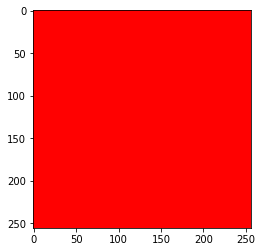

In [64]:
layer_img = io.imread("./data/dataset/OVERLAECOBO/train/economic_layer/20/60.png")
plt.imshow(layer_img)

In [66]:
layer_img.shape

(256, 256, 3)

In [67]:
RGB_red_class1 = layer_img.reshape(256*256,3)[0]
"Estrato 1", list(RGB_red_class1)

('Estrato 1', [255, 1, 1])

#### Estrato 2

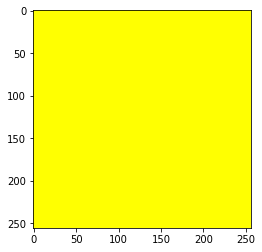

In [24]:
layer_img = io.imread("./data/dataset/OVERLAECOBO/train/economic_layer/20/56.png")
plt.imshow(layer_img)

In [31]:
layer_img.shape

(256, 256, 3)

In [63]:
RGB_yellow_class2 = layer_img.reshape(256*256,3)[0]
"Estrato 2", list(RGB_yellow_class2)

('Estrato 2', [255, 255, 1])

#### Estrato 3

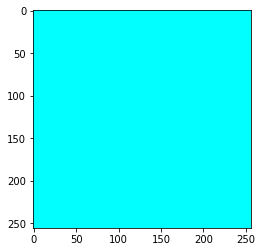

In [71]:
layer_img = io.imread("./data/dataset/OVERLAECOBO/train/economic_layer/20/3331.png")
plt.imshow(layer_img)

In [74]:
layer_img.shape

(256, 256, 3)

In [72]:
RGB_ligthBlue_class3 = layer_img.reshape(256*256,3)[0]
"Estrato 3", list(RGB_ligthBlue_class3)

('Estrato 3', [1, 255, 255])

#### Estrato 4

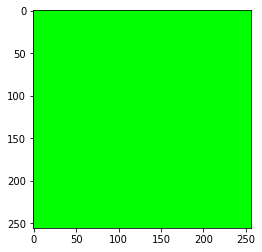

In [73]:
layer_img = io.imread("./data/dataset/OVERLAECOBO/train/economic_layer/20/36288.png")
plt.imshow(layer_img)

In [75]:
layer_img.shape

(256, 256, 3)

In [76]:
RGB_ligthGreen_class4 = layer_img.reshape(256*256,3)[0]
"Estrato 4", list(RGB_ligthGreen_class4)

('Estrato 4', [1, 255, 1])

#### Estrato 5

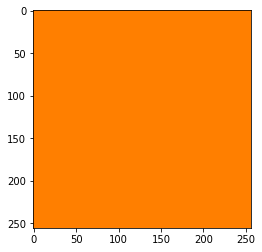

In [77]:
layer_img = io.imread("./data/dataset/OVERLAECOBO/train/economic_layer/20/36309.png")
plt.imshow(layer_img)

In [79]:
layer_img.shape

(256, 256, 3)

In [83]:
RGB_orange_class5 = layer_img.reshape(256*256,3)[0]
"Estrato 5", list(RGB_orange_class5)

('Estrato 5', [255, 127, 0])

#### Estrato 6

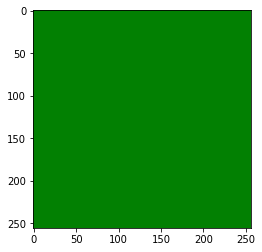

In [84]:
layer_img = io.imread("./data/dataset/OVERLAECOBO/train/economic_layer/20/51217.png")
plt.imshow(layer_img)

In [85]:
layer_img.shape

(256, 256, 3)

In [90]:
RGB_Green_class6 = layer_img.reshape(256*256,3)[0]
"Estrato 6", list(RGB_Green_class6)

('Estrato 6', [2, 128, 2])

#### NO definido

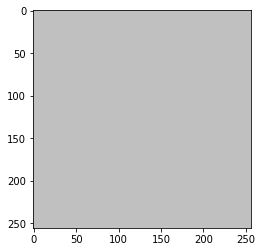

In [91]:
layer_img = io.imread("./data/dataset/OVERLAECOBO/train/economic_layer/20/560.png")
plt.imshow(layer_img)

In [ ]:
layer_img.shape

In [92]:
RGB_Gray_class0 = layer_img.reshape(256*256,3)[0]
"No definido", list(RGB_Gray_class0)

('No definido', [192, 192, 192])

In [102]:
class1 = RGB_red_class1
class2 = RGB_yellow_class2
class3 = RGB_ligthBlue_class3
class4 = RGB_ligthGreen_class4
class5 = RGB_orange_class5
class6 = RGB_Green_class6
class0 = RGB_Gray_class0
print("Estrato 1: ", RGB_red_class1)
print("Estrato 2: ", RGB_yellow_class2)
print("Estrato 3: ", RGB_ligthBlue_class3)
print("Estrato 4: ", RGB_ligthGreen_class4)
print("Estrato 5: ", RGB_orange_class5)
print("Estrato 6: ", RGB_Green_class6)
print("No Definido: ", RGB_Gray_class0)

Estrato 1:  [255   1   1]
Estrato 2:  [255 255   1]
Estrato 3:  [  1 255 255]
Estrato 4:  [  1 255   1]
Estrato 5:  [255 127   0]
Estrato 6:  [  2 128   2]
No Definido:  [192 192 192]


#### 2.4.1 Matrices target

Se puede hacer la etiquetacion de clases usando un "arbol de desicion", no lo de machine learning pero si usando un arbol de `if's` mirando pixeles

In [2]:
def get_target_matrix(layer_to_extract):
    
    to_extract = layer_to_extract.reshape(256*256,3)
    newmat = np.zeros((256*256,))+45

    for j,i in enumerate(to_extract):

        # Clases 3, 4 o 6
        if i[0] <= 96:

            # Clase 3
            if 150 <= i[2]:
                newmat[j] = 3
            
            # Clase 3 o 4
            if 150 >= i[2]:

                # Clase 4
                if 190 <= i[1]:
                    newmat[j] = 4

                # Clases 6:
                if i[1] <= 190:
                    newmat[j] = 6


        # Clases 1, 2, 5 o 0
        if 96 <= i[0]:
            
            # Clases 0:
            if i[2] > 130:
                newmat[j] = 0
            
            # Clases 1, 2 o 5:
            if i[2] <= 130:
                newmat[j] = 0          

                # Clases 5:
                if 64 < i[1] < 191:
                    newmat[j] = 5

                # Clases 2:
                if 191 <= i[1]:
                    newmat[j] = 2

                # Clase 1:
                if i[1] <= 64:
                    newmat[j] = 1
           
    return newmat.reshape((256,256))
        

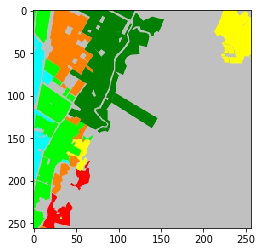

In [277]:
layer_to_extract = io.imread("./data/dataset/OVERLAECOBO/train/economic_layer/14/6.png")
plt.imshow(layer_to_extract)

In [278]:
layer_to_extract.shape

(256, 256, 3)

In [302]:
layer_to_extract[0][0]

array([  0, 255,   0], dtype=uint8)

Podemos pasar de la imagen RGB a la `imagen de clases`

In [279]:
mask = get_target_matrix(layer_to_extract)
mask.shape

(256, 256)

In [280]:
mask, np.unique(mask)

(array([[4., 4., 4., ..., 0., 0., 0.],
        [4., 4., 4., ..., 0., 0., 0.],
        [4., 4., 4., ..., 0., 0., 0.],
        ...,
        [4., 4., 4., ..., 0., 0., 0.],
        [4., 4., 4., ..., 0., 0., 0.],
        [4., 4., 4., ..., 0., 0., 0.]]), array([0., 1., 2., 3., 4., 5., 6.]))

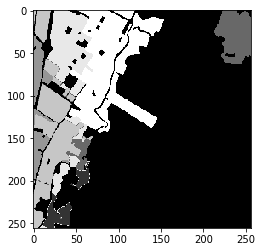

In [281]:
plt.imshow(mask,  cmap = plt.cm.Greys_r )

O devolvernos de la `imagen de clases` a la imagen RGB

In [330]:
def target_matrix_to_image_color(mask):
        
    to_extract = mask.reshape((256*256,1))
    newmat = []

    for j,i in enumerate(to_extract):
        if i == 0:
            newmat.append([192, 192, 192])
        if i == 1:
            newmat.append([255, 1, 1])
        if i == 2:
            newmat.append([225, 255, 1])
        if i == 3:
            newmat.append([1, 255, 255])
        if i == 4:
            newmat.append([1, 255, 1])
        if i == 5:
            newmat.append([255, 127, 0])
        if i == 6:
            newmat.append([2, 128, 2])
    return np.array(newmat).reshape((256,256,3))

In [331]:
img_new = target_matrix_to_image_color(mask)
img_new = img_new.astype("uint8")

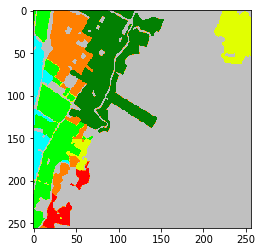

In [332]:
plt.imshow(img_new)

Existe una pequeña diferencia. a la derecha la imagen `Òriginal` y la izquierda la obtenidad desde la `imagen de clases`

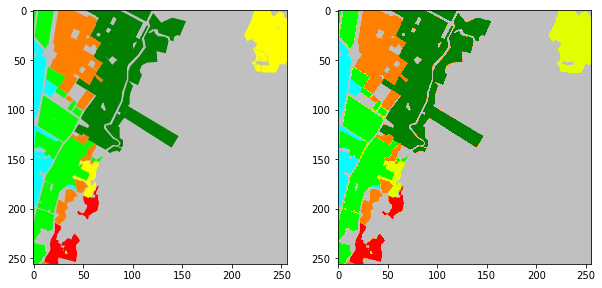

In [340]:
rimg = layer_to_extract
img = img_new
fig = plt.figure(figsize=(10,5))
fig.add_subplot(121)
plt.imshow(rimg);
fig.add_subplot(122)
plt.imshow(img);

### GET ALL TARGET MATRIX:

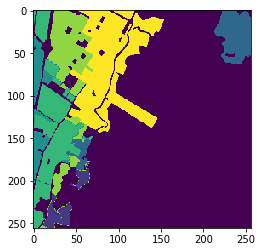

In [6]:
TYPE = ['train'.'test']
TYPE_IMAGE = [ 'economic_layer','satellite']
ZOOM = ['13','14','15','16','17','18','18','20']
for i in TYPE:
    for j in TYPE_IMAGE:
        for k in ZOOM:
            content_list = os.listdir('./data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k)
            for n in content_list:
                if "git" not in n:
                    if not os.path.isfile('./data/dataset/OVERLAECOBO/'+i+'/'+'target'+'/'+k+'/'+n):                        
                        #os.rename('./data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k+'/'+n, './data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k+'/'+str(l-1)+".png")
                        layer_to_extract = io.imread('./data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k+'/'+n)
                        print('PROSESANDO..../data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k+'/'+n)
                        mask = get_target_matrix(layer_to_extract).astype("uint8")
                        im = Image.fromarray(mask)
                        im.save('./data/dataset/OVERLAECOBO/'+i+'/'+'target'+'/'+k+'/'+n)

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6059.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60590.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60591.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60592.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60593.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60594.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60595.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60596.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60597.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6069.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60690.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60691.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60692.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60693.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60694.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60695.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60696.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60697.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60787.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6079.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60790.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60791.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60792.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60793.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60794.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60795.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60796.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60797.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60887.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60889.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6089.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60890.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60891.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60892.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60893.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60894.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60895.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60896.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60897.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60987.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60989.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6099.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60990.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60991.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60992.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60993.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60994.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60995.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60996.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/60997.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61087.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61088.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61089.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6109.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61090.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61091.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61092.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61093.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61094.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61095.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61096.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61187.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61188.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61189.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6119.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61190.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61191.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61192.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61193.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61194.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61195.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61196.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61287.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61288.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61289.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6129.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61290.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61291.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61292.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61293.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61294.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61295.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61296.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61387.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61388.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61389.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6139.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61390.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61391.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61392.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61393.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61394.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61395.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61396.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61487.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61488.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61489.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6149.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61490.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61491.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61492.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61493.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61494.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61495.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61496.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6159.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61590.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61591.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61592.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61593.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61594.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61595.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61596.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61685.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6169.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61690.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61691.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61692.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61693.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61694.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61695.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61696.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61785.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61787.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6179.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61790.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61791.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61792.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61793.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61794.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61795.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61796.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61885.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61887.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61889.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6189.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61890.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61891.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61892.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61893.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61894.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61895.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61896.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61987.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61989.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6199.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61990.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61991.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61992.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61993.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61994.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61995.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/61996.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62087.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62088.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62089.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6209.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62090.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62091.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62092.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62093.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62094.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62095.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62187.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62188.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62189.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6219.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62190.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62191.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62192.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62193.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62194.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62195.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62284.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62287.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62288.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62289.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6229.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62290.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62291.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62292.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62293.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62294.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62295.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62384.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62387.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62388.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62389.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6239.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62390.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62391.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62392.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62393.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62394.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62395.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62484.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62487.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62488.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62489.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6249.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62490.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62491.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62492.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62493.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62494.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62495.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62584.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6259.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62590.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62591.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62592.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62593.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62594.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62595.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62684.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62685.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6269.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62690.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62691.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62692.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62693.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62694.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62695.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62784.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62785.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62787.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6279.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62790.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62791.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62792.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62793.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62794.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62795.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62884.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62885.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62887.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62889.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6289.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62890.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62891.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62892.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62893.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62894.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62895.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62984.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62987.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62989.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6299.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62990.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62991.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62992.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62993.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62994.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/62995.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63083.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63087.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63088.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63089.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6309.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63090.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63091.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63092.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63093.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63094.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63183.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63187.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63188.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63189.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6319.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63190.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63191.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63192.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63193.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63194.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63283.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63284.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63287.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63288.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63289.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6329.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63290.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63291.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63292.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63293.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63294.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63383.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63384.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63387.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63388.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63389.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6339.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63390.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63391.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63392.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63393.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63394.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63483.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63484.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63487.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63488.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63489.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6349.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63490.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63491.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63492.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63493.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63494.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63583.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63584.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6359.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63590.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63591.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63592.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63593.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63594.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63683.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63684.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63685.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6369.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63690.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63691.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63692.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63693.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63694.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63783.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63784.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63785.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63787.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6379.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63790.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63791.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63792.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63793.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63794.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63883.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63884.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63885.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63887.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63889.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6389.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63890.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63891.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63892.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63893.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63894.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63983.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63984.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63987.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63989.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6399.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63990.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63991.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63992.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63993.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/63994.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64082.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64083.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64087.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64088.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64089.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6409.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64090.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64091.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64092.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64093.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64182.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64183.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64187.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64188.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64189.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6419.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64190.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64191.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64192.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64193.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64282.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64283.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64284.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64287.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64288.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64289.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6429.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64290.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64291.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64292.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64293.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64382.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64383.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64384.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64387.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64388.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64389.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6439.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64390.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64391.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64392.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64393.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64482.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64483.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64484.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64487.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64488.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64489.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6449.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64490.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64491.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64492.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64493.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64582.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64583.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64584.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6459.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64590.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64591.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64592.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64593.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64682.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64683.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64684.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64685.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6469.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64690.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64691.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64692.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64693.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64782.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64783.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64784.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64785.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64787.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6479.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64790.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64791.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64792.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64793.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64882.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64883.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64884.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64885.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64887.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64889.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6489.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64890.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64891.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64892.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64893.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64982.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64983.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64984.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64987.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64989.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6499.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64990.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64991.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64992.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/64993.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65081.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65082.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65083.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65087.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65088.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65089.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6509.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65090.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65091.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65092.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65181.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65182.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65183.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65187.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65188.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65189.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6519.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65190.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65191.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65192.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65281.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65282.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65283.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65284.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65287.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65288.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65289.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6529.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65290.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65291.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65292.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65381.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65382.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65383.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65384.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65387.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65388.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65389.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6539.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65390.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65391.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65392.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65481.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65482.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65483.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65484.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65487.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65488.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65489.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6549.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65490.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65491.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65492.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65581.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65582.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65583.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65584.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6559.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65590.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65591.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65592.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65681.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65682.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65683.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65684.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65685.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6569.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65690.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65691.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65692.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65781.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65782.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65783.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65784.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65785.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65787.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6579.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65790.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65791.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65792.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65881.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65882.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65883.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65884.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65885.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65887.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65889.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65890.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65891.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65892.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65981.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65982.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65983.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65984.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65987.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65989.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6599.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65990.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65991.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/65992.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66080.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66081.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66082.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66083.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66087.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66088.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66089.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6609.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66090.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66091.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66180.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66181.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66182.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66183.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66187.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66188.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66189.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6619.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66190.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66191.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66280.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66281.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66282.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66283.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66284.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66287.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66288.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66289.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6629.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66290.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66291.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66380.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66381.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66382.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66383.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66384.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66387.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66388.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66389.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6639.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66390.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66391.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66480.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66481.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66482.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66483.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66484.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66487.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66488.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66489.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6649.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66490.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66491.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66580.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66581.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66582.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66583.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66584.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6659.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66590.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66591.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66680.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66681.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66682.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66683.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66684.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66685.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6669.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66690.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66691.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66780.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66781.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66782.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66783.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66784.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66785.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66787.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6679.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66790.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66791.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66880.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66881.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66882.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66883.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66884.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66885.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66887.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66889.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66890.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66891.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66980.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66981.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66982.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66983.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66984.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66987.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66989.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6699.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66990.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/66991.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6708.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67080.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67081.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67082.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67083.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67087.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67088.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67089.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6709.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67090.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6718.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67180.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67181.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67182.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67183.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67187.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67188.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67189.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6719.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67190.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6728.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67280.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67281.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67282.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67283.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67284.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67287.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67288.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67289.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6729.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67290.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6738.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67380.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67381.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67382.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67383.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67384.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67387.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67388.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67389.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6739.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67390.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6748.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67480.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67481.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67482.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67483.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67484.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67487.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67488.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67489.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6749.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67490.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6758.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67580.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67581.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67582.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67583.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67584.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6759.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67590.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6768.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67680.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67681.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67682.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67683.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67684.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67685.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6769.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67690.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6778.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67780.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67781.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67782.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67783.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67784.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67785.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67787.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6779.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67790.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67880.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67881.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67882.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67883.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67884.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67885.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67887.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67889.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67890.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6798.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67980.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67981.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67982.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67983.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67984.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67987.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67989.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6799.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/67990.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68079.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6808.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68080.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68081.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68082.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68083.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68087.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68088.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68089.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6809.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68179.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6818.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68180.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68181.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68182.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68183.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68187.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68188.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68189.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6819.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68279.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6828.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68280.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68281.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68282.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68283.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68284.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68287.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68288.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68289.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6829.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68379.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6838.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68380.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68381.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68382.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68383.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68384.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68387.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68388.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68389.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6839.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68479.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6848.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68480.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68481.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68482.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68483.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68484.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68487.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68488.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68489.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6849.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68579.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6858.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68580.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68581.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68582.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68583.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68584.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6859.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68679.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6868.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68680.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68681.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68682.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68683.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68684.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68685.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6869.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68779.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6878.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68780.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68781.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68782.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68783.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68784.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68785.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68787.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6879.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68879.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68880.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68881.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68882.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68883.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68884.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68885.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68887.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68889.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6889.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68979.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6898.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68980.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68981.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68982.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68983.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68984.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68987.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/68989.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6899.png
PROSESANDO..../data/dataset/OVERLAECOBO/

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69078.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69079.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6908.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69080.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69081.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69082.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69083.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69087.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69088.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69089.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69178.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69179.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6918.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69180.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69181.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69182.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69183.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69187.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69188.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69189.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69278.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69279.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6928.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69280.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69281.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69282.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69283.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69284.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69287.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69288.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69289.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69378.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69379.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6938.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69380.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69381.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69382.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69383.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69384.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69387.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69388.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69389.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69478.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69479.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6948.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69480.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69481.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69482.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69483.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69484.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69487.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69488.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69489.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69578.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69579.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6958.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69580.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69581.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69582.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69583.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69584.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69589.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69678.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69679.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6968.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69680.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69681.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69682.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69683.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69684.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69685.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69689.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69778.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69779.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6978.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69780.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69781.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69782.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69783.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69784.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69785.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69787.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69789.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69878.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69879.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69880.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69881.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69882.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69883.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69884.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69885.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69887.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69889.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69978.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69979.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/6998.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69980.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69981.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69982.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69983.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69984.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69987.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69988.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/69989.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70076.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70077.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70078.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70079.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7008.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70080.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70081.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70082.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70083.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70087.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70176.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70177.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70178.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70179.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7018.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70180.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70181.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70182.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70183.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70187.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70276.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70277.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70278.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70279.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7028.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70280.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70281.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70282.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70283.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70284.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70287.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70376.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70377.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70378.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70379.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7038.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70380.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70381.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70382.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70383.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70384.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70387.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70476.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70477.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70478.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70479.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7048.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70480.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70481.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70482.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70483.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70484.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70487.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70576.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70577.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70578.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70579.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7058.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70580.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70581.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70582.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70583.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70584.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70587.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70676.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70677.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70678.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70679.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7068.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70680.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70681.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70682.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70683.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70684.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70685.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70687.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70776.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70777.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70778.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70779.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7078.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70780.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70781.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70782.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70783.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70784.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70785.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70787.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70876.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70877.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70878.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70879.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7088.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70880.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70881.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70882.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70883.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70884.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70885.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70886.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70887.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70976.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70977.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70978.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70979.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7098.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70980.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70981.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70982.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70983.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70984.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70986.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/70987.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71075.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71076.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71077.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71078.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71079.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7108.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71080.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71081.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71082.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71083.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71086.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71175.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71176.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71177.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71178.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71179.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7118.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71180.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71181.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71182.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71183.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/71186.png
PROSESANDO..../data/dataset/OVERLAECOBO

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7142.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7143.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7144.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7145.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7146.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7147.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7148.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7149.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/715.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7150.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7151.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7152.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7153.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7244.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7245.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7246.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7247.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7248.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7249.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/725.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7250.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7251.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7252.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7253.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7254.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7255.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7346.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7347.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7348.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7349.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/735.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7350.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7351.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7352.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7353.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7354.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7355.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7356.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7357.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7448.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7449.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/745.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7450.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7451.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7452.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7453.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7454.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7455.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7456.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7457.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7458.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7459.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/755.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7550.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7551.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7552.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7553.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7554.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7555.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7556.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7557.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7558.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7559.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/756.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7560.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economi

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7651.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7652.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7653.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7654.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7655.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7656.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7657.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7658.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7659.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/766.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7660.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7661.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7662.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7753.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7754.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7755.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7756.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7757.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7758.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7759.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/776.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7760.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7761.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7762.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7763.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7764.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7855.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7856.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7857.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7858.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7859.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/786.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7860.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7861.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7862.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7863.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7864.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7865.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7866.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7957.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7958.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7959.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/796.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7960.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7961.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7962.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7963.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7964.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7965.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7966.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7967.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/7968.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8058.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8059.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/806.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8060.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8061.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8062.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8063.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8064.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8065.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8066.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8067.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8068.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8069.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/816.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8160.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8161.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8162.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8163.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8164.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8165.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8166.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8167.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8168.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8169.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/817.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8170.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economi

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8261.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8262.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8263.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8264.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8265.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8266.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8267.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8268.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8269.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/827.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8270.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8271.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8272.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8363.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8364.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8365.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8366.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8367.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8368.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8369.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/837.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8370.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8371.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8372.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8373.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8374.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8465.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8466.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8467.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8468.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8469.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/847.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8470.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8471.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8472.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8473.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8474.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8475.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8476.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8567.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8568.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8569.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/857.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8570.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8571.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8572.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8573.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8574.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8575.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8576.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8577.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8578.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8669.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/867.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8670.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8671.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8672.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8673.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8674.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8675.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8676.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8677.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8678.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8679.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/868.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economi

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8770.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8771.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8772.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8773.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8774.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8775.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8776.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8777.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8778.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8779.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/878.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8780.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8781.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8872.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8873.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8874.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8875.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8876.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8877.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8878.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8879.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/888.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8880.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8881.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8882.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8883.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8974.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8975.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8976.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8977.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8978.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8979.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/898.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8980.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8981.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8982.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8983.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8984.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/8985.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9075.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9076.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9077.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9078.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9079.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/908.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9080.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9081.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9082.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9083.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9084.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9085.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9086.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9177.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9178.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9179.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/918.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9180.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9181.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9182.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9183.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9184.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9185.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9186.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9187.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9188.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9279.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/928.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9280.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9281.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9282.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9283.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9284.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9285.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9286.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9287.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9288.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9289.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/929.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economi

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9380.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9381.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9382.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9383.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9384.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9385.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9386.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9387.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9388.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9389.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/939.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9390.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9391.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9482.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9483.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9484.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9485.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9486.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9487.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9488.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9489.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/949.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9490.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9491.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9492.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9493.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9584.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9585.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9586.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9587.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9588.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9589.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/959.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9590.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9591.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9592.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9593.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9594.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9595.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9686.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9687.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9688.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9689.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/969.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9690.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9691.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9692.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9693.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9694.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9695.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9696.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9697.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9788.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9789.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/979.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9790.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9791.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9792.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9793.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9794.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9795.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9796.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9797.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9798.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9799.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/econom

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/989.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9890.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9891.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9892.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9893.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9894.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9895.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9896.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9897.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9898.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9899.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/99.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/990.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_

PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9991.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9992.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9993.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9994.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9995.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9996.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9997.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9998.png
PROSESANDO..../data/dataset/OVERLAECOBO/train/economic_layer/20/9999.png


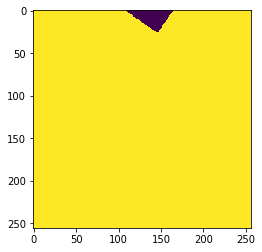

In [4]:
img = io.imread('./data/dataset/OVERLAECOBO/train/target/19/324.png')
plt.imshow(img)

In [7]:
TYPE = ['train','test']
TYPE_IMAGE = [ 'economic_layer','satellite']
ZOOM = ['13','14','15','16','17','18','18','20']
for i in TYPE:
    for j in TYPE_IMAGE:
        for k in ZOOM:
            content_list = os.listdir('./data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k)
            print(i, j, k, len(content_list))

train economic_layer 13 3
train economic_layer 14 25
train economic_layer 15 91
train economic_layer 16 322
train economic_layer 17 1204
train economic_layer 18 4585
train economic_layer 18 4585
train economic_layer 20 71261
train satellite 13 3
train satellite 14 25
train satellite 15 91
train satellite 16 322
train satellite 17 1204
train satellite 18 4585
train satellite 18 4585
train satellite 20 71261
test economic_layer 13 8
test economic_layer 14 25
test economic_layer 15 99
test economic_layer 16 348
test economic_layer 17 1339
test economic_layer 18 5334
test economic_layer 18 5334
test economic_layer 20 84121
test satellite 13 8
test satellite 14 25
test satellite 15 99
test satellite 16 348
test satellite 17 1339
test satellite 18 5334
test satellite 18 5334
test satellite 20 84121


In [67]:

print(perce.shape)

TYPE = ['train', 'test']
TYPE_IMAGE = [ 'target']
ZOOM = ['13','14','15','16','17','18','19','20']
for i in TYPE:
    for j in TYPE_IMAGE:
        for k in ZOOM:
            perce = np.zeros(7)
            content_list = os.listdir('./data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k)
            for n in content_list:
                if "git" not in n:
                    img = io.imread('./data/dataset/OVERLAECOBO/'+i+'/'+j+'/'+k+'/'+n)
                    
                    class0 = sum(sum(img == 0))
                    class1 = sum(sum(img == 1))
                    class2 = sum(sum(img == 2))
                    class3 = sum(sum(img == 3))
                    class4 = sum(sum(img == 4))
                    class5 = sum(sum(img == 5))
                    class6 = sum(sum(img == 6))
                    
                    perce = perce+[class0, class1, class2, class3, class4, class5, class6]
                    
            print("ZOOM: ", k)
            print("Cantidad de imagenes:",len(content_list))
            print(256*256*(len(content_list)-1), perce, sum(perce))
            perce = (perce*100)/(256*256*(len(content_list)-1))
            aux = 0
            for y, u in enumerate(perce):
                aux = aux + u
                print("% Clase", y, ": ",u)
            print("Total: ", aux)
            print("")

(7,)
ZOOM:  13
Cantidad de imagenes: 3
131072 [5.4388e+04 9.7300e+03 2.8183e+04 3.3958e+04 3.4140e+03 1.3980e+03
 1.0000e+00] 131072.0
% Clase 0 :  41.4947509765625
% Clase 1 :  7.42340087890625
% Clase 2 :  21.501922607421875
% Clase 3 :  25.90789794921875
% Clase 4 :  2.60467529296875
% Clase 5 :  1.06658935546875
% Clase 6 :  0.000762939453125
Total:  100.0

ZOOM:  14
Cantidad de imagenes: 25
1572864 [861278.  82634. 165892. 243916. 108355.  62170.  48619.] 1572864.0
% Clase 0 :  54.75858052571615
% Clase 1 :  5.2537282307942705
% Clase 2 :  10.547129313151041
% Clase 3 :  15.507761637369791
% Clase 4 :  6.889025370279948
% Clase 5 :  3.952662150065104
% Clase 6 :  3.0911127726236978
Total:  100.00000000000003

ZOOM:  15
Cantidad de imagenes: 91
5898240 [3119322.  335593.  671681.  976984.  356116.  213554.  224990.] 5898240.0
% Clase 0 :  52.885640462239586
% Clase 1 :  5.68971421983507
% Clase 2 :  11.387820773654514
% Clase 3 :  16.56399197048611
% Clase 4 :  6.037665473090278
% 

In [69]:
train_target_content =  pd.read_csv("./data/dataset/OVERLAECOBO/train/target_content.csv")
train_target_content

,ZOOM,0,1,2,3,4,5,6
0,13,41.494751,7.423401,21.501923,25.907898,2.604675,1.066589,0.000763
1,14,54.758581,5.253728,10.547129,15.507762,6.889025,3.952662,3.091113
2,15,52.885640,5.689714,11.387821,16.563992,6.037665,3.620639,3.814528
3,16,50.778398,6.417842,11.744638,17.078183,6.330154,3.310615,4.340170
4,17,47.852904,6.898279,12.553454,18.316062,6.388296,3.322167,4.668838
5,18,46.236123,7.123886,13.181920,18.813524,6.698825,3.245922,4.699800
6,19,45.463065,7.155623,13.443849,19.001000,6.991155,3.228155,4.717153
7,20,44.934886,7.248590,13.597220,19.146495,7.062193,3.236511,4.774104


In [72]:
test_target_content =  pd.read_csv("./data/dataset/OVERLAECOBO/test/target_content.csv")
test_target_content

,ZOOM,0,1,2,3,4,5,6
0,13,66.857910,2.897208,12.079729,13.635036,3.167725,0.955200,0.407192
1,14,58.255386,3.074328,14.556503,16.084989,3.691800,2.584966,1.752027
2,15,56.452786,2.622534,14.526274,16.843835,4.659536,2.877185,2.017850
3,16,52.951476,2.924085,15.379993,18.016699,5.250303,3.091914,2.385529
4,17,51.199628,2.927647,15.570836,19.340278,5.689348,2.851201,2.421062
5,18,50.311835,3.138128,15.654499,19.361961,5.867858,3.216279,2.449441
6,19,49.791545,3.158081,15.870436,19.651220,5.846983,3.277923,2.403813
7,20,49.596685,3.156486,16.012352,19.649095,5.898178,3.310542,2.376661


Hay un desvalanceo de clases como se puede ver la clase 0 `no definida` tiene mas del 50% de las propiedades

Ya con el dataset como esta, inciare escogiendo uno de los repositorios favoritos del notebook [Search Segmentation](./Search of Segemtation.ipynb) hacerlo funcionar y luego hacerlo con mi repo a ver que, esos repos las dejare en el directorio repo_test con un gitignore que ignore todo, menos algun MD o un notebook donde llevare notaciones o cosas raras de los repos que clone.